In [ ]:
# Recommendation engine with gui using python and ml
# gui for neural network and decision tree


In [4]:
# boiling it down 
import numpy as np
import pandas as pd

raitingfile_loc="ML REC engine/ratings.csv"
moviefile_loc="ML REC engine/movies.csv"

ratings_data = pd.read_csv(raitingfile_loc)
movie_names = pd.read_csv(moviefile_loc)
movie_data = pd.merge(ratings_data, movie_names, on='movieId')
ratings_mean_count=pd.DataFrame(movie_data.groupby('title')['rating'].mean())
ratings_mean_count['rating_counts']=pd.DataFrame(movie_data.groupby('title')['rating'].count())
user_movie_rating=movie_data.pivot_table(index='userId',columns='title',values='rating')


# movie specific 
#finding user rating of one movie
inputname='Forrest Gump (1994)'
raiting_count=50

input_movie_ratings = user_movie_rating['Forrest Gump (1994)']
movieslike_input_movie=user_movie_rating.corrwith(input_movie_ratings)
corr_input_movie=pd.DataFrame(movieslike_input_movie,columns=['correlation'])
corr_input_movie.dropna(inplace=True)
corr_input_movie = corr_input_movie.join(ratings_mean_count['rating_counts'])
x=corr_input_movie[corr_input_movie ['rating_counts']>raiting_count].sort_values('correlation', ascending=False).head()


/home/victor/.local/lib/python3.8/site-packages/numpy/lib/function_base.py:2526: RuntimeWarning: Degrees of freedom <= 0 for slice
  c = cov(x, y, rowvar)
/home/victor/.local/lib/python3.8/site-packages/numpy/lib/function_base.py:2455: RuntimeWarning: divide by zero encountered in true_divide
  c *= np.true_divide(1, fact)


     pregnant  insulin   bmi  age  glucose  bp  pedigree
285         5      545  38.7   34      155  84     0.619
101         0        0  22.5   21      125  96     0.262
581        12        0  26.5   62      121  78     0.259
352         1       43  27.2   24       90  62     0.580
632         1      183  27.5   22      128  82     0.115
..        ...      ...   ...  ...      ...  ..       ...
241         3        0  25.6   22      139  54     0.402
599         1        0  27.1   24      108  88     0.400
649         1      100  25.2   23       91  54     0.234
11         10        0  27.1   57      139  80     1.441
214        12      271  41.8   38      151  70     0.742

[231 rows x 7 columns]
Accuracy: 0.7316017316017316


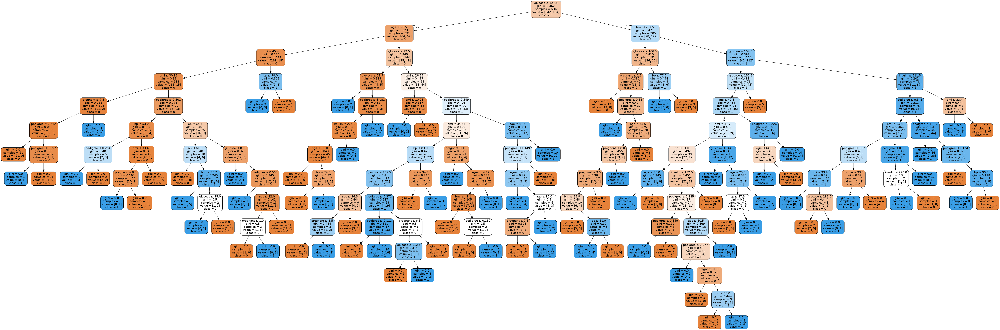

In [23]:
# Decision tree
import pandas as pd
from sklearn.tree import DecisionTreeClassifier # Import Decision Tree Classifier
from sklearn.model_selection import train_test_split # Import train_test_split function
from sklearn import metrics #Import scikit-learn metrics module for accuracy calculation
from IPython.display import Image  
from sklearn.tree import export_graphviz
import pydotplus
from sklearn.tree import export_graphviz
# from sklearn.externals.six import StringIO  
import io # IO.string


diab_file_loc="Diabates/Diabetes.csv"
opfile_loc="Diabates/"
col_names = ['pregnant', 'glucose', 'bp', 'skin', 'insulin', 'bmi', 'pedigree', 'age', 'label']
# load dataset
pima = pd.read_csv(diab_file_loc, header=1, names=col_names)
#split dataset in features and target variable
feature_cols = ['pregnant', 'insulin', 'bmi', 'age','glucose','bp','pedigree']
X = pima[feature_cols] # Features
y = pima.label # Target variable

# Split dataset into training set and test set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1) # 70% training and 30% test

# Create Decision Tree classifer object
clf = DecisionTreeClassifier()
# clf = DecisionTreeClassifier(criterion="entropy", max_depth=3)

# Train Decision Tree Classifer
clf = clf.fit(X_train,y_train)

#Predict the response for test dataset
y_pred = clf.predict(X_test)

print(X_test)

# Model Accuracy, how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))


dot_data = io.StringIO()
export_graphviz(clf, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,feature_names = feature_cols,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png(str(opfile_loc +'diabetes1.png'))
Image(graph.create_png())

# # Create Decision Tree classifer object
# clf = DecisionTreeClassifier(criterion="entropy", max_depth=3)

# # Train Decision Tree Classifer
# clf = clf.fit(X_train,y_train)

# #Predict the response for test dataset
# y_pred = clf.predict(X_test)

# # Model Accuracy, how often is the classifier correct?
# print("Accuracy:",metrics.accuracy_score(y_test, y_pred))


# dot_data = io.StringIO()
# export_graphviz(clf, out_file=dot_data,  
#                 filled=True, rounded=True,
#                 special_characters=True, feature_names = feature_cols,class_names=['0','1'])
# graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
# graph.write_png('diabetes1.png')
# Image(graph.create_png())


In [14]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split

In [15]:
diab_file_loc="Diabates/Diabetes.csv"

col_names = ['pregnant', 'glucose', 'bp', 'skin', 'insulin', 'bmi', 'pedigree', 'age', 'label']
pima = pd.read_csv(diab_file_loc, header=1, names=col_names)

feature_cols = ['pregnant', 'insulin', 'bmi', 'age','glucose','bp','pedigree']
X = pima[feature_cols] # Features
y = pima.label # Target variable
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1)


In [16]:
np.random.seed(56)  #random.seed function so that we can get the same random values whenever the script is executed.
weights = np.random.rand(7) # 7 features
bias = np.random.rand(1)  
lr = 0.05 
weights

array([0.98419185, 0.33341227, 0.67370162, 0.19639042, 0.35444646,
       0.81336595, 0.24784955])

In [17]:
# activation function and its derivative (for the optimization problem)
def sigmoid(x): 
    return 1/(1+np.exp(-x))
def sigmoid_der(x):   
    return sigmoid(x)*(1-sigmoid(x))

In [22]:
# the Training
for epoch in range(800000000):
    inputs=X_train
    #      FEED FORWARD 
    # find dot product for feed forward
    #  step1
    XW = X_train.dot(weights) + bias
    # Now comes the acivation function to squash the value to 0 and 1
    #  step2
    z  = sigmoid(XW)
    # predicted ops at z
    
    # now   BACK PROPOGATION
    # step1 find the cost
    error = z - y_train # predicted - observed 
    print(error.sum())
    # step 2
    dcost_dpred=error
    dpred_dz=sigmoid_der(z)
#     z_delta = dcost_dpred * dpred_dz
    z_delta = dcost_dpred.mul(dpred_dz)
    inputs=X_train.transpose()
    weights -= lr * inputs.dot(z_delta)
    
    for num in z_delta:
            bias -= lr * num


-166.0
253.0
-164.9999992716961
256.0
-163.0
252.9999999999992
-165.0
256.0
-160.0
248.0
-165.0
256.99999767591333
-165.0
256.0
-165.0
256.27435138381895
-160.99999441903543
248.00000001196125
-163.0
253.0
-161.0
251.00000000683184
-165.0
258.999999573324
-165.00004479674982
253.0
-161.99999999966835
252.0
-166.0
263.0
-167.0
253.0
-160.0
248.0
-165.0
258.0375993442276
-165.0
253.0
-161.0
251.99997520998488
-166.0
261.0
-166.0
253.0
-164.0
253.0
-161.0
251.0000000001293
-165.0
258.9990362107194
-165.0
253.0
-161.61420254970042
251.9997952901312
-166.0
261.0
-166.0
253.0
-163.9999787470606
253.0
-161.0
250.99999962616693
-164.99999770038437
257.9427010300641
-165.0
253.00000000000003
-159.0
248.0
-165.0
258.0000000000015
-166.0
260.99979379030674
-166.0
253.0
-164.99999999999994
256.0
-163.0
252.99999703277186
-165.0
256.0
-160.0
247.99999999999997
-165.0
256.9968505198452
-165.0
256.0
-165.0
256.00001525099754
-160.0
248.0
-165.00000000000003
257.0000000016118
-165.0
256.0
-164.9999999

253.0
-163.00001271621775
252.99989004907553
-165.0
257.0004515532536
-165.0
256.0
-163.9999999712296
253.0
-161.0
252.0
-166.0
261.0
-166.0
253.0
-163.99999999999557
253.0
-161.0000000001984
251.99990281833797
-166.0
260.9997162445168
-167.0
253.0
-158.48323926474853
247.0
-165.00000003884816
256.0
-163.00000000000003
253.0
-165.0
258.8897450471467
-165.0
253.0
-161.99996780038512
252.0
-166.0
262.00007631879447
-166.0
252.55236745749667
-164.0
253.0
-161.98424627383037
252.0
-164.0
253.0
-159.0
248.0
-165.0
258.00000001073374
-165.0
253.00000000403458
-161.0000000020902
252.0
-166.0
261.0000000000017
-167.0
253.0
-159.0
248.0
-165.0
258.99999986946966
-165.0
253.0
-162.11960599145067
252.0
-163.9780623540148
253.0
-163.0
253.0
-159.0
248.0
-165.0
258.0000000000001
-166.0
261.83212371901783
-166.0
252.0
-165.0
256.0
-163.9999775022192
253.0
-161.99999995945788
253.0
-165.0
259.9962472853566
-166.0
253.0
-163.0
253.0
-163.0
252.99998336771984
-165.0
257.99983013692963
-165.0
253.0
-161

-164.0
253.0
-162.0
252.0
-164.0
253.9999999531601
-159.9999999997993
248.0
-165.0
260.0
-167.0
255.87973825863665
-164.0
253.0
-162.0
252.0
-164.0
254.00000000000006
-159.99999998068645
248.0
-164.99999999999994
260.0
-167.0
256.9994139043366
-165.0
253.0457455036622
-160.00000019859075
249.0000000000285
-164.0
254.00001490153625
-161.999506549448
252.0
-166.0
262.99999884282164
-166.06543369617114
252.0
-164.00780276016218
253.0
-161.000000001229
252.0
-166.0
261.0
-166.0
252.99999999999994
-164.99999221638672
256.00000000002944
-163.0
252.0369818788738
-163.99999999010214
254.24507643353212
-159.99999999963575
248.0
-164.99999999965257
260.0
-167.0
255.0551493338823
-161.0
249.0
-164.00000000000057
253.78872050464454
-162.99999999984948
253.0
-164.00000014985716
253.9999834053252
-160.0
248.0
-165.0
260.0
-167.0
256.00349746524887
-164.99999334833686
256.00066289010834
-165.0
257.01543421011746
-165.0
256.0
-164.00000057886496
253.00000000001143
-163.0
253.00000000000003
-159.0
248.

255.99577038957057
-164.57907901763727
255.00000001515815
-163.0
253.0
-163.9999898556444
253.99999222443506
-163.9999999999891
254.00000000002197
-159.0000000037811
247.0
-165.0
260.0
-167.0
255.99999999046548
-165.0
255.03572061880945
-162.06261464473698
252.0
-165.99999999878534
262.0
-166.0
252.0
-163.0
252.99999999950916
-164.0
253.0
-162.0
252.0
-164.0
254.0
-159.00000373659495
247.0
-165.0
260.0
-167.0
254.99999990783232
-161.0
249.0
-164.0000000041664
253.57932381079925
-162.00000098510296
252.0
-165.0
261.9999999999993
-167.9634255766566
253.0
-159.99999999885745
249.0
-166.0
261.0
-167.0
255.0097899421203
-161.00000000001194
249.0
-164.0000000000881
253.0
-161.0
252.0
-166.0
261.0
-166.0
252.9999999926931
-164.00004027760286
253.0
-162.0
252.0
-164.0
254.0
-159.38933089557466
247.00003405241054
-164.0
254.0
-162.9995847573287
253.0
-164.00005438120752
255.99949765236943
-165.0
254.99999959315846
-163.99984501211202
254.00000000002566
-162.00186508426535
252.0
-164.0
253.99999

252.0
-164.0
253.00012529241837
-159.0
248.0
-165.99729472047937
261.0000018664632
-167.0
256.9932566930544
-165.0
254.0
-161.0
251.29778185344207
-166.0
262.0
-167.0
253.0
-159.11885577126844
247.0
-164.0
253.0
-159.0
247.99999999994134
-166.0
261.0
-167.0
254.00000000978156
-159.0
247.0
-164.0
254.0
-162.9999999941639
253.0
-164.00000000029024
254.9999979911882
-165.0
258.21332079147743
-166.9999999953221
262.0
-166.0
252.0
-164.9999999999996
256.0
-163.0
252.00022471892748
-162.50323735246224
252.0
-163.0
252.99959337581546
-164.0
253.00000000020538
-159.0
248.0
-166.0
261.0024140086165
-167.0
255.00142490573668
-161.000001043079
249.9999093540596
-165.31161153632286
261.0
-167.0
253.9789950000434
-160.0
247.99999999979326
-165.999999999955
261.0
-167.0
256.0000000037541
-163.00000018187083
252.0
-163.9999999999992
254.0
-162.00000001894304
252.0
-163.0000057146985
252.0
-163.0
252.99888163154856
-164.00000000000182
253.0000000000005
-159.0
248.0
-166.0
261.0000000306802
-167.0
255.

-166.00000766676936
262.0
-168.0
254.0
-160.0
247.0017596818778
-163.99999999649953
254.0
-160.00000000001182
249.0
-165.00000404484481
259.00000000004155
-166.0
253.0
-162.0
252.0
-164.0
254.9999500719963
-164.0
254.0
-162.00034838512605
252.0
-164.99999997264428
259.9926750308399
-166.0
253.0
-163.0
252.0000000000394
-163.0
253.0
-164.0
253.03233468500653
-159.0
248.0
-166.0
262.0
-168.0
254.00288511883682
-159.99999999997618
248.99880704777587
-166.0
261.0
-167.0
253.99999995017328
-159.99999999999284
248.0
-164.00000410044026
253.0000057837936
-161.99999999999997
252.00000000004474
-163.0
253.0
-164.00434781932606
254.99999999987756
-165.0
258.9999878056554
-167.0
258.9999954812472
-166.0
253.0
-161.0
252.0
-166.00000951707864
261.99999999948193
-168.0
253.0
-158.99108909988962
247.0
-164.0
253.00000000000006
-159.0
247.9999999999919
-166.0
261.99999987866454
-167.9991676262817
253.999946310677
-161.0
250.81257936738376
-166.0
261.0
-166.0
252.95462658120613
-163.0
252.0
-163.0
252

-161.0
252.0
-167.0
262.0
-168.0
255.00000006350737
-161.9999999999993
251.0
-164.0000331262729
253.0
-161.0
252.0
-166.00000001691393
259.0078381214859
-166.0
253.00000000225765
-161.0
252.0
-166.0
261.9999472683396
-167.99711854054647
253.00000000000026
-158.0000000039808
247.0
-166.0
257.93386734249
-166.0
259.308836270646
-165.99999997078652
253.0
-161.0
252.0
-166.0
259.00676081387553
-165.0
253.0
-161.0
250.00516737211038
-163.0
252.0
-164.0
254.0
-159.99999873551167
248.07742031093275
-164.0
253.0000611932856
-161.97086433215762
252.0
-163.0
252.00003571013843
-163.0
253.0
-159.00000000000216
247.00000000000003
-164.784247470565
259.9205816426748
-168.0
256.999882907245
-166.0
254.99876195024655
-163.0
252.9999992779815
-164.0
255.02870977971804
-164.0
254.0
-162.99999999999977
252.287649254881
-163.0015016132415
253.0
-159.9685113472758
249.0
-166.9999999999829
262.0
-168.0
254.00000000000105
-159.00686264114483
247.0
-164.00000000114667
253.99999843474626
-163.0
252.0000000000

255.05314990236812
-162.0432088818625
252.0
-166.0
262.0
-167.0
252.0000008826679
-161.00000000000728
250.00815708063612
-164.0
253.0
-159.0
247.00000500760902
-164.0
254.0
-163.0
253.0
-163.00000000009817
252.0
-163.99994969393123
256.0
-166.0
260.0001058166017
-168.0
256.0
-165.0
257.43000793530763
-165.00000000013455
254.0
-162.00002043522463
252.0
-164.0
253.00412061239288
-159.0
247.99999999913513
-166.0
261.9971685792474
-168.0
254.0
-160.0
248.99999999999966
-166.00000282857823
261.0
-167.55767096913723
254.0
-159.05095611007684
247.0
-164.0
253.99999999984766
-163.0
252.00000000000014
-162.0000685874121
252.0
-164.0
254.99247548870866
-165.00000000020896
258.8727852690737
-167.0
257.00000002032516
-165.0
254.0
-161.0
251.999999783365
-167.0
262.0
-167.0
252.0
-161.99999998040977
252.0
-166.0
262.0
-167.0
253.0
-158.0
247.0
-166.0
257.0
-165.99999999999994
262.0
-167.0
253.0
-158.0
247.0
-166.0
257.0
-165.99999999858042
262.0
-166.03943672989476
252.0
-163.0
252.0
-162.000000048

-167.0
262.99768829089794
-168.0
253.0
-160.0
249.0
-166.0
261.0
-167.00727970340296
254.9794341453745
-161.0
249.0
-164.0029266856691
253.0
-161.0
251.6540900400147
-166.22952339582199
259.2592148825611
-166.0
253.0001634198497
-161.0
252.0
-166.0
259.73668777068764
-166.0
253.0
-161.0
250.0
-164.0
253.0
-159.0
247.0
-164.0
254.0
-162.99999999999446
252.93350106869536
-163.0
252.0
-163.00889006841305
253.0
-159.9765774764462
249.0
-167.0
262.0
-168.0
255.00041062854223
-163.0
252.0
-162.9999999999893
252.99999982416065
-163.0
252.0
-163.0
252.00000142103437
-162.0
252.0
-164.0
256.0
-166.0
255.1191588794087
-163.0
252.0018326354862
-162.0000000001345
252.0
-164.0000000000051
256.0
-166.0
255.98737625007266
-165.0000002054698
257.9999999493911
-167.0
261.99999074121354
-168.0
253.00114782357358
-159.0
247.0
-164.0
254.0
-162.0
252.0
-165.99542565134746
257.9999850992957
-167.0
261.00000039046756
-167.0
252.5602734556528
-162.99999997094795
252.0
-161.99966107401457
252.0
-163.0
252.0
-

-160.0
249.0
-166.00000000000006
260.9999985662537
-168.0
254.00000000003016
-159.0
247.0
-164.0
254.0
-162.99999920071977
252.0
-162.0
252.0
-164.0
255.02125282362522
-163.99999919161792
253.000000872843
-161.0
252.0
-167.0
262.00718955075075
-167.0
252.0
-162.99587414901214
252.0
-161.0000000020171
251.99999837790892
-167.0
262.000000000632
-168.0
255.0
-160.99998982468233
249.0
-164.0000000000005
253.0
-161.015889042174
250.00007398468824
-164.0
253.9999999999823
-160.0
248.99999999943122
-167.0
262.0
-168.0
253.99999999992414
-161.99999999994628
252.0
-165.0
254.0
-162.0
252.0
-164.0
255.99999999999994
-165.00000000009194
254.0
-161.0
252.0
-167.0
262.0733936251247
-168.0
255.00001283479264
-161.0
249.0
-164.0016113375205
253.0
-161.0
251.00000063805936
-166.0
262.0050587930143
-168.0
255.0004469812867
-160.99999999918904
249.0
-164.00000000621705
253.0
-161.0
251.00522055663316
-166.0
262.99919412388516
-168.0
253.0
-160.0
249.0
-166.0
259.00000011524327
-165.25361662230634
253.00

252.0
-161.0148240097335
251.97765009713777
-167.0
262.99998519167764
-168.0
253.0
-160.0
248.9999999999984
-166.0
259.000000000068
-167.0
259.6028173266899
-166.0
252.00000000307853
-161.0
251.0000000000219
-164.0
253.00000000000003
-159.0
247.0
-164.0
254.0
-162.9999999999996
252.0
-162.0
252.0
-164.0
255.99999999999923
-165.9999999999999
255.91478531428163
-164.00000000020168
252.99971831869644
-162.00099153964112
252.0
-164.0
254.01988393376223
-160.0
249.0
-167.0
262.0
-168.0
254.0
-160.0
248.99999999999994
-167.0
262.0
-168.0
253.99999999999994
-161.0
249.0
-164.0
253.97600650240105
-162.99363578051052
252.0
-162.00000000637564
252.0
-166.0000000000291
263.0
-168.0
253.0000076464671
-159.9999954497688
249.0
-166.0
259.9894793332982
-166.0
252.9700613279138
-162.0
252.0
-163.00003792804102
252.0
-163.99991024669134
255.99981553911198
-165.0
254.0
-161.0
251.99846689311812
-166.09884551962972
260.00040847359594
-166.0000000000003
252.00013873117175
-161.0
252.0
-166.0
261.000000000

-168.0
254.0
-160.0
248.0
-165.0
254.95466785199537
-162.9999999997268
252.0
-161.00164739046977
250.00005597409518
-164.0
254.00000000100258
-160.0
249.0
-167.78373933952756
262.0
-168.0
254.00000000000185
-159.925587278033
249.0
-167.0
262.99999999992417
-168.0
253.0
-159.07819666663437
247.0
-164.0
254.0
-163.0
252.0
-162.00000034351723
252.0
-164.0
255.99999999999827
-166.0
255.00000000107212
-163.0
252.0
-162.00000000000102
252.0
-163.0
252.0
-164.0
256.0
-166.0
257.0001605163278
-166.0
254.81501277368056
-164.0
255.99999999999523
-165.02835666955502
254.0
-161.0
251.0
-165.7825740438884
261.999965434777
-168.0
255.00000007955634
-161.0
249.0
-165.0
254.00000131127274
-161.0
251.356820037202
-165.00928641112276
256.0
-164.0
253.0000000000004
-161.00000000283234
250.99999999994637
-167.0
263.0
-168.0
254.0
-160.0
248.0
-165.0
254.00000000008762
-161.0
251.00000012351524
-165.0
256.0001101944534
-163.04172170128015
252.0
-162.00000248970636
252.0
-167.0
263.0
-167.0
252.0
-163.0
252

-161.0
249.0
-164.99999991173462
254.00000000000063
-161.0
251.00000000000063
-164.00000237740772
253.98873602070074
-162.0
251.0
-164.00019975992404
252.00000091665402
-161.0
252.0
-167.0000000584651
263.0
-168.0
253.04011510734972
-159.00000114812664
247.99999701588519
-166.99999999999983
262.0
-168.0
255.0
-160.99999913811035
249.0
-165.00000000000267
255.9999999999999
-164.0
252.0
-161.0
251.129129488865
-164.99892882436524
256.9950966250824
-166.0
254.0
-161.0
251.0
-165.0
256.00000000063653
-163.97911078142732
253.9989656776449
-163.0
252.0
-163.0
252.0
-162.0
252.0
-164.0
256.0
-166.99929181560537
257.8480003696473
-167.00000065776513
259.99999997895884
-167.0
254.0
-161.9999999978609
251.0000223170005
-164.0
254.0
-160.0
248.99663379834382
-167.0
262.0
-168.0
254.0
-161.0
249.0
-164.0
253.9999999997725
-162.0
251.00000000057932
-163.99999999953448
252.92944735950422
-162.0
252.0
-164.0
254.1038357532094
-160.00000000098686
248.999999018351
-168.0
262.0
-168.0
254.00000208604496

252.0
-162.00009566392504
250.99999999996464
-164.0
253.0063714217517
-159.0
247.00006445193176
-164.0
254.0
-163.0
252.0
-162.0
252.0
-164.0
256.0
-167.0
257.00000778106084
-165.999999999995
255.0
-163.0
252.0
-163.0
253.99999971363457
-161.99999999987278
251.0
-165.0
253.9999999999998
-163.0
252.0
-162.00000000000034
252.0
-164.53790544733357
256.0
-167.0
257.9999999999626
-168.0
263.0
-167.99999959013633
254.0
-160.0
248.0
-165.0
254.0
-161.0
251.0
-164.00012119518078
252.00054413513425
-161.0000021022056
250.0000922257273
-163.98939187234967
254.00004000844507
-161.0
251.0
-167.99999999932328
263.0
-167.0
252.0
-161.0000000057497
250.0
-164.0
254.0000009108818
-160.0
248.0
-166.0
257.0000036747007
-167.00000700858473
263.0
-168.0
253.99999556356835
-160.0
248.0
-165.0
254.0
-161.0
250.99999999939342
-165.00000000000446
256.00000000000006
-163.9999999257552
252.9997514323587
-161.00000013283685
250.03240592261005
-163.0000475734268
252.0
-164.0
256.0
-167.0
257.00017193660733
-165.9

-160.96596314513147
250.0
-163.0
252.0
-162.98842529213303
252.0
-163.0
253.999999999981
-161.0
249.0
-164.99999998769488
256.9999999484896
-167.0
255.0046029100763
-162.9999980296774
252.0
-162.0
252.0
-164.0
255.0005198598132
-163.9999992155909
253.00000002704166
-161.00000000008708
250.9999999907602
-168.0
263.0
-167.0
252.0
-161.00858402903262
250.0
-163.0011188848755
252.0
-164.0
254.99979236557817
-164.00000010619908
252.03094462456323
-160.99913582477
251.99999279011755
-167.99999985092444
263.0
-167.0
252.0
-161.00000006464933
250.0
-163.00000000011087
252.0
-164.0
254.99999675999345
-164.0000000000001
252.99757393568876
-161.00013271487472
250.81584947396766
-167.00027693051783
257.9999999999988
-168.0
262.9999999566619
-168.0
252.7559327973342
-159.0
247.97932710211973
-165.0
254.0
-161.0
250.0
-163.0
252.0
-164.0
255.99999999999093
-165.95486327478972
255.9999998621745
-164.0
252.00000001498512
-161.0
250.9999986205439
-164.0
254.0
-162.0
251.0
-164.99999999756113
253.450475

255.57756848129637
-166.00000000039313
253.99999999999997
-162.54761573446712
252.0
-162.99999999999852
252.0
-162.0
252.0
-164.00000000001066
256.0
-167.0
257.18140195505197
-167.99999999996362
263.0
-167.0
252.0
-161.99999999999986
250.99998542726735
-164.0
253.99999999999997
-160.0
248.0
-164.0000000034291
252.99999999962358
-162.00000000001438
252.0
-163.0
252.0
-164.0
256.0
-166.99999685335797
258.00246080093325
-168.0
260.9999969477589
-167.0
252.00000000110742
-160.0
250.0
-163.00712828239162
252.0
-164.0
254.0
-160.00000000000438
248.95556264835508
-167.9999997855399
262.0
-168.0
254.00000001048505
-159.94699545616618
249.0
-165.0
254.00000000001893
-160.16642712020064
249.99999211918163
-168.0
262.99999999847864
-168.0
253.11951416028677
-159.0
247.0
-164.0
253.0
-161.0
250.00000002643839
-163.0
252.0
-163.99973292768982
256.0
-165.99999999999582
254.0
-161.0065799275294
250.0
-164.00143252032643
253.0
-163.0
253.9999791646727
-162.99966081321082
252.0
-166.000001163209
254.0


259.4324600526076
-167.0
253.0
-161.0
250.0
-164.0
255.00000950027862
-164.0000000000164
253.0
-161.00000000002754
250.0042340489383
-165.01154752658894
252.76802160761508
-162.00274021490114
252.0
-165.98242732271498
256.9999999999991
-167.0
257.0
-167.9999999999357
262.1689154704561
-167.0
252.0
-160.00015810975998
250.0
-164.99999999999972
255.99999999999997
-164.0
252.0
-160.0
249.01711693756562
-164.9999999766134
256.9999999999958
-167.0
255.0
-162.85606107535142
252.0
-163.0
252.99997328827075
-159.00001748175544
247.00001500486638
-164.0000000009113
253.0
-161.00000000000418
250.00000007198886
-165.9999999433875
257.0232361247165
-167.0
257.9999809752965
-168.0
259.9864990616222
-167.0
253.0
-161.0
250.0
-163.0
252.0
-163.99999999999378
255.0
-162.00000000000006
250.9999999999983
-164.05255680990757
252.0000006121805
-161.0
250.00000000003914
-163.99999999999972
256.0
-166.00000002778106
253.0
-161.0
250.999999997169
-166.99999999941298
260.0
-168.0
258.0
-167.0
254.028351600504

-163.0
252.0
-163.0
253.0
-159.00001398333143
248.0
-167.0
257.99765456455924
-168.0
260.0
-167.00000000000668
253.0
-160.00000000000028
250.0
-165.99996065450358
257.0
-165.9255682632471
253.0
-161.0
250.0
-164.0
253.23955272272963
-159.0
248.0
-167.0
258.0
-168.0
260.0
-167.0
253.0
-160.0
250.0
-165.0
255.00000242332317
-162.0
251.0
-163.0
252.0
-163.0
252.0
-162.00001133036415
252.0
-164.00528658904483
253.0004498292509
-159.0
248.0
-167.0
258.0001392353663
-168.0
260.0001016492107
-168.0
258.0
-165.38500953621883
252.0
-159.0
248.0
-164.9993366340742
255.0
-163.0
252.0
-162.64151671608232
252.0
-162.88670613912876
252.0
-162.0
252.0
-164.9986378591397
256.00000000024465
-166.0
253.99999977029842
-161.0
250.0
-165.88894257322366
256.99999999989916
-167.0
256.99999999506895
-167.00000000089605
257.9999996283646
-167.0
253.9999999999438
-160.0
250.0
-165.00027903567477
255.9999999999964
-164.0
252.00000002765597
-160.0
250.0
-167.00000000000392
257.0
-166.99997075889016
257.9999999979

-164.00000010961577
253.0000000000007
-159.0
248.0
-167.0
258.0000000000007
-168.0
260.0
-167.0
253.0
-160.0
250.0
-165.99999999970737
257.0
-165.16775651549457
253.0
-161.00000000000009
250.0
-164.00000015772224
253.00000000768668
-159.0
248.0
-167.0
258.0
-168.0
260.0
-167.0
253.0
-160.0
250.0
-165.99999999982157
257.0
-165.8891823255917
253.0
-160.99999999411605
250.0
-163.0
252.0
-162.99999922257507
252.0
-163.0
253.0
-159.31457692525152
248.0
-167.0
258.99133260346
-168.0
259.00000000000574
-167.0
253.0
-160.0
250.0
-164.99984460675176
254.99999997643357
-162.00003037324433
250.0
-163.99968790413612
252.0
-161.0
250.0
-165.00880718906558
256.0
-166.0
253.00000000000006
-161.0
250.99999999999577
-165.99999994472324
257.0
-167.0
256.00003510265384
-164.99999993041214
253.0
-161.0
250.0
-164.0
253.99999004268602
-161.01162694113538
250.0
-167.0
258.0
-167.0
254.99690273585944
-163.0
252.0
-163.99999999999943
255.9672098968693
-166.0
253.0
-161.0
250.8250097590094
-164.00000320579616


259.99999999913496
-167.0
253.0
-160.0
250.0
-165.99994760215338
257.0
-165.0
252.9999999997804
-161.01068498024955
250.0
-164.00000000586436
253.0
-159.00000291558797
248.0
-167.0
257.9999999999838
-168.0
259.9975672888094
-167.0
253.0
-160.0
250.0
-165.99999999366406
256.9999999999985
-165.0000000000033
252.00000000166582
-160.0
250.0
-165.00000000000003
253.0
-161.99999999992372
252.0
-164.0
254.00885152333137
-160.9999995640591
250.0
-167.0
258.0
-167.0
254.00841435565857
-161.0
250.0
-164.9999999996455
255.0
-162.90017940613956
251.0
-163.999999999228
252.0
-161.99999993181905
252.0
-164.9999910961113
257.0
-167.0
255.0000000000036
-162.99745091613119
252.0
-161.00000000109128
250.0
-165.16994758228478
255.0000143289283
-163.00000000000054
251.0
-164.00000000000142
252.0
-161.99999999975716
252.0
-165.0
257.0
-167.0
256.9907039619087
-167.0
257.00086471756964
-165.99999999999991
253.0
-159.9999999710622
249.99999999109633
-167.99743092597006
259.0
-166.00000000002
252.999999783580

-163.99999999999994
252.99999999995651
-163.9999999438585
253.0
-164.95655998917556
257.96905834350554
-167.0
253.0
-160.0
250.0
-167.0
259.0
-167.0
253.00000000002296
-160.0
250.0
-166.00004845494786
259.0
-167.0
253.0
-160.0
250.0
-166.9999999999987
258.99999997941546
-167.0
253.0
-160.0
250.0
-166.0000000000332
258.0
-167.0
254.0
-160.9999996463847
250.0
-163.99999999309279
252.0
-162.0
251.00000792983926
-163.0
253.0
-160.99949806500143
250.0
-167.0
258.0
-167.0
254.01762442293213
-161.0
250.0
-165.0
255.0006495983667
-163.0
251.0
-164.0
252.00002360554237
-161.0
250.0
-165.00000000000188
257.0000000251812
-167.0
255.99990399625463
-166.0
253.0
-160.9734986824961
250.0
-164.9999999999999
257.00000000369903
-166.0000337735258
253.0
-161.77459953120797
250.0
-164.9841199024186
257.9999999985763
-167.0
253.0
-160.0
250.0
-166.0
253.99999999971942
-164.99963752679918
257.00000754289727
-166.0
253.0
-161.00000093073422
250.0
-164.00001284330023
252.0
-162.00000000000006
252.0
-165.00000

250.0
-165.0
257.0000000483891
-167.0
256.9999492805305
-166.0000000000022
253.0
-162.99999999944842
252.0
-161.9963348844925
251.9999092806087
-165.0
256.3902231009577
-166.0
253.0
-160.5974936386541
250.0
-165.1050522527126
253.0
-161.99999999941227
252.0
-164.9999999999999
257.9999999999617
-167.0
253.0
-160.0
250.0
-167.0
259.0
-167.0
253.00000000001185
-160.0
250.0
-166.1282561967303
258.9999972445296
-167.0
253.0
-160.0
250.0
-166.99999999999957
258.0002766997465
-166.0
253.0
-161.99999999870994
250.0000000000021
-162.0000000000001
251.00000000000017
-162.00000048184936
251.00068383365968
-164.00000000091268
253.9999999997696
-163.0
251.0
-164.0
253.0
-163.99981185029048
253.0
-164.00000000098936
254.00000000000003
-162.0
250.0
-167.0
258.0000000000757
-166.0
253.0
-161.27920604283054
250.0
-165.00109657139035
256.9981109565518
-167.0
254.00000000000043
-161.00023263732635
250.0
-166.3116362099993
258.99999999360176
-167.0
253.0
-160.99999723425617
250.0
-165.0
254.00306731063287

254.0
-161.05677194772238
250.0
-165.00000030659584
253.9999830483737
-161.70157762297623
250.0
-166.9995891985283
258.0
-166.0
253.0
-160.8486343631307
250.0
-165.99307879602117
258.0
-166.00000000000006
252.00000000787824
-160.0
250.0
-166.25839495481438
254.00000047575247
-162.99878297992717
252.0
-163.99999871321887
253.0
-164.00000013795074
253.9999515926311
-162.00000001360277
250.0
-166.99999999999997
258.0
-166.0
253.0
-161.02444142500255
250.0
-165.00000000040188
254.0
-162.99986833626883
251.00000053497635
-162.00000013786635
250.0
-165.0
258.0
-167.0
253.0
-160.0
250.0
-166.99999999999972
259.0
-167.0
253.0
-160.0
250.0
-166.99999999996567
259.0
-167.0
253.9981324952878
-161.9999999999998
250.0
-162.00000454944612
250.9999999999999
-164.00000005255407
253.0000000002267
-159.99999998450502
250.0
-167.0
258.0
-167.0
253.00000000000915
-160.0
250.0
-167.0
259.0
-167.0
253.9999999905407
-163.00184017152876
252.0
-161.09633535763703
250.0
-165.0
255.00003875594825
-164.9999999998

-166.0000000000059
252.80600367787474
-163.9943402184984
253.0
-163.9991630302966
253.0
-163.00000000026205
252.0
-164.96881648377254
257.9999999999998
-167.0
253.0
-160.0
250.0
-167.0
259.0
-167.0
253.86085987819203
-161.0144785908754
250.0
-165.00000000082946
254.0
-161.9999999994281
250.0
-166.0033659916357
255.98706911835637
-166.0
253.0
-160.0000049003596
250.0
-167.0
259.0
-167.0
253.0
-160.0
250.0
-167.0
258.99999999968975
-167.0
253.0
-160.0
250.0
-166.99999999970044
258.7107344789217
-166.0008161148459
252.0
-160.0
250.0
-167.0
258.0
-166.0
252.0
-160.0
250.0
-166.0
253.000000000002
-160.0
250.0
-167.0
258.0
-166.0
253.0
-162.0000000014246
250.0
-165.0
255.99992340503587
-166.0
253.0
-160.0000000000001
250.0
-166.0
253.00000000000006
-161.86062859727474
250.0
-164.0
253.9661803011044
-162.99999998647303
251.00000000001572
-163.00000561405744
252.0
-163.99999849588238
253.0
-164.00000011805597
254.0
-163.0070165997094
251.0
-164.01299875343386
253.0
-163.99999449592522
253.0
-1

-166.0
254.00000000000242
-165.0
257.1904775545154
-166.99754457773196
254.0
-162.9999999854771
251.0
-163.0000052284956
251.405321095003
-162.99999999999866
252.0
-164.0
253.00001181043956
-160.00000031693085
250.0
-167.0
256.25284227544165
-166.0
253.0
-162.00000000000017
250.0
-164.0
253.0
-164.99998390723633
258.0
-167.0
253.14992046799568
-160.99987245816277
250.0
-164.99999999999912
253.0
-164.00003015203464
253.0
-164.000000091395
253.00242979764514
-161.0
250.0
-167.0
258.0
-166.0
252.99999999948528
-163.9999999999976
253.0
-163.99999999992522
253.0
-163.00236794837306
252.0
-164.9999999942966
257.9976394666636
-167.0
253.00000010226356
-160.0
250.0
-167.0
259.0
-167.0
253.99999999999915
-162.99999999998772
250.0
-160.00000000505636
250.0
-167.0
258.0
-166.0
253.0
-163.99999999999483
253.0
-163.03315383337412
251.00000256431372
-162.74430493347418
252.62044313659698
-162.99999997471113
251.0
-162.0000030029656
250.0
-165.0000000012796
257.4230395739514
-167.0
254.00000000000003

-166.0
253.0
-161.9999999999184
250.0
-163.99999985817558
253.0
-164.00000124783213
254.0
-162.00001225251975
250.0
-167.0
258.0
-166.0
253.0
-162.0000000016783
250.0
-165.0
257.0
-166.0
252.99999673951228
-163.0
250.00390742495114
-161.00000000000023
250.0
-166.99997980262643
258.99999999999153
-166.99999999999358
256.99999999995697
-166.59324139790004
253.0
-159.99999999970464
249.0
-167.0
257.99404974509173
-166.0
252.0
-160.99989975397935
250.0
-165.99999989122193
258.0
-166.0
252.9999993473685
-162.00000000008401
250.0
-164.0
252.99999976120185
-165.0
256.0000000725319
-166.0
253.0
-160.0000000000035
249.00000000007876
-167.0
257.0000037331025
-166.0
253.0
-161.0
250.0
-166.99999999948733
258.0
-166.0
253.0
-161.0
250.0
-166.99999999965866
258.9986141175591
-166.05480294603268
251.96015799364685
-160.99908489707937
250.0
-166.00000000206978
258.0
-166.0
252.0000000008846
-160.00000000000477
250.0
-166.00000000005747
253.99773978434388
-165.0
256.0
-166.0
253.0
-160.0
249.0
-167.0


250.0
-166.99972024733017
259.0
-166.0
252.06181345508872
-161.0
250.0
-166.99999998746353
259.0
-166.0
252.00000000095378
-161.0
250.0
-166.99922481724417
259.0
-166.0
251.99999696752187
-161.0
250.0
-165.02879018774502
254.00052888964024
-161.92666494199446
250.0
-166.9999999999988
258.0
-166.0
253.0
-161.0
250.0
-166.9999999999992
258.0
-166.0
253.0
-161.00000000000023
250.0
-166.99999999999946
258.0000001501198
-166.0
253.0
-161.20378939963382
250.0
-165.82544026928508
254.98840926401917
-166.85844923713952
258.0
-166.0
252.99999067713594
-162.0
250.0
-163.00000003444492
251.0
-161.00000354231844
250.0
-167.0
258.0
-166.0
253.0
-161.0
250.0
-167.0
258.0
-166.0
253.0
-161.00000078715877
250.0
-166.00000318592998
254.99999917604035
-167.0
258.0
-166.0
253.0
-161.9999999999918
250.0
-163.85292180862365
252.97718304190988
-163.99999999091057
253.0
-164.52590747636316
254.99999952939413
-165.92744493010235
254.00000026157076
-162.00000767140116
250.0
-164.0
252.99999998865997
-164.0
253

-162.99999931910872
250.0
-161.0
250.0
-166.0
256.9999999343209
-166.0
252.9999999999734
-163.0
250.0
-161.0
250.0
-166.00000724525466
256.7854309209126
-166.0
253.0
-163.99975159825894
253.0
-163.99999999999463
253.0
-163.03193450130516
251.00000000038384
-162.82264648229267
253.0
-163.99999842529698
251.0000000001036
-162.0
250.0
-164.02053821884783
255.00000004679754
-166.0
255.99978413633198
-166.0
253.0
-162.6237897056943
250.0
-163.0
252.00000000000182
-164.0
255.99839561654701
-166.0
253.0
-163.00000000000824
250.9999999999993
-163.9999983090708
253.0
-164.0000001050169
254.99999999940673
-166.0
255.00000000082963
-166.0
254.995512370016
-166.0
253.00000010999798
-161.0
250.0
-166.0
257.0
-166.0
253.0
-162.9999984406076
250.99821156088714
-163.99999954629695
253.0
-162.25432581798736
250.0
-161.99999972186512
250.9999845971072
-164.0000013543231
255.00000000004195
-166.0
255.0
-166.0
254.99999999865454
-166.0
253.1206846340155
-161.0
250.0
-166.0
257.0
-166.0
253.0
-163.0
250.00

-161.0
250.0
-164.00014460146633
253.0
-164.99999989771322
257.0
-166.0
253.0
-162.99999999999997
250.0
-161.0
250.0
-166.0
257.0
-166.0
253.0
-163.00182746322972
250.0
-161.01297242855497
250.0
-166.00015950247246
257.0
-166.0
253.0
-164.9419405948205
253.0000000000025
-161.0000320594601
250.0
-167.0
258.0017546596625
-166.0
253.0
-161.00000000585226
250.0
-167.0
259.0
-166.00000054156956
251.00000000000006
-161.0
250.0
-165.9999999999999
257.0
-166.0
253.0
-161.6160502644112
250.0
-165.0
253.0
-163.03233200060455
251.00000000000026
-163.0
253.0000637124503
-161.6498727707832
250.0
-167.0
257.99999988357865
-166.0
253.0
-163.87539351462425
253.0
-164.00237127464828
253.0
-163.9999998796037
253.0
-164.00000139881206
255.0
-166.0
254.99999548202464
-166.0
254.00004085921216
-163.0
250.0
-161.0
250.0
-166.99999994155985
258.00000874888144
-166.0
253.00000000000026
-161.0
250.0
-167.0
259.0
-166.0
251.05598384839806
-161.0
250.0
-165.351861675192
257.0
-166.0
253.0
-162.99999999999994
250

257.0
-166.0
252.99524006150614
-162.00000003516777
250.0
-164.99999999981708
253.0
-162.0
250.0
-162.00000680482879
250.00000004714062
-162.99999998872576
253.0
-166.0
257.0
-166.0
253.00000003342367
-162.00000000089017
250.0
-165.0
254.00000000018642
-166.0
257.0
-166.0
253.0
-162.99999824028828
250.0000010310685
-161.0
250.0
-166.0
257.0
-166.0
253.0
-163.00012447173717
250.0
-161.0
250.0
-166.0000002577405
257.0
-166.0
253.0
-164.99999999931444
254.0
-165.0
253.0
-163.61334254993687
253.0
-165.97396853343287
257.0
-166.0
253.0
-161.00000000917652
250.0
-166.0
255.0
-167.0
257.0150831340722
-166.0
253.0000000002598
-160.99999999804615
250.0
-164.9999955376851
253.0
-162.99796406331328
251.0
-161.00017732949274
250.0
-166.0
256.9999855806907
-166.0
253.0
-164.00000000001458
253.0
-163.99999980925753
253.0
-163.05918625953854
252.99996322335357
-163.0
250.0
-166.93067104602392
259.0
-166.0
252.98353345556487
-164.00000000000307
253.0
-164.00094050502838
253.0
-164.13365481967352
255.0

253.95014912518192
-162.0000000000004
250.0
-165.0
253.0
-162.00000000017195
250.0
-162.00000000007674
250.0
-162.99899781811217
253.0
-166.0
257.0
-166.0
253.0
-163.03085719427906
250.0
-162.97069251998244
251.00000000516158
-161.0
250.0
-166.0
257.0
-166.0
253.0
-164.99999996689098
254.99998212491823
-167.0
257.0030502174956
-166.0
253.0
-161.0
250.0
-166.0
255.0
-166.0
255.0
-167.0
257.53261731448896
-166.0
252.9999988271328
-161.0
250.0
-165.9999999971306
255.0
-166.99999999999991
257.0
-165.00000088163736
251.0
-161.0
250.0
-164.0
252.99999994583075
-160.00000001495465
249.0
-167.0
257.0
-166.0
252.9999918369623
-161.00633250868333
250.0
-167.0
258.0000081205382
-166.0
252.0000000000005
-161.0
250.0
-165.0
252.99999999999937
-164.00183537039365
254.99999999789463
-165.04984126956214
251.0
-161.0
250.0
-165.99999995754422
257.0
-166.0
252.99999999999997
-162.02479698882308
250.0
-164.99999999965402
254.00000000000097
-165.0
253.0
-163.00226676405356
251.0
-163.0
253.00004703671212


253.0000000000008
-161.0
250.0
-165.9947815088633
255.0
-166.99999998475212
257.0130002070541
-165.00000000000003
251.0
-161.0
250.0
-165.9999955265552
256.9999999999845
-166.0
252.0
-161.0
250.0
-165.0
252.9999999999462
-162.00000000005377
250.0
-161.99999999999937
250.0
-161.34777083436794
250.0
-166.0
257.0
-166.0
253.99999999999994
-165.68457077540629
255.0
-166.0
255.0
-167.0
257.0
-166.0
253.0
-160.00015480704656
249.0
-167.0
256.01195645459376
-165.9999999999382
255.0
-166.0
255.0
-166.99999999999977
257.0
-164.99999999839503
251.0
-161.0
250.0
-163.00021217087976
250.0
-161.0
250.0
-166.0
256.0
-166.0
254.99999999999204
-166.0
254.95840259478666
-166.0
253.00004658031855
-161.0
250.0
-166.0
256.0
-166.0
253.0
-161.0
250.0
-165.99993165556907
256.0000075983477
-165.04095611203596
251.0
-161.0
250.0
-165.0
252.00000003809265
-161.0
250.0
-166.0
256.0
-166.0
253.9999999999971
-165.0
252.99999939911484
-161.00000000009686
250.0
-167.0
257.0
-166.0
254.99998699678224
-166.0
253.9762

-160.0
249.0343908638804
-167.0
257.0
-166.0
254.22504786620317
-165.0
252.0
-161.0
250.0
-166.0
256.0
-166.0
254.00000000046
-164.99402006964206
252.00000160559102
-161.0
250.0
-166.0
257.0
-166.0
252.0
-161.0
250.0
-165.0
252.9999593416838
-164.90688158925272
256.0
-166.0
252.99829046243977
-161.00000047877342
250.0
-166.0
255.0
-166.0
255.0
-167.0
257.32916245960433
-166.0
252.00000000030616
-160.0
250.0
-167.0
256.0
-166.0
254.99999999927383
-166.0
254.2025291973536
-164.00481397149366
252.0
-160.0
249.0
-167.0
257.0
-166.0
253.99999933764371
-162.99999824585953
250.0
-163.99755283152928
252.0
-162.00000027992587
250.0
-162.97823915454188
250.9208766360632
-163.99999998473288
255.99539140708805
-166.0
252.00000000000358
-162.67677209763022
250.0
-163.0
250.0
-165.0
257.0
-166.0
252.00087148680896
-161.96245372648113
250.0
-165.0
254.0
-166.00000000001086
257.0
-166.0
252.0
-161.00000000358216
250.0
-166.0
255.0
-167.0
258.00000000018116
-166.0
252.99996786751421
-161.0
250.0
-166.9

252.0
-161.0
250.0
-166.0
256.00000000999853
-166.0
254.99996266133286
-166.0
254.0000049797154
-163.99999997815286
250.99999999999997
-161.0
250.0
-166.0
256.72848501850706
-166.0
252.0
-161.0
250.0
-165.24104546681247
254.0
-165.0
252.0000000000047
-161.0
250.0
-166.0
256.00031169145075
-166.0
254.1477275641455
-165.0
252.00000000000284
-161.0
250.0
-166.0
257.0
-166.0
252.0
-161.0
250.0
-165.00000000000094
252.05218501125418
-162.02140323208494
250.0
-166.0
257.0
-166.0
254.0
-165.00021019440953
252.0
-161.00000000000688
250.0
-166.00020307970328
256.56065924831
-166.0
252.00000000129333
-161.00000000000017
250.0
-166.00000000003553
257.0
-166.0
252.0
-161.32992534955264
250.0
-165.91899773245785
255.0
-166.0
255.0
-167.0
258.0
-166.0
252.0
-161.0
250.0
-165.99999999946078
257.0
-166.0
252.0
-160.2026856423126
249.00191280082402
-167.0
257.0
-166.0
254.99999999999977
-166.0
254.99871330859725
-166.99999999901942
257.0
-165.99999927340605
252.0
-160.0
249.9999999956814
-167.0
256.0
-

-166.0
253.99999804538828
-165.99999999984846
255.0
-166.0
255.0
-167.0
257.9999999848553
-166.0
252.0
-161.0
250.0
-164.0
250.0
-161.0
250.0
-164.0
253.99999196304364
-165.00129330081884
252.0
-162.0
250.0
-166.0
257.0
-166.0
252.99999999980312
-164.0
250.0
-161.0
250.0
-166.0
257.0
-166.0
253.0083887470275
-164.0010719008818
250.0
-161.0
250.0
-166.0
257.0
-166.0
253.99999998193238
-166.0
255.0
-166.0
255.0
-167.0
257.99998017170856
-166.0
252.0
-161.0
250.0
-164.0002629658
250.0
-161.0
250.0
-164.00000000000105
253.99999992942318
-165.9999999999999
255.9999999999964
-166.0
253.9999402532368
-165.0
252.00000000000028
-161.0
250.0
-166.0
256.0000000141027
-166.0
254.0
-164.99989995538482
252.99997264960544
-163.99999999972903
251.99999996103148
-162.99999999515265
250.0
-161.0
250.0
-166.0
257.0
-166.0
253.0000000000785
-165.0
253.9999999991632
-165.0000000000004
252.00000027491012
-161.0
250.0
-166.00000000000043
256.06127084166997
-166.0
254.0
-165.0
252.99996749601803
-164.00000000

-165.0000000000002
252.9999999900032
-164.9990320487624
255.00001391058373
-165.0
251.7792210707291
-161.00487929012303
250.0
-167.0
258.0
-166.0
252.99999998419673
-163.0
250.0
-163.0000000031934
250.0
-161.0
250.0
-166.0
257.0
-166.0
253.0
-165.0
253.3460328936989
-164.99989966541693
253.0000079870276
-163.99999999189012
251.99999999999994
-164.0
254.94137658886268
-166.0
254.0
-163.99999988911662
250.0
-161.0
250.0
-166.0
257.0
-166.0
252.9999999999936
-163.92488716057318
250.0
-161.0
250.0
-166.0
257.0
-166.0
253.0
-164.9996017735162
253.0000003780802
-163.99999997978205
252.0
-162.99999990819043
250.0
-161.0
250.0
-166.0
257.0
-166.0
253.99758911087451
-166.0
255.0
-166.0
255.0
-167.0
257.9999999999949
-166.0
252.00000000063574
-161.0
250.0
-164.00000000000014
250.0
-161.0
250.0
-164.00264027040322
253.99399427732732
-165.999999998465
256.0
-166.0
253.22939932192367
-164.00006210277974
251.99999918169996
-163.00000000067692
250.0
-161.9999589843889
250.0
-165.00000000047277
256.00

-163.00063896519953
250.0
-161.12687743298045
250.0
-166.0
257.0
-166.0
253.0
-165.0
253.00000000000014
-163.99999999993068
252.0000000012235
-164.0
254.00000029070782
-165.0
252.81114563348223
-165.0
253.0
-164.99997649945203
253.00359603635175
-163.01699640493976
250.0
-161.99996976107565
250.0
-165.00039476404186
256.0
-166.0
253.00000000000077
-164.00000553311835
250.0
-161.0000000000006
250.0
-166.0
257.0
-166.0
253.0157432339706
-164.9999998242959
254.0
-165.0
253.0
-165.00000002846912
256.0
-166.0
253.0
-163.00000000004786
250.0
-162.99999883273847
250.0
-163.0
250.0
-161.99999999999994
250.0
-165.0
257.0
-166.0
253.0
-165.99999985174173
255.0
-166.99999999999534
258.0
-166.0
253.0
-162.85249599011755
250.0
-163.0
250.0
-161.03348970327733
250.0
-166.0
257.0
-166.0
253.0
-165.0
253.9996856027048
-165.00000000003553
253.0
-165.99997001525324
257.0
-166.0
252.9999999956416
-163.0
250.0
-162.0286231693033
250.0
-166.01201076566338
256.99998815733045
-166.0
252.00000000000006
-161.0

-166.0
252.00000005643767
-161.8142602639368
250.0
-165.0
253.0
-164.0
251.99998213206936
-163.00000000000136
250.0
-161.99999999999562
250.0
-165.00000000000097
256.0
-166.0
253.01317234152268
-164.03016990969166
250.0
-161.00000009650188
250.0
-165.9999999989568
257.0
-166.0
253.9999999999502
-165.47282468504443
254.9883622358339
-167.0
257.5827524119252
-166.0
252.99999984753168
-163.0
250.0
-164.0
252.00003619732382
-163.0
250.0
-161.99997305486545
250.0
-164.9999999999993
256.0
-166.0
253.00096138336033
-163.98059558165784
250.0
-161.00000000002
250.0
-165.99999999998647
257.0
-166.0
253.9999987102824
-165.99884986578354
255.0
-165.99999997862702
255.0
-166.99999999999932
257.99999999999363
-166.0
253.0
-162.01588881406963
250.0
-164.99996717919225
255.99999999999807
-166.0
252.99999999999972
-163.0
250.0
-162.99992501254815
250.0
-163.0
250.0
-161.00042968159153
250.0
-166.0
257.0
-166.0
253.00000000002754
-164.9999962136389
253.99999999761332
-165.0
253.0
-165.00000000132226
256

-166.0
254.9999999999871
-166.0
253.96687761369049
-166.9999157483272
258.0
-166.0
253.0
-162.99999999999974
250.0
-162.00003585823484
250.0
-166.0
256.99999999959704
-166.0
253.0
-164.0
250.99960903300627
-161.99999990866903
250.0
-164.99999910352506
256.00000021040023
-166.0
253.0
-163.0
250.0
-162.00000000000207
250.0
-166.0000000000092
257.0
-166.0
253.0
-164.99755004979448
253.0
-163.9995247693727
252.07012960868923
-163.99971722630272
253.0
-166.00232218757753
257.0
-166.0
252.99999999999997
-163.99999999999852
250.0
-162.0
250.0
-165.02576383086068
256.99999994176966
-166.0
252.0000000000611
-162.0684986214782
250.0
-165.00003521583153
253.0
-165.0
253.0
-165.00000000544233
256.0026737745064
-166.0
253.0
-163.00000000001495
250.0
-162.00000003637606
250.0
-166.010340044901
257.0
-166.0
253.0
-164.00000003594886
250.0
-162.0
250.0
-165.99999810454077
257.0
-166.0
253.00000000000102
-162.48095867895302
250.0
-165.0
253.9929886839791
-166.0000000007939
257.0
-166.0
253.0
-163.00000

-162.0
250.0
-166.0
257.0000000000001
-166.0
253.0
-164.0
250.0
-162.0
250.0
-164.999999998298
257.0
-166.0
253.0
-165.99999999999997
255.9848287390306
-167.0
257.9999999999487
-166.0
252.81813862606077
-163.99999999992917
250.0000000000023
-161.0
250.0
-163.99999999109852
253.0
-166.99999994376606
259.0
-166.0
250.0000190740758
-161.0
250.0
-163.0000000003642
250.0
-162.0
250.0
-165.00000000025273
256.0000000716999
-166.0
253.0
-163.99975946049878
250.00000000084424
-162.0
250.0
-164.00000000017343
255.0018942130523
-166.0
255.0
-166.0
254.99999999999483
-166.0
254.00016284542838
-167.0
258.000000002376
-166.0
253.0
-163.0
250.0
-163.0
250.0
-162.0
250.0
-164.0
253.98917346050604
-166.0
256.0
-166.0
253.0
-163.99999999941326
252.99999999999972
-166.99999918324949
258.9999999998469
-166.0
250.00000003831397
-161.0
250.0
-163.00000000550648
250.0
-162.0
250.0
-165.00000000379552
256.00000000000085
-166.0
253.0
-163.54745048688324
250.0
-162.0
250.0
-165.99999999980474
257.0
-166.0
253.0

250.0
-164.00134884131785
253.0
-164.0
250.0
-162.0
250.0
-164.99999998763815
257.0
-166.0
253.0
-166.0
256.0
-166.0
253.01951223470667
-163.00044051205577
250.0
-162.0
250.0
-164.0002822394663
253.0061667003218
-164.0
250.00000003779445
-162.0
250.0
-164.0
253.0
-166.00000105264934
257.0
-166.0
253.0
-164.91997064500822
253.0
-165.0
253.00000000000097
-163.99999999999974
253.0
-166.9999999999987
259.0
-166.0
250.99849211996894
-162.0
250.0
-163.99999999642893
252.98128002361108
-166.99996562522574
258.9999999998663
-166.0
250.0000000059343
-161.0
250.0
-163.0000000001889
250.0
-162.0
250.0
-164.9985360587388
256.0
-166.0
253.0
-163.0000000304321
250.0
-163.00000000004445
250.99956437101076
-165.99999999992778
257.9999999999951
-166.0
253.0
-165.99645291943597
255.0
-165.9999999778275
255.0
-166.9999999999944
258.0
-166.0
253.0
-162.99999953031147
250.0
-162.0
250.0
-165.0
254.99999999039332
-166.0
253.0000000317764
-162.00850883144807
250.0
-165.00368098411633
253.0
-165.0
255.0
-166.

250.0
-165.40923806077853
257.0
-166.0
253.0
-165.0000000000014
253.0
-164.0000495971291
252.0065906063549
-165.0
253.00000075899908
-163.99999991607393
252.18529185570526
-165.9999999999765
257.0
-166.0
253.0
-163.0
250.0
-162.0
250.0
-166.00000000007114
257.0
-166.0
253.0
-163.99999815604508
250.0
-162.0
250.0
-164.73439321620197
256.0
-166.0
253.0
-164.0
250.0
-162.0
250.0
-164.9998344436702
256.99999888620164
-166.0
253.0
-166.0
255.0
-166.0
255.0
-166.00000000031633
254.86340608593844
-166.99999999705005
257.0000000000043
-165.0000002948353
253.0
-163.0
250.0
-163.99999999593138
252.00000000000003
-164.0
252.0
-164.0
252.0
-164.0
252.0
-164.99076525568032
253.10606982841566
-164.99999999999983
255.99999998778986
-166.0
253.0
-163.0
250.0
-162.00001014161853
250.0
-166.14564532042596
257.0
-166.0
253.0
-163.99998843127884
250.0
-162.0
250.0
-164.00000000599564
254.0
-166.0
256.0
-166.0
253.0
-164.0
252.9999446513466
-167.0
259.0
-166.0
250.0
-161.0
250.0
-163.83770715595503
252.000

250.0
-162.0
250.0
-165.998075265068
257.0
-166.0
253.0
-162.9913161812346
250.0
-162.0
250.0
-166.0
257.0
-166.0
253.0
-163.07200162379047
250.0
-163.8009823729046
252.00000000000003
-165.0
253.01484774655148
-164.02174518351168
254.0
-165.00000000277467
253.0
-166.0
255.0
-166.0
254.99974606564328
-167.0
258.0
-166.0
253.0
-163.0
250.0
-162.99999999998
250.0
-162.0
250.0
-164.00000000002183
253.0
-164.0
250.00000001206695
-162.0
250.0
-164.00004013716523
252.999999999983
-166.0
257.0
-166.0
253.0
-164.0000920373151
250.0
-162.0
250.0
-165.00000779627476
256.0
-166.0
253.0
-163.1295151916164
250.0
-162.99999999998954
251.0
-164.99992236934108
254.00000795112794
-167.0
259.0
-166.0
250.9783414971605
-162.0
250.0
-166.0
257.0
-166.0
253.0
-163.0
250.0
-163.00000068413905
250.0
-164.0
254.0
-165.0
253.0
-165.9999996149353
255.0
-165.99999999998795
255.0
-167.0
258.9999982313965
-166.0
250.0
-161.0
250.0
-163.01518069334722
250.0
-162.0
250.0
-164.0005699462671
253.00019554242158
-164.0
2

-165.0007127502516
255.99566421754423
-166.0
253.0
-163.64491290894676
250.0
-162.0
250.0
-166.0
257.0
-166.0
253.0
-163.0
250.0
-162.0000001076861
250.0
-166.0
257.0
-166.0
253.0
-164.9999999999986
253.0
-163.9999999999992
252.00040804258705
-164.999998527549
253.00000036982598
-163.0000035304696
250.0
-162.0
250.0
-165.00000244826208
256.00000054893485
-166.0
253.0
-164.0
251.0
-163.00000000559086
250.00214060720168
-162.0
250.0
-165.00000000645275
256.9999999998146
-166.0
253.0
-166.0
254.99999999999994
-167.0
259.0
-166.0
250.0
-162.0
250.0
-162.0
250.0
-166.0
257.0
-166.0
253.0
-163.0
250.0
-163.02264066268336
250.0
-162.0
250.0
-165.00016723142215
256.98882058487897
-166.0
253.0
-166.0
254.99109767053068
-166.0
254.00000000000017
-165.00000330484528
254.99999999998857
-166.0
253.99999999592134
-163.7002983123484
250.0
-162.0
250.0
-166.0
257.0
-166.0
253.0
-163.0
250.0
-163.99997905048582
252.00000339391633
-163.99999997031296
252.00000021168827
-165.93549547735492
257.0
-166.0
2

-166.0
253.0
-164.0
250.0000000052509
-162.0
250.0
-164.99644744762935
256.98661740035084
-166.0
253.0
-166.0
254.00000000039873
-164.0
252.0
-164.99788582355575
253.0
-163.99999788126127
252.0
-163.9999999969813
252.0
-165.99997345390682
257.99239107909307
-166.0
252.99999999999991
-165.99999999984823
254.0
-163.99999999999415
252.0
-164.0
252.0
-164.0
252.0
-164.0066456035741
252.0
-165.0000000000002
253.0
-164.0003750000472
254.0
-165.99983272485747
255.0
-166.0
254.0
-165.00397085444806
253.0
-164.0
251.9999906791244
-164.9793339665111
253.0
-165.0
255.0
-165.99999999883374
254.99999671782513
-166.0
253.0
-162.0
250.0
-165.99993978392433
256.0000000015955
-166.0
253.0
-162.0
250.0
-164.00184207365965
250.99999699906337
-162.0
250.0
-166.0
256.99999999999994
-166.0
253.0
-163.0
250.0
-164.0
252.0
-164.93794439087088
253.0
-164.00000024988407
254.0
-165.00000000000057
252.99999913110048
-166.0
254.0
-164.00000000000472
252.0
-164.99999976025038
253.0
-164.89704600520164
255.0
-166.0


-166.999813664568
259.0
-166.0
251.00000000029775
-162.0
250.0
-165.0001306543879
254.99999925237228
-166.0
253.17207212848052
-162.71611211555458
250.0
-162.27115123125859
250.0
-166.0
257.0
-166.0
253.0
-163.99924281241024
250.0
-162.0
250.0
-164.00000000006338
254.0
-165.2558160551131
253.0
-165.0
253.0
-164.99999989469
253.0
-163.00000000468492
250.93303922673678
-164.99999999935355
253.0000047240156
-164.0
254.0
-165.00000000000816
252.99897109698793
-166.0
254.00000004604573
-164.00000000008322
252.0
-164.99999998638765
253.0
-164.00000000447542
254.0
-165.0
252.12893055041172
-163.9999999999668
250.99999532244982
-163.99973299204095
252.0
-164.99952512422178
253.96885185816004
-167.0
258.9999947939351
-166.0
250.00152045490967
-162.0
250.0
-162.0
250.0
-166.0
257.0
-166.0
253.0
-163.99997678851966
252.0
-164.0
252.0
-164.99771157819464
253.0
-163.00008493712835
250.00000000000162
-162.0
250.0
-165.00005795330304
255.0
-166.0
254.0
-165.99909943498312
254.99980545056297
-165.9999

-165.99999999999997
254.99959137955358
-166.0
253.0
-162.00000000006565
249.99999999444532
-166.00005502351223
256.0
-166.0
253.0
-162.00000024555578
249.65071092267584
-164.99999992929838
253.0
-164.0
252.0
-164.00000000075926
252.0
-164.99999999850772
253.0
-164.00080293986213
254.0
-165.0000000010569
252.0
-163.99628372668786
251.0
-163.0165539358479
250.99997643507965
-166.0
257.0
-166.0
253.0
-163.0
250.0
-162.0
250.0
-166.0000000012272
256.99998802369447
-166.0
253.0
-163.99999999999972
250.00000000000105
-162.0
250.0
-164.13950360214423
254.0
-166.0
255.0
-166.0
254.0
-165.00000000019668
252.99843556976256
-164.0000000001267
252.0
-165.99999999105754
256.9999999997581
-166.0
253.0
-163.0
250.0
-162.00000871798179
249.9999999999945
-166.99999951101984
259.0
-166.0
251.00000043639193
-162.0
250.0
-164.0000000244055
251.99999999976848
-165.99999999155722
256.9999984451324
-166.0
253.0
-163.0
250.0
-162.01174899850554
249.99999998222137
-166.99999999879654
259.0
-166.0
251.000000000

-162.25066659901927
250.0
-166.0
256.99998268698374
-166.0
253.0
-163.9998419932181
250.99999980226158
-164.0
252.0
-164.00043314160285
252.0
-165.00000004741256
253.00000455890446
-164.00000004909606
254.0
-165.00000567679194
252.00000000348751
-163.99999999384508
251.0
-163.00000051519237
251.0
-166.0
258.00002177340025
-166.0
251.00000000000003
-162.0
250.0
-165.0
253.0
-164.9999431345932
253.0
-163.26305815648954
251.0
-164.87257026843673
255.99819594088166
-166.0
253.0
-163.9999824669918
250.99999999952792
-163.00002222775552
250.0
-164.0
254.0
-165.0
252.9999999999933
-165.99999998532138
254.0000227888034
-164.0000000059089
252.0
-164.99999999980827
253.99521292441977
-167.0
259.0
-166.0
250.99995449026602
-162.00000000000077
249.00040550123794
-162.999999991038
250.99999999010032
-164.00000000026012
252.0
-165.99999999564395
257.99999932023417
-166.0
251.00000000000662
-162.0
249.9999999999997
-165.0
253.0
-164.00000000000313
252.0
-164.9999996396807
253.00000000000028
-163.2175

-166.0
251.0000000858953
-162.0
249.99999999901286
-165.0
253.0
-164.9159289331358
253.0
-163.9999847449106
252.0
-165.00000083813677
255.05485477061626
-165.00000002366363
252.0
-164.0
250.99999999999966
-164.9587655844329
253.05988796431816
-164.60402587680045
255.0
-166.0
254.0000014691988
-164.00000303891534
250.0
-162.0
250.0
-165.99999999999795
257.9999999999998
-166.0
251.00000008485893
-162.0
249.99999922542773
-165.0
252.04691369801594
-162.0
250.0
-166.0
257.08390551285925
-166.0
252.0
-163.0
250.0
-163.00000000131323
251.0
-165.0
253.99999999867586
-167.0
258.999999999999
-166.0
251.0
-162.00000000004746
249.0000000000349
-163.0000000000472
251.0
-165.41727868878425
256.0
-166.0
253.0
-162.99997214313404
250.0
-162.0
250.0
-166.0
256.0142050389587
-166.0
254.0000000000016
-166.0
254.99999981080052
-166.0
254.0
-165.0
254.99999999940974
-166.0
253.0035190113549
-162.00000011418427
249.0
-162.0000001136175
249.00411006334542
-163.0000002844954
251.0
-166.0
258.0000005981337
-1

252.0
-164.00000058123177
252.0
-164.99999999999807
252.06978716066467
-162.0
250.0
-166.0
257.14280958893585
-166.0
252.0
-163.0
250.0
-162.99999999997453
251.0
-165.99999998036355
258.0002838511086
-166.0
251.90396104979055
-163.98047095222876
250.0013594520591
-162.0
250.0
-164.00059686510951
254.0
-165.0
252.00000000000043
-164.0
251.0
-163.00554113915976
251.0
-165.0
253.99744047984174
-167.0
259.0
-166.0
251.0
-162.00003899552283
249.0
-163.00003850204973
251.0
-166.0
257.00000015463115
-166.0
252.99999999999977
-163.9999999999531
250.0
-162.0
250.0
-165.00010668599435
255.0
-166.0
255.0
-166.0
253.99999999759962
-166.0
254.0
-164.0
252.0
-164.0
252.0
-164.99085814471297
252.00000000000273
-162.0
250.0
-165.9999999999595
257.004858048728
-166.0
252.0
-162.0763342444652
249.0
-163.00000001173044
251.0
-166.0
257.5132539885924
-166.0
252.0
-163.00000000692592
250.0
-162.99999993803985
250.0
-164.0
254.0
-165.0
252.99999999574493
-165.03512471871247
253.0
-165.0
253.00000000000003
-

-166.0
251.0
-162.0
249.0
-162.0
249.00000000064844
-164.0
254.0
-165.000000000043
252.0
-163.9999999999717
251.00034505905023
-164.0
254.0
-165.0
252.00063510671578
-163.99999999999994
251.0007080327323
-162.10151500544845
250.0
-166.0
257.999576628206
-166.0
251.0
-163.00000000070293
250.99999699887962
-166.0
254.0
-165.99999211256915
257.9997503467301
-166.0
251.00000002347988
-162.0
249.0
-162.0
249.0348744352685
-163.8852936128581
254.0
-165.9999999999955
255.0
-166.0
254.0
-165.9999691385692
254.0
-163.99999999998897
252.0
-164.0000033381015
252.0
-165.99999999999966
257.9999515308113
-166.0
251.0000006907035
-162.0
249.0000000000001
-162.0
249.98375047365562
-166.0
256.7817946077988
-166.0
252.9999999993379
-164.9999999999836
252.0
-162.0000000000124
249.0
-164.0000000000124
254.0
-165.0
252.0
-164.0
251.00000000198193
-163.00000000016746
251.0
-166.0
258.99999916239256
-166.0
250.9997111933836
-163.9999924194461
251.0
-164.0
252.0
-164.00863009447863
252.0
-166.0
257.0000002105

252.00000000009723
-162.0
249.9999999999999
-166.0
257.0
-166.0
252.0
-162.99999999024573
250.0
-162.0
249.00040271565962
-164.0
254.99871330188955
-166.0
253.0
-164.0
251.00000000002845
-164.99857779667576
254.0
-167.0
259.0
-166.0
251.99998917278592
-163.00000000000009
249.0000521153931
-162.0
249.9999999999689
-166.0
257.0
-166.0
252.0
-162.9999999996491
250.0
-162.00000000000068
249.00000139624453
-164.00000000000006
254.96615831691332
-166.0
253.0
-164.0
251.00000000000261
-164.94034669070038
254.0
-167.0
259.0
-166.0
251.0129585807397
-162.0
249.0
-162.81814294385583
251.0
-166.0
256.9999999957581
-166.0
252.0
-163.0
250.0
-162.0
249.0
-164.00000000000006
254.00000000329177
-165.0
252.0
-164.0
251.99999830467385
-166.0003894190946
256.0
-166.0
254.99999996972124
-166.0
253.0000000003181
-163.0
250.0
-163.0000000088509
251.0
-165.0000278471254
255.00273614746885
-165.0
252.0
-164.0
251.0
-164.0687760468998
252.0
-164.9999999999505
254.0
-167.0
259.0
-166.0
251.0001343687564
-162.0

-164.0
254.00000000179517
-166.0
255.0
-166.0
254.0
-164.99912322845867
252.0
-162.0
249.00000000000108
-164.0
255.0
-166.0
253.00000024027815
-163.00000000004513
250.41214587725784
-165.99997286187994
257.0000000017651
-166.0
252.00220246727525
-162.999999998098
250.000400380489
-162.0
249.0
-162.99997867399418
251.0000000008714
-165.98241289490608
259.0
-166.0
251.0
-163.9999999999976
251.0
-163.99999999070343
252.0
-164.9999635723742
253.99987849305927
-167.0
258.99999996696124
-166.0
251.0000000026572
-162.0
249.0
-162.95641747168435
251.0
-165.00000000447525
255.0
-165.0
252.0
-164.0
251.0
-164.00000733383266
252.0
-164.99999999999983
253.00000004087548
-166.0
256.99999999999994
-166.0
252.0
-163.0
250.0
-162.0000000002912
249.0
-163.99546100643846
254.0
-165.0
252.0
-164.0
251.01841285596123
-162.07813842261993
249.0
-165.00000000000063
256.00000513679277
-166.0
253.00000000025867
-164.0
251.00002277009412
-163.00014869362678
251.0
-166.0
257.9888392993335
-166.0
251.000126469397

-163.0
249.99999999995327
-164.0
254.0
-165.0
252.0
-162.99999999999986
250.00000000057608
-162.0
249.0
-164.00000000000105
254.9508663972133
-166.0
253.0
-164.0
251.00000000496993
-164.95047722409527
253.9999999996726
-167.0
259.0
-166.0
251.996813492365
-163.00000025683372
249.0
-162.0
249.0
-164.0
255.0
-166.0
253.94397591239857
-166.0
254.0
-165.0
252.0
-162.0
249.0
-164.0
254.99999999999807
-166.0
253.00000000090967
-163.9999999999999
251.00422405849946
-162.00100157984397
249.0
-165.00081614021295
255.99999991397073
-166.0
253.0
-164.0
251.00000000019293
-163.99997089700327
252.0
-164.99999995870087
253.99999999999991
-167.0
259.0
-166.0
251.9999984412524
-163.0000677210264
249.0
-162.0
249.00000000000006
-164.0
255.0
-166.0
253.9996011484099
-166.0
254.0
-165.00000000000546
252.0
-162.0
249.0
-164.0
254.99999999646616
-166.0
253.0000000000005
-164.0
251.0000421516681
-162.60846269760762
250.00000010050996
-165.99999999999932
257.0000000100176
-166.0
252.17907768845026
-162.99999

-164.00000000001165
254.0
-165.00000027192596
252.0
-164.0
251.0000522237981
-164.00000000019884
254.0
-165.0
252.0
-164.0
251.00013116119362
-162.99763302345144
251.0
-165.0
253.01686699662093
-166.0
257.0
-166.0
252.0
-163.0
250.99999999999983
-166.0
255.00668191156086
-167.0
258.10099012113824
-166.0
252.0
-163.0
249.00000000000182
-162.0
250.9991084734712
-167.0
257.9999999999875
-166.0
252.0
-162.00000000014526
249.0
-162.00000000014455
249.0
-164.0000000001438
254.0
-165.0420130278133
252.0
-163.12688481576805
251.0
-166.99999996506082
259.0
-166.0
252.0
-163.00000000000017
249.0
-162.0
249.00000141562944
-164.0
255.0
-166.0
254.0
-166.0
254.01422232214637
-165.0
252.00000000008095
-162.0
249.0
-164.0
255.0
-166.0
254.98744126814898
-166.0
252.00000000102727
-162.0
249.0
-162.0000000000615
249.0145449990899
-165.0
257.0
-166.0
252.0
-164.99999999999898
252.00266752381094
-162.0
249.00011364611913
-164.99999990079
257.0
-166.0
252.0
-164.0
251.0
-164.0
251.00052147245356
-164.0002

252.0
-163.0
249.0
-162.0
249.999998306066
-165.99999905795693
257.0
-166.0
252.0
-162.98340730273273
250.99892256300436
-165.0428148789884
252.0
-162.0
249.0
-164.0
254.99861416714725
-166.0
253.0
-163.99999999999483
251.0
-162.92063545940053
251.0
-166.99999999998562
259.0
-166.0
252.0
-163.00000033282055
249.0
-162.0
249.00000000100357
-164.0
255.0
-166.0
254.0
-166.0
254.0
-165.0
252.00000000000006
-162.0
249.0
-164.0
255.0
-166.0
253.9348317244332
-166.0
255.0
-166.0
253.9999999973605
-166.99999941335358
258.9990111189703
-166.0
251.99999989450967
-163.0
249.0
-162.0
249.0
-163.00018199511885
251.95336551356436
-164.0000659093243
251.0
-164.98534168318844
252.93726639860705
-165.0
252.00000000000003
-162.0
249.0
-164.0
255.0
-166.0
254.1840966810357
-166.0
254.0
-166.0
255.99972299277164
-167.0
255.00000023141
-165.0
252.0
-162.99999999999963
249.99999953986799
-162.99999729558564
250.99999999978996
-166.99911319644383
258.00000015268444
-166.0
252.0
-162.0
249.0
-162.0
249.0
-164

257.0
-166.0
252.0
-162.9999714060591
250.0
-162.00484098754842
249.0
-163.0020949907999
251.0
-166.0
257.0
-166.0
252.0
-162.99998516137236
250.62337330188308
-165.0
252.00000000000028
-162.0
249.000015256641
-163.99999999992423
255.0
-166.0
254.98384345611802
-166.0
252.0
-162.0
249.00000016513894
-162.54862508475543
250.99999999844115
-167.0
258.0
-166.0
252.0
-162.00000001082012
249.0
-164.0000000107666
252.0
-165.99999859047966
257.9999992856456
-166.0
251.9999999866358
-164.0
251.0
-164.9311072113626
252.9907017667587
-165.99999959400253
257.0
-166.0
252.0
-163.0
249.00000000006673
-162.0
249.99999999997934
-164.99999999995765
252.99999999999974
-166.0
257.0
-166.0
252.0
-163.0
249.999423766991
-163.0
250.0
-165.0179965955814
255.00000000003314
-165.0
252.0
-164.0
251.0
-164.4718711882653
252.0
-162.0
249.0
-164.99989533933788
256.84766657934654
-166.0
251.9999999999357
-164.00000000000597
251.0
-164.99999999999955
252.9999999970766
-166.0
257.0
-166.0
252.0
-163.0
249.9870770983

252.0
-162.0
249.0
-162.0
249.0
-164.00173636665022
254.99999997056645
-166.0
252.99999929003246
-164.0
251.0
-163.99999999999994
252.0
-166.00082385671192
257.0
-166.0
252.0
-163.99999399403913
251.0
-163.00000000519674
250.0
-165.05124415580184
255.03559058488878
-165.99999999999363
255.0
-166.0
253.2638173454555
-163.08037837155368
249.999999954408
-165.99999999997297
257.0
-166.0
252.0
-163.0
250.0
-162.99999999989126
250.00000000000068
-164.9992132649352
256.0000284787558
-166.0
252.0
-162.99999895141417
250.00000372931223
-162.11648379534748
249.0
-163.99972131341303
252.0
-165.99559331252757
258.0
-166.0
252.0
-164.0
251.0
-164.05096950699306
252.0
-164.9999999999995
253.0
-166.0
257.0
-166.0
252.0
-163.0
250.0
-163.0
250.0
-165.62199014168334
257.0
-166.0
252.0
-163.0
249.99999999999994
-163.97492257859645
251.27078423153228
-165.99998766436158
257.0
-166.0
252.0
-162.99999999042274
250.0
-162.93514499907144
250.00000000006446
-164.97289233064504
256.16796722704623
-166.0
252.0

250.12767212709167
-165.99999999999994
257.00032934063773
-166.0
252.0
-162.00000182143845
249.0
-162.0014220232402
249.99057950801085
-167.0
258.99999999524016
-166.0
252.0
-164.0000000198918
251.0
-164.99999977700963
253.0
-166.0
257.0
-166.0
252.0
-163.0
250.0
-163.0
250.0
-165.0000038016042
255.0
-165.0
252.0
-164.0
251.0
-164.00618686580955
252.0
-165.0
253.0
-165.99999994022713
257.0
-166.0
252.0
-163.0
250.0
-163.0
250.0
-164.99928636648204
253.0
-166.0
257.0
-166.0
252.0
-163.0
250.0
-162.99999999999966
250.0
-164.99999762860605
256.99999998932014
-166.0
251.99208552488705
-164.99999999998175
252.0
-162.00001425908457
249.0
-164.0000141483181
254.99999999522447
-166.0
253.98238297050688
-166.0
255.0
-166.0
253.0
-163.0
250.0
-164.999999999977
255.274827130409
-166.0
254.99916739685503
-166.0
253.0
-163.00005642562047
249.22423890774252
-163.00000000000009
251.0000000016127
-163.99999870756585
252.0
-164.0000593430096
251.0
-165.99999989948748
257.0000000000017
-166.0
252.0
-163

249.00000000000003
-165.0000263153451
256.99999999733507
-166.0
251.99999997646887
-164.99999999995651
252.0
-162.0002016310484
249.0
-164.00039065100754
255.0
-166.0
253.10054651210066
-164.0000769325348
250.99999999999918
-164.99999950450197
253.0
-165.0
253.0
-165.99999944124903
255.0
-167.0
257.0
-166.0
252.00000001052274
-162.0
249.0
-162.0
249.00000000009982
-162.99997588968878
251.00000816174494
-163.99999999986974
252.0
-164.25439264988574
251.99950276930412
-167.0
258.0
-166.0
252.0
-162.99998662779876
250.0
-162.01025568430322
249.0
-164.00188075075698
255.0
-166.0
252.00004364419232
-162.00000000001495
249.99999999505772
-166.0
256.0
-167.0
257.0
-166.0
252.0
-163.9896642824288
250.99911166753583
-163.0
250.0
-165.00037120542402
255.0000000007671
-165.0
252.0
-164.0
251.0
-164.36155974779962
252.0
-162.99947926901368
250.00000001564916
-164.96182043579455
256.0
-166.0
252.0
-163.0
250.0
-163.99864209302226
252.0
-166.0
257.0
-166.0
252.0
-163.0000010527466
250.0
-164.9999999

-166.0
252.00000018855462
-162.0000000000002
249.0
-162.0000000000002
249.9821605750651
-166.99999999999997
257.0
-166.0
253.0
-163.00000000000006
250.0
-165.99999458629918
257.0
-166.0
252.0
-162.99999999999912
250.0
-162.99999362465607
250.0
-163.02123481140586
250.99999999999994
-164.0
251.99999996629128
-165.8642689284726
256.0
-167.0
255.000638336832
-165.0
252.0
-163.00000000001802
250.0
-163.99999998721685
251.99999987668633
-167.0
257.9784649092151
-166.0
252.0
-162.02005389141857
249.0
-162.0003585208325
249.0
-164.0003321190494
254.99999987608845
-166.0
252.93512063014987
-165.00424326961465
252.0
-162.99999972609066
250.0
-165.33515121797183
256.03188212278116
-166.0
252.99938325280107
-165.0
252.0
-162.99999998471978
250.0
-164.90037369902834
256.0
-166.0
252.0
-163.0000000000023
250.0
-163.99999989188973
252.0
-166.0
257.0
-166.0
252.0
-163.01010940319279
250.0
-164.0
251.99999804440512
-167.0
258.0
-166.0
252.0
-162.9161316123894
250.0
-162.99974822110934
250.0
-164.00058

252.0
-162.9811279697656
250.0
-162.0008814222549
249.0
-164.00073564568763
254.9999992884176
-166.0
252.7819459990566
-164.00000000022087
250.0
-162.0
249.91882961009395
-166.0
256.9999999999952
-166.0
252.0
-163.99999999999994
251.99969200424238
-167.0
258.0
-166.0
252.0
-163.0
250.0
-162.99999999972943
250.0
-164.99804447076102
256.0
-166.0
252.0
-162.9999980479517
250.0
-162.06609989263546
249.0
-163.014557839448
251.42922489726638
-164.0000000001792
250.99999760405106
-164.0
252.0
-167.0
258.0
-166.0
252.0
-162.99999999999997
250.0
-163.89539441451467
252.0
-166.0
256.99999999660264
-166.0
252.0
-163.99959646436338
250.155858188211
-162.0
249.38009183443526
-165.00116800091445
256.0
-166.0
252.0
-162.99999999993628
250.0
-163.99054439256173
252.0
-166.0
257.0
-166.0
252.0
-163.00000115502058
250.0
-163.9999999999998
252.0
-166.99999372783822
258.0
-166.0
252.0
-162.010028347976
249.0
-162.00134791191866
249.0
-164.00102510206096
254.99999999998
-166.0
252.99994988938946
-165.00000

-166.99999999998508
258.0
-166.0
252.0000000013341
-162.9565960322265
250.0
-163.17167067226802
251.99999988006252
-165.0
252.0
-164.0
252.0
-165.9999900020626
257.0
-166.0
252.0
-164.0
250.00005073774912
-162.0
250.0
-165.0
253.0
-166.0
257.0
-166.0
252.0
-163.00542893541288
250.0
-164.0
251.90989169845167
-167.0
258.0
-166.0
252.0
-162.99999999863473
250.0
-162.99021029787255
250.0
-164.00016849347915
254.99999999915536
-166.0
252.99988785300565
-165.0
252.0
-162.99999999999983
250.0
-164.999998892643
256.00000000006025
-166.0
252.0
-162.99999999818795
250.0
-162.98704917715224
250.0
-164.00028440919897
252.9893779879421
-165.0
252.00000000000003
-164.0
252.0
-166.0
257.0
-166.0
252.0
-163.99999999997914
251.000202544415
-163.03235886655577
250.0
-166.0
257.0
-166.0
252.0
-162.99975566862042
250.0
-162.00060084052788
249.00000000000006
-165.00052968577154
256.5234754148005
-166.0
252.0
-164.0
250.99900209271468
-163.9999999999472
251.9999999999998
-166.9999999996142
258.0
-166.0
252.

252.99999974410116
-164.99999992647412
252.0
-162.99999999999497
250.0
-164.9999636047134
256.0
-166.0
252.0
-162.99999994097342
250.0
-162.70055995955073
250.0
-166.0
257.0
-166.0
252.0
-162.99999999948506
250.0
-162.99628552717905
250.0
-165.00009512717924
256.9881336106092
-166.0
251.99999999999983
-164.0
250.00000000002655
-162.0
249.00221391140386
-163.99887021139094
255.99999999956643
-166.0
252.0
-164.0040136981927
250.00000000000006
-162.0000007025868
249.99999823548023
-166.00005498203265
257.0
-166.0
252.0
-164.0
250.99999998237536
-164.0
251.99682158896024
-167.0
258.0
-166.0
252.0
-163.0
250.0
-162.99999999017467
250.0
-164.92332923755646
256.0
-166.0
252.0
-162.99999999999966
250.0
-163.9998730903546
252.0
-166.0
257.0
-166.0
252.0
-163.0000084922053
250.0
-163.99999999999997
251.9999999999418
-166.00004260652258
256.0
-166.0
252.00002628509824
-162.00100629264142
249.0
-162.00081921021908
249.0
-165.0006922595244
256.9822417045966
-166.0
251.99999999996402
-164.0000000000

-163.0000000000056
250.0
-163.99999995878244
252.0
-166.0
256.99999845186863
-166.0
252.0
-163.02424751522216
250.0
-164.0
251.0
-165.99840833082828
257.0
-166.0
252.0
-163.0
250.0
-162.99999989109165
250.0
-164.55908746054973
256.0
-166.0
252.0
-163.9999999999999
251.0
-163.87623741502
251.00000000005528
-165.9947058312313
257.0
-166.0
252.0
-162.99999999932538
250.0
-162.99513843159372
250.0
-163.00009722979576
251.0
-164.0
251.99817036976415
-166.0
256.0
-167.0
256.9999999507029
-166.0
251.0000539911369
-162.34528134108587
249.00000445284005
-162.0
250.0
-166.0
257.0
-166.0
252.0
-163.00716475150807
250.0
-164.0
251.00006831259174
-164.9998111425205
255.9999918001516
-166.0
251.95753919096396
-164.0
250.9090773326847
-163.99999692232137
251.0
-165.00000021841132
256.0
-166.0
252.0
-163.0
250.0
-163.02515589437326
250.0
-166.0
257.0
-166.0
252.0059385774078
-162.99689113295153
250.0
-162.0000975143328
249.0000000027269
-164.00089039312635
252.54424839144525
-164.0
250.99999999999955


-162.99999957761318
250.0
-163.24641879204594
251.0000000000195
-164.0
251.99999999967594
-164.0
250.99999998886017
-166.0
257.0
-166.0
252.0
-163.99999999902863
251.0
-163.00069101741656
250.0
-165.99950258891607
257.9999255895889
-166.0
251.00000061756487
-162.00330260298819
249.0
-162.00170105746187
249.05461831563287
-165.99841553235393
257.0
-166.0
253.0
-164.61619712352746
251.99999999973022
-166.0
257.0
-166.0
251.99999980193036
-163.0
250.0
-163.00000000007773
250.0
-163.99999999703846
251.00000000197755
-165.0002265928048
256.0
-166.0
252.0
-163.0
250.0
-163.96244666344666
252.0
-166.0
256.9999999999993
-166.0
251.9999999999996
-163.0002967322949
250.0
-164.0
251.0
-165.99877751560203
257.0
-166.0
252.00000000008805
-162.99999999027494
250.0
-162.9342101486887
250.0
-164.97831806480855
256.00000000002376
-166.0
252.05124386074837
-162.99999999999983
250.0
-163.17709795936483
250.93821949519676
-166.0
257.0
-166.0
252.0
-164.0
251.0
-163.99933491555487
251.00020441492865
-164.9

253.0
-164.0995509913721
250.52075253457042
-163.0000000002836
250.0
-165.99999999918757
257.0
-166.0
252.0000000044736
-162.99999999970365
250.0
-162.9978585352688
250.00000000612204
-164.0001108206267
255.9999986799541
-166.0
251.0
-163.99999999903469
251.00000000000006
-163.00069534052437
250.0
-165.99999868212984
257.00000000092535
-166.0
253.0
-164.8462955404576
252.0
-163.0000011813823
250.0
-165.9999999999998
257.0
-166.0
252.00000022542025
-162.99999999883602
250.0
-162.99164145114474
250.00000004393183
-164.00012960423464
255.99999999999997
-166.0
251.0
-163.99999999999994
251.0000000000008
-163.92316723863485
251.98505669914255
-166.0
257.0
-166.0
251.25138895248486
-162.99999653837313
250.0
-162.0383948630669
249.05518654272856
-164.9072891762574
256.0
-166.0
251.99971588856235
-164.0
251.0
-165.99999999923767
257.0040043916282
-166.0
252.0
-163.0
250.0
-163.0
250.0
-163.99996152081934
251.99999269304644
-166.0
256.11742133388253
-166.0
253.0
-164.9984185044196
252.000000000

253.00000381803378
-164.00000023988125
250.99999998297312
-165.0
254.0
-167.0
257.99999999793135
-166.0
251.0
-163.0
250.0
-163.00001503220616
250.0
-166.0
257.0
-166.0
252.0000000000097
-162.9999999999379
250.0
-162.99955043403583
250.0000793580406
-163.00035099853565
251.0
-164.0
251.0
-164.0
251.00005920163602
-164.9999999999735
256.0
-166.0
251.95292493569613
-164.0
251.0
-164.00000000341254
251.0
-166.0
257.0
-166.0
252.0002554506038
-162.99999988449423
250.00000000915495
-162.54454404341274
250.0
-166.0
257.0
-166.0
252.0
-163.00000553277698
250.0
-163.99999999999994
251.00000005312938
-165.8345921300481
257.0
-166.0
252.99936228376254
-165.0
252.0
-163.0
250.0
-165.00000327629678
256.0
-166.0
252.0
-163.0
250.0
-163.27894805317518
251.0
-166.0
257.0
-166.0
251.99220726011666
-163.99999998494977
251.0
-163.00004462820004
250.0
-166.0
257.0
-166.0
252.0018557618311
-162.99989261720484
250.0000000146734
-162.00131964822947
249.99954147064898
-166.98154298004744
258.0984466198852
-1

-166.0
251.0000030525705
-162.0
250.0
-164.0
251.0
-165.99999988268954
257.0
-166.0
251.99019336307595
-163.0
250.0
-162.99999999999653
250.0
-163.99997491915695
252.00002533229284
-164.0
251.0
-163.9999671181517
251.0001718360139
-162.93083402747084
251.0
-164.0
251.0
-164.0
251.00000000015484
-164.9999999972116
256.0
-166.0
251.0000535853579
-162.99871465670748
250.00000002196208
-163.0000001068393
250.00000000398492
-165.0013839766392
256.99999999995225
-166.0
251.0
-163.84614582761736
251.0
-163.99999722188042
251.00000126381454
-164.00000024329265
255.99999999989433
-166.0
251.0
-164.0
251.0
-163.99977785180988
251.00078218609278
-163.00000000392305
251.0
-164.0
251.0
-164.0
251.13344100114452
-165.0003944924647
256.0
-166.0
251.00000008146475
-162.99970265318547
250.00000001140552
-163.00034048571905
250.00000000221448
-165.8049920624223
257.0
-166.0
253.0
-165.00000000000236
252.00000000000057
-163.9989121732923
251.0
-164.999999999296
256.0000000314718
-166.0
252.9990316564614


257.0
-166.0
251.0
-161.0
247.0
-163.9854975143252
255.00035650712826
-166.0
252.99999999220063
-165.0
251.00020692392644
-162.0
250.0
-166.0
257.0
-166.0
251.0
-162.0
250.0
-164.0000000000751
250.99999999996592
-166.0
257.0
-166.0
251.0000000013727
-162.0
250.0
-164.0
251.0
-166.0
257.0
-166.0
251.04346039427742
-162.0
250.0
-164.0
251.0
-166.0
257.0
-166.0
252.4413666278407
-164.0
250.99997029694296
-164.0
251.0
-165.9999999999996
257.0
-166.0
251.00054284713312
-162.0
250.0
-163.99999992012647
251.0
-165.00000840954513
256.0
-166.0
251.000000002273
-161.99998795022583
250.0
-164.0
251.0
-165.99999999751935
257.0
-166.0
252.0288617865458
-163.9977931660817
251.0
-163.00000000052316
250.0
-165.99928785690594
257.0
-166.0
252.00142304468181
-163.0
250.0
-163.99997910956978
251.0
-164.00000078560592
251.00000000033674
-161.0
247.0
-164.00001203176544
254.99999999399407
-166.00000163816745
251.0
-163.00000038678908
250.00000024817106
-164.0074122754491
253.99999999999994
-166.0
255.0
-16

247.0
-163.0
251.0
-164.0
251.0
-163.38450508261866
251.0
-166.0
257.0
-166.0
252.00426699578986
-164.0
251.0
-164.0
251.0
-166.0
257.0
-166.0
252.97999651427065
-165.0
251.00001307142767
-162.0
250.0
-166.0
256.99999999999983
-166.0
251.0
-162.0
250.0
-164.00005926596936
251.0
-166.0
257.0
-166.0
251.00011285154102
-162.0
250.0
-163.9999999999989
251.0
-165.37705519257133
256.0
-166.0
252.95669339107548
-165.0
251.19250494092523
-162.0
250.0
-166.00000000000034
256.04117340795096
-166.0
253.99998261725725
-166.0
254.00010438389762
-166.0
253.98908437821066
-166.0
253.0095241515728
-163.0
250.0
-163.00019805225372
250.0
-165.0
255.99999926715492
-166.0
251.52565514452505
-162.99999999999977
250.0
-162.99999842112902
250.0
-164.08045895725797
255.0
-166.0
251.00018640651
-162.0
250.0
-164.0
251.0
-166.0
257.0
-166.0
251.99999997189894
-163.99999999998064
251.0
-163.03354533275808
250.0
-165.99999999998903
257.0
-166.0
252.00000003212392
-163.0000000006089
250.0
-163.99999999962162
251.0

-165.861186736635
254.00000000002288
-167.0
259.0000000000284
-166.0
250.00000000000128
-162.0
250.0
-163.0
249.00002715404213
-163.00003534577806
250.99999999990246
-163.00067791041954
250.0
-164.0
251.0
-164.99942372180925
255.0
-166.0
252.0000000004805
-163.99996886659466
251.0
-163.00000002174005
250.0
-165.9999999999894
257.0
-166.0
252.00000001632156
-163.00000000000028
250.0
-163.99999917651735
251.0
-165.00000081583727
256.0
-166.0
252.00000000041274
-164.0
251.0
-163.9999784319774
251.0
-164.00000003131714
252.70762550774734
-165.0
251.99944481370562
-164.0
251.0
-166.0
257.0
-166.0
251.0000407063515
-162.0
250.0
-164.0
251.0
-166.0
257.0
-166.0
251.99999987639703
-163.67860393446114
250.00000000000165
-162.00000000000037
249.00029712641143
-165.59227108026553
256.99999119776896
-166.0
251.0
-162.0000000355473
250.0
-166.0
255.0
-167.0
257.0
-166.0
252.0
-163.0
250.0
-163.0
250.0
-164.00006491995708
251.00109397022126
-161.0000000413821
247.0
-163.00187259726752
251.0
-164.0
2

251.0
-163.00000001399806
250.0
-165.99999456145275
257.00000000540786
-166.0
252.00005479750462
-163.00000000000017
250.0
-163.99999873561217
251.0
-164.01144398955432
255.0
-166.0
251.00000000000003
-162.0
250.0
-164.00000000007523
250.99999958220394
-166.0
257.0
-166.0
251.00548439783336
-162.0
250.0
-164.0
251.0
-166.0
257.0
-166.0
251.9999999958235
-164.0
250.9999999998231
-163.99999999999997
251.0
-164.95605349916943
255.0
-166.0
251.9999999999984
-163.9999999491573
251.0
-163.00001321118918
250.0
-166.0
257.0
-166.0
252.0
-163.0000000001696
250.0
-163.99999999864144
251.0
-165.0004941709842
256.0
-166.0
251.99998496883296
-164.0
250.99999999817715
-163.9999999607334
251.0
-165.00001708900018
256.0
-166.0
251.98824236072653
-164.0
250.99999993322933
-163.99999128021744
251.0
-163.00000007719584
250.0
-165.999999999997
257.0
-166.0
252.0
-163.000000000001
250.0
-163.99999977012538
251.0
-165.00000225355987
256.0
-166.0
252.0
-164.0
251.0
-163.99999392334365
251.0
-165.000000096459

251.00000038178567
-161.36479499312537
248.0
-164.63036462637552
255.0
-166.0
251.00000006677814
-162.0
250.0
-164.0000000249525
251.0
-166.0
257.0
-166.0
251.99992550728794
-164.0
251.0
-164.0
251.0
-165.99995656946544
257.0
-166.0
252.0
-163.0
250.0
-163.23047025073583
250.0
-165.00059937172105
256.00000000004087
-166.0
252.00000000000094
-164.0
251.0
-163.99999996708934
251.0
-164.96672241260706
256.00000000648566
-166.0
252.0033947380244
-164.0
251.0
-163.99999999999076
251.0
-164.06781848414386
252.50119672980304
-165.0
253.0
-166.0
254.00004982711874
-166.0
254.0
-166.0
254.0
-166.9999998705162
258.0000000000032
-166.0
251.0
-162.0
248.99999999991698
-162.21164341293195
248.99990768483423
-162.99999999999997
249.99999772480516
-164.99999983601413
255.9999999998373
-166.0
251.9999999999987
-163.9883274735971
251.0
-163.00000000101647
249.9999998906383
-165.99999999977334
257.0
-166.0
252.0
-163.0
250.0
-163.9999823878847
251.0
-165.00000003830323
256.0
-166.0
251.99979796572325
-1

254.0
-167.0
257.00000003681873
-165.0
250.0
-162.0
248.99999999999227
-162.00000000022976
248.0
-162.0
249.0
-164.0
255.0
-166.0
251.99999999999926
-164.0
250.99999999999997
-163.99999263219235
251.0
-165.00000009133078
256.0
-166.0
251.99999999941906
-164.0
250.99999999998974
-163.9998073975546
251.0
-164.4235410534638
254.00000008154808
-166.0
254.0000000003712
-166.0
253.0000000000017
-165.00000000001413
251.0000000001721
-162.0
249.0
-163.93280685576147
254.00000039191917
-166.0
254.00000000178383
-166.0
253.00000000000813
-165.0
251.00000000931175
-162.0
249.0
-163.00000000002274
250.9999999967249
-164.0
251.0
-164.0
251.0
-164.89596426701405
255.0
-166.0
252.0003830750369
-164.0
251.0
-164.0
251.0
-165.9731859325864
258.73210324796923
-166.0
250.0
-163.0
250.0
-163.9992158773731
251.0
-164.99999841530266
256.0
-166.0
252.0
-164.0
251.0
-163.98334423692023
251.0
-165.00000000122796
256.0
-166.0
251.9999999999999
-164.0
251.0
-163.99283878748548
251.0
-164.00000000054175
252.01611

251.0
-163.99984472205202
253.00001501548988
-165.0
251.0
-162.0
249.0
-164.99999999999676
255.0
-166.0
253.99881310166916
-166.0
253.0
-166.0
254.99999993046578
-167.0
256.0444930250271
-165.0
250.0
-162.0
248.99999980584886
-162.99999999321858
250.0
-163.9531870536805
253.00000000005718
-165.0
251.0
-162.0
249.0
-164.9999999995776
255.0
-166.0
253.99124372229102
-166.0
253.0
-166.0
254.99999981860057
-167.0
256.0000262654158
-165.0
250.0
-162.0
248.99999999999991
-162.95745672461206
250.0
-162.14483428102386
248.9999999997062
-166.0
258.00048035799296
-166.0
250.05948647853296
-162.0
249.0
-163.00929735166505
250.0
-165.00016639470135
256.0
-166.0
252.00000001182778
-164.0
251.0
-164.0
251.0
-164.99999979239885
255.0
-166.0
252.30711808835116
-164.0000000005217
250.00277192274035
-162.0
249.0
-165.99195495273835
258.999999999999
-166.0
250.0
-163.9999997688274
251.0
-163.0000029057459
249.00000000004724
-163.0
251.0
-163.99999999998187
251.0
-163.00000000107127
250.00000000000006
-16

251.0
-164.0
251.0
-164.0
251.0
-164.94389465380064
255.0
-166.0
254.0
-166.0
253.0
-166.0
255.0
-167.0
256.99999999803526
-166.0
251.0
-161.0
246.9987284765792
-163.0
251.0
-163.99999999997885
251.0
-163.03076917001437
250.0
-164.00061325552673
254.0
-166.0
252.99999999999997
-166.0
254.99999991973218
-166.99997709023296
256.4831888800804
-166.0
251.77746029827517
-162.99864958478608
250.0
-163.0
249.9999881112561
-163.00253188226026
249.0
-163.0
251.0
-163.99973374818003
251.00000000000006
-163.0
250.03462308388862
-164.00000000641361
254.0
-166.0
253.01837243424677
-166.0
255.0
-166.0
253.0
-166.0
254.0
-166.0
254.0
-166.0
254.0
-166.00029714445316
253.99999999999994
-167.0
259.0
-166.0
250.0
-162.16987789580884
247.0034334634152
-162.999999999904
251.98892087825882
-163.0
249.00000000000253
-162.0
248.99966121521
-163.00000006131947
249.0000000000074
-163.0
251.0
-163.00005543577322
250.0
-163.4156289747523
251.0
-166.0
258.0000000000002
-166.0
250.00000000000023
-162.0000000023809

256.99999589770493
-166.0
251.0
-161.999745668958
248.0
-163.00000007915597
251.0
-164.0
251.0
-164.0
251.0
-164.99999987861395
255.0
-166.0
253.0048829537094
-165.0
251.0
-162.00000000003334
248.9999999917028
-165.0
254.99234906516588
-166.0
252.9999999992878
-165.99999999841737
254.19094666167712
-166.0
253.0
-164.99999999999832
252.0
-165.00000081939277
254.9999976359702
-165.0
250.0000000287199
-162.0
249.0
-162.99999998424568
249.70255404951598
-163.00000007228442
251.0
-164.0
251.0
-164.0
251.0
-164.78445249673845
254.99999999978837
-166.0
253.00000002208213
-165.99985776050053
254.9999997623874
-166.0
252.9999999998825
-166.0
253.9997447852978
-166.0
253.99878046524765
-166.0
253.99465876863798
-166.0
253.98380244166515
-166.9999999999991
259.0
-166.0
250.0
-162.0
247.0
-163.0
251.00000000000006
-162.0
248.99999999999997
-162.24733232710665
248.99999999999625
-162.99999999991047
249.0
-163.0
251.00000000001094
-163.00000000000034
250.0000000170855
-163.00000000456882
250.0000000

-167.0
256.9999999999971
-166.0
251.0
-162.00040480522057
248.9964873157379
-164.0
251.0
-163.99999999998892
251.00000000402767
-163.99999998150005
253.00027988933263
-165.0001363173298
251.0
-164.0
251.00000000000122
-164.0000026197119
254.0
-166.0
253.0
-166.0
254.0000000010488
-166.0
253.00000000000477
-164.0000000000007
249.11149534923908
-162.000000000002
249.0
-163.0
251.0
-163.99999999994515
251.00000871007012
-163.0000000003548
249.23812722287127
-163.0000000003434
251.0000001383575
-163.99996520001633
252.99999999987
-166.0
253.0
-166.0
255.0
-167.0
258.99999999999716
-166.0
248.00000000000028
-161.0
248.0
-166.0
258.99999999999983
-167.0
252.0
-163.0
248.0
-165.0000008056665
255.0
-165.99977651243714
254.0
-166.0
253.0
-165.0
252.0
-164.00000000005224
251.0
-161.55708202739203
248.0
-166.0
258.9999993362243
-166.99999999999875
252.0
-163.0
248.0
-165.0
255.0
-165.00000000000057
251.0
-163.00000000000125
249.0
-162.0
249.0
-163.99999999887896
253.0000000000005
-165.99917490917

253.0
-164.01445208723254
249.00000000626287
-162.0
249.0
-163.0
251.0
-163.99999997284374
251.51195672565973
-164.0
251.0
-166.0
259.0
-166.0
249.0
-162.99999999263864
250.0000000005444
-163.9493886640905
251.0050569784956
-163.1382198898953
251.0
-164.0
251.0
-163.9999999999133
252.92162517650797
-167.0
258.9999999999984
-166.0
248.0
-161.0
248.0
-166.0
258.9999999999999
-167.0
252.0
-163.0
248.0
-166.0
258.35964593823013
-166.99999999972593
252.0
-161.00001985026344
245.0000001565058
-163.0
251.0
-163.9999999707304
251.0137674616459
-163.00000000002552
249.9999179141035
-165.0000000735898
254.9997470555179
-166.0
253.0
-166.0
254.78994421194977
-167.0
258.00000061164604
-166.0
250.0
-162.0
248.0
-163.99990512303853
253.0000234905089
-165.0
251.0
-163.00000192939126
249.0
-162.0
249.0
-164.0
254.0
-166.0
253.0
-166.0
254.99999997292127
-167.0
257.99989715421606
-166.0
250.0
-162.0
248.0
-164.00000000197826
252.99999913997976
-165.02433937485375
251.0
-163.99999999991994
251.0
-163.88

247.99984409807598
-166.0
258.97402507591926
-167.0
252.0
-163.0
247.99999999953377
-166.0
258.0000000000583
-166.0
249.99999999999923
-162.99999999925117
249.00071450229876
-162.0
249.0
-163.0
251.0
-164.0
251.90031153310628
-164.9999999999995
253.0
-167.0
259.0000002505179
-166.0
249.0
-161.99999999999488
248.0
-164.32198309803906
254.0
-166.0
253.0
-165.0
251.9998654945275
-166.0
256.9999999993974
-166.0
251.0
-162.9998959413296
249.00000025560078
-162.0
249.0
-163.9999790792474
252.99965384378956
-167.0
257.00044058970616
-166.0
251.0
-163.0
249.9999549463578
-163.49593177895247
251.0
-165.0
254.0
-165.00000000800674
251.0
-164.0
251.0
-164.99999999999307
254.0
-165.0
251.0
-163.00000000003251
249.3207111488656
-163.0
251.0
-164.0
251.9997216710083
-165.0
253.0
-167.0
259.0
-166.0
248.41929620887365
-161.0
246.00000000001333
-163.0
253.99999999999955
-166.0
253.0
-166.0
254.0
-167.0
259.99999998878917
-166.0
248.0
-162.0
248.99999859574336
-163.00000000050036
249.0000000000001
-162

250.99999999974222
-164.0
251.0
-164.0
250.99999999996868
-165.0
254.0
-165.79809974761508
253.0
-165.0
252.00000000000037
-165.00000156892986
254.0
-166.0
253.00000000107536
-165.0
251.000000000001
-162.0
248.00006933829786
-162.0
249.0
-163.0
251.0
-164.0
251.95171400477466
-165.9999999999604
256.999459180734
-167.0
253.99999999967986
-165.0000330667174
249.99999901474393
-163.0
249.0
-162.0
249.0
-162.99998218694986
250.0
-164.00000799143274
253.004924052256
-165.99999999039753
254.0
-166.0
253.93588079016632
-167.0
259.00000000000045
-166.0
249.0
-161.04675882055238
246.0
-163.0
253.0
-165.00000000044452
251.0
-164.0
251.0
-165.0
254.0
-165.0
251.0
-163.99999879870165
252.00000116917312
-166.99999085875487
259.0000000000166
-166.0
249.99999999999966
-162.7961129538478
249.0
-162.0
249.0
-162.01765992950658
249.0
-166.0
259.0
-167.0
252.0
-162.0
246.0
-163.0
251.00511927879444
-163.99999999999898
252.99999732333532
-167.0
259.0
-166.0
248.0
-161.0
247.97384533296864
-166.0
259.0
-16

-163.0
254.0
-166.0
253.0
-166.0
254.0
-166.0
253.0
-165.00369738643175
253.0
-167.0
258.0000003311534
-166.0
249.00073406271565
-161.0
247.00004893851596
-163.0
251.0
-164.0
251.00000000037602
-163.2468588107421
250.0
-164.00175311926984
254.0
-166.0
253.0
-165.99999864620867
254.0
-166.0
253.0
-164.00000000000009
249.99937339807263
-163.20716890170172
251.0
-164.0
251.0
-163.99999999980156
251.00003515963655
-162.0034016535993
248.04209869064755
-163.0
252.99999975678702
-166.0
254.0
-166.0
253.0
-165.99999979405038
254.4358721018959
-167.0
259.0
-166.0
248.0
-161.0
247.99999999920087
-165.00000000047936
254.0
-166.0
253.00600055381693
-164.99992872051013
253.0
-167.0
258.99997093866193
-166.0
248.00000000044088
-161.0
247.99999999495844
-163.9999999999901
252.00000121171027
-164.0
250.99999958391885
-164.0
250.0000000001748
-162.00000001769234
249.0
-164.00000007480486
253.0
-165.99999983197011
254.0
-166.0
253.0
-164.00000000032045
249.14201532462
-162.0
249.0
-163.0
251.0
-164.0
2

-163.0
250.0
-164.00532213758183
254.0
-166.0
253.0
-166.0
254.0
-167.0
259.9999999996779
-166.0
248.0
-161.50765536727897
248.0
-163.99999994439582
251.87936280942765
-166.0
256.999846714355
-166.0
249.17357363245875
-161.998049561951
249.0
-162.0
249.0
-163.99999999999642
252.99999887251465
-167.0
257.0
-166.0
251.0
-164.0
250.99998913583346
-164.0
250.0000000000067
-162.0
249.0
-164.00000549883765
253.00000000000048
-165.0000000000939
251.00000000000006
-164.0
252.00416792031598
-167.0
259.0
-166.0
249.0
-162.0
249.0
-162.0000000000021
248.9999999999976
-164.9999999648146
254.0
-165.0
251.00000229003166
-163.9999999950878
252.9999999301907
-167.0
257.64790164680187
-166.0
249.00000896908284
-161.0
247.0
-163.99978553984994
254.0
-166.0
253.0
-165.00000000002169
251.00000000032674
-162.01030417305338
248.0000201356681
-163.0
252.99999995640349
-166.0
254.0
-166.0
253.0
-165.0
253.0
-167.0
257.99970185940197
-166.0
249.00000000000068
-161.0
246.99999995650268
-163.00000000000057
251.0

-162.0000000062273
248.99999998490986
-164.00021893271685
251.9048081096598
-167.0
259.0
-166.0000134105282
249.0
-162.00000000000043
248.84713601681693
-163.99999999999994
252.99962201267735
-167.0
256.9999999644258
-166.0
251.0
-164.0
250.9999996702191
-164.0
250.00000000022052
-162.0
249.0
-164.00034898074432
254.0
-166.0
253.0
-165.0
250.9999999999992
-163.99666996375782
251.00912772384223
-165.0
254.0
-165.9999996905692
253.0000001104909
-164.9999999652853
253.0
-167.0
257.99999325238673
-166.0
249.00000000016968
-160.0
245.0
-164.0
254.2089102458002
-167.0
259.0
-166.0
248.00000000000023
-160.0
245.0
-163.99999995305149
255.00540797242206
-167.0
255.9999999991631
-166.0
251.0
-162.0
247.8851907780995
-164.00000057814998
254.0
-166.0
253.0
-165.0
251.0
-163.00000000658457
249.00001451400072
-163.0
252.99999999987938
-165.0
250.99999997834294
-164.0
250.00000000335808
-162.9999629926241
250.0
-164.00000000007333
254.0
-166.0
253.0
-165.00000001936985
251.0000000002126
-163.99999789

-166.0
253.0
-165.00000002327815
251.00044681851898
-163.99999999928832
252.00000007287207
-167.0
258.9999999999999
-166.00000060926226
249.0
-162.00000000000003
248.00313214605666
-162.0
249.0
-163.00194902393716
250.0
-164.0
253.8833886972557
-166.0
253.0
-165.0080218375353
252.99999931107726
-167.0
256.01599371337227
-166.0
251.00000010786044
-161.00502847235703
246.0
-163.0
253.00000007542187
-165.0
250.99999999999977
-164.0
251.00031123620118
-165.0
254.0
-165.0004332521683
250.00000000053396
-163.00000000172403
249.9999999999996
-163.99999999999977
252.04382535703485
-167.0
259.0
-166.0
249.0
-162.98649165506504
249.9940738625781
-164.0
252.98796062490774
-167.0
256.00000000460756
-166.0
251.0000000061263
-161.0001488264531
246.0
-163.0
253.0
-165.0
250.9999953346109
-164.0
250.01291785868136
-163.99999982657187
254.0
-165.00001087042648
250.00000131071917
-163.0
250.0
-163.99721587423036
252.98462150517014
-167.0
257.0
-166.0
250.99999999418935
-164.0
250.00000001251595
-162.000

-165.0
250.0
-162.0000497647369
248.99496800104657
-164.0
251.99999478136743
-167.0
258.0040653582421
-166.0
249.23391669377298
-161.00000018149942
247.0
-164.0
253.0
-165.0
252.973866799127
-167.0
256.0
-165.00000099095934
249.0
-161.68681405602575
247.00000000000003
-163.0000000000035
252.99999999970322
-166.0
253.00000639578724
-165.0
253.0
-167.0
256.00068242323766
-165.0
249.0
-161.0
246.74296114220812
-164.0
253.00007320444664
-165.0
252.50729857924296
-167.0
259.0
-166.0
248.0000000000571
-160.0
245.0
-163.9999372119451
256.0
-167.0
254.0
-165.0
251.0
-164.0
250.66625848351006
-164.0
251.4984024812232
-165.0
254.0
-165.99939503182873
253.00000000052438
-165.0
250.9999999984957
-163.99920603001289
250.99999554941076
-165.0
254.0
-165.0
250.0000002518175
-162.0
249.0
-163.00000030510662
249.9999999999987
-165.0
255.00000000000864
-166.0
253.0
-166.0
253.0
-164.99999999999966
253.0
-167.0
256.00003585012706
-165.0
249.0
-161.0
246.99685352639574
-163.0
250.9999999999184
-164.0
250.

258.9999999999245
-166.0
249.0
-161.00001466623866
246.0
-163.0
253.0
-165.0
250.0
-162.99999938949415
250.0
-164.00000000000279
254.0
-166.0
253.0001186564005
-165.0
252.99999862709842
-167.0
256.0
-165.0
249.0
-161.99813047508445
247.99999995970833
-164.0000000162013
253.96631715295817
-166.0
253.0
-165.0
250.99063913188232
-164.0
250.0
-163.0
252.1114506786161
-165.0
253.0
-166.0
253.0000000000146
-165.0
252.99999416588008
-167.0
256.00000000682496
-165.0
249.0
-162.0
249.0
-162.91481514591993
249.9999999999989
-165.0
255.003917151269
-166.0
252.99999999999372
-165.0
250.0
-162.0
248.99999999929094
-164.9985552844201
255.99905021885888
-166.0
250.0
-164.0
252.9999999917718
-166.0
253.0
-165.0
252.00000159733753
-167.0
258.99999999999545
-166.0
249.0
-161.0
246.0
-163.0
253.0
-165.0
250.00000000263674
-162.0
249.0
-163.0000657885618
250.0
-164.99984329939457
256.0
-167.0
254.0
-164.0
247.99949862352278
-162.72054255907557
249.00000121162853
-162.0
249.0
-164.00000000000023
253.999942

-165.0
256.0
-166.0
250.0
-164.0
253.0
-166.0
253.00000000000045
-165.0
252.0
-167.0
259.0
-166.0
249.0
-161.0
246.13165535009026
-163.0
253.0
-165.0
250.0
-162.0
249.0
-164.00013960408103
254.0
-166.0
253.00360157080257
-165.0
251.99913855522777
-165.98965740049718
255.00000000013029
-167.0
255.85360126299068
-166.0
250.99980480780366
-163.0
247.99990078840526
-162.0
248.99999999999847
-164.99996330904878
256.0
-166.0
250.0
-162.8880016506378
249.99999999887766
-164.0
251.99999999869598
-167.0
257.9999999722706
-166.0
249.99921830076937
-162.0
247.0
-163.0
253.0
-165.0
250.0
-162.9999999999894
250.0
-164.99999994633973
256.0
-166.0
250.0
-163.99981385858032
253.0
-166.0
253.0008730854756
-165.0
252.00000000000938
-167.0
259.0
-166.0
249.0
-161.0
246.96830648435437
-163.0
250.0000162538142
-162.0
249.0
-163.9996702644903
252.1915187291318
-167.0
259.0
-166.0
249.0
-161.0029329104333
246.00064226569106
-163.0
253.00000012040056
-165.0
250.99986604528925
-164.0
250.0
-164.93076041979725


246.99991534532526
-165.0
256.0
-166.99999999756074
254.0
-164.0
247.0
-162.0
249.0
-162.00048644142572
249.0
-164.0000002128004
253.99999999998727
-166.0
253.0
-165.0
251.99999997936632
-167.0
258.2923121166866
-166.0
249.0
-160.99999999852957
247.0
-164.0
254.0
-166.0
253.0
-165.0
251.00336269674455
-164.0
250.0
-163.0
252.99995613944483
-165.0
250.0
-163.99999999999906
252.00000000000017
-166.999999934045
259.00106913322236
-166.0
248.99999999999926
-161.00000000002535
246.999999197665
-164.99999999999744
256.0
-166.0
249.99999999999997
-163.99999999116017
252.0000000083688
-165.0
252.0
-167.0
257.99999999070485
-166.0
249.99999991604813
-161.99997072962614
247.0
-163.0
253.0
-165.0
250.0
-162.0
248.99999999999994
-163.99984623159833
252.0
-167.0
258.0000000001354
-166.0
250.0
-162.8526107734845
249.0001535519597
-162.0
249.0
-163.0
250.0
-164.0048491166199
254.0
-166.0
253.0
-165.0
251.99998478135106
-167.0
258.99418651186363
-166.0
248.0000000906287
-160.0
245.0
-163.0
252.9999463

250.0
-162.6534559104588
249.60140713773515
-164.99999999989345
256.0
-167.0
254.0
-164.0
247.0
-162.0
249.0020110761672
-162.00116966754328
249.0
-164.00000000000003
254.99994279153674
-167.0
254.99999999998948
-165.0
248.0
-160.0
245.0
-164.0
255.0
-167.0
255.99945330999083
-166.0
249.0
-161.0
245.00000000002305
-163.0
254.0000020228964
-167.0
256.0
-166.0
251.00778319930131
-163.0
248.0
-163.99999999985778
256.0
-166.0
249.00000000000685
-163.0
250.99999984461388
-164.0
250.0
-164.0
252.0
-167.0
258.00000000000017
-166.0
250.0
-164.0
252.0
-165.0
252.0
-167.0
257.90356109135337
-166.0
250.0
-161.0050055974062
245.99999516361888
-163.0
253.00000000087675
-165.0
250.0007661824755
-162.99999927999508
250.0
-163.0000000004378
250.0
-164.99999999999912
256.0
-166.21601678871653
250.0
-162.99999276660088
250.0
-163.99997414720963
252.0
-166.99999999935343
259.99999999994236
-166.0
247.000000561224
-161.0
247.00000000288406
-163.0
253.0
-165.0
251.00000000000028
-164.0
250.0
-164.000000209

-165.0
252.0
-165.0
252.0
-167.0
257.0000000005677
-166.0
250.12246227123273
-161.0
247.0
-164.0
254.99999999992252
-166.0
250.0
-162.99993329936945
250.0
-163.14896873185796
250.0
-164.99999987039584
256.0
-166.0
250.0
-163.99955054490772
252.0
-165.0
252.0
-167.0
257.00001903387323
-165.00000000000742
248.9004119135904
-162.0
248.0
-162.0
249.0
-162.99999999934633
250.00000000010985
-164.0
254.99940473641558
-167.0
255.00000000139846
-165.0
247.99999997308123
-160.0
245.0
-164.0
255.0
-167.0
256.0
-166.0
249.0
-160.6347804716348
245.0
-163.00000001109728
252.999998163311
-167.0
257.00000899972486
-166.0
250.41957592810115
-162.99999999560083
249.0
-164.0000000000079
254.9993094100281
-166.0
250.0
-163.00000000721562
250.0
-163.99999999999994
252.0
-167.0
258.221180896315
-166.0
249.00272934292315
-161.0
247.0
-164.0
255.99800166388496
-167.0
253.99999999571122
-164.0
247.0
-162.99999999646417
250.0
-163.99995386530003
252.0
-167.0
257.99567264042196
-166.0
250.0
-162.91890170497877
2

248.0000000003077
-161.0
247.0
-163.0
252.00000043796348
-165.0
252.0
-165.0
252.0
-167.0
257.0000000092864
-165.95983974580867
251.99999952543524
-165.0
251.99999456091874
-165.0
251.97538201058802
-165.0
251.77414782558898
-166.09542481796686
256.0
-166.0
250.0
-161.0
245.7198434166879
-163.0
253.99999998180863
-166.0
252.0
-164.99999994357674
252.0
-165.00000179767358
252.0
-166.9999934774041
256.0
-165.0
250.0
-162.0000000190384
247.00000000032355
-162.0
250.0
-162.99999915353072
250.0
-164.86703800039393
256.0
-167.0
254.0000000003149
-164.0
247.0
-162.0
249.0000000859749
-162.47334523339694
249.99999998878832
-165.0
256.0
-167.0
254.0
-164.0
247.0
-162.0
249.0
-164.0
255.00000000000907
-166.0
250.00000000000932
-163.0
250.0
-163.9566218057397
252.0
-166.36126177924493
256.0
-166.0
250.9999998755467
-163.0
247.0
-163.0
254.99999999999298
-166.00000000239584
250.0
-163.0000000000009
250.0
-163.99999999957163
252.0
-167.0
257.0000000114036
-166.0
252.00000000878185
-165.0
251.999999

-166.0
251.99999999999994
-165.0
251.99999999999974
-165.0
251.9999999999989
-165.0
251.99999999999517
-167.0
256.0
-165.0
249.99999504435988
-162.999997120532
249.39020833635897
-162.0
247.99999999999977
-162.0
249.00000048474584
-163.0
252.0
-165.0
252.0
-165.0
252.0
-167.0
257.0
-165.0
247.99999999837274
-161.0
247.0
-163.00000000000276
252.0
-165.0
252.0
-165.0
252.0
-167.0
257.0
-166.0
251.99999998252142
-165.0
251.99999992430853
-165.0
251.99999967206213
-165.0
251.9999973990519
-167.0
256.0
-165.0
249.00009312455668
-161.0
247.0
-163.0
251.99999997902836
-165.0
251.99999990918175
-165.0
251.9999996067156
-167.0
256.0
-165.0
249.00002176671654
-161.0
247.0
-163.0
251.99999999429522
-165.0
251.99999997529528
-166.99999974481912
256.9999999992202
-165.0
247.00071134383433
-160.0
245.99999978546444
-164.99999999999764
256.0
-167.0
256.0
-166.0
250.0
-161.00000000003968
245.99999999999997
-163.0
252.67926502313554
-165.0
250.99999999999895
-164.0
250.0
-163.99027857157907
252.0
-167.

-165.0
252.0
-167.0
256.9999999999952
-165.54098043301468
249.99999999999565
-161.0091905975009
246.0
-163.00000000142336
251.9999999999991
-165.0
251.99999999999608
-165.0
251.99999999998306
-167.0
256.9999999999807
-165.99999999998425
251.00000000006906
-163.0
247.0
-163.0
255.99999994546434
-167.0
253.0000000000015
-163.99999999998408
247.0
-162.0
250.0
-163.00000000002098
249.99999994501144
-164.99999999998164
256.0
-166.99170326887696
254.00074760357518
-164.0
247.0
-162.0
249.0
-163.0
251.0
-166.0
256.0
-166.0
251.0000000000054
-164.0
250.00000000534698
-162.99999999994515
250.0
-163.00000008741412
249.99994709772318
-165.0
256.0
-166.0
249.99966101942957
-163.99999999998406
251.99999999915548
-165.0
251.99999999634272
-167.0
256.0313026173426
-165.0
249.0125106707718
-161.0
247.0
-163.0000992513798
251.99999716901593
-165.0
251.99998774802924
-165.0
251.9999470869251
-167.0
256.3690545868327
-165.0
248.99889516109897
-162.00000000000003
248.0
-162.0
249.00006349137118
-163.0
251

-166.0
250.9999998806931
-164.0
249.99999999950208
-163.9999999834135
252.0
-166.00000000000114
256.0
-166.0
249.99999998372203
-162.99985131996175
248.0
-163.0
253.04008851151394
-165.0
249.99999999988276
-163.99999999169046
252.0
-166.99999995278904
257.0
-165.0
247.9996424602678
-161.0
247.0
-163.23856732399068
253.00000000613
-166.0
254.00000000000068
-166.0
251.00000024709743
-164.0
251.0
-164.0
250.0
-164.924333777546
256.0
-166.0
249.99999982172363
-163.9999990696716
251.9999999999966
-165.0
251.99999999998522
-166.0000001045269
256.0
-166.0
249.99997043830936
-161.98050158409063
247.0
-163.0
252.00000000000344
-165.0
252.00000000000006
-165.0
252.0
-166.0000000000001
256.0
-166.0
250.0
-161.99299930766728
247.0
-163.0
252.0577786719834
-165.0
252.00000000000233
-165.0
252.00000000000003
-166.99520148514966
257.0
-165.0
248.0
-161.0
247.0
-163.0
252.99999996464595
-166.0
254.0
-166.0
251.00000000297808
-164.0
250.9999994456693
-164.0
249.99999999999554
-164.98574228061568
256.0


-164.0
251.0
-165.00000018133898
254.0000000000582
-166.0
251.0000000000002
-164.0
251.0
-164.0
249.99999999999997
-163.99999987465742
252.0
-167.0
256.99999999949944
-165.999999999993
251.00003066527785
-163.0
247.0
-163.0
255.00030624178567
-166.0
250.0
-163.004503818917
249.01242986593243
-162.0
248.999942975458
-164.0
256.0
-166.0
247.99999999999997
-161.0
247.0
-164.0
256.0
-167.0
255.00000003085495
-166.0
249.99999999999767
-161.9999999933608
246.0
-163.00000000381385
253.99999999999687
-167.0
256.0
-166.0
248.99999992693122
-161.0
246.0
-164.0
254.0
-166.0
251.9999999999991
-165.0
251.99999999999602
-166.0000000000166
256.0
-166.0
250.0
-162.99999982837966
248.0
-163.0
253.83453433201342
-166.0
251.0
-164.0
251.0
-164.0
250.00005683532862
-163.9999999995714
251.99999999999977
-167.0
256.9988499950814
-166.0
251.0000000057806
-164.0
251.0
-164.0
250.0
-163.00000047301063
249.99994068697137
-165.0
256.0
-166.0
249.99962021862797
-163.99999999999704
251.07694862885714
-164.0
250.99

-163.99999999235388
251.99999873294811
-165.0
251.99999451452499
-166.00000027283738
256.0
-166.0
249.9999978351697
-162.99982226514064
247.0
-162.0
251.0
-164.0
250.00000000034186
-163.0000168121028
249.99999860760065
-165.0
256.0
-166.0
249.9999910254813
-163.99999999999991
251.87354347981616
-165.0
251.9999999999999
-166.0
256.0
-166.0
250.0
-161.9999876469599
246.99999999999562
-163.0
252.8943857906323
-165.0
249.97173211283217
-164.0
251.03796955109277
-165.0
256.0
-166.0
247.9999999988372
-161.0
247.0
-163.0
253.99999999995373
-166.0
251.0
-164.0
251.0
-164.0
249.9999998646776
-165.0
256.0
-166.0
249.99999912767274
-164.0
251.99778201835827
-165.0
251.99412112308033
-166.0
256.0
-166.0
249.99997341865387
-162.9999999993305
247.00000000042616
-162.0
251.0
-164.0
250.99997741208344
-164.00000000000034
249.0000000005399
-163.0
251.0
-165.0000000008235
254.97968783792032
-166.0
249.9999982574687
-164.0
251.99563815119205
-165.0
251.99278218305312
-167.0
256.0000000000001
-165.0
249.9

249.99825379248193
-162.999999999997
247.0
-162.0
251.0
-164.0
250.9950062249246
-164.0000000189255
249.00000000003024
-163.0
251.0
-165.0000043109251
254.02365752247113
-166.0
251.0000060242432
-164.0
251.0
-164.0
250.0000000000005
-163.99999971222246
252.99999867178542
-167.0
256.0
-166.0
250.0000001878542
-161.00000000000477
246.0
-163.0
254.0
-166.0
251.0
-164.0
250.00000181183714
-163.99999999879594
253.00000026387318
-167.0
256.0
-165.0
247.0
-160.0
245.0
-164.0
254.0
-167.0
256.0
-165.0002474073881
247.0
-160.99994893168855
247.0
-163.977906211513
256.0
-167.0
256.0
-166.0
247.0000000000058
-159.0
244.0
-164.0
255.99999995665135
-167.0
255.99999999964786
-166.0
247.0
-160.0
246.0
-164.0
254.00000001413312
-166.0
252.99999969129286
-166.0
253.9999868063495
-166.0
251.0
-164.0
250.99999999999983
-164.9999999999986
253.99999986930226
-167.0
256.0
-166.0
247.46394820941157
-159.99999999843376
245.0
-163.00000000000003
254.0
-167.0
256.0
-166.0
248.9999986435229
-160.99999999999997
2

255.0
-166.0
251.0
-164.0
250.0
-163.99999472122764
251.28920163355005
-164.0
250.99999999999994
-165.0
253.96653968749314
-166.0
251.0
-164.0
250.00000001889794
-162.00000005520067
247.0
-162.0
251.0
-165.0
255.0
-166.0
249.9999985130499
-164.0
251.00000000522635
-164.0
251.0
-164.0
250.9999999999992
-165.99998449380567
256.0
-166.0
251.0
-163.00000518875558
246.99999999987102
-163.0
254.0
-166.0
251.0
-164.0
250.99999997787003
-164.0
249.99999785100812
-164.0
251.00049006214348
-165.0
255.0
-166.0
250.50887096281974
-164.0
251.0
-164.0
250.00000014627005
-162.00000000815214
247.0
-162.99997321250504
255.0
-166.0
251.0
-164.0
249.99999415800252
-164.0
251.50345420007687
-165.0
254.99877982982474
-166.0
247.99702150692184
-160.99999565933717
247.0
-163.0
254.0
-166.0
251.00000000048448
-164.0
251.0
-164.0
251.0
-165.99999999825357
256.0
-166.0
251.0
-164.0
249.9999999999988
-164.0
252.99938716309106
-167.0
256.0
-165.0
247.0
-160.0
244.0000000231228
-162.0
251.0
-165.0
255.0
-166.0
250

-167.0
256.0
-165.0
250.0
-162.99998727994145
249.9999999995494
-163.9999995581062
252.9846789174186
-167.0
256.0
-165.99999999955625
250.0
-160.0
244.0
-163.0
254.0
-167.0
255.99999999999997
-166.0
247.0
-159.0
244.0
-163.0000000004331
254.0
-166.0
251.0
-164.0
251.0
-165.0
254.0
-167.0
255.93696757388744
-166.0
247.00000002548282
-159.0
244.0
-163.53306810547616
254.0
-167.0
256.0
-165.99999985920664
251.00000000022476
-163.75599652671417
247.00000000000009
-161.0
247.0
-162.0000254539176
251.0
-164.99999898172237
254.0000000002841
-166.0
251.99983821712397
-165.0
251.00000000000222
-164.0
251.0
-166.99999389954272
257.0
-165.0
247.99999999999113
-161.00012973531855
247.0
-163.9964292948693
255.0000000000001
-167.0
256.0
-166.0
251.0
-164.0
247.99967966707027
-162.0
251.0
-166.99931832489486
257.0
-165.90656275624818
254.0
-166.0
251.0
-164.0
249.99999998367286
-164.0
252.9969792880978
-167.0
256.0
-165.0000000000622
246.99731611477654
-160.0
244.45569937483862
-163.0
254.0
-167.0
25

256.0
-165.99999999266504
251.02930726461912
-163.0
246.01319875182332
-161.0
247.0
-162.0000324884974
251.0
-164.9999989904323
254.0
-167.0
256.0
-166.0
250.0010001219074
-162.0
245.0
-164.0
255.0
-167.0
256.0
-165.99999999999991
250.99999643189608
-164.0
247.78982878106618
-162.0
250.99999955881128
-167.0
257.0
-166.0
252.49382443156355
-165.0
251.0
-164.00000000000017
250.00000208913036
-164.0
251.0
-165.0
255.0
-166.0
249.4890669418465
-162.00013661818969
247.0
-161.0
247.0
-162.0
251.0
-166.9986338240812
257.0
-165.99999999999886
254.0
-166.0
251.0
-164.0
251.0
-164.00718595915154
247.98137183590433
-161.9999993340974
251.0
-165.99937948112787
256.0
-166.0
251.00000000003422
-164.0
251.0
-164.0
250.99999193200202
-165.0
253.9999999999987
-167.0
255.0
-166.0
250.0000000255914
-160.9999970424244
244.0
-162.0
251.0
-164.0
251.0
-165.99999993488322
256.0
-166.0
251.0
-164.0
250.99999999999994
-164.99999990926065
254.0
-167.0
255.00000000000006
-165.0
246.00000000462305
-159.0
244.0
-1

-165.0
255.0
-166.0
251.0
-164.0000000000001
250.00000412842934
-164.0
251.00000611356907
-165.0
255.0
-166.0
250.02216598183605
-164.0
251.000000002359
-164.0
251.0
-164.0
249.99999781594147
-165.0
255.0
-166.0
251.0
-164.0
249.9998057604483
-164.0
251.00000000000003
-164.0
251.0
-165.0
254.0
-166.0
251.0
-164.0
251.0
-164.0
247.9999997824977
-161.0
246.00000013124503
-161.0
247.0
-162.0
251.8895806556059
-165.0
251.05593553447082
-164.0
251.0
-166.9998993202483
257.0
-165.0
247.0
-160.0
245.0
-162.0
251.0
-164.99999999990987
254.0
-167.0
256.0
-166.0
248.00009734043402
-160.0
244.99999998004083
-164.0
255.0
-167.0
255.00000000232586
-165.0
246.0
-159.0
243.99998212446442
-164.0
255.0
-167.0
255.40038264084825
-166.0
250.63025319756116
-163.99999999999818
249.99999885475555
-164.99999999933436
255.0
-166.0
251.0
-164.99999999203686
254.0
-166.0
251.00070330684684
-164.0
251.0
-164.00000571570354
249.9999998928112
-165.0
255.0
-166.0
251.0
-164.0
250.00000417260736
-164.0
251.000000005

246.0
-161.0
247.00206242634738
-163.0000000000543
255.0
-167.0
255.0
-165.0
246.0
-159.0
242.00032445606337
-162.0
254.908794953732
-167.0
254.698623788436
-166.0
250.98979393638098
-164.0
248.0
-163.0
252.0
-167.0
256.00572520325875
-166.0
254.99999999946732
-166.0
248.0
-161.9999999988658
247.0015196340268
-162.00000000934529
251.00000000000077
-165.0
254.0
-167.0
255.00000000197434
-165.0
246.9480018591326
-160.0
245.0
-164.0
255.0
-167.0
255.0
-166.0
252.99740581640265
-165.0
248.0000000000407
-161.9999999944839
247.99973021661276
-164.00000000416213
254.9999999999951
-167.0
255.0
-165.0000007298739
246.0
-159.0
241.99999999999903
-162.0
253.99463969773058
-167.0
255.0
-165.0000104363765
246.0
-159.0
242.89012667726507
-163.00116543453044
254.9992843717862
-167.0
255.0
-166.0
249.08883075185275
-163.0
248.0
-163.99999999999994
255.0
-166.0
251.0000001919172
-164.99999999964317
254.99820690517794
-167.0
255.0
-166.0
249.95621382001195
-162.99999976670043
246.00000000000028
-161.0
2

254.9999998547783
-167.0
255.0
-165.00000328101228
246.0
-159.0
242.7829604169767
-162.0
252.0
-167.0
257.8912880431967
-166.0
248.0259093862075
-162.0
248.0
-164.0
255.0
-166.0
250.86595299822494
-164.99999985280937
254.0
-167.0
255.0
-165.0
246.0
-159.0
244.0
-164.0
255.0
-167.0
255.0
-165.0
247.0000007384579
-159.0
241.99999498744887
-162.0
253.0013312646289
-167.0
256.0
-166.0
253.0
-165.0
248.00000000003055
-163.0
252.0
-165.9999999999614
255.0
-167.0
255.0
-165.0
246.0
-159.0
243.9999999659321
-164.0
255.0
-167.0
255.0
-165.57818032712188
249.00000000505037
-162.88516476692044
248.00000000610936
-164.0
255.0
-166.0
251.99999999968855
-165.0
251.00000111211324
-164.0
249.99998372558468
-165.0
255.0
-166.0
251.0000003920756
-164.0
249.99848094200445
-164.0
252.0
-165.0000005543664
251.99999999992997
-167.0
256.0
-165.0
247.00000007786454
-159.0
243.98493811340808
-163.0
254.0
-167.0
255.0
-166.0
251.0
-163.0
246.0
-161.0
247.04654443310477
-162.00000000000023
250.9677719471868
-165

-165.0
249.0
-163.96824617089405
252.0000024977595
-165.0
252.0
-166.99946759446038
256.00000945426257
-165.0
249.0
-161.0
245.0
-162.0
249.99999999386117
-164.0
252.0
-165.0
252.0
-167.0
256.0000000010406
-165.0
248.99999413282558
-161.999999999906
245.0
-161.0
248.99999131588913
-165.0
255.0
-167.0
255.0
-164.0
246.0
-162.0
248.99999999998573
-164.0
253.0000003667625
-167.0
255.0
-165.0
248.99999999983498
-163.99999999999403
252.99869619470104
-167.0
255.99999999999994
-165.0
246.0
-159.0
244.0
-162.99999999999994
254.0
-167.0
255.0
-165.0
247.00012568090835
-160.0
244.99999999999233
-164.0
254.0170046325397
-167.0
255.00189756039404
-165.0
248.0
-160.9999999758365
245.0
-163.0007903630808
254.0
-167.0
255.0
-165.0
247.0000179962518
-160.00000008141495
245.0
-164.0
255.0
-167.0
255.0
-166.0
250.9999999999969
-164.78587497396822
253.01728207057553
-165.0000025897155
249.0
-163.00004153798596
250.00000000107133
-164.52516835319506
254.0
-167.0
255.0
-164.8776211568176
246.0
-159.0
242.

-167.0
256.00000028105546
-165.0
248.0
-160.000022694984
243.99999999378446
-163.99999988170183
255.0
-167.0
255.0
-165.0
247.99354980760953
-162.00000000000122
245.80258435909138
-162.0
251.95810399581546
-165.0
250.99907387151177
-165.0
252.99999999938908
-167.0
255.00018627062036
-165.0
248.99999707285104
-163.0
248.00000000000017
-163.99999999999534
255.0
-166.0
251.9997782310864
-165.0
249.00037880479016
-162.0
248.00149276483396
-162.00188272621136
249.0
-165.0
255.0
-166.0
252.23971715748888
-165.0
252.0
-167.0
256.0
-165.0
248.0
-160.0
243.99999999797566
-162.0
249.0
-163.99852036370123
254.0
-167.0
255.0
-166.0
251.999999876228
-165.0
249.99167864991063
-164.0
251.99999709356524
-165.998608328804
254.0
-166.0
252.99999999988242
-166.0
254.0
-166.0
251.99999969996847
-165.0
251.00000193439743
-164.99998920145953
253.97759841756738
-167.0
255.0
-165.99869171254346
249.0
-160.0
241.99999999361387
-162.0
254.0
-167.0
255.0
-165.0
246.0
-159.0
242.98035725268215
-162.0
252.0
-165.8

-165.0
249.0
-161.99999999998084
245.0
-162.0
253.00000000021038
-165.0
249.0
-163.99515740106523
253.9999999999993
-167.0
255.0
-165.0
246.0
-159.0
241.0
-162.0
254.00000000007557
-167.0
255.0
-165.0
249.0
-163.0
248.01325221891247
-163.99999999991167
255.0
-166.0
251.13193055931487
-165.0
252.38458362084157
-166.99999999999991
256.0
-165.0
247.99999981893248
-160.0
243.1366084933362
-162.0
252.0
-167.0
256.99999994863015
-165.00000000000367
246.0
-159.0
242.0000034167559
-162.0
254.0
-167.0
255.0
-165.0000000002496
247.0
-161.99999999986915
247.00031226745438
-163.99993853420455
255.0
-166.0
252.99841331329608
-166.0
254.9999999998759
-167.0
254.00000000021026
-164.0
245.00000000632883
-160.0
244.9999999999999
-164.0
255.0
-167.0
255.0
-164.0000000007662
245.0
-161.9999999650849
249.9999999997688
-164.0
250.00002253029916
-165.0
255.0
-166.0
249.9706877900981
-164.0
250.00000000237455
-164.0
250.98089894787688
-166.0
255.0
-165.0
247.9999958799462
-162.00000000000006
248.999896093462

-165.0
253.0750805153987
-167.0
255.0
-165.0
248.99999999999122
-163.0
247.0002802613306
-161.82836191208384
246.000243402151
-162.0
252.29332231671003
-165.0
250.00475287491545
-164.0
251.00005090371752
-166.9996094915234
258.0
-166.0
250.0
-164.0
250.00000000331033
-164.0
251.83573844823235
-167.0
255.99999999999994
-165.0
247.00237813164443
-159.0
241.0
-162.0
254.0
-167.0
255.0
-165.0
247.0
-159.0
241.0
-162.0
254.0
-167.0
255.0
-165.00880666176317
247.0
-161.9999999999995
246.0000336423307
-161.99999991490742
250.99999948083394
-167.0
257.0
-166.0
253.0
-166.0
254.97818882909377
-167.0
254.0
-164.0
245.0
-160.0000000002213
245.0
-164.0
255.0
-167.0
255.0
-165.0
247.0
-160.9999999998212
245.0
-162.09657144483313
250.0055307562777
-164.0
250.9999999672205
-167.0
258.0
-166.0
250.0
-164.0
250.0000000037022
-164.0
250.97861885807433
-166.0
255.0
-165.0
247.00069149244257
-160.0
245.0
-163.9999999962782
255.0
-166.99999999997328
255.0
-164.0
245.0
-160.999999999909
246.9999999999493
-1

246.0
-161.00000000000003
246.0
-163.0
254.0
-166.0
252.00000039618848
-165.0
251.00108239126115
-165.0
253.99999999987523
-167.0
255.0
-166.0
250.99999999994114
-165.0
253.0
-165.0
249.0
-163.9999999997629
253.99999998491666
-167.0
255.0
-165.00000000023803
246.0
-159.0
241.0
-162.0
254.13632891971054
-167.0
255.0
-165.0
248.00310388900687
-161.6685295677372
246.0
-162.0
250.0
-164.99996884671955
255.0
-167.0
255.0
-165.99999999699338
250.0
-162.0
245.0
-163.00004154724365
254.68165724951274
-167.0
254.99999999999977
-165.99999999932803
249.9999999999986
-162.0
245.0
-163.00354181923498
254.0002441010625
-166.0
251.20091731977504
-165.0
253.00000000000063
-167.0
255.0
-164.9999996056048
248.99999974352062
-163.0
246.11601629891243
-161.0
246.0
-161.0
246.0
-162.0
251.1430593696798
-165.0
253.0000000397486
-166.0
254.99942317279
-167.0
254.99999973604247
-166.0
249.9829185265248
-163.0
245.99999999957606
-161.0
246.0
-162.0
246.00095531004672
-161.0
246.00000000000102
-162.014568368899

-166.0
250.0
-163.0
247.00000000000165
-160.0
245.0
-162.0
248.0005863417844
-161.00237202260405
245.0
-161.0
246.0000000008138
-161.0
246.0
-161.99730865028508
249.0040865707712
-165.0
255.0
-166.0
252.9999983356969
-166.0
254.0
-166.0
251.80552494255403
-165.0
250.0000000055976
-164.0
251.00000542922507
-167.0
257.0
-165.9999999995745
253.91338834546247
-166.0
250.00000000000813
-164.0
250.99989801652663
-165.0
253.00000462243244
-167.0
255.0
-164.99999999999994
248.00000000031037
-159.0
241.0
-162.0
253.02439659700227
-167.0
255.0
-165.0
248.00000060756108
-159.00000030680565
241.0
-162.0
253.12567804315665
-167.0
255.0
-165.0
247.99999968180697
-160.99999999997306
245.0
-162.41494830520784
250.00044508982774
-164.0
252.00002342606794
-167.0
255.0
-165.0
250.0
-164.00336745676032
250.0
-164.0
250.0
-165.0
255.0
-166.0
250.0
-164.0
250.0
-164.0
250.00000001002127
-164.0
250.99999991269186
-167.0
256.94490733194624
-165.00000064281986
247.0
-160.0
245.0
-162.98681868580766
254.0000000

251.00000000000023
-165.0
254.04008612987712
-166.0
252.9999999246004
-166.0
253.99999999999454
-166.0
251.9950497787422
-165.0
250.0
-164.0
249.99998595061848
-165.0
255.0
-166.0
250.0
-164.0
250.0
-164.0
250.00000000000082
-164.0
250.00251867968478
-165.0
255.0
-166.0
249.9999999998409
-164.0
250.0
-164.0
250.0
-164.0
249.0
-163.99724082749017
255.0
-166.0
248.00000000000404
-159.00000000523042
241.0
-162.0
253.99779360856377
-167.0
255.0
-166.0
250.00053107294235
-163.0
246.0
-161.0
246.0
-161.0
246.0
-163.0
254.0
-166.0
250.0000000037654
-164.0
250.99999976763726
-165.0
253.0
-167.0
255.0
-165.0
247.99999999999991
-160.9999709803306
245.0
-161.0
246.0
-162.0
252.921006349051
-166.0
254.0
-166.0
251.00139039647627
-165.0
253.0000000651945
-167.0
255.0
-164.0
245.0
-160.9999894883501
246.0
-161.0
246.0
-161.99999999383436
249.0
-165.0
255.0
-166.0
251.00000347779252
-165.0
253.0000000000001
-166.0
254.9999999999986
-167.0
254.8990437839047
-166.0
249.00028566618005
-162.0
245.0
-162.

255.0
-165.99999954966137
254.99999999997132
-166.0
249.00000000007094
-164.0
251.00001347594173
-165.0
253.00000833366198
-167.0
255.0
-165.0
249.00000003685068
-163.00000000000225
246.00000000000006
-161.0
246.0
-162.0
250.0
-164.0
250.00000185884446
-164.0
250.99999999966923
-167.0
257.9999565433121
-166.0
250.0
-164.0
250.0
-164.0
250.0
-164.0
249.01094765934113
-164.00004448904107
252.998659253745
-167.0
255.0
-165.0
248.11234260234497
-161.99999999864275
247.9904756227593
-163.99999999720066
253.00021549566145
-167.0
255.0
-165.0
248.9962437888218
-162.99995983917287
246.0
-161.0
246.0
-162.0
250.0
-164.0
250.67927030512598
-165.0
253.6268070104877
-167.0
255.0
-165.0
247.0
-159.0
241.0
-162.0
254.0
-167.0
255.0
-165.99997433161047
251.0
-165.0
254.00000000010212
-166.0
251.00004219788983
-165.0
253.8358365562114
-167.0
255.0
-165.0
247.0
-159.0
241.0
-162.0
253.00000000048726
-167.0
255.0
-164.0
245.61317481343522
-161.0
246.0
-161.00000000005463
246.0
-162.99976228187006
253.0


253.0000595396893
-167.0
255.0
-165.0
249.0
-163.0
246.0
-161.0
246.0
-162.0
250.0
-164.0
250.029674697969
-164.0
250.99999999801884
-166.0
255.0
-165.00079231216677
247.0000198779788
-160.0
243.00011427029992
-162.0
254.96700680759932
-167.0
253.99999999999963
-164.00000000000006
245.0
-161.81110233128237
247.99999894001564
-164.0
252.99999942918345
-167.0
255.0
-165.0
248.99999510447748
-164.0
250.00000036866638
-164.0
250.99999999762642
-165.0
252.99999999998371
-167.0
255.0
-165.0
248.99999999999983
-164.0
250.99999986620813
-165.0
252.99999492802363
-167.0
255.0
-164.0000000009719
245.0
-161.0
246.9985207940516
-161.0
246.0
-161.14768593858741
246.0
-163.00000019056412
252.00000000004604
-165.0
250.0
-164.0
249.00933660379053
-164.0
252.9999999988392
-167.0
255.0
-165.0
249.0
-164.0
251.0000000000005
-165.0
253.00000001190026
-167.0
255.0
-165.0
249.0
-163.0
246.0
-161.0
246.0
-162.0
250.0
-164.0
250.0000001420395
-164.0
250.9999988456255
-166.00000049707705
255.0
-165.99999999995

-164.0
250.99999995140632
-166.0
255.0
-165.72501816443122
250.0
-164.0
250.04934637383536
-164.0
249.99999812742965
-164.0
248.82264282735724
-163.9999767135958
250.99999952983654
-166.0
255.0
-165.00024944275458
246.99998240225563
-160.0
241.0
-161.0
253.0
-167.0
255.0
-166.0
252.00000006368387
-165.0
251.0
-165.0
252.94697757825088
-167.0
255.0
-165.0
249.0
-162.0
245.00000000001202
-161.0
247.00000000101943
-162.0
249.0
-164.0
251.0000000000001
-165.0
253.00003824049895
-167.0
255.0
-165.0
249.0
-163.0
246.0000000175026
-161.0
246.0
-162.0
250.00000004414187
-164.0
250.99999998017864
-165.0
252.00283733963482
-167.0
255.69908020505895
-165.0
249.0
-163.9999999999909
251.0
-165.0
252.99999304928122
-167.0
255.0
-164.0
245.0001017130125
-160.00000000000102
245.0
-162.0
249.99999999994043
-164.0
249.99963071787985
-165.99960898737652
255.0
-165.0
249.0
-164.0
251.00000000000028
-165.0
253.0002057500103
-167.0
255.0
-165.0
249.0
-163.0
246.0005465568868
-161.0
246.00000000000063
-162.0

255.0
-167.0
255.0
-165.0
249.99999851254483
-164.0
249.00000000000176
-163.99982469131822
251.99999927738293
-166.0
255.0
-165.0196349140289
246.0
-159.0
241.0
-162.0
254.0
-167.0
255.0
-165.0
247.00835936042233
-159.0
241.0
-162.0
252.99999999996987
-167.0
255.99999426926124
-165.99999975296953
251.00000000709662
-165.0
254.03497107165043
-166.0
251.00670422003654
-165.0
253.99993285818374
-167.0
255.0
-165.0
246.0000000000001
-159.0
241.0
-162.0
255.0
-167.0
254.9999999999937
-166.0
250.0
-163.99342432810286
248.0
-163.99999999998363
252.90433102576412
-167.0
255.0
-165.0
247.9999686408437
-162.9999998876083
247.0001657572339
-161.0
246.0
-162.0
249.0
-164.0
250.01080064102987
-164.0
249.99999999999537
-164.0
249.0
-164.0
250.9999999892249
-166.99999999978274
256.99999999999204
-166.0
252.03764124023164
-165.0
249.0000001230049
-163.0
248.99999999992016
-164.0
250.99999757183463
-166.0
255.0
-165.0
247.0000000620998
-159.99999999393668
241.0
-161.0
253.0
-167.0
255.0
-165.9999999818

-166.9999810079364
256.9998138113394
-166.0
252.00034489740955
-165.0
250.0
-164.0
248.15529891624425
-161.00000000009993
245.99999999406882
-162.9999695352072
250.0
-165.00000000000003
255.0
-166.0
248.9999999998799
-163.9993206277714
251.00000000000026
-164.99999999988916
253.9911691745585
-167.0
255.0
-165.0
246.0
-159.0
241.0
-162.0
255.0
-167.0
254.99999999999963
-166.0
250.0
-163.0000337029928
246.0
-161.0
246.0
-161.0
246.0
-163.0
251.99999999969558
-165.0
248.0048967951139
-163.3383411134323
250.11124665875397
-164.0
249.05320108925523
-164.0
250.99999974094976
-166.9999999999984
257.0
-166.0
252.00162431580367
-165.0
250.0
-164.0
248.0715101316289
-161.00000000000048
246.0
-163.00113447109334
250.0
-165.0
255.0
-166.0
249.0
-163.0001690282631
248.0
-165.0
255.0
-166.0
251.0
-165.0
251.9999999975423
-165.0
250.0
-164.0
248.99999286046506
-164.00674803561134
254.99999999986093
-166.0
248.9999989385117
-162.9999999999992
246.99998335481445
-162.0
248.00000003871708
-163.0
248.0
-

255.0
-167.0
255.0
-165.0
246.0
-159.0
241.0
-162.0
254.99999952958717
-167.0
253.93931717853303
-165.0
249.0
-163.99999999977655
248.0
-164.0
253.0
-167.0
255.0
-165.0
248.0
-163.0
248.0
-165.0
255.0
-166.0
252.0
-165.0
249.99671751150686
-164.99999908363392
253.00000000022195
-167.0
255.0
-164.0
245.99998675287708
-161.1510190498423
246.0
-161.0000000333145
246.0
-163.9999999970721
253.0
-167.0
255.0
-165.0
248.0
-163.0
248.0
-165.0
255.0
-166.0
251.9999999836697
-165.0
249.9999980811284
-164.0000000000026
248.0
-162.0155701046873
248.0
-164.0
250.00000000000418
-165.0
255.0
-166.0
249.0000000043221
-162.0
246.0
-162.0
248.00006268356648
-162.99999999999997
248.0
-165.0
255.0
-166.0
252.99999999937978
-165.99999999378682
254.99999999999952
-167.0
253.00000000078973
-164.0
246.0
-160.0085761060707
241.999999976036
-162.0
255.0
-167.0
255.0
-165.0
246.0
-159.0
241.0
-162.0
254.99999999960403
-167.0
253.99553323465304
-165.0
248.99999998580608
-163.9999764109902
248.0
-164.0
253.0
-167.

-166.0
248.0000001537249
-160.0000000292536
241.00000000000017
-161.0
251.99063048386358
-167.0
255.691063027235
-166.0
253.0012490148427
-165.99999999987838
255.0
-167.0
253.76070118735709
-164.0
244.9970482073636
-161.0
246.0
-161.0
246.0
-162.0
248.0
-165.0
255.0
-166.0
251.48869955158426
-165.0
249.99999948334224
-164.9999907018708
254.00011767366902
-167.0
255.0
-165.0
246.0
-159.0
241.0
-162.0
255.0
-167.0
254.99999992767977
-166.0
250.0
-164.0
248.0
-164.0
252.007993757701
-167.0
256.0000000003978
-165.0
248.0
-162.0000139896013
246.0
-162.0
248.0000000000003
-163.0
248.0
-165.0
255.0
-166.0
252.12693368045456
-165.0
250.0
-164.0
248.16770192078891
-163.83781371882432
252.09338792929339
-167.0
257.0
-166.0
250.99999888960355
-165.0
250.0
-163.99999982978483
249.9979320165802
-164.0
248.0
-161.0000000000018
245.0000060623128
-161.0
246.0
-161.0
246.0
-162.0000000000022
248.0
-163.0
248.0
-165.0
255.0
-166.0
252.00000000008023
-165.0
250.0
-164.0
248.99999999519565
-164.0
250.0
-1

-159.0
241.0
-162.0
254.99975527043836
-167.0
254.98997199253745
-166.0
250.0
-164.0
248.0
-164.0
251.99961872754344
-167.0
256.9957044339012
-166.0
250.21336366098802
-164.99999999999915
252.00160712893327
-165.0
250.0
-164.0
248.00002467570604
-161.0
245.99999999999747
-162.0
248.0
-163.0
248.0
-165.0
255.0
-166.0
251.99983570807512
-165.0
248.00000072636476
-161.0
245.9999999999999
-161.00841929357568
246.0
-163.99999988293
253.0
-167.0
255.0
-165.0
248.0
-163.0
248.0
-165.0
255.0
-166.0
252.0
-165.0
249.00003252159019
-164.0
250.0
-164.0
249.01606381715737
-164.0
250.0
-165.0
255.0
-166.0
248.99882852954613
-162.0
246.0
-162.0
248.0
-163.0
248.0
-165.0
255.0
-166.0
252.0
-165.0
249.99997156321942
-164.0
248.00000000000006
-161.00000000065378
245.9997591143088
-162.7992881716138
248.0
-165.0
255.0
-166.0
252.0
-165.0
250.0
-164.0
248.9986076146131
-164.0
250.0
-164.0
248.99998403710555
-165.0
255.0
-166.0
250.6907669804369
-165.0
250.00000005661843
-163.00170511184686
248.0
-163.0
2

-165.0
250.9443804994192
-164.01609607768705
248.0
-162.0006843614682
247.0990676425654
-162.99953867397312
249.00000040623667
-165.0
255.0
-166.0
250.9999999997529
-165.0
250.0
-164.0
249.8699776132193
-164.0
248.0
-161.0
245.00000182462372
-161.0
246.0319633335689
-161.1551535436335
247.99899008174145
-165.02302841748576
255.0
-166.0
248.77610041295296
-164.0
250.99999999991803
-165.0
250.00000914731478
-164.0
250.0
-165.0
255.0
-166.0
249.0
-163.0
248.0
-165.0
255.0
-166.0
249.99931461915548
-164.0
248.0
-161.0048617578316
244.99402349944117
-161.0
246.0
-161.0
246.0
-161.99999999999997
248.0
-165.0
255.0
-166.0
250.9999725794824
-165.0
250.99999999905035
-165.0
250.97438984763676
-165.0000273264156
251.00000117669833
-165.9999999971892
255.0
-165.0
248.0
-163.16872684502704
248.9999999999934
-164.0
250.0
-164.0
249.0000000000188
-164.0
250.0
-165.0
255.0
-166.0
249.0
-162.99999999961568
248.0
-165.0
255.0
-166.0
250.2668945455947
-164.99909519017572
252.00503082403173
-165.0
250.0


246.00000000030008
-163.0
250.99999999934357
-165.0
251.0
-165.0
251.99999999642776
-167.0
257.0
-166.0
250.0
-164.98577920386452
253.0000265405663
-166.0
251.30940038639233
-165.0
250.0000000843879
-163.00000000713948
248.0
-162.99999999999994
248.99999895712537
-165.0
255.0
-166.0
250.00000000004482
-164.0
248.0
-160.00000021659415
241.0
-161.0
250.00000000000097
-165.48686972774965
255.0
-166.0
251.00000990417922
-165.0
252.98777129631637
-167.0
255.0
-165.0
248.0
-161.19553686780029
243.0
-162.0
250.00002110620127
-164.0
249.0
-164.0
250.0
-164.0
249.0
-165.0
255.0
-166.0
250.29100267108038
-165.0
252.00006098288435
-165.0
250.0
-164.0
248.99999886524662
-164.0
250.0
-165.0
255.0
-166.0
248.99999983493515
-162.0000000074647
245.99999999999255
-162.0
248.0
-163.0
248.0
-165.0
255.0
-166.0
250.99999999999918
-165.0
251.0
-165.0
251.00000000052987
-164.0000000008693
248.0
-161.99905361346782
248.0
-165.0
255.0
-166.0
248.0000000001421
-160.00000001875034
241.0
-161.0
250.0000000000027

-164.0
250.0
-165.0
255.0
-166.0
250.0
-165.0
252.00000003159207
-165.0
249.08280920646257
-163.99999999999784
250.0
-164.0
249.00000091360565
-164.999999996925
255.0
-166.0
250.99999999989012
-165.0
251.0
-164.0000000023926
248.0
-161.99999935521544
248.0
-165.0
254.12887226124724
-165.00000453737812
248.0
-163.99957641498628
249.00000000026574
-163.0
248.00000000034834
-161.01406938423497
244.00000000000648
-161.0
248.0
-164.0
250.0
-165.0
255.0
-166.0
250.0
-165.0
252.00004687547556
-165.0
249.97922206553687
-164.0
249.0
-164.0
249.9999938765019
-165.0
254.99999999999824
-166.0
248.4892335706499
-161.9999999965615
247.83553389664434
-165.0
254.00000756118482
-166.0
250.73935151991623
-165.0
250.00402249040258
-163.00000000059583
248.0
-162.00000000004368
247.9999974930903
-164.00000413604778
248.99999978306425
-165.0
255.0
-166.0
250.0
-164.00021815836493
248.0
-161.999999997396
248.0
-164.0
249.0
-164.0
249.01387915666703
-163.9999999999991
250.0
-165.0
255.0
-166.0
250.0
-164.0
24

-162.0
251.0000000000002
-165.0
252.98886912361857
-167.0
255.99999999999997
-165.9999996507079
249.9999941626187
-163.99999998447117
248.0
-162.00000088845493
247.99999999999937
-165.00000000000009
253.99998055081414
-166.0
250.00000000004508
-164.0
248.99999999999906
-163.9999995828184
249.00000006297032
-162.9999999999994
248.00051341299329
-161.0000029978699
244.0000000000006
-161.0
248.0
-165.0
255.0
-166.0
250.00004806194008
-164.0
249.00000000000017
-164.0
249.0624110636075
-164.0
250.06828598170137
-164.0
249.00000000002547
-164.0
250.0
-165.0
255.0
-166.0
250.0
-164.0000000002025
248.0
-161.99999878894562
248.0
-164.0
249.0
-164.0
249.99992446058633
-164.0
249.0
-165.0
255.0
-166.0
250.0
-164.0
248.00507272334903
-160.00000000007185
242.0
-162.0
251.38089426273706
-165.0
251.0
-165.0
251.05383022019214
-165.99999984613402
255.0
-165.0
248.0
-163.99998952600532
251.00000016226653
-164.00037615297515
248.0
-161.99999998931796
248.0
-165.0
255.0
-166.0
249.40765524404375
-164.0
2

-165.0
248.0
-163.0
248.0
-165.0
255.0
-166.0
250.0
-164.0
248.99999999966627
-164.0
249.00000000000009
-162.99999865440634
248.00000145527235
-161.99880379483545
248.0
-164.0
249.0
-165.0
255.0
-166.0
250.0
-164.0
248.9999999998663
-164.0
249.00000000000065
-163.04204020418354
248.02142470268728
-161.99999802220597
248.0
-164.0
249.0
-165.0
255.0
-166.0
250.0
-164.0
248.9999999999807
-164.0
249.00000967161145
-164.0
250.99978605089962
-165.99999998905383
255.0
-165.0
248.0
-161.9999678179787
247.99999412441377
-165.0000021647636
252.00016254401777
-165.0
250.00002867553906
-164.0
249.0
-163.99999999999994
249.03829380867563
-162.00001322264814
247.99999997022576
-165.00000210985883
252.0018102087509
-165.0
250.00070997826742
-164.0
249.0
-164.0
249.46017372597214
-164.0
249.00172948842766
-162.00014522575015
247.99999999992207
-165.00000133460094
252.02616407227634
-165.0
250.00020755336186
-164.0
249.0
-164.0
249.21716658055018
-163.97742973762445
250.0
-165.0
254.99999999999997
-166

254.0
-165.00000000326386
248.0
-163.00000000000043
248.0000001078846
-161.99999999999977
248.0
-164.0
249.0
-164.0
249.00000000210684
-164.9999994233549
255.0
-165.99999999999983
250.99999995234919
-165.0
251.00000000000028
-164.0
248.0000786405683
-161.99998265298422
248.0
-164.99999921791672
254.39699710428198
-166.0
250.0
-163.9999914369754
249.9630171347332
-164.99999999999997
251.00000001573645
-164.0
248.86690621892495
-164.02881359526432
251.0
-163.99999997014348
248.0
-162.000000000002
247.9999998923855
-165.00000000000006
252.9999968979478
-165.0
248.0
-162.00000022821558
247.98983679114642
-164.99340349504075
252.9999999656447
-167.0
255.91853311350764
-165.4713150324447
248.0
-161.0
243.0
-162.0
249.00000000003175
-164.0
250.01515541641788
-164.0
249.0
-164.0
250.0
-165.0
254.99995089395458
-166.0
250.0
-164.00000006091432
248.0535341005001
-162.0
248.0
-164.0
249.0
-164.0
249.0
-163.99999999949824
250.0
-165.0
254.99999999999955
-166.0
250.0
-164.0
248.99999998175485
-164.

-165.0
254.99999999999994
-166.0
250.0
-164.0
249.9899312096975
-164.99996661636925
251.00000003443108
-165.0
252.99999999941602
-165.0
248.0000000621296
-161.0
243.0
-161.0
248.0
-165.0
254.0
-165.00000000001106
248.0
-162.00000000006926
247.99999999853787
-164.00006359773369
248.99999999999812
-164.0
249.0
-164.65279015361207
253.99999999998576
-166.0
250.0000000000005
-164.0
249.0
-163.99883613691162
249.00000000058063
-162.00086624474488
247.99995767672718
-165.08873449134296
252.99999999742562
-165.0
249.0
-164.0
249.99999999998715
-164.0000007805843
248.0099126665178
-161.9999832135945
248.0
-165.0
253.99995144484416
-165.00177915518464
248.0
-164.0
250.0
-164.0
249.0
-164.0
249.0
-163.0
248.99999999984936
-165.0
254.0027449681014
-165.0
248.0
-163.99999999975853
250.00000000000068
-164.0
249.0
-163.86214313860995
249.0
-163.0
248.9999999998162
-165.0
254.00026646924036
-165.0
248.0
-163.99999996668956
250.00000000002836
-164.0
249.0
-163.04336811706747
248.0
-162.0
248.0
-165.00

-165.0
250.00000000000063
-164.0
249.0
-163.0083998120469
249.0
-165.0
253.99999997914801
-165.11437840009194
248.0
-163.99999999999426
250.0
-164.0
249.0
-163.99622034780575
249.0
-162.0
247.99999990180282
-165.00000000833847
252.06395474080517
-165.0
250.0
-164.0
249.0
-164.0
249.0
-163.00000053471717
249.0
-164.0
249.0
-165.0
254.35961061109978
-165.00000000000753
248.0
-163.99999713571128
250.0
-164.0
249.0
-163.00052730482227
248.99999999754053
-165.0
253.93479085194156
-165.0
248.0
-163.99999983880588
250.0
-164.0
249.0
-163.9999999999998
249.0
-162.06945374716304
247.00385660350406
-164.5266502398426
252.67639749683713
-166.0
251.23431564866826
-164.04065184648584
249.0
-164.0
249.0
-163.00009326248176
248.99948367010586
-165.0
253.2308180429646
-165.0
248.0
-162.00000000090432
247.0005299914471
-164.0
250.0
-164.0
249.0
-165.0
254.99999946875505
-166.0
250.0
-164.0
250.0
-165.0
251.0
-164.0
249.0
-164.0096364121016
250.00000004595154
-162.9999996085946
248.0
-165.0
253.99999999

-164.50702881112176
251.00000185272708
-163.99999999976413
250.0
-164.9999999999592
251.0
-164.0
249.0
-163.0
248.0
-163.00398061027008
249.85646281361886
-165.0
250.15116812671383
-164.0
250.0
-164.0
249.0
-164.99999982088104
254.0
-165.0
248.0
-162.0
245.0199595132014
-162.0
249.99999999999622
-165.0
250.00032956171805
-164.0
250.0
-164.99999951880807
253.00000559442134
-165.0
249.00000095609988
-163.99999999671635
250.0
-164.0
249.0
-163.3150132359125
248.00057671423778
-161.99999999998985
247.9999999966634
-165.0000000000001
252.00169687639533
-165.0
250.0
-164.0
249.00000000055508
-163.99999999895368
249.2120010153684
-163.00000000008325
248.99999999999858
-165.0
253.9999993225464
-165.9999999049594
250.0
-163.0000000006885
247.99996572484125
-165.0
252.02385879809282
-165.0
250.0
-164.0
249.00000000003826
-163.0
248.0
-162.0
247.4801771452677
-164.99999962030034
253.99999999999997
-165.0
248.00012875871482
-163.18382180183545
248.0
-165.0
254.0000000000452
-165.0
249.0
-164.0
249

249.0
-163.58696097248693
250.0
-164.0
250.0
-165.0
251.0
-164.00000000000009
249.0
-164.00000333419615
249.0
-164.99999999998147
254.0
-165.0
249.00000000119024
-164.0
249.99999406529327
-164.00000000017374
249.0
-165.0
253.98632448152577
-165.0
248.0
-162.00250726412793
244.99999999999994
-162.0
249.99999999999898
-165.0
250.0
-164.0
249.99999999688723
-165.0
251.99991062375085
-165.0
250.0
-164.0
250.0
-164.99784255079697
251.0000000000001
-165.0
251.99999912534548
-165.0
250.0
-163.0
248.0
-162.9999999999978
248.9999999510571
-164.0
249.0
-163.99892457132853
249.0
-162.0000000000004
246.0004232717414
-162.0
249.0
-165.0
251.00000000081263
-164.0
249.00000000000279
-164.0
249.0013411772626
-163.00013150405033
248.0
-165.0
254.0
-165.0
249.00000000000017
-164.0
250.0
-164.9999719481682
251.00000027171237
-165.0
252.35637490192386
-165.0
250.0
-164.0000000064717
249.0
-163.99999928423358
249.0
-163.0
248.99845556208732
-165.0
252.0159010751528
-165.0
250.0
-163.99999993601924
250.0
-1

-164.0
250.0
-164.01262928560888
249.0
-164.0
249.0
-164.13205621172264
250.9999999988401
-164.0
250.0
-165.0
250.79755491776726
-164.0
249.0
-164.00101835098508
249.0
-163.00000000001893
249.0000000000269
-164.0
250.0
-164.0000000000585
249.0
-164.0
249.0
-163.00000607972356
248.99999999928167
-165.0
252.99685106652177
-165.0
249.99999111340728
-165.0
250.0
-163.9741910308261
249.0
-162.0000000000007
245.80256240908398
-161.0
244.0001732279415
-161.0
248.0
-165.0
254.0
-166.0
250.0
-164.0
250.0
-164.00000004102137
249.0
-164.0
249.0
-164.99999999999997
254.0
-165.0
249.0
-164.0
250.0
-164.000089713498
249.0
-164.0
249.0
-164.9999999999991
254.0
-165.0
249.0
-164.0
249.9999999661194
-164.1596920469493
249.0
-164.0037972995764
249.0
-163.00045370550546
249.0
-164.0
250.0
-164.00000000618132
249.0
-164.0
249.0
-163.00000000001444
248.0374966634456
-162.0
246.99999999992383
-165.0
254.0
-165.0
249.00000000000006
-164.0
250.0
-164.00334085712058
249.0
-165.0
253.0007283283599
-165.0
250.0


250.0
-164.0
249.9979216728135
-166.0
254.2299496024187
-165.0
249.00000000054663
-164.0
250.0
-164.0
249.0
-164.0
249.0
-162.00000001890214
245.00000006390317
-161.0
246.01638228369802
-162.0000000004334
249.0
-164.9999999999999
251.00071975944826
-164.0
249.99999999925376
-166.0
255.00014991443473
-165.0
248.99998904905118
-164.00000000000017
249.01364676259325
-164.0
249.99998763750298
-165.0
251.0000000189048
-163.0
246.9999992018191
-163.99999999965166
250.0
-163.00000000000017
246.99999999998153
-164.0
250.0
-164.0
250.0
-164.94168937488584
250.99999999999898
-164.0
249.0
-165.0
253.99977422963985
-165.0
249.0
-164.0
249.999999992522
-165.0
250.00000000052785
-163.99509966298996
250.00000000407715
-161.9449727054215
245.0
-161.0
245.9999968754629
-162.00178993061465
249.0
-165.0
251.00000000000733
-164.0
249.0000007019107
-164.0
249.99706851551775
-165.0
252.001016660508
-165.0
250.0
-164.0
250.0
-165.99950099162447
256.00000021839963
-166.0
250.0
-164.19817892694806
250.0
-165.0

254.92398566981194
-165.0
248.99999999682558
-163.99999939115762
249.97944636466536
-165.0
250.0
-163.0000000000002
249.0
-162.9999964158156
247.9999999957052
-162.99992335406648
249.9999999999643
-165.0
250.0
-164.9983270086525
253.0
-165.0
250.0
-165.0
250.0
-162.00000000000114
245.0
-161.0
245.58499581166026
-161.0
245.0
-162.0
250.0
-165.0
250.0
-164.0
250.0
-165.00000000001694
251.99712679290252
-165.0
250.0
-164.0
250.0
-165.0
250.99999810357514
-165.0
251.99999265279047
-165.0
250.0
-164.0
250.0
-164.00312344011536
249.0
-164.0
249.0
-163.9993031861122
250.0
-161.92117596560183
245.0
-161.0
245.00000058124783
-162.0
250.0
-165.0
250.0000000000635
-164.0
250.0
-165.0
253.0000000000183
-165.0
250.0
-165.0
250.0
-164.0
250.0
-165.0
252.75448657711073
-165.0
250.0
-165.0
250.0
-162.944285136416
248.00055259790136
-162.0
245.99999999999997
-162.00000000004198
249.0
-164.99999999998818
251.07272653741302
-164.0
250.0
-165.0
250.97253266873605
-165.0
251.90697133437078
-165.0
250.0
-16

249.00000003609807
-164.0
250.0
-165.0
251.00000000003934
-165.0
252.00024899101822
-165.0
250.0
-164.0
250.0
-164.9999999999897
251.00000000765542
-165.0
252.00059909546385
-165.0
250.0
-164.0
250.0
-164.00000075419706
249.0
-164.0
249.0
-164.00012693782247
250.0
-163.0
246.00000000000153
-161.99999999979468
249.0
-164.04672131533084
250.0
-165.0
250.0000000074623
-163.88496688298181
249.99999999999955
-165.0
252.0000000671278
-165.0
250.0
-164.0
250.0
-165.00000000296086
250.99821501889284
-163.0
246.0
-161.0
245.0
-161.0614796830618
245.00000058495147
-162.0
250.0
-165.0
250.00000000000006
-164.0
250.0
-165.0
252.99999999524718
-165.0
250.0
-165.0
250.0
-164.0
250.0
-165.0
252.00020545858175
-165.0
250.0
-164.0
250.0
-164.00000000012696
249.0
-164.0
249.0
-164.00000216558388
250.0
-163.00000000147892
246.00000000000122
-162.0
249.0
-164.00000866844292
250.0
-165.0
250.0000000000004
-163.99999995236524
250.0
-165.0
252.99999982275511
-165.0
250.0
-165.0
250.0
-162.99999999953891
248.

249.99976017185162
-166.0
254.0000000007791
-165.0
250.0
-165.0
250.0
-162.00000000000358
245.0
-161.0
245.99999999376473
-162.03077910369126
247.0
-164.0
250.0
-164.0
250.0
-164.0
250.0
-166.0
256.0
-166.0
250.0
-165.0
250.00000000002322
-162.0
245.0000000000001
-161.0
246.0
-161.99999999986994
247.0
-164.0
250.0
-163.9999999999868
250.0
-164.0
250.0
-166.0
256.0
-166.0
250.0
-165.0
250.00000032932164
-162.12178182016928
245.981359474203
-162.0
246.99999999999915
-163.0
248.0
-164.0
250.0
-164.0
250.0
-164.99999999999716
250.9999999999968
-164.0
249.00000000009217
-165.0
253.0
-165.0
250.0
-164.99999999999966
250.97465191156124
-164.0
249.00000000007387
-164.0
249.0345654314751
-163.02366644515797
249.0
-163.0
246.99999803512594
-164.0
250.0
-163.0
246.99999999995458
-164.0
250.0
-164.0
250.0
-164.00000000000003
250.0
-166.0
256.0
-166.0
249.99999999989654
-165.0
250.0
-162.00026724128114
245.0
-161.0
245.98872708440905
-162.0
247.0
-164.0
250.0
-163.17625192066498
247.15920825825526


250.0
-165.0
250.00000000656195
-162.00042370875428
245.00000000000344
-161.0
246.0
-163.99579009863874
250.99999999355887
-164.0
250.0
-165.0
250.41501177830114
-164.0
250.0
-165.0
251.0000000000078
-164.0
250.0
-164.99989228100466
250.99999999438836
-165.0
251.04458205560258
-163.0
246.0000145808425
-161.0
245.0
-161.93192777918108
249.0
-164.0
250.0
-164.99917626472393
251.0000009893018
-165.0
252.296163592762
-165.0
250.0
-164.0
250.0
-165.0
250.00000000007023
-164.000000003565
250.0
-163.0
246.0
-162.95896315237047
250.0
-164.00000003748994
250.0
-165.0
250.0
-163.9996119040292
250.0
-165.0
252.99683324458516
-165.0
249.01457014304094
-163.9999995729557
250.0
-164.00713503893033
249.0
-164.00070181353988
250.0
-162.99999904647984
247.0
-163.0
250.0
-165.0
250.00000001535966
-162.99999999999721
247.0
-162.0
246.99999981208006
-163.0
247.99999999999997
-163.0000000002397
247.713239650434
-164.00000001834832
250.0
-164.0
250.0
-165.0
250.9999999997953
-164.0
249.99999999998914
-166.0

-165.0
250.0
-165.0
250.0
-164.99998985201853
254.00249292864953
-165.0
248.99910470927904
-164.0
250.0
-165.99999995660215
256.0
-166.0
250.0
-164.99955879485765
250.0000000000003
-162.0
245.00000000000009
-161.0
246.0
-161.9999645419232
247.0
-163.0056648973984
250.0
-165.0
250.0000000000006
-163.00000000343408
247.0
-162.97743302084555
249.39515815795735
-165.99999999999974
256.0
-166.0
250.0
-164.9999999973801
250.00010917455919
-162.0
245.0000001620063
-161.0
246.0
-162.99999993970584
250.0
-164.0000000330543
250.0
-165.0
250.0000000004378
-163.00000000117686
247.0
-163.999997388641
250.00000000000392
-162.02224489213245
245.0
-163.9999999999517
250.99999914762256
-164.00000000000003
250.0
-165.0
250.00533278072487
-163.00000000000057
247.0
-162.99972254968003
248.999999999998
-165.0
252.00087431573985
-165.0
250.0
-164.0
250.0
-164.6029885262435
250.0
-164.0
250.0
-164.00000000017448
249.99999999999994
-166.27868676160367
256.0
-166.0
250.0
-164.0
249.99319809833761
-165.03959041

250.0
-164.99999999999994
250.00037805843982
-162.62321836997444
246.99998985467934
-162.1901539167613
246.00000000000998
-161.00000000142506
245.0
-161.00000000000074
245.00003094948244
-162.9882573239483
250.0
-164.0
250.0
-164.00000000000006
250.0
-166.0
256.0
-166.0
250.0
-165.0
250.00000183531378
-163.0
247.0
-162.99997776139762
249.999999999994
-167.0
256.0
-165.0
250.0
-165.0
250.0
-164.9999999999201
253.0
-165.0
250.0
-165.0
250.0
-162.0
245.0
-161.0
245.99999992232006
-162.00000000000148
246.99999999999997
-164.0
250.0
-163.99999999998036
250.0
-164.0
250.0
-166.0
256.0
-166.0
250.0
-165.0
250.0
-162.0
245.0
-161.0
245.99999999999875
-161.99999999999997
247.0
-164.0
250.0
-163.99999999423196
250.0
-164.0
250.0
-166.0
256.0
-166.0
250.0
-165.0
250.00000000001177
-162.00000000000006
245.00000000000023
-161.0
246.0
-162.00000004092539
247.0
-164.0
250.0
-162.99999830554316
247.0
-164.0
250.0
-163.99908264167829
250.0
-164.0
250.0
-166.0
256.0
-166.0
250.0
-164.99999999999864
250.

250.0
-162.23141928602823
245.0
-163.99999999999994
251.99999839962575
-165.0
250.0
-164.0
250.0
-166.0
256.0
-166.0
250.0
-164.9999999999996
250.00000000004448
-162.01151175163756
245.00000001018373
-161.0
246.0
-162.99866794713898
250.0
-167.0
256.0
-165.0
250.0
-165.0
250.0
-164.0
250.0
-163.0
245.99999999909983
-163.0
250.0
-164.0000385862998
250.0
-165.0
250.0
-163.0
246.9999999999268
-162.88424190117328
250.0
-165.0
250.0
-163.01305033161026
246.999999958088
-162.94852610277292
248.00000000000227
-164.0
250.0
-163.0
246.00000000119275
-162.00000002130537
248.87583254689997
-164.0
250.0
-164.99999999999983
250.99999667387937
-164.0
250.0
-166.0
256.0
-167.0
253.29570805616564
-164.0
245.00000001782695
-161.0
246.0
-161.99999990605846
247.0
-162.9999999928193
248.9999999958244
-165.0
251.99999463625034
-165.0
250.0
-164.0
250.0
-165.9999952814457
256.0
-166.0
250.0
-164.95429801167822
250.0
-162.0
245.0
-161.0
245.9999999999996
-162.0
246.99999999992892
-164.0
250.0
-162.9746348932

-166.0
255.00000039904364
-166.0
250.0
-163.0
247.99999999948494
-162.0
245.0
-161.0
245.9871801109938
-163.0
250.0
-164.9999982319775
251.11643323289434
-164.0
250.0
-166.0
255.99999999994213
-166.0
249.999993352238
-165.0
250.0
-162.0
245.0
-161.0
245.64960200544314
-161.99999999997937
247.0
-164.0
250.0
-162.0
245.0
-164.0
250.0000000072178
-162.00001862572236
245.0
-164.0
251.7028807182228
-165.0
250.0
-164.0
250.0
-165.0000000242252
252.9999041600214
-165.0
249.99999999999977
-165.0
250.0
-164.10663944273452
250.0
-163.0
245.99999378888782
-162.00000000000003
246.99999996756162
-164.0
250.0
-163.99990049112893
250.0
-164.0
250.0
-166.0
256.0
-166.0
250.0
-165.0
250.0
-162.0
245.0
-161.0
245.9999999998955
-162.0
246.9999999999992
-164.0
250.0
-163.9524719579777
250.0
-164.0
250.0
-166.0
256.0
-166.0
250.0
-165.0
250.0
-162.07780969431113
245.0
-161.0
245.99999999999994
-162.00846426962738
247.0
-164.0
250.0
-162.6559867502416
245.9999981598769
-164.0
250.99465748192608
-164.0000001

-164.0
250.0
-165.0
250.00000000000722
-163.0
247.06992520552222
-163.0
250.0
-165.0
250.00000011888505
-163.0
248.0
-163.0
247.99999999999983
-164.99999999992286
255.0
-167.0
253.99999999979786
-164.0
245.0
-162.0
247.00000384107756
-162.0
245.99999999997675
-162.9999997683156
250.0
-164.00000000000801
250.0
-165.0
250.00000000000023
-163.0
247.99999999994972
-164.00000000000358
250.0
-164.006013000449
250.0
-165.0
250.0
-163.0
246.99999999999997
-163.00000000000006
250.0
-165.0
250.00000000000495
-163.0
248.0
-163.0000000000085
247.99999846335123
-165.0
255.0
-167.0
253.9999954932968
-165.0
247.99951855518052
-160.99999877175966
244.0
-162.00000000000003
245.99999981509254
-162.9999996334966
250.0
-164.00000001694863
250.0
-165.0
250.0
-163.0
247.99998687124324
-164.00000000019668
250.0
-164.92731412365757
251.8280034913493
-165.0
250.0
-165.0
253.99972557428327
-166.0
250.0
-163.99999999996956
250.0
-164.0
249.99999999073458
-166.0
255.82952870619494
-166.0
249.00000000002706
-162.0

245.0065029166731
-161.0
246.0
-162.0078685714764
249.9897835419486
-165.0
250.0
-164.0
250.0
-166.0
256.0
-166.0
250.0
-165.0
250.0000204991985
-162.99999999999898
248.00000000000023
-164.0
250.0
-163.0
245.17893654646633
-161.0
245.99999999250983
-163.00003337695293
250.0
-164.00000378044695
250.0
-165.0
250.00000000000074
-164.0
250.0
-163.0
245.9999983731588
-162.99921473340743
250.0
-167.0
256.0
-165.0
250.0
-165.0
250.0
-164.0
250.0
-164.0
250.0
-165.0
250.0
-162.00000000000028
245.0
-161.0
245.00000002666425
-162.0
250.0
-165.0
250.00000000000006
-163.0
248.0
-163.00546603190116
247.06778480270404
-164.0
250.00003302533423
-162.00137960947836
245.0
-164.0
250.9999990830534
-164.99999999999943
251.99999987960203
-166.00000000000722
255.0
-166.0
250.0
-165.0
250.0000000049302
-162.00000000010118
245.0
-161.0
246.00006138998287
-162.00006212122605
247.9999999999956
-164.9999917763395
255.0
-167.0
253.99999995486127
-165.0
247.9999991757926
-162.0
245.0
-163.00039040521938
250.0
-16

250.0
-163.88020613582597
250.0
-165.0
250.02460815352148
-163.00000002998087
249.0
-163.00000000000074
245.0000000000038
-161.0
246.0
-162.99268288644305
250.0
-164.0
250.0
-165.0
251.00000000095974
-166.0
256.0
-166.0
250.0
-165.0
250.00000000000506
-162.98940391417798
247.99999996248656
-164.0
250.0
-163.9999950751552
249.98447250425102
-165.0
250.0
-162.00000000004724
245.0
-161.0
245.0
-161.0
245.99999999997715
-163.99999999972744
253.9999999757065
-167.0
255.0
-165.0
246.99999999999994
-161.99956062219758
245.0
-162.99999464500792
250.0
-164.0
250.0
-165.0
250.7572380703906
-164.8889235957581
250.92993500691057
-166.0
256.0
-167.0
253.00000799069028
-164.0
245.0
-161.0
245.99994374998053
-161.99999999862095
247.9803881057128
-164.0
250.0
-164.9992153899961
251.00000000048092
-164.99999998835779
250.99980599070096
-165.99999999999974
255.9999999999988
-166.0
249.00000000052927
-162.0
245.0
-160.00000000000014
244.39686714418406
-164.0
250.0
-163.9999935321423
250.0
-165.0110346432

244.0
-163.0
249.00000017457825
-162.99999999972533
246.0
-162.43821618147956
249.99999999998732
-165.0
250.0
-163.0
247.89829248780705
-163.00000046598706
247.00000000004877
-164.0
250.0
-163.0
247.00000000650667
-162.99999999999687
249.0
-165.00000019481755
253.98516969464475
-166.0
250.0
-164.0
250.0
-164.99999999998406
250.00000846037557
-163.0
249.0
-163.99875679248373
249.99999980502952
-165.0
250.0
-162.00000000124112
245.0
-161.0
245.00000218794582
-161.99994223071405
250.0
-165.0
250.00000001174936
-163.0
248.00000000000006
-163.0
247.99821386544073
-164.4096081804945
250.00000000174737
-163.99962463604197
250.0
-164.00000000001418
250.0
-166.0
256.0
-166.0
249.00289028810346
-163.0001780806566
247.0
-162.00000000000006
246.0000023857911
-162.99999999999295
250.00000000000003
-163.99993603039132
250.0
-165.0
250.0
-163.0
247.99999999984544
-164.0
250.0
-164.00602947130443
249.9996677099983
-165.0
250.0
-163.0
247.1778691062329
-163.0000000000117
249.99930301053854
-165.0
250.0

250.0
-165.0
250.0000000000151
-163.0
247.99999999278583
-164.0
250.0
-164.999853526722
251.97312794143306
-165.0
250.0
-165.0
254.00000000084563
-166.0
250.0
-163.00000000009013
247.0
-162.0
245.0427461334252
-161.0
246.99982025572882
-164.0
250.0
-163.99999999839198
250.0
-164.99978350140833
251.00552137328253
-165.99999999924842
256.0
-166.0
249.00012812658724
-162.9999999391959
247.0
-162.0
246.99999999999028
-163.9999999992178
250.0
-162.83182883857995
245.00000000009118
-161.00000018815896
246.0
-162.9999999999829
250.0
-164.0
250.0
-165.0
250.9999934034525
-166.0
256.0
-166.0
249.00005206972884
-163.0
247.0
-162.00000000006224
246.94970689875646
-164.0
250.0
-163.99999999999983
250.0
-164.9999999993238
250.999974357933
-166.0
255.99999999866583
-166.0
249.0
-162.00011733236647
246.0
-162.0
246.0005150715926
-162.0
247.2036846105422
-164.0
250.0
-163.0
247.0
-163.0
249.0
-165.0006148690563
252.99999990252408
-165.00000000000009
249.0
-164.0
249.9999974952241
-165.99999999999488
2

249.0000000000397
-163.0
247.0
-162.0
246.0000007316523
-161.99999997048064
248.04402270275096
-164.0
250.0
-164.99988872162092
251.0000000000238
-164.99999999775824
250.9989766669167
-165.99999999999994
255.9999999994581
-166.0
249.0
-162.0084726842725
245.00000000631616
-161.00000014761014
245.99875119549745
-162.00000000000813
246.99037674431634
-164.0
250.0
-163.0
247.0
-163.0
249.0
-165.99999999991547
256.0
-166.0
249.92093496679854
-164.9507412758296
250.00000001903857
-162.00000026213718
245.0
-161.0
245.00000215817113
-161.99999999937035
250.0
-165.0
250.808827405096
-164.99981113177796
251.00001352238968
-165.99999999634224
256.0
-166.0
249.00006853103685
-163.0
247.0
-162.0
246.99999994749584
-164.0
251.0
-165.0
250.0
-163.0
247.00000000000003
-162.0
246.00004548641058
-162.99999994498808
250.00669477653264
-163.99999999999997
250.0
-165.0
250.98939679553612
-166.0
255.9999999989398
-166.0
249.0
-163.0
247.0
-162.0
246.0148939843906
-162.0
247.22801283674934
-164.0
250.0
-163

-163.99999972127577
250.52527078518168
-164.0000000002159
249.00000000064483
-163.0
246.99206438601908
-163.053860242191
249.00000000000563
-163.9955339770847
250.0
-164.9999931046766
251.00000000000244
-165.99999999985437
256.0
-166.0
249.00000000005718
-162.00000000401783
246.0
-162.0
246.0
-161.99999995825473
248.00001623726888
-164.00000000000003
249.99999999999704
-165.0
250.0000155388012
-163.0
248.9786146536311
-166.0
255.99999930499717
-166.0
249.0
-163.0
246.20479299224382
-161.99999999696777
247.00000000004255
-163.0
249.99999999167363
-165.0
250.00007616057513
-163.0
248.9903757146496
-166.0
255.99874680134224
-166.0
249.0
-162.9999999999157
246.96750288924116
-162.0
246.0
-162.0
247.00000000000006
-163.0000000000016
249.99999998621715
-165.0
250.00000003170948
-163.0
248.23364675530857
-164.9999999999944
253.99999252708668
-166.0
250.0
-163.0
246.7620517270722
-162.0
246.0
-162.99999998795408
250.00000000000003
-164.0
249.9999893567355
-165.0
250.00000102216072
-163.0
248.8

-163.0
250.000000000001
-164.00000000006094
249.0
-163.0
246.99969000764554
-163.0
249.0
-166.08871591596517
256.0
-167.0
253.99947748006812
-165.0
247.94327668104125
-161.0
244.0
-163.00000000001504
249.0
-162.00975927926743
245.0
-164.0
251.00000477392615
-165.0
250.0
-163.0
247.61378580599728
-164.0
250.99984677499333
-165.0
250.0
-163.0
246.3641849852752
-163.0
250.02117048122423
-164.00075533486813
249.0
-163.0
246.0000004422233
-161.0000009683559
245.99999999999952
-163.9999999610732
252.0
-165.0
250.0
-164.0000000000282
249.99999999999866
-165.0
250.00000000002453
-162.0320414009014
246.0
-162.0
246.9999999993539
-164.0
250.9999999999954
-165.0
250.00001159489634
-163.48841303039092
249.0
-163.02529075295945
246.00000000021103
-161.77781728911575
247.00000000018926
-164.0
251.34893679338913
-165.0
250.0
-164.0
251.0
-165.0
250.0
-163.0
246.71827238921514
-163.0
249.00000000000003
-162.0
245.0
-164.0
252.0
-165.0
250.0
-165.0
253.0000004135897
-165.0
249.0
-163.0
246.000000002122

250.99999542445946
-165.0
250.00728356023163
-164.0
251.0
-165.0
250.0
-163.0
247.0
-163.0
249.00006820382362
-162.0
245.0
-164.0
252.0
-165.0
250.0
-164.99999999999974
253.000001183499
-165.0
249.0
-163.0
246.00000266627043
-161.00019976861864
245.0
-162.0
249.0
-163.99505936856727
249.9799353801876
-164.99999999999253
250.99999996639457
-166.0
255.99999983858305
-166.0
249.0
-162.99992663024582
247.0
-162.0
246.0
-161.99999999999937
247.99999965691916
-164.0
249.0000000001479
-163.0
247.0
-162.99272175042515
249.0
-165.0000000000798
252.99999999999793
-165.00000003463066
249.0
-163.10388255123036
246.02142263575377
-162.9129773732773
251.0
-165.0
250.0
-163.0
247.0
-163.0
249.0
-163.0
246.98246181884758
-163.0
249.0
-165.99999999999997
256.0
-166.0
249.0
-162.9999999999774
247.0
-162.0
246.00000000000432
-161.99999999949335
248.00000753225032
-164.0
249.0078062732743
-163.0
247.0
-162.99999999947192
249.0
-165.0000000000005
253.00000000103208
-165.00047970903768
249.0
-163.0003464450

-163.0
247.00000000000034
-162.0
246.00003376511998
-162.99999706971903
251.9999999999995
-165.0
249.00000000056394
-163.0
247.00000418795776
-163.00000192676072
249.0677823636699
-163.0
246.99998948427105
-163.0
249.0
-165.99999999999997
256.0
-166.0
249.0
-163.0
247.0
-162.0
246.0000000009813
-162.99999999996894
251.99999999999997
-165.0
249.0000000000008
-163.0
247.00000001681826
-163.999807910973
252.0
-165.0
250.0
-164.00000000241513
250.0
-165.0
250.0
-162.00000703166995
246.0
-162.0
246.0000689700591
-162.99999993413104
251.0000000000131
-165.0
250.0
-163.99998845983782
250.99558147168784
-165.0
250.0
-163.0
246.06953905861826
-161.9999999993805
248.00000013494014
-164.0
249.00000000046865
-163.0
247.0000268506355
-162.99289009124905
249.0
-165.0
253.00000000006116
-165.0
249.0
-163.0
246.00000000006318
-162.9999999996784
251.00000010343152
-165.0
250.0
-163.0
247.0
-163.0
250.0
-165.0
250.00000002495486
-163.0
247.99999999999156
-164.0
250.0
-164.99999991259278
250.999976460099

249.0
-163.0
247.00021238727973
-162.0
246.0000000000194
-162.9999999730115
252.0
-165.0
249.0
-163.0
247.9995781787301
-164.0
249.00000000000028
-163.0
246.00152539463755
-161.31155991549832
246.0
-162.4035335348412
249.0
-166.99999999996984
256.0
-165.0
249.0
-163.0
247.9067747962032
-164.0
250.0
-165.0
250.00001609033563
-163.0
248.0
-164.0
250.0
-164.85567359547926
250.0
-163.0
247.99975851607408
-164.0
250.0
-164.99999999333198
250.0006964242731
-162.0
246.0
-163.0
250.0
-164.0004865162312
249.0
-163.0
246.00000000009754
-161.99999949299624
248.00000108450402
-164.0
249.00000028138575
-163.0
247.997639070282
-163.0
246.0000000000074
-162.99999999999886
252.0
-165.0
249.00000000000034
-163.0
247.00000053817323
-164.0
252.0
-165.0
250.0
-164.00000000001538
250.0
-165.0
250.0
-162.99999999999164
247.00478480965555
-162.0
246.3900584053814
-163.0
250.03475908524527
-164.00006591848896
249.0
-164.0
250.0
-165.0
252.4247465622131
-167.0
256.0
-165.0
247.0002481186997
-161.0
244.0
-162.0

-163.0
247.00000000000006
-163.0
250.0
-165.0
250.0000000089704
-163.0
248.0
-164.0
250.0
-164.0000001767915
249.0
-163.0
246.0
-162.99999999999685
251.00007691568183
-165.0
250.0
-163.0
247.0
-163.00000000000003
250.0
-165.0
250.0000000000014
-163.0
247.9999999989261
-164.0
250.0
-164.00329221551937
249.0
-163.0
246.0
-162.9999999997205
250.98830526123825
-165.0
250.0
-163.0
246.99999999999997
-163.0
250.0
-165.0
250.0
-163.0
247.99999412742892
-164.0
250.0
-164.80485116058648
250.0
-163.0
247.0
-163.0
250.0
-165.0
250.00000000000634
-162.99999999983476
247.99999996780917
-164.0
250.0
-164.0000000131911
249.0
-163.0
246.0
-161.99999999995245
248.0
-164.0
249.0
-163.0
247.0
-162.00000000124447
246.00000000000313
-162.99999999999798
252.0
-165.0
249.0
-163.0
247.00000013306334
-164.0
252.0
-165.0
249.99949998851827
-164.0
250.0
-165.0
250.0
-162.99999998794448
247.00126009523106
-162.0
246.45946360089488
-163.0
249.40007960215956
-163.0
246.00000000000068
-161.99999999999488
248.0000000

248.0000000000535
-164.0
249.99999999999642
-163.0000000209837
246.0
-162.0
247.00029438513678
-164.0
252.0
-165.0
249.0000001995273
-164.0
251.9999983774114
-165.0
249.0
-163.0
247.69468833506528
-164.0
250.0
-163.00000007406726
246.0
-162.0
247.0
-163.00018723721277
250.0
-165.0
250.0000000000133
-163.0
247.99999999999994
-164.0
250.0
-164.47977336731753
249.0
-163.0
248.0
-164.0
250.0
-163.9999993013866
249.0
-163.0
246.00000000008913
-162.9999999877612
251.94979796887782
-165.0
249.0
-163.0
247.0000019374591
-163.0
249.99999999985107
-164.9999930616247
250.013758736137
-162.99999999997277
248.0
-164.0
250.0
-163.99999999948585
249.0
-163.0
246.00000000000006
-162.99999999980034
250.0015352645632
-163.0
246.00000000000006
-161.99999999999932
248.0
-164.0
250.0
-164.0000000000138
249.0
-163.0
246.00000000072873
-162.99999999998852
251.99999999999795
-165.0
249.0
-164.0
250.99935887124806
-165.0
249.99116213841876
-163.0
246.0000020322239
-161.99986345425907
248.0000000000005
-164.0
2

250.00000000006213
-163.00003637625315
246.0
-162.0
247.00000599062852
-164.0
252.0
-165.0
249.0000000000002
-163.0
248.00000000000006
-164.0
250.0
-163.00000124171277
246.0
-162.0
247.00018486767163
-164.0
252.0
-165.0
249.00000000000054
-164.0
251.62361451994565
-165.0
249.0
-162.0000000136654
246.0
-163.0
250.00005532629996
-163.8643528747331
249.0
-163.0
246.0
-163.0
251.00000000000023
-165.0
249.9999999999999
-163.0
246.98862069823238
-164.0
252.0
-165.0
249.0
-163.99999946805585
251.0
-165.0
249.9999993652434
-162.999978421471
246.99999999999943
-163.0
250.0
-164.99999999998795
250.00000000000085
-162.00000001815323
246.0
-163.0
250.0
-164.1738477672754
249.0
-163.0
246.48901793539505
-163.0
250.00004300202517
-163.99855482701213
249.0
-163.0
246.00000000000327
-162.0
248.0
-164.0
250.0
-163.996233219013
249.0
-164.0
250.00000000008663
-164.99999999991152
252.91618168132396
-167.0
255.0
-165.0
248.0
-162.00000010418228
245.0000000000258
-161.9999999988581
248.0
-164.0
250.0
-163.

250.0
-163.00000001049514
245.99999999999997
-162.0
246.99999994848247
-164.0
251.99999999999744
-165.0
249.0
-163.99999999992062
251.0
-165.0
249.98827669161997
-162.99956795774386
247.0000000182551
-163.0
250.0
-164.98735445631593
250.00000006853432
-162.00000004905974
245.99999813570687
-163.0
250.0
-163.9980369204651
249.0
-163.0
246.0
-162.80964059253134
250.0
-163.0
246.0
-162.00000000928017
247.99999723887595
-164.0
250.0
-165.0
250.0
-164.0
251.0
-165.0
249.0001047233056
-162.001502038144
246.0
-162.99999999778458
251.00000000000472
-165.0
250.0
-163.0
247.00468048622866
-164.0
252.0
-165.0
249.0
-163.0
248.0
-164.0
250.0
-163.0
246.0
-162.0
247.02444779043998
-164.0
251.99999999999997
-165.0
249.0
-163.99999999999997
251.0
-165.0
249.99988943061052
-162.99999993884043
247.02203192856555
-163.0
250.0
-164.99978722459542
250.0000111870687
-162.00201231609645
245.99999577597924
-163.0
250.0
-163.01294266339295
246.0
-162.00000000019605
246.99972825958764
-164.0
251.99999999999537

-166.0
255.0
-166.0
249.0
-161.0
244.0
-163.0
249.0
-163.0
246.0000000195799
-162.0
248.0
-164.0
250.30913408464187
-164.99999999999994
250.0000005548174
-163.0
248.0
-164.0
250.0
-163.0000090814116
245.00000000000006
-161.9965964826764
248.0000000006371
-164.0
251.0
-165.0
249.00000000000256
-162.99999991711482
248.97996202384647
-164.0
249.99999999999991
-165.0
249.0000000382822
-162.0
246.0000000140022
-163.0
251.0
-165.0
249.99999999998096
-164.0
251.0
-165.0
249.0
-162.00000000022442
246.0
-163.0
251.0
-165.0
249.0000004162674
-162.99995494340777
248.9999999955418
-164.0
250.0
-165.0
249.00088942785874
-162.0
246.38422941993045
-163.0000040992
250.95405707537464
-165.0
249.0
-163.0
248.00000000144553
-164.0
250.00000003765805
-163.0
246.0
-162.0
248.0
-164.0
250.0
-164.99863679399417
251.78631945170585
-166.00540355879926
254.9999999793107
-166.0
249.0
-163.0
246.99999999999903
-162.0
246.0
-163.0
250.99999999999983
-165.0
249.00000000007967
-162.0
246.00033981050137
-163.0
251.0


247.99998241283845
-164.0
250.0
-164.9999999941273
251.91051254643116
-166.00000000001125
255.0
-167.0
253.0
-163.0
244.0
-163.0
249.0000000000044
-162.9999999998638
248.0
-163.0
246.02679885433318
-162.9994573221647
251.0
-164.12024018608508
248.00019494569557
-163.0
248.0
-164.0
250.0
-163.0
245.0
-161.0
246.0
-163.0
250.99999986411683
-165.0
249.0
-164.0
251.0000008157033
-163.0
245.0
-161.00003947362814
246.0
-164.0
252.99999999651658
-165.0
248.99999999646548
-164.0
250.0
-165.0
251.00002002602898
-164.0
249.0003291872299
-162.0
244.0
-163.0
250.1774710984306
-163.0
245.05321057292224
-161.0000000097304
246.0
-164.0
253.0
-166.98411565227548
255.0
-164.0
245.0
-162.0
248.0
-164.0
250.0
-163.0000027858547
245.0000000004261
-161.99999672920683
248.0
-164.0
250.99999999999997
-165.0
249.0
-164.0
251.00043203745878
-163.0000000000002
245.00000002683203
-161.38209268248403
246.00000000033265
-163.81085281864344
253.0
-165.0
249.0
-163.99999999999864
250.9999959973826
-165.0
249.0
-163.

-164.0
250.97511245548463
-165.0
249.0
-163.0
248.0
-164.0
250.00000000575784
-163.0
245.0
-160.03297054834212
244.0
-164.0
252.99990762541938
-167.0
255.0
-165.0
248.0
-163.0
246.0176340520817
-161.00000000614142
245.99751831285815
-163.00000000202232
251.0
-165.0
249.0
-163.0
248.0
-164.0
250.9999986959108
-165.0
249.0
-163.0000000556338
250.00000000000006
-163.00008099979274
245.0
-161.99999999936585
248.0
-164.0
251.0
-165.0
249.0
-163.0
248.0
-164.0
251.0
-165.0
249.0
-162.00000355242682
246.0
-163.0
251.0
-165.0
249.00000000023226
-162.99999999715124
248.999927063237
-164.0
250.0
-164.9999826071525
249.0000005014784
-162.0
246.003263878112
-162.9654956793055
251.0
-163.99999763221817
248.0
-164.0
251.0
-165.0
249.0
-162.99999256986933
248.00000002914834
-164.0
251.0
-164.9999999989518
249.0
-162.0
246.00000000005957
-162.99994768726705
251.0
-163.98766245363865
248.0
-164.0
251.0
-165.0
249.0
-162.0000000000017
246.0
-163.0
251.0
-165.0
249.0
-162.99407571972395
248.9803008479767

251.0
-163.99996578542462
248.0
-164.0
251.0
-165.0
249.0
-162.0000000000012
245.00000000004334
-161.0
246.0
-163.0000000001831
251.0
-165.00000001996239
251.0
-163.00000000002265
245.0
-160.99999999999403
244.0
-162.00000000037238
250.00000874623044
-164.00000042709038
249.99999999999991
-165.0
251.0
-164.99999975168902
251.0
-163.00000000000068
245.0
-162.00007584783924
248.0
-164.0
251.0
-165.0
249.00000000000003
-163.0
248.0
-164.0
251.0
-165.0
249.0
-163.0
248.00000000066987
-164.0
251.0
-164.0000011068421
248.0
-164.0
251.0
-165.0
249.0
-162.73217494257585
248.0
-164.0
250.0
-163.0
245.0
-161.0
245.99832617246705
-163.8320140586378
252.00000042859523
-165.0
249.0
-162.9999999999999
248.0
-164.0
250.99999999999085
-164.9999530125133
249.0
-163.0
250.00000000621557
-163.0
245.0
-161.0001980947451
245.00045975056247
-161.0
246.0
-164.0
253.0
-167.0
255.0
-165.0
248.99999999999807
-163.0
245.0
-161.0
245.99999999999994
-163.99999999971934
253.0
-165.0
248.9999999999383
-164.0
250.807

251.0
-164.99807065704653
249.0
-163.00000004232913
251.0
-165.0
249.0
-163.0
248.0
-164.0
250.99999740527284
-165.0
249.0
-162.0000011643495
245.0
-162.0
250.00000000000094
-163.00014433979035
245.0
-161.99999999999812
248.0
-164.0
251.0
-165.0
249.0
-164.0
251.0
-163.00000000000833
245.0
-161.99999898329847
248.0
-164.0
251.0
-165.0
249.0000004211214
-163.0
248.0
-164.0
251.0
-165.0
249.0
-162.9999999999802
248.0
-164.0
251.0
-164.00000201239163
248.0
-164.0
251.0
-165.0
249.0
-162.0
245.0000000000011
-162.0
250.99999599145048
-165.0
249.0
-163.00000000000009
248.0
-164.0
250.0000021439464
-163.0
245.0
-161.0
245.9999999999977
-163.99999999954528
252.99999999041728
-166.03552046264392
251.0000000881032
-162.0
244.0
-163.0000000353977
251.0
-165.0
249.0
-163.0
248.0
-164.0
251.0
-165.0
249.0
-162.00000097387732
246.0
-163.0
251.0
-164.72409003236572
249.0
-164.0
251.0
-163.9999999967796
248.0
-163.0
247.00000000047314
-163.99999999999307
251.0
-163.0
245.0
-161.0000184419094
245.00000

-161.00000039902247
245.0
-162.0
250.48637425164688
-165.0
249.0
-163.0
248.0
-164.0
251.0
-165.0
249.0
-164.0
251.0
-163.0
245.0
-161.00005466579978
245.0
-161.99999998875262
250.75343450292382
-165.0
249.0
-163.0
247.9999995432217
-164.0
251.0
-165.0
249.0
-164.0
251.0
-163.26315405116614
245.0
-161.0
245.02997329604221
-161.0
246.0000000006408
-164.0
253.0
-167.0
255.0
-165.0
249.0
-163.0
245.0
-161.0
246.0000000000004
-163.9999999986246
253.0
-165.0
248.99981458828262
-164.0
251.0
-165.0
249.0
-163.0
248.0
-164.0
250.99999999999994
-165.0
249.0
-162.00049635615952
245.0
-162.0
250.00005416364758
-163.00000000002743
245.0
-161.99999999999827
248.0
-164.0
251.0
-165.0
249.0
-163.0
248.0
-164.0
251.0
-164.99999538677827
249.0
-164.0
251.0
-163.0
245.0
-161.0000000000394
245.00000000000296
-162.0
250.99999980750724
-165.0
249.0
-163.0
247.10400471299477
-164.0
251.0
-163.0
245.0
-161.99995768308588
248.0
-164.0
251.0
-165.39804770433233
251.53355983049832
-164.00000005855858
249.0
-163

251.0
-165.0
249.0
-162.99999955147376
248.0
-164.0
251.0
-164.00000000251126
246.16084722459314
-162.0
247.9999998352414
-164.0
250.95057977955634
-165.0
249.0
-163.9460046732446
251.0
-163.0
245.0
-161.99999999999983
247.99999997856372
-164.0
251.0
-165.0
249.0
-162.00239045522187
245.0
-162.0
249.24946984678522
-163.0
245.0
-161.0
247.0
-164.0
251.0
-163.99999996890276
248.0
-164.0
251.0
-164.99999998371248
250.99999999796074
-164.0
249.0
-163.0
245.0
-161.0
245.0
-161.01107216413345
246.39725854670098
-164.0
251.0
-164.0
250.0
-164.00000000000017
247.99999999999818
-163.0
247.0
-163.99999998115197
251.0
-163.00000000001853
245.0
-162.0
248.0
-164.0
251.0
-165.0
250.999833626826
-164.9826725785267
251.0
-163.00000000000003
245.0
-162.0
248.0
-164.0
251.0
-165.0
249.0
-164.0
251.0
-163.0
245.0
-161.99999999513173
248.0
-164.0
251.0
-165.0
249.0
-163.0
248.0
-164.0
251.0
-164.00000000357005
247.99772457114454
-164.0
251.0
-165.0
249.0
-162.00000000022683
245.0
-162.0
249.1570946085436

-165.0
249.9999999999984
-163.00000113304924
245.0
-162.0
249.0001514294118
-163.0
246.0
-162.0
247.00097811648055
-164.0
251.0
-163.0
245.0
-161.0
245.0
-162.0
250.99999971323
-166.0
253.0
-165.0
250.00158687144582
-163.0
245.0
-161.00000000224617
245.0
-162.00000000000404
250.72931495651528
-166.0
253.00000000003365
-165.0
250.00001387504602
-164.0
249.99999999999994
-163.999999999998
247.99999994801163
-163.0
246.00000000006253
-162.0000000002638
247.00001604673685
-164.0
251.0
-163.0
245.0
-161.00000000006324
245.00000000025574
-162.10291711166104
250.99999999999966
-166.0
253.00000000000003
-165.0
250.00054152946777
-164.0
250.0
-164.0
247.99995245323078
-163.0
246.00000000001432
-162.9999936766606
248.9982754002053
-164.0
251.0
-164.99999999999994
249.0
-164.0
251.0
-163.0
245.0
-161.99999999999997
247.99999999236724
-164.0
251.0
-164.99999662665527
249.0
-163.0
248.0
-164.0
251.0
-164.0
246.00000009114999
-161.98952162025645
248.0
-164.0
251.0
-165.0000001289293
251.0
-164.0
246

245.99995656945157
-163.99999997948572
251.96453949093487
-165.0
249.00023622250663
-163.0
247.9999999999995
-164.0
251.0
-164.00000012535153
246.0
-161.9999998911691
247.99999999973943
-164.0
251.0
-164.98034587644506
249.0
-164.0
251.0
-163.0
245.0
-161.99996304096706
247.9999999999489
-164.0
251.0
-164.0439620626508
246.0000374561782
-161.99973147748642
247.99999999999994
-164.0
251.0
-164.0589737475677
247.0000000098178
-163.99999999388646
251.0
-163.0
245.0
-161.0
245.0
-162.0
250.8980504290869
-165.0
250.99257128906055
-165.00004351557192
251.0
-163.99789840607997
247.9999983717191
-164.0
251.0
-164.99896423368267
249.99999999843266
-164.0
250.00000000017928
-163.0
245.0
-161.0000000030463
245.0
-162.0
250.0
-163.0
245.0
-162.0
247.99999734577352
-164.0
251.0
-164.9999999999772
249.00000048057015
-164.0
251.0
-163.0
245.0
-161.9999999998701
247.99999999972658
-164.0
251.0
-164.99853616792785
250.99999999998477
-164.00000000000006
248.99999728199546
-163.0
245.0
-161.0000001260718

-164.0
246.0
-162.0
247.99999997447605
-164.0
251.0
-164.00000000518904
246.00000000042462
-162.0012787736402
247.99998973267202
-164.0
251.0
-165.59451044309253
251.00015125308926
-162.0
245.0
-164.0
251.0
-164.00001983502983
248.00081926909508
-161.9999998132821
245.0
-164.0
251.0
-163.0
245.0
-161.00038517556894
245.00000000063
-162.0
250.84821110573927
-166.0
253.00000000000003
-165.0
251.0
-165.00000000000006
251.0
-164.0
246.0
-161.9998930663747
247.99999999999528
-164.0
251.0
-164.0
246.00000000000142
-161.99999999855535
247.9999999976131
-164.0
251.0
-164.0
246.00000093973773
-162.00000000001307
247.99999879132088
-164.0
251.0
-164.00000011508445
246.38253723685767
-164.0
251.0000115476072
-163.0
245.0
-161.0
246.00000025591183
-164.0
251.50110191893373
-163.00000000538648
245.0
-163.0
248.99999999999955
-164.0
251.0
-164.0000000010206
247.0
-164.0
251.0
-163.0
245.0
-161.0000042482494
245.0
-162.9999999776195
251.0
-163.0
245.0
-162.99859816399027
249.98317378929886
-164.0
250

-161.0
245.00000000000313
-162.999981192414
251.0
-163.0
245.0
-162.00000008237743
248.0
-164.0
251.0
-164.0000042176375
247.0000000000079
-164.0
251.0
-163.0
245.0
-161.89713521993315
247.99999999366972
-164.0
251.0
-164.99999995384798
251.0
-164.0
249.0002451293255
-163.0
245.0
-161.00000058211307
245.0
-162.99991575977302
251.0
-163.0
245.0
-162.99005749598265
249.99999999999574
-164.0
250.0
-164.0398758612102
249.50432556816904
-163.9999999999997
247.9999917880877
-163.99999999999983
251.0
-164.00000008207655
246.00352537631593
-161.9999998934037
247.9999998134984
-164.0
251.0
-164.98935022293972
251.0
-164.0
248.9411345736824
-163.0
245.0
-161.0000000000054
245.0
-162.0
250.00000000001774
-163.0
245.0
-162.99999999999986
249.99999989677283
-164.0
250.0
-164.9999999999016
251.0
-163.00000000173023
245.0
-161.48535790214476
245.0
-163.99999999999997
253.0
-167.0
255.0
-165.0
249.0
-163.0
245.0
-162.0
250.5337995472087
-163.99999999999994
246.99999860769236
-163.0
248.0
-164.0
251.0


251.0
-163.0
245.0
-161.0
245.00000000068215
-162.0
250.99999981750682
-166.0
253.0
-165.0
251.0
-165.0000000073482
251.0
-164.0
246.0
-161.99999557587037
247.9999999887751
-164.0
251.0
-164.0
246.0
-161.99999999993867
247.99999431709563
-164.0
251.0
-164.00000000004093
246.0000000000185
-162.0
247.99713292673283
-164.0
251.0
-164.01013283980853
246.00016858001464
-162.51291794900644
248.0
-164.0
251.0
-163.00047196841996
245.0
-163.99999999925353
252.6370155324301
-165.0
250.9999999999552
-166.54480755393118
255.0
-165.0
247.00000000000222
-162.0
245.00004321486398
-161.0
246.00000000284763
-163.99999998386355
252.0000000001417
-165.0
251.0
-163.01812397973038
245.0
-161.00000000033702
245.0
-164.0
251.0
-164.0
250.0
-163.00000002997012
245.0
-162.99999998958148
248.00287245949642
-164.0
251.0
-163.0
245.0
-161.0
245.00000000000003
-162.00000000000006
250.9685914206918
-166.0
253.0
-165.0
250.99999999996894
-165.0027016386074
251.0
-164.0
246.0
-161.06038464988512
245.0
-164.0
252.000

-164.0
251.0
-163.0
245.0
-162.0000000008026
247.00000001163397
-164.0
251.00027400138302
-163.0
245.97920776104462
-164.0
251.0
-163.0
245.0
-161.0000000000014
246.00000002685545
-164.0
251.0
-163.0
245.00000000399064
-162.00000000006003
247.99999999380213
-164.0
251.0
-165.0
251.0
-163.9999999999754
248.99999999969697
-164.0
250.0
-163.99999999999642
247.9999999989642
-163.99881736072473
251.0
-164.0
246.0000035023536
-161.99999397959607
247.00002908479323
-163.99999553526422
251.00002756388864
-163.0
245.00000000395394
-161.0
246.0
-164.0
251.7047533501179
-164.0
246.99999999996305
-163.0
248.0
-164.0
251.0
-163.0000000754414
245.0
-162.0000000000311
247.0
-164.0
251.0
-163.0
245.0
-161.9999999846549
250.0
-163.00000007380993
245.0
-163.0
250.9999999983876
-167.99999999998727
257.0
-165.0
250.0
-164.0
249.99999988591713
-163.99999999999534
246.0
-161.88670937243796
246.00000000388053
-162.00000048677103
250.0
-163.00000775470136
245.0
-162.0000000001433
247.0
-164.0
251.0
-163.0
245

251.99999999935903
-164.9999404229067
251.0
-164.94616906148931
251.0
-163.0
245.0
-162.0
246.00000000000006
-162.99981181876015
251.0
-163.0
245.0
-162.0
247.00050422621263
-164.0
251.0003701185421
-163.0
245.00000015645338
-161.0
246.00000000220984
-164.0
251.96681945404026
-166.0
253.0
-165.0
250.99998732391467
-165.00000000007262
250.99999999999648
-164.0
246.99999999999693
-162.9992085247736
247.99999999061447
-164.0
251.0
-163.00000000000756
245.0
-162.00004424895775
246.0
-162.9999999999992
251.0
-164.0
249.00001826299572
-162.0
245.0
-164.0
251.0
-165.0
251.0
-163.99757906694163
247.0
-162.00000000006509
246.0
-163.99954435050057
251.99933021000606
-164.9999837693511
251.0
-164.00005261026106
247.0
-162.0000000000009
245.99999997534383
-162.96896036786748
248.0
-164.0
251.0
-163.0
245.0
-162.14670362196077
248.0
-164.0
251.0
-163.9998621254988
246.98790686322496
-163.9999999999952
251.0
-163.0
245.0
-161.0
245.99998947245908
-164.0
251.00000000001268
-163.0
245.0
-161.0
246.0
-

245.0010691764103
-161.0
246.00000000003197
-164.0
251.00210452330379
-163.0
245.99999947266713
-164.0
251.0
-163.0
245.0
-162.00007941593773
247.05008340165256
-164.0
251.99992702282873
-165.0
251.0
-166.0
253.9983694355395
-165.0
249.99903645747463
-164.99999965894315
251.0
-163.0000000000005
245.0
-162.0
246.0
-162.99999999998857
251.0
-163.0
245.0
-162.00000000000045
247.0
-164.0
251.00000000000028
-163.0
245.00000000006045
-162.0
250.0
-163.0
245.0
-163.0
250.99999999446726
-167.00000000000068
255.00000000189092
-165.0
250.0
-164.0
248.07549995376695
-162.0
245.0
-163.61726453904345
251.0
-164.0
248.00000000623393
-162.00000003011476
245.0
-163.99999970719477
251.0
-164.0
250.0
-163.00000000004547
245.0
-162.0
246.00000000032725
-162.99999999528728
251.0
-163.0
245.0
-162.00000000387996
247.0
-164.0
251.00000004441105
-163.0
245.99999951058805
-163.00000000014958
247.9999999999999
-164.0
251.0
-163.62258731355325
246.0
-164.0
251.99999999992954
-164.99063999401696
251.0
-164.99943

246.0
-162.0
246.00000008662036
-162.99999999999116
251.0
-163.0
245.0
-162.9999999793416
250.00017955590326
-165.00000016682824
251.06338589479455
-163.0
245.55969835044658
-163.99934445391395
251.99999999998198
-164.00000000000023
246.97502578331301
-164.0
251.0
-163.0
245.0
-161.99999999403764
247.0
-164.0
251.00001659324207
-163.0
245.99989659454053
-163.0
248.0
-164.0
251.0
-163.0
245.0
-162.99999976086931
251.0
-163.00013636595475
245.0
-162.97944643580487
250.0
-164.99998762248768
251.0
-163.0
245.00000000000276
-161.0
246.0
-164.0
251.00000000000003
-163.0
245.01415083995772
-161.0
246.0
-164.0
251.00000000002393
-163.00000000012082
245.9999972806042
-164.0
251.0
-163.0
245.0
-162.62093008833247
250.0
-166.0
255.0
-165.0
247.99998928091497
-164.0
250.0
-163.0
245.0
-161.00000000000696
245.99999994237277
-164.0
251.0
-163.0
245.0
-161.00000000031588
246.0
-164.0
251.0
-163.0
245.00005033393808
-161.00001422972412
246.00000411329975
-164.0
251.0
-163.0
245.99999612337814
-164.0
2

-162.0
247.0000000000126
-163.5483655827137
251.0
-163.99999943834027
247.0000000129063
-163.0
250.0
-163.0
245.00000111651627
-161.00000011193663
246.0
-164.0
251.0
-163.0
245.99982814650198
-164.0
251.0
-163.0
245.0
-161.99999999983794
248.99999999628483
-164.99999997702477
251.99999999966514
-164.99999981594476
250.99999999999875
-165.9999999999987
253.00027166184486
-164.0
247.0
-163.0
250.0
-163.0
245.0
-162.0
246.00000000000006
-162.999994609648
251.0
-163.0
245.0
-162.0
247.00000003381598
-164.0
251.99180501368465
-165.0
250.99999983801
-166.0
252.9999846605261
-164.0000270757439
246.99999999998826
-163.9999981756659
251.0
-163.0
245.0
-162.0
246.0
-162.0238105293231
250.0
-163.00091578585136
245.0
-162.00000000000142
246.9999999999984
-164.0
251.0
-163.0
245.9978248312314
-164.0
251.0
-163.0
245.0000000000001
-161.99999999954335
249.0
-164.0
250.0
-164.9306632460308
251.0
-163.00019113947764
245.0
-162.0
248.00016567864867
-164.0
250.00000957397953
-163.0
246.0
-164.0
251.0
-16

-164.13026609065236
248.00000000000003
-162.0
245.0
-163.0
250.0
-164.0
249.00000000001236
-163.0
247.0
-164.0
250.0014750369994
-163.0
247.0
-164.0
250.00000000014768
-163.0
246.99999999999847
-164.0
250.0
-163.0
246.00008895474818
-162.0
246.0
-163.0
250.0
-163.0
246.00000010412495
-162.99992942795663
249.00000000000898
-164.0
250.0
-164.0
248.00000000000063
-162.6447692095589
246.0
-163.0
250.0
-163.0
245.01299597802384
-161.00015803177763
246.0
-164.0
251.0
-163.0
245.9999981499162
-163.0
248.97365229716075
-164.99999997230836
252.0
-164.00000000471334
246.0000000000001
-162.0208362831832
246.97642370233189
-163.99999999999997
251.0
-163.0
245.9999999991515
-164.0
251.0
-163.0
245.00000000000065
-161.9881913433816
248.9999999999998
-164.99763590550134
251.99999999999818
-164.00003772091915
246.00006145382306
-162.0
246.1156114601044
-163.0
251.0
-164.25423415312315
249.0000001979612
-162.0
245.0
-164.0
251.0
-164.00323665120172
248.99999999794173
-163.0
246.98400289454554
-163.0
24

245.0
-162.0
247.00619289347333
-164.0
251.0
-163.0
246.0
-164.0
251.0
-163.0
245.0000002294116
-161.99999878434815
249.0
-164.0
249.99999999910963
-164.0000000228723
248.0
-163.0
247.000534112563
-164.0
251.0
-163.0
245.0
-162.0
248.00000107503072
-164.0
250.00000000035436
-164.0
250.0
-163.0
245.99926752252003
-162.0000211725704
246.0
-163.99999999859273
251.0000000000106
-163.0
246.0
-164.0
251.0
-163.0
246.90083441834963
-164.0
250.0
-163.0
245.02189750662365
-161.9975166111841
248.99999318982836
-164.0
249.99999986489456
-164.00000000000946
248.0
-162.0
245.0
-163.00150056669602
250.0
-164.0
248.81547079475715
-163.0
247.0
-164.0
250.00000000007677
-163.0
247.0
-164.0
250.0
-163.0
247.0
-164.0
250.0
-163.0
246.9756867586624
-163.99999999999994
250.0
-163.0
246.00000000000034
-162.0
246.0
-163.0
250.0
-163.0
246.0
-162.99884257992267
248.99775287539325
-164.0
250.0
-164.0
248.0
-162.99999895937765
247.0
-163.0
250.0
-163.0
245.0
-162.0
247.0000037964156
-163.00000004168186
250.0
-1

-162.0
246.0
-163.0
250.0
-163.0
246.0
-163.0
250.0
-163.0
246.9987617769426
-164.0
250.0
-163.0
245.00000049949494
-161.99999999269764
248.99999999982623
-164.00000153125785
249.00000000000335
-164.0
250.0
-163.0
246.99891149981553
-164.0
250.0
-163.0
245.99999064680316
-162.93569359391137
249.99999999999292
-163.0
245.00000000007145
-161.99999999993506
248.00002101079642
-164.0
250.0
-164.0
249.9626854307832
-163.0
245.00039866149993
-162.0
247.99999999998977
-164.0
250.0
-163.999999999995
249.0000003402398
-162.0
245.0
-163.00197747752037
249.98560917635916
-164.0
248.0
-162.0
245.0
-163.00000488658773
250.0
-164.0
249.0
-163.0
247.00000000000003
-163.99999999964234
250.0
-163.0
247.0
-164.0
250.0
-163.0
247.0
-164.0
250.0
-163.0
247.0
-164.0
250.0
-163.0
246.99999999999142
-163.99999999892356
250.0
-163.0
246.00001584580554
-162.0
246.0
-163.0
250.0
-163.0
246.0000000190866
-162.04955298908774
246.0
-163.9999999895679
251.0000000064402
-163.0
246.0000000223934
-163.00000000004593
2

250.0
-163.0
247.0
-163.99999999999997
250.0
-163.0
246.99999999191493
-163.9999854340679
249.9999999999987
-163.0
246.00000001670426
-162.0
246.0
-163.0
250.0
-163.0
246.0000000000191
-162.00000385660053
246.0
-163.99999999229988
251.0
-163.0
246.00000000000003
-164.0
251.0
-163.0
246.99986064146407
-164.0
249.9999997574883
-163.0
246.00000341664307
-163.0
249.99999999660164
-163.0
246.95644526469434
-164.0
249.99998721457885
-163.0
245.99996042679058
-163.0
249.99999982138212
-163.0
246.9891400110575
-164.0
249.94196123366723
-163.0
245.00075992852396
-161.99999966625109
248.0004435971954
-164.0
250.0
-164.0
249.0000021846492
-163.0
247.9996488248031
-164.0
249.0865032476778
-163.0
247.0
-163.0
248.00000053895678
-162.0
247.0
-164.0
250.0
-163.0
246.06876657246352
-162.0000002016658
246.0
-163.999999852849
251.00000000000125
-163.0
246.0
-163.99999999999994
251.0
-163.0
247.0
-164.0
249.9999999999998
-163.0
246.99999863362586
-164.0
249.99999972094122
-163.0
245.0854799744696
-161.99

-163.0
246.9166944764894
-164.0
250.0
-163.0
246.00885080375974
-163.0
250.0
-163.0
246.9995166097193
-164.0
249.99999999908246
-163.0
245.99997565667894
-163.0
249.99999999998718
-163.0
246.87027804923974
-164.0
249.99999999999991
-163.0
245.97811414073482
-162.1690167942992
246.0
-163.00354076147357
250.0
-163.0
246.9999949414594
-164.0
250.0
-163.0
246.0000000000257
-164.0
250.99999999999991
-163.0
246.00000000045756
-163.99998697996455
251.0
-163.0
246.99999999879583
-164.0
249.99999999968793
-163.0
246.27891261380296
-163.9759896432257
250.00000064536948
-163.0
247.00000000000128
-163.000025221194
248.00000003878566
-162.95448632144982
248.0
-164.0
250.0
-163.0
246.00000007968586
-162.0
246.0
-163.0
250.0
-163.0
246.00000000009658
-164.0
251.0
-163.0
246.9999999999994
-164.0
249.99999999996126
-163.0
246.9987270805446
-164.0
249.99995240937284
-163.0
245.9999781706206
-163.0
249.99999933859627
-163.0
246.74388898730902
-164.0
250.0
-163.0
246.99999358012712
-164.0
249.999999999999

-163.0001048057957
245.99999999914763
-164.0
250.9998295057918
-163.0
245.00000000027416
-161.9042301300143
248.0
-164.0
250.0
-164.0
248.9999998764537
-163.0
247.9998358655383
-164.0
248.00002586814048
-162.0
247.0
-164.0
250.0
-163.0
246.99999999956992
-164.0
250.0
-163.0
246.00000031604876
-162.0
246.0
-163.0
250.0
-163.0
246.000000000383
-164.0
251.0
-163.0
246.99999998422675
-164.0
249.71249355660166
-163.0
247.0
-164.0
249.9999999999996
-163.0
246.99999999994589
-164.0
249.99999944236066
-163.0
246.89587777197227
-164.0
249.99999977168196
-163.0
245.2643099214194
-162.0
247.86590424148687
-164.0
250.0
-164.0
248.0000000000001
-161.0
245.0
-164.0
250.0
-164.0
249.00000002604804
-163.0
248.0
-164.0
249.0010898007739
-162.00037578884906
245.00000000000003
-161.38938466988114
246.0
-163.19040039019808
250.0
-163.0
247.0
-164.0
250.0
-163.0
246.07894019820606
-164.0
251.0
-163.0
246.99999999994003
-164.0
249.251739889529
-163.0
247.99997650715056
-164.0
248.92766647227052
-163.0
247.0

-163.0
250.0
-163.0
246.0
-163.7622458072142
250.0001059045472
-163.0
248.0
-164.0
248.00001729004697
-162.0
247.00000000000026
-164.0
250.0
-163.0
247.0
-164.0
250.0
-163.0
246.99939508423228
-164.0
250.0
-163.0
246.00000000000026
-163.0
249.99910651384192
-163.0
246.00000003284867
-163.0
249.99998868075906
-163.0
246.17471851428877
-163.99994337861992
250.99656514599087
-163.0
246.0000000000301
-163.0
249.00205935822933
-163.0
248.0
-164.0
249.9794972621396
-163.0
245.00420971766744
-161.0
246.0
-164.0
250.99999999999994
-163.0
245.99999977938631
-164.0
250.00049371677633
-163.0
248.0
-164.0
248.001341961749
-162.0
247.0000000000458
-164.0
250.0
-163.0
247.0
-164.0
250.0
-163.0
246.99999985201583
-164.0
250.0
-163.0
246.00000000091856
-162.99999999334796
249.99956150943652
-163.0
246.63030574926017
-164.0
250.0
-163.0
247.0
-164.0
249.9999999999999
-163.0
247.0
-164.0
249.7785063475214
-163.0
247.0
-163.9999507755124
249.0032519210361
-162.0
245.50240256927862
-162.0
246.0
-163.0
250

246.0895439346114
-163.9999999999995
250.99999973023517
-163.0
246.99788491032936
-164.0
248.99999999807494
-163.0
248.0
-164.0
248.00101512672663
-162.0
247.0000168712825
-164.0
250.0
-163.0
247.0
-163.99999999997075
250.0
-163.0
246.99999522924585
-163.98224723310128
250.0
-163.0
246.00000000000148
-162.6095684025029
248.0
-163.0000513479538
248.0
-161.9770015168777
245.0
-162.9999999995275
250.0
-164.0
249.0
-163.0
248.0
-164.0
248.99833810011506
-163.0
248.0
-164.0
248.00000285881998
-162.0
247.0
-164.0
250.0
-163.0
246.9993864028103
-163.99999999999994
250.0
-163.0
246.00000000000023
-163.0
250.0
-163.0
247.0
-164.0
249.99999999545815
-163.0
246.99999999999912
-164.0
249.00007347206792
-162.99999999999994
247.99999988434658
-164.0
248.0000000000162
-162.0
247.0
-163.99999859714842
250.0
-163.0
246.97293085845183
-163.00016428181289
248.0
-162.99253660191792
248.0
-164.0
249.99999998314937
-163.0
246.0
-163.0
248.00000043570176
-161.00000808444352
245.0
-164.0
250.00000005566628
-1

-163.0
247.0
-164.0
249.99999999999972
-163.0
246.94715695196965
-164.0
249.99957920994353
-163.0
245.97070122275107
-162.0
246.0
-163.0
249.9999999435446
-163.0
245.9999955003566
-164.0
250.0309995955442
-163.0
248.0
-164.0
248.11050207997638
-162.00000000000006
247.98390091685621
-164.0
248.0
-163.0
248.0
-164.0
250.0
-163.4521632978192
248.0
-164.0
248.97390562415387
-162.99999999999307
248.0
-164.0
248.0000000000002
-161.00000000000006
245.0
-163.999999929433
250.00000000000077
-164.0
249.99999999976652
-163.0
246.00023398332806
-162.0
246.0
-163.0
249.99999999048677
-163.0
246.00000025876992
-164.0
250.5797594417989
-163.0
247.01311416947524
-164.0
249.9999999999854
-163.0
246.99999999999878
-164.0
249.99997879038963
-163.0
246.99740409380055
-164.0
249.04370095134036
-162.99983104850924
248.0
-164.0
248.01595154024608
-162.0
247.000676022611
-163.01300767284994
248.0
-162.99885586044977
248.0
-164.0
250.0
-163.0
246.0
-163.0
249.9997994404917
-163.0
246.49739214810256
-164.0
250.

-162.0
247.13268900327344
-164.0
250.0
-163.0
246.0
-162.99999999999824
249.99999987445455
-163.0
246.9999922962167
-164.0
249.8459903321783
-163.0
246.99999879561423
-164.0
249.99950112643103
-163.0
246.00040988374212
-162.99999999995805
249.99999250458666
-163.0
246.9995609762052
-164.0
249.07089884468326
-162.9999994907981
248.0
-164.0
248.00000114159707
-161.99999999992582
246.99999999563093
-163.09345745788355
248.0
-162.00054971382187
246.0000004333407
-163.99999999993997
251.0
-163.0
246.9999999998452
-164.0
249.9959911896006
-163.0
246.8358834215972
-164.0
249.99999995312834
-163.0
246.9999753467458
-164.0
249.9039563971128
-163.0
246.83103010155313
-164.0
249.99147047519594
-163.0
246.23483508369034
-163.0
248.0
-161.0
245.0
-164.0
250.0
-164.0
248.99991601603108
-162.99999998601356
248.0
-164.0
248.0000000377688
-161.0
245.0
-164.0
250.00000000196945
-164.0
249.9999999999996
-163.0
246.99999999999994
-164.0
249.99999940888628
-163.0
246.0026809264251
-162.0
246.0
-163.0000001

-163.0
246.0
-163.9994509949468
250.51378189934977
-163.0
247.0
-164.0
250.0
-163.0
246.99932728308755
-164.0
249.999999999565
-163.0
246.00000000000023
-161.99999999999028
246.0
-162.00000000101812
248.0
-163.0
248.0
-164.0
248.87884790800985
-163.0
246.9367078747303
-164.0
250.0
-163.0
247.9396251014346
-164.0
248.0
-161.99999999999113
246.0
-162.00000000111754
248.0
-163.0
248.0
-164.0
248.66376393462576
-163.0
248.0
-164.0
249.999083196227
-163.0
246.0
-163.99999980330088
250.00000000000017
-163.0
247.99999999983797
-164.0
248.0
-161.9999999976991
246.000000000175
-162.0000000000043
248.0
-163.0
248.0
-164.0
248.00000018823505
-162.04529092085278
247.99999999999733
-164.0
248.0
-163.0
248.0
-164.0
250.0
-163.0
246.0
-162.03088648441445
248.0
-163.0
248.0
-164.0
248.00000000000009
-162.9999999892371
248.0
-164.0
250.0
-163.0
246.0
-162.0
248.0
-163.0
248.0
-164.0
248.00000000009751
-162.00000103765072
246.00000000095196
-163.000000283763
249.99999999861816
-163.0
247.0
-164.0
249.99

-164.0
250.0
-164.0
248.0
-159.9999999993679
243.0
-165.0
252.0
-164.0
248.0
-163.0
248.0
-164.0
248.0
-161.99999999999994
246.99998947354425
-164.0
250.0
-163.0
246.00000000001293
-161.00156781151375
245.99939005308056
-164.0
249.99999748776665
-163.0
246.0
-164.0
250.00000055411664
-163.0
248.0
-164.0
248.30620220851418
-162.00000000059873
247.00000000070636
-164.0
250.0
-163.0
246.0000137285329
-161.99999839655538
246.0
-162.99999999909508
249.97881205919072
-163.0
246.0
-164.0
250.00000003428852
-163.0
248.0
-164.0
248.99999997449152
-163.0
248.0
-164.0
248.00012350815388
-161.0000018840942
245.95352011201152
-164.0
249.99999999999994
-163.0
247.0000000074844
-164.0
249.9999999208805
-163.0
246.99999999999994
-164.0
249.8969866260116
-163.0
246.99183341417364
-164.0
248.86231124798616
-163.0
248.0
-164.0
248.00000000826992
-161.00000000000014
245.82162186388953
-164.0
250.0
-163.0
247.00467797484356
-164.0
250.0
-163.0
247.0
-164.0
249.99774477765496
-163.0
246.99999999999912
-164.

-163.0
248.0
-164.0
249.01404711086485
-163.0
246.99865243411637
-163.99999999999986
250.00000000000065
-163.0
246.33438174470973
-162.0
248.0
-163.0
248.0
-164.0
248.0
-162.64008040110983
248.0
-164.0
249.99983993271914
-163.0
246.0
-163.13609495024863
248.00547667094958
-160.00000028552677
244.0
-164.0
249.99999788198775
-164.0
248.0
-163.0
248.0
-164.0
250.0
-163.0
246.0
-163.00020533564822
248.0000000000013
-161.77530151128101
245.00000931246586
-164.0
250.0
-164.0
249.99999999973755
-163.0
246.99757148854593
-164.0
249.0018843220412
-163.0
248.0
-164.0
248.00000001540081
-161.0
245.99961394578844
-164.0
249.99999999999778
-163.0
247.0
-164.0
249.1616211768537
-162.19475177770195
245.00005843694393
-164.0
250.0
-164.0
248.0
-159.0
241.00005932540682
-162.9999999999955
249.00000001438485
-164.0
250.0
-164.0
248.0
-159.84045547920493
243.0
-165.0000000000194
252.0
-164.0
248.0
-163.0
247.99999992575067
-164.0
248.0
-162.9999999999992
248.0
-164.0
250.0
-163.0
246.0
-162.0
248.0
-163.

248.0
-163.0
248.0
-164.0
249.0013405432129
-163.0
247.99998809094447
-164.0
249.97524075080185
-164.0
248.0
-160.999991674907
243.0
-163.9933174346694
252.0
-164.0
248.0
-163.0
246.01799358675913
-161.00000002075507
245.0
-164.0
250.0
-163.0
247.95482763941143
-164.0
248.0
-162.99999999616807
248.0
-164.0
250.0
-164.0
248.0
-159.00000000004698
241.0
-163.0
249.0
-164.0
249.99999999999983
-164.0
248.0
-159.99994766720695
243.0
-165.0
252.0
-164.0
248.0
-163.0
248.0
-164.0
248.0
-162.5800823696137
248.0
-164.0
248.99898440047224
-163.0
246.99998781117023
-162.99995514102716
248.00000000006003
-161.0041318407578
245.0
-164.0
250.0
-163.0
248.0
-164.0
248.0
-163.0
248.0
-164.0
250.0
-163.0
246.0
-162.0
248.0
-163.0
248.0
-164.0
248.0
-162.89587955696157
248.0
-164.0
250.0
-163.0
246.0
-162.0
248.0
-163.0
248.0
-164.0
248.0
-162.02340283187073
246.00000000239947
-161.99999999991996
245.9999015062128
-163.0
249.0
-163.0
248.0
-164.0
248.99999999901155
-163.0
246.9999999999992
-163.999998134

246.66733439147288
-162.99999531601213
248.00000000003197
-161.99969737058183
245.99986991843187
-162.99999999954605
248.87057873433315
-163.0
248.0
-164.0
248.21984217265214
-161.2567838798446
245.0
-164.0
250.99999999990447
-163.0
245.0
-163.0
247.99999999732032
-164.0
249.99999999644248
-164.0
248.0
-159.4633380632742
242.9972808830158
-166.0
253.0000000000002
-163.0
245.0
-164.0
250.36901857317577
-163.0
245.99999994559695
-162.86121731785576
247.00000000029218
-162.0
248.0
-163.0
246.08142044671968
-162.83558909086727
248.40850343019105
-162.00000000000009
245.0
-164.0
251.0
-164.0
248.0
-163.0
247.9999999997711
-164.0
248.0
-162.81831892724526
248.0
-164.0
249.99999975719803
-163.0
246.0
-162.0
248.0
-163.0
247.99998579419338
-164.0
248.0
-162.99999929688062
248.0
-164.0
249.99999999978144
-163.0
246.0
-162.0
248.0
-163.0
247.99999998006172
-164.0
248.0
-161.64174712120214
245.0
-162.19425007457596
248.0
-163.0
247.99999993620014
-164.0
248.0
-162.00000004831
245.0000664179281
-1

-163.0
245.0
-164.0
251.0
-163.0
245.0
-163.0
247.00000006901556
-163.00001863150104
248.0
-162.24112402145138
245.00000035533756
-161.0
245.0
-163.0
249.99974655078162
-163.0
245.0
-163.0
249.0000250715971
-163.0
247.00000000016047
-164.0
249.99998592513862
-163.0
245.0000000000034
-161.0
245.0
-163.00000037998453
248.0
-162.0064616935642
245.0
-162.9690482061107
250.00002976178678
-163.0
245.99999676728763
-164.0
251.0
-163.0
245.0
-163.0
247.0
-162.99999999901365
248.00000000166946
-161.9999999361994
245.00000000000418
-162.0
248.0
-162.99999983273148
247.9999998678001
-164.0
249.00000000001017
-163.0
247.99999991918241
-164.0
248.9813716144455
-163.0
245.9999999813752
-162.0
247.99999999999997
-163.0
247.76803461501765
-164.0
249.00000000019799
-163.0
247.99997837254068
-164.0
248.06388433766855
-161.99999720660074
245.00000000008455
-162.0
248.0
-163.0
247.99999999345783
-164.0
249.00000000121236
-163.0
247.9999999698433
-164.0
248.98898087613935
-163.0
245.99999999862052
-162.0
2

247.00000000001296
-161.0
244.0
-165.0000000000034
251.0
-164.0
248.0
-162.0
245.0
-164.0
248.00000000427235
-161.0
245.0
-163.99999999997175
251.0
-163.0
245.0
-164.0
251.0
-163.0
245.0
-163.0
246.06540864130255
-162.0
248.0
-162.99999999998866
247.9999999999984
-164.0
250.99999996072484
-163.00001756735327
245.0
-164.0
250.00000010903517
-163.0
245.0
-161.00000000000443
245.0
-164.0
251.0
-163.0
245.0
-163.01476233769785
245.99787432698741
-162.0
247.99999999734916
-163.0
247.00003097631048
-163.9999995657039
251.0
-164.0
247.99999997190235
-161.0
244.0
-165.04993079905367
251.0
-164.0
247.9999999999962
-162.00000000009612
245.0
-164.0
248.02503209943828
-161.0
245.0
-163.91883718999998
251.0
-163.00000000000256
245.0
-164.0
251.0
-163.0
245.0
-163.0
246.9466669046889
-162.0
247.00000000000034
-163.0
246.4620726353809
-162.00001455653484
247.0
-163.0
247.0182950016197
-164.0
250.99999999947917
-163.0
245.0
-164.0
250.0000096786513
-163.0
245.0
-161.0
245.0
-164.0
251.0
-163.0
245.0
-

-162.0737594228008
245.0
-164.0
250.00000000000003
-164.0
248.0
-161.99820494014284
245.0
-164.0
250.02456371505627
-164.0
248.0
-161.1761088577291
245.0
-164.0
248.0
-162.0067450980299
247.00000000000009
-163.0
247.17359986315302
-164.0
249.07810451590697
-163.0
245.99782040910105
-161.0
245.0
-163.00000092313454
248.0
-162.0155527235491
245.0
-161.00000000000495
245.0
-163.000003652027
247.99999999999986
-162.05879391242385
245.0
-162.9999999999999
250.99999772082083
-163.9999999866211
245.0
-162.00000000056988
245.0
-162.0000000843451
247.00000000005147
-162.98223655637867
247.93335710405742
-164.0
251.0
-164.0
247.0000000000052
-161.0
244.0
-165.0
251.0
-164.0
248.0
-162.0
245.0
-164.0
249.86238782136448
-164.0
248.0
-162.0
245.0
-164.0
250.99999999999986
-164.0
247.99997975967105
-163.0
245.00000000405956
-161.0
245.0
-162.00890788957983
247.00000000000006
-163.0
247.14062505534355
-164.0
250.9999999128836
-163.0
245.0
-164.0
250.00000004643977
-163.0
245.0
-161.0
245.0
-164.0
251

-162.00000000491372
247.16484461010725
-162.0000000011027
245.0
-162.0
245.0
-162.00000086003448
248.00028584063318
-163.0
245.99993875108015
-163.0
248.99999695683258
-163.0
245.0
-162.0
245.0000000158789
-162.85813261024626
251.0
-163.99999999999994
245.0
-163.0
250.02750507063558
-163.0
245.0
-162.86058290017797
246.0
-162.9999999999921
250.99999999996268
-163.99999999976907
245.0
-163.0
249.0
-163.0
245.0
-161.00000000004647
245.0
-163.00000000000048
248.99999999997067
-163.0
245.0
-162.0
245.0
-162.0
248.0000007889331
-163.0
245.0088489312187
-161.99999745787716
245.99999999998474
-163.0
251.0
-165.0
247.00380588435007
-160.31280658959437
244.0
-165.99999999999991
253.0
-163.00000000004007
245.0
-164.0
250.0
-163.0
245.0
-162.0
245.0
-162.0
247.00003449240802
-162.00000002720054
245.0
-161.83079434840235
245.0
-162.0
247.99575246398962
-163.0
245.0
-161.99998398597376
245.00000000000057
-162.0
249.1173927406009
-163.0
245.0
-163.0
251.0
-164.0
245.0
-162.00000000000273
245.0
-163.

-163.00000000167836
248.00051319535714
-163.0
245.0
-161.0
245.0
-163.0
250.99515982688843
-165.0
247.0
-161.0
244.0
-165.0
251.99997906214276
-164.9999999999984
247.998962929785
-161.0
244.0
-165.0
251.0
-164.0
247.99984125123225
-163.0
245.00000013987153
-161.0
245.0
-162.0
247.99702919737302
-163.0
245.0
-161.88490555615843
245.0
-162.0
248.00000000000085
-163.0
245.0
-162.14136752153678
248.0
-163.0
245.05553076256356
-162.0
245.9999995083321
-163.0
250.95980927780167
-165.0
247.00000000000003
-160.999999999951
244.00000000770586
-164.00000000000009
248.999999999999
-164.0
248.99999999999977
-163.0
245.0
-162.3205825232807
248.00000005511583
-163.0
245.0
-161.0000000629222
245.0
-163.0
248.9739349904757
-163.0
245.0
-162.0
245.0
-162.0
248.00000007265035
-163.0
245.00017791465098
-162.0000000491543
246.00001328522617
-163.0
251.0
-165.0
247.043935683008
-160.00000265897734
244.0
-167.0
253.032212186776
-163.99999999997965
247.00000030416152
-161.0
244.0
-165.0
251.00000000002188
-1

-164.99999999999952
247.50380103231913
-161.0
244.0
-165.99999999751924
251.99999999994674
-164.99999999376953
248.9999999999404
-163.0
245.0
-161.99999999733757
245.0
-161.0
245.0
-163.0
248.99999999999983
-163.0
245.0
-162.54357535801824
248.999998118583
-163.0
245.0
-161.99999999999963
245.0
-162.0
248.00000000001228
-163.0
245.0
-161.01368744265736
245.0
-163.0
250.0323827195901
-164.0
245.0
-163.0
249.00060005257606
-163.0
245.0
-161.99690431816245
245.00512335316913
-162.0
248.00005313841365
-163.0
246.0
-163.0
249.00256013685373
-163.0
245.00000000000068
-161.99999999996274
246.00593273333374
-163.0
250.00000000012324
-163.7263853795916
245.0
-162.0
245.0
-162.00000000000006
248.0
-163.0
245.0
-162.99999999997524
251.0
-164.0
245.0
-162.0
245.0
-162.00000000033265
248.0
-163.0
245.0
-162.0
245.00000000028436
-162.0
248.000000004351
-163.0
245.0000000000124
-161.4850003363415
245.0
-163.0
251.0
-165.0
248.00028240885746
-161.0
244.0
-165.99999999999997
252.00000000000307
-164.999

-164.0
245.0
-161.99999999999116
245.99999997394096
-163.0
248.0
-163.0
245.0
-161.00000000003078
245.0
-163.0
248.45066008609095
-163.0
245.0
-163.0
250.9999999999974
-164.0
245.0
-162.0
245.0
-162.00091036901318
248.0
-163.0
245.0
-162.0
245.99975880786064
-163.00000000000313
248.0
-163.0
245.0
-161.0996279920787
245.0
-163.0
248.99986077775523
-163.00000000331775
245.0
-163.0
248.02881994335027
-163.0
246.9321997656151
-164.0
249.0000539512303
-163.0
245.0
-161.00000000026256
245.0
-163.0
248.00001581915416
-163.0
246.99991551390028
-164.0
248.99999999639834
-163.0
245.0
-161.00508494561524
245.0
-163.0
248.0000000071873
-163.0
246.99945712937702
-164.0
248.9999888996747
-163.0
245.0
-161.99997081938315
245.99999999999972
-163.0
248.00000000008612
-163.0
245.0
-161.0
245.0
-163.0
249.05513511400818
-163.00000000000026
245.0
-162.0
245.0
-162.9999999999693
251.0
-164.0
245.0
-163.0
249.00000908941433
-163.0
245.0
-161.000000000012
245.0
-163.0
248.00000031284821
-163.0
246.3299982902

253.0
-165.0
247.99999999999994
-163.0
245.0
-162.0
245.0
-162.0
248.0
-163.0
245.0
-161.77534403830447
245.0
-162.00000000000037
248.0
-163.0
245.0
-162.99999999999514
249.99999996745825
-163.00015167377143
245.0
-162.0
245.0
-162.99999999997917
249.9999999999978
-163.00245826644112
245.0
-162.0
245.0
-162.9999999998904
249.99999999966911
-163.0324222529035
245.0
-163.0
248.00000000000387
-163.0
245.99999999995043
-162.00000001904334
245.0
-163.0
248.09782971512078
-163.0
246.0
-162.0
245.0
-162.99999999591057
249.9993779425808
-163.20674778088585
245.0
-163.0
248.00000000009493
-163.0
245.99993599105676
-162.00001361872378
245.0
-163.0
248.7289221472755
-163.0
245.00000000001742
-161.0
245.0
-163.0
248.0000000000079
-163.0
246.0
-163.0
248.0
-163.0
245.00001155871806
-161.0
245.0
-163.0
248.00000130579235
-163.0
246.8529797083015
-164.0
249.07614810881267
-163.0
245.0000000000079
-161.0
245.0
-163.0
248.0000000000014
-163.0
246.80766278763534
-164.0
248.86519514121983
-162.9999999974

248.0
-163.0
245.02891543109735
-161.00000025924652
245.0
-163.0
248.0
-163.0
246.0
-162.0
245.0
-163.0
248.10305193621423
-163.0
246.0
-163.0
248.0
-163.0
245.9999999954547
-162.99963976464963
246.0
-163.0
248.0
-163.0
246.0
-162.0000000000032
245.0
-163.0
248.0
-163.0
246.0
-162.037545665028
245.0
-162.1802191916575
248.0
-163.0
245.0
-162.08073537375813
246.0
-163.0
248.0
-163.0
245.9999999998467
-163.84543986040202
249.00000000000864
-163.0
245.0
-161.00000000000006
245.0
-163.0
248.0
-163.0
246.0
-162.00000000930044
245.0
-163.0
248.0
-163.0
246.0
-163.0
248.0
-163.0
245.99985481080276
-162.9997145897588
246.0
-163.0
248.0
-163.0
246.0
-162.00000000000398
245.0
-162.99999999010487
248.0
-163.0
246.0
-163.0
248.0
-163.0
245.966045120898
-162.0011837041382
245.0
-162.5664965281283
248.0
-163.0
245.0
-161.0
245.0
-163.0
248.0
-163.0
246.0
-162.99989431759064
248.0
-163.0
245.0
-161.0
245.0
-163.0
248.0
-163.0
246.0
-162.0
245.0
-163.0
248.00000000004
-162.99999999995958
246.0
-162.0


248.0
-163.0
246.0
-162.00000000000324
245.0
-162.99999999994066
248.0
-163.0
246.0
-162.99985000839945
248.0
-163.0
245.99999999999787
-162.56943150315055
245.99999998883195
-163.99994302766586
249.0000000000095
-163.0
245.00000617646623
-161.0
245.0
-163.0
248.0
-163.0
246.0
-162.0
245.0
-162.00000003939937
248.0
-163.00012051844652
245.0
-163.0
248.0
-163.0
246.0
-162.0
245.0
-162.00000589802795
248.0
-163.0017693369181
245.0
-162.0
246.0
-163.99813740429272
249.0
-163.0
245.99968290687607
-163.99999999999807
249.0
-163.0
245.0000000002367
-161.0
245.0
-163.0
248.0
-163.0
246.0
-162.0
245.0
-163.0
248.0
-162.9999999999988
246.0
-162.99998438722133
248.0
-163.0
246.0
-162.00088084254918
245.0
-162.99999999998596
248.0
-163.0
246.0
-162.0
245.0
-162.00000000001938
248.0
-163.00000084480814
245.0
-161.99999999999991
245.99999999997743
-163.99999933850344
249.0
-163.0
245.00309457268474
-161.0000487970416
245.0
-163.0
248.0
-163.0
246.0
-163.0
248.0
-163.0
245.9988631220267
-163.0000000

-162.0000001359789
248.0
-163.34038952771922
245.00000000000836
-162.13783447537566
248.0
-163.00000011944735
245.00000000000003
-161.999999999977
246.0
-163.0
248.0
-163.0
245.99999939531497
-164.0
248.99999999999997
-163.0
245.00000011582142
-160.99999923603093
245.0
-163.0
248.0
-163.0
246.0
-162.00000000000227
245.0
-163.0
248.0
-163.0
246.0
-162.0
245.00000000000057
-162.9999999987726
248.8653518157302
-163.0
245.0000000000041
-161.00014418028715
245.0
-163.0
248.0
-163.0
246.0
-163.00000414561777
248.0
-163.0
245.00000278685408
-161.02077550361147
245.0
-163.0
248.0
-163.0
246.0
-163.00000000000978
248.0
-163.0
245.98787417485062
-163.0
246.0
-163.0
248.0
-163.0
246.0
-162.9999177483683
246.0
-163.0
248.0
-163.0
246.0
-162.0000000000368
245.0
-163.0
248.0
-163.0
246.0
-163.0
248.0
-163.0
246.0
-162.83542578585184
246.0
-163.0
248.0
-163.0
245.99999998295183
-162.99996736258612
246.0
-162.99999999601388
248.0
-163.0
246.0
-163.00000000003254
248.0
-163.0
245.0
-161.0
245.0
-162.99

-163.0
248.0
-163.0
246.0
-162.000000000259
245.0
-162.00042315343978
246.0007030490532
-160.0
243.99999999999997
-166.0
249.0
-163.9999984711482
248.00000000002035
-160.0
243.24311980134468
-166.0
250.99467238558032
-164.0
248.0
-163.0
245.01566809531363
-161.0
245.0
-162.99999999553546
248.0
-163.0
246.0
-163.0
248.0
-163.0
245.99242765740107
-162.99999814299233
246.0
-162.99924765040942
248.0
-163.0
246.0
-162.00000000067408
245.0
-162.0
246.0
-160.0
243.99997881117352
-166.0
249.0
-163.99999936722088
248.0
-159.99999962842577
243.00000000036445
-165.00066436987925
248.5918239347054
-163.0
248.0
-163.0
245.0040233777111
-161.0
245.0
-162.9987090243293
248.0
-163.0
246.0
-163.0
248.0
-163.0
245.99845795285685
-162.99981287768423
246.0
-162.01925011780438
246.0000000239533
-160.0
243.0
-165.0
247.0
-162.00000000006003
248.0
-164.0
246.0
-162.0
245.0
-162.99961271354007
248.0
-162.99999952917582
246.0
-162.40931913466582
246.0
-162.0
245.0
-162.00050986323254
248.0
-164.0
246.0
-162.00

-162.0
245.0
-162.9999999999875
248.0
-162.99999999990524
246.0
-163.0
248.0
-163.0
246.0
-162.00001111747704
245.0
-162.99999845072404
248.0
-163.0
246.0
-162.0
245.0
-162.0
246.00312470956447
-160.0
243.99292609142603
-166.0
249.00000000000003
-163.00000000064225
248.0
-163.99500032196806
246.0
-161.17863463102643
245.0
-163.00000000000526
248.0
-163.51037118462858
246.0
-162.00000001420136
245.0
-162.869513112743
248.0
-163.0
246.0
-163.0
248.0
-163.0
245.00000000016675
-161.0
245.0
-163.0
248.0
-163.0
246.0
-162.0
245.0
-162.00006176055194
246.4705401328104
-161.07899768845732
245.0
-165.0
247.99958162254114
-163.55269467246652
248.0
-162.0
245.0
-164.0
247.9999999914175
-162.0
245.0
-162.00000000000009
246.0
-160.0
243.00000000007662
-165.99999999692918
251.0
-164.99999999996624
248.0
-160.61113056137458
244.00000000000003
-164.00000000000225
247.00000000318593
-161.0000000000183
245.0
-163.0000003796859
248.0
-163.9999911177024
246.0
-161.99873416868195
245.0000000000063
-161.999

-163.98400662968072
246.0
-161.0
245.0
-163.0
248.0
-164.0
246.0
-161.00004811795785
245.0
-163.0
248.0
-164.0
246.0
-162.99975663631352
248.0
-162.99999999999932
246.0
-162.0
245.0000000000001
-162.0000000000006
247.9999999996532
-164.0
246.0
-162.0
245.0
-162.9625633482052
248.0
-162.99999999999955
246.0
-162.99674647433642
248.0
-163.00000000000168
246.0
-162.00665473369975
245.0
-162.63668674320627
248.0
-163.99998477522607
246.0
-161.0
245.0
-163.00130085841465
247.9965700450005
-164.0
246.0
-161.2149088142636
245.0
-163.00000000111172
246.00004958657516
-159.0
242.99999984778643
-166.0
249.00018532587833
-163.0
248.0
-163.99999999999255
246.0
-161.00000023018316
245.0
-163.0000000000039
248.0
-164.0
246.0
-161.99999989898564
245.99996905852
-164.0
248.0
-162.0
245.0
-162.0
246.99999826394793
-162.81711451210174
245.99999981697616
-163.00000000001535
246.0
-163.0
248.0
-163.99933016274963
246.0
-161.0
245.0
-163.0
246.9999999985378
-161.99322384584508
245.0
-161.9999999999999
246.

-163.00000000009902
248.0
-164.0
246.0
-161.9999999989597
246.0
-164.00000637345917
248.0
-162.0
245.00000006323972
-161.9999997037918
247.8023695604805
-164.0
246.0
-162.0
245.00000000117436
-162.00000020935911
246.00000008319245
-160.0
243.0
-165.0
247.0
-162.00000000000003
248.0
-164.0
246.0
-162.0
246.0
-164.99999999998153
248.00000000408735
-160.99998596228963
245.0
-163.0
248.0
-164.0
246.0
-161.0002833511902
245.0
-163.00000000028353
248.0
-164.0
246.0
-161.99999999991334
246.0
-163.3999977203834
248.0
-163.99999999996382
246.0
-161.0
245.0
-163.0
246.99999999987347
-161.0
245.0
-165.0
247.0
-161.0
245.0
-163.0
248.0
-164.0
246.0
-161.00015547680567
245.0
-163.00000000017323
248.0
-164.0
246.0
-161.9999999998459
246.0
-163.99797835224413
248.0
-162.0
245.00002945951763
-162.0000000000029
247.0001128226378
-162.99999999971885
245.0
-163.0
246.99998907198506
-162.0
246.0
-164.99999999972638
248.0
-159.0
240.0212074384431
-162.00156549990172
246.0
-163.0
248.0
-163.0
246.0
-162.999

-162.0
245.99999999999875
-165.0
248.0
-160.0
244.0
-165.0
247.0
-160.19795299282387
245.0
-165.0
247.0
-161.0
245.0
-163.0
248.0
-164.0
246.0
-161.0
245.0
-163.0
247.0
-161.0
245.0
-165.0
247.0
-161.0
245.00000000000014
-163.0
248.0
-164.0
246.0
-161.00000003989197
245.0
-163.00231179747192
247.9999999999941
-164.0
246.0
-161.9999992838402
246.0
-163.99946451699455
247.00021089962388
-159.9998293536061
244.0
-165.0
248.0
-162.0
246.0
-165.0
248.0
-160.0
244.0
-165.0
247.0
-160.00043115580416
244.0
-164.99999990436544
247.03440193852083
-161.0
246.0
-164.96351254082492
248.0000025408844
-160.0000002530054
244.0
-165.0
247.99999999999991
-162.0
246.0
-164.26883598616664
248.0
-162.0000000000001
245.00042079181964
-162.99999999999983
248.0
-163.69122648404448
246.0
-161.0
245.0
-163.00000000012253
247.00315805437873
-160.00000000000065
242.99999945558497
-166.0
250.00012440344477
-165.0
248.0
-159.9999999999999
244.0
-165.0
247.00000000000037
-160.0
244.0
-164.99999999999997
247.99999998

-162.99998263894798
246.0
-163.0005713822484
247.01023892313123
-160.00000000243858
241.0000000000063
-163.053321777986
246.0
-161.0
246.0
-165.0
248.0
-162.00000000000003
246.0
-164.99999950679683
248.0
-160.0
244.0
-165.0
247.99999999396266
-161.999722130648
246.0
-164.72524597163414
248.0
-161.0
245.0
-163.99999717962095
248.0
-161.00000000073652
244.00630442677613
-165.0
248.0
-161.0
245.0
-163.00000000000523
246.4191060428219
-159.00001746460615
240.00000000000003
-163.0000000000001
247.0
-163.0
248.0
-163.0
246.0
-163.0
246.0
-164.0
248.0
-162.0007926474894
245.99999999562385
-165.0
248.0
-159.0
240.0
-162.9999847167547
246.00000000000128
-161.0
246.0
-164.00009728923095
247.0
-162.97972562737115
246.0
-162.0000190842291
246.0
-164.0007411008615
247.9999743488458
-163.99999990142408
246.0
-161.08912606510944
245.99999999999994
-165.0
248.0
-161.99998851199476
246.0
-164.99999999999278
248.0
-160.0
244.0
-165.0
247.99975343936293
-161.00000000000003
245.0
-164.00000000004349
247.9

-161.0
245.00003388380983
-163.99999347966087
248.0
-161.9999994051671
246.0
-164.0
246.0
-162.0
246.0
-159.99653906171562
242.99999997781282
-165.0
246.00000002112444
-161.0
246.0
-164.0
247.0
-160.00005022688993
244.0
-165.0
247.00000257617876
-160.99999999954406
246.0
-165.0
248.0
-161.9965523810567
245.00000000836616
-164.0
247.0
-161.0
245.99999998832976
-165.0
248.0
-163.0
246.0
-162.99999990356636
246.0
-163.09309219172286
246.00002143252982
-159.0
241.00000000073757
-164.0
247.0
-162.0
247.99950125995704
-164.0
246.0
-163.0
246.0
-163.9999999999913
248.0
-162.00000072842826
246.0
-165.0
248.0
-159.9999999990543
243.99999905586634
-165.0
247.00638464389402
-160.0
244.92090818494535
-165.0
246.9999556152159
-161.0
245.0004592347038
-164.0
248.0
-162.99999996905322
246.0
-162.2423430533453
246.0
-165.0
248.0
-161.0
245.0
-163.78498985486524
248.0
-161.82075365868616
245.0
-165.0
246.9999943096965
-160.99142084074893
246.0
-165.0
248.0
-160.0
243.0
-164.0000090822873
246.0
-159.0
2

246.0
-165.0
246.99970781589903
-160.0
244.0
-164.999999997016
247.0
-160.0
244.0
-164.0
246.0
-160.0
244.72630795569523
-165.0
247.0
-161.0
246.0
-164.9999999999955
248.0
-161.0
246.0
-165.0
248.0
-163.0
246.0
-163.0
246.0
-163.99999989744606
247.0
-159.0
240.99863384529647
-164.0
246.0
-161.99999843183366
248.0
-163.99999976272431
246.0
-161.0
246.0
-165.0
248.0
-162.99999999999613
246.0
-163.99961015007645
248.0
-160.00000000002228
243.0
-164.9999999999998
247.99999999892373
-161.0
245.99999999981645
-165.0
247.9999999999996
-162.8957538412353
246.0
-162.93244426406318
246.0
-163.02788261464244
246.0
-159.0
240.00017567270086
-162.0
246.0
-162.9999999391186
246.0
-162.1935554229531
246.0000218792976
-162.0
246.0
-165.0
247.0
-161.0028582940464
246.0
-165.0
248.0
-162.0
245.0
-164.03675727318392
246.00000000081081
-160.0
244.99999999998215
-165.0
247.0
-161.00000010784046
246.0
-165.0
248.0
-163.0
246.0
-164.0
248.0
-161.99999999999486
245.0
-164.99907092178844
247.0
-160.0
244.0
-16

-163.0219581486821
246.0
-162.95913508513087
246.0
-159.0
241.0
-164.0
246.0
-161.0
246.0
-164.00000000005193
247.0
-163.0
246.0
-163.0
246.0
-164.0
248.0
-162.19294681825613
246.0
-164.99999999999838
248.0
-160.0
243.99999711248483
-165.0
247.0
-160.0
244.00000032817348
-164.4010283555448
247.0
-161.03395087456323
246.0
-165.0
248.0
-162.0
245.0000000000004
-164.83530415600885
247.0
-160.0
244.0
-164.0
246.0000000000116
-160.0
244.99998937083126
-165.0
247.0
-161.0000010064777
246.0
-165.0
247.99999989363968
-163.0
246.0
-164.0
248.0
-162.99527275102304
246.0
-161.99997958460378
246.0
-165.0
247.0917699354323
-159.0
241.0
-164.0
246.0
-161.99999999999858
248.0
-163.0
246.0
-163.0
246.0
-164.0
247.0
-160.0
243.9999999999997
-165.0
247.0000000000019
-160.0
244.99999999999204
-165.0
246.99999999996572
-161.99955471915445
246.0
-164.00005414235955
247.0
-161.99999999997937
246.0
-165.0
246.000001301493
-159.99999999979957
245.0
-165.0
247.0
-161.0
246.0
-165.0
248.0
-162.9999999985228
246

-160.9985465312341
245.99999999999991
-165.0
246.0
-161.99999999999986
246.0
-164.0
248.0
-163.0
246.0
-163.0
246.0
-164.0
247.0
-160.04112995859276
244.00000025040885
-165.0
247.0000008725496
-160.0
245.0
-165.0
247.0
-162.0
246.0
-164.00000000000017
247.00000000000134
-161.99999204789162
246.0
-165.0
246.9998171499924
-161.99999985059264
246.0
-164.99999692567667
248.0
-160.0000000000007
243.74298978723294
-165.0
247.00000120122218
-160.0
245.0
-165.0
247.0
-161.0237240640507
246.0
-165.0
248.0
-162.99999999998317
246.0
-162.82131526855326
246.0
-163.99999999995651
247.0
-159.99999999999983
243.99999972416217
-165.0
247.0
-160.0
244.99999999996373
-165.0
246.99937815237615
-161.01187568547888
246.0
-165.0
248.0
-162.99999999996987
246.0
-162.71949111139685
246.0
-164.0
246.26011630688353
-159.0
241.0
-164.0
246.0000005441038
-161.0
246.0
-164.0
247.0
-161.0
245.0
-165.0
247.0
-161.00000000147116
246.0
-165.0
248.0
-162.2849829470165
246.0
-164.00000000052177
248.0
-163.8918462775916


-162.0
246.0
-164.0
247.0
-161.00000123085786
245.0
-165.0
247.0
-160.99999999999963
244.99999999999562
-165.0
246.9999999999995
-161.0000000000003
246.0
-165.0
247.99334165342185
-162.0000000000011
246.0
-165.0
248.0
-160.99999999999667
244.99993943830603
-165.0
246.00000000000003
-160.0
245.0042356260488
-165.0
247.0
-161.0
246.0
-164.9999956620856
247.9999997688803
-162.0
246.0
-164.97117871726044
248.0
-160.22054288806697
243.40809291568206
-164.0
246.0
-159.0
241.0
-164.0
246.99999592383017
-162.99999999999932
247.0
-161.07154476703568
245.99322621015526
-165.0
246.0
-161.99746086856555
246.0
-165.0
246.9999999999999
-161.99999999999991
246.0
-164.0
247.0
-161.0000000000232
245.0
-165.0
247.0
-161.99999984806396
246.0
-164.0
247.00028933947533
-160.0
241.0
-164.0
247.0
-162.00253114209656
247.00000000000003
-161.9999999999999
246.0
-165.0
246.5245557973994
-161.00000014606238
245.0
-165.0
247.0
-161.99999999999852
246.0
-164.0
247.00000000000546
-160.00000000000009
241.0
-164.0
24

-164.0
246.0
-161.0
246.0
-165.0
246.0
-162.0
246.0
-164.0
247.0
-161.0
245.00000005704783
-165.0
247.0
-161.0
246.0
-165.0
246.0
-162.0
246.0
-164.0
247.0
-161.0
245.0
-165.0
247.0
-161.0
246.0
-165.0
246.0
-162.0
246.0
-164.0
247.0
-161.0
245.0
-165.0
247.0
-161.0
245.9999998860067
-165.0
246.0
-162.0
246.0
-164.0
247.0
-161.00000000000273
245.0
-165.0
247.0
-161.0000000000044
245.00279609706746
-165.0
246.99999999999926
-161.99995060343915
246.0
-164.0
247.0
-161.0
245.00000006349615
-165.0
247.0
-161.01110665306925
246.0
-165.0
248.0
-161.0
244.00000058301734
-164.0
246.0
-160.00049344352192
245.0
-165.0
247.0
-162.0
246.0
-164.0
247.0
-160.9901592523467
245.0
-165.0
247.0
-161.0
245.994919737113
-165.0
246.0
-162.0
246.0
-164.0
247.0
-161.00000189565978
245.0
-165.0
247.0
-161.0
245.00000019140492
-165.0
246.9999999996596
-161.99999993239783
246.0
-164.0
247.0
-161.0
245.00000000000955
-165.0
247.0
-160.8905262643539
245.99970315875345
-165.0
246.0
-162.0
246.0
-164.0
246.99999999

246.0
-164.0
247.99999999314673
-163.0
246.0
-163.0
246.0
-164.0
247.0
-161.0
245.0
-165.0
246.99999999999994
-161.0
245.0590197695141
-165.0
246.95499817606878
-162.0
246.0
-164.0
247.0
-161.0
245.00000000002174
-165.0
247.0
-161.99999910907366
246.0
-163.9999999999581
247.0
-160.0
241.0
-163.0
246.0
-162.0
246.0
-164.0
247.0
-161.0
245.99999026953435
-165.0
246.0
-162.0
246.0
-164.0
247.2758388370068
-162.0
246.0
-165.0
246.0
-161.0
246.0
-165.0
246.0
-161.0
246.0
-165.0
246.0
-162.0
246.0
-164.0
247.0
-161.0
245.0
-165.0
247.0
-161.0
246.0
-165.0
246.0
-162.0
246.0
-164.0
247.0
-161.0
245.0
-165.0
247.0
-161.0
245.9999993141658
-165.0
246.0
-162.0
246.0
-164.0
247.0
-161.0
244.99999999999994
-165.0
247.0
-161.0
245.00046588686573
-165.0
246.99999999999918
-162.0
246.0
-164.0
247.0
-161.0
245.00000002043333
-165.0
247.0
-161.0
245.99999999999665
-165.0
246.0
-162.0
246.0
-164.0
247.0
-161.0
245.0
-165.0
247.0
-161.0
245.99985625839236
-165.0
246.0
-162.0
246.0
-164.0
246.999999999997

-165.0
246.0
-162.0
246.0
-164.0
246.99999999999994
-161.0
244.00000279702817
-164.0
246.0
-161.0
246.0
-165.0
246.0
-161.0
246.0
-165.0
246.0
-162.0
246.0
-164.0
247.0
-161.0
245.946614227515
-165.0
246.0
-161.0
245.94873623053715
-165.0
246.0
-162.0
246.0
-164.0
247.0
-161.0
244.0001619626977
-164.0
246.9998930882264
-161.00000011286767
243.4119465510747
-164.0
247.0
-161.99999991503358
246.0
-164.0
247.1661534465392
-161.00000000001972
244.00000000043366
-164.0
246.90991190113806
-161.00000000000006
243.97464669692738
-164.0
246.0
-161.0
246.0
-165.0
246.0
-162.0
246.0
-164.0
247.0
-161.0
245.99999999990504
-165.0
246.0
-161.0
245.99998516884807
-165.0
246.0
-162.0
246.0
-164.0
247.0
-161.9992608379355
246.0
-165.0
246.9999794528486
-161.0
244.00564246014252
-164.0
246.0003953678415
-161.0
246.0
-165.0
246.0
-161.99999995836302
246.0
-164.0
248.0
-162.99952497798262
246.0
-162.00000249878497
246.0
-165.0
247.0
-161.0
246.0
-165.0
246.0
-161.0
245.9999999999817
-165.0
246.0
-162.0
24

-165.0
246.0
-161.0
246.0
-165.0
246.0
-162.0
246.0
-164.0
247.0
-161.0
244.99999999891506
-165.0
247.0
-161.0
246.0
-165.0
246.0
-162.0
246.0
-164.0
247.0
-161.0
244.51064205550824
-164.013036289974
246.0
-161.0
246.0
-165.0
246.0
-162.0
246.0
-164.0
247.00001623700228
-160.0
241.0
-164.0
247.0
-162.0
246.0
-164.0
247.0
-161.0
245.9999999998029
-165.0
246.0
-162.0
246.0
-164.0
247.00000000000048
-161.0029742018409
244.00000000001802
-164.0
247.0
-161.00604465503793
244.00000021211372
-164.0
246.00000012269714
-161.0000030370776
246.0
-165.0
246.0
-162.0
246.0
-164.0
247.00000000000006
-161.0
246.0
-165.0
246.0
-161.0
245.9999999999795
-165.0
246.0
-162.00000000144252
246.0
-164.0
247.0
-161.99999999999997
246.0
-165.0
247.0
-161.9999975550432
246.0
-164.0000000000014
247.08349477501756
-160.99999942414433
241.2808100621429
-163.0
246.00000000000063
-162.0
246.0
-164.0
247.99999999991667
-162.99999999998784
246.0
-163.8631455730304
248.0
-161.01442525661594
243.00000000000216
-163.9999

-162.0
246.0
-164.0
247.0
-161.0
244.0000006833801
-164.0
246.99999978794455
-162.0
246.0
-164.00000000012363
247.0
-161.00000059007704
244.0
-164.00000000000034
246.00001004949925
-161.0
246.0
-165.0
246.0
-161.0
246.0
-165.0
246.0
-162.0
246.0
-164.0
247.00000000000003
-161.0
244.10968392402555
-164.0
247.0
-162.00000000000034
246.0
-164.04264759398868
247.4871924242603
-162.0
245.92813174537318
-165.0
246.0
-161.0
245.9989803407262
-165.0
246.0
-162.0
246.0
-164.0
247.00004229481794
-160.0
241.0
-163.99999999902846
247.0
-162.0
246.0
-164.0
247.0
-161.0
245.00184262147636
-165.0
247.0
-162.0
246.0
-164.0
247.0
-161.0
244.99058458014133
-165.0
247.0
-161.0
246.0
-165.0
246.0
-162.0
246.0
-164.0
247.0
-161.0
244.00000029980606
-164.0
247.0
-161.89174400200596
246.0
-164.999989959895
248.0
-161.0
244.0
-164.0
246.0
-161.0
246.0
-165.0
246.0
-162.0
246.0
-163.16063297030422
246.01018008129017
-160.0
241.0
-163.00030261107278
246.00000383317308
-162.0
246.0
-164.0
247.9999910501812
-163.

-164.0
247.0
-161.0
244.13427568207373
-164.0
246.00000000010618
-161.00002228793687
246.0
-165.0
246.0
-162.0
246.0
-164.0
247.0
-161.0
246.0
-165.0
246.0
-161.0
246.0
-165.0
246.0
-162.0
246.0
-164.0
247.0
-161.00000000000182
244.0
-164.0
247.0
-162.00000000000657
246.0
-164.00014325483014
247.03112367704435
-161.00001818233306
241.31162495946845
-163.0
246.00000032545657
-162.0
246.0
-164.0
248.0
-163.0
246.0
-163.9999999999624
248.0
-161.00000005095023
243.99999999988145
-164.0000114974631
246.0
-161.0
246.0
-165.0
246.0
-162.0
246.0
-164.0
247.0
-161.0
244.00000000000003
-164.0
247.0
-161.0
244.0000000000951
-164.0
246.00000001306088
-161.00000000000097
246.0
-165.0
246.0
-162.0
246.0
-163.99999999999997
247.0
-161.0
246.0
-165.0
246.0
-161.0
246.0
-165.0
246.0
-162.0
246.0
-164.0
247.0
-161.0
244.0000000000001
-164.0
247.0
-162.0
246.0
-164.0000000153909
247.79736627913672
-162.00000008086658
244.0
-164.0
246.99267335151512
-162.0
246.0
-164.00000000000009
247.0
-160.0
241.0
-163

-161.0
245.99999999453414
-165.0
246.0
-161.0
245.99982263547668
-165.0
246.0
-162.0
246.0
-164.0
247.0
-161.00000002803588
244.0
-164.0
246.99999999999966
-162.00000010175614
246.0
-164.9999999999848
248.0
-161.0
244.0
-164.0
246.0277484664428
-161.0
246.0
-165.0
246.0
-161.0000000000025
246.0
-165.0
246.0
-162.0
246.0
-164.0
247.0
-161.0
245.95975723806168
-165.0
246.0
-161.0
245.03877098941206
-165.0
246.93913817257845
-162.0
246.0
-164.0
247.0
-161.00000001882697
244.0
-164.0
246.000000043786
-161.0
246.0
-165.0
246.0
-162.0
246.0
-164.0
248.0
-163.0
246.0
-162.99999999999832
246.0
-163.9787991523638
247.0
-161.0
244.00000000155208
-163.99996865480168
246.97424093132747
-161.99999999906305
246.0
-164.0
247.0
-160.0
240.99999999999983
-163.0000000004382
246.0
-162.0
246.0
-164.0
247.0
-161.0
244.0
-164.0
246.99999976315715
-162.0
246.0
-164.86937833583752
248.0
-161.0
244.0
-164.0
246.0
-161.0
246.0
-165.0
246.0
-162.0
246.0
-164.0
247.00000000201322
-161.0
245.99999776641664
-165.0

245.99036557538417
-165.0
246.0
-161.0
245.00797559143882
-165.0
246.99989232968178
-162.0
246.0
-164.0
247.0
-161.0
244.0
-164.0
246.00000002002685
-161.0
246.0
-165.0
246.0
-162.0
246.0
-164.0
247.99999999999994
-162.99999999999983
246.0
-163.99787479746504
248.0
-161.0
243.99999996915633
-165.0
247.0
-161.0
246.0
-165.0
246.0
-162.0
246.0
-163.0000006181707
246.0
-160.0
241.0
-163.9999793944832
247.0
-163.0
248.0
-162.0
246.0
-165.0
246.0
-161.0
246.0
-165.0
246.0
-162.0
246.0
-164.0
247.0
-161.0
244.0000000005121
-164.0
247.0
-161.99999993920065
246.0
-164.00000000003365
247.00000283440704
-160.0
240.99999999106308
-164.0
247.0
-162.00057315232877
246.0
-164.0
247.0
-161.0
244.00000140257092
-164.0
246.99999825584865
-162.0
246.0
-164.00000000003
247.0
-161.00000000001782
244.0
-164.00000000000009
246.00000122194365
-161.0
246.0
-165.0
246.0
-161.0
246.0
-165.0
246.0
-162.0
246.0
-164.0
247.0
-161.0
244.2915893220101
-164.0000000000004
246.00423117190024
-161.0
246.0
-165.0
246.0
-

-162.0
246.0
-164.0
247.0
-161.00000000295304
245.0000292079378
-165.0
247.0
-162.000000031159
246.0
-164.0
247.0
-162.0
246.0
-165.0
247.0
-161.00000000000404
244.00000000000085
-164.0
246.0
-161.0000011881608
246.0
-165.0
246.0
-162.0
246.0
-164.0
247.0
-161.0
245.99999999908053
-165.0
246.0
-161.0
245.99997015937885
-165.00000000002015
246.0
-162.0
246.0
-164.0
247.0
-161.00002891066578
244.0
-164.0
247.0
-162.00010434759383
246.0
-164.99997834208705
248.0
-161.0
244.00000000000364
-164.0
246.99940261670648
-162.0
246.0
-164.01657848440297
247.0
-160.00507426521636
240.05126364535974
-163.0
247.0
-163.00000000000176
248.0
-163.0
246.0
-163.0
246.0
-164.0
247.0
-161.0
244.0
-164.0
246.999999996344
-161.9999064605645
246.0
-164.99961929685412
248.0
-161.0
244.0000000000228
-164.0
246.0000023789773
-161.0
246.0
-165.0
246.0
-161.0
246.0
-165.0
246.0
-162.0
246.0
-164.0
247.0
-161.0
245.99994226364396
-165.0
246.0
-161.0
245.34920883488238
-165.0
246.0
-162.0
246.0
-164.0
247.9999999953

246.0
-162.0
246.0
-164.0
247.0
-161.0
244.03939414890036
-164.0
246.99999999999824
-162.0
246.0
-164.00000000197574
247.0
-159.16935206853623
237.0
-163.0
246.0
-163.0
247.74015184053368
-162.0251322181181
246.0
-164.0
247.0
-161.00000002045624
245.9998348212067
-165.0
246.0
-162.99815088185832
246.0
-163.0000000657938
248.0
-162.99996762434503
246.0
-163.0
246.0
-164.0
247.0
-161.00000000000034
244.0
-164.0
246.99999975392487
-161.00000000000128
244.0
-164.0
246.0
-161.0000000000581
246.0
-165.0
246.0
-162.0
246.0
-164.0
247.0
-161.0
245.0000293935657
-165.0
247.0
-162.0
246.0
-164.0
247.0
-160.00000003145294
241.0
-164.0
247.0
-163.0
248.0
-162.99999999998707
246.0
-163.0
246.0
-164.0
247.0
-161.0
244.99999999997084
-165.0
246.99999585375326
-161.000964169126
244.99999999480798
-165.0
246.0
-161.99999999387072
246.0
-163.0
246.51784177376942
-161.00000000398006
244.0
-164.0
246.9999921865532
-161.9999285655999
246.0
-164.99996219589642
248.0
-161.0
244.00000000000045
-164.0
246.0000

-164.0
247.0
-161.0
245.0
-165.0
247.0
-161.00000000000105
245.0
-165.0
246.0
-161.39230155447433
246.0
-164.0000639767482
246.0
-162.0
246.0
-164.0
247.00000000000003
-159.99996462512502
240.99999999919226
-164.0
247.0
-163.0
248.0
-162.0000008162363
245.99999999999548
-165.0
246.0
-161.0
245.9999998530796
-165.0
246.0
-162.0
246.0
-164.0
247.0
-161.0
244.99999999999778
-165.0
246.99999999996243
-162.0
246.0
-164.0
247.0
-160.0000000000316
240.5408816011344
-163.99905248011777
247.0
-163.0
248.0
-162.0
245.99999999999642
-165.0
246.0
-161.0
245.99999988356552
-165.0
246.0
-162.0
246.0
-164.0
247.0
-161.0
244.9999999999999
-165.0
246.99999999999997
-161.00000000000009
244.99999999997345
-165.0
246.0
-161.04915928513424
246.0
-165.0
246.0
-162.0
246.0
-163.0031075825912
246.0000958545655
-160.99999999999997
245.0000000613121
-165.0
247.0
-161.00000000013145
245.00000000051506
-165.0
246.99999999999997
-162.99999498663874
248.0
-162.0
245.0
-165.0
246.99999999999545
-161.99999999916326
2

247.99939496108476
-163.0
246.0
-164.0
248.0
-162.0
246.0
-165.0
246.00000000000642
-161.0
246.0
-165.0
246.0
-162.0
246.0
-164.0
247.0
-160.00000767437314
240.9997857319459
-163.01724784580261
246.99999997786503
-164.0
248.0
-161.99999999999815
246.0
-165.0
246.99999997126844
-162.0
246.0
-164.0
247.0
-159.01890198805668
238.0
-163.00000053676564
246.0
-163.0
247.0
-161.03440508594787
245.86263243454252
-165.0
246.00000000000335
-162.58252765514698
246.0
-164.0
248.0
-162.0
246.0
-165.0
246.99990981230576
-162.0
246.0
-164.0
247.0
-161.99999926615655
245.99999999999994
-165.0
246.0000000000005
-160.0
241.0
-163.0
246.9999999988986
-163.0
247.9999801760141
-162.0004905882185
245.0
-165.0
246.99999986034487
-162.0
246.0
-164.0
247.0
-159.9999339608254
239.00000011244464
-163.0
247.0
-161.0
246.0
-165.0
246.0
-162.0
246.0
-164.0
247.0
-160.02238731997295
240.00000992621437
-163.0
247.0
-163.00000508360483
248.0
-162.0
245.00021796340417
-165.0
247.0
-161.23064931290367
246.0
-165.0
246.0

-165.0
246.0
-161.0
246.0
-165.0
246.0
-162.0
246.0
-164.0
247.0
-160.0
240.00000000000054
-163.0
247.0
-163.0
248.0
-162.0
245.0
-165.0
247.0
-161.99999715601763
246.0
-164.0
247.0
-158.0
233.00000214033508
-162.0
246.0
-163.0
247.00303570235755
-163.0
247.9999999999841
-163.0
246.0
-164.0
248.0
-161.9999980150156
246.0
-165.0
246.96859561930717
-162.0
246.0
-164.0
247.0
-161.00000000149652
244.9999999999995
-165.0
246.0
-160.0
240.05935127853226
-163.0
247.0
-163.0
247.99999999999977
-162.99999980047713
246.0
-163.9999999891528
248.0
-162.0
245.00000000000003
-165.0
247.0
-161.0
245.0
-165.0
246.00000018704185
-160.0
242.0
-163.0
246.0
-163.0
247.00000078936912
-160.0
240.0
-163.0
247.0
-162.0851479853331
246.0
-164.0
247.0
-161.00000000000045
241.99999999999594
-163.99999999999966
247.0
-162.0
246.0
-164.0
247.5783776962716
-161.09582456453745
245.0
-165.0
247.0
-162.00000000431692
246.0
-164.0
247.0
-162.0
246.0
-165.0
246.003307518065
-160.0
240.9994049887788
-163.0
247.0
-163.000

-162.0
246.0
-164.0
247.999999515765
-162.99999999992218
246.0
-164.0
248.0
-161.00000184177208
240.34461397925645
-163.0
247.0
-162.0
246.0
-164.0
247.0
-160.0
240.0
-163.0
246.99988592876562
-163.00147253587642
246.0
-163.98445318676738
247.00000000001057
-159.99999995353068
240.0000000000064
-163.0
247.0
-162.0
246.0
-164.0
247.0
-160.0
240.0
-163.0
247.0
-163.99999999948773
248.00000000000153
-160.0000000037402
240.0
-163.00000000000048
247.0
-164.0
248.0
-160.99770239658295
242.99999994860855
-164.0
246.0000000000993
-162.0
246.0
-164.0
247.99999156523143
-163.0
246.0
-164.0
248.0
-161.00424923915642
240.00093142492793
-163.0
247.0
-162.0
246.0
-164.0
247.0
-160.0
240.0
-163.0
247.0
-162.00000000014015
246.0
-164.0
247.0
-160.99999999999983
240.04845647536357
-162.00000000000028
246.0
-163.0
246.0
-163.99999999999977
247.99999999916395
-161.997322099126
246.0
-164.0
247.0
-159.0
234.0
-162.0
246.0
-162.0
246.0
-164.0
248.0000000352241
-162.99999056640812
246.0
-163.0162203711642
2

248.0
-161.00000002423653
245.0
-165.0
246.99999999999892
-163.00000000045873
247.99999999977587
-162.0
245.0
-165.0
246.9999999998342
-161.9999999999954
246.0
-164.0
247.0
-158.00104137069218
233.00000000000034
-162.0
246.0
-162.0
246.0
-164.0
248.0
-163.0
246.0
-164.0
248.0
-160.0055579263147
240.0
-163.00000024743042
246.99999999991303
-164.0
248.0
-160.99999999546458
241.83778245268604
-164.0
247.0
-163.0
248.0
-162.0
245.0
-165.0
247.0
-160.65862347607612
243.0
-164.0
246.00000000000875
-159.00020035558003
238.0
-162.0
246.0
-164.0
248.0
-161.00000000004542
242.0000256705329
-164.0
246.9553432247319
-163.0000011824929
247.0
-161.0
240.00106526720174
-162.0
246.0
-163.0
246.0
-164.0
248.0
-160.9999983941384
242.93609682948383
-164.0
246.0
-162.0
246.0
-164.0
247.0
-160.00000000002348
240.0
-163.0
247.0
-164.0
248.0
-160.73149710846266
240.00000000000117
-162.0
246.0
-163.0
246.0
-164.0
248.0
-162.99999999968225
246.0
-163.19563500923587
247.00000000000009
-159.0
234.0
-162.0
246.0


-164.0
247.0
-160.0
240.0
-163.0
247.0
-163.0
248.0
-162.99999999564565
246.0
-163.0
246.0
-164.0
247.0
-160.0
239.99999997914065
-163.0
246.9999999999972
-162.99999980460117
246.0
-163.0003953580714
247.0
-161.0
240.0
-162.0
246.0
-163.0
246.0
-164.0
248.0
-162.0000005649627
245.00000199990333
-164.50077363452618
247.0
-160.0
239.0
-162.0
246.0
-163.99999999999739
248.0
-160.00000073187286
239.14199373346116
-162.0000000000005
246.0
-163.0
246.0
-164.0
248.0
-161.0000000000655
240.00000000000307
-162.0
246.0
-164.0
248.0
-161.0
240.50364440437713
-163.0
247.0
-163.00000462523005
248.0
-161.99999752945655
245.0
-165.0
247.0
-161.0
245.0
-165.0
246.99990584245532
-162.0
246.0
-164.00020386782245
247.0
-160.9999751203231
240.29775026933828
-162.00000000000728
246.0
-163.0
246.0
-164.0
248.0
-160.93320167396342
240.0051797031789
-162.0
246.0
-164.0
248.0
-160.00591311801622
238.00000111008865
-162.0
246.99999986942885
-163.0
246.0
-164.0
247.9999999999816
-160.0689721928924
239.0
-162.000

-164.0
248.0
-160.99999999999943
240.25886640912637
-162.0
246.0
-163.0
246.0
-164.0
247.00000000000006
-160.0
240.0
-162.9999935659464
247.0
-161.16904799968478
245.0
-165.0
247.0
-160.99999999996777
245.0
-165.0
247.0
-161.0000000005667
245.0
-165.0
247.0
-162.0
246.0
-164.0
247.0
-160.00000001227352
239.00000000000006
-162.0
246.0
-163.0
246.0
-164.0
248.0
-161.00000000000003
241.00000412393092
-163.99999986235258
247.0
-162.0
246.0
-161.0
240.00027130098852
-162.0
246.0
-162.00000000002333
245.0
-164.99999999404287
247.0
-159.0
238.0
-162.0
246.0
-164.0
248.0
-161.0
241.00000804843654
-164.0
247.0
-161.010926022681
245.0
-164.0
246.0
-164.0
248.0
-161.0
241.0000000000003
-164.0
247.0
-160.0
241.0
-164.0
247.0
-160.00346135890396
241.25068860965902
-164.0
247.0
-160.99999998884118
242.99870955486642
-164.0
246.00001825775027
-162.000000000274
246.0036817902808
-160.0
238.0
-162.0
246.0
-164.0
247.0
-161.99999999999858
246.0
-164.99999999569187
247.0
-160.00000166383066
241.000000039

-162.0
245.99999999999994
-165.0
247.0
-160.99999999618922
245.0
-165.0
247.0
-161.0
245.0
-165.0
247.0
-161.0000000000812
245.0
-165.0
247.0
-162.00000102047355
246.0
-164.00000000000009
247.0
-161.0
241.00000000000287
-163.9999960840079
247.0
-160.0
241.0
-164.0
247.0
-160.0
240.99887697864222
-164.0
247.0
-159.00000000000014
238.0
-162.0
246.0
-163.99999999999997
248.0
-161.0
241.0
-164.0
247.0
-160.0
240.99999999999994
-164.0
247.0
-159.68080765296583
239.0
-163.99999999222626
247.99999979841687
-164.0
248.0
-160.00053217722095
239.0
-162.0
246.00000164850877
-162.99800028882436
246.0
-164.0
248.0
-162.0
245.00000006984726
-164.0
247.0
-162.0
245.0
-164.0000244696871
246.99998999991152
-162.00000015554346
245.0
-165.0
247.0
-160.0
240.99999994318358
-163.99999963753334
247.0
-159.0
238.0
-162.0
246.0
-164.0
248.0
-161.0
241.0
-164.0
247.0
-160.0
241.0
-164.0
247.0
-159.23938507955762
238.9857769700931
-163.9999999999998
247.0
-160.0
241.9998833397155
-164.0
247.0
-164.0
248.0
-160.

-162.0
245.0
-164.9999999996468
247.0
-160.0
241.00000530391725
-164.0
247.0
-159.0
238.0
-162.0
246.0
-163.0000000000189
246.0
-164.0
248.0
-162.0
245.0
-164.0161464543204
247.0
-162.0
245.0
-165.0
247.0
-160.0
241.0
-164.0
247.0
-159.00000000214288
238.0
-162.0
246.0
-164.0
248.0
-161.0
241.0
-164.0
247.0
-160.0
241.0
-164.0
247.0
-160.01538215841157
241.99999999999994
-164.99540900219873
247.0
-159.0
238.99999999999903
-164.0
247.0
-161.0
245.0
-164.0
246.0
-164.0
248.0
-161.00000177535247
240.99999661688054
-164.0
247.0
-161.0
245.0
-164.0
246.0
-164.0
248.0
-161.0
240.0006459289097
-162.13299067736875
246.0
-162.0
245.0
-164.99999999999997
247.0
-160.00000000000028
241.0
-164.0
247.0
-159.66001061441142
239.0
-162.0
246.0
-164.0
248.0
-161.0
240.999999999767
-164.0
247.0
-160.0000024003436
241.0
-164.0
247.0
-161.9999999397738
245.92642446247874
-164.99999999999974
247.0
-160.0
241.9829874074142
-164.00000000198918
247.0
-162.0
245.0
-164.99999999986005
247.0
-160.0
241.0000000000

245.0
-164.0
247.0
-162.0
245.0
-164.9781757053251
247.0
-160.0
241.00000000000003
-164.0
247.0
-159.0
238.0
-162.0
246.0
-162.9999996313142
246.0
-162.0
245.0
-164.99999999998815
247.0
-159.0
238.0130223919695
-162.0
246.0
-163.00000000002032
246.99995347893397
-163.99992195899677
246.0
-163.0000000000374
246.00000000682212
-162.0
245.0
-164.00029076633277
247.0
-162.0
245.0
-165.0
247.0
-159.99999999999963
241.99909158526123
-164.00000246399222
247.0
-162.0
245.0
-164.9999999999999
247.0
-160.0
241.00000000007816
-164.0
247.0
-159.0
238.0
-162.0
246.0
-162.0
245.0
-164.00000373457803
247.0
-163.99999999999287
248.0
-161.0
240.0
-162.00053870832383
246.0
-162.0
245.0
-165.0
247.0
-161.0000023568911
245.0
-165.0
247.0
-161.0287571667787
244.99999999999997
-165.0
247.0
-161.56837476753304
245.0
-164.99999999999994
247.0
-160.0
240.99987225491822
-164.0
247.0
-159.92679315988931
240.00141125544366
-162.0
246.0
-161.00021217858284
240.0
-163.96706055468843
247.0
-160.0
242.0
-164.0
247.0


-159.0
238.0000000000017
-162.0
246.0
-162.0
245.0
-164.0
247.0
-162.543131460138
245.0
-164.0
247.99999893140802
-162.0
245.0
-165.0
247.0
-159.0
238.0
-162.0
246.0
-163.0
246.0
-162.0
245.0
-165.0
247.0
-159.00000000000006
238.00135106205622
-162.0
246.0
-163.0
246.00001416425738
-162.0
245.0
-164.99999999940266
247.0
-160.99566170699507
244.18043339351135
-165.0
247.0
-161.99999995676913
245.0
-164.0
247.0
-161.99999993249264
245.0
-164.0
247.0
-161.9997097033849
245.0
-164.0000000000003
246.0
-160.0
239.9999999992213
-161.9983780747885
245.0000002173323
-161.0
240.0000069431066
-162.0
246.0
-162.0
245.0
-164.00000004609922
247.0
-162.0
245.0
-164.99999999999397
247.0
-160.0
240.0000006866061
-162.00000504034696
245.99999999869635
-161.99999998994846
245.0
-165.0
247.0
-159.9999999997351
239.0
-162.0
246.0
-162.0
245.0
-165.0
247.0
-160.07055322723502
240.00000032133778
-163.0
247.0
-162.0
245.0
-165.0
247.0
-159.00000550391593
238.81374656610265
-164.0
247.0
-160.99999993271737
245

238.99766955713085
-164.0
247.0
-161.0
245.0
-163.008603763766
245.0
-164.00000000003197
247.0
-162.0
245.0
-164.99999999129238
247.0
-160.0
240.0
-161.99999995165234
245.0
-163.0
245.0
-161.0000002207096
240.0
-162.0
246.0
-162.0
245.0
-164.00000000005286
247.0
-162.00000000505784
245.0
-164.99999999473448
247.0
-160.0
240.0
-163.0
247.0
-162.0
245.0
-165.0
247.0
-160.00000000000006
240.0
-162.0
245.0
-162.0
244.99999999950745
-165.0
247.0
-160.99999999886575
242.00000000000261
-164.0
247.0
-160.0
239.99999999999994
-163.000000115591
247.0
-162.0
245.0
-165.0
247.0
-159.0000718682508
237.0000008878538
-162.0
247.0
-163.00617860523062
245.99999999976296
-162.0
245.0
-165.0
247.0
-160.00125622905642
240.0
-162.0
245.0
-162.0
244.99999999346636
-165.0
247.0
-161.0000000000007
242.0
-164.0
247.0
-160.00000250705128
240.0
-163.0000183083907
247.0
-162.0
245.0
-165.0
247.0
-160.00024157200667
239.9999999876756
-162.9092652779801
246.0
-162.0
245.0
-164.0
247.0
-162.0
245.0
-164.007171481023

239.9999999997196
-162.0000000002931
245.0
-161.99999999999983
245.0
-164.0
247.0
-162.0
245.0
-164.0
246.99999999999997
-162.0
245.0
-164.999954255183
247.0
-160.0
240.0
-161.0
244.99999418788246
-165.0
248.0
-161.0
240.0
-162.0
245.0
-161.07191118070764
241.9999999999626
-164.0
247.0
-160.00000000000003
239.0171701205087
-161.0
245.0
-162.0
244.99986998988788
-165.0
247.0
-161.0
241.9978305380754
-164.0
247.0
-160.00000005355793
239.99999999999125
-162.00000000000017
245.0
-163.0
245.0
-162.0
245.0
-164.0
247.0
-162.0
245.0
-164.83403663210942
247.0
-159.99999998551755
239.99999999999972
-161.99999999066344
245.0
-162.0
244.9999996019184
-165.0
247.0
-160.00040007719977
239.09137373784105
-161.0
245.0
-163.0
245.0
-162.0
245.0
-164.0000000000002
247.0
-162.0
245.0
-164.999998648169
247.0
-159.0
238.99999958702944
-164.0
247.0
-161.0
244.99999981654162
-163.0
245.0
-164.00000000337675
247.0
-162.0
245.0
-164.99999999991758
247.0
-160.0
240.0
-161.99999999999582
245.0
-162.999999999998

-159.0000000003758
238.00000000002868
-162.00010495196892
245.0
-161.0
241.86571411659023
-164.0
247.99999999999986
-162.0
245.0
-164.0
247.0
-162.00001655582128
245.0
-164.00000000000028
246.99999971248616
-163.0
245.0
-160.99998886484704
241.01647801786083
-161.00004763000192
243.99464848022075
-163.0
245.0
-162.0
245.0
-164.9999747260487
247.0
-159.0
238.0000005995812
-162.0
245.0
-161.0
241.99946348166586
-164.0
247.4676144428269
-161.0
241.0
-163.0
247.0
-162.0
244.99999999969782
-165.0
247.0
-160.0000000007118
240.0
-162.0
245.0
-163.0
245.0
-162.0
245.0
-164.0
247.0
-162.0
245.0
-164.00005871398625
247.0
-162.0
244.99999999667318
-165.0
247.0
-160.0
240.0
-161.0
243.999999185871
-162.0
242.31463821573044
-164.0
247.0
-160.0
240.00000070817714
-161.99991365749733
245.0
-162.0
244.99999999993452
-164.99999999905512
247.0
-160.0000000442069
240.0
-162.0
245.0
-163.0
245.0
-161.88974850965138
245.0
-164.0
247.0
-162.0
245.0
-164.9998378582884
247.0
-160.0
240.0
-161.9999999560779
24

243.00000000000261
-163.0
245.0
-161.0
241.0
-162.0
245.0
-163.0
245.0
-161.00132433216913
241.0
-162.000000002766
245.0
-163.00000000000296
245.0
-162.0
244.99999999922457
-164.9999999999999
247.0
-159.0
237.99999851524413
-162.0
245.0
-161.0
241.0
-162.00000067407444
245.0
-163.0
245.0
-161.0
241.0
-162.01879747842395
245.0
-163.0
245.0
-161.00000000085234
241.0
-162.0000385470826
244.99999728137945
-163.00000000000028
245.0
-162.0
244.000001403895
-164.0
247.0
-161.00000000000563
241.0
-162.0
245.0
-163.0
245.0
-162.0
244.99999987468334
-164.9999297821447
247.0
-160.0
241.0
-163.99999999996743
247.0
-159.99999978318527
239.0
-162.0
245.0
-161.0
241.0
-162.0
245.0
-163.0
245.0
-161.0
241.0
-162.0
245.0
-163.0
245.0
-161.0000000075022
241.0
-162.00000000000003
244.9999999636354
-163.0
245.0
-162.0
244.00010493513048
-164.0
247.0
-161.0000000000514
241.0
-162.0
245.0
-163.0
245.0
-162.0
244.99999999830965
-164.9999431395156
247.0
-159.89772641173033
240.0000000002618
-162.0
245.0
-162.

-162.0
244.99999861190747
-164.9908027178153
248.0
-161.00000000000014
240.00000000499546
-161.0
244.99978862736015
-164.043261447626
246.0
-161.96566620382697
245.0
-164.00410438457737
246.0
-160.00000001153535
239.99999996286925
-162.0
245.0
-162.0
241.0000004052238
-161.0
244.99647824763085
-164.0
246.0005612605566
-160.0
239.0
-161.00000000009092
244.0000000000003
-164.0
247.0006518977733
-160.0000002771273
239.0
-163.0
246.00000002283346
-161.0
241.0
-162.00000000150823
245.0
-163.0
245.0
-161.0
241.0
-162.00004288755693
244.99999999999847
-163.0000000000003
245.0
-161.99968910329403
244.70277361226044
-164.0
246.99900012643326
-161.99999999999997
244.99999979942177
-164.0001378523923
246.0
-160.99999999931362
241.0
-161.0409167295262
243.99283715467513
-164.00000000000273
246.00000000000063
-159.97400971499337
239.0
-161.0
244.00005846905816
-163.9999999974664
247.0
-160.0
239.0
-163.0
246.0
-161.0
241.0
-162.0
245.0
-163.0
245.0
-161.0
241.0
-162.00000000000443
245.0
-163.0
245.

245.0
-161.0
241.0
-162.0
244.99992492471318
-163.00000000000017
245.0
-161.99999999984286
244.00000005095876
-164.0
246.0
-159.9998651090441
241.0
-162.00000001523247
244.00015715053746
-162.0000000000012
241.0
-161.0
244.20081567353427
-163.0
245.0
-161.0
241.0
-162.0
244.9999768324039
-163.0
245.0
-161.99999999660145
244.000000164852
-164.0
246.00000000006943
-160.0
241.0
-162.00000000065126
244.00052162518938
-163.0
245.0
-161.0
241.0
-162.0
244.99999999856104
-163.0000000000002
245.0
-161.99999999948872
244.00264513274092
-164.0
246.0
-160.0
241.0
-162.00000000711293
244.8717125021303
-163.99994851430097
246.0
-161.0000000000001
241.0
-162.0
244.99999999986898
-163.40783608358208
245.0
-161.0
241.0
-162.0
245.0
-162.00000000000006
241.0
-161.0
244.00000000594542
-163.0
245.0
-161.00000000000006
241.0
-162.0
244.9998788647231
-163.0000529002325
245.0
-162.0
243.9997358131359
-164.0
246.0
-160.0
241.0
-162.9999999696502
245.0
-161.0
241.0
-161.99998310586756
245.0
-163.0000000000000

-162.0
244.99999999464973
-163.0
245.0
-161.026327652776
241.0
-162.0000000000013
244.0000062728309
-162.0
241.0000000002575
-161.0
244.01004822041565
-163.0
245.00000004180805
-161.0
241.0
-162.0
244.99999999984146
-163.0
245.0
-161.00000000001006
241.0
-162.0
244.0000041394817
-163.0
245.08432374824457
-161.0
241.0
-162.0
244.99913340985393
-163.0
245.0
-162.0
244.00000000451524
-164.0
247.0
-161.0
241.0
-162.0
245.0
-162.0
241.0
-161.0
244.90961615645463
-163.21245287311507
245.0
-161.00000007743984
241.0
-162.00000000000028
244.9818265100177
-163.05250299517272
245.0
-162.0
242.07243540458413
-161.92970956707643
245.0
-163.0
245.00000225636916
-161.0
241.0
-162.0
245.0
-162.0032757375778
241.0
-161.0
244.0000000023365
-163.0
245.0
-161.0
241.0
-162.0
244.99969181582748
-163.0
245.0
-161.9999999982127
243.00000151206115
-162.0
244.99160531504006
-163.00000077679732
245.0
-162.0
242.91968789064418
-162.0
244.99597446644617
-163.99286877398998
246.0
-161.00000000000017
241.0
-162.0
24

-161.99999999999991
242.00848472381944
-161.00000008635834
243.00000011600898
-161.00000000001296
241.0
-162.99999999508344
246.99992392793158
-162.0
241.0000000000003
-161.0
244.00000000006207
-163.0
245.03189649257877
-161.0
241.0
-162.0
244.77395854265737
-163.0
245.0
-161.99839784211946
243.00000010649595
-162.0
244.99911211533853
-163.00000008653137
245.0
-162.0
242.00000152327465
-161.00000000031372
243.0000000001071
-161.0000000018097
240.9999999999993
-163.0
246.38904071431008
-162.0
241.99999999876195
-161.00061461776198
242.00000000000065
-162.0
245.0
-162.0
242.00000002330094
-162.0
245.0
-163.0
245.99999999954005
-162.0
241.00000054989468
-161.0
244.000000727187
-163.0
245.9999999962501
-162.0
241.00000018061746
-161.0
244.00000003984414
-163.0
245.99999996943197
-162.0
241.00000005933356
-161.0
244.0000000021833
-163.0
245.99999975082704
-162.0
241.00000001949223
-161.0
244.00000000011966
-163.0
245.99999796895716
-162.0
241.0000000064047
-161.0
244.00000000000657
-163.0
2

-162.0
241.00000000168205
-161.0
243.99992854829856
-162.99999999969063
245.97606180412114
-162.0
241.00000000552214
-161.0
243.9990202358679
-162.0000210803988
241.0
-161.0
244.00000000000074
-162.9999905120989
245.00110062610958
-161.0
241.0
-162.0
244.4744476872491
-163.0
245.00444973557757
-161.0
241.0
-162.0
244.00020494255105
-162.0000000020288
243.0
-161.0
241.0
-162.0
243.99985576381755
-163.0
245.01470470297343
-161.0
241.0
-162.0
244.86283524175622
-162.00000015149342
241.0
-161.0
243.99957840430642
-163.0
245.0
-161.0
241.0
-162.0
244.00000000135756
-163.0
245.8834879128144
-162.0
241.0000000005736
-161.0
244.00000001974934
-162.99999999999932
245.9999994648025
-162.0
241.00000000018844
-161.0
244.0000000010822
-163.0
245.9999956376981
-162.0
241.00000000006193
-161.0
244.0000000000593
-163.0
245.99996445974693
-162.0
241.0000000000204
-161.0
244.00000000000136
-163.0
245.99971151546194
-162.0
241.00000000000688
-161.0
243.99999999978135
-163.0
245.99772727752045
-162.0
241.

-163.0
246.0
-162.0
241.00000000435173
-161.0
243.9990117736565
-162.99999999999994
246.0
-162.0
241.0000000015381
-161.0
243.90182748361292
-162.00051490851425
241.0
-161.0
243.99999999527012
-162.9999975047772
246.0
-162.0
241.0
-161.0
243.9999999926094
-162.99999995096482
246.0
-162.0
241.0
-161.0
243.99999998846062
-162.9999999990351
246.0
-162.0
241.0
-161.0
243.99999998198314
-162.99999999998101
246.0
-162.0
241.0
-161.0
243.99999997186967
-162.99999999999963
246.0
-162.0
241.0
-161.0
243.99999995607922
-163.0
246.0
-162.0
241.0
-161.0
243.99999993142518
-163.0
246.0
-162.0
241.0
-161.0
243.99999989293187
-163.0
245.99999999999997
-162.0
241.0
-161.0
243.99999983277445
-163.0
245.99999999999972
-162.0
241.0
-161.0
243.99999973200198
-163.0
245.99999999999756
-162.0
241.0
-161.0
243.99999875711742
-163.0
245.99999999998013
-162.0
241.0
-161.0
243.99989966215924
-163.0
245.99999999983947
-162.0
241.0
-161.0
243.98833173025943
-163.0
245.99999999953684
-162.0
241.0
-161.0
243.651990

245.00454708775212
-161.00729392337
241.0
-162.0000000012281
242.00000045275323
-161.0
241.0
-161.9996186650289
246.0
-163.0
245.06917839034
-161.01018816948445
241.0
-162.00000000050352
242.00000379205898
-161.8505103215518
244.99960239789314
-162.0
241.00330676778384
-160.0
241.99999997712945
-162.00000000000006
243.07392151099916
-161.0
241.0
-162.0
243.99999968726277
-163.0
247.0
-163.99993126775212
246.0
-163.0
246.00000000000054
-163.0
246.99717939891025
-164.00000000196374
246.01379091980357
-161.2567248065131
241.0
-162.0
243.00012494952932
-160.03736628610295
240.99998678178207
-162.99990573269628
246.00000000095406
-162.99999993916998
246.0000000000197
-162.0
241.0
-160.0
241.00000000748472
-161.0
241.0
-162.0
244.9999999999991
-163.0
246.0155461268068
-162.0
241.0
-160.0000000000052
241.0
-161.0
241.0
-162.0
243.93547620125045
-162.0
242.063707660507
-161.0
241.0
-161.99999817599866
245.49549796700586
-163.0
246.9996911263773
-163.99999999577602
245.99999999025988
-163.99999

-162.0
243.9865620338869
-161.93967545170307
241.0000000282247
-160.0
241.9985758169958
-162.0
242.9987505846151
-161.0
241.0
-162.0
243.00000002130227
-161.0
241.0
-162.0
243.97938788127513
-162.0
243.99999997786816
-161.999999871294
242.0
-161.99999999999994
245.99999983840905
-163.01310614776764
245.00000000000162
-161.99999999886677
242.0
-162.0
245.00000000007435
-162.99999999966323
247.0
-163.99999999999946
245.99999999115627
-162.00000001520823
242.0000001528789
-160.99999999999994
242.0
-160.99999999463625
241.0
-161.00541141709124
242.0
-161.0
241.0
-161.00002899276706
242.0
-162.0
244.0000180124261
-161.0
241.0
-162.0
242.0
-160.0000003163993
240.01843256794464
-162.0
243.98665451324973
-162.0
242.00239995788377
-160.99999999999915
241.00090660224757
-161.0
242.0
-161.0
241.0
-162.0
245.98841572047075
-164.1261115908228
247.0
-162.0
241.0
-160.0
241.0000000003138
-161.0
241.0
-162.0
243.00016608096337
-161.0
241.0
-162.0
244.9999999599304
-162.9999999966176
247.0
-164.9999999

-162.0
242.0
-160.999999999997
241.00000000000003
-161.0
242.0
-161.0
241.0
-162.0
244.0
-162.0
242.0000002784546
-160.0
241.0
-162.00000000000216
242.0
-161.0
241.0
-161.98435416199192
245.99695751431148
-165.0
247.2268594539367
-161.0
241.0
-162.0
243.0065639347963
-162.0
244.99999998215782
-162.0
241.0000136673977
-160.0
241.99999704704823
-161.0
241.0
-162.0
242.0
-161.00028618775974
242.0
-161.0
241.0
-162.0
244.67087216822557
-162.00000001785136
241.0
-160.0
241.00000002255675
-161.0
241.0
-162.0
244.0
-162.0
242.0000000000001
-160.00000000000117
241.0
-162.0000004868813
242.0
-161.0
241.0
-161.9999999998562
244.01386851764067
-162.0
243.92179563491567
-161.00000000000142
241.0
-162.0
242.0
-160.9999999999997
241.0
-161.0
242.0
-162.0
245.99999745279388
-165.0
247.0
-161.0
241.0
-162.0
242.96209856125185
-160.99999999988225
241.0
-160.1991675070987
241.00000000000065
-161.0
241.0
-162.0
244.00000000006423
-162.0
242.0
-160.99999998336762
241.00002304302092
-160.999999999992
242.0

-162.0
242.0
-160.0
241.0
-162.0
242.0
-161.0
241.0
-161.97483555053677
244.00000297029436
-162.0
242.1966040231449
-160.0
241.0
-162.0
242.0
-161.0
241.0
-161.9985284048986
245.00001045577008
-162.9999999711303
247.0
-164.99999920116144
247.00251597262528
-161.0
241.0
-161.99999998067125
242.99999999804336
-159.00000000000057
238.0
-160.0
242.0
-161.0
241.0
-162.0
243.0050945802081
-161.0
241.0
-162.0
244.0
-162.0
242.0
-160.00000000013233
241.0
-162.0
242.0
-161.0
241.0
-161.99999999999872
244.00001101447214
-162.0
242.00000850263694
-159.0583646374016
239.0
-161.0
242.0
-161.0
241.0
-162.0
245.0
-163.99999944855645
247.0000000000111
-161.0
241.0
-162.0
242.0
-159.97684527565818
241.0
-162.99999249212695
247.0
-165.0
248.0
-161.0
241.0
-162.0
242.0
-159.99999999990396
241.0
-162.0
242.0
-161.96149407849174
246.9946809211425
-165.99997181969172
249.0
-161.0
241.0
-162.0
242.83673633611363
-160.0
241.0
-162.0
242.0
-160.0908948994787
240.99999999765132
-162.0
242.0
-161.98639410013152


242.0
-159.0
239.0
-161.0
242.0
-161.0
241.0
-161.99999999960664
244.00421732691584
-162.0
242.00000000001648
-159.99999999983163
241.0
-162.0
242.0
-160.99998888439987
241.0
-161.0
242.0
-161.0
241.0
-162.0
244.0
-162.0
242.00000000000068
-160.0
241.0
-162.0
242.0
-161.0
241.0
-161.00001711574794
242.0
-162.0
244.99999999999739
-164.0
246.0000010532546
-162.0
242.0
-159.00457196219776
237.0000000150714
-160.0
243.00000000000625
-161.0
241.0
-162.0
244.0
-162.0
242.0
-161.0
241.0
-161.00000117462696
242.0
-161.0
241.0
-162.0
244.99968181659918
-164.94415354541994
248.0
-161.0
241.0
-162.0
242.0
-159.0053552746303
237.99999949559415
-160.0
242.0
-162.0
244.99999999796879
-164.0
245.99999998400725
-162.0
242.0
-161.99999999872028
245.99999999999287
-165.0
248.9665556749647
-164.0
245.0
-161.0
242.0
-161.9994364576988
242.0000000000004
-159.0
239.0
-160.0
242.0
-161.0
241.0
-162.0
242.0
-160.00003827453455
241.0
-163.0
246.00000000000267
-164.0000105344785
247.0
-162.99999999999395
242.00

-162.0
243.99824007374878
-161.0
241.0
-162.0
242.99987577496705
-162.0
243.00000011840223
-161.0
241.0
-161.12398609386673
242.0
-161.0
241.0
-162.0
243.00000052331836
-160.87100732605325
241.0
-161.99999999830953
243.99996362902675
-162.0
242.0
-159.0
237.9999999999802
-160.0
242.0
-161.0
241.0
-162.0
243.000552302387
-161.0
241.0
-161.99999999996635
244.94804556393538
-164.97625314199627
249.0
-163.999975286106
247.0
-162.00012913866362
241.0
-160.0
241.0
-161.0
241.0
-162.0
243.00000000000043
-159.99999968463072
238.1542037648564
-160.0
242.0
-160.99726211212337
241.0
-161.0
242.0
-162.0
244.0000196584708
-161.0
241.0
-162.0
242.00000082423566
-160.0
241.0
-163.02247009935428
245.00001449733867
-161.99999949004626
242.0
-159.99999999995947
240.99999470209931
-162.99999837324555
245.00601013474136
-161.0
241.0
-162.0
242.0
-159.00022284727808
237.0
-160.0
242.99999999999952
-161.0
241.0
-162.0
243.00000000013762
-162.0
244.89051666586303
-163.00124484703355
243.0
-162.0
243.00000305

242.0
-160.9999999999979
241.0
-161.0
242.0
-161.0
241.0
-162.0
243.99996706093543
-162.0
242.0
-160.0
241.0
-162.06868341061048
242.0
-161.0
241.0
-161.00000000001958
242.0
-162.0
244.000000000025
-161.00000000008805
241.0
-162.0
242.0000000000016
-160.00000000000188
240.99999999999994
-163.99999954506615
248.0
-163.9999999999998
247.0
-162.999940052451
242.99987056344216
-160.0
241.0
-161.0
241.0
-162.0
242.0
-160.0
241.99999999995998
-161.99999968294003
241.72166410202436
-161.89700166930902
243.00820808599906
-160.07372539830538
240.99999988146666
-163.9999974414185
248.0
-164.0
247.0
-162.99999995181062
242.0
-160.0
241.0
-160.9940353738459
241.0
-160.00000107394666
241.0
-162.0
242.00000000000009
-159.99999999824288
241.0
-162.0
242.0
-161.0
241.0
-161.00000000000682
242.0
-161.0
241.0
-162.0
243.99999995897002
-162.0
242.00000000000534
-160.0
241.0
-162.0002948229162
242.0
-161.0
241.0
-161.9999966491789
244.9999999999788
-163.99998448102264
247.0
-163.00020515966116
245.0012631

241.00000000001188
-161.0
241.0
-161.00000000000352
242.0
-162.0
243.9999883673692
-161.0
241.0
-162.0
242.0
-160.00000000000034
240.99999999991297
-163.01732556191627
245.0
-161.0
241.0
-162.0
242.0
-160.99963094032915
242.0
-161.0
241.0
-162.0
244.00122967911886
-161.0
241.0
-162.0
242.0
-159.99999999997289
241.99991567755617
-161.99879896902416
241.0000009033043
-160.000000000015
241.99995543100044
-161.0
241.0
-162.0
242.00000043476106
-160.0
241.0
-164.00000659323229
248.00001646146282
-163.0
242.99999999952703
-161.99999999951936
243.1946772938017
-160.9999995764291
241.0
-160.99999999999997
241.69107434737697
-162.0
243.99943326789463
-161.0
241.0
-162.0
242.0
-159.00000000076346
237.0
-160.0
242.9999994196106
-161.0
241.0
-162.0
243.07429726632805
-162.0
244.9996130339157
-163.0
242.98492774678004
-162.0
243.0000001051797
-160.0
240.99999284979228
-163.93435077410192
248.0
-164.0
246.00000652653563
-161.0
241.0
-162.0
242.0
-159.0
236.999999997886
-160.0
242.0
-160.000005060039

241.0
-160.00000108553462
241.0
-161.0
241.0
-161.9592021979605
244.00033880930346
-162.0
242.00000000000367
-160.0
241.0
-162.00000000062377
242.0
-160.99999994376702
241.0
-161.0
242.0
-162.0
244.0
-161.00000007585703
241.0
-162.0
242.0
-160.0
241.0
-164.00006653967185
247.00000000004667
-162.0000000000005
242.0
-160.93676973023446
241.0
-161.0000000044606
242.0
-161.0
241.0
-162.0
242.99993391561097
-160.99999999927394
241.0
-161.0
241.99553793556177
-162.0
243.00002694218657
-161.0
241.0
-161.99999999999932
243.8316103012193
-162.0
242.0
-159.07390568084463
238.9999999991349
-161.0
242.0
-161.0
241.0
-162.0
244.36968371893147
-163.00000240283632
245.0
-161.00000000000006
241.0
-162.0
242.0
-159.9999781957621
240.99999999999932
-163.9992495178751
248.0
-164.0
246.00000000555855
-161.0
241.0
-162.0
242.0
-159.0
236.99999999999997
-160.0
242.0
-160.0
241.0
-163.00000001975377
245.0
-161.0
241.0
-162.0
242.0
-159.0000773380418
237.0
-160.0
243.04396171202632
-161.0
241.0
-162.0
243.737

242.0000030709636
-160.0
241.00000351472994
-159.99999999946417
241.0
-163.0000000000091
245.0
-161.0
241.0
-162.0
242.0
-159.00000000005087
237.0
-160.0
242.00000000001774
-160.0
241.0
-163.00015840673342
245.0
-161.0
241.0
-162.0
242.0
-161.0
242.0
-161.0
241.0
-161.00000000394817
242.0
-161.0
241.0
-162.0
244.04254007838054
-162.0
242.0
-160.0004963303449
240.9999999977555
-164.99996410694487
249.0
-163.99920216914308
246.0000000001799
-161.0
241.0
-162.0
242.0
-159.0
237.0
-160.0
243.01018998227767
-161.0
241.0
-162.0
243.00711057958796
-161.0000000047281
242.0
-161.0
241.0
-162.0
243.99999999118745
-162.0
242.00000000148083
-160.00000000045196
240.9999993319022
-163.99999999921187
246.0035960764987
-161.0
241.0
-162.0
242.0
-160.000000000219
241.7849220351545
-161.00000000000057
241.0
-162.0
242.0
-160.0
241.0
-164.0119291687904
247.0
-161.0
241.0
-162.11497840849395
242.0
-159.99990318041077
240.99999999999724
-164.0
247.0
-161.0
241.0
-162.0
242.0
-159.0
236.99999999988083
-160.

242.0
-159.0
237.0
-160.0
242.69071693662545
-161.99999999999721
244.0000000091649
-161.0
241.0
-162.0
242.0
-160.0
241.0
-162.99999999999895
245.0
-161.0
241.0
-162.0
242.0
-160.0
241.0
-163.999872178459
247.96118872973543
-164.0
246.0
-161.00000442121186
241.0
-162.0
242.0
-159.0
236.0
-159.0
241.0
-161.0
241.0
-161.0
242.0
-161.0
241.0
-161.00000000000344
241.27224087991607
-160.00002088924828
240.9999999635374
-166.0
249.0
-160.0
241.0
-162.99959132879005
245.0
-161.0
241.0
-162.0
242.0
-159.15091198118887
237.0
-160.0
243.00000000013577
-161.97735775955755
243.00000000000085
-161.0
241.0
-161.9999999998393
244.00009205641655
-161.8183074073093
242.0
-160.78129536786233
241.0
-162.0
242.99501443349521
-161.91996173378146
243.0
-160.9999999999987
241.0
-161.0
241.000043955359
-160.0
241.0
-163.03462541293035
245.0
-161.0
241.0
-162.0
242.0
-160.0
240.99999999999943
-163.99963032161205
247.17287810835938
-161.98789097207865
241.0
-160.00000000040345
241.0
-161.0
241.0
-162.0
242.0
-1

-162.011277870492
242.00067291655586
-160.96089586744736
241.0
-161.0
242.0
-161.0
241.0
-162.0
243.99999999999912
-162.00000000000009
242.6615736750524
-161.0
241.0
-162.0
242.9999999992071
-161.0
241.0
-161.97730271271075
242.9986774555739
-161.0
242.0
-161.0
241.0
-162.0
243.0000010829407
-160.99999975456888
241.0
-161.0
241.0
-160.3578136548563
241.0
-162.0
242.99999610853862
-161.0
241.0
-162.0
242.99999950151124
-161.00000000648765
242.0
-161.0
241.0
-162.0
243.00249341666128
-161.0
241.0
-161.000025446917
241.0
-161.0
242.0
-161.0
241.0
-162.0
244.00000000115494
-161.0
241.0
-162.5191240062798
244.99999999999991
-164.0
246.99873307628187
-163.0
241.9268276736323
-160.0
241.0
-160.45741082316684
240.0
-161.000000000002
241.0
-159.99999995418966
240.0
-162.0
243.99999991566915
-162.0
242.0
-159.99999999999974
240.9999806424212
-164.04351730950674
246.76081730326848
-164.0
245.99999999983925
-161.0
241.0
-162.0
242.0
-159.0
236.00000000000006
-159.0
241.0
-161.0
241.0
-160.28120077

240.0
-162.0
243.9999999999999
-162.00000000214874
242.00000000935108
-160.0
240.99985319770943
-165.0
248.0
-162.0
242.0005461834533
-159.00000007830272
237.9756644257877
-159.0
239.0000134910501
-161.0
242.0000000001932
-161.0
242.00500801159396
-161.0
241.0
-161.99999972030986
244.9999867865957
-164.0
246.00008270353393
-161.00006541518258
241.0
-162.0
242.0
-160.0
240.00000000000034
-162.0
243.99999999249553
-162.0000000000013
242.00000609865134
-160.0
240.99999926954067
-164.0407508242354
246.0000006821944
-161.0
241.0
-162.00000000000003
242.0
-160.00000000090972
241.0
-161.0
241.0
-162.0
243.99959745981897
-161.00000000000006
241.0
-162.00000000000512
242.0
-160.0
240.0
-161.9996572211328
243.9999999999994
-162.0
242.00000000000006
-160.0
240.9999992607691
-164.99999996769532
248.0
-162.0
242.00000000295762
-159.0
237.9977364447354
-159.0
239.99997191116304
-162.99980556146903
245.0057770276984
-160.98705709857836
241.0
-161.0
241.0
-161.0
242.0
-161.0
241.0
-161.0888479517871
2

243.10703199952616
-161.0
241.0
-161.00092735208608
241.0
-160.0
239.99999999996942
-162.0
244.0
-163.98574458415348
246.99999999658667
-163.95614279863435
245.89826715600122
-161.0000082173429
241.0
-162.0
242.0
-159.0
236.99979772379507
-160.0
242.00000362558453
-160.0
240.00000000000162
-162.0
243.99999999999673
-163.17364619622575
245.0
-161.0
241.0
-162.0
242.9999999823518
-161.0
241.0
-161.00000000110612
241.0
-160.0
239.99999966014576
-162.0
242.99264779109927
-161.99999998074577
243.00000072879703
-160.00000000001594
239.00000000000003
-160.0
241.0
-160.7279509209365
241.0
-162.0
243.9999999999715
-163.9999999999842
246.9999999999996
-163.0
242.00000000002524
-160.0
241.0
-160.0
239.8378596781185
-162.0
243.99999999995336
-162.00000076468956
242.00000000173299
-160.0
239.99999866718613
-162.0
243.09618498990739
-161.0
241.0
-161.26750239060488
241.00000000011408
-160.0
240.0
-161.00048461870745
241.00000000000807
-160.0
240.0
-162.0
244.0000000000938
-162.1872527433087
243.0000

237.00000000000006
-160.0
244.0
-164.0
246.00000000000034
-161.00000000000017
241.0
-162.0
242.9441820191899
-162.0
243.0
-161.0
241.0
-161.00000004330434
241.0
-160.0
239.99999680253512
-162.0
243.9999843498107
-163.9999994474182
247.00000000000017
-163.0
242.0
-160.0
241.0
-160.0
239.99968213365756
-162.0
243.00000000576145
-161.99999808215705
243.0000000081056
-160.00000000000017
239.0
-160.0
241.00000000000006
-160.02618516420256
239.0000000166869
-161.0
243.0014549371948
-161.0
241.0
-162.00000427753002
244.0
-164.0
246.00000000085205
-161.0
241.0
-162.0
242.94089681645556
-162.0
243.0
-160.07381564514458
239.0
-160.0
241.0
-160.93257296883598
241.0
-161.00000005476326
241.0140374618059
-160.0
240.0000000000006
-162.0
244.0
-163.94593105482767
247.9999999999996
-165.0
248.0
-163.0
241.99986124217958
-160.0
241.0
-160.0000000066085
238.99968725189296
-160.0
241.0
-160.99906099832486
241.0
-161.0
241.00000000004158
-160.0
240.0
-161.9999999999997
244.0
-162.0000000000236
243.0
-161.

248.0
-163.0
241.04399358645892
-160.0
241.99999599282307
-159.0
235.00000000000006
-159.0
241.0
-160.0
241.0
-161.0
242.0
-161.0
241.0
-162.0
244.0
-163.9999995384605
246.9999899707747
-163.0
242.02317266735253
-160.0
241.0
-160.0
239.9999999983206
-162.0
243.99996776381298
-163.99991047809098
246.0
-161.0
240.99999999999426
-162.0
242.99911938961463
-161.99999961018074
243.0
-160.0000000000008
238.76704107239885
-160.0
241.0
-160.0
239.00020376335215
-160.0006552787445
241.1633941137892
-161.0
241.0
-161.00000000000318
241.99999999997596
-161.0
241.0
-162.0
244.0
-163.9999964975619
246.00000068590109
-161.0
241.0
-162.0
243.00000010398554
-161.99999999999434
243.0000001463776
-160.0000000542165
239.0
-160.00000382034005
241.0
-160.9998899788837
241.0
-161.0
241.9999999991304
-161.0
241.0
-162.0
244.0
-162.90238098792733
244.99999999971166
-163.0
243.00000000000074
-161.0
241.0
-159.99983889014786
240.0
-161.0
241.0
-160.0
240.0
-162.0
244.00000000033057
-162.0000000001618
243.0
-161.

241.0
-160.00031175394605
238.9996526667593
-160.98828137192646
243.0
-162.0
243.0
-161.0
241.0
-162.0
243.99999959065357
-163.99999999993875
246.0
-161.0
240.99998160150793
-162.0
243.0
-160.99999695324888
240.0
-160.0
241.0
-160.0
238.99269447010892
-160.00000000000014
241.0
-160.00001446249652
239.0004686825376
-161.0
244.0
-164.16554842006283
246.99999999986986
-164.0
245.99999999999994
-162.99999999999983
243.99999997159836
-162.0
242.00000000009697
-159.0
237.00001164282526
-160.0
243.0
-162.0
243.0
-160.9999999999995
241.0
-161.0
241.0
-160.0
239.9999999999781
-162.0
243.99999995138396
-163.9693008269526
246.99898945079633
-163.0
241.00425555730195
-160.0
241.9999999787038
-160.99999999999574
242.0
-161.0
241.0
-161.9999999997891
243.00000000000006
-160.00000000145548
238.0000000048281
-160.0
242.00011365061712
-160.01692184856628
239.0000000019241
-161.0
243.000001610891
-162.0
243.00000226696469
-161.0
241.0
-162.0
244.0
-163.99999991440993
246.99921016775386
-164.0
245.999999

241.0
-160.0
239.99999999999991
-162.0
243.99999999844243
-163.00000036713115
244.99999999980815
-163.0
242.99605172143436
-161.0
241.0
-159.99999999999991
240.0
-161.0
241.0
-160.0
240.0
-161.0101130595213
241.0
-160.0
240.0
-162.0
244.00000000000023
-162.99999910167503
245.0
-163.0
244.4587596447571
-164.9999999997198
248.0
-161.0
240.0
-160.0
241.0
-161.0
240.9999999999975
-161.0000003179524
241.0
-160.0
238.99597349891718
-161.0
242.000000011455
-160.00015590534576
238.00000568356947
-160.0
243.0
-162.99999803827473
245.0
-163.0
244.99830194922075
-166.0
248.0
-159.0
238.0
-160.0
241.28767511479072
-160.0
239.9999999986909
-162.0
243.0
-160.99999748056052
241.0
-161.0
241.0
-160.0
240.0
-162.0
243.99999992911998
-162.02360130199492
243.0
-161.00000000000006
240.0002247993245
-161.0
242.00026218291043
-160.99999998325728
241.0
-161.0
241.0
-160.0
240.0
-162.0
244.00000011365788
-162.00014309039864
243.0
-161.00000000000006
240.99999986586118
-162.0
243.0
-162.0
243.0
-161.0
241.0
-1

-161.00000001586426
241.0
-160.0
239.0813474506735
-161.0
242.99999818687274
-163.0000000000162
244.9999999998529
-163.0
243.019110507301
-161.0
241.0
-160.0
239.99999999972468
-161.00000000000156
241.0
-160.0
239.99999933088392
-162.0
243.9999987141554
-162.38273252226287
243.0
-161.0
241.0
-161.99999942791993
243.00000009156707
-161.00000000000054
242.00000000110305
-161.0
241.0
-162.0
243.0
-161.0
240.9799106384764
-161.00000000004624
241.0
-160.0
239.95391497938928
-162.0
243.9999960036165
-162.15176384882687
243.0
-161.0
240.0
-161.0
242.99999999992173
-162.99990336464322
244.9999999465654
-162.99999999999994
243.0000000886938
-160.00001802989706
241.0
-161.0
240.0
-161.0
241.99999677284893
-160.00000063706574
238.00000000000034
-160.0
243.0
-162.9994328642058
245.0
-163.0
244.99343757383446
-166.0
248.0
-159.0
238.0
-160.0
241.00000000109483
-160.0
240.0
-161.0
241.00000000007267
-160.0
240.0
-162.0
243.99999999999773
-161.14006730619752
240.0
-161.0
242.99973488030605
-163.00002

-161.0
241.9999991056685
-161.360459673329
243.0
-162.99999999999852
244.99936736448097
-166.0
248.0
-159.0
238.0
-160.0
241.0
-160.0
240.0
-161.0
241.0000000015098
-160.0
240.0
-161.99999999796512
244.0
-161.95137771634353
241.0
-161.0
242.00000144156647
-161.00022626173808
242.99085002542867
-163.0
243.9969658015898
-164.00242301096006
248.0
-163.0
241.0
-160.0
241.0
-159.9999999999999
239.9999999999997
-161.0
241.0
-160.0
239.99999999925072
-161.00000000000085
241.0
-160.0
239.99999817847973
-162.0
244.0
-162.9985862044251
245.0
-162.99837749720342
244.0000004871171
-162.0
242.99999970455008
-162.0
243.0
-160.999987703989
240.0000000000002
-160.0
241.0
-160.0
238.0
-160.0
243.0
-161.9999990848741
241.0
-161.0
242.00000025055104
-161.86692600446685
243.00000114391685
-161.0
241.0
-161.00000000209565
241.0
-160.0
239.9999999437362
-162.0
244.0
-162.99999901508238
245.0
-162.99999999919788
244.00000030296542
-162.0
242.9999999999999
-162.0
243.0
-160.99999998006018
240.00000000825543
-

243.0
-162.00002405913307
243.0
-161.0
240.0000003023279
-161.0
243.0
-162.00000004484974
241.0
-161.0
242.00000000837778
-161.99999999979116
244.0
-161.99477797306517
241.0
-161.0
243.0
-162.04759829275795
243.0
-161.0
240.00000000000045
-161.0
243.0
-162.0000000382848
241.0
-161.0
241.99999998047025
-160.99999765602814
240.0
-161.0
243.0
-162.0
243.0
-161.0
240.0
-161.0
243.0
-162.0000000000059
243.0
-161.0
240.00000003512326
-161.0
243.0
-161.99999997356787
241.0
-161.0
242.31565737028944
-162.0
243.0
-161.0
240.99999979714062
-161.0000000292764
241.0
-160.0
238.000000000707
-160.0
243.00000021692216
-161.00000000068954
240.0
-161.0
242.999998272484
-163.99999999940258
247.0
-164.0
246.99999999982168
-163.0
241.0
-160.0
241.0
-160.0
239.00089092175773
-161.0
243.0
-162.0
243.0
-161.0
240.0000000000034
-161.0
243.0
-161.003088909413
240.0
-161.0
241.99999996484172
-161.0
240.0
-161.0
243.0
-162.00000000000003
243.0
-161.0
240.0
-161.0
243.0
-161.99999256632614
241.0
-161.0
242.000000

241.97542694554292
-160.0
241.0
-160.92736554742106
240.0
-161.0
242.99999999997982
-162.0
243.0
-161.0
240.0
-161.0
243.0
-162.00000009432722
243.0
-161.0
240.0
-161.0
243.0
-162.3637567216482
241.0
-160.00000000737924
241.0
-160.0
238.0
-160.0
244.0
-165.8988310427605
248.0
-161.0
240.0
-161.0
243.0
-161.00000268112342
239.99999999984266
-161.0
241.999999975808
-161.0
240.0
-161.0
242.99999999925097
-162.0
243.0
-161.0
240.0
-161.0
243.0
-162.99538519092022
244.99710371326023
-163.0
244.0
-162.0
243.0
-162.0
243.0
-160.32921495751413
238.0
-159.99999999566234
243.0
-161.00000000252248
239.99999987297196
-161.0
241.0451697512446
-160.0
239.19988669234675
-161.0
243.0
-162.00000000001123
243.0
-161.0
240.0
-161.0
243.0
-162.00005157432162
241.0
-161.0
242.00532515762947
-160.992779924682
240.0
-161.0
243.95610571714138
-164.00010672300542
246.0
-161.00000050643365
239.99998132999946
-161.0
241.9975621981937
-161.0
240.0
-160.99998190809663
243.0
-162.0
243.0
-161.0
240.0
-161.0
243.0
-

-160.0
241.0
-160.0
238.0
-160.0
243.0
-161.0000009058482
239.9999720723954
-161.0
242.0
-161.00021111591073
240.0
-161.0
242.99933918503933
-162.0
243.00000001163494
-161.0
240.0
-161.0
242.99999999842325
-162.98492244140022
244.99896624542717
-163.0
244.0
-162.0
242.99999999991496
-161.9999999999974
243.0
-160.00000011875747
238.0
-160.0
242.00000000102673
-161.0
240.0
-161.0
243.0
-161.00000000000003
239.99999995266637
-161.0
242.0
-161.99630052373612
243.9999999999955
-161.99999785477797
241.0
-161.0
242.55994705620458
-161.0
239.9999999991342
-161.0
242.0
-160.00000009064618
238.0
-160.0
242.0
-162.0
244.0
-162.00000061626343
241.0
-161.0
242.9999999555424
-162.99994480317025
244.129204089348
-161.0
240.0
-161.0
243.0
-161.0000014773932
239.99999999786073
-161.0
242.00000002782616
-161.0
240.0
-161.0
243.00000000004866
-162.0
243.0000000000685
-161.0
240.0
-161.0
243.0
-161.99165861254684
241.0
-161.0
242.0000000610112
-160.0000027336962
238.0
-160.0
242.00108599831054
-161.999999

-162.0
241.0
-161.0
242.0
-161.99999998018248
240.99999999995208
-161.0
242.0
-161.00001188607325
242.0
-162.86674420564083
242.0
-161.0
242.0
-161.00000000000006
240.0
-161.0
242.41480714445413
-162.00000000119576
243.9999960652426
-163.00000164725643
241.00000000000017
-160.00102868106526
241.97801995308026
-161.0084140304512
239.99999997129038
-161.0
242.0
-160.00156265811165
238.0
-160.99999999999994
244.0
-163.00000036822382
244.0
-161.000008092546
239.99863990325113
-161.0
242.00000024366608
-160.9999999814511
240.0
-161.0
243.0
-162.7745553875393
243.00003570269826
-160.0
238.0
-160.0
242.7998702437697
-162.99999999998033
241.00000000000128
-161.0
243.99999999899907
-164.0000003449919
245.0
-161.0
239.00005765535678
-160.0
241.99999998436718
-161.0
240.0
-161.0
242.0000001772506
-160.0
238.0
-160.00004709023403
242.00000351325855
-160.05909465851477
238.0
-161.0
244.0296261420251
-163.00000000138135
244.0
-162.00000003017425
240.01484257022003
-161.0
243.0031177303596
-160.99999

244.0
-163.00044275620905
243.0000000000016
-160.0
238.0
-159.40009842848568
240.0
-161.0
243.0
-162.00000027672468
240.0
-161.0
243.00002980781687
-162.0
242.99977554259982
-163.00004444798597
241.0
-161.0
243.0
-161.00000000941995
241.00638152527102
-160.0
238.0
-159.99999749829337
240.0
-161.0
243.99998772556995
-164.424456339144
246.0
-163.0
241.0
-160.00000000150027
241.0
-160.0
238.99924649292643
-161.0
242.00042960018578
-160.04140251706545
238.0
-160.9999999999573
244.00000014633088
-163.0
244.0
-161.99999999891298
240.99998765176602
-161.0
242.0
-160.0000000005296
237.99999999984138
-160.99999320696034
243.00000001904135
-160.0000000021454
238.0
-160.43401534948867
242.99999999977285
-163.0
244.0
-161.99999999999824
240.06244758113206
-160.99999999999864
243.0
-160.00000000073646
238.0
-160.9999997412264
243.99997800020725
-163.99998380881306
245.0
-160.00000000000526
237.9999996616606
-160.0000000000582
242.0
-161.99999999993406
240.99999996263762
-161.0
242.0
-160.0000000137

243.99999999996575
-161.00004866051816
238.00000251538057
-159.00098634087317
239.0
-161.0
242.00000000610095
-161.9999990228388
243.0
-161.0
239.0
-161.0
242.3854636757431
-161.0
239.0
-161.00000000000063
242.00000318230957
-161.0
239.0
-161.0
243.0000046505316
-162.0
242.99992918153336
-163.0
241.00000000036334
-161.0
243.0
-162.0
242.16570054102914
-161.69334444203582
239.99999999871227
-161.0
243.0
-162.00000000187015
240.0
-160.0000355643324
241.00000900762473
-160.99995870908504
239.00000000002495
-161.0
243.0
-161.0
239.0
-161.0
242.99996608543313
-163.0
243.00039868684016
-160.00000004228127
238.00000002198138
-159.0
239.0
-161.00000000143905
243.99920528537015
-164.0000000000902
245.0
-162.00002560557866
240.0
-161.0
242.99993168093442
-162.0
242.00000000000153
-160.99999999999997
238.84411521124926
-160.0
239.0
-161.0
242.98464708835854
-162.0
242.00000000000003
-161.0
239.0
-161.0
242.999999999999
-162.0
240.0
-160.99994747293832
243.0
-162.0
242.0129040356935
-160.999993207

-162.0209037965083
239.99999937844336
-161.0
242.0000000009704
-160.00006785048757
238.23454896250553
-160.00000000000009
242.0
-161.0
239.0
-161.5107665712176
242.99999999999991
-162.0
242.00103464868175
-161.0
239.0
-160.00000026626864
239.0
-161.00000000222673
242.0485530470629
-162.0
243.0
-161.0
238.9999999999721
-161.9999999857737
243.00000006659727
-161.0
239.0
-161.0
242.99999920564935
-161.99999999999997
242.00000000012983
-161.0
238.00458737884134
-159.0
239.0
-161.34967534558712
243.9999999999997
-163.18931363531874
243.802211818608
-161.00288134819866
238.0
-160.0
242.0000000008426
-161.0
239.0
-161.0000106131999
243.0
-161.0
238.99999094802024
-162.0
243.00000016549086
-162.0
242.99563984968353
-162.68368471707032
241.0
-161.0
242.0
-160.99999999999187
239.0
-161.0
242.99999999998067
-162.0
242.00000534063776
-161.0
239.0
-160.0
239.0
-161.0
242.00032043044348
-161.9985196720901
243.0
-161.0
239.0
-161.0
242.9999982793653
-161.9998680334953
240.0
-161.0
242.99999998587288


-161.0
239.0
-161.00000000000006
242.0
-161.0
239.0
-161.0
242.9999999985519
-162.0
242.00000007121926
-161.0
239.0
-160.0
239.0
-161.0
242.00000427870015
-162.0
243.0
-161.0
239.0
-161.0058844020024
242.99996120318
-161.0
238.00000159788996
-160.00000007584146
242.0
-161.0
239.0
-161.9999999999993
244.99959972352445
-164.0
245.0
-162.00000000239444
239.0088336904777
-159.0
239.0
-161.01136438285477
242.0
-162.0
242.99954033530483
-161.0
238.0000000339015
-160.00000003322012
242.0
-161.0
239.0
-161.22948400922124
242.99999999999983
-161.0
239.0
-162.0
243.00000000000338
-162.0
242.03618259559124
-161.0
239.0
-160.9939983314553
243.0
-161.0
238.99999957367632
-161.9999999999991
243.0
-161.0
239.0
-161.00000000001097
242.0
-161.0
239.0
-161.0
242.99999995015048
-162.0
242.00000000206884
-161.0
239.0
-160.00000000000122
239.0
-161.0
242.0000001242943
-162.0
243.0
-161.0
239.0
-161.46454996691543
243.0
-161.0
239.0
-161.99999999673832
243.0
-161.0
239.0
-161.0
242.0
-161.0
239.0
-161.0
242

-162.0
244.00108502563592
-162.0
242.0
-161.0
238.00000000021396
-160.00000408879967
242.0000000000197
-161.0
239.0
-162.0
244.00016889359233
-161.0
238.00000005633018
-160.9999999999838
244.99065413118305
-163.99999867600133
244.8098639128615
-161.01165228188802
237.9999901593768
-159.00000000000006
239.0
-162.0
242.00000000004502
-161.9999999994958
243.0
-161.0
239.0
-161.00000000000003
242.1666987425058
-161.0
239.0
-161.0
242.99999999999295
-161.0
239.0
-161.9999998769659
243.00000000004542
-162.0
242.00089156399366
-161.0
239.0
-160.0
239.0
-160.9999999987947
242.04323625087147
-161.99999999485652
243.0
-161.0
239.0
-161.0
242.9999802637271
-161.0
239.0
-161.99999999999906
242.99999967629572
-162.0
242.0000000003186
-161.0
239.0
-160.0
239.0
-160.99999999988222
242.0000000191414
-161.00106588135608
239.00000000007054
-160.0
242.0
-162.0
242.00000344901545
-161.0
239.0
-161.99999999971078
243.99999813799334
-161.0
238.00000000119348
-160.0
242.0
-161.0
239.0
-162.0
243.999999999971

242.0
-161.0
239.0
-161.99999999999977
242.99999985217758
-161.0
239.0
-161.0000000000454
242.0
-161.0
239.0
-161.0
242.0000000419156
-160.999999999998
239.00000000000023
-160.00000000007242
242.0
-161.9737446475383
242.0000000000016
-161.0
239.0
-160.99999999999983
239.9999999992275
-161.9997547588374
243.99999999999963
-162.0
242.0
-161.0
238.99999999999974
-161.9999999999999
242.99990080551234
-161.0
239.0
-161.00000000009535
242.0
-161.0
239.0
-160.99999999999912
242.00000000006295
-160.99999999999906
239.0
-160.0000000000004
242.0
-161.0
239.0
-162.0
243.99999999958874
-162.0
242.0
-161.0
238.0000000000005
-159.00000000000261
239.0
-162.0
243.00000420754097
-162.0
242.0
-161.0
239.0
-161.92399478710928
244.0
-161.0
238.84586620942957
-162.0
242.96525271590087
-161.0
239.0
-161.0000030157337
242.0
-161.0
239.0
-161.0
242.00000000000318
-161.0
239.0
-160.0000060594205
242.0
-162.0
242.00000000035814
-161.0
239.0
-161.0
239.99999999999088
-161.99999882844398
244.0
-162.0
242.0
-161.0

-161.0
239.0
-161.99999993984528
243.99999999950182
-162.0
242.0
-161.0
238.00000251189863
-159.0
239.0
-162.0
243.0000020227032
-162.0
242.0
-161.0
239.0
-160.0
239.0
-161.0
243.0
-162.0
242.0
-161.0
239.0
-161.6757251737356
243.9997168864871
-161.0
237.99547388522583
-160.99505525739602
243.99999999949455
-161.0
237.9999999856527
-160.00748106948885
242.0
-161.0
239.0
-162.0
243.99433317835695
-162.0
242.0
-161.0
237.999999998961
-159.007515589378
239.0
-162.0
243.00000000000077
-162.0
242.0
-161.0
239.0
-161.99980262469842
244.0
-161.0
238.99999999991473
-162.0
242.0000000000001
-160.99999999999991
239.0
-160.99930579982453
243.99999999797623
-161.0
237.99999999771023
-160.0185478282561
242.0
-161.0
239.0
-162.0
243.04417687846808
-161.0
239.0
-161.99822740340264
243.99649472894154
-162.0
242.0
-161.0
238.99999817150427
-161.99999999999926
242.0000014129304
-160.17735431648134
239.0
-161.0000000044442
242.0
-161.0
239.0
-161.0
243.00000001005955
-161.0
239.0
-161.99968459528446
243.

239.0
-161.99999999999994
243.00000000011443
-161.0000188722739
239.0
-161.000000460636
242.00000000005215
-161.0
239.0
-160.99986978357947
243.0
-162.0
242.0
-161.0
239.0
-160.0001826995777
239.0
-161.00000151105183
243.0
-162.0
242.0
-161.0
239.0
-161.99999999999778
244.0
-161.0
238.9999908942423
-162.0
242.0
-161.0
239.0
-160.0
242.0
-161.0
239.0
-162.0
242.9999999378195
-161.0
239.0
-161.9999999999999
243.33504361065505
-161.0
239.0
-161.99999999997993
242.99990483987153
-161.0
239.0
-161.0000000017247
242.0
-161.0
239.0
-160.0000431812858
242.0
-162.0
242.0
-161.0
239.0
-161.0
239.0
-160.00000002021523
242.0
-162.0
242.0
-161.0
239.0
-161.00000000125175
239.00059513780465
-160.00000000001054
242.0
-162.0
242.0000000000005
-161.0
239.0
-162.0
244.0
-161.0
239.0
-162.0
243.00115688262554
-161.0
239.0
-162.0
243.9999702453539
-161.24622533106728
239.0
-162.0
242.10758336493592
-161.0
239.0
-160.00000127585753
242.0
-161.0
239.0
-162.0
243.99999999989325
-161.0
237.94726414050044
-160

-161.0
239.0
-161.99999999999312
243.02198521588176
-161.0
239.0
-161.0000000736742
242.00075583492577
-161.0
239.0
-160.9994958888979
243.000000000001
-161.0
239.0
-161.9999999955068
243.00003572410378
-161.0
239.0
-161.0000000000078
242.99999462326286
-161.000000000012
239.0
-162.0
243.0
-161.0000019725714
239.0
-161.34185437352642
242.0000000831659
-161.0
239.0
-160.0000000001001
242.0
-162.0
242.0
-160.99999999999997
239.0
-161.0000000230404
239.0
-160.00000000000006
242.0
-162.0
242.0
-161.0
239.0
-162.0
244.0
-161.0
239.0
-162.0
242.77998571899832
-161.0
239.0
-162.0
243.0000000514279
-161.0
239.0
-161.0133442531569
242.00000000000009
-161.0
239.0
-160.99999187256208
243.0
-161.0
239.0
-161.99999999999994
243.00000001377413
-161.0
239.0
-161.00000051096885
242.00002917331153
-161.0
239.0
-160.00000061973617
242.0
-161.0
239.0
-162.0
243.0
-161.0
239.0
-162.0
243.0
-161.0
239.0
-161.9991763124662
243.00000009225306
-161.0
239.0
-160.99990174965885
242.99999999999997
-162.0
242.0
-

243.0
-161.0
239.0
-162.0
243.0000000000188
-161.0
239.0
-161.9212713098824
243.00000004698978
-161.0
239.0
-160.9999999999025
242.99999999998238
-161.0
239.0
-162.0
243.0
-161.0
239.0
-161.0025438768234
242.0000000000002
-161.0
239.0
-160.04052319273953
242.0
-162.0
242.0
-160.0
234.99999999982737
-160.0
243.00000000043494
-161.0
239.0
-162.0
243.0155090835984
-161.0
239.0
-162.0
243.9999657388057
-162.0
242.0
-161.0
239.0
-162.0
243.0001093162645
-161.0
239.0
-161.99999999619195
243.999742188229
-161.0
238.99999999999997
-162.0
242.0
-161.0
239.0
-160.0
242.0
-161.0
239.0
-162.0
243.0
-161.0
239.0
-161.99999999978675
243.0
-161.0
239.0
-161.00000000016306
242.00000000033054
-161.0
239.0
-160.00000219405626
242.0
-161.00000000000546
239.0
-162.0
243.0
-161.0000008988581
239.0
-162.0
243.0
-161.12861542555737
239.0
-161.00000000002876
242.99999999992124
-161.0
239.0
-162.0
243.0
-161.0
239.0
-161.65802326617217
242.99999999999977
-161.0
239.0
-161.98559608692855
243.0
-161.0
239.0
-160

235.0
-160.0
243.0
-161.0
239.0
-162.0
243.00000000000117
-161.0
239.0
-162.0
243.0000420088064
-161.0
239.0
-161.00046759387192
243.0
-162.0
242.0
-160.0
235.0
-160.0
243.99999614554036
-162.0
242.0
-161.0
239.0
-162.0
243.00096798171452
-160.9999998874084
239.0
-162.0
243.99996569506862
-161.0
239.0
-162.0
242.961500472436
-161.0
239.0
-162.0
242.99999999999997
-161.0
239.0
-161.9999999999998
243.0
-161.0
239.0
-161.0000001683882
242.00000000012898
-161.0
239.0
-160.00000000559146
242.0
-161.0
239.0
-162.0
243.0
-161.0
239.0
-162.0
243.0
-161.0
239.0
-161.99749537382556
243.0
-161.0
239.0
-160.99201434628156
242.99999995771253
-162.0
242.0
-160.0
235.0
-160.0
243.0
-161.0
239.0
-161.99999999456782
243.0
-161.0
239.0
-160.99997297756994
243.0
-162.0
242.0
-160.0
235.0
-160.0
243.00000000016973
-161.0
239.0
-161.99999999999994
243.00611041226497
-161.0
239.0
-161.0000008004019
243.0
-162.0
242.0
-160.0
235.0
-160.0
243.99999991935331
-162.0
242.0
-160.99999873793416
239.0
-162.0
243.04

-162.0
242.0612362754765
-160.0
235.0
-160.0
244.99999994726545
-163.0
242.0
-161.00000120143622
239.0
-162.0
243.0
-160.99091865849599
239.0
-162.0
243.00000000003718
-160.00995587283342
235.0
-160.0
243.97107017225707
-162.39676331122695
242.0
-160.0
235.0
-160.0
243.97623312769701
-163.0
242.99999654200224
-161.99999102883893
239.0
-161.00000000468862
239.999893836844
-162.0
243.0
-162.0
242.99999999995396
-161.0
239.0
-162.0
243.0
-161.0
239.0
-162.0
243.0
-161.0
239.0
-161.00000215573317
242.004160191222
-160.0000000000008
235.0
-160.0
243.9968304029253
-162.0
242.0
-160.9995868399816
239.0
-161.99999999999713
243.000000056268
-160.00000009397917
235.0
-160.0
243.0003537765292
-162.0
243.0
-161.0
239.0
-162.0
243.0
-160.9999999751377
239.0
-161.99999999999864
243.0000000098115
-160.00077673493246
235.0
-160.0
243.0043066770988
-162.0
243.0
-161.0
239.0
-162.0
243.0
-160.99999999999721
239.0
-161.99999999999952
243.00000000118564
-160.8743083639318
239.0
-161.9999999551676
243.0
-1

243.00000000176988
-161.00000052094276
239.0
-162.0
243.00630621072747
-161.28758039788795
241.0
-162.0
242.99999999999866
-161.0000002525274
239.0
-162.0
243.0
-161.00000072251282
239.0
-162.0
243.0
-161.10610416205097
239.0
-161.99988484578188
243.0
-161.0
239.0
-160.95045818090944
243.0
-161.0
239.0
-162.0
243.0
-161.0
239.0
-161.14386050326402
242.00042016437533
-161.0
239.0
-160.00000000008407
242.0
-162.0
242.0
-160.0
235.0
-160.0
243.0
-161.0
239.0
-162.0
243.0
-161.0
239.0
-162.0
243.0
-161.0
239.0
-161.01797198409784
243.0
-162.0
242.0
-160.0
235.0
-160.0
243.00000000167478
-161.0
239.0
-162.0
243.00597017319922
-161.0
239.0
-161.99885750276724
244.94809394132713
-162.99997996993312
242.0
-160.0
235.0
-160.0
243.0
-162.0
242.99999999999977
-160.0
235.0
-160.0
243.0
-162.00000000000193
242.00000000204275
-160.0
235.00000000000477
-160.0
244.00000411478672
-163.0
243.0
-160.9999999710646
235.06079996446476
-160.0
244.64262371340723
-163.0
242.0
-160.0
235.0
-160.0
243.0000030686

-160.0
242.0000009432382
-162.0
242.00000000000966
-160.0
235.99999995375444
-161.26396745312246
243.0
-161.0
239.0
-162.0
243.0
-161.0
239.0
-162.0
243.0
-161.0
239.0
-161.99999999962202
243.0000000173661
-161.0000000008422
239.0
-160.0000000403244
242.00000000000196
-162.00000000148103
242.0
-160.0
235.69338057270477
-160.00021197032294
243.0
-163.0
242.84138160474623
-161.0
235.9999182304299
-161.99999893906664
244.99999999999994
-162.99999999943577
242.0
-160.0
235.9808887117254
-160.00000000000128
242.00000337889864
-162.0
242.00000000003465
-160.0
235.99999998904462
-161.1707606449997
243.0
-162.0000000001008
242.0000000011097
-160.0
235.99999995972397
-161.99999999997664
245.0
-163.0
242.0
-160.0
235.99999023281237
-160.0000580508732
242.00915807601504
-162.0000000000254
242.00000001599653
-160.0
235.999999996909
-161.99999936625377
245.0
-162.99999999999878
242.0
-160.0
235.99999925029232
-160.0000342824859
242.11725140668264
-162.0000004737345
242.0
-160.0
235.06635464023532
-

244.99999999998383
-163.0
242.0
-160.0
236.0
-160.0000000001149
242.00470781626217
-162.0000000147951
242.0000000194413
-160.0
236.0
-161.26481522923223
243.0
-161.00000031305999
239.0
-162.0
243.0
-161.0000000000001
239.0
-162.0
243.00000000000165
-161.0000000204952
239.0
-161.9999999995414
243.00000595479662
-161.00336706182702
239.0
-160.00028833899702
242.00000000936845
-162.5623616670474
242.99999999337547
-160.99999999999977
236.0
-160.01448529799995
242.99979219643367
-163.0
242.0
-160.00000000000017
235.99999999999642
-161.99999999977692
244.0016655252059
-161.00054099887961
239.0
-162.0
243.0
-161.95348336923422
242.00000000000074
-160.0
236.0
-160.0
242.9999427161074
-163.0
242.0
-160.0
236.0
-160.99999999923318
243.0
-162.99999280428995
242.99999999999994
-160.00000044745312
235.0
-160.0
243.0
-161.00077643540436
239.0
-162.0
243.0
-161.0
239.0
-162.0
243.0
-161.0
239.0
-162.0
243.00000000000318
-161.0
239.0
-160.99496062666464
243.0
-162.999215179049
242.977182955842
-160.0

-159.99999906477157
236.0
-160.00000001352132
242.99999240742108
-163.0
242.0
-159.0
232.0
-160.0
245.0
-163.0
243.0
-162.99999998647868
242.0000000000882
-161.0
239.0
-161.00794973496127
242.00000000001438
-161.0
239.0
-162.0
243.0
-161.0000000000488
239.0
-161.00000143378816
242.04733872086774
-162.0
242.00000000005176
-160.0
236.0
-160.0
242.99999917354077
-163.0
242.0
-160.0
236.0
-160.99999992656876
243.0
-161.99995979851727
239.0
-161.9999999999978
243.99619418613548
-161.00111894387072
238.9697868538389
-162.0
243.0
-161.00015821242215
238.99999998196296
-162.0
243.0
-161.94428842495302
242.0
-160.0
236.0
-160.0
242.00001662338602
-162.0
242.00000000017005
-160.0
236.0
-160.00000000000813
242.99999974847492
-163.0
242.0
-160.0
236.0
-161.00000646086139
243.0
-161.99999999605356
239.0
-162.0
243.9999842898906
-161.9999855484771
242.0
-160.0
236.0
-160.99993972410388
243.0
-161.99967063221575
239.0
-161.99999999994952
243.0
-161.0
239.0
-160.00200081599368
242.0
-162.9074017040932

-160.0
236.0
-160.9999617990496
243.0
-161.99999920429946
239.0
-161.99999998873218
243.98620126392387
-161.0000000000001
238.00000000002206
-160.00000008620938
242.0
-161.71648423320818
239.0
-162.0
243.00000662395888
-160.0
236.00037528911997
-160.0
243.0
-163.0
242.99999999999847
-162.0
239.0
-162.0
243.0
-160.0
236.0
-160.0
243.0
-163.0
242.0000000036694
-160.0
236.0
-160.99999991816958
243.0
-162.9999995583832
243.0
-160.00000728428546
236.0
-162.0
244.99954941864462
-163.0
242.0
-160.0
235.19533824148246
-160.0
243.0
-162.53839920720128
242.0
-160.0
236.0
-160.8328610129131
243.0
-162.9999999992253
242.9999999772807
-160.00413504428462
235.16134443284943
-160.0
243.0
-162.99999999999991
243.0
-160.9721930193425
236.0
-160.00000000131303
242.99999999609526
-163.0
242.0
-159.00000000008814
232.0
-160.0
245.0
-163.0
243.0
-162.9999999617155
242.00000017137924
-161.0
238.99999999997303
-161.0000000054174
242.0000000089941
-161.00000002872326
238.99993033262038
-161.99999999999986
243

-162.0
239.0
-162.0
243.0
-160.99999999991175
239.0
-162.0
243.00000416915827
-160.1798562117882
236.91839666281675
-162.0
245.0
-163.0
242.0
-160.0
235.9999999999958
-161.0195606845354
242.8303089297766
-162.9999998316546
242.0
-160.0
236.0
-160.0
242.00905117552117
-162.0
242.00000001613998
-160.0
236.0
-160.02372823040784
242.99999999931973
-163.0
242.0
-160.0000000003556
236.0
-161.9999999989096
245.0
-163.0
242.0
-160.0
236.0
-160.99999990079698
243.0
-162.9999999823408
242.0000074255971
-159.0
232.00149911193517
-160.0
245.0
-162.00000004158224
241.99999999991448
-162.0
242.0
-161.0
238.00000000000003
-160.0
242.00165891683696
-160.00000000000628
236.0
-161.99104923930034
245.0
-163.0
242.0
-160.0
236.0
-160.99999990256043
243.0
-162.9999999506859
242.9999999948866
-160.00006522493877
235.9999999988735
-161.9999999999322
243.0015138929867
-162.0
242.9999999999617
-160.0
236.0
-161.00000000669894
242.99999732513294
-162.99999999999997
242.0
-160.0
236.0
-160.00000000000003
242.000

236.0
-160.99998590096232
243.0
-162.01747023557317
242.0
-160.00000000000003
236.0
-161.0000000303708
243.0
-163.0
242.99999999988165
-160.99999799817283
236.0
-160.00061353790875
242.99999183268335
-163.0
242.0
-160.0
236.0
-161.0
243.0
-162.99999999999622
243.0
-160.460182014007
236.0
-161.00000000064722
243.0
-163.0
242.22591150312
-159.9999999999983
236.0
-160.99999999779055
243.0
-161.95159164176843
239.0
-161.18176421509077
243.0
-162.00000076141492
238.9936843731775
-161.9999500192552
244.99999999999972
-163.0
242.0
-160.0
235.99938850900074
-160.9999999999392
242.0
-161.0
238.0
-160.0
242.0535257032866
-160.0
236.0
-161.00000086471954
243.66663913014833
-163.0
242.0
-160.00000000000375
236.0
-161.16359040691725
243.00000969272276
-162.99999999757563
243.0
-160.00132506352617
236.0
-161.9999999999984
245.0
-163.0
242.0
-160.0
236.0
-161.00000000449154
242.13477540092413
-162.0
242.0
-160.0
236.0
-160.599744766036
243.0
-163.0
242.0001301862905
-160.0
236.0
-160.0128639763607
24

242.0000316873536
-160.0
236.0
-160.00000000000023
242.99999999999864
-163.0
242.0
-160.0
236.0
-160.99999999998067
243.00000000000003
-162.9994827183462
243.0
-160.00000000665614
236.0
-161.00001470618977
243.0
-163.0
242.0000000000794
-160.0
236.0
-160.9992422063014
243.00000496466393
-162.00058693525742
242.0
-160.0
236.0
-161.00000000000037
243.0
-163.0
243.0
-160.99997688038118
236.0
-160.0000340654699
242.9999999999692
-163.0
242.0
-160.0
236.0
-161.0
243.0000000099053
-161.9999999999589
238.99971713587354
-161.99573882108194
245.0
-163.0
242.0
-160.0
236.0
-161.0
242.283900977242
-161.0
238.0
-160.99998947968476
243.0
-160.92521892185005
236.00000000000003
-160.00005849545036
243.0
-163.0
242.95480494001512
-161.0000037937495
236.0
-161.0
243.0000000006188
-162.99999999987105
243.0
-160.02433814127505
236.0
-161.99999997286358
245.0
-163.0
242.0
-160.0
235.99999999999983
-161.00000000000026
242.0000000000294
-162.0
242.0
-160.0
236.0
-160.00004395350862
242.87604757047225
-163.0

242.99999999999994
-161.992807014381
238.0
-159.0
238.09846838359408
-159.00305336614036
236.68226637821078
-162.0
245.0
-163.0
242.0
-163.0
243.0
-160.99999996428687
236.0
-160.31963509619186
243.0
-163.0
242.00099956841447
-160.0
236.0
-160.9999999999982
244.99999515368614
-163.0
242.0
-161.0
236.0
-161.00000000000273
242.981359339008
-162.0000035470083
238.0
-159.2930000451056
238.98816661809929
-162.0
245.0
-162.0
238.0
-161.99999999999994
243.01881427514053
-160.0
236.0
-161.0
243.00000000021575
-162.99999999999994
243.0
-160.98236490756088
236.0
-160.00000742920264
242.9999999999973
-163.0
242.0
-160.0
236.0
-161.0
243.0006982405186
-161.99999999715732
238.00000006667514
-159.000000000005
239.0
-162.0
245.0
-162.0
238.0
-161.9999999548632
245.0
-161.99999999999983
238.0
-159.99999999999966
237.0
-161.0
244.9999999999999
-163.0
240.99999998769388
-160.63386207863175
236.0
-161.0
244.9998044140138
-163.0
240.99999999876803
-160.00008028920692
236.0
-161.0000000000034
243.0
-163.0
2

-162.0
238.00000021372938
-159.00000110611734
239.0000000000005
-162.0
245.0
-162.0
238.0
-160.00000022313657
237.0
-161.000000000005
245.0
-163.0
241.153928097966
-162.99999956984868
243.0
-161.0
236.0
-160.99999999999972
244.99999072648973
-163.0
242.0
-161.0
236.0
-161.0
243.0
-162.0
238.0
-159.88667111174257
239.0000000000001
-161.9999999775036
245.0
-161.99999999999991
238.0
-159.0000000000005
236.0
-161.0
244.99999999999574
-163.0
240.99999997035445
-161.72037379405444
238.0
-161.0
243.00000000014813
-162.00000000000006
238.0
-159.00040493230821
239.0
-162.0
245.0
-162.0
238.0
-161.0000000005881
241.0
-162.9999999999999
243.7587482915709
-162.0
238.0
-158.99999986773662
236.99999999996976
-162.0
245.0
-163.0
242.0
-162.99999999994571
242.99999999999747
-160.05595465178237
236.0
-161.0
242.99999999353892
-163.0
242.0
-160.0
236.0
-160.995252636821
243.0
-162.9969380948845
243.0
-160.0000000015713
236.0
-161.0
242.99999999999903
-163.0
242.0
-159.0
232.00005789016473
-160.0
245.0
-

-160.99999999996695
245.0
-163.0
242.0
-161.0
236.0
-161.0
243.0
-163.0
242.99999960875246
-160.99999999921306
236.0
-160.9207854611067
243.00000046943492
-162.155992217888
242.0
-160.0
236.0
-161.0
243.00000000000097
-163.0
242.99999999997073
-160.9981993872487
236.0
-160.0000011601771
242.99999734773144
-163.0
242.0
-159.0
231.0000000000291
-159.0
245.0
-163.0
241.0
-162.0
242.9999910898796
-161.0
236.0
-160.99999999999986
243.25895822255796
-163.0
242.00002004964495
-160.0
236.0
-160.99966857884993
244.99957577264894
-163.0
240.99999917263688
-159.999999277681
236.0
-161.0
243.0
-162.0
238.0
-159.00000296425057
238.0
-159.00000000074522
236.99999909972894
-162.0
245.0
-163.0
242.0
-163.0
243.0
-161.0
236.0
-161.0
245.0
-163.0
242.0
-161.0
236.0
-161.0
242.99999991020343
-162.82302708067883
242.0
-160.00000000958198
236.0
-161.0
243.0
-163.0
242.00000922624665
-160.0
236.0
-160.99999753623513
244.99757339800908
-163.0
240.99999905647655
-159.0000000000001
231.0
-159.0
245.0
-163.0
24

-160.99999991378317
243.99931722449827
-163.0
242.0
-160.00000000175856
236.0
-161.0
242.99999999988916
-163.0
242.0
-160.0
236.0
-160.99999984750136
243.44533417007062
-163.0
242.0
-160.0
236.0
-160.99999999825098
243.000008313779
-162.0151843006515
242.0
-160.00000000000003
236.0
-161.0
243.0
-163.0
242.9999941066318
-160.99999797708358
236.0
-160.8497856309797
243.00000066979823
-160.48587217664723
236.0
-161.0
244.7410680761459
-163.0
240.00000000476857
-160.0
236.00000448713374
-160.0001108152411
244.7731070620895
-163.0
240.00250953623237
-159.0
232.99999999998502
-160.0
245.0
-163.0
241.00050160681042
-162.0
244.00506968765515
-163.0
242.0
-159.00001663168229
231.0
-159.0
245.0
-163.0
239.999857572867
-161.0000000000035
239.0
-159.0
236.0
-161.0
245.0
-163.0
240.9999999999855
-161.90292708150093
238.0
-160.0
240.99972083243932
-163.0
245.0
-163.0
241.99999998475647
-161.0
236.0
-161.0
242.99999999999994
-163.0
242.00000000000014
-159.00546932018975
231.0000353748862
-158.9818173

-163.0
242.0
-160.00000040896086
236.0
-161.0
242.01066428833514
-162.0
242.00000001392146
-160.0
236.0
-161.0
244.99999999457975
-163.0
240.0204921604381
-158.9999999743317
233.0
-159.99999999999994
245.0
-163.0
241.00384257053258
-161.4154890851351
242.727785380069
-161.0
236.0
-161.0
244.9999998979242
-163.0
240.00000000000082
-158.99999999861888
232.0
-159.0
245.0
-163.0
238.99999969856398
-159.0
236.0
-161.0
245.0
-163.0
240.999999999661
-161.0
236.000001131268
-161.0
245.0
-163.0
242.0
-162.0
238.0
-160.0
238.00000000000443
-159.0
237.0
-161.99999999796256
245.0
-163.0
242.99999999999955
-163.0
242.0
-160.00018606911732
232.99996523032078
-159.9999999975686
245.0
-163.0
241.00022880364276
-162.0
244.99915132807573
-163.0
241.793042522789
-160.00000000231773
231.0
-158.9980123170671
245.0
-163.0
239.00000226805184
-158.99999999999764
236.000000000029
-160.9999999999983
245.0
-163.0
241.00001875987004
-160.0000000000502
236.0
-161.0
245.0
-163.0
240.00001103716855
-159.0
232.000115

236.0
-161.0
244.10521505581414
-163.0
242.0
-160.992642377441
236.0
-160.30722316762143
243.0
-163.0
242.00000000000688
-160.0
236.0
-160.99999999999937
244.00009008391982
-163.0
242.0
-160.00000027100884
236.0
-161.0
242.9999999999991
-163.0
242.0
-159.9999999999996
236.0
-160.99999999999895
244.00000002497214
-163.0
242.0
-160.00000029228835
236.0
-161.0
242.99999999905415
-162.99999999999997
242.0
-159.0
231.0000584803214
-158.0
239.0000016830438
-160.0
239.29307958480126
-161.0
242.59287508988737
-163.0
242.0000027763976
-163.0
243.07491992517126
-161.0
236.0
-161.0
245.0
-163.0
241.9999913515557
-161.0
236.0
-161.0
242.99999999999355
-163.0
242.0
-159.0
231.0000000006662
-158.0
239.00000877245907
-160.0
239.68317365504075
-162.99997260897243
245.0
-162.0
238.0
-160.00000190853729
238.00000000000045
-159.00024371532714
237.0
-162.0000000529986
245.0
-163.0
243.75929754293932
-163.0
242.0
-161.0
236.0
-161.999999992981
245.0
-163.0
242.0
-160.0
231.99999999999991
-159.0
245.0
-163.

245.0
-163.0
238.0
-159.0
237.0
-161.0000003606023
245.0
-163.0
241.99999722447726
-163.0
242.0
-160.0
232.00000000000085
-158.00016358886597
238.0
-160.00001783723022
241.99999998777434
-163.0
243.995760840579
-163.0
242.0
-161.0
236.0
-162.0
245.0
-163.0
242.0
-161.0
236.0
-161.0
245.0
-163.0
240.33014601827693
-159.0007987912392
232.0
-158.99997201753484
244.9999999999705
-163.0
238.9867143378371
-159.99999999991692
237.0
-161.0
245.0
-163.0
240.99993226825652
-161.0
236.0
-161.0
245.0
-163.0
242.0
-161.0
236.0
-161.0
243.06736502607163
-163.0
243.0
-161.0
236.0
-161.0
244.00116512682246
-163.0
242.0
-161.0
236.0
-160.99999958615695
244.0153730475723
-163.0
242.0
-160.922269646146
236.0
-159.9999557688136
243.0
-163.0
242.0000145641727
-159.0
232.0
-158.30820971839444
238.0
-160.0
241.000163235704
-163.0
245.0
-163.0
242.0
-161.0
236.0
-161.0
244.09225598138943
-163.0
242.0
-161.0
236.0
-161.0
243.99324352465212
-163.0
242.0
-160.00000006061953
231.99999999999994
-158.9976158379012


242.0
-160.99999999999835
236.0
-160.8830496129956
243.0003384828983
-162.999999999958
242.9999999990584
-160.07109861838848
236.0
-161.0
242.999999078257
-163.0
242.0
-159.00002565543085
231.07747857509494
-158.0
238.00000000103367
-159.0503252413845
238.99865739935777
-160.92619423071255
243.9999999973163
-163.0
240.98910145801432
-161.00000113446993
236.0
-161.0
245.0
-163.0
242.0
-162.00000034555418
238.0
-158.9999975391895
236.0
-161.0
245.0
-163.0
242.0
-161.0
236.0
-161.10131295532148
245.0
-163.0
240.0
-160.0
234.99999672205644
-161.0
244.99985220612675
-163.0
238.0
-159.0
237.0
-161.0000126310623
245.0
-163.0
240.00180203178058
-161.0
237.0
-161.0
245.0
-163.0
242.0
-161.0
236.0
-161.00172416041195
244.9999958714456
-163.0
240.0
-160.0
233.00029563588745
-159.0
240.99999978182677
-163.0
245.0
-163.0
242.0
-161.0
236.0
-161.0
245.0
-163.0
240.0
-159.00000028580763
232.0
-158.0
238.0
-159.0000000000003
237.0
-162.00016021681955
245.0
-163.0
244.17253880584212
-163.0
242.0
-161.0

-161.01791910529192
244.00005714662248
-163.0
241.9991969949458
-163.0
242.00010582590292
-161.0
236.0
-161.0
245.0
-163.0
242.0
-161.0
236.0
-161.0
244.15737137285396
-163.0
242.0
-161.0
236.0
-161.0
244.14653330804566
-163.0
242.0
-161.0
236.0
-160.0
238.0
-160.0
238.00000000000037
-158.99999999711935
237.0
-161.07489618094672
245.0
-163.0
242.0
-163.0
243.0
-161.0
236.0
-161.99940237255277
245.0
-163.0
242.0
-160.0
232.0
-158.0
238.0
-160.0
240.00000000000531
-163.0
245.0
-161.0
236.0
-162.00307698909978
245.0
-163.0
242.0
-161.0
236.0
-161.0
245.0
-163.0
240.00000000250128
-159.0176552861769
232.9999994743234
-159.00007147125763
239.96391485520581
-162.99999999996396
245.0
-162.00002335205096
238.0
-159.0
236.0
-161.0
245.0
-163.0
242.0
-161.0
236.0
-161.99999996587073
245.0
-163.0
242.00000000000028
-161.0
236.0
-161.0
245.0
-163.0
241.99842585196424
-161.0
236.0
-161.0
243.0
-163.0
242.9999999999946
-161.0
236.0
-161.0
243.96079920978485
-163.0
242.0
-161.0
236.0
-160.0
238.0
-15

242.9999880302757
-161.0
236.0
-161.48404866548822
245.0
-163.0
241.00013573797602
-160.0
232.0
-158.0
238.0
-159.99999999999977
240.00000169710424
-163.0
245.0
-161.0
236.0
-162.9994550978371
245.0
-163.0
243.0000000185539
-161.0
236.0
-161.0
245.0
-163.0
240.0
-159.9999100788869
234.0
-159.9999999999998
239.99999810586547
-161.00000000578845
245.0
-163.0
240.00001384965398
-160.0
234.9999993700785
-161.0
244.99999997524114
-163.0
238.0
-158.99999964531588
236.99999999999804
-161.00053786099878
245.0
-163.0
241.00211599746086
-161.0
236.0
-161.0
245.0
-163.0
241.99999888740086
-161.0
236.0
-161.0000000011787
244.9999999950424
-163.0
240.0
-160.0
233.00000024525673
-158.9999999988869
240.0039338925296
-161.9999368624411
244.99999984412568
-163.0
238.0
-158.0
233.00000003086217
-160.0
244.0
-163.0
239.0174176160962
-160.99941315518387
237.0
-160.0
245.0
-163.0
239.0000002457266
-160.0
234.99999999999972
-160.99450104315952
244.9999149955984
-163.0
238.02413855892704
-158.0
236.0
-163.0


244.00050342588298
-163.0
241.0000266909243
-161.0
236.0
-160.99999999999963
245.0
-163.0
241.9999388882662
-161.0
236.0
-161.00000000016678
245.0
-163.0
239.99999999999758
-160.0
233.0
-159.98961641802674
244.0
-163.0
240.0000002245393
-160.99950121722705
237.0
-160.0
240.6173385363503
-162.0
238.00263082460813
-158.0
236.0
-163.0
245.0
-163.0
244.9999999999999
-163.0
240.0
-160.0
232.99999999995993
-160.0
244.99999999995765
-163.0
238.0
-158.0
233.0
-160.0
244.0
-163.0
239.00011380798344
-160.99999973645834
237.0
-160.0
245.0
-163.0
239.00022518970712
-160.0
234.99999999998505
-160.00000000000003
238.97698472290523
-163.0
245.0
-162.0
238.0
-158.00000004960896
236.0
-163.0
245.0
-163.0
242.99999715483602
-161.0
236.0
-163.0
245.0
-163.0
242.9999975887836
-161.0
236.0
-161.0
245.0
-163.0
239.0172785363881
-158.0000000000066
231.0000047334247
-157.0
238.0
-162.0
245.0
-163.0
238.0
-160.0
235.99999999999937
-161.19917923984232
244.0
-163.0
244.99999999992957
-163.0
238.0
-158.0000000015

236.0
-160.0
238.00000000000182
-157.99999983464062
236.0
-163.0
245.0
-163.0
244.99999999771464
-163.0
240.0
-160.0
232.00000011531318
-158.00008395728977
238.0
-161.0
237.0
-160.0
245.0
-163.0
238.0
-160.0
236.0
-162.00000000000472
244.0
-163.0
243.80557957569414
-163.0
240.99653390628598
-161.0
236.0
-160.00001416801376
239.0026078135949
-161.0
237.0
-160.0
245.0
-163.0
238.99969919822334
-160.0
234.0000004415079
-160.0
244.0
-163.0
240.9815550870893
-162.99999999999912
245.0
-161.0
234.0
-159.0
236.49215272756015
-159.94571564772428
238.0
-161.0
237.0
-160.0000065664376
245.0
-163.0
238.0
-160.0
235.99999999998508
-162.999998239812
245.0
-163.0
245.0
-163.0
238.0
-157.0
230.0
-158.0
238.07369487021782
-162.99978383561776
245.0
-161.99999999999991
240.02649774823402
-162.0
242.00000565290952
-163.0
245.0
-162.0
236.0
-160.99999654144366
237.0
-159.00000002429553
238.0
-163.0
245.0
-162.00026007896923
238.0
-158.9628561474123
236.0
-163.0
245.0
-163.0
245.0
-163.0
240.00000317950867


-163.0
245.0
-162.0
238.0
-157.0003539237759
230.0
-158.0
238.0
-163.0
245.0
-162.0
238.0000023738756
-160.0
236.00000000075647
-161.88941199012518
245.0
-163.0
242.00384121614314
-161.0
236.0
-162.9999999998377
245.0
-163.0
245.0
-163.0
241.0
-160.0
231.00000000027688
-156.00000076234545
236.0
-163.0
245.0
-163.0
243.99966922556973
-161.0
234.99999999967133
-161.9999999999551
245.0
-163.0
241.0
-160.0
231.99971579371316
-159.0
238.0
-158.0
235.99999999322765
-163.0
245.0
-163.0
244.9999999999948
-163.0
238.00000000170718
-156.53111011638208
227.0
-157.0
237.0
-160.00000000000003
245.0
-163.0
238.0
-160.0
235.99999995238986
-162.0
244.0
-163.0
244.0
-163.0
240.99999999999403
-161.0
236.0
-160.99353396003193
243.45469893671975
-163.0
241.0
-161.0
236.0
-160.0
239.99999876661525
-161.0
237.0
-160.31950033129212
241.99987351064527
-163.0
245.0
-162.0
236.0
-159.99998765955831
237.0
-160.99999999992878
245.0
-163.0
238.0
-158.0
229.0
-158.0
237.0000001646787
-159.0085163744851
238.00054124

245.0
-163.0
242.11768324485706
-163.0
245.0
-161.0
232.000004540342
-157.0
234.00000000000003
-162.0
245.0
-163.0
242.00001313097493
-162.99999999999926
245.0
-161.0
233.00000000000165
-158.00000000000094
236.0
-161.0
237.23126131766693
-161.0
245.0
-163.0
240.99999999953738
-161.00000000013696
236.0
-162.0000000138385
245.0
-163.0
240.99999939431876
-161.0
236.0
-161.00000000000006
242.84036013597006
-163.0
241.9999999998969
-161.0
236.0
-161.00000000002638
241.57246710846428
-163.0
245.0
-161.0
233.0
-158.0
236.0
-159.99999999995242
236.0
-161.00000000000892
244.99951013733903
-163.0
238.0
-160.0
235.0
-160.99982068098234
244.0
-163.0
242.97457889574684
-163.0
241.99999999999392
-161.0
236.0
-161.00000065708153
241.9581724545543
-163.0
244.9924551418869
-161.0
232.99999999975594
-158.0
236.0
-161.0
237.0
-159.0000219486779
238.0
-160.9999969097549
239.00000011300233
-163.0
245.0
-163.0
245.0
-163.0
240.9999999992914
-161.0
236.0
-161.9991574215351
245.0
-163.0
241.99284825273392
-16

236.0
-160.0
236.0
-161.0000036398579
244.0
-163.0
241.0
-161.0
236.0
-161.00004856879912
244.9987571030175
-163.0
237.97224766323762
-158.0
228.0
-158.0
240.72417480655022
-163.0
244.99999998011182
-163.0
238.99560025388243
-159.00003725161568
235.00059089174857
-161.99999999999994
245.0
-163.0
240.98622705436026
-161.0
236.0
-161.0
242.00011605948998
-163.0
244.9999999999855
-161.0
233.0
-158.0
236.0
-160.0
236.0
-161.99224825690862
245.0
-163.0
241.0
-161.0
236.0
-161.0
244.99999998885107
-163.0
238.0
-157.99999234829855
228.0
-158.0
240.00105572733477
-163.0
245.0
-163.0
244.99999999488264
-163.0
238.0
-156.0
225.99998929633298
-158.0
237.99997841556552
-161.0
244.00000001424064
-163.0
241.00000000052677
-161.0
236.0
-161.0
245.0
-163.0
238.0
-158.0
228.0
-158.0
241.0
-163.0
244.91696781929934
-163.0
238.99999999939195
-159.00000006485743
236.0
-163.0
245.0
-163.0
243.9999999995363
-163.0
241.0
-160.0
231.9999959315559
-158.00005516600137
237.0
-161.0
238.0
-159.13038675251613
236.

240.9929597302176
-161.99999999989734
238.0
-158.0
230.00066935724072
-158.0
239.99951395576858
-163.0
245.0
-163.0
243.0
-161.0
235.0
-160.000000000002
237.00071678714392
-160.99990928529317
238.00000000000006
-159.0000000000105
236.0
-162.0
244.99999984121877
-163.0
238.99999999411932
-160.66304255030497
236.00003700098893
-160.9942153505325
244.08398784979005
-163.0
242.0000039483815
-162.0
237.99999999999997
-160.0
234.0
-158.00000024577412
236.01570456315162
-160.99999999974773
243.0076156487047
-163.0
243.99999999999991
-163.0
241.0
-160.0
229.9999972478885
-157.0
236.0
-162.0
245.0
-163.0
241.0003266426526
-161.0
236.0
-161.000894168926
245.0
-163.0
238.00773929865719
-158.0
228.00002059093077
-158.0
241.0
-163.0
245.0
-163.0
239.97000741012454
-161.0
237.0
-161.0
245.0
-163.0
238.0
-157.99999999999582
228.0
-158.0
241.0
-163.0
244.92032181962605
-163.0
239.71508714025742
-161.0
237.0
-160.99999999999997
244.99999999993108
-163.0
238.0
-156.0
225.94608838201725
-158.0
239.000000

238.04612765320985
-159.99999981589488
236.0
-161.0
244.00000057828794
-163.0
242.00000000018798
-161.0
235.98773028972172
-162.0004852958702
245.0
-163.0
238.0000000013881
-156.04234946371827
225.00000000004695
-158.0
241.0000551849683
-163.0
245.0
-163.0
242.99998924656717
-163.0
242.9988901366086
-161.0
235.0
-160.99999999999952
241.01530771239857
-161.0
236.0
-161.0
245.0
-163.0
238.0
-156.00000537309927
224.9999928406825
-158.0
241.0
-163.0
245.0
-163.0
241.0000216906784
-162.0
238.99936341124112
-160.0
236.0
-161.11275432731094
243.9999999998486
-163.0
240.99999999916156
-161.0
236.0
-161.00000000018292
242.57473874453973
-163.0
242.99999999998298
-161.0
235.0
-160.0
237.00000000667336
-160.00459645935396
237.0026905665697
-160.0
236.0
-161.38087619893133
244.9999964459856
-163.0
239.0
-160.0
234.0
-159.0
237.99999999999983
-162.99999979206734
245.0
-163.0
245.0
-161.0
231.99999999725503
-156.8539438948496
229.99999999564727
-157.0
235.99999999999847
-161.0
241.0
-163.0
245.0
-16

-162.97373871195347
244.00001710616473
-161.0
233.95266129546195
-160.00000067691744
237.00000000000816
-161.0
239.88295185759105
-162.0
240.99623448031372
-162.0
239.98856777019915
-161.99999999924756
240.0
-161.0
237.0
-161.0
244.0
-163.0
241.00000354459124
-161.0
236.0
-161.0
244.00294642107679
-163.0
240.00002164855152
-160.0
232.0
-158.0
238.0
-161.0
238.00000000606752
-160.0
236.0
-162.0
245.0
-163.0
242.0200832603103
-162.0
237.99999999935858
-159.0
230.99999999999991
-158.9999833961461
238.99999752180028
-163.0
245.0
-162.99976913705927
244.00000003100163
-161.0
233.00005919801578
-158.0
231.99999999317671
-158.0
234.99999998867855
-161.0
241.0
-163.0
245.0
-163.0
241.0
-160.0
230.0000000034292
-157.0
236.0
-162.0
245.0
-163.0
242.00000034809605
-161.0
235.0167435441947
-160.76463893658197
242.00030729732313
-163.0
245.0
-161.0
230.99999999999852
-155.0
229.0
-158.0004142752164
238.99999409844338
-163.0
245.0
-161.0
234.0000027930255
-160.00000000000034
240.00000439135303
-161.

-161.0
241.00000000000145
-163.0
245.0
-161.0
233.00000000000017
-158.0
234.0
-160.0
236.0
-160.99999999577975
244.0
-163.0
240.9999985763704
-161.0
235.00000000000006
-160.6084361408221
239.0000014234898
-161.0
238.99877407383033
-162.0
241.0000000009758
-162.0
240.99993418523772
-162.0
239.89445586163538
-161.0
236.0
-160.0
239.9999999999995
-162.0
240.99966526177903
-162.0
239.9999998706884
-161.0
236.0
-161.00000002245125
244.00005151827514
-163.0
242.0
-161.0
234.0
-159.0
235.0000000000002
-158.0040225572887
231.79916711348307
-158.0
234.918429535459
-161.0
241.0
-163.0
245.0
-163.0
242.0
-160.0
229.0
-157.0
235.0
-159.0000049771051
235.0
-161.0
243.86954483522703
-163.0
240.0000000000001
-160.0
231.0
-159.0
241.0
-163.0
245.0
-163.0
242.0
-160.0
229.0
-157.0
235.0
-159.82835589267222
236.9999392566054
-162.0
245.0
-163.0
242.0
-161.0
234.0
-161.0
241.0
-163.0
245.0
-163.0
242.0
-160.0
229.0
-157.0
236.0
-160.99546900856276
241.00000000000693
-163.0
245.0
-163.0
242.0
-161.0
234.9

235.0
-159.0
235.0
-161.0
243.01686293840777
-163.0
242.53692714916815
-161.0
234.0
-162.0
245.0
-163.0
242.99356931674785
-161.0
233.00000000000003
-158.0
234.0
-160.0
236.99999873336031
-162.0
244.00000278928835
-163.0
243.99999999973352
-163.0
242.0
-160.0
229.0
-157.0
236.0
-160.99994553353682
240.16866951369036
-163.0
245.0
-162.00000000000006
237.00000000000003
-157.00002702683696
228.0
-158.0
240.0
-163.0
245.0
-163.0
241.0015179222563
-161.0
236.0
-161.0000577000185
243.99998237161196
-163.0
242.0
-160.9206271682805
234.0
-159.00000000648475
235.00012241726984
-159.700158790209
236.0
-161.99999999999983
244.99999999999883
-163.0
240.9966394864109
-161.0
236.0
-160.99999999999199
243.9236067142578
-163.0
242.0
-161.0
234.87204675645933
-160.0
237.99580128855834
-161.0
239.0
-162.0
241.0
-161.9999999999843
240.0
-161.0
236.9941346430141
-161.00000000136316
242.95574860112163
-163.0
243.85375891782192
-161.0
232.0
-157.0
229.00000815292347
-157.0
238.9999396926537
-163.0
245.0
-16

235.95703622510436
-161.00225291903266
241.9999999629627
-162.0
239.0
-160.99999999996743
237.99999999991667
-162.0
243.99999999192147
-163.0
241.99999999932623
-161.0
234.0
-158.0
234.0
-159.00000000000006
232.0
-158.0
235.0
-158.00000000000017
234.0
-160.0
236.0
-162.0
245.0
-163.0
242.00000000944056
-161.0
234.00000000000006
-158.0
234.0
-161.0
241.0
-163.0
245.0
-161.0
232.0
-157.0
230.99999999999994
-158.0
234.99921530981499
-161.0
241.0
-163.0
245.0
-163.0
242.0
-160.0
229.0
-157.9994961745226
237.99744357557523
-162.09726111815664
244.0
-163.0
241.9999998215917
-161.0
234.0
-158.00009728481172
234.0
-160.99932152612055
240.97262197373985
-163.0
245.0
-161.0
231.99893511714356
-157.0
229.00000000000034
-156.54926576537127
234.00123246022184
-160.0
240.9999942209693
-163.0
245.0
-161.00000000001017
231.87707145577122
-157.99999999999378
231.0
-158.0
236.0699717600421
-162.0
245.0
-163.0
242.00007580203933
-161.0
234.0
-161.0
241.0
-163.0
245.0
-163.0
242.0
-160.0
229.0
-157.0
236.

-159.0
236.0
-161.0
240.00000000032864
-162.00080311489958
240.99999999999835
-162.97333817105488
245.0
-161.0
231.99898384845773
-157.0
230.0
-158.0
236.99999822556504
-162.00751877403985
244.9999974842408
-163.0
239.00002242113564
-158.0
228.0
-159.0
240.0
-162.99478371514132
245.99999462769472
-163.0
239.86417347850443
-161.0
236.99999998899
-162.0
244.00000000000378
-163.0
242.0
-161.0
234.0
-158.0
234.0
-158.9999639137912
232.0
-158.0
235.00000000441494
-159.0
234.11655633682733
-157.0
229.0
-158.99999999991178
242.00000000003453
-163.0
244.9999999999829
-163.0
239.67219119963994
-158.0
227.0
-159.0
240.99999985524443
-163.0
245.0
-163.0
240.99999999999733
-161.0
235.0
-159.99999999863297
239.0
-161.0
237.00950534798514
-162.0
245.0
-163.0
241.0000000000005
-160.0
231.0
-159.0
239.0
-161.0
238.99999989661694
-161.0
236.2173200713491
-160.0000000378176
238.00089522130514
-160.0
234.99994937770214
-160.40597040323783
239.9999999999806
-162.0
240.00000000886251
-161.0
236.00000000000

-162.0
245.0
-163.0
240.99999999955108
-160.0
231.0
-159.0
239.0
-161.0
238.00000805782582
-160.0
234.0000000000898
-159.0
237.0
-160.0
236.0
-162.0
244.0
-163.0
241.9999999999935
-161.0
234.0
-158.0
234.0
-158.00000000000222
230.0
-158.0
236.99999999997132
-162.0
244.00854383847107
-163.0
242.0
-161.0
234.0
-159.0
234.0
-157.0
229.0
-159.0
241.00000000001458
-163.0
246.0
-163.0
239.04955494447591
-158.0
227.9999999999999
-159.0
239.99999999998494
-163.0
246.0
-163.0
239.00000000055928
-157.9999837836763
228.0
-159.0
240.00000000005195
-162.0
242.9999996552756
-163.0
243.00382806303696
-161.0
234.0
-158.0
234.0
-160.0
236.0
-161.99999999999997
244.0
-163.0
241.00001943352356
-160.0
231.0
-159.0
239.00858505405347
-161.0
239.0
-161.0
239.0
-161.0
236.0000000804261
-160.0
238.9999999979254
-161.0
236.00000150908664
-160.0
238.9870315464776
-161.0
236.00118218435358
-160.0
238.00002193830164
-160.0
234.90184719023182
-160.0
237.99975368445556
-160.0
234.0
-159.00000000137481
235.999999999

228.0
-159.0
239.9999999999996
-162.0
242.00000000476552
-163.0
245.0
-162.0000000000275
235.9097503864645
-156.99669591648302
227.0
-159.0
240.0000003567675
-162.0
243.99996192400755
-163.0
241.00016837075003
-159.9999999999764
231.0
-158.05771292299775
236.0
-160.0000231161141
237.0
-158.0
228.0000000905912
-159.0
241.99999904970298
-163.0
244.0
-163.0
241.0
-160.0
231.0
-159.0
239.00000005687053
-161.0
239.0
-161.0
237.99451061380302
-160.0
234.0
-160.0
239.99997602118563
-162.0
240.0
-161.0
236.00000000000006
-160.0
238.00000000007375
-160.0
234.00000796919159
-160.0
240.0
-161.20314185511637
236.00000000000156
-160.0
238.00000002991936
-158.45966946894052
229.67820548990198
-159.0
238.30792900622166
-162.0
244.01729604203126
-163.0
241.99999999999983
-161.0
234.0
-159.0
235.0000071321117
-158.0
230.0000000012651
-158.0
237.0
-162.0
244.0010976363905
-163.0
242.0
-160.0
230.0
-159.0
239.0248177474406
-161.00000000329325
237.0
-160.0
236.0
-161.99941390472773
245.0
-163.0
240.0
-160

225.00000000000097
-159.0
245.0
-163.0
238.9999999923411
-161.0
238.0
-161.0
238.0
-160.0
235.00000040168678
-160.0
237.00000000000023
-159.002286510363
231.0000000009085
-156.0
230.0
-160.0
243.99999984994486
-163.0
239.0
-161.0
236.0000000000013
-160.0
238.0000001187302
-160.0
235.0000218210855
-160.0
237.0
-157.0001754314044
228.0
-159.0
238.99999999999977
-162.0
244.98157868426105
-163.0
237.01238541233033
-156.99999999999477
227.01469964906914
-159.0
241.00393766699102
-162.99820949281713
245.0
-163.0
240.99999991569297
-162.0
239.00001049515376
-160.0
234.00000001355085
-159.0
235.99999999990558
-160.99999999998514
238.00076840614014
-161.0
238.01594972783843
-160.0
236.0
-160.994940718381
240.0
-162.0
240.13750518098055
-160.00000000003152
232.2199251453659
-158.0
236.0
-160.99982849567368
238.19340054766064
-161.0
238.0000000786715
-160.0
235.99999999954412
-162.0
244.00635026469178
-163.0
241.00000000002373
-160.0
231.0
-159.0
239.59458728999516
-161.0012257865005
237.0
-160.0

-159.0
234.0
-156.00000000000645
225.0000000000001
-159.0
245.0
-164.0
244.86767419316516
-163.0
238.99986359775727
-158.0
228.0
-159.0
238.00000000000014
-160.0
237.99999993669027
-161.0
237.99999621887247
-160.00004435075948
234.99987080921346
-160.0
237.0
-159.0000000000017
231.0
-157.0
233.2086005840551
-159.0
235.99999999999517
-161.0
238.00000002105583
-161.0
238.99999998108376
-162.0
240.0351009418501
-162.0
240.9990805646845
-163.0
245.99999999999997
-163.0
237.99646332054877
-158.0
228.0
-159.0
239.0
-160.0
237.0
-160.0
235.00017794011737
-160.0
237.20092595483143
-158.9995535824021
231.0
-155.0000000007876
228.0
-160.0
243.00017517587526
-163.0
241.9999910192002
-163.0
244.00000091004705
-161.0
232.9996592160623
-159.0
235.8096183380336
-160.00000058453023
237.0
-160.0140420974668
233.99999569942057
-160.0
238.0000000029261
-160.0
235.94252722069652
-160.9999999999029
239.99999999820287
-161.0
236.0
-160.0
237.9993279676784
-160.0
235.0
-160.0
237.0
-157.00000106539346
227.99

-157.00005554576728
231.00000000062755
-156.32267033819363
230.0
-160.0
240.99999999944316
-163.0
243.9991285720622
-163.0
240.00000080600034
-158.0
227.00469908493832
-159.0
241.00000000002836
-162.00000000004974
240.0
-162.0
241.00000000000057
-161.0
236.0
-159.99999999974483
237.99993755969064
-158.99993958263667
231.0
-160.0
239.99999932355928
-162.0
241.00000000562653
-161.0
236.0
-160.0
237.00589867724403
-156.0
225.0
-159.0
243.00109564652234
-163.0
242.99999999999588
-163.0
241.0
-160.0
231.0
-159.0
239.00005288132562
-159.08460118023848
234.00000000000006
-157.99999999986682
230.0
-158.0
235.0
-160.0
237.00005057621254
-157.0
228.0
-160.0
241.89240502008832
-163.0
243.0000000004196
-163.0
241.00000000003155
-160.0
231.09482878103668
-159.0
239.0
-161.99999999784947
244.99987611355027
-163.0
238.99963587722607
-158.0
227.0
-159.0
240.9998713134059
-162.0
239.99999999643939
-161.0
237.94982770530905
-161.0
237.96087162576183
-160.0
233.03335816239795
-158.99999536149062
236.9999

237.98942375530177
-159.99999999999986
234.99998971723542
-160.0
237.0
-158.00000009512252
230.0
-159.0
237.0
-160.0
237.0
-161.0
237.0
-158.00000041493072
230.0
-158.00000000171698
235.0
-160.00271513557465
237.0469134592993
-157.0000103700441
227.99998373135824
-160.0
241.0
-163.0
244.99481803671785
-163.0
240.0
-160.99999995081095
235.00000000000273
-159.0
235.0
-159.0
235.9996945331447
-161.28572050942034
237.97693191211346
-162.0
242.00000005010156
-162.6732029510863
241.00051827026547
-160.0
232.0
-160.0
239.67753424119584
-162.0
242.0
-161.0
235.0
-159.00000000013898
235.0
-159.0
234.84304022538794
-159.9964993544369
235.0
-160.0
237.0
-156.0
224.9999999997179
-159.0
242.99260456276534
-163.0
242.1225998916738
-163.0
242.0000025945891
-161.0
235.0
-159.0
235.0
-159.0
234.99999999999997
-159.00000001205805
231.0
-156.9999999995934
231.0
-160.0
240.0001358295973
-162.9999997196322
246.0
-163.0
239.9999999457525
-160.0
231.0
-159.0
238.0
-158.0000000000369
230.0
-159.0
237.0
-159.0

240.0
-160.0
231.6639049279185
-160.0
239.999999991772
-163.0
245.99999942820165
-163.0
237.0000000378926
-154.0
223.0
-159.0
237.00000123613438
-160.0
237.99999999998755
-159.99457352377516
236.0
-158.0
230.0
-159.0
237.0
-159.22155343496007
235.0
-159.16203079933155
231.9999999999814
-159.0
236.99999998252568
-161.0
237.0000000000021
-158.0
230.0
-158.77539146282732
237.0
-161.0
241.0
-161.0
234.62672335823862
-160.0
237.0
-156.99999539642567
227.97242757240048
-160.0
240.99999999999915
-163.0
244.99999999996817
-163.0
239.99999999999818
-160.0
231.0
-159.0
238.0
-159.0
235.0
-159.0
231.77197457572504
-159.0
236.99999999999778
-160.99999708713472
237.00047168796456
-158.0
230.0
-158.9522738688659
237.0
-159.0
235.00000000000014
-159.00000000819767
232.0
-159.0
236.9961043038671
-161.0000000090706
237.0
-158.00000356182727
230.0
-159.0
237.9999999977724
-163.0
245.96791447498384
-163.0
239.99999997133438
-158.0
226.00000000011156
-159.0
242.00000000000068
-163.0
243.99999222159022
-16

-163.0
241.0
-163.0
244.0
-162.0
237.0
-156.0
224.0000000000005
-159.0
244.0
-163.0
241.0000441587696
-163.0
242.9999999820969
-161.0
234.0
-159.0
235.0
-159.0
235.0
-157.0
226.99993385119672
-159.0
241.00008179661916
-163.0
242.0000000006014
-161.0
236.0
-160.0
237.0
-156.99999999999972
227.0
-159.0
241.99980669319416
-163.0
242.0
-162.0
238.0
-156.0
224.42439352623256
-159.0
243.99999899205937
-163.0
238.00011123952214
-158.02327179930518
230.0317623906985
-159.0
237.99999999999994
-160.0
236.00000000000148
-155.0
224.0
-160.0
242.99996071424192
-163.0
241.99999840238797
-163.0
242.0
-162.0
238.0
-156.99999999774133
227.00000000000432
-159.0
241.0005084928431
-163.0
244.00022046756888
-163.0
241.99999999999898
-160.0
231.0
-160.0
239.03627125215974
-159.0
235.0
-157.00000000000028
226.00006232661337
-158.00001028982325
239.0
-162.0
240.9999996006855
-163.0
242.00000000000534
-161.0
235.99819222411404
-160.0
237.0
-156.0
224.0000000000013
-159.0
244.0
-163.0
240.99999995759703
-163.0


-156.0
224.0
-159.0
243.99999999999125
-163.0
240.99917646131445
-162.0001523588487
238.0
-158.0
230.0
-158.99999999981364
237.0
-159.0
234.01301460312135
-156.0
225.0
-159.0
242.13834381435873
-163.0
242.0
-163.0
243.14460659534132
-162.0
237.99989837667366
-156.99994574397132
225.99999999421445
-157.99999999929278
238.00000000080837
-160.0
236.99999924698545
-159.00000000000335
233.9999724232964
-156.0
224.02266115608163
-159.0
243.00000000000054
-163.0
241.0
-163.0
244.0000000000001
-161.0
233.0000000000001
-159.0
236.0
-159.0
234.99999989556494
-158.0
230.0
-159.0
236.99999998252025
-159.02995568746934
234.0
-156.0
224.9982405543677
-160.0
243.99995150702802
-163.0
240.99999646891536
-163.0
242.0
-161.0
235.00000009420748
-159.0
235.0
-159.0
235.0
-158.0
230.0
-158.99999484808907
237.0
-159.0
234.99996828021284
-159.0
232.0
-159.0
236.0
-159.0
235.00304991518544
-158.99999999999997
232.00000000018724
-159.0
236.0
-159.0
236.0
-161.9999999999867
241.0
-163.0
242.0
-160.0
231.0000000

-158.0
230.0
-159.0
237.0
-159.0
234.05434507388236
-156.0
225.00000000007816
-160.0
244.0
-163.0
241.0
-163.0
242.0002724970993
-160.99431688706713
236.0
-160.0
237.0
-156.0
224.99999999999994
-159.0
240.24102689717063
-160.0
236.0
-159.0
234.9999811700477
-157.00000000047578
226.0
-160.0
244.0000000000001
-163.0
241.0
-162.0
238.0000009696407
-156.0
225.0
-159.0
240.9997339570915
-161.0
237.0
-159.0
234.9999992860649
-158.0
230.0
-159.0
236.99999999966474
-159.0000000002374
234.0
-156.0
225.0
-160.0
243.99999718282862
-163.0
241.0
-163.0
241.00000000000387
-159.934046659353
232.0
-160.0
239.02703353492416
-159.0
234.0
-158.0
230.0
-159.0
237.0
-159.0
234.00000001435757
-156.0
225.0
-160.0
244.0
-163.0
241.0
-163.0
242.00000235465225
-161.0
236.0
-160.0
237.0
-156.0
224.9999999999999
-159.0000000000024
240.99847358170803
-161.00000000008663
237.0
-159.0
234.99994058234228
-157.9999999995008
230.0
-158.99999999999986
236.99999651074458
-159.00593842446136
234.0
-156.0
225.0
-160.0
243.

-160.0
241.85999044242175
-161.0000000007106
237.0
-159.25547551888806
234.0073896752466
-156.0
225.99999999952541
-160.0
242.9999980437102
-163.0
241.0
-162.99999999892876
242.0
-158.00000000128682
228.9845041807487
-156.0
228.99999999997604
-160.0
239.0
-160.0
236.0
-156.0
224.9999995711019
-160.0
243.0
-163.0
241.0
-160.00000051335945
236.0
-155.00000026716387
223.0
-160.0
239.999994089477
-160.0
237.0
-160.0
236.0
-155.0
223.0
-160.0
243.99979474842894
-163.99999999807653
244.99535388786236
-163.0
241.0
-161.0
234.0
-159.0
235.0
-159.0
235.95542415282557
-159.0
233.99966068393587
-156.0
224.0003424514856
-159.0
241.6998030007951
-161.0000000082087
237.0
-158.0
230.0
-158.9999999997737
237.0
-159.0
234.0
-156.0
225.0
-160.0
243.98750555815684
-163.0
241.0
-163.0
241.99999999943856
-160.99999999999898
236.0
-160.0
237.0
-156.0
224.99998140307477
-159.00000001342818
240.0000005912495
-160.0
236.0
-158.9999999999548
235.00724716903474
-156.00000000001035
224.00000000000176
-160.0
244.9

241.0
-162.2094918696808
241.0
-161.0
234.0
-159.0
236.0
-159.0
234.0
-156.0
225.0
-159.0
240.99999999999946
-160.0
235.9999689180567
-159.0
234.0
-156.00000003255178
224.0000000889301
-159.00110915997521
243.0
-163.0
241.0
-161.98306413972648
241.0
-161.0
234.0
-159.0
236.0
-159.0
234.0
-156.0
225.0
-159.00000000000102
241.0
-160.0
235.99959961662967
-159.0
234.0
-156.99999940513882
226.0
-159.02509628869083
240.45519904434082
-161.99995589232634
241.0
-163.0
242.0
-161.0
234.0
-159.0
236.0
-159.0
234.0
-156.0
225.0
-159.0000000237232
241.99717019910284
-162.0000683771607
239.1910988165322
-159.0
234.0
-158.0
230.0
-158.99999999986136
236.5417748867006
-159.0
234.00000000116978
-156.0
225.0
-160.0
243.99999999999972
-163.0
241.0
-163.0
241.00003719193273
-157.0
225.45809739523878
-157.99999937621962
236.00000000017036
-160.0
238.0
-159.0002334603635
233.00006369398895
-156.0
225.0
-160.0
244.0
-163.0
241.0
-162.000690549021
241.0
-161.0
234.0
-159.0
236.0
-159.0
234.0
-156.0
224.99999

-159.0000007510881
241.0
-160.0
236.0
-158.0
230.0
-159.0
236.38258803137938
-159.0
234.0
-156.0
225.0
-160.0
243.00000000324547
-162.99999974908192
241.0
-160.0
236.0
-155.000000381324
223.0
-160.0
241.11709235698217
-160.0
234.0
-159.0
236.0
-159.0
234.00000002608047
-156.0
225.0
-160.0
243.99999126789334
-163.0
241.0
-162.00002023542396
241.0
-161.0
234.0
-159.0
235.99999999978192
-159.0
234.0
-157.68057092158165
230.0
-159.0
237.00000000000102
-160.0
236.0
-156.0
224.95744284346765
-160.0
242.99999999547157
-163.0
241.0
-161.0000000002765
237.75146969878196
-155.0
223.0
-160.0
239.00000000189826
-160.0
238.0
-159.0000023942013
233.99999951804114
-158.0
230.0
-159.0
236.9999999988341
-159.0
233.98474267945932
-156.0
224.0
-160.0
244.0
-163.0
241.0
-162.0
241.0
-160.0
232.0
-160.0
239.0
-159.99999999824178
236.0
-154.97468972138708
223.0
-160.0
240.00000000000333
-160.0
236.9985865612747
-159.93237593369187
236.0
-154.0
223.0
-160.0
238.00007482267603
-160.0
238.0
-160.0
236.0
-156.0

-160.0
240.00002084177655
-160.0
237.0071647974184
-160.0
236.0
-154.0
223.0
-160.0
238.9999999990052
-160.0
235.00000000000009
-159.0
234.99999994029645
-159.0
234.99999999895607
-158.0
230.00324926054458
-159.0
237.0
-159.00000010278654
233.83258430944124
-156.98382522117015
226.0
-160.0
243.99999999999997
-163.0
241.0
-161.99999999996626
241.0
-163.0
241.00000000076068
-158.9999999986982
229.99999999934641
-160.0
239.0
-160.0
236.0
-155.99999841525351
224.99965958544394
-160.0
241.00000115586727
-160.0
236.0
-158.00000077911977
231.0
-159.0
235.99999999541663
-159.0
234.0
-156.0
225.0
-160.0
243.0
-162.0
239.25403649277598
-160.0
236.0
-154.00000000001467
223.0
-160.0
238.99999999999966
-160.0
235.0000000002297
-159.0
234.99999999997988
-159.0
234.99999999999966
-158.0000000000199
230.00000000001623
-159.0
237.0
-161.0000000804963
238.0
-159.99947515343558
236.0
-158.0
230.15928631164977
-159.0
237.0
-161.0
238.0
-159.99999999933829
236.0
-157.0
226.0
-160.0
243.0000063730176
-163.0

-160.0
239.0012924704405
-159.0
234.0
-157.0
226.0
-160.0
242.99469684142065
-162.0111283349973
241.0
-162.0
238.0
-156.7076779492837
225.0
-159.0
239.99999999999997
-160.0
236.0
-158.0
230.98720609985094
-159.0
235.0
-159.0
235.0
-157.0
226.0
-160.0
243.00217757759225
-162.0
241.0
-162.0
238.0
-157.0
226.0
-159.99999999140033
241.16653049246523
-160.0
236.01924975933412
-156.0
225.0
-160.0
242.00000000024
-160.0
235.00000004253795
-157.00000002014798
227.9999989957298
-160.0
240.99999999999403
-162.99999999999966
241.0
-159.0
233.0000000000001
-154.00000000038267
223.0
-160.0
239.0
-160.0
236.0
-160.0
237.0
-157.0
226.0
-160.0
242.6567624672946
-162.0
241.0
-162.0
238.0
-156.00018054433392
223.97600538268927
-160.0
242.0
-160.0
235.9484789064694
-159.0
234.9999997503652
-157.0
225.00000000041166
-158.0
236.0000001455711
-160.0
238.0
-159.0
234.00000000000048
-156.0
224.00008211487753
-160.0
244.0
-163.0
241.0
-161.9889960000138
241.0
-160.0
232.0
-160.0
239.0
-160.0
236.0
-154.9999999

-162.0
241.0
-162.0
238.0
-156.9999999359074
226.0
-158.0
235.0000147525286
-160.0
238.01361078132703
-159.0
234.99999999999994
-158.0
230.0
-159.0
236.99580548576975
-161.9999999909305
241.0
-159.99999999999991
232.0
-160.0
239.9999990326748
-162.0
241.0
-160.0
232.0
-160.0
238.80443390793366
-159.99999999972368
236.0
-155.0
223.0
-160.0
240.00000000001643
-160.0
237.0
-159.99999999537738
236.0
-154.0
223.0
-160.0
239.0
-160.0
236.0
-160.0
237.0
-157.0
225.9999999999995
-159.99998490901936
241.0
-160.0
237.0
-156.00000000024767
223.0
-160.0
243.00002968745343
-160.00019965821966
235.0
-156.0
224.99998196910022
-160.0
241.99999999997792
-160.0
235.00000000121366
-159.0
235.0
-157.0
226.0
-160.0
242.22262303538253
-160.99999781484578
238.02977237225525
-156.99997045866485
226.0
-160.0
241.0
-160.0
237.0
-157.0000002025892
226.0
-160.0
241.0000000000001
-160.0
237.0
-159.99960137047293
235.90684163894736
-157.0
226.0
-160.0
241.99245079692966
-160.00002183824333
236.99999999989654
-159.0

-160.0
243.99999999986812
-162.0
240.99999999999812
-163.0
241.0
-158.0
227.00005695855015
-158.0
234.0000000316616
-159.00000000003337
236.0
-160.0
237.0
-156.0
223.000000000001
-159.0
240.99988670870079
-160.0
235.0
-159.0
235.0
-158.0
230.99999966493857
-159.0
236.0
-159.0
234.95241166540671
-160.0
233.0
-159.0
236.0000000001664
-159.0
235.0
-158.99953074908646
232.0
-159.0
236.00000000000006
-159.0
235.0
-159.9999999999987
234.0
-159.0
236.0
-160.002683281859
236.0
-158.99999999393594
232.00000000000105
-159.0
236.0000000000056
-159.0
235.0
-159.00000000110592
231.99999999999943
-160.0
238.0
-160.0
237.0
-158.98813747128995
231.00000322035714
-160.0
239.99918094407872
-162.0
241.0
-160.0
232.0
-160.0
238.0
-159.0002640907607
234.00000000000023
-157.0
226.99998771385805
-160.0
241.0
-160.00000388332685
236.99999946229144
-159.0
231.0
-160.0
238.00000000001077
-160.0
237.0
-156.0
223.0
-160.0
243.99968565602163
-162.0
241.0
-163.0
241.0
-157.00051703508058
225.0
-160.0
241.9994020482

243.0
-160.78595145235545
237.0
-157.0
226.00000000274832
-160.0
242.0
-160.0
236.9999999990132
-159.0
231.0000000077192
-160.0
239.00219955743552
-160.0
237.0
-158.0
227.99998871335475
-160.0
240.0000000000088
-160.0
236.62991976756678
-157.9023191454013
227.99999786385155
-160.0
241.0
-161.99999995512624
241.0
-162.0
237.99999999920857
-156.00000000049704
223.0
-159.00000000004056
240.0
-160.0
236.00000000003655
-159.0
235.0
-157.0000037800378
226.0
-160.0
241.0
-160.0
237.0
-157.0
225.00002490088556
-158.0
237.0
-160.0
236.99999999999994
-159.99999999661662
237.0
-156.00000000250492
223.0
-159.9999999966056
242.99999999993742
-160.00199762151487
235.93689248034863
-157.0000000000001
225.06223557224274
-158.0
237.0
-160.0
236.9999999999796
-159.9999999999756
237.0
-157.38438875359748
226.0000001824751
-160.0
242.0
-160.0
236.0
-159.0
233.9907851709744
-156.99197432140113
226.0
-160.0
241.99999999999665
-160.0
237.0
-159.0
231.0
-160.0
239.00000001416316
-160.0
237.0
-158.000000338729

-157.0
226.0
-160.0
241.0
-160.0
237.0
-157.05994786735627
226.0
-160.0
241.0
-160.0
237.0
-157.00000000195473
226.0
-160.0
241.0
-160.0
236.00000000002444
-157.0
226.00085016051696
-160.0
241.9997003712573
-160.0
236.00088055399158
-156.0
223.0
-159.99999999999474
243.84916813205064
-162.0
241.0
-163.0
241.0
-157.0
225.0
-160.0
241.9999984423966
-160.0
236.0
-157.0
226.00000000114363
-159.00002952842
239.99999933479103
-160.0
236.0
-157.0
225.99940681698956
-160.0
241.0
-160.0
237.0
-157.00932822607965
225.0
-158.0
236.99999999954895
-160.0
236.00000001050694
-159.0
235.99998533312038
-161.0
237.0
-156.00033088812324
223.0
-160.0
243.00171978955757
-160.0
236.0
-159.0
235.0
-158.00000076861176
228.99999999999858
-160.0
240.0
-161.9997414543364
241.0
-160.0004590681406
233.0
-159.0
236.0
-159.0
233.00004682007983
-154.0
223.0
-161.0
241.0000000000044
-160.0
236.0
-160.0
237.0
-156.0
223.0
-159.00000098989995
240.999999991579
-160.00098444343593
236.0
-159.00000000896821
232.02353740298

226.0
-160.0
241.0
-160.0
237.0
-157.0
226.0
-160.0
241.0
-160.0
237.0
-156.97183393653347
226.0
-160.0
241.0
-160.0
236.0
-157.0
226.99999826694548
-160.0
241.0
-161.0
237.0
-156.0
223.9780396958916
-160.0
242.9999998780708
-160.0
236.0
-159.0
234.99995236785404
-159.0
231.0
-160.0
238.000000000249
-159.99989453537398
237.0
-156.0
223.0
-159.0
241.0
-160.0026307110761
236.0
-159.00000001145543
233.93833839419557
-157.0
226.0
-160.0
241.0
-160.0
237.0
-156.0000000000066
223.0
-160.0
243.0
-160.0000052564593
236.0
-158.00000000007424
230.0059210827825
-159.0
236.0
-159.0
235.00000000000028
-158.99189999970145
231.99999999677473
-160.0
237.99314300125295
-160.0
237.0
-158.0
228.00017858200778
-160.0
241.0
-162.0
241.0
-162.00000000006352
240.0
-159.0
231.0
-160.0
237.99999999999994
-159.0
234.59364018091915
-157.00000001492995
226.0
-160.0
241.0
-160.0
236.99999354994048
-157.00000000000006
225.00003417541845
-158.0
236.9999998632097
-160.0
236.0
-159.0
236.0
-161.0
237.0
-157.0
226.0000

237.0
-157.0
226.0
-160.0
241.0
-160.0
237.0
-156.00226368089932
223.0
-160.0
242.97179955197237
-160.9444558196933
237.0
-157.0
227.0
-160.0
241.0
-160.0
236.0
-156.0
223.0
-160.0
243.0
-160.0
236.0
-157.9987862684792
230.86465692315483
-159.0
236.0
-160.0
236.0
-157.99999999999974
230.00000000001052
-160.0
238.0
-160.0
237.0
-156.99999999997945
226.0
-160.0
241.0
-160.0
236.0
-157.0
227.0
-160.0
241.0
-161.0
238.0
-157.0
226.0
-160.0
241.0
-160.0
236.8818809684222
-157.99999986974618
230.0000000000013
-160.0
238.00000000000006
-160.0
237.0
-156.9999894893896
226.0
-160.0
241.0
-160.0
236.0
-156.0
223.0
-159.00672318335702
241.0
-160.0
236.0
-160.0
237.0
-157.0
226.0
-160.0
241.0
-160.0
236.0
-156.00044920024624
223.0
-160.0
243.00000001876913
-160.0
236.0
-159.0
235.0
-158.0
229.99999999999753
-160.0
237.99999974734342
-160.0
237.0
-157.0
226.0
-160.0
241.0
-160.0
236.0
-156.99999999999997
226.99999999998045
-160.0
241.0
-161.00000000037875
238.0
-157.00000000101969
226.0
-160.0
241.

236.000000000017
-156.0
223.0
-159.0
241.0
-160.0
236.0
-159.0
234.99999996303444
-159.18681018318608
232.6294660152197
-159.0
236.0
-161.00315040473373
239.0
-158.97001634329064
231.0
-160.0
237.95605252278278
-159.0
234.0000000906544
-156.9999999999769
226.99999999999255
-160.0
241.0
-161.0
238.0
-157.0
226.0
-160.0
241.0
-160.0
236.00000022549852
-155.99999999999952
223.0
-159.0
241.0
-160.0
236.0
-159.0
235.00000000006708
-159.2406802141304
232.0000000000117
-160.0
238.0129092915036
-159.00000000003487
235.00016285098727
-159.96885446045218
234.0
-159.00000000017803
236.0
-161.0
239.0
-159.0
231.0
-160.0
237.00009991987008
-159.0
236.0
-160.0
236.0
-157.99999999927712
228.99999999998366
-160.0
239.00000000001387
-160.0
236.6777612873811
-156.0
223.0
-159.0000000002139
240.0633736677668
-160.0
236.0
-157.9976815013435
230.99999999961705
-159.0
236.0
-159.00001598614801
233.03502034522893
-156.0
223.99893452868787
-160.0
243.0
-160.0
236.0
-159.0
235.0
-158.99999999999966
231.0
-160.

242.0
-160.0
236.0
-156.0
223.000000003759
-159.0000000013527
241.0
-160.0
236.0
-160.0
237.0000000000001
-156.36234205451245
223.00000000003368
-158.90593687220257
241.0
-160.0
236.0
-159.0
234.99999909513195
-159.99999749778272
234.0
-159.0
236.0
-161.89940129532243
240.0
-157.0
225.00046034434502
-160.0
241.0
-160.0
236.00000000154523
-156.0
223.00107561516177
-159.0
241.0
-160.0
236.0
-159.00000000006762
235.99999999502285
-162.0
240.0
-157.55560879247673
226.0
-160.0
241.0
-160.0
236.0
-156.0
223.0
-159.0
241.0
-160.0
236.0
-159.0
234.04493887849424
-157.0
227.0
-160.0
241.0
-160.9999984148708
238.0
-157.0
226.0
-160.0
241.0
-160.0
236.0
-156.0
223.0
-159.0
241.0
-160.0
236.0
-159.0
234.99999999999847
-159.00000000000003
231.67819735187862
-159.0
236.0
-159.0
235.00000000000105
-158.99999925424527
231.00142020777713
-160.0
239.0
-160.0
236.0
-156.0
223.0
-160.0
242.99999999999997
-160.0
236.0
-156.9995946506215
226.0
-160.0
241.0
-160.0
237.0000000135275
-156.9999999999883
226.0
-

236.0
-160.0
236.0
-155.0
223.0
-160.0
241.0
-160.0
236.0
-160.0
236.00000000039978
-155.0
223.0
-160.0
241.0
-160.0
236.0
-160.0
236.00352134518104
-155.0
223.0
-160.0
241.0
-160.0
236.0
-160.0
236.99993768423218
-156.0000000213344
223.0
-160.0
242.0
-160.0
236.0
-156.0
223.0000064773784
-159.2430574297926
241.0
-160.0
236.0
-159.0
236.0
-161.0
236.0
-156.0
224.00000001157244
-160.0
242.0
-160.0
236.0
-157.0
227.0
-160.0
241.0
-161.0
238.0
-157.0
225.99999999999994
-160.0
241.0
-160.0
236.0
-156.0
223.0
-159.00000000000512
241.0
-160.0
236.0
-159.0
235.39098688106654
-161.0
236.00000000030533
-156.0
224.02313905954128
-160.0
242.0
-160.0
236.0
-157.0
227.0
-160.0
241.0
-161.0
238.00000000222553
-157.0
226.0
-160.0
241.0
-160.0
236.0
-156.0
223.0
-159.0000000000007
241.0
-160.0
236.0
-159.0
235.9999999999976
-161.00000007742344
236.0
-156.0
223.0
-160.0
242.99996499015316
-160.0
236.0
-157.0
226.00000000217392
-160.0
241.0
-160.0
236.00000333230125
-156.0
224.99964751640886
-160.0
241.

-160.0
242.0
-160.0
236.0
-158.99999999982305
236.0
-159.9999993492761
234.0
-159.00000000058714
236.0
-161.97170954729816
240.0
-157.0
225.0
-160.0
241.0
-160.0
236.0
-156.0
223.00000046056937
-159.0
241.0
-160.0
236.0
-159.00000000000531
234.0004333290998
-157.0
227.0
-160.0
241.0
-160.99995498047406
238.000001119045
-157.0
225.99985280318668
-160.0
241.0
-160.0
236.0
-156.0
223.00000001763777
-159.0
241.0
-160.0
236.0
-159.0
235.99999999750298
-161.0
236.0
-156.0
223.0
-160.0
242.0
-160.0
236.0
-156.0
224.0026052055049
-160.0
242.0
-160.0
236.0
-158.0000037654164
231.0
-159.0
236.0
-159.0
235.99999971002484
-161.99999999899114
239.0
-156.0
223.0
-160.0
242.0
-160.0
236.0
-159.0
235.99999979189897
-161.0000000000328
236.0
-156.0
223.0000000000015
-159.06409331872374
241.0
-160.0
236.0
-159.0
234.790927652512
-159.00000000040293
234.9999999999696
-158.0
227.000000000066
-160.0
241.0
-160.0
236.0
-156.0
223.0
-159.00000000000003
241.0
-160.0000000000002
236.0
-159.0
235.00000003234427


236.0
-158.0
227.0
-160.0
241.0
-160.0
236.0
-156.0
223.0
-159.0
241.0
-160.00017606205824
236.0
-159.00000000230366
235.0
-158.0
227.99996770443798
-160.0
240.0
-160.0000000638055
236.0
-156.0000000000009
223.0
-160.0
242.0
-160.0
236.00000000001847
-156.0
224.00000000949075
-160.0
242.0
-160.0
236.0
-158.0
230.00071743709316
-159.0
236.0
-158.0
231.0
-159.0
236.0
-159.0000002411993
235.99999999999997
-162.0
239.0
-156.0
223.0
-160.0
242.0
-160.0
236.0
-159.0
236.0
-162.0
239.00000078034083
-155.99735788746563
223.0
-160.0
242.0
-160.0
236.0
-159.0
236.0
-160.02601168838316
236.0
-158.0
227.0
-160.0
241.0
-160.0
236.0
-156.0
223.0
-159.0
241.0
-160.0
236.0
-159.0
234.9999999995863
-159.0
232.0
-159.0
236.0
-160.0
236.0
-157.9999999998785
228.99999999976927
-160.0
240.0
-161.0
237.99999999678
-158.0
228.99999999999991
-157.0025221397525
231.00000009502608
-160.0
239.00000902186434
-160.0
236.0
-156.0
223.0
-159.00009403948044
240.99999998683563
-161.0
237.0
-159.0
236.0
-159.8703563850

223.99518953276808
-160.0
241.0
-160.0
236.0
-156.0
224.0
-160.0
242.0
-160.0
236.0
-158.99999929245183
236.0
-160.0
234.0
-160.0
237.0
-156.2650816038672
223.0
-159.0
241.0
-160.0
236.0
-159.0
235.99999998802346
-160.00000000000003
233.99999999999835
-160.0
236.0
-155.0
223.0
-160.0
241.0
-160.00000000007023
236.0
-160.0
236.0
-155.0
223.0
-160.0
241.0
-160.0
236.0
-160.0
236.0
-155.0
223.0
-160.0
241.0
-160.0
236.0
-160.0
236.0000000000067
-155.0
223.0
-160.0
241.0
-160.0
236.0
-160.0
236.00425734915578
-155.0
223.0
-160.0
241.0
-160.0
236.0
-160.0
236.99999887357686
-157.0
225.0
-160.0
241.00000012450687
-160.0
236.9999999898243
-157.0
226.99910602207137
-160.0
240.00000000000006
-160.0
236.0
-156.0
223.99999998835938
-160.0
241.0
-160.0
236.0
-156.0
224.0000000000061
-160.0
242.0
-160.0
236.0
-158.0
230.99999999999878
-159.0
236.0
-159.0
235.190428323867
-159.0013944160842
232.0
-159.0
236.0
-160.00000001947603
236.0
-158.00000000000085
228.00000000054328
-160.0
240.0
-160.0
236.0


241.00000146709803
-160.0
237.00003682545844
-156.0
224.0
-160.0
241.0
-160.0
236.00001488376074
-156.0348942573689
224.0
-160.0
242.0
-160.0
236.0
-159.0
236.0
-160.0
234.0
-160.0
237.0
-156.97719870007603
225.00000000007032
-160.0
241.00684719142163
-160.0
237.0
-157.00000000001862
226.9999989823467
-160.0
240.0
-160.0
236.0
-156.0
224.0
-160.0
241.0
-160.0
236.99826100827036
-158.0
230.0
-159.0
236.0
-158.99999999999983
236.0
-160.0
234.0
-160.0
236.99999999992679
-157.0
225.0
-160.0
241.0
-160.0
236.99999999999935
-157.0
226.00000012381992
-160.0
241.0
-160.0
236.0
-156.0
223.99999858508218
-160.0
241.0
-160.0
236.0000000000002
-156.0
224.0
-160.0
241.99999999999756
-160.0
236.0
-158.0
230.00000000394726
-159.0
236.0
-159.0
236.0
-159.0000000034541
232.9999994168328
-160.0
236.00000000000017
-155.00001214948446
223.0
-160.0
241.0
-161.0
237.0
-158.00092116375038
231.00000000067854
-159.0
236.0
-159.0
235.00000574542096
-158.99999999999778
233.0
-160.0
237.0
-157.0
225.0
-160.0
241.

224.0
-160.0
241.0
-160.0
236.65494047497066
-159.0
236.0
-160.06499758297224
234.0
-159.99999999999994
237.0
-156.00017870833574
223.0
-159.99999964822783
241.00000000912894
-160.0
237.0
-156.0
224.0
-160.0
241.0
-160.0
236.0
-158.0
232.00000000000088
-159.0
236.0
-160.99999999999932
239.0
-158.00000000301947
226.99999999522942
-160.0
240.0000374134278
-160.0
236.0
-156.0
224.0
-160.0
241.0
-160.0
236.00000000003556
-156.00000000000006
224.0
-160.0
242.0
-160.0
236.0
-159.0
236.0
-159.0000000009736
231.00001375212074
-159.0
236.0
-158.0
230.0
-159.0
236.0
-159.0
236.0
-159.00000051943587
230.6010045465363
-158.0
234.0
-160.0
236.0
-156.0
224.0
-160.0
241.0
-160.0
236.00756858784573
-158.0
232.00000000127943
-159.0000042643354
236.0
-161.0
239.0
-158.0236074470273
226.99999999999721
-160.0
240.00000000036846
-160.0
236.0
-156.0
224.0
-160.0
241.0000000000001
-160.0
236.99999980067798
-158.78285553816545
235.0
-159.0000000001146
230.99896007245442
-159.0
236.0
-158.0
230.0
-159.0
236.0


240.9998160255336
-161.0
237.0
-158.0
231.00000014890009
-159.0
236.0
-159.99999999774167
236.9999999998457
-157.0
225.0
-160.0
241.0
-160.0
236.9999999999986
-157.0
225.0
-158.0
235.0002433959887
-160.0
238.999971086705
-160.0
236.00000003868763
-155.0000016231968
223.0
-160.0
240.99999872576495
-161.0
237.0
-158.0
231.0002144298932
-159.0
236.0
-159.03065720097106
235.0
-158.9999088916731
232.99999997949266
-160.0
236.99999996382604
-157.0
225.0
-160.0
241.0
-160.0
236.99999999967318
-157.0
225.00170090965605
-158.9999999139295
240.0
-160.0
236.0
-158.0
230.0
-158.0
234.0
-160.0
236.00000042191363
-156.0
224.0
-160.0
241.0000000000019
-160.0
237.0
-159.0
235.57244829695847
-159.99999999999977
234.0
-160.0
237.0
-156.99794215824812
225.00000000117805
-160.0
241.0
-160.0
237.0
-157.0
226.0
-160.0
241.0
-160.0
236.0
-156.0
224.0
-160.0
241.0
-160.0
236.99999999888217
-158.0
230.0
-159.0
236.0
-158.0
230.0
-159.0
236.0
-159.0
236.0
-159.99999967637729
234.0
-160.0
237.0
-156.000000013491

-158.0
229.9999999999983
-158.0
234.0
-160.0
236.0
-156.00000038579702
224.0
-160.0
241.0
-160.0
236.00000000000006
-158.0
231.69632343788004
-159.0
235.99999999999977
-161.0
238.9999999999982
-157.00000027675523
224.0
-160.0
241.0
-160.0
237.0
-156.0000003152252
224.0
-160.0
241.0
-160.0
236.0
-158.0
231.00084537930616
-159.0
236.0
-159.0
235.0
-158.0
227.00000000028265
-160.0
240.99826520221274
-160.0
236.00000000000853
-155.99999999999704
224.0
-160.0
241.0
-160.0
237.0
-157.0
225.00000010421044
-158.0
235.0
-160.0
238.00000014762412
-159.0
235.05922912760695
-158.0
229.99999999602736
-159.0
236.0
-158.0
230.00000001283092
-159.0
236.0
-159.0
235.99999998979655
-160.99999618602465
235.0
-160.0
237.0
-156.0
223.99975615671482
-160.0
241.0
-160.0
236.0
-158.0
231.0
-159.0
236.0
-159.84347611027795
236.0
-159.0
233.05792945427575
-160.0
237.0
-156.99999999471223
225.0
-160.0
241.0
-160.0
237.0
-158.0
230.0
-159.0
236.0
-158.0
231.0
-159.0
236.0
-160.00000000001012
236.9999978007599
-15

-160.0
236.9994877812357
-158.0
230.0
-159.0
236.0
-159.0
235.00000000947836
-158.0
228.40857159668022
-160.0
239.9684365638688
-161.0
238.0
-156.3779015390266
224.0
-160.0
241.0
-160.0
236.000320210247
-156.0
224.0
-160.0
241.00000000000028
-160.0
237.0
-159.0
235.00000000009646
-157.99999999970976
229.00000000000006
-160.0
238.0000000000001
-160.0
237.00000009361526
-156.0
223.99999999998215
-160.0
241.0
-160.0
236.00000002915195
-156.0
224.0
-160.0
241.0
-160.0
237.0
-158.0
230.93142676285544
-159.0000000000646
235.99999999981986
-160.998505671731
238.9170313259861
-157.0000242482405
224.00000000000063
-159.00617875829045
239.0
-160.0
236.78549375799852
-158.0
230.0
-159.0
236.0
-159.0
235.999999599766
-159.00000085372307
231.000000005579
-158.99999999999991
236.0
-158.0
230.0
-159.0
236.0
-159.0
235.00000000000023
-158.0
228.0000000216188
-160.0
240.0
-160.0
236.0
-156.0
224.0
-160.0
241.0
-160.0
236.99999999999892
-157.0000000034373
225.0
-159.99385226312663
241.0
-160.0
237.00000

232.0
-160.0
237.00001220664095
-156.0
224.0
-160.0
240.99999967348236
-160.0
236.00000001974598
-156.0
224.0
-160.0
241.0
-160.0
237.0
-158.0
230.00020199520137
-159.0
236.0
-159.0
235.9172917393492
-160.0000000067341
234.0
-160.0
236.0004457654469
-156.0
224.0
-160.0
241.0
-160.0
237.0
-157.0
225.00091871921103
-159.0
239.0
-160.0
237.0
-158.0
230.00000000000136
-158.0
234.0
-160.0
236.0000000161625
-156.00000000000003
224.0
-160.0
241.0
-160.0
237.0
-159.0
235.0
-159.00005717900274
231.0
-160.0
237.0
-160.0
237.01399473210134
-156.0
223.99999999998005
-160.0
240.00000000000063
-160.0
237.00000184211854
-156.00000000142168
224.0
-160.0
241.0
-160.0
236.12794505766607
-158.0
231.02020256216085
-159.0
236.0
-159.0
235.0
-159.00000000042425
231.0
-160.0
237.0
-160.0
237.0
-156.0
223.99791032254643
-160.0
240.00000000000009
-160.0
237.0
-156.99999999999997
226.0
-160.0
240.00000000000028
-160.0
237.99960441201907
-158.99999999913692
233.0000000000002
-159.43504297589067
236.0
-158.0
227.

237.0
-157.0
226.0
-160.0
240.0
-160.0
237.0
-156.0
224.0
-160.0
240.99918104184493
-160.0
236.00000000000188
-157.9999998813103
231.00073317210612
-158.00000021393598
234.0
-160.0
236.0
-157.0
225.00484674407107
-159.0000272424302
239.0
-160.0
237.0
-158.0
230.99999999999002
-159.0
235.99999999985846
-160.03331201259334
236.0
-158.00000000000063
228.00000062087759
-160.0
239.99999999987264
-160.0
236.02948595772324
-156.0
224.0
-160.0
240.0596711664175
-160.0
237.000090033562
-156.0
224.0
-160.0
241.0
-160.0
237.0
-159.0
235.0
-158.0000303396309
227.99839493880847
-160.0
239.99873713409488
-160.0
236.0
-156.0
224.0
-160.0
240.00001041191305
-160.0
237.00003784019356
-156.0
224.0
-160.0
241.0
-160.0
237.0
-158.9999999999991
235.0
-158.0000025758792
227.90325718694254
-160.0
239.99999961338398
-160.0
236.0
-156.0
224.0
-160.0
240.42945721400105
-160.0
237.0
-156.99999200730701
226.0
-160.0
240.0
-160.0
237.0
-156.0
224.0
-160.0
240.99999999710417
-160.0
236.01837198657708
-156.0
224.0
-

229.7984678715205
-159.0
236.0
-158.0
231.0
-160.0
238.0
-157.0
225.0
-158.00182159964828
235.0
-160.0
238.0
-159.0
235.0
-158.00000000001492
228.00635234393172
-156.0
230.00000000000043
-160.0
237.0
-160.0
237.98937030332985
-160.0
233.0
-160.0
236.0
-159.0
235.9849764547754
-160.0
234.0
-160.0
237.0
-156.1123901094121
223.99999979100016
-160.0
240.0
-160.0
237.0
-158.0
230.00040053248813
-158.0
234.0
-160.0
236.9995792054523
-158.0
228.96992211447275
-157.0
231.00016289760177
-160.0
237.0
-159.0
235.9999999999999
-159.9982456616553
236.0
-158.00000000008384
227.00000197242287
-155.0
227.99981619155682
-161.0
239.00000000800944
-160.0
237.00000000000068
-159.0
235.99999998971995
-160.0000000000352
236.9999999985332
-159.0
227.99999999999838
-160.0
239.0007785045525
-160.0
237.0
-156.0
224.0
-160.0
240.99226099211646
-160.0
236.00035555497936
-156.0
224.0
-160.0
241.0
-160.0
237.0
-158.0
230.99999605541916
-159.99998543418982
237.99999999965286
-157.0
225.0
-158.0
235.0
-160.0
238.0
-1

237.99964182874083
-160.9987952478578
235.0
-160.0
237.0
-156.0
224.0
-160.0
240.000000000002
-160.0
237.0
-158.0
231.00000645679899
-158.0
233.9999999999997
-160.0
236.0
-158.0
228.60263060858344
-156.0
227.0000010828522
-160.0
240.0
-160.0
237.0
-157.0
226.0
-160.0
240.0
-160.0
237.0
-156.0
224.0
-160.0
240.0
-160.0
237.0
-158.0
231.0000000008196
-158.99999999074058
236.0
-158.0
228.24021451807107
-157.0000000002472
233.0
-161.0
238.0
-158.0
231.0
-160.0
238.0
-157.0
225.92375493515715
-160.0
240.0
-160.0
237.0
-156.0
224.0
-160.0
240.0
-160.0
237.0
-158.0
231.0
-159.0
236.0
-158.00001421391144
227.99999552129913
-156.00000009426714
230.0
-161.0
238.99999999999983
-160.0
237.0
-156.0
224.0
-160.0
240.0
-160.0
237.0
-156.01388052111858
224.0
-160.0
240.99999993871097
-160.0
237.0
-158.0
231.0
-160.0
237.00003691115472
-156.0
224.0
-160.0
240.00000000468233
-160.0
237.00000020675935
-158.0
231.99999999999997
-160.0
237.0
-156.0
224.0
-160.0
240.0
-160.0
237.0
-158.0
231.00039251872855


228.95415266493958
-157.0
232.999998329811
-161.0
238.0
-158.0
231.0
-159.0
235.0
-158.0
231.0
-159.0
235.0000348313433
-158.0
231.0
-159.0
235.99999999891068
-160.00001998116954
234.0
-160.0
236.00002511531062
-156.0
224.0
-160.0
240.0
-160.0
237.0
-158.0
231.99999999999983
-160.0
237.0
-156.0000000013879
224.0
-160.0
240.0
-160.0
237.0
-158.0
231.0000695518832
-158.0
233.99999934477188
-161.00000000022038
237.0
-158.0
228.03051802413515
-156.0
230.00748827064967
-160.0
237.0
-160.0
237.99770004708876
-158.00000000000364
226.0
-159.99999989947486
240.0
-159.0
235.0464895410174
-158.0
231.0
-159.0
235.99999984688012
-159.99997812805117
236.0
-161.0
235.0
-160.0
237.0
-156.99999987704268
225.99999997651759
-160.0
240.0
-160.0
237.0
-156.0
224.0
-160.0
240.0
-160.0
237.0
-158.0
230.99994257484613
-158.0
233.9999375890664
-160.99999998339845
237.0
-158.0
228.50709389884756
-156.0
227.42069381274297
-160.0
239.00000000006548
-160.0
237.00000792648075
-156.0
224.0
-160.0
241.0
-160.0
237.0


-158.0
233.00000005867665
-160.0
236.6745111286058
-159.0000014472725
232.00001247844654
-159.0
235.0
-158.00008971675373
228.06786743607353
-156.0
230.00000145875435
-160.0
237.0
-160.0
237.87358284789138
-160.0
235.0
-162.9682587237221
239.99999995361162
-157.9999999867692
227.00000474448595
-155.0
228.00000139532182
-161.0
240.0
-160.0
237.0
-159.0000000417259
235.0
-158.0
228.62953128382875
-156.00000034019678
227.00000003060114
-160.0
239.0000000078047
-160.0
237.99999965230037
-158.0
228.99999359323112
-157.00452648163755
232.99999999999994
-161.0
238.0
-158.0
231.0
-159.00000001118872
235.0
-158.0
231.0
-159.0
235.0000000000129
-158.0
231.0
-159.0
235.99709664382246
-160.0
234.0
-160.0
236.99302474129254
-158.82095916387618
230.97723120208795
-158.00000042678113
232.0000693991308
-160.0
237.0
-156.99999999998658
226.0
-160.0
240.0
-160.0
237.00000000205185
-156.0
224.0
-160.0
240.00114333824553
-160.0
237.00000000000924
-158.0
232.9986018057483
-160.00000000003956
236.0002128987

-160.0
237.0
-158.0000005372939
233.0000020372549
-160.0
237.0
-158.99999984848463
233.0
-160.0
236.99999608864354
-157.0
224.0
-160.0
240.9999999999989
-160.0
237.0
-157.0
226.0
-160.0
240.0
-160.0
237.0
-156.0
224.0
-160.0
240.00000000000483
-160.0
237.0
-158.0
231.00002844547518
-158.0
233.99999898864291
-160.0000045955069
236.0
-158.00000005917138
227.00000161789322
-155.0
228.99982523602523
-161.0
238.00555806382994
-160.0
237.0
-158.00392757103958
233.0034405178907
-160.0
237.0
-158.99999915475883
233.0
-160.0
236.99999998667843
-157.0
224.0
-160.0
240.99999999999983
-160.0
237.0
-157.0
226.0
-160.0
240.0
-160.0
237.0
-156.0
224.0
-160.0
240.000000000039
-160.0
237.0
-158.0
231.00002371886507
-158.0
233.99999999828316
-160.00000082332883
236.0
-158.00000001060906
227.00613697537614
-155.0
228.99995623843682
-161.0
238.89462887725307
-160.0
237.0
-160.0
237.0
-156.00600075910214
224.0
-160.0
239.08164524988496
-160.0
237.99999997630306
-158.0
229.0002502305968
-156.0
226.017956770

-158.0
232.99745427286499
-160.99999999957492
237.0
-156.0
224.0
-160.0
240.00000000000196
-160.0
237.0
-157.99999998439532
232.99399913563133
-160.99999923622187
237.0
-156.0
224.0
-160.0
240.00000000084933
-160.0
237.0
-156.00000000353523
224.0
-160.0
241.00000000000003
-160.0
236.00000001538743
-158.0
233.99999999980537
-161.0
236.82161470269313
-156.00000005735728
224.0
-160.0
239.0
-160.0
237.9999831193266
-158.0
229.9998449652182
-158.0
234.0
-160.0
236.0
-158.0
232.0000984596718
-159.00000000063878
235.0
-158.99999999933848
233.0
-160.0
236.0
-156.0
224.0
-160.0
239.99999999995646
-160.0
237.0
-158.0
232.00289260894283
-159.0
235.0
-158.99999999672744
233.00000000000003
-160.0
236.0
-156.0
224.0
-160.0
240.00000000000006
-160.0
237.0
-156.03460032282916
224.0
-160.0
241.00000000000375
-160.0
236.87826572591172
-158.0
230.9202800734499
-159.0
235.0
-158.0
231.00000000000102
-159.0
235.00000000000028
-158.0
231.0000000003909
-159.0
235.8805049437799
-158.99999999990186
233.0000000

240.0000000000016
-160.0
237.00000155002195
-158.0
233.0
-160.99999981498348
237.00256167480998
-156.0
224.0
-160.0
240.0000000002375
-160.0
237.0000072803914
-157.85552819927017
232.08647233995447
-160.0
237.0
-157.0
224.97379072276144
-160.0
239.0
-160.0
237.99999998166066
-158.00000000000395
227.99997034040211
-156.0
230.00000000017832
-160.0
237.0
-159.99998034999876
237.00000312576816
-156.0
224.0
-160.0
240.99999988064133
-160.0
237.0
-158.0
228.14447966703204
-156.0
230.00000000000009
-160.0
237.0
-160.0
237.00000000000242
-156.0
224.0
-160.0
240.82546863887177
-160.0
237.0
-158.0
230.0000675810535
-158.0
234.0
-160.0
236.0
-158.0
230.1492849964304
-158.0
234.0
-160.0000460540145
236.0
-158.00000058812577
230.17130871588577
-158.0
234.0
-161.00000005316616
237.0
-158.0
231.0000064152091
-158.00053966101677
233.99999999999974
-162.0
237.00000358228067
-158.0
233.00000000039995
-160.0000000000004
236.0000000000249
-156.0
224.0
-160.0
239.99999999999997
-160.0
237.00000000000003
-1

232.0
-160.0
237.0
-157.30943419163196
226.0
-158.00000000001734
235.0
-160.0
237.0
-158.0
232.99996145379504
-160.95791748786797
237.0
-157.00000000001617
226.0
-160.0
239.99992023132637
-159.00219107027445
235.0
-158.0
229.0010655797284
-157.05384138785698
232.99999892454633
-161.0
237.99999995287052
-158.00014502673986
228.7141531714022
-156.99999912369614
232.99956854123846
-160.0
236.0
-158.0
231.00000001152114
-159.0
235.0
-158.0
231.00785384150012
-159.0
235.0
-158.0
232.0003640638894
-160.0
237.0
-158.9999999328403
231.99966598372743
-160.99999261658968
238.0
-158.00000000181896
228.13823617294625
-156.0
230.95145552726117
-161.0
238.0
-158.0
232.0000000037339
-160.0
237.0
-158.9394292017942
233.99999997489203
-162.0
238.0
-156.0000011493673
224.0
-160.0
239.0016579911446
-159.0
235.05868013481526
-158.0
233.9999998821963
-161.00000000011138
236.9999998159904
-159.0
233.00000000020617
-160.00000000002174
236.00479807322228
-155.99999958746415
224.0
-159.99999999998886
240.0
-15

224.0
-160.0
239.0
-160.0
238.0
-158.0
232.00000153437256
-159.0
235.0
-159.0
233.0
-160.9999999998243
237.0
-156.0
224.0
-160.0
239.08869111524373
-159.0
235.00000000000244
-158.0
234.0
-161.00000009162497
237.0
-158.9971112785251
233.84999283064928
-161.0
237.0
-156.99999999991056
225.0
-160.0
239.0
-159.0
235.0
-158.0
232.00000000000003
-160.0
237.0
-156.00000000145582
224.0
-160.0
239.0
-160.0
238.0
-158.0
232.0
-159.99999808798282
237.0
-157.0
224.99868390204108
-160.0
239.0
-159.94229673812788
237.0
-156.0
224.0000013785596
-160.0
241.99995291265
-160.0
236.0
-158.0
231.29749922451754
-159.0
235.0
-158.99996637767995
233.5813667323178
-161.0
237.0
-156.0000005092009
224.0
-160.0
239.0
-159.0324183252814
235.0
-158.0
233.9999966578302
-161.00000000814526
236.99999999998118
-158.99999999966218
233.00000010870588
-160.0
236.97923726802165
-157.00000003734607
224.0
-159.0
238.00000000001413
-160.0
237.0
-158.0
233.0
-160.00030286430965
236.0
-156.00000367535156
224.0
-160.0
239.0
-15

237.0
-158.0
232.99999999999986
-160.00000132500537
237.0
-158.99999999806585
229.0000000014791
-160.0
237.00000000000276
-158.0
234.0
-160.0
236.0
-158.0
229.00006780040133
-156.0
226.0000876201772
-159.9999999999978
240.00000000025886
-160.0
237.00000023543296
-156.0
224.99999999976083
-160.0
239.0
-160.0
237.0
-158.0
232.99999999415516
-160.00000000000122
236.9999999999974
-158.0
226.0
-158.0
235.0
-160.0
237.0
-158.0
232.99995502513755
-160.0
237.0
-159.95932277580542
235.0
-161.99792743005997
237.0
-155.00007615316702
223.0
-160.0
239.0
-160.0
237.0
-158.0
232.0
-159.0
235.0
-158.0000000001677
228.99999999988128
-157.99999999997925
234.0
-160.0
237.0
-158.0
229.00000945363195
-157.99061904057996
234.0
-160.0
237.0
-158.0
229.76157525090022
-158.0
234.0
-160.0
236.00000000020023
-158.0
231.99999999999997
-159.0
235.0
-159.00000000000165
232.9999999071438
-160.99999999999997
237.0
-156.0
224.0
-160.0
239.0
-159.0
235.0
-158.0
233.99991841004584
-161.00000000095594
237.0
-158.0655186

-157.0
224.0
-159.0
237.99999976652325
-160.0
237.0
-157.99999903232674
232.99999999988066
-160.000520450921
236.9999463794178
-158.00000130850157
226.0
-158.0
235.0
-160.0
237.0
-158.0
232.99999916967977
-160.00000138054804
236.99999999999852
-158.99999999999343
228.9999998959393
-160.0
237.0
-158.0
234.0
-160.0
236.0
-158.0
229.00000000001543
-156.0
226.00000000000006
-159.97128516117374
239.00486977386808
-159.0
235.00000000001114
-158.0
234.0
-161.0
237.0
-158.0
229.00004794650738
-156.0
227.0
-160.0
239.0
-159.0
235.0
-158.0
232.0
-160.0
237.0
-157.00000000000387
224.99999390799073
-160.0
239.0
-160.0
237.00000000000028
-156.00000088017964
224.99999904583325
-160.0
239.0
-160.0
237.0
-158.0
232.99995170885342
-160.00000017347182
237.0
-160.0
235.0
-162.0
237.0
-155.0
223.0
-160.0
239.0
-160.0
237.0
-158.0
232.0
-159.0
235.0
-158.00000021682442
228.9999884806671
-157.00000004683596
232.0
-160.0
237.0
-158.00000169364358
229.0
-159.0
236.55318087696367
-159.0
235.0
-159.000000000211

235.0
-160.0
237.0
-158.0
232.8099878958757
-160.0
237.0
-159.0000014027933
233.0
-160.0
235.0
-158.0000000079341
229.00000000018233
-156.0
227.0
-160.0
239.0
-159.0
235.0
-158.0
232.0
-160.0
237.0
-157.99999587226438
225.9989604572287
-160.0
239.0
-160.0
237.0
-157.0
228.00000000000003
-159.0
236.99999672730132
-160.0
237.0
-158.00000190131243
229.00000000000435
-156.0
226.99999679491106
-160.0
239.0
-159.0
235.0
-158.0
231.99999999999918
-160.0
237.0
-157.00000240533728
224.0000790187412
-159.92987571698046
240.0000551441259
-160.0
237.0
-157.0
227.9436578978373
-159.0
236.99999990088
-160.0
237.0
-159.0
233.0
-158.88222124003187
235.0
-160.0
233.47415722819488
-160.00142746853723
236.99273172720612
-158.00000000000014
226.0
-158.0
235.0
-160.0
237.0
-158.0
232.0000000000587
-159.0
235.0
-158.94615021680625
233.0
-160.0
237.0
-158.02797363435434
226.0
-158.0
235.0
-160.0
237.0
-158.0
233.00000000000006
-160.0
237.0
-159.99999999999983
235.0
-161.99999999918498
237.0
-155.0
223.0
-160

232.99999987423604
-160.0
237.0
-159.99999999997857
235.0
-161.99999988957856
237.0
-155.0
223.0
-160.0
239.0
-160.0
237.0
-158.0
232.0
-159.0
235.0
-158.0
230.0000000033279
-158.0
233.1630668732309
-160.0
237.0
-158.00000441889281
229.00309463001895
-156.0
226.99959087756534
-160.0
239.0
-160.0
237.0
-156.99999999872125
227.0
-158.0
235.0
-160.0
237.0
-157.0
226.99999999999903
-158.00000000001162
235.0
-160.0
237.0
-157.97546951555145
228.9999991897879
-159.0
235.00000142691687
-158.0
233.99974586645502
-162.0
237.0
-157.0
228.00000001023855
-159.0
236.99999476032525
-160.0
237.0
-158.92453240278633
233.0
-159.0
235.0
-160.0
234.1112658509674
-161.0
237.0
-156.0
224.0
-160.0
239.0
-159.0
235.0
-158.0
232.00000058747975
-159.99999999991303
237.0
-156.0
224.0
-160.0
239.00000000001697
-159.20431789520157
235.99999993966333
-158.0000002475186
232.0
-160.0
237.0
-158.0
230.00002239083722
-158.0
234.0
-160.0
236.99999999995978
-159.99999954163297
234.0905373259068
-160.9999999999519
237.0


-160.0
237.0
-157.99999999920922
232.0404362168821
-158.0
232.0
-160.0
237.0
-158.9928143898216
233.0
-159.0
235.0
-159.99999999167824
234.00000000079393
-160.96829462684084
237.0
-155.99999999242243
224.0
-159.9999999999998
239.0
-159.0
235.0
-158.0
232.99999999592006
-160.0
237.0
-159.0
233.0
-158.00000000592985
229.99999999999974
-159.0
235.0
-158.0
232.0
-160.0
237.0
-156.28894674347129
224.0
-160.0
239.0
-159.0
235.0
-158.0
232.99999999999815
-160.0
237.0
-159.0
233.0
-159.75656821715717
236.0
-157.0
224.9999999999992
-160.0
239.0
-159.99993112648656
237.0
-156.0
224.9999999999999
-160.0
239.0
-160.0
237.0
-158.0
232.0000038620468
-158.99999999999878
235.0
-158.99999999106427
233.0
-160.0
237.0
-157.99770281826437
225.0
-159.00333968355372
237.00030943934627
-160.0
237.00000022188425
-156.00000000000216
225.00000000000384
-158.0
235.0
-160.0
237.0
-158.0
233.00000000002223
-160.0
237.0
-160.0
235.0
-162.0
237.0
-155.0
223.0
-160.0
239.0
-160.0
237.0
-158.0
232.00000000000006
-159.

234.0
-160.0
237.0
-160.0
234.9999999268997
-162.0
237.0
-155.0
223.00000000002998
-160.0
239.0
-160.0
237.0
-158.0
232.0
-160.0
237.0
-156.99888925713083
226.0
-156.0
231.0
-161.0
238.00000000000114
-159.0
235.0
-158.0
232.0
-159.0
235.0
-159.00000000045802
232.00083959094593
-158.9999999999466
235.0
-158.99480622872733
233.00000000000006
-160.0
237.0
-157.99999991423022
225.0
-159.0000000000002
237.22693639878588
-160.0
237.0
-156.9999999999996
229.9999999999921
-160.0
237.0
-158.0
232.0
-159.0
235.0
-158.999999999988
232.999979656177
-160.0
237.0
-159.9225371244171
235.0
-161.99999990085746
237.0
-155.0
223.0
-160.0
239.0
-160.0
237.0
-158.0
232.0
-159.0
235.0
-158.0000000000213
229.999909347664
-158.0
233.0000000001767
-160.0
237.0
-158.00000000043576
229.99999999950688
-158.0
234.0
-160.00001008553224
235.9999976051634
-157.00000013517092
226.0
-156.0
231.0
-161.0
237.00463233026576
-158.0
234.0
-160.0
237.0
-159.00004296492656
232.00000000007273
-158.99883719154488
235.0
-158.999

235.0
-158.0
231.0000000993634
-158.0
232.9008289005135
-160.00000320844694
237.0
-160.0
235.0
-162.0
237.0
-155.0
224.0
-160.0
238.0
-160.0
237.0
-158.0
232.00235262500019
-159.0
235.0
-158.0
230.00111283754106
-158.0
234.0
-160.0
235.99999999600362
-158.0
230.0000000013245
-158.0
234.0
-160.0505239918029
236.9999999998277
-160.0
234.99993139139792
-162.0
237.0
-155.7745957609926
224.0
-160.0
239.0
-160.0
237.0
-156.00000000000188
225.0
-158.0
235.0
-160.0
237.0
-158.0
232.0
-159.0
235.0
-158.00001814919563
230.0
-158.0
233.0114953614146
-160.0
237.0
-158.00529233871237
230.0
-158.0
234.0
-161.97712411163522
237.00000003260908
-156.0
225.0
-158.0
235.0
-160.0
237.0
-157.97739453512287
233.0
-161.00000267141428
237.0
-156.0
224.0
-160.0
239.99999651648378
-160.0
237.0
-157.0
227.99999993223662
-159.0
236.0
-159.0
235.0
-158.0
230.00008079126303
-158.0
234.0
-160.99999999960082
237.0
-158.0
231.00253044263235
-158.9827956068142
235.0
-158.0
231.2490968763836
-158.99999999999977
235.0
-1

232.0
-160.0
237.0
-158.0
230.0000000052246
-157.99999999999744
234.0
-160.0
236.00000038003378
-157.0
226.0000002645009
-156.0
231.00000000003865
-161.0
237.0000047940524
-157.99999995654412
234.0
-160.0
236.99999999942793
-159.0
232.0000008294775
-158.0
232.0
-160.0
237.0
-158.0000000000045
230.0
-158.0
234.0
-160.00000010418134
236.93337947700098
-160.0
235.0
-162.0
237.0
-155.0
223.0
-160.0
238.000038490917
-160.0
237.0
-156.0
225.0
-158.0
235.0
-160.0
237.0
-158.0
232.4958971628725
-159.99999999989507
237.0
-156.00453817210843
224.0
-160.0
239.0
-159.0543211131711
235.0
-158.0
232.00000000205938
-160.0
237.0
-157.0
227.0
-157.99874995327448
235.0
-160.0
237.0
-157.0000000000045
226.99999999993543
-158.00011504306093
235.0
-160.0
237.0
-159.00000000621782
231.99999999999966
-160.0
237.0
-159.9918963115337
235.0
-161.18950295700844
237.0
-156.0
224.0
-160.0
239.0
-159.0
235.0
-158.0
232.0000009133135
-160.0
237.0
-157.0
227.0
-157.0
233.0
-161.0
237.0
-157.0
230.0038519133854
-160.0

232.9999999988799
-161.00000000000847
237.0
-157.0
228.0
-159.0
236.0
-158.0
232.0
-160.0
237.0
-158.00000250346307
230.00000000000506
-157.99999875216497
234.0000028161771
-161.00069144211741
237.0
-157.0
227.99997496171957
-159.0
236.0
-159.0
235.0
-159.99999999870113
235.0
-161.99999900449689
237.0
-156.0
225.0
-158.0
235.0
-160.0
237.0
-157.00040741272232
227.99999999999562
-159.0
236.0
-159.0
235.0
-158.0
230.03878584946344
-158.0
233.99904144929357
-160.99941657529277
237.0
-158.0
231.01210054820837
-159.0
235.0
-158.0
231.9783337826841
-159.000014300309
235.0
-160.0
235.0
-162.0
237.0
-156.99999999999773
227.99999960646113
-159.0
236.0
-158.99999999999974
235.0
-158.0
230.00001215807364
-158.0
233.99999999999986
-160.0
235.99999999999832
-158.0
230.00000000001768
-157.84909738379264
233.99999146536652
-161.00003990675543
237.0
-158.0
230.0000007656224
-157.99999999999943
234.0
-160.0
236.00000000000904
-157.0
226.00000001420204
-156.0
231.00000000000207
-161.0
237.9999998408091


224.9999999908261
-158.0
235.0
-160.0
237.0
-158.0
230.99999710422514
-158.0
232.01246137304292
-160.0
237.0
-157.0
228.0
-159.0
236.0
-158.0
232.0
-160.0
237.0
-158.0000798503977
230.0
-158.0
234.0
-161.64526512395287
237.0
-156.0
225.0
-158.0
235.0
-160.0
237.0
-157.99999999999832
232.00652939596
-158.0
232.0
-160.01795926464547
237.0
-160.0
235.0
-162.0
237.0
-155.0
224.0
-160.0
238.0
-160.0
237.0
-157.0000000000128
230.0
-160.0
237.0
-158.0
231.9999999999985
-159.0
235.0
-159.99999194939397
235.0
-161.96028973894178
237.0
-156.0
224.99999999999972
-158.0
235.0
-160.0
237.0
-158.0
230.99999999692528
-158.0
232.99965417210333
-160.0
237.0
-159.00000051214977
233.0
-159.98011340244437
235.0
-158.0
230.0000000027652
-157.9999337783431
234.0
-160.0
236.0000000000002
-157.00000000000102
226.8199548974432
-157.0
233.0
-161.0
237.0
-156.99999809013627
230.0
-160.0
237.0
-158.0
232.0
-159.0
235.0
-159.99999999999997
235.0
-162.0
237.0
-156.0
225.0
-158.0
235.0
-160.0
237.0
-157.999999365544

-158.0
235.00001029149638
-160.0
237.0
-158.0
232.53693889289207
-160.0
237.0
-158.0000007956328
229.00000048726878
-159.0
236.0
-158.0
231.13778444693423
-160.0
237.0
-157.0
228.0
-159.0
236.0
-158.0000000003113
232.0
-160.0
237.0
-158.00068662207673
230.00000000014344
-158.0
234.23345216078064
-162.0
237.0
-156.000000000001
225.0
-158.0
235.0000000047842
-160.0
237.0
-158.0
232.20908973524854
-159.0
235.0
-160.0
235.0
-162.0
237.0
-156.99964238838933
229.0
-159.0
235.0000246829668
-158.0
232.0169882526207
-160.0
237.0
-157.0
228.0
-159.0
236.0
-159.0
235.0
-159.0000022602267
233.00000000007742
-160.0
237.0
-159.0000000000006
230.00531224189967
-159.0
235.0
-158.0
232.0
-159.0
235.0
-158.00000019517074
230.00000000001444
-158.0
233.00000068654566
-160.0
237.0
-158.000004065692
230.00000000014333
-158.0
234.0
-161.08594126563275
237.0
-158.0
231.00000000000222
-158.0
232.9999991549305
-160.0
237.0
-160.0
235.0
-162.0
237.0
-155.0
224.0
-160.0
238.0
-160.0
237.0
-157.99999999619305
232.

-160.0
237.99998866946234
-160.0
237.0
-156.0
225.0
-158.0
235.0
-160.0
237.0
-158.0
231.0000000040856
-158.0
232.99999999999997
-160.0
236.99999989122227
-159.0000000000323
233.0
-159.00002349795335
235.0
-160.0
234.00004482873032
-161.0
237.0
-155.9968936285459
224.0
-159.9999999939167
239.99999999999838
-160.0
237.0
-157.0
226.00000006498874
-156.0
231.0
-161.0
237.00000000014
-157.0
232.0
-160.0
236.0
-158.0
231.99999963832317
-159.0
235.0
-159.99999999999096
235.0
-161.99999995345863
237.0
-156.0
225.0
-158.0
235.0
-160.0
237.0
-158.0
230.9999999999995
-158.0
232.99999999629242
-160.0
236.99999999999972
-159.00000589834838
233.00000009965845
-159.84665011113037
235.0
-158.00000050902395
230.0
-158.0
234.0
-160.01164341895844
236.0
-157.94944718842373
229.99999999650467
-160.0
237.0
-157.0
228.00000014206577
-159.0
236.0
-158.00000000002174
232.0
-160.0
237.0
-158.00000000320375
230.0
-157.99999999991144
234.00000000066666
-161.000070232108
237.0
-157.99999999999923
230.99919634107

225.0
-158.0
235.0000000000027
-160.0
237.0
-158.0
232.00035428727895
-159.0128310928849
235.0
-160.0
235.0
-162.0
237.0
-156.0
225.0
-158.0
235.00000000000054
-160.0
237.0
-157.0000000004086
229.0
-160.0
237.0
-157.0
230.0
-160.0
237.0
-158.00093400277535
231.00000193615753
-158.0
232.99999978905421
-161.0
237.0
-157.0
229.0000000000001
-159.00108591809993
235.999999999078
-160.99999999964382
237.0
-155.0
224.0
-160.0
237.9993007624138
-160.0
237.0
-158.0
232.99996882856033
-161.99999986059638
237.99999999991212
-156.00000000000173
224.99999999999883
-158.0
235.0
-160.0
237.0
-158.0000000037794
230.00000004984884
-157.52526146821913
232.0
-160.0
237.0
-159.00064234162312
234.9847707924121
-162.99952609027767
237.0
-155.0
224.0
-160.0
238.0
-160.0
237.0
-158.0
232.0
-159.0
235.0
-158.00000000001629
230.00000000000045
-158.0
233.46021370630115
-160.0
236.0
-157.0
228.99999992898879
-160.0
237.0
-156.99993511318465
229.00011813509434
-159.99798038788424
237.0
-156.0
225.0
-158.0
235.9999

235.0
-158.0
231.99997141966736
-159.0697652822375
235.0
-159.00233966608658
232.0303613898361
-158.99999999929162
235.0
-158.00000280334055
230.00000014995823
-158.0
234.00000000000017
-161.06089816574962
237.0
-158.0
231.0
-158.0
232.99999999999937
-160.0
236.00000000000045
-157.0
229.0
-159.0
235.07914578033046
-158.0
232.0
-160.0
237.0
-159.0
231.99999597101703
-160.0
237.0
-159.00000000058736
234.0000000000001
-162.0
237.0
-155.0
224.0
-160.0
238.0
-160.0
237.0
-157.99999996558293
232.29546225838618
-159.0
235.0
-158.99999999999932
232.00132984931966
-158.0
232.00000000007975
-160.0
237.0
-158.0
230.0000000136992
-157.0
230.0000000079046
-160.0
237.0
-158.0
232.0294715468267
-158.99999999999963
235.0
-159.94016904667473
235.0
-161.99998012289433
237.0
-156.0
225.0
-158.0
235.0
-160.0
237.0
-157.0000148596824
229.0
-160.0
237.0
-156.000000000068
225.0
-158.0
235.0000415513709
-160.0
237.0
-158.0
232.00000000082704
-159.0
235.0
-160.00000000019506
235.0
-162.00000000000026
237.0
-15

-160.0
237.0
-158.0
231.0000000008533
-158.0
233.0
-160.0
236.00000000037272
-156.99999999999974
229.0
-159.0
236.0
-160.023117165128
235.0
-158.0
230.99999999979474
-158.0
232.99999814765454
-160.00000000107732
236.00000308029806
-156.99999999756784
229.0
-159.0
236.0
-160.000320661187
235.0
-163.0000004033152
238.000009209283
-155.0000000000064
224.0
-160.0
239.0
-160.0
237.0
-158.0
232.0
-159.0
235.0
-158.00000200687504
230.0
-158.0
233.0
-160.0
236.00000005266932
-156.00000000000168
225.0
-158.0
235.00000000000355
-160.0
237.0
-158.00000000000026
231.00000000008868
-158.0
233.98387632661624
-163.45929776790683
238.0
-156.0
225.99495722994445
-158.9999999998189
236.0
-159.0
235.99999999976149
-159.99999999882692
235.0
-162.99999396103854
238.09881956152162
-156.0
225.0
-156.99999999751486
233.0
-160.00000006313195
236.0
-158.0
233.00200262963412
-160.0
236.9999999993671
-158.0
230.99999999900157
-158.0
232.99996748688233
-160.0
236.0
-157.0
229.0
-159.0
235.3319677759134
-158.0
231.

-158.0
233.97678353082284
-163.0
237.0
-156.0
225.0
-157.99999999999724
236.0
-160.0
236.0
-156.99999999527645
229.00000000066046
-159.0
236.0
-159.1161773811498
235.0
-161.0
235.0
-160.99999999969106
237.0
-157.0
228.99999998955903
-159.00000004949993
235.0
-158.0
231.0000750814418
-159.0
235.0
-158.0
231.84850244982493
-160.0
237.0
-158.00000056419634
229.99999999997186
-159.99999984263115
237.0
-157.0
229.0
-159.0
235.0
-158.0
232.0
-160.0
237.0
-158.99991573253928
234.99907461538086
-163.0
237.0
-155.0
224.0
-160.0
237.99999999994296
-160.0
237.0
-157.99999999999915
232.0
-158.0
232.00000000000003
-160.0
236.9999999759295
-158.00000000000054
230.0
-157.0
230.0
-160.0
237.0
-158.0
232.0
-158.00119917279983
232.0
-160.0
236.9996379572654
-158.00092557859054
230.0
-157.999980398637
234.9999999999944
-164.0
238.99999999999997
-156.0
225.0
-158.0
235.0
-160.0
237.0
-157.0
229.0
-160.0
237.0
-156.0
225.0
-158.0
235.0008552304307
-160.0
237.0
-158.0
231.99999999933243
-158.0
231.999999999

233.0
-161.0
237.00000000001467
-156.0
227.0
-160.0
237.999457631957
-158.0
234.99999958831566
-164.0
238.9994247186711
-156.0
225.0
-158.0
235.00000000000838
-160.0
236.9999999999919
-158.0
231.0
-158.0
233.0000000000008
-160.00000001169337
236.0
-156.99993111484076
229.0
-159.0
236.0
-160.999999999966
235.0
-160.0
236.0
-158.0
230.99999996351522
-158.0
232.9812184398639
-160.00000000000003
236.0
-156.01737610103822
224.99999999996464
-157.0
233.0
-161.99985373322704
237.0000000000911
-156.0
227.0
-160.0
237.0886954921942
-156.0000000000001
227.0
-160.0
237.00441464679625
-157.9999998598862
235.0
-164.0
239.99999968264802
-157.0
229.0
-160.0
237.0
-156.06363677853795
226.0
-159.0
236.0
-159.0
235.99999999978735
-162.00000470525563
236.0
-158.0
232.00000002296954
-158.0
232.0
-160.0
236.00000000137047
-156.0
225.0
-157.0
233.0
-161.0
237.0
-156.000000878835
227.0
-160.0
237.0
-158.0
235.0
-164.0
239.0
-156.0
226.0000000963318
-159.0
236.0
-159.0
236.0
-160.86185293370835
235.0
-160.445

-156.13133798488792
226.0000000022285
-159.0
236.0
-158.0
233.00090347342405
-161.46711308495983
237.0
-157.00000001789863
229.99999999999994
-160.00000000042735
236.0
-157.0
230.0
-160.0
236.9999753619645
-159.0
233.99999999987722
-163.0
237.0
-156.0
225.0000004701817
-156.99961371904024
233.0
-161.0
237.0
-156.0
227.0
-160.0
237.00076543997494
-156.0
228.0
-160.0
236.9999999675244
-158.0
234.0
-164.0
240.0
-157.0
229.0000000002216
-159.0
236.0
-159.00000000000105
235.0
-160.99999999992113
235.0
-161.00005580446253
236.0
-156.0
225.0
-157.0
233.0
-161.0
237.0
-156.0
227.0
-160.0
237.0
-156.04675580102793
227.0
-160.0
237.00001651035282
-157.43337277136038
233.0
-160.9999999996226
236.0
-157.0
230.0
-160.0
236.0003794908561
-156.0
226.9999997510705
-160.0
237.0
-156.9999825369741
230.99999999994054
-160.33346210558386
236.0
-157.0
230.0
-160.0
236.99900282404116
-159.0
233.99999999999778
-163.0
237.0
-156.0
226.98933116987706
-159.0
236.0
-159.0
235.0
-160.00000000002595
235.0
-164.0
2

227.0
-160.0
237.0
-156.1340473841083
227.12889885440143
-160.0
237.0000000010353
-157.99877682036055
235.0
-164.0
240.0
-157.02567600392456
229.00000000000153
-159.0
236.0
-160.00000453417962
235.0
-160.0
235.0
-164.0
238.00000000455893
-155.0
224.99999952635002
-160.0
236.00000000000037
-157.0
233.0
-161.0
236.99999999999966
-158.0
233.99999952637444
-162.0
236.99999999999972
-157.0
229.0
-159.0
235.99833433087085
-159.00122228498915
235.0
-160.0
231.99999979301097
-159.0
235.0
-158.0026878721813
230.0000031938983
-158.0
233.0000000000001
-160.0
236.0
-156.0
225.0
-158.0
235.9999999999755
-161.0
236.0
-156.9854481192978
229.02082895980607
-159.0
236.0
-159.99999998630096
235.0
-159.99474164827978
235.0
-162.02651290873098
236.0
-156.0
225.0
-157.0
233.0
-161.0
237.0
-156.0
227.0
-160.0
237.0
-156.0000010902895
227.00000000000486
-160.0
237.09152618841767
-157.9999999999994
235.0
-163.99993229667118
240.0
-157.97626139271523
231.99999999764646
-159.0
235.0
-159.99999999999997
234.9999

237.0
-156.0
227.0
-160.0
237.0
-157.00000101522738
231.0
-160.0
236.0
-157.0
230.0
-160.0
236.0
-156.0
227.0
-160.0
237.0
-156.00000000000654
227.0
-160.0
237.0
-157.0
231.0
-160.00032373821148
236.0
-157.00002386904765
230.0
-160.00000000052012
236.0
-156.99999999999937
230.00000063945046
-160.0
236.00000000000003
-156.0
227.0
-159.9999999999997
237.0
-156.0
227.0
-160.0
237.0
-156.99999999969177
231.00000000000003
-161.0
236.00000000087618
-156.0
227.0
-160.0
237.0
-156.9793523339581
231.9974619867112
-162.9999999999989
239.0
-157.00000000000003
230.00000000000014
-160.0000000000034
236.0
-156.0
227.0
-160.0
237.0
-156.00000028196092
227.0
-160.0
237.0
-157.0
231.0
-161.0
236.0
-156.0
227.0
-160.0
237.0
-156.99999999999858
231.00000019633862
-161.0
236.00000021969072
-156.0
227.0
-160.0
237.0
-156.99990243020574
231.99999999999983
-162.9623819977402
239.00000001087625
-157.00000000000009
230.00008896389514
-160.0000000000117
236.0
-156.0
227.0
-160.0
237.0
-156.00000394260115
227.0


235.00036460767055
-159.17495878373003
232.0
-159.01147582046107
235.0
-159.99999997285414
234.00000002836154
-161.1531431879482
236.0
-156.0
225.0
-157.0
233.0
-161.99999998131432
237.0
-156.0
227.00000000000063
-160.0
237.00000000040416
-156.0
228.0
-160.0
236.0
-156.0
228.0
-160.0
236.0
-156.0
228.0
-160.0
236.0
-156.88690829976085
231.00000000004533
-161.00023200769374
236.0
-156.99999999954446
231.0
-161.0
236.0
-156.0
227.0
-160.0
237.0
-156.9697810538761
231.00000102140007
-161.0
236.0
-156.0
227.00000000000472
-160.0
237.0
-156.9999859248312
231.99999999999997
-162.0
237.0
-156.0
227.06618502067627
-159.9999999291445
237.0000000000001
-156.0
228.00000041673732
-160.017993559145
236.00031059454125
-156.00000000009442
228.00000013370916
-161.0
237.0
-158.9999999937507
235.0
-164.0
240.0
-157.99999999999898
230.00000363208844
-159.0
236.0
-161.0009243164838
236.0
-160.0
234.00000000000145
-161.99999999999997
237.0
-156.0
225.00000000000009
-157.0
233.0
-161.00000000000037
237.0
-1

237.0
-156.00009528636664
227.0
-160.0
237.0
-157.00003654483447
231.0
-161.0
236.0
-156.00000000000128
227.0
-160.0
237.0
-157.00241455639002
231.0000125126561
-160.99999999997266
236.0
-156.0
227.01684414106876
-160.0
237.0
-157.79874524402243
234.00007396498313
-162.0
237.0
-156.0
227.99999999640318
-160.00000000095184
236.99562298188323
-158.0
231.0
-161.0
236.0
-156.0
227.0
-159.99999995640155
237.0
-156.0
227.0
-160.0
237.0
-156.00031505627516
227.9999999862902
-160.9999924748064
236.2076373052498
-156.0
228.0001115330022
-160.00000000536832
236.0
-156.00137595155883
228.00002633126516
-160.99999999996353
236.99999999999807
-158.98926204900312
235.0
-163.00000000123657
238.0
-156.0
227.0
-160.0
237.0
-156.00000000000216
227.0
-160.0
237.0
-157.0
231.0
-161.0
236.0
-156.0
227.00000000000043
-160.0
237.0
-156.99999981445785
231.00857639331832
-161.0
236.0
-156.0
227.99999994611142
-160.00000006763366
236.0
-156.00103049779392
227.99999857519197
-160.99999999999727
236.9999958910441

236.0
-156.98497135577827
231.0
-161.0
236.0
-156.0
227.0
-160.0
237.0
-156.0
227.9999995024587
-160.01651817866656
236.0
-156.00000000009035
227.9999936694731
-161.0
236.00000000418163
-156.0
229.0
-161.9999999999985
239.9999999479818
-159.0
232.99999999999625
-161.0
236.0
-157.99952122376123
230.00058200659277
-159.9991534202389
236.0
-159.0
231.00000000000088
-159.0
236.0
-159.00000292635394
231.0
-159.0000000000344
236.0
-161.997344938424
237.0
-155.99998440226614
224.0
-160.0
237.99999999999997
-159.0
236.0
-159.0
231.96965421141175
-160.00093717150054
236.0
-156.00000000001182
227.0
-159.0
236.0
-160.0
235.99981950137337
-160.0
231.9999999999277
-160.0000301533625
236.0
-156.0000000000004
227.0
-159.0
236.0
-159.0
231.0000000000004
-159.0
236.0
-160.00004587546286
235.0
-160.0
233.9999997102814
-162.0
236.00147760832647
-155.0
224.0
-160.0
238.70622373659992
-159.0
236.0
-160.11119848703387
235.0
-159.9999966183661
234.0
-161.001450773105
236.0
-155.0
224.0
-160.0
236.0
-157.0
23

232.99999986096137
-161.0
236.0
-156.0
227.0
-159.0
236.0
-160.0
235.0
-159.00000000000003
231.0
-158.0
232.9999929271205
-161.0
236.0
-156.0
227.0
-159.0
236.0
-160.0
235.9999982498229
-160.0
232.9830795031761
-161.0
236.0
-156.0
226.0056384436327
-158.99481441726778
236.0
-158.00000001453412
232.0
-160.99368528393575
236.0
-156.0
227.0
-159.0
236.0
-159.00008186858048
232.99999861412522
-161.0
236.0
-156.0
227.0
-159.0
236.0
-160.0
235.99999641617305
-160.0
232.63793260287756
-161.0
236.0
-156.0
227.0
-159.0
236.0
-159.0
231.99999999997698
-160.99590382848083
236.0
-156.0
227.0
-159.0
236.0
-159.0
232.00021640961438
-160.0
236.0
-156.0
227.0
-159.0
236.0
-160.0
236.0
-160.0
233.0
-161.0
236.0
-156.0
227.0
-159.0
236.0
-159.01355106150692
231.99997385819148
-160.99999994563746
236.0
-156.0
227.0
-159.0
236.0
-159.0
232.0000000943191
-160.0
236.0
-156.0
227.0
-159.0
236.0
-160.0
236.0
-160.0
233.0
-161.0
236.0
-156.0
226.99999999999804
-159.0
236.0
-159.99995816135498
235.0
-159.000001

-159.99999999804794
235.99999999998857
-160.0
232.99999999999477
-161.0
236.0
-155.99999997438096
226.00000484846151
-157.0
232.0
-162.0
237.0
-156.0
227.0
-159.00000000002052
236.0
-159.99556947146357
236.0
-156.0
227.0
-159.0
236.0
-160.0
236.0
-160.0
233.00000000681024
-161.0
236.0
-156.0
227.0
-159.0
236.0
-159.0
232.0
-161.0
236.0
-156.0
227.0
-159.0
236.0
-159.0
232.0104759158881
-160.00000006760044
236.0
-156.0
227.0
-159.0
236.0
-160.0
236.0
-160.0
233.0
-161.0
236.0
-156.00000000082525
227.0
-159.0
236.0
-159.00000000000014
231.99999999999883
-161.0
236.0
-156.0
227.0
-159.0
236.0
-159.0
232.00000001627052
-160.03059848088947
236.0
-156.0000000000768
227.0
-159.0
236.0
-160.0
236.0
-160.0
233.0
-161.0
236.0
-156.00007061978988
227.0
-159.0
236.0
-159.9999998920468
235.00481864466357
-159.0
231.02345152626899
-158.00000000000006
232.99636800312086
-161.0
236.0
-156.00000000021913
227.0
-159.00425282747
236.0
-160.99999999384593
236.0
-155.9699578440555
224.98716114606407
-160.0

-156.00000000000023
227.0
-159.0000000120408
236.0
-160.99999241234178
236.0
-155.06925318508337
224.0
-160.0
236.9815832864915
-158.00029297276205
235.0
-161.0
236.0
-157.0
227.0
-158.0000018258805
234.0
-162.0
236.99999999999977
-156.0
227.0
-159.0
236.0
-160.0
236.0
-159.0
231.0
-159.0
236.0
-160.00220296599377
235.0
-160.0
233.0
-160.0
235.00000000001933
-159.0
231.00000000356317
-158.0
233.074408241046
-161.0
236.0
-156.0
227.0
-159.0
236.0
-160.0
235.992668571154
-160.0
232.99773913910613
-161.0
236.0
-156.0
227.0
-159.0
236.0
-160.0
235.0
-159.00000025303947
231.0
-158.0
232.0
-159.0
235.00000000000037
-159.0
231.00874193485473
-159.0
236.0
-159.0
231.0
-159.0
235.99999999999937
-160.0000001704209
235.0
-160.0
233.0
-159.9999999999431
235.0
-159.0
231.0
-158.0
232.99910399075952
-160.00016999565358
236.0
-156.00000000000225
226.99999896154145
-159.0404979369796
236.0
-160.00000000000074
235.0
-159.88000674225333
233.0
-160.9999654738584
236.0
-155.0
224.0
-160.0
236.949830422736

235.0
-159.0
231.00000018805724
-158.0
232.0
-159.0
235.0000000000932
-159.0
232.0
-159.76679240301436
235.3256568112182
-159.0
232.0
-160.00015756756784
235.0
-159.0
232.0
-159.0
235.0
-159.0
232.0
-159.99999894220912
235.0000000000002
-159.0
232.0
-159.0
235.0
-159.0
231.9999999999735
-159.9998668260714
235.0000000000037
-159.0
232.0
-158.0
232.0
-160.00000000145656
236.0
-156.0
226.99999892400746
-159.0
236.0
-160.0
235.0
-159.0
231.00000064409147
-158.0
232.0
-159.9999999998119
236.0
-156.0
227.0
-159.0
236.0
-160.0
235.99999999998633
-160.0
232.9902907296492
-161.0
236.0
-156.0
226.9999999999777
-159.0
236.0
-159.99999999999997
235.0
-159.0
231.47592223474402
-158.04763054479187
232.0
-160.99999227295072
236.0
-155.00091600923827
225.9999154213068
-161.0
236.0
-156.0
228.9999999999988
-160.0
236.0
-156.0
227.99999999999943
-160.0
236.0
-156.0
227.99999999997996
-160.0
236.0
-156.00000018518338
227.99999999930083
-160.0000000000001
236.0
-156.9999635687871
231.99999999999994
-162.0

-159.0
231.0000000064129
-158.0
233.12639659517993
-161.0
236.0
-156.0
227.0
-159.0
236.0
-160.0
235.00000000000003
-159.0
231.00000042493332
-158.0
233.90553374625424
-161.98928864164995
236.0
-155.0
226.99737513228794
-161.00000000000153
236.0
-156.0
228.00000000000364
-160.0
236.0
-156.0
228.0
-160.0
236.0
-156.0
228.0
-160.0
236.0
-156.0
228.0
-160.0
236.0
-156.0
228.0
-160.00000000351767
236.0
-156.0
227.99999999999966
-160.99999999995757
236.0
-156.0
229.99999953844312
-162.0
236.15700926873913
-156.0
230.0
-161.0
236.0
-156.97945313616475
228.99997943263566
-161.0
236.0
-156.0
227.99999200735266
-160.99951711040845
236.0
-156.0
229.842508567611
-162.0
236.0000056448854
-156.0
230.0
-161.0
236.0
-156.0
227.00000584696073
-160.0
236.0
-156.0
230.0
-161.99999510069912
239.0
-158.0023503200301
231.0
-161.0
236.0
-156.9999999999714
227.99983171820662
-160.0
236.0
-156.0
228.9999997158145
-161.0
236.0
-156.0
227.00000000000958
-160.0
236.0
-156.0
230.0
-162.0
238.99999999988506
-159.0

227.0
-159.0
236.0
-160.0
235.0
-159.0
231.99999998658802
-160.0
235.0005594496493
-159.0
232.15547138326122
-159.99999830297966
235.58569151051984
-159.0
231.0
-158.0
232.0
-160.0
236.0
-156.0
227.0
-159.0
236.0
-160.0
235.00000000001842
-159.0
232.0
-159.99995091764012
235.9999999999983
-159.0000267706804
231.0
-159.0
235.0
-159.0
232.0
-159.00001227126765
235.0
-159.0
231.00039368954026
-158.0
232.0
-159.00000000000054
235.0
-159.0
232.0
-159.00849554961576
235.0
-159.0
232.0
-160.99941264396935
236.0
-156.0
227.0
-158.0
234.00000000000477
-160.0
235.9999999999793
-160.0
232.99999999936298
-161.0
236.0
-156.00000000115313
227.0
-159.0
236.0
-160.0
235.0
-159.0
231.00000030043572
-157.99999788174023
232.00000000019992
-159.00000000020907
235.00004469040454
-159.0
232.0
-159.99999999998946
236.0
-159.99999993429697
235.0
-159.99999999999991
233.0
-160.0
235.0
-159.0
231.9999999999947
-158.00000019209332
232.0
-160.9995194078482
236.0
-156.0
227.0
-158.9999999999994
236.0
-160.0
235.0


231.00001042074211
-158.0
232.0
-159.99999987891042
236.0
-156.0
227.0
-159.0
236.0
-160.0
235.00000006039022
-159.0
232.0
-159.3261183196392
235.0
-159.0
232.0
-158.99999999993838
232.0
-159.0
235.0
-159.0
232.0
-159.0032695451587
235.0
-159.0
232.0
-160.99999949548715
236.0
-155.00000246716695
225.0
-160.99999995753188
237.99999999773337
-156.0
227.00000081951183
-160.0
236.0
-156.0
229.00000853575546
-160.0
236.0
-156.0
228.0
-160.0
236.0
-156.0
228.0
-160.0
236.0
-156.0
228.0
-160.00000000000026
236.0
-156.0
228.0
-160.99999939905888
236.0
-156.0
228.00000000000034
-160.0
236.0
-156.0
228.0
-160.74480252322212
236.0
-156.0
229.0000000554327
-161.0
236.0
-156.0
228.00000000000014
-160.99999999995885
236.0
-156.0
230.00000000004397
-162.0
236.0
-156.0
231.0
-162.0
236.0
-156.0
229.99999999999997
-161.0
236.0
-157.0
229.0
-161.0
236.0
-156.00000000003087
228.0
-161.0
236.0
-156.0
229.000037057172
-161.0
236.0
-156.0
228.0
-160.99999999849416
236.0
-156.0
230.0
-162.0
236.0
-156.0
230.

236.0
-156.00442143879968
227.99999977862967
-160.99996081856122
236.0
-156.0
230.0
-162.0
236.00062292379744
-156.0
230.0
-161.0
236.0
-156.00000000000017
228.0
-160.0000013422194
236.0
-156.0
229.00001896910953
-161.00000032088343
236.0
-157.99965445361298
231.02449083163233
-161.0
236.0
-156.0
228.9999997665114
-161.0
236.0
-156.00042371682156
227.99208696962836
-160.999500402281
236.0
-156.0
230.0
-162.0
237.0000173544954
-156.0
229.00000000384463
-161.0
236.0
-156.00042515226767
227.87257083613918
-160.63616211022884
236.0
-156.0
230.0
-162.0
236.12892477337684
-156.0
230.0
-161.0
236.0
-156.99999999999739
229.9999585015288
-162.0
236.0
-156.0
230.0
-161.0
236.0
-156.9946450705653
228.99993239692455
-161.0
236.0
-156.0
227.00000575445034
-160.0
236.9999993222191
-156.00000000001864
228.0002166349398
-160.00014034656806
236.0
-156.00000000000185
229.99999999507017
-162.0
236.0
-156.0
230.0
-161.0
236.0
-157.0
229.088592577176
-161.9991712520672
238.9999935577517
-159.0
233.99999983

236.0
-160.02624621670608
236.0
-160.0
236.0
-160.0
233.0
-161.0
236.0
-157.0
227.0
-158.00007879221118
234.0
-160.0
236.0
-160.0
233.0
-161.0
236.0
-156.82425311443558
227.0
-158.00000176665523
234.0
-160.0
236.0
-160.0
233.0
-161.0
236.0
-156.00000039702275
227.0
-159.0
236.0
-160.0
235.00002945846938
-159.0
232.0003341517239
-160.0
235.4648621047259
-159.0
231.0
-159.0
235.99999994748913
-159.99999999144492
232.99999998821832
-161.0
236.0
-156.0
227.0
-159.0
236.0
-160.0
235.0
-159.0
231.00001113113322
-157.9461221137239
232.0
-159.0
235.0
-159.0
232.0
-159.00000000167063
235.0
-159.0
232.0
-159.9999999999988
235.0
-159.0
232.0
-159.00000000001327
235.0
-159.0
231.99999999213847
-159.99999999983277
235.0
-159.0
232.0
-159.0000000000001
235.0
-159.0
231.2480448630525
-158.0001124138773
232.0
-160.0
236.0
-156.0
227.0
-159.0
236.0
-160.0
235.00000000004297
-159.0
232.00000000000045
-160.0
235.99999999999926
-159.99984581501792
233.0
-160.9999999994861
236.0
-156.0
227.0
-159.0
236.0
-

230.99998867824692
-161.00000650506865
236.0
-157.0
227.0000024960424
-160.0
236.0
-156.0
230.0
-161.00000184185512
236.0
-156.99999999999994
228.00005131958994
-160.00042775052034
236.0
-156.00000000000554
228.0000078087992
-161.0
236.0
-156.0
230.0
-162.0
236.0
-156.0
230.9254432820202
-161.99999948735984
236.0
-155.0
227.0
-161.99999999999466
238.0
-156.0
228.99965115519853
-162.0
237.00000000000006
-156.0
230.0
-161.00000007953085
236.0
-157.0
228.00000000192574
-160.9999870891652
236.0
-156.0
230.0
-162.0
236.0
-156.0
230.0
-161.0
236.0
-156.0000000000005
228.43862389645085
-161.0
236.0
-156.0
228.00001586164666
-160.9999999999991
236.0
-156.0
229.99999999999994
-162.0
236.0
-156.0
230.0
-161.0
236.0
-156.00000719204542
228.99984272944135
-161.0
236.0
-156.99999999999915
228.83454320885102
-161.0
236.0
-156.0
228.0
-160.99999999392844
236.0
-156.0
229.99999804355951
-162.0
236.0
-156.0
230.0
-161.0
236.0
-156.000000001067
227.00329478359157
-160.0
236.0
-156.0
230.0
-161.999999999

-162.0
236.0
-156.0
230.0
-161.0
236.0
-156.01499949040442
227.30483834155325
-160.0
236.0
-156.0
230.0
-162.0
236.0
-156.0
230.0
-161.0
236.0
-156.9999999986993
229.99999595572154
-161.0
236.0
-157.0
227.99999997457112
-160.9999999999938
236.0
-156.0
229.99999998929735
-162.0
236.0
-156.0
230.0
-161.0
236.0
-156.00000104618178
227.01990542377808
-159.0
236.0
-160.0
236.0
-160.0
236.0
-160.0
233.0
-161.0
236.0
-157.0
227.0
-158.9999999999971
236.0
-159.0
232.99999997961413
-161.0
236.0
-157.0
227.0
-159.0
236.0
-160.0
236.0
-159.44273926106214
231.89532089082383
-160.0
235.99999999992582
-160.9818345127207
236.0
-159.77776313252048
233.0
-160.0
234.00002589217235
-156.9994951262247
227.0
-159.0
236.0
-160.00000000241283
234.9999999999814
-159.0
231.99999999982873
-159.48257868228063
234.9999999997881
-159.0
231.27926528227192
-159.0
235.4703778991192
-159.0
230.0258615956404
-157.0
230.0
-160.0
236.0
-156.0
227.0
-159.0
236.0
-159.99986745742075
236.0
-160.0
235.0
-159.0
231.0
-158.0
2

-161.0
236.0
-156.00000030867213
227.0
-160.0
236.0
-156.0
229.99999999988682
-161.9596265074452
236.0
-156.0
230.0
-161.0
236.0
-156.000000000003
227.00000000163536
-158.99999999160738
236.0
-160.0
236.0
-160.0
236.0
-160.0
232.99999999999997
-161.0
236.0
-157.0
227.0
-158.0
234.0
-159.9999999999992
236.0
-160.0
233.0
-161.0
236.0
-157.0
227.0
-157.00128054969866
230.00000000402792
-160.0
236.0
-156.0
227.0
-160.0
236.0000032890565
-156.0
230.0
-161.00008289439822
236.0
-156.000000001007
227.00000000000009
-160.0
236.00224906424134
-156.0
230.0
-162.0
237.0
-156.0
229.9988890953765
-162.0
236.0
-156.0
230.0
-161.0
236.0
-156.9999999998391
229.00000046889954
-161.0
236.0
-156.0
227.00277086149043
-159.0
236.0
-160.0
236.0
-160.0
236.0
-160.0
233.0
-161.0
236.0
-157.0
227.0
-158.00142926444042
234.0
-160.0
236.0
-159.99211315591936
233.0
-161.0
236.0
-157.0
227.0
-158.0
234.0
-160.0
236.0
-159.00000000000273
230.0000000000002
-157.0000037055178
230.0
-161.0
236.0
-156.0
227.987790716871

236.0
-156.00000000000097
227.0
-160.0
237.0
-156.88666541494186
230.0
-162.0
236.99999999999983
-156.00000000124533
228.0
-160.0090049262692
236.0
-156.00000000007398
229.99999516487205
-162.0
236.0
-156.0
230.0
-161.0
236.0
-157.0
228.50100401845157
-161.0
236.0
-156.0
230.0
-162.0
236.99231190892223
-156.00010153087686
228.0
-160.99864475390163
236.00000003762236
-156.0
230.0
-161.0
236.0
-157.0
229.99106112992996
-162.0
236.0
-156.0
230.0
-161.0
236.0
-156.9999724888351
228.00000010742724
-160.0
236.0
-156.0
230.0
-162.0
236.99994658931135
-156.00000000000034
228.0
-160.00000237697776
236.0
-156.00000000000003
228.02830270056774
-160.0000131321182
236.0
-156.00000000000017
230.0
-162.0
236.9997811847549
-157.0
230.0
-161.0
236.0
-157.0
227.90885444513918
-160.00000708938163
236.0
-156.00000000000009
229.99994061953902
-162.0
236.00000000000162
-156.0
230.0
-161.0
236.0
-157.0
228.00002062515608
-160.0
236.0
-156.0
230.0
-162.0
236.99999999933476
-156.9999049958
230.0
-161.0
236.0
-

227.99999999999633
-160.24531530904252
236.0
-156.0
229.9999999999941
-162.0
236.00000632433998
-156.0
230.0
-161.0
236.0
-157.0
229.98774831092072
-162.0
236.0
-156.0
230.0
-161.0
236.0
-156.9999999988911
228.00000010228007
-160.0
236.0
-156.0
230.0
-161.99999990832941
236.99999976947277
-156.0000000080838
228.0
-159.05569886928134
236.0
-160.00086350796107
236.0
-160.0000000000001
234.99593229591596
-160.0
232.99999999999997
-160.0
235.0000000016736
-159.0
231.9999998786024
-160.0
235.00005382218308
-159.0
231.99999999999744
-160.00465626872344
235.9209419068267
-160.0
234.0
-157.0
227.0
-159.0
236.0
-160.0
234.00000000054865
-158.0
229.1183872911194
-158.0
234.0
-160.0
236.0
-160.0
232.9999981875734
-161.0
236.0
-157.0
227.0
-157.95727752316296
234.0
-160.0
236.0
-159.99999999999983
232.99999996081843
-161.0
236.0
-157.0
227.0
-158.0
234.0
-160.0
236.0
-159.0154538651178
230.0
-157.0000000000004
230.0
-160.99999999999994
236.0
-156.0
227.428989847442
-159.99742008936093
236.0
-156.0

236.0
-160.0
232.0
-160.0
236.0
-159.0
230.0
-157.85941349949098
234.0
-162.0
236.0
-156.0
228.0
-159.0
236.0
-160.0
235.99915408535026
-159.99999930198976
232.99998857547195
-161.0
236.0
-157.0
227.0
-158.0
234.0
-160.0
235.99999999983842
-159.00000000415577
230.0
-157.00588846736144
230.0
-160.99999999999991
236.0
-156.0
227.0
-158.999999995902
236.0
-160.0
236.0
-160.0
235.00001498746616
-159.0
231.99995946254785
-160.0
235.3252623384665
-159.0
230.0
-157.0
230.0
-160.0
236.0
-156.0
227.0
-159.0
236.0
-160.00000000000315
236.0
-160.0
235.00000137866112
-159.0
231.9808091294353
-160.0
235.23722328902278
-159.0
230.00000000002598
-157.0
230.0
-160.0
236.0
-156.0
227.0000000000001
-158.9999999999992
236.0
-160.0
236.0
-160.0
235.999617094494
-160.0
232.99999999974284
-161.0
236.0
-157.0
227.0
-158.00000000000003
234.0
-160.0
235.99999999992295
-159.99905885908646
233.0
-161.0
236.0
-157.0
227.0
-158.0
234.0
-160.0
236.0
-159.00000000000392
230.0
-157.0
230.0
-160.99999965263925
236.0
-

230.0
-161.0
236.0
-157.0
227.99996659855833
-160.00000000000009
236.0
-156.0
229.99999994227466
-162.0
236.9984563257864
-156.99999959182318
229.99975307660588
-161.9999920360417
236.48073230043087
-156.0
228.35043251788642
-159.00000015913653
236.0
-160.0
236.0
-160.00000000594895
234.0
-157.0714831948849
227.0
-160.0
236.0
-160.0
236.0
-159.00000006191314
230.0
-157.99999980719673
230.0
-160.0000000000082
236.0
-156.0
228.0
-160.0000000000008
236.0
-156.0
229.00930638414377
-161.0
236.0
-156.0
229.99999918527158
-162.0
236.00288186416765
-156.0
230.0
-161.0
236.0
-157.0
228.99992189268858
-161.0
236.0
-156.0
229.02351168690456
-161.0
236.0
-156.86655963210882
230.0
-161.0
236.0
-156.0
229.00508959349185
-161.0
236.0
-156.0
229.99999997869295
-162.0
236.29837383888838
-156.0
229.99999782452386
-161.0
236.0
-157.0
228.0
-160.86253271242697
236.00000025982905
-156.0
230.0
-162.0
237.0
-156.0
228.0000000001608
-159.34064198129505
236.0
-159.99999999987938
236.0
-159.0
232.9984639385556


236.0
-156.0
228.00013314939767
-160.00000139868249
236.0
-156.0
230.0
-162.0
237.0
-156.99999999999997
230.0
-161.99262906019717
237.0
-156.0186891157141
228.0
-159.99997996354423
236.0
-160.0
236.0
-159.02036298434678
231.99999998905247
-161.0
236.0
-157.0
228.0
-159.0000000131407
236.0
-160.0
234.00047841628918
-157.99999940243677
230.0
-160.0
236.0
-159.0
231.99999999957117
-161.0
236.0
-156.99999999653502
228.0
-159.0
236.0
-160.0
234.00000000190528
-157.99400902269545
230.0
-160.0
236.0
-159.0
231.99990328209375
-161.0
236.0
-156.0000000000057
227.0
-158.0
234.0
-160.0
235.99999999983484
-159.000000033121
230.0
-157.08275839463806
230.0
-161.0
236.0
-156.0
227.0323242132619
-158.9999999321069
236.0
-160.00000000182115
236.0
-160.0
235.00000216072021
-159.0
231.0142161783816
-159.9999963302134
236.0
-159.0
232.0045813172911
-160.0
235.93772355532798
-160.0
234.0
-157.0
227.0
-159.0
236.0
-160.0
234.0
-157.0
227.0
-159.0
236.0
-160.0
234.99132844830845
-159.0
232.003601959731
-160.

237.0
-156.9999932281712
229.0000549114992
-160.0
236.0
-160.0
236.0
-159.99999992786348
234.0
-157.0
227.0
-159.99999999956822
236.0
-160.0
236.0
-159.0
230.83006728122575
-160.0
236.0
-159.0
230.02471936565456
-157.0
230.0
-160.0
236.0
-156.0
227.00000000126875
-159.0
236.0
-160.3055447849036
236.0
-159.0
233.97355320112703
-161.00083975084948
236.0
-157.00000002531834
227.0
-159.00003447958204
235.9540909439694
-160.0
234.0
-158.0
229.70302646895533
-160.0
236.0
-159.0
232.0
-160.00000000196474
234.9999999999456
-159.0
232.00059114419008
-160.0
235.00000136940832
-159.0
233.00356321577584
-161.0
236.0
-156.00000001948356
227.0
-158.99999980657986
236.0
-160.0
234.0
-157.0
227.0
-158.99999576387654
236.0
-160.0
234.99999999996538
-159.0
232.99123271631214
-161.0
236.0
-156.99999999810214
227.0
-158.0
234.0
-160.0
235.67920105799527
-159.0
230.0
-157.0
230.0
-160.00000000053288
236.0
-156.0
227.0
-158.99709360702138
236.0
-160.0
236.0
-160.0
234.0
-157.0
227.0
-159.00000000000014
236.

230.0
-162.0
237.0
-156.00000000000335
228.00000363648377
-160.0000243631625
236.0
-156.00000000000034
229.00000351667583
-161.0
236.00000000000006
-156.00000000000205
229.99999099065755
-162.0
237.0
-157.0
229.0001082136166
-161.0
236.00000011058881
-156.0
229.99999969970622
-161.99999997784505
237.0
-156.74433165079316
229.0
-160.99999999999784
236.0
-156.0
229.00000003219623
-161.0
236.0000000006716
-156.0
229.99901772764898
-162.0
237.0
-156.42801500443517
228.00005310815538
-159.00000002853028
236.0
-160.0
235.9875426856086
-160.0
234.0
-157.0
227.0
-160.0
236.0
-160.0
235.9999999999999
-159.0
230.00000000006293
-157.9999999999991
230.00000000025148
-160.00000172974683
236.0
-156.00000000000003
228.00424455250004
-160.00000029383102
236.0
-156.0
229.0143351223972
-161.0
236.00000000000963
-156.0000000000002
229.9999999282502
-162.0
237.0
-157.0
229.0134525080294
-161.0
236.00000062927512
-156.0
229.9999999386203
-162.0
237.0
-156.6443301381058
228.9999999985794
-161.0
236.0
-156.0

229.99999229035345
-162.0
237.0
-156.00000000000023
228.0
-159.99999713809171
236.0
-156.00000000000003
228.9999999999873
-161.0
236.0
-156.00000000000014
229.0000000039951
-161.0
236.00000000000023
-156.00000000000097
229.99213849896262
-162.0
237.0
-157.0
229.00000055356568
-161.0
236.00000230515138
-156.0
229.99994277537849
-162.0
237.0
-156.35558170430696
228.00000291562156
-160.00002062362597
236.0
-156.00000000000028
229.00000006978547
-161.0
236.00000000012415
-156.00000000000173
229.99954657488644
-162.0
237.0
-157.0
229.0000023396867
-161.0
236.00028998885543
-156.0
229.99998540968133
-161.9999999782293
237.0
-156.70738828336053
228.99999999999875
-161.0
236.0
-156.0
229.0000000000047
-161.0
236.00000000548619
-156.0
229.12911010356254
-161.0
236.0
-156.0
229.0000484135792
-161.0
236.00002484966416
-156.00000414419807
229.99974046661532
-162.0
237.0
-156.99999999999721
229.00149474258703
-161.0
236.97346018179752
-158.0
230.0000499188435
-159.9999992770195
236.0
-160.0
236.0
-

236.0
-157.0
229.99959775662467
-161.0
236.0
-157.0
228.0083840531463
-160.07955819426155
236.0
-156.00000000001123
229.00000000959267
-161.0
236.00000000073973
-156.99999999986812
231.0
-161.0
236.0
-157.0
229.99999999828108
-161.0
236.0
-157.0
228.99881755956633
-161.0
236.0
-156.00000000251484
228.99942294673042
-161.91745388291955
237.0
-156.0
229.99999999994458
-161.0
236.0
-157.00032686814194
228.99999745254175
-161.0
236.0
-156.00001318990726
228.00001835949413
-160.00000743142434
236.00084430519124
-156.0000000000001
229.9999997920841
-162.0
237.0
-157.0
229.00465993990008
-161.0
236.99765714611905
-157.9994778352676
230.00000000051043
-159.99999999989996
236.0
-160.0
236.0
-159.0
231.0
-160.0
236.0
-159.0
231.91933071350513
-160.99998399092865
236.0
-156.99998311988793
228.0
-159.0
235.0
-158.9999222403449
233.99999999999997
-161.0
236.0
-157.00000000029843
227.0
-159.0
235.0
-158.99615250688572
234.0
-159.0
231.99999654796343
-160.0
234.97286620644996
-159.0
232.0
-160.0
234.

-159.0
233.9872257416427
-161.0
236.0
-157.0
227.0
-159.99987295697798
236.0
-160.0
235.0
-158.0
229.00000000000057
-158.0000000000005
234.0
-160.0
235.0
-159.0
232.0
-160.0
235.0
-158.0000000000034
228.99999997622112
-158.9999999999998
234.0
-159.0000000262966
232.0000000000002
-160.99975126686195
236.0
-156.99997786799577
228.99999815872727
-160.99999999999991
236.0
-156.0
228.99999999999994
-161.0
236.0
-156.0
229.0
-161.0
236.0000000000001
-156.0
229.00002308625778
-161.0
236.0002250382915
-156.0
229.94780612692355
-162.0
237.0
-156.00000000041604
227.99708443718725
-160.00260243993145
236.0
-156.0000000000301
228.99999678245084
-161.0
236.0
-156.99997832149333
231.0
-161.0
236.0
-157.0
229.87969800998502
-161.0
236.0
-157.0
228.99332311001908
-161.0
236.0
-156.0
228.00063361874564
-160.00007591024755
236.00000034087958
-156.000000000001
229.99999999132064
-162.0
237.0
-157.0
229.1008391116129
-161.0
236.000000000002
-156.0
229.04603744009574
-161.0
236.00000002238392
-156.0
229.99

-156.99999999976725
229.00008961841925
-161.0
236.99901830538406
-157.02307278695667
229.0
-161.0
236.0
-156.00000000000165
228.99162720378513
-162.0
237.00000000000003
-156.0
230.0
-161.0
236.0
-156.99999967394632
229.0
-161.0
236.00000000032855
-156.0
229.0000000110939
-161.23664849378056
237.0
-157.9831803058327
231.0
-161.0
236.0
-156.0
228.09175365379275
-160.00036935158013
236.0
-156.0000000000048
229.0
-161.0
236.0
-156.0000000000306
228.9999999999998
-161.99824699754907
237.0
-156.0
230.0
-161.0
236.0
-157.0
229.0
-161.0
236.00000000000847
-156.0
229.00000006443008
-161.00000000000443
236.01567685937283
-157.0
231.0
-161.0
236.0
-156.99484396741332
229.99999996952272
-161.0
236.0
-157.00000000001626
228.99999999999983
-161.0
236.0
-156.00000000000088
228.43044932302917
-160.9999999999927
237.0
-158.0
230.9985304555147
-161.0
236.0
-156.0018531319007
228.00000000001978
-160.99991843925505
237.0
-156.9999999969878
229.0
-161.0
236.0
-156.0
229.00000000000006
-161.0
236.0000019713

236.00000053634878
-156.0000000000006
229.00000110821807
-161.99999999997078
237.00267626355895
-156.0
230.0
-161.0
236.0
-156.00396658239876
227.70184965465953
-160.02192141072226
236.00000000004064
-156.00000000008913
229.0000064750061
-161.0
236.07081419007943
-157.00005804669811
231.0
-161.0
236.0
-157.0
229.99978268943033
-161.0
236.0
-157.0
228.99999999948272
-161.0
236.0
-156.0021233713112
228.9999999570178
-161.99999999661614
237.0
-156.0
230.0
-161.0
236.0
-157.0
229.0
-161.0
236.0
-156.0
229.0
-161.0000005950558
236.000000000005
-157.0
231.0
-161.0
236.0
-156.9999999984447
229.0004040398422
-161.0
236.99999999952774
-157.0
229.0
-161.0
236.0
-156.0
228.99999999998892
-161.1837092747183
236.9999999995452
-158.0
230.00013531363726
-159.99986923369406
235.0248107276641
-158.0
231.0
-161.0
236.0
-156.00009281436937
228.58440749043817
-161.0
236.0
-156.0
229.0
-161.00000000003547
236.0
-157.0
230.9999999999996
-161.0
236.0
-156.99999999595306
229.00000027140786
-161.0
236.99999156

-161.0
236.0
-156.00001838805264
229.0
-161.0
236.0
-156.00011692505717
229.0
-161.99999999999903
237.0
-156.0
230.0
-161.0
236.0
-157.0
229.0
-161.0
236.00000000000006
-156.0
229.0
-161.00210507628427
236.00021265073286
-157.0
231.0
-161.0
236.0
-156.9999999653134
229.99192913598932
-161.0
236.0
-157.00000000000077
229.0
-161.0
236.0
-156.00000000000006
228.9999999983171
-162.0
237.0
-156.0
230.0
-161.0
236.0
-156.99999999999784
229.0
-161.0
236.0
-156.0
229.0
-161.99023262802018
237.0
-156.0
230.0
-161.0
236.0
-156.01335599476835
227.00176534677843
-160.0
237.0
-156.999999999985
229.00000838758348
-161.0
236.99999999992332
-158.0
230.00000004672953
-159.99999926301788
235.0000000000019
-158.0
230.99999999999994
-161.0
236.0
-156.00059757031192
228.99999997067562
-161.0
236.0
-156.00367225849598
228.99999999999994
-161.99999997895054
237.0
-156.0
229.98985747597192
-161.0
236.0
-157.0
229.0
-161.0
236.0
-156.0
229.0
-161.00000000942484
236.0
-157.0
230.99878276262717
-161.0
236.0
-156

-162.0
237.0
-156.0
229.00000000000014
-160.99999999997877
236.99999999594704
-157.0
229.0
-161.0
236.0
-156.0
229.0
-161.0
236.00000000000003
-157.0
230.9999998050126
-161.0
236.0
-156.02758134359638
228.9999999998385
-161.0
236.0
-156.03781355238874
229.0
-161.0
236.0
-156.02938386709818
229.0
-162.0
237.0
-156.0
229.99999999351206
-161.0
236.0
-157.0
229.0
-161.0
236.0
-156.0
229.0
-161.9999897325572
237.0
-156.0
230.0
-161.0
236.0
-156.99999999999704
229.0
-161.0
236.00000703313663
-156.0
229.0
-161.00000000019813
236.9999241485474
-158.0
230.0
-160.99999997699652
236.99999999362015
-156.99999999999915
229.0
-161.0
236.0
-156.0
229.0
-161.0
236.00000000000003
-156.0
229.0
-161.99999490920595
237.0
-156.0
230.0
-161.0
236.0
-156.02709188931857
228.99999067934655
-161.99999999927996
237.0
-156.0
229.0
-161.0
236.75899981925386
-156.99999999999116
229.0
-161.0
236.0
-156.0
229.0
-161.0
236.00000132314722
-156.0
229.0
-161.99999999999994
237.0
-156.0
230.0
-161.0
236.0
-156.00269209414

229.0
-161.00000000000048
236.0000000001845
-156.99988757843468
231.0
-161.0
236.0
-156.9995861668841
229.0000000004701
-160.99999999999918
236.99999999998715
-157.0
229.0
-161.0
236.0
-156.0
229.0
-161.00000019280233
236.0000000000095
-156.99999999999997
231.0
-161.0
236.0
-156.4237948125674
229.0
-161.0
236.0
-156.00000000000003
229.0
-161.0
236.0
-156.00000000000023
229.0
-161.99999998951176
237.0
-156.0
230.0
-161.0
236.0
-157.0
229.0
-161.0
236.0008199679565
-156.0
229.00000000000787
-161.00000025025977
236.99999918269808
-158.0
230.00002396125885
-160.9999999999981
236.9999999999302
-157.0
229.0
-161.0
236.0
-156.0
229.0
-161.0
236.00000000000173
-156.0
229.0
-161.99999999603853
237.0
-156.0
230.0
-161.0
236.0
-156.99702997132982
229.0
-160.99999999999574
236.99976745301285
-158.0
230.00000025011218
-159.00971022016108
235.0
-160.0
235.0
-157.0
227.99999999946778
-161.0
236.0
-156.0
229.0
-161.0
236.00000000004124
-156.0
229.0
-161.9925419227996
237.0
-156.0
230.0
-161.0
236.0
-1

-162.0
237.0
-156.0
230.0
-161.0000000000004
236.0
-156.99885171346747
229.0
-160.99999999999793
236.6485121161169
-157.98540343731628
231.0
-161.0
236.0
-156.0
228.99999999999994
-161.0
236.0
-156.0
229.0
-161.0
236.0
-156.0
229.0
-162.0
237.0
-156.0
229.00099897772623
-160.99986822716636
237.0
-156.9999999951641
229.0
-161.0
236.00000000001302
-156.0
229.0
-161.000000000002
236.0238950362916
-156.99999999610534
231.0
-161.0
236.0
-156.00000022896396
229.0
-161.0
236.0
-156.0000014574888
229.0
-161.0
236.0
-156.00000927709027
229.0
-162.0
237.0
-156.0
229.99999999999977
-161.0
236.0
-157.0
229.0
-161.0
236.0
-156.0
229.0
-162.0
237.0
-156.0
230.0
-161.0
236.0
-156.99999999809262
229.0
-161.0
236.88921002651966
-158.0
230.8426011855309
-161.0
236.0
-156.00000752482413
228.99999969184674
-161.0
236.0
-156.00004787839987
229.0
-161.0
236.0
-156.00030391662813
229.0
-161.9999999905615
237.0
-156.0
229.00000000006
-161.0
236.99999999999972
-157.0
229.0
-161.0
236.0
-156.0
229.0
-161.0
236.

236.0
-156.00019778606577
228.9999999999999
-161.00000000000136
236.0
-156.0012444168458
229.0
-162.0
237.0
-156.0
229.0
-161.0
236.9999999990887
-157.0
229.0
-161.0
236.0
-156.0
229.0
-161.99999999989927
237.0
-156.0
229.99999999999935
-161.0
236.0
-156.9999874253171
229.0
-160.99999999999997
236.00000028398773
-156.0
229.0
-161.00002004657807
236.99813790841063
-158.0
230.00402776321556
-160.94274491068478
236.9959354196768
-156.99999999791072
229.0
-161.0
236.0
-156.0
229.0
-161.0
236.0
-156.0
229.0
-162.0
237.0
-156.0
229.99999999999997
-161.0
236.0
-156.0000114278885
228.9999999980272
-162.0
237.0
-156.0
229.0
-160.9999999999999
236.00000117384758
-156.0
229.0
-160.99999999999997
236.99954645206017
-157.99935593497415
230.3053759145218
-160.0
235.0
-158.0
230.0000000000005
-159.99999999998212
235.0
-159.0000000000041
234.0
-159.0
232.0
-160.0
235.0
-159.0
232.0
-160.0
235.0
-158.00047881426573
229.99999994874568
-160.0
235.0
-159.0
232.00188427741352
-159.99999999264878
235.0
-158

231.0
-161.0
236.0
-156.0004585123421
228.9999999926793
-161.0
236.0
-156.00284084755668
229.0
-161.99999999987557
237.0
-156.0
229.0
-161.0
236.9999999996511
-157.0
229.0
-161.0
236.0
-156.0
229.0
-161.0
236.00000000000034
-156.0000000219719
229.0
-162.0
237.0
-156.0
230.0
-161.0
236.0
-156.99999905829864
229.0
-161.0
236.99928406227622
-158.0
230.00386642467012
-159.97338178459688
235.0
-158.99999999999883
234.0
-159.0
232.0
-160.0
235.0
-159.0
232.0
-160.0
235.0
-158.0
229.99999995145805
-160.0
235.0
-158.00130385933892
230.0
-161.0
236.0
-156.0
229.0
-161.0
236.0
-156.0
229.0
-161.0
236.0
-156.0
229.0
-161.00008773722172
236.00000000003666
-157.0
231.0
-161.0
236.0
-156.0000000003593
228.99999999999994
-161.0
236.0
-156.00000000228735
229.0
-161.0
236.0
-156.00000001456425
228.99999999999534
-162.0
237.0
-156.0
229.00000000062713
-160.99999999989885
237.0
-157.0
229.0
-161.0
236.00002375802438
-156.0
229.0
-161.99988593074994
237.0
-156.0
230.0
-161.0
236.0
-156.5053518361654
229.0

-161.0
236.00115978346025
-156.0
229.0
-161.0
236.99999936431956
-158.0
230.99999994857484
-161.0
236.0
-156.99999999989288
229.0
-161.0
236.00000000000003
-156.0
229.0
-161.0
236.00004781292478
-156.0
229.0
-161.0
236.9999887133514
-158.0
230.99999462848683
-161.0
236.0
-156.999999631676
229.0
-161.0
236.0
-156.0
229.0
-161.0
236.00000269782194
-156.0
229.0
-161.0
236.99980252206376
-158.0
230.9994572884194
-161.0
236.0
-156.9986651018324
229.0
-160.99999999999764
236.0
-156.0
229.0
-160.99999999999963
236.00000013451415
-156.0
229.0
-160.99999999999994
236.99605704764062
-158.0
230.95989153060614
-161.0
236.0
-156.01386650660197
228.99998123875287
-161.0
236.0
-156.04028933336065
228.99999999999994
-161.02427327839098
236.0
-156.00049530818484
229.0
-162.0
237.0
-156.0
229.0
-161.0
236.99999715073875
-157.0
229.0
-161.0
236.0
-156.0
229.0
-162.0
237.0
-156.0
229.99894725995642
-161.0
236.0
-156.99996583996244
229.0
-160.99999999999994
236.00000000011215
-156.0
229.0
-161.095637295691

-158.99980281439116
232.21697338049148
-160.0
235.0
-158.00000000000392
230.0
-160.99999599656246
236.0
-156.0
229.0
-161.0
236.0
-156.0
229.0
-161.0
236.00000000000006
-156.0
229.0
-161.0
236.00014135149496
-156.0
229.0
-162.0
237.0
-155.102922714813
227.99998246924918
-161.0
236.0
-156.10896359311226
229.0
-162.0
237.0
-156.0
229.99999999751088
-161.0
236.0
-157.0
229.0
-161.0
236.00000106200872
-156.0
229.0
-161.1040264936945
237.0
-158.0
230.99999999999994
-161.0
236.0
-156.99999999999952
229.0
-161.0
236.00003422958815
-156.0
229.0
-161.0
236.99998429450966
-158.0
231.23202469392763
-161.0
236.0
-157.0
229.0
-161.0
236.0
-156.0
229.0
-161.0
236.0
-156.0
229.0
-161.0
236.0
-156.0
229.0
-162.0
237.0
-156.0
229.99987369892085
-161.0
236.0
-156.99999999791518
229.0
-161.0
236.0000012804128
-156.0
229.0
-162.0
237.0
-155.00002674417283
227.15216839439162
-161.0
237.0
-157.0
229.0
-161.0
236.0000000000002
-156.0
229.0
-161.0000014550314
236.00038170188705
-156.00000000000065
229.0
-162.

-162.0
236.00000211838957
-156.0
229.0
-159.99999999448738
235.0
-158.0
231.9999999999195
-162.0
236.0000000030435
-156.0
229.0
-159.99999392102495
235.0
-158.0
231.00000051888406
-161.0
236.0
-156.00007253811657
229.0
-161.0
236.0
-156.00045977808648
229.0
-161.99835735055944
237.0
-156.0
229.0
-160.99999999999974
236.99950584039624
-157.0
229.0
-161.0
236.0
-156.0
229.0
-161.0
236.0
-156.0
229.0
-162.0
237.0
-155.9999999999987
229.99999999999937
-161.0
236.0
-156.99999623549007
229.0
-161.0
236.00104315185638
-156.0
229.0
-161.9999999999781
237.0
-155.0
228.0
-161.0
236.0
-156.00449768448937
229.0
-161.9999999999995
237.0
-156.0
229.00006257884445
-161.0
237.0
-157.0
229.0
-161.0
236.00000002201608
-156.0
229.0
-161.0
236.97638582841319
-158.0
230.40101431369675
-161.0
236.0
-156.0
229.0
-161.0
236.0
-156.00000000000006
229.0
-161.0
236.0
-156.0000000000004
229.0
-162.0
237.0
-156.0
230.0
-161.0000000000098
236.0
-157.0
229.0
-161.0
236.65867448379177
-158.0
232.0
-162.0
236.00027325

235.0
-160.0
235.0
-157.0079022052767
228.99970022194148
-162.0
237.0
-156.0
229.0
-161.0
236.0
-156.0
229.0
-161.0
236.0
-156.0
229.0
-161.0
236.0
-156.0
229.0
-161.9999999431301
237.0
-155.1291236944271
228.0
-161.0
236.0
-156.99999628888747
229.0007164478675
-161.0
237.0
-157.00000000000009
229.0
-161.99999878361243
237.0
-155.00000000000162
228.0
-161.0
236.0
-156.99999999988432
229.0000000000004
-161.0
236.9999999999766
-157.9999999997214
231.99999929198395
-162.0
236.0
-156.0
229.0
-159.9999999999921
235.0
-158.0
231.96172980818437
-162.0
236.0
-156.0
229.0
-159.9999998936588
235.0
-158.0
230.02917191607082
-159.4757703335269
235.0
-160.0
235.0
-157.0
229.0
-161.00000883109925
235.0
-156.0
229.00000000004204
-160.9999999985838
237.0
-156.99999999999994
229.0
-161.0
236.00000000000009
-156.0
229.0
-162.0
237.0
-155.0
228.0
-161.0
235.99999999999642
-156.99999631494904
229.0000000008985
-161.0
237.0
-158.0
231.9999999988342
-162.0
236.0000000000011
-156.0
229.0
-159.99999974897622


-161.0
236.0
-156.00021371050462
229.0
-162.0
237.0
-155.00166829344693
228.00000000000543
-161.0
236.0
-157.0
229.00743434648743
-161.0
236.99999999558287
-157.000000016717
229.0
-162.0
237.0
-156.0
230.0
-161.00000000004138
235.0000000000199
-156.0
229.3332113445593
-161.0
236.0
-156.9999995072173
230.0
-162.0
237.0
-156.00000000018784
229.0
-161.0
236.0
-156.00000000119576
229.0
-161.0
236.0000000000081
-156.0000000076119
229.0
-161.0
236.01497351261034
-156.00000055721705
229.00000095749104
-162.0
237.0
-155.0
228.98969905959675
-162.0
237.0
-157.0
229.0
-160.0
235.0
-159.0
233.0
-160.99999999999946
236.0
-157.0
229.0
-161.0
236.0000003436878
-156.0
229.00000000000003
-161.0
236.99845298588443
-157.0
229.0
-161.00000003269508
235.98527292062136
-156.00000020670242
229.0
-162.0
237.0
-155.82935694304823
229.00000000000188
-161.0
236.99991029391364
-157.0
229.0
-161.03674470649383
235.99999387190138
-156.0000000002189
229.0
-162.0
237.0
-155.00000044323608
228.00000000000014
-161.000

229.0
-161.0
236.0000002547934
-156.0
229.00000000023124
-161.9754228776298
237.0
-155.0
228.99999820137822
-162.0
237.0
-157.0
229.0
-160.0
235.0
-159.0
232.99999999999997
-160.00000000000347
235.0
-159.0
232.0
-160.0
235.0
-159.0
232.0
-160.0
235.0
-158.0007769905965
230.0
-159.9999999999975
235.0
-160.0
235.0
-157.0
229.0
-161.0
235.0
-155.0
228.0
-161.0000000000012
235.0
-155.999994512785
229.91100898063291
-161.50484619855567
236.0
-156.0
229.0
-161.0
236.0000001170368
-156.0
229.0
-161.0
236.99547092631605
-157.41487660406827
229.99999984010105
-161.9999999998377
237.0
-156.00000000000023
229.0
-160.0
235.0
-160.0
235.0
-157.0
229.0
-161.00000000015515
235.0
-155.99999999999966
229.00000001541022
-161.0
237.0
-157.0
229.0
-161.0
235.000021759326
-155.0
229.0
-162.0
237.0
-157.0
229.00000000025062
-160.99999599828573
236.9999999999462
-157.0
229.0
-161.0
236.0
-156.00000000000023
229.0
-161.0
235.8290838281793
-156.0
229.00000000048038
-162.0
237.0
-155.0
228.99999998151435
-162.0

235.0
-155.009386316116
228.0
-161.99999999926467
237.0
-157.0
229.99999999999716
-161.0
235.99999999998857
-157.0
229.0
-161.0
236.00000000020805
-156.00000000083648
229.0
-161.0
236.2809466704757
-156.99999999999426
229.9998099542185
-162.0
237.0
-156.000015797207
229.0
-161.0
236.0
-156.0001004659001
229.0
-161.0
235.89971070007823
-156.00000126061056
229.0
-161.00000000003024
235.0000714117737
-155.0
229.0
-162.0
237.0
-157.0
229.19543865847092
-161.0
236.7154207190011
-157.0
229.0
-161.0
235.99999999891156
-156.82842876701454
230.0
-162.0
237.0
-156.00000112399778
229.0
-161.0
236.0
-156.00000715452117
229.0
-161.0
235.9999999569974
-156.00004552396229
229.0
-161.05488885145346
236.12940075056304
-156.99999999993287
230.0
-162.0
237.0
-156.00000137909865
229.0
-161.0
236.0000000000025
-156.00000877816834
229.0
-161.0
236.00466334801436
-156.00011949554482
229.0
-161.9630230585977
237.0
-155.0
228.9991523264095
-162.0
237.0
-157.0
229.0
-160.0
235.0
-159.0
233.0
-160.00000000000514

-159.0
233.0
-160.00064183826123
235.0
-160.0
235.0
-157.0
229.0
-162.0
237.0
-156.99999999999855
229.0
-160.0
235.0
-158.0
230.8900996232854
-161.0
235.0
-155.0
228.00000000013944
-161.0
235.0
-155.0
228.00000000000045
-161.0525287114657
235.0
-155.65932121970485
229.0
-162.0
237.0
-157.0
229.0
-160.0
235.0
-159.0
233.0
-160.0
235.0
-159.0
232.0
-160.0
235.0
-159.0
232.0000000000013
-160.0
235.0
-158.08234477057044
230.99999771084495
-161.0
235.0
-155.0
228.0
-161.0
235.0
-156.16606262074654
229.0000000000013
-161.0
237.0
-157.0
229.0
-161.0
235.00000000744865
-155.0
229.0
-162.0
237.0
-157.0
229.00000000000003
-160.0
235.0
-159.0000000000772
233.0
-160.99999999999991
236.0
-157.0
229.0
-161.0
237.0
-157.0
229.0
-161.0
235.00000000000006
-155.0
229.0
-162.0
237.0
-157.0
229.0
-160.0
235.0
-158.9999999996055
233.0
-160.09215228715172
235.0
-159.0
232.0000000137258
-160.0
235.0
-158.00046941920886
230.0
-160.0
235.0
-160.0
235.0
-157.0
229.0
-161.0
235.0
-155.0
228.00000000306358
-161.0

-162.0
237.0
-157.0
229.0
-160.0
235.0
-158.000004311503
230.33153773830634
-161.0
235.09119849124252
-155.0
229.0
-161.9999973419309
237.0
-157.0
229.0
-160.0
235.0
-158.0
231.0
-161.0
235.0
-155.0
228.00000000059092
-161.0
235.0
-155.9999986851396
229.0
-162.0
237.0
-157.0
229.0
-160.0
235.0
-158.00000000894642
231.0
-161.0
235.0
-155.00000000005275
228.99998814171548
-162.0
237.0
-157.0
229.0
-160.0
235.0
-159.0
233.0
-161.0
235.0
-156.99999094508576
230.0
-160.0
235.0
-159.0
232.00000010295867
-160.0
235.0
-159.0
232.99999999999537
-160.0
234.99992694400368
-159.0
231.000000000001
-159.9999999778024
235.0
-158.0
231.0
-161.0
235.0
-155.0
228.0527581413612
-161.0
235.0
-155.0
228.00000001171014
-161.0
235.0
-155.00177910573277
228.00000000004326
-161.0
235.0
-156.00005496178443
229.0
-161.99999999876923
237.0
-157.0
229.0000000000001
-160.0
235.0
-158.0
231.0
-161.0
235.0
-155.999976848661
229.0
-161.94319680418693
237.0
-157.0
229.0038350469723
-160.0
235.0
-158.00000000036036
231.

235.00000000000006
-155.9999846168943
229.0
-161.0
235.0
-156.99999999978937
230.0
-161.0
235.98832717060498
-157.0
229.00000000121298
-161.0
237.0
-157.0
229.0
-161.0
235.99999996124592
-157.0
229.9999999999964
-162.0
237.0
-156.99999999999997
229.9963035985701
-161.0
235.0
-155.00000000000014
228.00673560266785
-161.0
235.0
-156.00000000005488
229.0
-161.0
235.0
-157.0
230.0
-161.0
235.0
-155.99999999992448
229.0
-161.0
235.0
-157.0
230.0
-160.99999999999991
235.17458965163004
-156.00001233957153
229.0
-161.0
235.0
-157.0
230.0
-161.0
235.0000000021387
-156.0
229.0
-161.0
235.0
-157.0
230.00000000001057
-161.0
235.9999996597781
-157.0
229.00000000000665
-161.0
237.0
-157.0
229.0
-161.0
235.99606995670945
-157.0
229.99999999957288
-162.0
237.0
-157.0
229.6950280205456
-160.00001048278023
235.0
-160.0
235.0
-157.7372021754665
229.0
-160.0
235.0
-158.0
231.0
-161.0
235.0
-155.0
229.0
-162.0
237.0
-157.0
229.0
-160.0
235.0
-159.0
233.0
-160.0
234.98230326721324
-159.0
231.0
-160.0
235.0


237.0
-157.0
229.0
-160.0
235.0
-159.0
233.0
-160.0
234.99999999138072
-159.0
231.0
-159.0000000000004
234.0
-159.0
231.00000003325718
-158.0
231.0
-158.0
231.0
-161.0
235.00000008019038
-155.99999999417238
229.0
-161.00000000015913
235.0
-156.0
229.0
-162.0
237.0
-157.0
229.99999999959806
-161.0
235.0
-156.0
229.0
-161.0
235.0
-157.0
230.0
-160.99999999963322
235.00000000000068
-156.0
229.0
-161.0
235.0
-157.0
230.0
-160.0
235.0
-159.00000000000358
231.00000050823766
-159.9999855146828
235.0
-158.0
231.0
-161.0
235.99999791910676
-157.0
230.0
-161.0000047092367
235.0
-156.0
229.0
-162.0
237.0
-157.0
229.0
-160.0
235.0
-158.9991826178142
233.0
-160.0
235.0
-159.0
231.00273271420235
-159.0
234.0
-159.0
232.99962885554837
-160.0
234.00000000000608
-158.0
231.0
-161.0
235.0
-156.0
229.0
-161.0
235.0
-157.0
229.79737093039182
-160.99999999999906
235.0
-155.99999999998934
229.0
-161.0
235.0
-156.0
229.0
-161.0
235.0
-157.0
229.9999999999623
-161.0
235.0
-156.0
229.0
-161.0
235.0
-157.0
230.

-161.0
235.0
-157.0
230.0
-161.0
235.0
-156.0
229.0
-161.0
235.0
-157.0
230.0
-160.9999999999983
235.0000000000075
-156.0
229.0
-161.0
235.0
-156.99999999999963
230.0000000000132
-160.00000000000284
235.0
-159.0000000003702
231.97424508895864
-160.0
235.0
-159.0
232.000000091633
-160.0
235.0
-158.99999999999991
233.0
-160.0
234.9999988064542
-159.0
231.00000000438888
-159.0
234.0
-159.0
231.71692832757242
-160.0
235.0
-158.0
231.0
-161.0
235.0
-156.0
229.0
-161.0
235.0
-156.00000000018284
228.99999999999994
-161.00000033338324
235.0
-157.0
229.00000154936666
-160.0
235.0
-159.04402589809598
233.00000000000003
-160.0
235.0
-159.99999943390057
235.0
-157.0
229.0
-161.99988433641659
237.0
-156.99999999942216
229.0
-159.97615990375658
235.0
-158.0
230.99999993334404
-161.0
235.0
-155.999999999991
229.0
-161.9556492149585
237.0
-156.00000020407148
228.72000608521103
-161.0
235.0
-157.0
229.00000000000023
-159.9999999999995
235.0
-158.0000758693588
230.99574238232663
-161.00000000154643
235.

230.99999999949367
-162.0
237.0
-157.0
229.0
-160.0
235.0
-159.0
232.32123309968586
-160.0
235.0
-159.0
232.0
-160.0
235.0
-158.88487349756565
232.00000000000003
-160.0
235.0
-158.0000000003135
231.0
-161.0
235.0
-156.0
229.0
-161.00001001362588
235.0
-156.0
229.0
-162.0
237.0
-157.0
229.0
-160.0
235.0
-159.0
232.99999840768052
-160.0
234.00000000024917
-158.0
231.0
-161.0
235.0
-156.0
229.0
-161.0
235.0
-156.0
229.0
-161.0000000000002
235.0
-156.4253197586547
229.0
-161.0
235.0
-156.0
229.0
-161.0
235.0
-156.00000001202488
229.0
-161.99999999838306
237.0
-157.0
229.00000000000068
-160.0
235.0
-158.99999999999042
233.9999844775518
-161.0
235.0
-157.0
229.0
-160.0
235.0
-158.99999999999997
233.00187099583235
-160.0
234.00000200391207
-157.99999571206888
231.0
-161.0
235.0
-156.0
229.0
-161.0
235.0
-156.0
229.0
-161.0
235.0
-156.99999885703534
230.0
-161.0
235.0
-156.0
229.0
-161.0
235.0
-156.00002841583773
229.0
-161.0031458801613
235.0
-157.0
230.0
-161.0
235.0
-156.0
229.0
-161.0
235.

229.0
-161.0
235.0
-156.0
229.0
-161.8377448066273
237.0
-157.0
229.0
-160.0
234.99999999998636
-159.0
232.04466846379873
-159.7653221724698
234.0000001479249
-156.01488836395976
228.0
-162.0
237.0
-156.0
229.0
-162.0
237.0
-157.0
229.0
-160.0
234.99999986950598
-159.0
231.99999999999892
-160.0
235.0
-158.0
231.0
-161.0
235.0
-156.0
229.0
-161.00000000000432
235.0
-156.0
229.0
-162.0
237.0
-157.0
229.0
-160.0
235.0
-158.99999999999676
232.99995147157335
-160.0
234.0
-157.3224870481049
230.0
-162.0
237.0
-156.0
229.0
-161.07143820432657
235.0
-156.99999849012465
229.00113375381557
-159.02316050654395
234.0
-160.0
234.0
-157.0
229.0
-161.0
235.0
-156.0
229.0
-161.0
235.0
-156.0
229.0
-161.0
235.0
-156.00000000054345
229.0
-162.0
237.0
-157.0
229.0
-160.0
235.0
-159.0
232.81863106398714
-160.0
234.0
-157.0006200207994
229.00000000000003
-162.0
237.0
-156.0
229.0
-161.00075919946164
235.0
-156.0
229.0
-162.0
237.0
-157.0
229.77773264020107
-160.0001585433596
234.0
-158.99208109248752
233.9

235.0
-156.0
229.0
-161.0
235.0
-157.0
230.0
-161.0
235.0
-155.99999999991482
229.0
-161.0
235.0
-156.99999999989316
230.00000000953764
-160.1289847063209
234.0
-157.0
230.0
-162.0
236.00000875737257
-156.0
229.0
-161.0
235.0
-156.0
229.0
-161.99871250212723
237.0
-157.0
230.0000000000067
-160.0
234.0
-158.0
231.0
-161.99999999999997
237.0
-156.00114344552702
229.0
-161.0
235.0
-157.0
230.0
-161.0
235.0
-156.00000000000003
229.0
-161.0
235.0
-157.0
230.0
-161.0
235.0
-156.0
229.0
-161.0
235.0
-157.0
230.00000000000023
-160.0000000316442
234.0
-159.0
233.67475069588386
-161.0
235.0
-157.0
230.0
-160.0
234.0
-159.0
233.00000000000006
-160.0
234.0
-157.00000000000648
229.0001402026513
-162.0
237.0
-155.32491999251073
229.0
-162.0
237.0
-157.0
229.0000002558873
-160.0
234.00102884682642
-156.0
229.0
-162.0
236.0
-156.0
229.0
-162.0
237.0
-157.0
229.9999999999434
-160.00000002439714
234.0
-159.0
232.9998880616341
-160.0
234.0
-157.99996927456766
231.0
-161.0
235.0
-155.9999999999947
229.0
-

-162.0
237.0
-157.0
229.99991349282027
-160.0
233.99999999999991
-159.0
232.99999957733706
-160.0
234.0
-158.999999999976
233.0
-160.0
234.0
-157.99604322049447
231.0
-161.0
235.0
-154.0
228.9965269149592
-162.0
235.0
-155.0
227.1635901908233
-162.0
237.0
-157.0
229.0000000191974
-160.0
234.0870067800871
-157.0
230.0
-162.0
236.99999999978172
-156.99994152652442
230.0
-161.0
235.0
-156.0
229.0
-162.0
237.0
-157.0
229.99999997887045
-160.0
234.0
-159.0
233.0
-160.0
234.0
-159.0
233.0
-160.0
234.0
-157.00000000001208
229.0000000000314
-161.99999999143415
237.0
-154.0
228.01389162233755
-162.0
235.99999999988648
-155.0
227.0
-161.0000000000556
235.0
-157.0
230.0
-161.0
235.0
-156.0
229.0
-161.0
235.0
-157.0
230.0
-161.0
235.0
-156.0
229.0
-161.0
235.0
-156.99999992422136
230.00000001099403
-160.9999999928604
235.0
-155.99978049448907
229.0
-161.0
235.0
-156.00047853562037
229.0
-161.0
235.0
-157.0
230.00000003189768
-161.0
235.0
-156.0
229.0
-161.0
235.0
-157.0
230.99999999868396
-162.0
2

-160.0
234.0
-157.99999993268509
231.0
-161.0
236.0
-155.999999999619
229.0
-162.0
236.00000144806407
-154.00001839719195
226.0
-161.9999999999979
237.0
-157.0
230.0000000008041
-160.97551271326654
235.0
-157.0
231.0
-162.0
236.99832495166257
-157.0
229.0
-160.0
234.0
-157.0000001813395
230.0
-162.0
236.00000000000009
-154.00000000000028
226.0
-162.0
237.0
-157.0
230.99999994894952
-162.0
235.0
-154.0
228.0
-162.0
235.0
-156.0
229.0
-161.0
235.0
-157.0
231.0
-162.0
236.00246593021845
-155.99999999999994
229.0
-161.0
235.0
-157.0
230.00000029103418
-161.0
235.0
-155.0
229.0
-162.0
235.0
-154.94105450868307
228.99999998906802
-162.0
235.0
-156.0
229.0
-160.9999999999978
235.0
-157.0
231.0
-162.0
236.99999949238048
-157.0
229.0
-160.0
234.0
-157.00000000021487
230.0
-162.0
236.00000000021114
-154.0
226.0
-162.0
237.0
-157.0
230.99999999999073
-162.0
235.0
-154.0
228.0
-162.0
235.0
-156.0
229.0
-161.0
235.0
-157.0
231.0
-162.0
236.86788042256916
-157.0
229.0
-160.0
234.0
-157.0
230.0
-162.

229.0
-162.0
235.0
-154.0019551475668
227.07845316446634
-162.0
235.55145833133818
-156.0
229.0
-161.0
235.0
-157.0
231.0
-162.0
235.99999998757522
-156.0
229.0
-161.79876399361075
236.00000000495564
-155.99999999993034
229.0
-161.00000024204337
235.0
-156.99999999999997
230.0000225566556
-161.0
235.0
-155.00000000001924
229.0
-162.0
235.0
-154.99994808689172
228.99999999999997
-162.0
235.0
-155.9999999387455
229.0
-160.99999999927388
235.0
-156.99999999998062
231.0
-162.0
236.9999982378647
-157.0
229.0
-160.0
234.0
-157.00000001067522
230.0
-162.0
236.00000000006082
-153.0
224.00000280596794
-161.0000000096972
235.0
-156.0
229.0
-162.0
237.0
-157.0
231.0
-162.0
236.08685968046188
-156.0
229.0
-161.99999999972968
237.0
-157.0
229.99999999999295
-160.00000000208007
233.0
-157.98817775614276
231.0
-161.0
236.0
-155.00000000003882
229.0
-162.0
235.0
-154.99997425951142
228.9999999999966
-162.0
235.0
-156.0003081838908
229.0
-162.0
237.0
-157.0
229.99999999980935
-161.0
235.0
-156.01679472

-157.0
231.0
-162.0
235.99999989355865
-155.99999997962675
229.0
-161.0
235.0
-156.99999999999355
230.99999999438404
-162.0
235.99990289082467
-155.00049600304285
227.99999999999784
-162.0
235.0
-154.0
226.0
-160.0
233.0
-158.0
231.0
-161.0
236.0
-156.004632065686
229.0
-162.0
236.0
-155.0
228.96271056389872
-162.0
235.0
-156.0
229.0
-162.0
236.0286082711592
-154.99999999999008
228.9999803690141
-162.0
235.0
-156.0
229.0
-161.99999999974733
237.0
-157.0
230.1769658341134
-161.0
235.0
-156.67432630169125
229.0
-160.0
234.0
-157.99999999993304
231.0
-161.0
236.0
-155.0
229.0
-162.0
235.0
-154.94744369013634
228.99999999995077
-162.0
235.0
-156.99999999291663
231.0
-162.0
236.0
-155.00000050554794
228.0
-162.0
235.0
-154.00000000000003
227.00003457964874
-162.0
235.0
-154.99999998747097
229.0
-162.0
235.0
-155.9927300044252
229.0
-160.0
233.0
-157.0
230.0
-162.0
236.99999999999997
-156.99980340536993
230.99999999987105
-162.0
236.0
-155.00000000001864
228.0
-162.0
235.0
-154.0000000000000

229.0
-162.0
235.0
-155.0
229.0
-162.0
235.0
-156.0
229.0
-160.0
233.0
-158.0
232.0
-162.0
237.00000002508335
-156.00000000001734
229.0
-162.0
236.9998131746321
-157.0
231.0
-162.0
235.0
-153.9999394042883
227.9999998455153
-162.0
235.0
-156.0
229.0
-161.0
235.0
-157.0
231.0
-162.0
235.22643640477816
-153.00003894165764
224.0000000000011
-160.0
233.05509064665569
-156.5366206107588
230.0
-162.0
236.0
-155.2384154194757
229.0
-162.0
235.0
-155.99550810387598
229.0
-162.0
236.99999999253401
-157.0
231.0
-162.0
235.24687331507755
-154.00001262040814
227.00000043007893
-162.0
235.0
-154.99351310642356
229.0
-162.0
235.0
-155.9999999155761
229.0
-160.9999989097794
235.0
-155.9999999999733
229.0
-162.0
236.6409828700298
-157.0
231.0
-162.0
236.0
-156.0
229.0
-162.0
236.99999999396888
-157.0
231.0
-162.0
235.0
-153.00000000000588
224.0
-160.0
233.00004675525872
-156.0
229.0
-162.0
236.0000000000332
-154.9999999994215
229.0
-162.0
235.0
-155.9999999999994
229.0
-162.0
236.9999999999999
-157.0


238.0
-158.0
231.9999998889844
-162.0
235.0000000000001
-152.0
223.99999994094415
-162.0
235.0
-155.0
229.0
-162.0
235.0
-156.0
229.0
-162.0
236.00000028455116
-154.9996119684161
229.0
-162.0
235.0
-155.99999999717
229.0
-162.0
237.0
-156.99999999995768
231.0
-162.0
235.00000000076662
-153.0
225.0
-160.0
233.0
-158.0
232.0
-162.0
236.0
-154.99999999980943
229.0
-162.0
235.0
-155.99999999999412
229.0
-162.0
236.00002779771197
-153.9996934430222
227.9718073797116
-162.0
235.0
-156.0
229.0
-162.0
236.9999998801688
-157.0
231.0
-162.0
235.0
-153.99999985128903
228.0
-162.0
235.0
-156.0
229.0
-160.69629544959145
234.99999999982663
-158.0
232.0
-162.0
236.0000007092258
-154.61021457361113
228.00046507874572
-162.0
235.0
-155.0
229.0
-162.0
235.0
-156.0
229.0
-160.0
233.0
-158.0
232.0
-162.0
236.0
-153.0
224.99999999938257
-162.0
236.0
-156.0
229.0
-162.0
236.99999999992588
-156.9584260196958
231.0
-162.0
235.0
-153.63054950172878
226.00000000017593
-160.0000000001112
233.0
-158.0
232.0
-162.

-158.0
231.00000007066302
-160.0
233.0
-156.99960738492385
231.0
-162.0
235.99999999993585
-154.99998330012173
229.0
-162.0
235.0
-156.0
229.0
-162.0
236.0
-154.00000000318613
227.0
-162.0
235.0
-154.99999999999986
229.0
-162.0
235.0
-156.0
229.0
-160.00000002086736
233.0
-158.0
232.0
-162.0
236.0
-153.0
224.07761556839657
-162.0
237.99999455610674
-158.0
232.0
-162.0
236.0
-154.0
227.0
-162.0
235.0
-153.99999948949474
225.00001268050318
-162.0
236.0
-153.0
225.0
-162.0
236.0
-155.0
229.0
-162.0
235.0
-156.0
229.0
-162.0
237.99999990177997
-158.0
231.00000000032324
-160.0
233.0
-157.9999999057045
232.0
-162.0
236.0
-153.0
224.99999999524206
-162.0
236.0
-155.0
229.0
-162.0
235.0
-156.0
229.0
-161.00000012595513
235.0
-157.0
231.0
-162.0
235.0
-153.0
224.94813310452767
-160.0
233.0
-158.0
232.0
-162.0
236.0
-154.99999999997542
229.0
-162.0
235.0
-155.0
229.0
-162.0
235.0
-156.0
229.0
-162.0
236.0
-155.0
229.0
-162.0
235.0
-156.0
229.0
-162.0
236.0
-155.0
229.0
-162.0
235.0
-156.0
229.0


233.0
-158.0
232.0
-162.0
236.0
-154.0750021870207
225.0012691731662
-161.00000000053353
235.0
-155.0
229.0
-162.0
235.0
-156.0000376047055
229.0
-162.0
236.0
-154.99998195732257
229.0
-162.0
235.0
-156.0
229.0
-162.0
236.00000031345928
-154.00000213769118
226.0
-162.0
236.9999997064956
-157.0
231.0
-162.0
235.0
-155.0
229.0
-162.0
235.0
-156.0
229.0000000000336
-161.9999999428327
237.99999999998244
-158.0
231.9999999609017
-162.0
235.0
-152.0
223.00000000000065
-162.0
236.0
-155.4708310197398
229.0
-162.0
235.0
-153.000037853755
224.0000000000076
-160.97712535293994
235.0
-155.9999929372703
229.0
-162.0
236.0
-154.0
226.00000220705968
-162.0
236.0000000000001
-155.99999999996268
229.00000000071935
-162.0
237.9999999999698
-158.0
232.0
-162.0
235.65582549642835
-154.99905055186036
229.0
-162.0
235.0
-156.0
229.0
-161.00005589045685
235.0
-156.99999999999636
231.0
-162.0
235.0
-153.0
224.999997033402
-160.0
233.0
-158.0
232.0
-162.0
236.0
-153.00000008030787
224.00000000000074
-162.0
23

-162.0
237.51000104137557
-157.9945696094303
232.0
-160.0
233.0
-158.0
232.0
-162.0
236.0
-154.00000000000006
227.0
-162.0
235.0
-154.99999998892613
229.0
-162.0
235.0
-155.0007248291903
228.99999999782236
-162.0
235.0
-156.0
229.0
-162.0
236.1796572357041
-155.9999999999238
229.0
-161.99999999850905
237.0
-156.0000000049335
229.0
-162.0
235.0000000086767
-153.0
224.99999999999864
-160.0
233.0
-158.0
232.0
-162.0
236.0
-153.0
224.000001640113
-162.0
238.00000000000972
-158.0
232.0
-162.0
236.00000000000557
-154.77092099725218
228.9988470688894
-162.0
235.0
-156.0
229.0
-161.99997041947438
236.17932113307944
-154.99999999931353
228.999651059223
-162.0
235.0
-156.0
229.0
-162.0
235.91333293771655
-154.00000000842255
226.9999999999999
-162.0
235.0
-153.99999999999994
225.0
-162.0
236.0
-153.0
225.0
-162.0
236.9997802685191
-157.0
231.0
-162.0
235.0
-155.0
229.0
-162.0
235.0
-155.99961123900823
229.00000000000065
-160.00000000058793
233.0
-158.0
232.0
-162.0
236.0
-153.0
224.9999999999954


-160.0
233.01870679718826
-155.0003373808539
228.00000006537468
-162.0
235.0
-154.00000000000006
225.99999430676866
-162.0
235.99999998865286
-155.99999999999991
229.0
-162.0
237.0
-157.0
231.0
-162.0
235.0
-153.0000000000001
224.9999999999863
-161.99998792795284
236.01395640388986
-155.00000523413996
229.0
-162.0
235.0
-156.0
229.00022229345626
-162.0
237.0
-156.00000575807027
229.0
-162.0
235.0
-153.0
225.00000000000003
-161.00042484210397
234.0
-156.99668346077755
231.0
-162.0
236.0
-155.0000000268962
229.0
-162.0
235.0
-156.0
229.0
-162.0
237.0
-157.0
231.0
-162.0
235.0
-153.99999939837105
226.0
-162.0
236.00000978202624
-155.0
229.0
-162.0
235.0
-156.0
229.0
-162.0
236.9999999999999
-157.0
231.0
-162.0
235.0
-153.0000000000012
224.0
-160.0
233.0
-157.00000000000003
231.0
-162.0
236.0
-155.0
229.0
-162.0
235.0
-156.0
229.0
-162.0
236.99999999999977
-157.0
231.0
-162.0
235.0
-153.0
224.0
-160.0
233.0
-157.00000000000006
231.0
-162.0
236.0
-155.0
229.0
-162.0
235.0
-156.0
229.0
-162.

231.0
-162.0
236.0
-155.0
228.9999999999998
-162.0
235.0
-156.0
229.0
-162.0
236.99693619603568
-157.0
231.0
-162.0
235.0
-153.9999999999984
226.0
-162.0
236.50006397837535
-156.0
229.0
-162.0
235.9995418489034
-155.0
228.9999947022402
-162.0
235.0
-156.0
229.0
-162.0
236.0003253184061
-155.0
229.0
-162.0
235.0
-155.99926008299073
229.0
-161.99999999995657
236.99999999999994
-156.0
229.0
-162.0
235.0
-153.0
224.9999826120888
-160.00000201963155
233.0
-158.0
232.0
-162.0
236.0
-153.00000000169854
224.0000000000001
-162.0
237.01203165449
-155.0
228.00000000000534
-162.0
235.0
-154.00000693319694
226.0
-162.0
236.00000000000034
-155.0
228.9820539440596
-162.0
235.0
-156.0
229.0
-162.0
236.0000000045174
-155.0
229.0
-162.0
235.0
-156.0
229.0
-162.0
237.0
-157.0
231.0
-162.0
235.0
-153.9728274654579
226.0
-161.9999999999877
236.0
-155.0
229.0
-162.0
235.0
-155.99999999999696
229.0
-162.0
236.9999999992931
-156.9999647876177
230.99999999998022
-162.0
235.0
-152.0
223.0
-162.0
235.0
-153.0
22

-155.1205396701021
228.0123253978855
-162.0
235.0
-153.19310765799764
224.0
-162.0
236.0
-154.0
225.0
-162.0
237.0
-156.29834922379703
230.0
-162.0
235.0
-153.00953737464104
225.0
-162.0
236.54418449833048
-156.0
229.0
-162.0
236.09972770608175
-155.0
228.00000000004388
-162.0
235.0
-154.0
226.0
-162.0
236.00000003259447
-155.0
228.99778171794398
-162.0
235.0
-156.0
229.0
-162.0
236.99999917950836
-158.0
232.0
-161.99997922435722
237.0
-156.0
229.0
-162.0
235.00000000011818
-152.99999994273298
225.00008685212157
-160.00000193784928
233.0
-157.9999999999997
232.0
-162.0
236.0
-153.0
224.99999909477552
-162.0
236.00000000884637
-155.0
228.01362596520335
-162.0
235.0
-154.0
226.0
-162.0
236.0002315788653
-154.99999999999972
228.9999999999115
-162.0
235.0
-155.99999997925903
229.0
-162.0
237.0
-157.00000000000006
231.0
-162.0
235.0
-153.00001498836585
224.0
-160.0
233.99998833724004
-158.0
232.0
-162.0
236.0
-154.00005707964633
225.0
-162.0
237.0
-155.9999763063957
229.0
-162.0
236.0
-154.

231.0
-162.0
235.0
-153.99997935184484
226.0
-162.0
236.0
-155.0
228.9999999999999
-162.0
234.99999999999966
-155.99999999956898
229.00000015541224
-162.0
236.99999013085892
-156.99999999999955
231.0
-162.0
235.0
-152.0
223.0
-162.0
235.0
-153.0
225.0
-162.0
236.57562444703865
-158.0
232.0
-161.0000000000024
234.0
-153.97448916368907
225.00000000002223
-162.0
237.00872618348373
-156.0
229.13120374026735
-162.0
236.99198634705007
-158.0
232.0
-160.00005452114
233.0
-157.00000000003394
231.0
-162.0
235.0
-153.0
224.99999990198265
-162.0
236.00000000056423
-154.87222230068141
228.00000000001336
-162.0
235.0
-154.0000000000303
226.0
-162.0
236.0
-155.0
228.99274457696194
-162.0
234.99732419847646
-156.0
229.0
-162.0
236.00028222414318
-154.00000000088443
225.9999999967261
-162.0
235.00000000843733
-153.00000000007697
225.9999906371474
-162.0
235.99999999998667
-156.00000502457317
229.0
-162.0
235.85754564857018
-154.99999999999457
228.0000000006117
-162.0
235.0
-154.0
226.0
-162.0
236.0000

-162.0
234.0001860583725
-153.0
224.0
-162.0
236.0
-155.03134142229732
228.0010046660869
-162.0
235.0
-154.0
226.0
-162.0
236.99999990120006
-158.0
232.0
-162.0
237.0
-156.0
229.0
-162.0
236.0
-154.99999999979133
228.00000000428304
-162.0
235.0
-153.99999999999983
226.0
-162.0
236.00000000000006
-154.99999188694937
228.99997716543072
-162.0
234.00000002556052
-153.9999999999913
226.0
-162.0
236.64104308807288
-156.0
229.0
-162.0
236.00000000016348
-154.00154845081016
225.99999999652954
-162.0
235.0
-153.00005778448997
225.99999015164195
-162.0
235.99643642193288
-158.0
232.0
-161.0
234.0
-154.0
225.99999999999966
-162.0
235.0
-153.0000000039923
225.9999999990781
-162.0
235.92456023519821
-158.0
232.0
-161.1124172904494
234.0
-153.99301380173802
226.00761632954453
-162.0
237.0
-158.0
232.0
-162.0
237.0
-155.00000000359748
228.0
-162.0
234.99999999999903
-155.0
228.9969238672635
-162.0
234.00000000000173
-152.01117066174152
223.00002444740863
-162.0
235.0
-153.99999493495523
226.99981790

-155.0
228.3189142636325
-162.0
235.91110593825357
-157.99999999996214
232.0
-160.0
232.84792274368988
-157.0
231.0
-162.0
235.0
-153.0
225.9691471204547
-162.0
235.97274915174603
-156.0001008937919
229.0
-162.0
235.00000031162517
-153.0
225.99999999999977
-162.0
235.99999999999963
-156.0000000405533
229.0
-162.0
235.99550735017505
-154.0
225.00000000031025
-162.0
237.0
-157.9546943159902
232.0
-160.99462023066263
234.0
-153.0
224.00601639584048
-162.0
237.75064207828405
-158.0
232.0
-162.0
236.99999999999991
-155.0000000004042
227.99976792814846
-162.0
234.000302160572
-152.0
223.29736812435968
-162.0
235.0
-153.0
225.0
-162.0
236.8118427575579
-158.0
232.0
-161.00010631018716
234.0
-154.0
225.00468653872582
-162.0
237.00000001264573
-156.00000002315167
229.99999999956293
-162.0
235.0
-154.0
226.0
-162.0
236.0
-155.0
228.0
-162.0
235.0
-154.0
226.0
-162.0
236.0
-154.99999999999716
228.00000167009338
-162.0
235.99999997917703
-157.99999612155887
232.0
-160.00000000001162
233.0
-156.999

-162.0
236.99999999982668
-157.99998442097996
232.0
-160.00000000000003
233.0
-156.999882830834
231.0000007624335
-162.0
235.0
-153.0
225.15639743245384
-162.0
236.0
-153.99999999999937
226.0
-162.0
236.0
-154.99999999999358
228.0
-162.0
234.99999999999983
-154.0
226.0
-162.0
236.0
-154.99999974975154
228.0
-162.0
235.0000000023114
-154.0
226.0
-162.0
236.0
-154.9903654097277
228.0011102283807
-162.0
236.0
-156.00027125924152
229.0
-162.0
235.99999999876044
-153.9999999999983
225.34458974009925
-162.0
236.00136232734846
-153.99994091245176
226.0
-162.0
235.0
-153.0
225.99999999999687
-162.99993795848567
236.99985554758203
-158.0
232.0
-161.99999999994446
236.99999999999994
-155.0
228.0
-162.0
234.00141224665853
-152.0
224.0
-162.0
234.999999999961
-154.0
226.0
-162.0
236.0
-154.0
225.99999999951794
-162.0
235.0
-153.9999999999986
226.0
-162.0
236.99999998840377
-158.0
232.0
-162.0
237.0
-155.00000000000003
228.0
-162.0
234.99811326692196
-154.0
225.0
-162.0
236.0000000001092
-153.0
225

-163.0
236.0
-155.0
228.0
-163.0
236.0
-154.0
225.99983922236515
-162.0
235.0
-153.9939540752432
226.0
-162.0
236.00008254892256
-154.0
226.0
-162.0
236.0
-154.00000000000003
225.99999907993958
-162.00000074571088
235.0
-154.0
226.0
-162.0
236.00000001504677
-154.0
226.0
-162.07330346426573
236.0
-154.000915434277
225.99999999999955
-163.0
237.0
-157.0
232.0
-162.99999999999986
236.0
-154.9999999868613
228.0
-162.0
234.00001113880248
-152.0
224.0
-162.0
234.99999999634895
-153.2484975096399
225.0
-162.0
236.99999886763675
-158.0
232.0
-162.0
237.0
-155.0
228.0
-162.99993192540546
236.0
-154.0
225.99999997192808
-162.0
235.0
-152.00000722513903
224.0
-162.99999999229448
235.00002543802844
-153.0
225.0
-162.0
237.0
-157.00000000000023
232.0
-163.0
235.99999999998414
-155.0
228.0
-162.0
234.00000004170613
-152.0
224.0
-162.0
234.9999990272152
-154.0
226.0000000000001
-162.0
236.84926360853302
-157.9921767233791
232.0
-162.0
237.0
-155.0000000000002
228.0
-162.00000000002595
234.0
-152.0
2

-153.0
224.0
-162.0
235.0004923851965
-153.0
225.0
-162.0
237.0
-157.0
232.0
-163.0
236.0
-154.00096556905334
225.15327617599038
-162.0
236.0
-154.0
226.0
-162.0
236.0
-154.00000010744924
225.7835505971957
-162.0000000000009
235.00474657668576
-153.0
224.0
-162.0
235.9999999999921
-154.00000000122571
225.0000220902431
-162.0
237.9968755849399
-158.0
232.0
-162.0
236.0
-154.0
226.0
-162.0
235.99840389664413
-154.00000031085824
225.00000000000065
-162.0
236.00000000461068
-154.0
226.0
-162.0
236.0
-154.0
225.99999821924155
-162.03316025133896
235.0
-154.0
226.0
-162.0
236.00000000013034
-154.0
226.0
-162.97043792762855
237.32419563780374
-156.99999999999793
232.0
-163.0
236.0
-154.9974310999723
228.0
-162.0
234.0000000000083
-152.0
224.0
-162.0
234.99513025626726
-153.9999953244383
226.0
-162.0
236.00000084395106
-154.0
226.0
-162.0
235.0
-153.68885913051096
226.0
-162.00000000002217
236.0
-154.0
226.0
-163.0
237.12997132251766
-157.0
232.0
-163.0
236.0
-154.0
225.99052805308685
-162.0
2

225.98669624980653
-162.0
234.9999999999966
-152.0
224.0
-163.0
235.99994193927876
-154.177102632685
225.00223304612845
-162.0
238.99999673144202
-158.0
232.0
-162.0
234.0
-152.0
224.0
-162.0
234.00724658664535
-152.0
224.00000000000546
-162.0
235.99999999997317
-156.0
231.0
-163.0
234.00000000000205
-152.00000000561923
224.0
-163.0
237.99999998952097
-158.0
232.0
-162.0
235.87233949266363
-154.0
225.88630823275741
-162.0
235.0
-152.99226489134185
224.00016484012613
-162.0
236.0000000000019
-154.0
225.00000000002342
-162.0
239.0
-158.0
232.0
-162.0
234.0
-152.0
224.0
-162.0
234.00713456866654
-153.0
226.0
-162.5485594917011
237.00000000075534
-156.99999412179773
232.0
-163.0
236.0
-154.0
225.00004684463843
-162.0
236.00000236289858
-153.00000921125695
224.0
-162.0
235.13600249962974
-153.00003660646678
225.0
-162.0
236.0007643629781
-154.0
226.0
-163.0
238.14747393902678
-158.0
232.0
-162.0
236.0
-154.0
226.0
-162.0
235.0004657947289
-153.0
224.0
-162.0
236.0
-154.0
225.0010306127919
-

-162.0
235.99999999960085
-154.0000000000001
225.0
-162.0
238.04029618168465
-158.0
232.0
-162.0
235.00000000009024
-153.0
224.99268791789308
-162.9999999999882
236.0
-154.0
225.0
-162.0
237.0000012755583
-154.00000000015308
225.0
-162.0
236.00006957164703
-154.0
225.999575787173
-162.94040234596332
237.00010034545764
-154.00038563346553
225.0
-162.0
235.65221630566572
-154.0
226.00000000000003
-162.0
235.00000000158843
-152.62231285096684
225.0
-163.0
235.99999999753612
-155.99999999999926
231.0
-163.0
234.00000000000003
-152.0
224.0
-162.99999999999943
237.99999995334898
-157.0
231.98310195816413
-163.0
234.0
-152.0
224.0
-162.02074350275223
234.0
-152.99989112136853
226.0
-162.9999999999999
238.75507334927983
-158.0
232.0
-162.0
234.000402283156
-152.0
224.0
-162.0
234.99999999989
-154.0
226.99999789173424
-163.0
235.0
-153.0
225.0
-162.0160408030877
234.0
-153.0
225.00003746345286
-162.0
239.0
-158.0
232.0
-162.99999999999994
236.0
-154.0
225.99959498261182
-162.0
235.0
-152.999999

236.99997762694935
-156.00000000002927
229.03856123954225
-163.0
237.0
-154.0
225.00000171581732
-162.99977668826187
238.99998113375366
-157.99999999999866
232.0
-161.0
233.00680401457947
-154.0
225.0000196550917
-162.0
237.0
-154.0
225.0
-162.0
236.0
-153.0
224.0
-162.0
234.00000000042922
-153.0
226.40861984456484
-163.0
236.00000028471888
-154.0
226.0
-162.95810991669873
238.99999999996848
-158.0
232.0
-162.0
234.00568592311265
-152.0000000000001
224.0
-162.0
234.9999999999756
-154.0
227.00000000026614
-163.0
235.0
-153.0
225.0
-162.01956950477341
234.0
-153.00071334276223
225.00000000009447
-161.99994935083367
239.0
-158.0
232.0
-162.99999999999991
236.0
-154.0
225.00614804853387
-161.99974610125315
237.0
-154.0
225.0
-162.0
236.0
-153.0
224.0
-162.0
234.00002766204284
-153.0
227.0000013296528
-163.0
235.0
-154.0
227.9998719667623
-163.0
234.0
-153.0
225.0
-162.99999999999997
237.0093041197906
-155.99991311545776
230.99997198544656
-163.0
234.0
-153.0
224.00000000003678
-162.0
236.0

225.0
-161.9999999997066
238.36596655961452
-158.0
232.0
-162.00012981809374
234.00000000000003
-152.0
224.0
-162.9923380689512
237.9999999952522
-156.9999859827882
231.9999991630322
-163.0
234.0
-152.0
224.0
-162.00000000001728
234.0
-152.0
224.00005272351842
-162.00001771558277
235.00000000018053
-154.0
227.9999999999999
-163.0
234.0
-153.99999999999977
228.0
-163.0
234.0
-152.00679305014577
224.82389834946906
-163.0
234.00018550838246
-153.0
227.97548232107602
-163.0
234.0
-154.0
227.99999999999943
-163.0
234.00000000000006
-153.0
225.0
-163.0
238.0
-157.0
232.0
-163.0
234.0
-153.0
225.0
-163.0
236.0
-154.0
225.0
-161.0
234.0
-153.0
225.0
-163.0
236.0
-154.0
225.0
-161.99999854624414
238.9999622327994
-158.0
232.0
-163.0
235.00008323311175
-152.0
224.0
-162.96980480585177
236.0
-154.0
225.0
-161.0
234.0
-153.0
225.0
-163.0
236.00000000000028
-154.0
225.0
-161.0000000000112
234.0
-153.0
225.0
-163.0
236.014149819638
-154.0
225.0
-162.8417767829111
239.0
-157.0
231.00000000000003
-163

-157.0
231.00000001332478
-163.0
235.9999998866822
-153.99998284564123
225.0
-161.0
234.0
-154.0
225.0
-162.0
237.0000030026477
-154.0
225.0
-163.0
238.99999999446695
-158.0
232.0
-162.00000000000009
234.0
-151.00000096707862
223.0
-163.0
234.0
-154.0
228.0
-163.0
235.0
-153.0
225.0
-161.9999999999954
236.99999998554813
-154.0
225.0
-163.0
238.99182600616058
-158.0
232.0
-162.999999913296
236.0
-152.99999999995612
224.0
-162.0
234.0
-153.0
225.0000000125533
-160.0
233.0000000000001
-153.0
224.0
-163.0
237.02004843394383
-154.00000029572396
225.0
-163.0
238.99999954611485
-158.0
232.0
-162.00000000007105
234.0
-152.0
224.0
-162.00007218170262
234.0
-152.0
225.0
-163.0
234.999999763945
-154.0
226.99999999893092
-163.0
235.01130598988757
-154.0
228.0
-163.0
234.0
-152.97604500141293
225.0
-162.99999999999986
237.99999999999915
-156.0
229.0
-163.0
236.00000000001359
-153.0
224.0
-162.0
234.0000009041587
-153.0
226.93275840654837
-163.0
234.9317938437422
-154.0
227.99999999977288
-163.0
234

-154.0
225.52422907888555
-163.0
239.0
-157.99996792449974
232.0
-162.99999999996197
236.00084643168174
-153.0
224.00000000000023
-161.74150743785447
234.0
-153.0
225.0
-160.0000000001795
233.0
-153.0
224.0
-163.0
236.99999999991246
-155.072860860229
228.0
-163.0
234.99656793152852
-153.0
225.0
-163.0
235.94380792923897
-154.0
225.0
-160.99999984311552
234.0
-153.0
225.0
-163.0
235.96837999875422
-154.0
225.0
-163.0
239.0
-156.99999645280747
231.00000000453264
-163.0
234.99967537073175
-153.0
225.0
-163.0
235.99249157200455
-154.0
225.0
-161.0
234.0
-153.0
225.0
-163.0
234.97037793433913
-153.9999999999951
227.99999999999977
-163.0
234.0
-152.0003155598456
224.0000000146056
-163.0
237.99999999999523
-156.0
229.0
-163.0
236.0
-153.0
224.0
-162.91555705021474
237.74109411298986
-156.0
229.0
-163.0
236.00000000270617
-153.0
224.0
-161.99999999997783
234.00017993674757
-152.0
225.0
-163.0
235.99947890340678
-154.0
225.0
-160.00000000052478
233.0
-154.0
225.0
-163.0
238.99999999999994
-158.

-153.0
225.0
-163.0
237.00000071145297
-154.0
225.0
-163.0
238.4802188048332
-156.00000000513307
229.0
-162.0
234.0
-154.0
225.0
-162.00000442542415
235.99999998683447
-153.0
224.0
-162.99999999957944
237.98004094243817
-156.0
229.0
-163.0
235.99999995114717
-153.0
224.0
-161.99404260125206
234.0
-153.0
225.0006721242729
-160.0
233.0
-153.0
224.00000078990172
-163.0
237.99999999747408
-156.0
229.0
-163.0
236.0
-153.0
224.0
-163.0
237.99936115133104
-156.0
229.0
-163.0
236.0
-153.0
224.0
-161.99999999994475
234.0
-152.0
225.0
-163.0
235.15470326382828
-153.99991760943163
227.0
-163.0
234.42592080924598
-152.00000006841435
225.0
-163.0
234.00000603614595
-153.0
226.99773780565764
-163.0
234.0
-152.00000031490862
225.0
-163.0
236.0
-154.0
225.0
-161.9999999938659
234.0
-153.9999999999519
228.0
-163.0
234.0
-153.0
225.0
-163.0
238.0
-156.0
229.0020385451819
-163.0
237.9583851380708
-154.0000000431317
224.00000005647877
-162.99999999999997
238.99985796264858
-155.0000034895877
225.122643534

-154.0
224.99999460527044
-163.0
236.0
-153.0
224.00000000000375
-161.00000000831287
234.0
-154.0
225.0
-161.99997488206088
234.0
-152.00001076504316
224.99999999999483
-163.0
234.0
-153.0
225.00000028802077
-161.0
234.0
-153.0
224.29927897084414
-163.0
235.16408931860963
-154.0
227.0000001208902
-163.0
236.9999999999884
-154.0
225.0
-163.0
238.98354254590382
-159.0
232.0
-161.23126985347614
234.0
-154.0
225.0
-160.9999981370994
234.0
-153.0
225.0
-163.0
234.0
-152.0
225.0
-163.0
236.0
-154.0
225.0
-161.00000000000009
233.9949273872345
-154.0
225.0
-163.0
238.9999999708519
-158.99999999999446
232.0
-161.99999996303427
234.94557896253343
-152.0
224.0
-163.0
236.99999991221244
-154.0
225.0
-163.0
238.0000000939874
-154.0
224.9999999990127
-163.0
234.9999969179414
-152.0
224.0
-163.0
237.00790954087603
-154.0
225.0
-162.00023320308463
234.0
-152.9999999989981
225.0
-163.0
236.0
-154.0
225.0
-160.0
233.0
-153.0
224.0
-163.0
236.0
-154.0
225.0
-161.00000000046734
233.06347219094732
-153.0
2

-163.0
236.0000003421972
-154.0
225.0
-161.0
233.00012146084845
-153.9999985006144
225.9999999995907
-163.0
239.0
-158.9999999999762
232.0
-162.90294148152034
238.0
-154.0
224.99990364405068
-163.0
235.99999982310962
-153.0
224.00000000000023
-161.0000063759632
234.0
-154.0
225.0
-160.99999999999906
233.0
-153.0
224.99999891295732
-163.0
234.0
-152.0
225.0
-163.0
235.64313880340245
-154.0
225.0
-161.0
233.99999956127232
-154.0
225.0
-163.0
239.0
-157.99999999953457
232.0
-163.0
234.0
-152.0
224.0
-163.0
236.0001133927909
-153.0
224.9999999935678
-163.0
234.0
-153.0
225.00002725598148
-160.0
233.0
-153.00000000009345
224.99996997458362
-163.0
234.0
-153.99999994705902
228.0
-163.0
234.0
-152.00000002914896
225.0
-163.0
235.9279200799759
-154.0
225.0
-161.0
233.00000000000003
-154.0
225.0
-161.0
233.00040976314912
-153.0
225.0
-163.0
235.0
-153.9999999999926
227.00000426108673
-163.0
237.0025363659239
-154.0
225.0
-163.0
238.99999999968395
-158.00000000023846
232.0
-163.0
234.0
-152.0
22

-161.0
233.00000000020344
-154.0
225.05231557208788
-161.0
233.00013556070667
-153.0
225.0
-163.0
235.0
-153.0
225.0
-163.0
237.0
-155.00026293360224
228.0
-163.0
234.0
-152.21796212546334
225.0
-163.0
235.999999729132
-154.0
225.0
-161.0
233.00000000000057
-153.0
225.0
-163.0
235.0
-154.0
226.72530826020778
-163.0
237.00002419303144
-154.00000000000003
225.0
-163.0
239.0
-158.00000002485802
232.0
-163.0
234.0
-152.0
224.0
-163.0
236.00000177247233
-154.0
225.0
-160.3753007747274
233.0
-153.0
224.88495669325937
-163.0
234.0
-152.0
225.0
-163.0
235.0000002315843
-154.0
226.99950226000553
-163.0
234.99999999981338
-154.0
227.0000887833466
-163.0
236.78401140952528
-154.0
225.0
-162.9999999999923
239.0
-154.99999820773746
226.0
-162.0
234.0
-153.99999999271728
225.0
-160.01750166323598
233.0
-153.0
224.0
-163.0
236.00000003225617
-154.0
225.0
-161.0
233.2243016422303
-153.0
225.0
-163.0
234.00000000006224
-152.0
225.0
-163.0
235.99921437759122
-154.0
225.0
-161.0
233.0
-154.0
225.00000833

-152.00000000009499
225.0
-163.0
234.66819600625033
-154.0
226.00000000073445
-161.0
233.0
-154.0
225.00000000000094
-161.0
233.0
-153.0
225.0
-163.0
235.0
-153.0
225.0
-163.0
236.9999999999999
-156.00000014520023
228.0
-163.0
236.0362614292597
-153.0
225.0
-163.0
234.99372209669315
-153.9999998834657
226.0
-161.0
233.0
-153.0
225.0
-163.0
234.00000000742224
-153.0
225.99999999974352
-161.99956523872763
234.0
-153.0
225.0
-163.0
236.99999999992255
-154.00000000195354
225.0
-163.0
237.99999994414924
-155.0
225.0
-161.0
233.0
-153.0
224.82622272888864
-163.0
234.0
-152.0
225.0
-163.0
235.0
-154.0
226.00700988131953
-161.0
233.0
-153.0
225.0
-163.0
235.0
-154.0
226.0
-161.0
233.0
-153.99963717303405
225.08775847712468
-161.0
233.0
-153.99999959033784
225.0
-163.0
237.0000462160616
-154.99999929638923
226.99999999999258
-163.0
235.0
-152.99999999999977
225.0
-163.0
237.0
-154.0
225.0
-162.78887585773472
236.000000016337
-153.0
225.0
-163.0
234.04420243129306
-152.0
225.0
-163.0
235.3860012

-154.0
226.00000029592923
-161.0
233.0
-153.00000139673884
225.0
-163.0
235.0
-154.0
226.0
-161.0000000000004
233.0
-154.0
225.0
-163.0
236.9999999999656
-155.00016683453111
225.00264048870537
-161.0
233.9459659227257
-153.99999999961867
225.0
-163.0
235.00000000021106
-153.0
225.0
-161.0
233.0
-153.00000001304966
225.0
-163.0
234.99999999999932
-154.0
226.0
-161.00000000000196
233.0
-154.0
225.0
-163.0
236.99999998765563
-155.9988238826192
228.0
-163.0
236.0000002245963
-152.99999992382834
225.0
-163.0
234.93789693500392
-153.0
225.0
-161.0
233.0
-153.0
224.9991199912816
-163.0
234.0
-152.0
225.0
-163.0
235.0
-153.99999999999983
226.0
-161.0
233.0
-154.00000000035377
225.00000000000003
-161.0
233.0
-153.99634866001364
225.0
-161.99999999999739
234.0
-154.0
227.0
-163.0
236.99011035699385
-154.99999999999972
226.00000000000068
-162.14369637794826
234.0
-152.99999998536134
225.0
-163.0
236.9944298973182
-154.8579533382262
225.0
-161.0
233.0000000000005
-153.0
225.0
-163.0
235.0
-152.000

225.0
-162.99999988952837
236.99999991917738
-155.0
225.00000000137447
-161.0
233.0000091517516
-153.0
225.0
-163.0
235.0
-153.9999887403449
226.2031213656033
-161.0
233.0
-153.89664952321715
225.0
-162.0000000000391
234.0
-154.0
225.99999956449477
-161.00000000222687
233.0
-154.0
225.0
-163.0
236.00003652811077
-154.0
225.0
-161.0
233.0
-153.00000000004516
225.0
-163.0
235.0
-154.0
226.0
-161.0
233.0
-154.0
225.0
-162.0
234.0
-154.0
226.0
-161.0
233.0
-154.0
225.0
-162.9977866534121
236.99999999974497
-155.99998628679197
228.0
-162.0000000020016
234.0
-153.0
225.0
-163.0
235.0
-153.0
225.0
-161.0
233.0
-153.8602177237728
225.0
-162.99999977373943
236.00021137119433
-154.0
225.0
-161.0
233.0
-153.0
225.0
-163.0
235.0
-153.99748341918888
226.9999999999999
-162.98499405255808
236.00550058836853
-153.0
225.0
-163.0
235.0
-153.00000082829573
225.0
-161.0
233.0
-154.0
225.0
-163.0
236.00003569162152
-154.0
225.0
-161.0
233.0
-153.00000000000003
225.0
-163.0
235.0
-153.99999999999912
226.0
-

-154.99999999939092
227.02187834753423
-162.99999999999997
235.00000000001134
-152.0
225.0
-163.0
235.0
-154.0
225.9999999999992
-161.0
233.0
-154.00249697529338
225.0
-162.0000000144874
234.0
-154.04977522626484
225.90358934089687
-161.00001970029547
232.9999993676193
-154.9999999999999
227.0
-163.0
235.0
-152.00004523644012
225.0
-163.0
234.99999999999062
-154.00000000000017
225.99999996750887
-161.0
232.99999999999994
-154.0
225.0
-162.93405430354886
235.00000000000057
-152.99749238280194
225.0
-161.80610216220947
234.0
-154.99991231512027
226.99192627249917
-162.99999999958024
235.00000000009402
-152.0
225.0
-163.0
234.9999999999995
-154.0
225.99999999993605
-161.0
233.0
-155.0
226.00042346305406
-161.0
233.0
-154.0
225.0
-161.99999999999932
234.0
-154.0
225.9999999999914
-161.0
233.0
-154.0
225.0
-162.00000000003416
234.0
-154.00006812445613
225.00142754015252
-161.0
233.0000000000001
-153.99999998443772
225.0
-161.0
233.0
-155.0
226.9999995904812
-162.00000000000006
234.0
-153.00

227.9996634725342
-163.0
235.0
-154.0
226.0
-161.0
233.0
-154.0
225.0
-162.0
234.0
-154.6665993195498
226.96837541499832
-161.99999965726153
234.0
-153.0
225.0
-163.0
235.0
-153.4905417986169
225.9866635338056
-161.0
232.99999999919078
-154.0
225.0
-162.0000728266308
234.0
-154.99999999916304
226.0
-161.0
233.0
-153.0000013812966
225.0
-163.0
235.0
-153.99999999999986
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.99999866589684
-155.0
226.0
-161.0
233.0
-154.0
225.0
-162.0
234.0
-154.00000003058193
225.99994796352135
-161.0
232.999999752819
-154.0
225.0
-162.00000031560631
234.0
-154.99999999999469
226.0
-161.0
233.0
-153.0002177563079
225.0
-163.0
235.0
-153.9999999947281
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.99959567077087
-155.0
226.0
-161.0
233.0
-154.0
225.0
-162.0
234.0
-154.00000454387776
225.99999945386045
-161.0
232.99992790529674
-154.00000000000006
225.0
-162.0000000012556
234.0
-154.99999999999997
226.0
-161.0
233.0
-153.03126998866355
225.0
-163.0
235.0
-153.971537536073

226.0
-161.0
233.0
-154.0
225.0
-161.00000000003104
232.0000000000054
-154.97026303117855
226.000000504615
-161.0
233.0
-153.00000000000776
225.0
-162.0
234.0
-155.0
226.0
-161.0
233.0
-153.99999997914554
225.0
-161.0
233.0
-155.0
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.01436285796342
-154.33749524346712
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.97893411197646
-156.0
228.9999999744045
-163.0
234.0
-152.0
225.0
-163.0
235.0
-154.0
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.00000008308785
-154.9954760169516
227.6035766938308
-162.0000428484296
233.96885884380305
-153.99999999990638
225.0
-161.0
232.0000098633859
-154.0
226.0
-161.0
233.0
-154.0
225.0
-162.0
234.0
-154.997207763645
226.0
-161.0
233.0
-153.00000000000068
225.0
-162.00000000513532
233.99999540282158
-155.0
226.0
-161.0
233.0
-153.99999976151298
225.0
-161.0
233.0
-155.0
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.00000000006577
-154.00380278902227
226.0
-161.0
233.0
-154.00309407410248
225.0
-162.0
234.0
-155.0
226.0
-16

-154.99996808643215
226.00000205133907
-161.0
233.0
-153.00000000003644
225.0
-162.0
234.0
-155.0
226.0
-161.0
233.0
-153.9999999955603
225.0
-161.0
233.0
-155.0
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.0001855196146
-154.17468494932888
226.0
-161.0
233.0
-154.0
225.0
-161.00000000026876
232.00000000006253
-155.0
226.02949118512603
-161.0
233.0
-153.99999999998005
225.99382971039338
-162.0
234.0
-155.0
226.0
-161.0
233.0
-153.99683822095142
225.0000000000526
-161.0
233.0
-155.0
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.96457514206406
-155.0
226.0
-161.0
233.0
-154.0
225.0
-161.00000025936478
232.0
-154.99999999983214
226.0
-161.0
233.0
-153.00000688806222
225.0
-162.0
233.9999999999989
-155.0
226.0
-161.0
233.0
-153.99999999999997
225.0
-161.0
233.0
-155.0
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.0
-154.99997417456953
226.00000050455552
-161.0
233.0
-153.00000000004496
225.0
-162.0
234.0
-155.0
226.0
-161.0
233.0
-153.99999999640278
225.00000000038318
-161.0
233.0
-155.0
226.0
-16

225.0
-161.99999999704823
234.0
-154.9999999851928
226.0
-161.0
233.0
-153.00000007807742
225.0
-162.0
233.99999728377307
-155.0
226.0
-161.0
233.0
-153.99999999999793
225.0
-161.0
232.99695275690055
-155.0
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.0
-154.9971676702167
226.0
-161.0
233.0
-153.00000000000068
225.0
-162.0
234.0
-155.0
226.0
-161.0
233.0
-153.99999975987888
225.00065085296413
-161.0
233.0
-155.0
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.0
-154.00415620274111
226.0
-161.0
233.0
-154.0
225.0
-161.99999848699443
234.0
-155.0
226.0
-161.0
233.0
-153.9433955314508
225.99997661305034
-162.0
233.9999999999999
-154.99999999999972
226.0
-161.0
233.0
-153.00413094146643
225.0
-162.0
233.00039733300613
-154.0
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.00000055530285
-154.99999999975645
226.00177064678743
-161.0
233.00000000469407
-153.0000066632553
225.0
-161.99999956101325
234.0
-155.0
226.0
-161.0
233.0
-153.99999999999997
226.0
-162.0
234.0
-155.0
226.0
-161.0
233.0
-153.999997

-161.0
232.00000000000145
-155.0
226.00000000000045
-161.0
233.0
-153.82330907348802
225.99999999999991
-161.99999999991013
233.99999967240257
-155.0
226.0
-161.0
233.0
-153.9999998319145
225.8015477774693
-161.99975191618282
233.9999631168568
-154.99999994191717
226.0
-161.0
233.0
-153.00000001990463
225.0
-162.0
233.0000000000006
-154.0
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.02567815917155
-154.99999962356526
226.00000314147414
-161.0
233.0
-153.00000000307296
225.0
-161.00000011436333
232.0
-155.0
226.0
-161.0
233.0
-154.0
226.0
-162.0
233.9999991166564
-155.0
226.0
-161.0
233.0
-154.0
225.99947985341137
-162.0
233.000027277246
-154.0
226.0
-161.0
233.0
-154.0
225.00000071346605
-161.0
232.99999999969353
-155.0000000000005
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.0
-155.0
226.0
-161.0
233.0
-153.99999992918066
226.0
-161.00032676588995
232.0
-155.0
226.0
-161.0
233.0
-154.0
225.99998848185308
-162.0
233.00553998812296
-154.0
226.0
-161.0
233.0
-154.0
225.0000104849484
-161.0
2

225.0
-161.0
232.0
-155.0
226.3776268473823
-161.0
233.0
-154.0
225.0
-161.0
232.0000718246829
-155.0
226.99999999999997
-161.0
232.0000000585083
-154.0
225.99999999999923
-161.99999996532782
233.96523946235988
-155.0
226.0
-161.0
233.0
-153.99999996331624
225.8928701111232
-161.99999840583968
233.0003294944216
-154.0
226.0
-161.0
233.0
-154.0
225.00002855588974
-161.0
232.99999999999983
-155.0
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.0
-154.99999986131184
226.05351524768287
-161.0
233.0
-153.00005099574793
225.0
-161.99999999986218
233.9954634862835
-155.0
226.0
-161.0
233.0
-154.0
225.99082567177155
-162.0
233.00000001652927
-154.0
226.0
-161.0
233.0
-154.0
225.0000000794527
-161.0
232.99999998093017
-155.0
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.0
-155.0
226.0002519249402
-161.0
233.0
-153.98455116590904
226.0
-161.0000000043773
232.0
-155.0
226.0
-161.0
233.0
-153.99999999999937
225.99883318958163
-162.0
233.00000023666382
-154.0
226.0
-161.0
233.0
-154.0
225.00000033601827
-1

-154.0
225.0
-161.0
232.0
-155.0
226.9180754165801
-161.0
232.0
-154.0
225.00000000132147
-161.0
233.0
-155.0
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.0000000838128
-155.0
227.0
-161.0
232.00000000006952
-153.99999999999926
225.00167527171266
-161.0
233.0
-155.0
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.8045284674035
-155.00000000002126
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.0
-154.99999999999991
226.9999055401666
-161.0
232.0
-153.9999999997221
225.00000000001063
-161.0
233.0
-155.0
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.000000000474
-154.76611049903914
226.0000002641744
-161.0
233.0
-153.99996395452484
225.0397051595222
-161.0
233.0
-155.0
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.00152541955435
-154.01140853034042
226.0
-161.0
233.0
-154.98169127520003
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.000012870521
-154.0
225.9995981299449
-161.9999999999874
233.0
-154.0
226.00000001172037
-161.0
233.0
-154.0
225.00000092002887
-161.0
233.0
-155.99999866331038
229.0
-162.0
233.0

-161.0
232.99999999999454
-154.0
225.0
-161.0000895827226
232.0
-155.0
226.98660932650034
-161.0000781499757
232.0
-154.0
225.0
-161.0
232.99873614633685
-155.0
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.0
-155.0
226.99999999968924
-161.0
232.0
-153.9999999999999
225.0
-161.0
232.99999999998414
-155.0
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.0
-154.99988291397364
227.0
-161.0
232.0
-153.73588523788865
225.0
-161.0
232.01159488346892
-154.0002604717791
226.0
-161.0
233.0
-154.0
225.0
-161.00000000000014
232.0
-155.0
227.0
-161.00000000000634
232.0
-154.0
225.0
-161.0
233.0
-155.0
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.00000000000017
-155.0
227.0
-161.0
232.0
-154.0
225.0000000000001
-161.0
233.0
-155.0
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.00001157282995
-154.99999995560117
227.0
-161.0
232.0000000095697
-153.99986107628183
225.00000012493098
-161.0
233.0
-155.0
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.99873025087544
-155.0
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.0
-154.

-161.0
233.0
-154.0
225.0
-161.0
232.00000159116735
-154.99999931595315
227.0
-161.0
232.00000000131888
-153.9978641341517
225.00000000546243
-161.0
233.0
-155.0
226.00000000000304
-161.0
233.0
-154.0
225.0
-161.0
232.98718261852633
-155.0000000000013
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.0
-154.99999999997559
227.0
-161.0
232.0
-153.99999992359318
225.0
-161.0
232.99999999995293
-155.0
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.0
-154.01177425146528
226.0
-161.0
232.99999999998803
-154.0
225.0
-161.02020819723103
232.0
-155.0
226.99999999999994
-161.0000506069618
232.0
-154.0
225.0
-161.0
232.99990776036654
-156.00113559668932
228.0088073746243
-161.0
232.0
-153.9999999990533
225.0
-161.0
232.5582809375064
-154.00000000066805
225.0
-161.0
232.0
-154.00000787890747
226.0
-161.0
232.9999999999988
-155.0
226.0
-161.0
233.0
-154.0
225.0
-161.0
232.0
-154.0
225.0
-161.0
233.0
-156.08026909280494
229.0
-161.0
232.0
-154.0
225.0
-161.0
232.0
-153.0000053954655
225.0
-162.0
233.0
-154.0


233.0
-154.0
225.00000071582357
-161.0
234.0
-153.0
225.0
-162.0
233.0
-154.0
225.0
-161.0
233.12876573995203
-153.0
225.0
-161.02587831203275
232.22125985671545
-155.99999822884686
229.0
-161.0
232.0
-154.0
225.0
-161.0
232.0152371134689
-153.00000000001882
225.0
-162.0
233.0
-154.0
225.00000000229488
-161.0
234.0
-155.0
225.9988930904047
-161.0
233.00000000000003
-153.99409863733027
225.0
-161.0
233.0
-155.0
225.0
-161.0
234.0
-153.999999999546
225.0
-161.0
232.00021288778115
-154.0
225.0
-161.0
233.00121295363357
-153.0000109622185
225.0
-162.0
233.00062240523692
-153.99999244422372
226.0000000000043
-161.0
233.99958770034334
-154.0
225.0
-162.0
233.0
-154.0
225.2527371297304
-161.0
233.99999999999963
-154.0000000000722
225.0
-161.00000000000003
232.00000000000128
-155.0
226.00056035670374
-161.0
233.0
-153.06650445713277
225.0
-162.0
233.0
-154.0
226.0000000040687
-161.0
233.0
-154.0
225.0
-161.0
233.0
-156.0
228.93917111162062
-161.0
232.0
-154.0
225.0
-161.00011550032588
232.0
-1

233.0
-155.0
225.0
-161.0
233.99968464718032
-153.9999999999742
224.0
-161.0
233.0
-154.91562667144623
225.0
-161.0
233.05463970785922
-153.0
224.0
-161.0
233.0
-154.99999999999983
225.0
-161.0
234.0
-153.00000000000017
224.0
-161.0
233.0
-156.0
226.99999999999937
-158.0
231.13183940795926
-159.99999999972164
232.0
-155.00000000436663
224.0
-161.0
233.0
-153.99999999831937
224.0
-161.0
233.0
-154.14275481275018
225.0
-161.0
233.9999999984118
-154.0
224.0
-161.0
233.0
-155.0
225.0
-161.0
233.99999999602383
-153.99999978421476
224.0
-161.0
233.0
-154.00129536313466
225.0
-161.0
233.0
-153.9999999988018
224.0
-161.0
233.0
-154.1893493417884
225.0
-161.0
233.99999998111528
-154.0
224.0
-161.0
233.0
-155.0
225.0
-161.0
233.99999995272134
-154.99973424854224
225.0
-161.0
234.0
-153.0
224.0
-161.0
233.0
-155.0
225.0
-161.0
233.0
-153.0
224.0
-161.0
233.0
-155.0
225.0
-161.0
234.0
-154.0
224.0
-161.0
233.0
-154.99999999999991
225.0
-161.0
234.0
-153.00000000000034
224.0
-161.0
233.0
-155.91570

-161.0
232.00000000388826
-154.0
225.0
-161.0
233.0
-155.0
225.99999999946857
-161.0
233.0
-154.0000000000004
225.0
-161.0
232.99695383921042
-156.0
228.9999999999203
-161.99766555914056
233.99910155117544
-153.00000000124717
224.0
-162.0
232.99999999026642
-153.99992362107736
225.0
-161.0
232.0
-154.0
225.0
-161.0
233.0
-152.99999999987193
225.0
-161.0
232.0
-155.0
226.0000000000009
-161.0
233.0
-154.0
225.0
-161.0
232.07042530244604
-154.99998117075424
227.0
-161.0
232.00000000000142
-153.94454149331378
225.0
-161.0
233.0
-155.0
225.99999999993767
-161.0
233.0
-154.0
225.0
-161.0
232.00000808986397
-153.4678224492985
225.0
-161.0
232.99999999907348
-154.0
225.0
-161.0
232.0
-155.0
226.99999999999693
-161.0
232.0
-154.0
225.0
-161.0
232.25052863601115
-155.0
227.0
-161.0
232.0
-154.0
225.0
-161.0
232.99999999929204
-155.0
225.00000344444075
-161.0
233.00000000000045
-152.00020373503466
224.0
-162.0
232.0
-155.0
227.0
-161.0
232.0
-154.0
225.0
-161.0
233.0
-155.0124522510596
225.999599

-157.02169886921763
229.90738644320922
-161.0000000000072
232.0
-154.0
224.0
-162.0
234.0
-154.0
225.0
-161.0
232.99999999999994
-155.0
225.0
-161.0
234.0
-154.0
224.00204016915742
-161.0
233.0
-155.0
225.0
-161.0
234.0
-154.00000000000523
225.0
-161.0
232.96667547671564
-156.0
227.02510910510824
-157.99999999999153
232.0
-160.99999979126414
232.0
-154.0
224.0
-161.0
232.00000000000904
-153.99999996902105
225.0
-161.0
233.0
-155.0
225.0
-161.0
233.00000000000003
-151.0
223.0
-162.0
233.0
-155.0
225.0
-161.0
233.00000015925235
-152.99999999999773
224.0
-161.0
232.0
-155.0
226.12085245658687
-161.0
233.0
-154.9996515534513
225.0
-160.0828286744254
232.99116276117047
-155.0
225.0
-161.0
233.0000024194464
-153.00193617907672
224.0
-161.0
232.0
-155.0
225.00000000010726
-161.0
234.0
-154.0
225.0
-161.0
233.0
-155.0
225.0
-161.0
233.0
-152.00600651562928
224.0
-162.0
233.0
-155.0
226.9999999989091
-161.0
232.0
-154.0
225.0
-161.0
233.0
-156.0
228.99999999689697
-161.0000000000009
232.0
-154.

-159.0
232.0
-159.0
231.9999999957931
-159.00000000000006
231.0
-158.00000000000068
229.0
-155.00000000000122
224.0
-161.0
232.0
-154.0
224.0
-161.0
233.0
-153.999999997011
224.0
-161.0
233.0
-154.08561743137196
224.00001632251357
-161.0
233.999999999999
-153.9997361533204
224.0
-161.0
233.0
-154.00000111140105
224.9999999357542
-161.0
233.0
-153.99999883330173
224.0
-161.0
233.0
-154.0002398758563
225.0
-161.0
233.9991951416912
-154.0
224.0
-161.0
233.0
-155.0
225.0
-161.0
233.9981658148407
-153.9999999999999
224.0
-161.0
233.0
-155.99483728189892
228.00000000000003
-158.0
231.0
-160.0
232.0
-155.00000000000568
224.0
-161.0
233.0
-154.0
224.0
-161.0
233.0
-155.0
225.0
-161.0
233.00000000000003
-151.99999999986693
224.0
-162.0
233.0
-154.0000088518629
225.0
-161.0
233.0
-152.99999985524872
224.0
-161.0
232.0
-155.0
225.0
-161.0
234.0
-154.0
224.0
-161.0
233.0
-154.99999960301767
225.00000000001575
-161.0
234.0
-152.99999664366777
224.0
-161.0
233.0
-156.0
227.9705649066993
-158.0
230.0

232.0
-158.0
229.0
-156.0
224.0
-158.0
231.0
-158.99999999516797
232.0
-158.0
229.0
-155.91640250789288
224.0
-158.0
231.0
-159.0
232.0
-158.0
229.0
-156.0
224.0
-158.0
231.0
-159.0
232.0
-158.0
229.00012984028797
-155.0330428692246
224.0
-161.0
233.0
-154.0
224.0
-161.0
233.0
-155.0
224.8799468165537
-161.0
234.0
-154.0
224.0
-161.0
233.0
-155.0
225.0
-161.0
234.0
-153.00000000535704
224.0
-161.0
233.0
-155.0
224.00000146673122
-161.0
234.0
-152.99999406230654
224.0
-161.0
233.0
-156.0
226.9848383683445
-157.0
229.0
-158.00011481669327
229.32044346336187
-157.99999999948625
230.9999996834881
-159.0
232.0
-159.0
231.0
-157.99999476329418
228.0
-158.0
229.99999851108484
-158.0
229.0000000014211
-155.0
224.0
-161.0
233.0
-154.0
224.0
-161.0
233.0
-154.0
224.0
-161.0
233.0
-155.0
224.0000601763503
-161.0
234.0
-152.99778878256464
224.0
-161.0
233.0
-156.0
226.99987347730848
-157.0
228.99999999999577
-158.9999999950986
232.0
-158.0
229.0
-156.0
224.0
-158.0
231.0
-158.854476663777
232.0
-1

-161.0
233.0
-155.0
224.0
-161.0
234.0
-153.99999994461194
224.0
-161.0
233.0
-154.99999999999994
225.0
-161.0
234.0
-152.44125648873825
224.0
-161.0
232.0
-156.0
226.0
-156.99999999975105
229.0
-158.0
230.00000002842168
-158.0
230.0
-158.0
229.99999788022586
-157.00000000342493
225.0
-157.0
228.99923264814595
-159.0
232.0
-158.0
229.99999872543918
-158.0
229.00000000166386
-155.00050060411303
224.0
-161.0
233.0
-154.0
224.0
-161.0
233.0
-154.0
224.0
-161.0
233.0
-155.0
224.0
-161.0
234.0
-153.99999987144886
224.0
-161.0
233.0
-154.99999999999991
225.00000000040873
-161.0
234.0
-152.99999999972002
224.0
-161.0
232.9999999987422
-156.0
226.0
-157.00000000000006
228.00000068973227
-157.00000352434463
228.00000000000006
-157.99637528782165
231.0
-158.95573387449326
231.99999971884444
-159.00003485071466
231.0
-157.99999999962932
229.00000000004687
-155.0
224.0
-161.0
232.0001744408651
-153.00023855124093
224.0
-161.0
232.0
-155.0
224.00000000000028
-160.05244217033132
233.0
-155.0
224.877

-157.0000423853072
225.99976122817498
-155.0
224.0
-161.0
234.0
-154.0
224.0
-161.0
233.0
-155.0
224.0
-160.0
233.0
-155.0
224.0000002465437
-161.0
234.0
-152.00343721721913
224.0
-161.0
232.0
-156.0
226.0
-157.0
228.99999999916673
-158.15115303437744
230.00000004822147
-158.0
230.0
-157.0000000002313
225.99999999157762
-155.0
224.0
-161.0
234.0
-154.0
224.0
-161.0
233.0
-155.0
224.00000000000304
-160.0
233.0
-155.0
224.00538025115833
-161.0
234.0
-153.0
224.0
-161.0
233.0
-156.0
226.0
-157.0
229.0
-158.92228547971564
232.0
-158.0
229.0000870718043
-156.0
224.0
-157.99999999999844
231.0
-159.0
232.0
-158.0
229.99999999885233
-157.99999827360068
229.00000184625748
-155.00000000000006
224.0
-161.0
232.0
-153.00000000000784
224.0
-162.0
233.0
-153.01413302126267
224.0
-161.0
232.00001869873813
-156.0
226.4197569485342
-157.0
229.0
-159.0
232.0
-158.0
230.0
-157.19758823623457
225.99769771157432
-154.0
224.0
-161.0
232.00000024172704
-155.0
224.00000108555142
-161.0
234.0
-153.0
224.0
-161

228.44219346304146
-158.0
230.0000000000019
-157.0000000025882
226.0
-155.0
224.0
-161.0
234.0
-153.9999999999999
224.0
-161.0
233.0
-155.0
225.0
-161.0
234.0
-153.0
224.0
-161.0
232.0
-156.0
227.0000085947861
-157.0
228.09301026450402
-157.0
228.0
-157.00000000000009
226.721390286384
-156.0
226.0
-157.0
229.0
-158.00000209929385
230.0
-158.0
230.0
-159.0
232.0
-159.0
232.0
-159.0
231.00000000000216
-156.9999998791669
224.9999991541129
-157.0
228.9999534124799
-159.0
232.0
-158.0
229.99828626862185
-157.99951529449237
229.00000000000122
-155.0
224.0
-161.0
232.0000000002307
-152.98753408196623
224.0
-161.0
232.0
-155.0
224.0
-160.000000001587
233.0
-155.0
224.0
-161.0
234.0
-153.0
224.0
-161.0
232.2114712416622
-156.0
226.00352681172558
-156.0
226.00000000000003
-157.0
228.99981318553967
-159.000124416585
232.0
-158.0
230.0
-158.0
229.33005014847672
-156.0
224.0
-158.00994728138252
230.99990729323812
-159.0
232.0
-158.0
229.0
-156.0
224.0
-158.00000000000068
231.0
-159.0
232.0
-158.0
2

-156.99999999913837
224.9999999993231
-154.0
224.0
-161.0
233.0
-155.0
224.0
-161.0
234.0
-153.0
224.0
-161.0
232.99999999999994
-156.0
226.0
-157.0
229.0
-159.0
232.0
-158.0
230.0
-157.98917955851755
228.99999999993037
-156.0
224.0
-159.0
232.0
-157.00000000019796
227.04454887852097
-156.0
226.0
-157.0
228.99999999999997
-159.0
232.0
-158.0
230.0
-158.99999993648538
232.0
-159.0
232.0
-159.0
230.99999999902394
-156.75228177508396
224.0
-156.1815689371914
226.000000000001
-157.0
228.87437247160977
-159.0
232.0
-158.0
230.0
-157.99999827961028
229.99999999998994
-156.9999999999879
224.00010298214622
-153.99863504110002
224.0
-161.0
233.0
-154.99999999946772
225.00000000001063
-161.0
234.0
-153.0
224.0
-161.0
232.9999999952554
-156.0
226.0
-157.0
228.9999989408888
-159.0
232.0
-158.0
229.99964109622204
-157.99993638529816
228.99999691322031
-156.0
224.0
-158.99999996054362
232.0
-157.00000000013287
226.9119752261842
-156.0
226.0
-157.0
228.99999991731173
-159.0
232.0
-158.0
229.999999946

-155.0
225.0
-160.99999999999912
234.0
-153.0
224.0
-161.0
232.0
-155.0
224.13455878776102
-161.0
234.0
-153.0
224.0
-161.0
232.0
-156.0
227.99999999997723
-158.9999999756036
232.0
-158.0
230.0
-157.00000000000148
224.9999999999999
-154.0
224.0
-161.0
233.0
-155.0
224.0
-161.0
234.0
-153.0
224.0
-161.0
232.0
-156.0
227.00106890048505
-157.0
229.0
-159.0
232.0
-158.0
230.0
-156.99999999982697
224.99999999777367
-154.0
224.0
-161.0
232.9999999998881
-155.0
224.0
-161.0
234.0
-153.00006226438086
224.0
-161.0
232.0
-156.0
227.0
-157.0
229.0
-159.0
232.0
-158.0
230.0
-156.99992226100403
225.0
-157.0
228.9999999999862
-159.99996908023633
232.0
-154.0
224.0
-161.0
232.00037999520205
-154.99999999999824
225.0
-161.0
234.0
-153.0
224.0
-161.0
232.0
-155.0
225.0
-161.0
233.99999999999224
-154.0
224.0
-161.0
233.0
-156.0
228.0
-158.0
230.0
-158.0
230.0
-157.00000000000009
225.00000000001333
-154.0
224.0
-161.0
233.0
-155.99999999999918
227.0004661584852
-157.0
229.0
-158.99991361843217
232.0
-157

-154.0
224.0
-161.0
233.0
-155.0
224.9999998964377
-161.0
234.0
-154.0
224.0
-161.0
233.0
-155.37241056139248
226.0
-161.0
234.0
-154.0
224.0
-161.0
232.99999999949625
-155.0
224.9999999999661
-161.0
234.0
-154.0
224.0
-161.0
233.0
-155.0
225.0
-161.0
234.0
-153.99999999399157
224.0
-161.0
233.0
-155.0
225.0
-161.0
234.0
-152.0
222.6649885442288
-161.0
232.0
-156.0
227.0
-157.0
229.0
-159.0
232.0
-158.0
228.99820310546602
-156.0
224.0
-158.0
230.00000070569342
-157.00000262239422
228.92240455945085
-159.0
232.0
-158.0000000037556
228.0
-155.0
224.0
-160.99999968788455
232.85319921946916
-154.0
224.0
-161.0
233.0
-154.0
224.0
-161.0
233.0
-155.0
225.0
-161.0
234.0
-153.9999986563442
224.0
-161.0
233.0
-154.99999999999906
225.00000002119344
-161.0
234.02547919654006
-152.0000000011639
222.99147515103184
-161.0
232.0
-156.0
226.99976138997457
-158.0
230.0
-157.00000000000003
227.9990721328226
-157.0000000000001
227.9999773418487
-157.00000000000043
227.99999939126
-157.00000000000173
227.

225.80702992551178
-161.0
233.0
-152.92370248702736
224.0
-161.0
232.0
-156.0
227.00000006811626
-157.0
229.0
-158.99999214549328
232.0
-157.99999981842055
230.0
-156.0
224.0
-159.0
232.0
-158.0
230.0
-157.99999999999994
230.0
-156.99999998781948
225.0
-154.0
224.0
-161.0
232.0
-154.99999999999787
225.9975343022437
-161.0
233.0
-153.9999990955459
224.0
-161.0
233.0
-154.99999999999937
225.84221334313415
-161.0
233.0
-153.0000000000037
224.0
-161.0
232.0
-155.0
225.0
-161.0
234.0
-154.0
224.0
-161.0
233.0
-155.00018750804782
225.0
-161.0
234.00012832589093
-154.6867661384102
225.0
-161.0
233.99999999999864
-154.0
224.0
-161.0
233.0
-155.0
225.0
-161.0
233.99999999999656
-152.3500053317878
223.99999999959138
-162.0
232.0
-154.0
224.0
-161.0
233.0
-153.9991662015824
224.0
-161.0
233.0
-153.99999999959087
224.0
-161.0
233.0
-153.0000912974645
224.0
-161.0
232.0
-156.0
227.39282235852173
-157.00000013472496
229.0
-159.0
232.0
-158.0
228.13982303206984
-155.0
224.0
-161.0
232.000012366438
-1

224.0
-161.0
233.0
-154.99999999996834
225.00000000000006
-161.0
234.00000026853647
-152.0
222.0
-161.0
232.0
-155.0
225.0
-161.0
234.0
-153.70827513042198
224.0
-161.0
233.0
-156.0
227.99491999246285
-158.99957022915117
232.0
-157.99999970976484
230.0
-157.0
225.0
-154.0
224.0
-161.0
232.00000000004144
-154.71092537342378
225.0
-161.0
234.0
-154.0
224.0
-161.0
233.0
-155.0
225.0
-161.0
234.00000000020762
-152.00000000000006
222.0
-161.0
232.0
-155.9999745237279
227.9999999893048
-158.0
230.0
-158.0
230.0
-157.00000000000102
225.0
-154.0
224.0
-161.0
232.9999999995357
-155.54286254455403
226.0
-160.0
232.0
-154.0
224.0
-161.0
233.0
-155.0
225.0
-161.0
234.0
-154.0
224.0
-161.0
233.0
-156.0
228.00000000000506
-158.0
230.0
-157.99999998842128
230.0
-157.0
225.0020813971288
-154.0000000000001
224.0
-161.0
233.0
-156.0
227.00000000000415
-157.0
229.999999999853
-160.0
232.0
-154.0
224.0
-161.99999525842776
232.99999999999997
-154.0
224.0
-161.0
233.0
-155.0
225.0
-161.0
234.00000000000168


225.92616434191183
-161.0
233.0
-153.99999999997974
224.0
-161.0
233.0
-154.9992946627697
225.99999415333087
-161.0
233.0
-153.99999999999767
224.0
-161.0
233.0
-154.01360458479843
224.0
-161.0
233.00001342932532
-153.99253710193466
224.00000066243348
-161.0
233.0
-154.00598630304992
224.000000002459
-161.0
234.0
-154.00000000000128
224.0
-161.0
232.0
-153.00013750884787
224.0
-161.0
232.0
-154.00007394459462
224.0
-161.0
233.0
-156.0
228.99999999776284
-160.0
232.0
-154.0
224.0
-161.0
232.0
-155.0
225.0
-161.0
234.0
-154.0
224.0
-161.0
232.0
-153.99973791422389
224.01037482373607
-161.0
234.0
-154.0
224.0
-161.0
232.0
-153.0000000022261
224.0
-161.0
232.0
-154.0
224.0
-161.0
233.0
-155.0
225.0000000000773
-161.0
235.0
-155.0
225.0
-161.0
234.0
-154.0
224.0
-161.0
232.0
-152.20752641111585
223.00000000000006
-161.0
232.0
-156.00000000000037
227.0
-157.0
229.0
-159.0
232.0
-158.0
229.00000000000003
-156.0
225.0
-159.0
232.0
-158.0
230.0
-157.99254223894005
230.0
-157.0
226.0
-155.0
224.

-159.0
232.0
-158.0
230.0
-157.43612833054382
226.05841842004855
-154.0000000000044
224.0
-161.0
232.0
-155.0
225.0
-161.0
234.00005830906628
-153.0005774246474
224.0
-161.0
232.0
-156.0
227.0
-157.0
229.0
-159.0
232.0
-158.0
229.99999999999997
-157.00000656177303
225.0
-154.0
224.0
-161.0
232.0
-155.0
225.0
-161.0
234.99908249601555
-154.0
224.0
-161.0
232.0
-154.9999992933029
225.0007848203839
-161.0
235.0
-154.9578401184595
225.0
-160.9999996973668
233.01245872368014
-151.0
221.0
-161.0
232.0
-155.9999999996829
227.0
-157.0
229.0
-158.99914449646573
232.0
-157.9082255076351
229.0000005085529
-156.0
224.00795475526849
-157.0
229.0
-159.00000018834373
232.0
-158.00000000003678
230.0
-158.0
229.9577945560988
-157.9999927082019
228.9999999998448
-156.0
224.0
-157.0
229.0
-159.0
232.0
-158.0
230.0
-157.99999999999952
228.99999999997698
-156.0
224.0
-157.0
229.0
-159.0
232.0
-158.0
230.0
-158.0
228.9999999999966
-156.0
224.0
-157.0
229.0
-159.0
232.0
-158.0
230.0
-158.0
228.9999999999995


228.0
-157.0000000000001
228.0
-157.0000000000005
228.0
-157.000000000002
228.0
-157.00000000000793
228.0
-157.00000000003183
228.0
-157.0000000001276
228.0
-157.0000000005119
228.0
-157.00000000205335
228.0
-157.00000000823638
228.0
-157.00000003303757
228.0
-157.00000013251758
228.0
-157.00000053151334
228.0
-157.00000213134692
228.0
-157.00000853867633
228.0
-157.00003408086963
228.0
-157.00013402577733
228.0
-157.00049736196218
228.00000000000378
-157.00157214037893
228.00000004751809
-157.36330266006541
230.0
-159.0
231.99232837494347
-160.0
232.0
-156.0
224.0
-157.0
230.0
-160.0
232.0
-154.0
224.0
-161.0000069445849
232.0
-155.0
224.0
-160.44558752915302
232.00073315046336
-153.00000000522797
224.0
-161.0
232.0
-156.0
227.9950191562316
-159.0
232.0
-157.00000000013318
228.0
-157.0000000005342
228.0
-157.00000000214277
228.0
-157.000000008595
228.0
-157.00000003447616
228.0
-157.00000013828793
228.0
-157.00000055465563
228.0
-157.00000222411674
228.0
-157.00000890985388
228.0
-157

232.0
-153.10185436403145
224.0
-161.0
232.0
-156.0
227.0000000006046
-157.0
230.0
-160.0
232.0
-154.0
224.0
-161.0
232.0
-155.0
224.99999999996942
-161.0
233.99901324190887
-154.0
224.0
-161.0
232.0
-154.9999999996473
225.00000186197363
-160.0
232.0
-153.00000014281432
224.0
-161.0
232.0
-154.0
224.0
-161.0
233.0
-156.0
228.99974675137798
-159.98211534998921
232.0
-154.0
224.0
-161.0
232.0
-155.0
225.0
-161.0
234.0
-154.0
224.0
-161.0
232.0
-152.99995399027267
224.0
-161.0
232.0
-156.0
227.0
-157.0
229.00659874370984
-159.0
232.0
-158.0
230.0
-157.99999999998957
229.0
-156.0
224.99999042222117
-158.99999999918725
232.0
-157.0
228.0
-157.0
228.0
-157.0
228.0
-157.0
228.0
-157.0
228.0
-157.0
228.0
-157.0
228.0
-157.0
228.0
-157.0
228.0
-157.0
228.0
-157.0
228.0
-157.0
228.0
-157.0
228.0
-157.0
228.0
-157.0
228.0
-157.0
228.0
-157.0
228.0
-157.0
228.00000000005917
-157.0
228.000000450097
-157.00000000000009
228.0034124819767
-157.0000000048386
228.91393624848274
-159.0
232.0
-159.0
232.0

-157.0
228.0
-157.0
228.0
-157.0
228.0
-157.0
228.0000000000001
-157.0
228.00000000073655
-157.0
228.00000560396242
-157.0
228.04083665640954
-157.0
228.0070006530823
-157.0
228.8948434373381
-159.0
232.0
-157.00008645804718
225.00001380950584
-154.0
224.0
-161.0
233.01586236836528
-156.0
227.00000000000003
-157.0
229.99999999995964
-160.0
232.0
-154.0
224.0
-162.0
233.00000061879547
-154.0
224.0
-161.0
233.0
-156.0
227.0
-157.0
230.0
-160.0
232.0
-154.0
224.0
-161.0
232.0
-155.0
224.0
-160.0
232.0
-155.0
225.0
-160.0000068570348
232.0
-155.0
225.38915721759813
-161.0
234.01826096258847
-154.0
224.0
-161.0
233.0
-156.0
227.41343586449835
-157.0
229.00160070240662
-159.0
232.0
-158.99999971611493
232.0
-156.0
224.0
-159.0
232.0
-158.99982671191088
232.0
-157.0
225.0
-154.0
224.0
-161.0
232.00000000000028
-155.0
225.99999998759915
-161.0
234.0
-154.0
224.0
-161.0
232.00000000071284
-155.0
225.99999999993625
-161.0
233.99999999990405
-155.0
224.45657739600935
-160.0
232.0
-155.0
225.0
-16

-159.0
232.0
-158.00000000000765
229.0
-156.0
224.0000000302481
-158.00000204215883
230.0
-157.0
229.0
-159.0
231.99999999999997
-158.0000000000239
229.0
-156.0
224.00000000000037
-158.0073951390235
230.0
-157.0
228.99999999999972
-159.0
231.99999999995686
-158.00000000000097
229.0
-156.0
224.0
-158.20182021750855
230.0
-157.0
229.00000000010624
-159.0
232.0
-157.00001220511305
225.00000000000375
-154.0
224.0
-161.0
233.0
-156.0
227.0
-157.0
229.9837873763168
-160.0
232.0
-154.0
224.0
-161.0
232.0
-155.0
224.0
-160.0
232.0
-155.0
225.0
-160.8206226288108
234.0
-154.0
224.0
-161.0
233.0
-156.0
227.0
-157.0
229.9999999999994
-159.9999999997889
232.0
-154.0
224.0
-161.0
232.0
-154.0
224.0
-161.0
232.0
-156.0
227.00000936739653
-157.0
230.0
-159.0
231.00000000000077
-157.0
225.99999998507184
-155.0
224.0
-160.0
232.0
-155.0
225.0
-161.0
234.0
-154.0
224.0
-161.0
233.0
-155.0
225.0
-161.0
234.99999999838371
-154.00005893971505
224.0
-161.0
232.00000000000054
-156.0
228.60587444111425
-159.0

-157.0
230.0
-159.0
231.0
-157.0
225.00000151596305
-154.0
224.0
-161.0
233.0
-156.0
227.0
-157.0
229.99999999999943
-160.0
232.0
-154.0
224.0
-161.0
232.0
-155.0
224.0
-160.0
232.0
-155.0
225.0
-160.63282946780333
234.0
-155.0
225.0
-160.99999999999358
234.0
-154.0
224.0
-161.0
232.99999999998232
-155.0
225.0
-161.0
234.7418182549198
-154.0
224.0
-161.0
232.0
-154.0
224.0
-161.0
233.0000000000001
-153.99999969456655
224.0
-161.0
233.0
-154.0
224.0
-161.0
233.9999999927071
-154.00003512361533
224.0
-161.0
232.00000000000003
-154.98297358410574
226.00015187106806
-157.0
229.0
-159.0
232.0
-158.0
229.0044470946558
-156.0
224.0780895846267
-157.0
229.00000189554066
-160.0
232.0
-154.0
224.0
-161.0
232.0
-155.0
225.0
-160.00000000163334
232.0
-154.00895135885406
224.0
-161.0
234.0
-155.0
225.0
-160.00000000075903
232.0
-155.0
225.0
-161.0
235.0
-154.0000000757637
224.0
-161.0
232.0
-155.99999908767202
228.99999999686023
-159.0
231.00000000000279
-157.0
227.99065122008412
-157.0
227.9999068

-155.0
224.0
-160.00000000037292
232.0
-155.0
224.00005963159953
-160.0
233.22359487214837
-156.0
227.0
-157.0
229.99831597610716
-160.0
232.0
-154.0
223.99999997335374
-161.0
232.0
-155.0
224.0
-160.0
232.0
-155.0
224.0004206282738
-160.0
233.0016517754657
-156.0
227.0
-157.0
230.0
-160.0
232.0
-154.0
224.0
-161.0
232.0
-154.0
224.0
-161.0
232.0
-155.71823738140543
227.0
-159.0
232.0
-157.0
227.98716251268513
-157.0
227.9999121949622
-157.0
227.99999765714793
-157.0
227.9999999369214
-157.0
227.9999999983013
-157.00000000014012
227.99999999995424
-157.0000025798224
227.99999999999878
-157.0452764825145
228.0
-157.00000000060038
228.0
-157.0000110536053
228.00000000000256
-157.16815996204923
229.0000000003085
-159.0
232.0
-157.00000000000037
225.9998824712812
-155.99999999999966
225.99999911702906
-160.0
232.0
-154.0
224.0
-161.0
234.0
-157.0
230.0
-159.0
231.0
-156.00184737619844
224.0
-159.0
232.0
-157.0
227.00000000000003
-157.0
230.0
-159.0
231.0
-157.0
224.99998480496595
-154.0
22

-161.0
233.0
-154.99999999999818
225.00000000001285
-161.0
235.0
-154.9999807747156
224.00000000290183
-160.0
232.0000000078099
-153.06246717510356
224.0
-161.0
232.0
-154.0
224.0
-161.0
233.0
-155.0
225.0
-161.0
235.0
-154.02905806270007
224.0
-161.0
232.0
-154.00292517227848
224.0
-161.0
233.9999997917829
-155.0
224.00012539490007
-160.0
232.00000000068488
-153.99999999958385
224.0
-161.0
234.0
-154.0
224.0
-161.0
232.9999998832959
-156.0
227.0
-157.0
229.00000521275626
-159.0
231.99999999474448
-157.0
225.0
-154.0
224.0
-161.0
233.0
-156.0
227.0
-157.0
229.9999996623642
-160.0
232.0
-154.0
223.99999997906724
-161.0
232.0
-155.0
224.0
-160.0
232.0
-155.0
225.0
-160.00000000001248
232.0
-155.00000002519056
225.00000000657627
-161.0
235.0
-154.9999999999967
224.99178948896267
-160.0
232.0
-155.0
225.0
-161.0
234.9998754324443
-154.0
224.0
-161.0
232.0
-155.00000000001214
225.0
-161.0
235.0
-155.0
224.0000000000682
-160.0
232.0
-154.0
224.0
-161.0
233.10472419825436
-154.0
224.0
-161.0


231.17250887194425
-156.0
224.0
-158.0
230.0
-157.0
228.00000740747794
-157.0
228.00144484940543
-157.0
228.15911122934094
-157.99999999987008
230.0
-157.0
227.0000273651729
-157.0
229.16070560258683
-158.99999402441622
231.07967269719967
-156.0
224.0
-158.0
230.0
-157.0
228.99999997332353
-159.0
231.0
-157.0
227.0
-156.0
224.0
-157.99999999994208
231.0
-159.0
232.0
-158.0000000478712
230.0
-157.0
225.99975769629225
-155.0
224.0
-160.000000000002
232.0
-155.0
224.0
-160.0
233.00000000002012
-156.0
227.0
-157.0
230.0
-160.0
232.0
-154.0
223.99999999999983
-161.0
232.0
-154.99999999999997
224.0
-160.0
232.0
-155.0
224.0
-160.0
233.99999999999994
-156.00000000514734
226.0
-157.0
230.0
-160.0
232.0
-154.0
224.0
-161.0
232.0
-154.99999999996297
224.0
-160.0
232.0
-155.0
224.00006663234325
-160.0
233.9999999998193
-156.0
226.98251656263534
-157.00000007389835
228.71918741602315
-159.0
231.0
-157.0
226.9999999999708
-157.0
229.00000002439046
-157.0
226.0000000000151
-155.0
224.0
-160.00000000

233.00000001997228
-156.0
227.00001333012622
-157.0
230.0
-160.0
232.0
-154.0
224.0
-161.0
232.0
-155.0
224.0
-160.0
232.00000000000003
-155.0
224.00008204485312
-160.0
234.0
-156.0
226.99999991496546
-157.99999999978644
230.0
-157.0
227.99999953773903
-157.0
227.9999999875517
-157.0
227.99999999966477
-157.0
227.99999999999096
-157.0
227.99999999999977
-157.0
228.0
-157.0
228.0
-157.0
228.0
-157.0
228.0
-157.00000000011187
228.00000000000006
-157.00000205973393
228.0000000004022
-157.03649287017765
228.19437626576666
-158.0
230.0
-157.0
226.99999999997044
-157.0
229.0
-158.0
230.0
-157.0
224.00000000018997
-154.0
224.0
-161.0
234.00000006857087
-156.0
226.9992459203648
-157.91098954995263
230.0000002129005
-157.0
227.9999587268789
-157.0
227.9999995152914
-157.0
227.99999999429093
-157.0
228.00000000865123
-157.00000000028206
228.00006633031722
-157.00000532766754
228.33190114511663
-158.00000000483476
230.0
-157.00001491163036
225.0646353163211
-154.0000000283141
224.0
-161.0
233.054

227.0
-157.0
230.0
-160.0
232.0
-154.0
223.76844251990875
-161.0
232.0
-154.99577733786992
224.0
-160.0
232.0
-155.0
224.0
-160.0
233.99831326534922
-156.0
226.0
-157.0
230.0
-159.9999999999951
232.0
-154.0
224.0
-161.0
232.0
-154.9948243923556
224.0
-160.0
232.00000000000009
-155.0
224.0
-160.0
233.02153333291437
-155.0
224.0
-160.0
233.00000000000009
-156.0
228.0
-159.0
231.02621391868527
-157.0
228.498125775157
-157.0
227.23385886409469
-157.0
229.99537954304907
-159.0
231.0
-156.123626974492
224.0
-159.0
231.0000567718569
-157.0
229.00003361791832
-157.1417815262025
225.99963051207027
-155.0
224.0
-160.00007580432788
232.0
-155.0
224.0
-160.0
233.0
-156.0
227.00133396257752
-157.0
230.0
-160.0
232.0
-154.0
223.99999997725467
-161.0
232.0
-155.0
224.0
-160.0
232.0
-155.0
224.0
-160.0
233.9999976548688
-156.0
226.00000114695462
-157.0
230.0
-160.0
232.0
-154.0
224.0
-161.0
232.0
-155.0
224.0
-160.0
232.0007033641942
-155.0
224.00000000000142
-160.0
233.99255246211615
-156.0
226.99999

232.00000000000023
-153.99999999968725
224.0
-161.0
235.0
-156.99999999902897
230.0
-159.0
231.0
-156.0
224.0
-159.0
231.92826086031891
-157.0
227.0020424805552
-157.0
230.0
-159.0
231.0
-156.0
224.0
-159.0
231.000000000256
-157.0
229.0
-158.00296209485504
230.0
-157.0
224.0000126014136
-154.0
224.0
-161.0
233.0
-155.99999998882845
228.9999944959342
-159.0
231.0
-157.0
226.047994920272
-155.0
224.0
-160.0046545163956
232.0
-155.0
224.000000001274
-160.0
233.0
-156.0
227.9999901692853
-159.0
231.0
-157.0
228.00000000000003
-157.0
228.00000000025108
-157.0
228.00000191021144
-157.0
228.01431860377178
-157.0
228.71904993981235
-157.00000000000017
226.00044287541527
-155.0
224.0
-161.0
235.0
-154.0
224.0
-161.0
232.0
-155.0
224.0
-160.0
233.0
-156.0
227.00000023537172
-157.0
230.0
-160.0
232.0
-154.0
223.0000004113497
-161.0
232.0
-154.0
224.0
-161.0
233.0
-155.0
224.00002634291138
-160.0
233.0
-156.0
228.000008914921
-159.0
231.0000000000006
-157.0
228.9999525124063
-157.00000000026694
22

230.36016964209358
-158.0000000000005
230.0
-157.0
224.00000000000003
-154.0
224.0
-161.0
235.0
-157.0
230.0
-159.0
231.0
-157.0
224.0
-154.0
224.0
-161.0
233.00000027322992
-155.0
224.0
-160.0
233.99240069849023
-157.0
230.0
-159.0
231.0
-157.0
226.9999995232052
-156.0
224.0
-158.0
231.0
-159.0
231.0
-157.0
229.0000000013582
-159.0
231.0
-156.0
224.0
-158.0
230.0
-157.0
228.99999411440325
-159.0
231.0
-157.0
225.16973081961177
-154.97448977164362
224.0
-160.0
232.0000000000038
-154.99941521303037
224.00000000000009
-160.0
233.99999509767525
-156.0
226.99999296650014
-157.0
229.0000000096351
-159.0
231.0
-157.0
226.99999999980867
-156.0
224.0
-157.99999999999983
231.0
-159.0
231.0
-157.0
229.0525636701027
-159.0
231.0
-156.0
224.0
-158.0
230.0
-157.0
228.99999754263342
-159.0
231.0
-157.0
225.16098376644618
-154.00000028397847
224.0
-161.0
232.99981181104118
-156.0
226.99999909312407
-157.0
229.0000004438867
-159.0
231.0
-157.0
226.99999999988097
-156.0
224.0
-158.0
231.0
-159.0
231.0


224.0
-161.0
232.00000000026378
-154.0
224.0
-161.0
235.0
-155.0
224.0
-160.0
232.0
-155.0
224.0
-160.0
232.99999999983956
-155.0
224.0
-160.0
233.0
-156.0
227.00000000422665
-157.0
230.0
-160.0
232.0
-154.0
223.0
-161.0
232.0
-154.0
224.0
-161.0
233.0
-155.0
224.0
-160.0
233.0
-156.0
227.99999867338818
-159.0
231.0
-157.0
228.0000000001691
-157.0
228.0000012866552
-157.0
228.00969139616234
-157.0
228.85340220899587
-157.99999606096074
230.0
-157.0
224.0
-154.0
224.0
-161.0
233.00021073641634
-155.0
224.0
-160.0
233.99999999549678
-156.93261890904907
230.0
-159.0
231.0
-157.0
225.00005882612737
-154.99999999999991
224.0
-160.0
233.0
-155.0
224.0
-160.0
233.0
-156.0
227.25928204779785
-157.0
230.0
-160.0
232.0
-154.0
223.0
-161.0
232.0
-154.0
224.0
-161.0
232.00000032075536
-153.99999999928085
224.0
-161.0
235.0
-155.0
224.0
-160.0
232.0
-155.0
224.0
-160.0
232.9999999999999
-155.0
224.0
-160.00000000026546
233.0
-156.0
227.00976710145355
-157.0
230.0
-160.0
232.0
-154.0
223.0
-161.0
23

233.0
-156.0
227.00000010921949
-157.0
230.0
-159.99999999997024
232.0
-154.0
223.0
-161.0
232.0
-154.0
224.0
-161.0
233.0
-155.0
224.0
-160.0
233.0
-155.99999999998533
227.99999994866016
-158.99999795892495
231.0
-156.0
224.0
-158.0
230.00000000052276
-157.0
229.9998953736859
-160.0
232.0
-154.00000000015356
223.0
-161.0
232.0
-154.0
224.0
-161.0
233.0
-155.53444331831562
225.79137832300916
-159.0000000044434
231.0
-157.0
230.0
-159.0
231.0
-157.0
224.0
-152.99999982142373
223.0
-161.0
232.99991328838993
-155.99989970888873
227.0
-157.0
230.0
-159.00000027094794
231.0
-157.0000000011621
224.0
-153.9999999999999
224.0
-161.0
234.0
-156.0
226.00000365015748
-157.0
230.0
-159.61921216907743
231.99984990392372
-156.0
224.0
-158.0
230.99999972932608
-159.0
231.0
-157.0
227.99999371505885
-157.0
227.99999992599192
-157.0
227.9999999991281
-157.0
227.9999999999897
-157.0
227.9999999999999
-157.0
228.0
-157.0
228.00000000000003
-157.0
228.00000000023806
-157.0
228.00000181127342
-157.0
228.01

228.0
-157.00000000000003
228.00000000000006
-157.0000000004879
228.00000000035547
-157.00000898255274
228.00000271198343
-157.1413774517187
229.01243084625003
-159.0
231.0
-156.0
224.0
-158.0
230.00000780232514
-158.0
230.7018551963345
-159.0
231.0
-156.0
224.0
-158.0
230.0
-158.0
230.0
-157.0
227.00000744833397
-157.0
230.0
-159.0
231.0
-156.00000000110919
224.0
-159.0
231.0
-157.0
229.00748346098004
-158.9999999999938
231.0
-156.0
224.0
-158.0
230.0
-157.00000000016144
228.02540653794568
-157.00739086014494
226.99796722128394
-157.0
230.0
-159.0
231.0
-156.0
224.0
-159.0
231.0
-157.0
229.99999999973926
-159.0
231.0
-157.0
224.0
-154.0
224.0
-161.0
233.87704358001048
-156.0
225.00000000008953
-156.0
226.9999999999999
-158.0
230.000000131364
-157.0
228.0001333600045
-157.0
228.02453618527733
-157.0
228.00499793195712
-157.0000000008198
228.19570872975575
-158.0
230.0
-157.0
225.6467541118379
-155.0
224.0
-160.0
232.00000001013552
-155.0
224.0
-160.0
234.99994773102264
-158.0
230.0
-15

232.0
-154.0
223.0
-161.0
232.0
-154.0
224.0
-161.0
233.0
-155.0
224.0
-160.0
233.0
-156.0
227.00000000000014
-157.0
230.0
-160.0
232.0
-154.0
223.0
-161.0
232.0
-154.0
224.0
-161.0
233.00000000005252
-155.0
224.0
-160.0
233.0000000000564
-156.0
227.96371860049496
-158.99951677445438
231.0
-156.0000000901088
224.0
-158.0
230.99999999999784
-159.99930219929345
232.0
-154.0
224.0
-161.0
232.0
-154.99999999999162
224.0
-160.0
234.56816997062356
-157.0
230.0
-159.0
231.0
-157.0
224.0
-153.99955891191945
224.0
-161.0
234.0000000057907
-155.0000000000012
224.0
-161.0
235.0
-154.99999999659883
224.0
-160.0
232.0
-154.0
224.0
-161.0
234.000000051913
-154.0
224.0
-161.0
232.00000003250545
-154.0
224.0
-161.0
234.99999999995453
-155.0
224.0
-160.0
232.0
-155.0
224.0
-160.0
232.9999999999987
-155.99999990481456
227.0
-157.0
230.0
-159.0
231.0
-157.00000000000006
224.0
-154.0
224.0
-161.0
233.9999999652336
-156.0
226.00000004621828
-157.0
230.0
-159.0
231.0
-157.0
224.0000000000005
-153.0
223.0
-1

231.0
-157.0
230.0
-159.0
231.0
-157.0
226.26210599230808
-157.0
230.0
-159.0
231.0
-156.0
224.0
-158.9999999815717
231.0
-157.0
230.0
-159.0
231.0
-156.00000000276702
224.0
-159.0
231.0
-157.0
229.00000167853545
-159.0
231.0
-156.0
224.0
-158.0
230.0
-157.0000547033854
228.9999843302617
-159.0
231.0
-157.0
224.01854082930006
-153.0
223.0
-161.0
233.0
-155.0
224.0
-160.0
233.0
-156.0
227.0
-157.0
230.0
-159.99999999999994
232.0
-154.0
223.0
-161.0
232.0
-154.0
224.0
-161.0
233.0
-155.0
224.0
-160.0
233.00000000002177
-156.0
227.01581805359712
-157.0
230.0
-159.0000001361727
231.0
-157.5819901755625
228.9999999999122
-157.0
224.02371457554125
-153.99999999999915
224.0
-161.0
235.0
-157.0
230.0
-159.0
231.0
-157.0
224.0
-154.0
224.0
-161.0
233.99999999985326
-155.9855309202816
225.95564194517846
-157.0
230.0
-159.0
231.0
-157.0
224.0554750163787
-153.0011221380015
223.0
-161.0
232.88626201668527
-155.0
224.0
-160.0
233.0
-156.0
227.0
-157.0000000004926
230.0
-160.0
232.0
-154.0
223.0
-16

-159.0
231.0
-157.0
229.9999999918791
-159.0
231.0
-157.0
224.0
-153.00000009793825
223.0
-161.0
232.0
-154.00000000000244
224.0
-161.0
234.04896352404734
-154.0
223.0
-161.0
233.99236168780482
-155.0
224.0
-160.0
232.0
-154.0
224.0
-161.0
234.99974661739492
-155.0
224.0
-160.0
232.0
-155.0
224.0
-160.0
232.0
-154.0
224.0
-161.0
235.0
-155.0
224.0
-160.00005442444035
232.0
-155.0
224.0
-160.0
232.52060824014438
-156.0
227.9994918059066
-158.99999999999994
231.0
-157.0
228.00000006129312
-157.0
228.00046612499332
-157.0
228.75838499053083
-157.0
225.00749868908335
-154.99817443638204
224.0
-160.0
233.9999995819399
-156.0
226.0517680307805
-157.0
230.0
-159.0
231.0
-157.0
224.01728437573578
-154.0
224.0
-161.0
235.0
-157.0
230.0
-159.0
231.0
-157.0
224.0
-154.0
224.0
-161.0
233.99999999998323
-156.0
226.99989228208383
-157.9985619793588
230.00017464069458
-157.0
228.0
-157.0
228.0
-157.0
228.0
-157.0
228.0
-157.0
228.0
-157.0
228.0000000000608
-157.0
228.00000046260755
-157.0
228.0035069

224.0
-154.0
223.99999999999955
-161.0
233.0
-155.0
224.0
-160.0
233.0
-156.0
227.0000009035255
-157.0
230.0
-159.0
231.0
-157.00000000041516
224.0
-153.9999999916837
224.0
-161.0
235.0
-157.0
230.0
-159.0
231.0
-157.00000000000006
224.0
-154.0
223.9999999999998
-161.0
233.99999999999997
-156.0
226.99999937931952
-157.99999999999932
230.0
-157.0
228.0
-157.0
228.0
-157.0
228.0
-157.0
228.0
-157.0
228.0
-157.0
228.0
-157.0
228.0
-157.0
228.00000000000068
-157.00000000000185
228.00000000523843
-157.00000003408888
228.00003985555196
-157.00063693989233
228.26696922001784
-158.0
230.0
-157.00000000000009
225.00000000022393
-155.0
224.0
-160.0
234.00000001196491
-157.0
230.0
-159.0
231.0
-157.0
225.0
-154.0
223.0
-161.0
235.0
-157.0
230.0
-159.0
231.0
-157.0
224.9861616725554
-154.0
223.0
-161.0
235.0
-157.0
230.0
-159.0
231.0
-156.0
224.0
-159.0
231.0
-157.0
228.99999988144225
-158.99999999986136
231.0
-156.0
224.0
-158.0
230.0
-157.0
228.9999002781387
-159.0
231.0
-157.0
224.9994861555092

224.0
-160.0
232.0
-155.0
224.0
-160.0
233.9999999999843
-157.0
230.0
-159.0
231.0
-157.0
225.0
-154.00000017081794
223.0
-161.0
235.0
-157.0
230.0
-159.0
231.0
-156.99999999999835
224.74560549496013
-154.0
223.0
-161.0
234.3240935581889
-155.0000000028815
224.0
-161.0
235.0
-154.99999999993415
224.0
-160.0
232.0
-154.61652562865234
224.0
-160.0
232.0
-154.0
224.0
-161.0
235.0
-155.0
224.0
-160.0
232.0
-155.0
224.0
-160.0
232.00000000000003
-154.0
224.0
-161.0
235.0
-155.0
224.0
-160.00000000000227
232.0
-155.0
224.0
-160.0
232.99999859989916
-156.0
227.0
-157.0
230.0
-160.0
231.99999999999918
-154.0
222.0
-161.0
232.014980412417
-152.99993740707689
223.0
-161.0
233.00000000001404
-155.0
224.0
-160.0
233.99160490790695
-156.0000000008213
224.99811762539923
-156.0
227.03831508559307
-157.99999999999974
231.0
-159.0
231.0
-157.0
228.00000000000037
-157.0
228.00000000421466
-157.0
228.00003206629333
-157.0
228.1948054269571
-157.0
227.99979800979202
-157.0
227.99999765688472
-157.0
227.99

227.99999998379525
-158.0
230.0
-157.99999999999932
230.0
-157.0
224.0
-154.0
224.0
-161.0
233.99999999999952
-155.0
224.0
-160.00056255736533
232.0
-155.9999999999985
228.00129055426683
-158.0
230.0
-158.0
230.0
-157.0
224.0000000085152
-154.0
224.0
-161.0
234.99999999998738
-157.0
230.0
-159.0
231.0
-157.0
224.0
-154.0
223.99999999999997
-161.0
233.0034260654698
-155.0
224.0
-160.0
233.9999999999077
-156.00001589854574
224.97382079419316
-157.0
230.0
-159.0
231.0
-157.0
226.93476934426897
-157.0
229.99999944881836
-159.0
231.0
-156.0
224.0
-159.0
231.0
-157.0
228.0000036470156
-157.0
228.02697402659842
-157.0
228.14916103661392
-157.0
228.0
-157.0
228.00000000011593
-157.0
228.0000008820574
-157.0
228.0066648793432
-157.0
228.898440144723
-158.9999999999131
231.0
-156.0
224.0
-158.0
230.00000000001188
-158.0
230.00000359519365
-157.0
227.99999991715947
-157.0
227.99999999582465
-157.0
227.99999999978957
-157.0
227.9999999999894
-157.0
228.0000000000129
-157.0
228.00000010214904
-157.

-158.0
230.0
-157.99999999999991
230.0
-157.0
224.0
-154.0
223.99999999954161
-161.0
234.9999999999937
-157.0
229.9999999999258
-159.0
231.0
-157.0
224.0
-154.0
223.00000104704793
-161.0
235.0
-155.0
224.0
-160.0
232.0
-155.0
224.0
-160.0
233.00007800192523
-155.99999999999528
228.0
-159.0
231.0
-157.0
227.99999999999997
-157.0
228.0
-157.0
228.0000000000317
-157.0
228.0000002382021
-157.0
228.00180842265934
-157.0
228.89547645463227
-158.0
230.0
-157.0
224.0
-154.0
223.72033003416425
-161.0
235.0
-157.0
230.0
-159.0
231.0
-157.0
224.0
-154.0
223.98741588226162
-161.0
233.9998521427445
-155.0000000000002
224.0
-160.0000000000054
232.00000000055246
-155.99999999998545
228.00000000000344
-158.0
230.0
-158.0
230.0
-157.0
224.0
-154.0
223.99999999983987
-161.0
234.9996437170755
-157.0
229.9999999999754
-159.0
231.0
-157.0
224.0
-154.0
223.00000310796085
-161.0
235.0
-155.0
224.0
-160.0
232.0
-155.00000000000074
224.0
-160.0
233.1889418245962
-156.0
227.27064840880138
-158.0
230.0
-157.0
22

231.0
-157.0
224.99999999981137
-155.0
224.0
-160.0
232.00116517114077
-154.0
224.0
-161.0
235.0
-155.0
224.0
-160.0
232.0
-155.0
224.0
-160.0
233.00000000193052
-155.9999998521252
227.99997949471086
-158.0000000004286
230.0
-158.0
230.0
-157.0
224.9999999966064
-155.0
224.0
-160.0
232.00000003186398
-154.0
224.0
-161.0
235.0
-155.0
224.0
-160.0
232.0
-155.0
224.0
-160.0
232.99999999999875
-156.0
227.99970954837897
-158.99660474481857
231.0
-157.0
229.0
-158.0
230.0
-157.0
224.9999999892105
-154.0
223.0
-161.0
234.0000019050836
-155.00001215827035
224.0
-160.0
232.0
-156.0
229.0000004479068
-159.0
231.0
-157.7310458443123
229.99999999998806
-158.00494658774784
229.0
-156.0
224.0
-158.0
230.00000154538793
-157.0
228.0
-157.00000000000014
228.0
-157.00000000275588
228.0000000000025
-157.0000507362343
228.0000000194559
-157.4753097740745
230.0
-159.0
231.0
-156.0
224.0
-158.99999973032425
231.0
-157.0
230.0
-159.0
231.0
-157.0
224.00073790058863
-154.0
223.00000000005295
-161.0
235.0
-155

-155.0
224.0
-160.0
233.0
-156.0
226.99999999999875
-158.0
231.0
-159.0
231.0
-156.0
224.0
-158.0
230.0
-158.0
230.0
-157.00000000000898
227.0166272490829
-157.0
230.0
-159.0
231.0
-157.0
224.0
-154.0
223.0
-161.0
235.0
-155.0
224.0
-160.0
232.0
-155.9999999999993
227.95700468251374
-158.0
230.0
-158.0
230.0
-157.0
224.00000000001566
-154.0
223.0
-161.0
235.0
-155.0
224.0
-160.0
232.0
-155.0
224.0
-160.0
234.0
-157.0
230.0
-159.0
231.0
-157.0
224.99999999961295
-154.99999999434715
224.0
-160.0
233.00000000081548
-155.0
224.0
-160.0
233.9998540192627
-157.0
230.0
-159.0
231.0
-157.0
224.98015219050734
-154.90919589512285
224.0
-160.0
232.99999999999997
-156.0
227.0
-157.0
230.0
-159.0
231.0
-158.0
229.08606642008306
-156.0
224.0
-158.0
230.00000000005133
-157.0
229.0
-159.0
231.0
-157.0
225.0
-154.0
223.0
-161.0
234.99859592945214
-156.00000000000074
224.0
-155.0
224.0
-155.9984275379022
228.0
-160.0
232.0
-154.0
223.0
-161.0
235.0
-157.0
230.0
-159.0
231.0
-156.0
224.0
-158.99999999999

224.0
-160.0
232.00000000000298
-154.18417368907996
224.0
-160.99995981435666
235.0
-154.0
223.0
-161.0
232.99999999915553
-155.0
224.0
-160.0
233.0
-156.0
227.0
-157.0
230.0
-159.0
231.0
-157.99993652340567
229.99617709173953
-156.0
224.0
-159.0
231.0
-157.0
227.99999999999298
-157.0
227.99999999999966
-157.0
228.0
-157.0
228.0
-157.0
228.00000000000034
-157.0
228.00000000006702
-157.0
228.000000013117
-157.0
228.00000256747336
-157.0
228.0005019408469
-157.0
228.07872261848394
-157.0
228.0000000032436
-157.00000000000117
228.0000006764081
-157.00000002160056
228.0004480600524
-157.00046895126567
228.74090843510413
-158.99999999998107
231.0
-156.0
224.0
-158.0
230.050896204062
-158.0
230.00114419232136
-157.0000000000092
227.9999879888381
-157.0000001691061
227.9999993949935
-157.0031033039677
227.99999998192098
-157.89708886095207
230.0000000000015
-157.0
224.99999999999915
-155.0
224.0
-160.0
234.00000011644175
-156.9999997215562
230.0
-159.0
231.0
-156.0
224.0
-158.00000001797264
2

234.9999999987071
-155.9863892746094
224.0
-157.00097438809365
230.0
-160.0
231.99999999999977
-154.0
223.0
-161.0
233.0
-154.00000005965268
223.0
-161.0
235.0
-157.0
230.0
-159.0
231.0
-157.0
224.99999445058532
-154.0000000000008
223.0
-161.0
234.0
-156.0
226.99505766527307
-157.0
229.99999999999903
-159.0
231.0
-158.00000000000003
228.99999999999991
-156.0
224.0
-158.0
230.12482785165398
-157.99999946003447
230.00000000000014
-157.0
225.00000000252072
-155.0
224.0
-160.0
234.0
-156.0
224.0000260224024
-155.0
224.0000002374194
-155.00000059547992
224.0000896287035
-157.00000032562093
230.0
-160.0
232.0
-154.0
223.0
-161.0
235.0
-157.0
230.0
-159.0
231.0
-156.00002395447058
224.0
-159.0
231.0
-157.0
230.0
-159.0
231.0
-157.01017292329078
224.9865985842087
-154.0
223.0
-161.0
234.99993934782003
-157.0
230.0
-159.0
231.0
-157.0000000000023
224.0
-154.0
223.0
-161.0
235.0
-155.0
224.0
-160.0
232.0
-155.99999999999986
228.00002354966506
-158.00000000005087
230.0
-158.0
230.0
-157.0
224.999

-159.0
231.0
-157.0
226.00224930668
-155.0
224.0
-160.0
233.0
-156.0
226.99999999999747
-157.0
230.0
-159.0
231.0
-158.0
229.00000000000622
-156.0
224.0
-158.0
230.99999999995896
-159.0
231.0
-157.0
225.94718751047228
-155.0
224.0
-160.0
232.99999999999994
-156.0
226.99998928412475
-157.0
229.9999999999987
-159.0000000180704
231.0
-158.00000000002564
229.0
-156.0
224.0
-158.0
230.00000016175366
-157.00000000003485
228.99999999999494
-159.0
231.0
-157.0
225.0
-154.0
223.0
-161.0
234.99999999999994
-156.97943456373326
230.0
-159.0
231.0
-157.0
224.9999685585546
-154.0
223.0
-161.0
234.0
-155.0
224.0
-160.0
232.9999999999955
-156.0
226.99992309164455
-157.0060690382359
229.00000060180415
-159.0
231.0
-157.0
225.0000000087303
-154.0
223.0
-161.0
235.0
-156.00001216129615
224.00002819656999
-155.0
224.00000025684002
-155.0
224.00000000300963
-158.0
231.0
-158.0
230.99999999999997
-159.0
231.0
-157.9999999640513
230.99999999999557
-159.0
231.0
-156.0
224.0
-158.00000000001162
230.0
-158.0
23

-158.99998394856007
231.0
-157.0
230.0
-159.0
231.0
-157.0
224.0
-153.0
221.00000015631196
-161.0
235.0
-155.0
224.0
-160.0
232.98598555755348
-156.0
225.99999805772907
-157.0
230.0
-159.0
231.0
-157.0
224.99999999997937
-155.0
224.0
-160.0
233.99999741741541
-156.0
224.0
-155.0
224.0
-155.0553497655476
224.0
-157.00000000002558
230.0
-160.0
232.0
-154.0
223.0
-161.0
235.0
-157.0
230.0
-159.0
231.0
-156.0
224.0
-159.0
231.0
-157.0
230.0
-159.0
231.0
-157.00000082958314
224.0000088455744
-154.0
223.0
-161.0
235.0
-155.0
224.0
-160.0
232.0
-155.9999893358323
228.9999999892749
-159.0
231.0
-158.0
230.0
-156.0
224.0
-159.0
231.0
-157.0
229.9999999999364
-159.0
231.0
-157.08585354480863
224.0000000000002
-154.0
223.0
-161.0
235.0
-155.0
224.0
-160.0
232.0
-155.0
224.0
-160.0
234.0
-157.0
230.0
-159.0
231.0
-157.0
224.9999999687949
-154.99998336836532
224.0
-160.0
233.00000000000009
-155.0
224.0
-160.0
233.41628646487598
-156.0
225.01105808772667
-155.99999991235123
228.0
-159.0
231.0
-157.0

224.0
-158.0
231.0
-158.0
230.00000011347737
-158.0
230.03318387580367
-158.0
230.18364693541398
-157.9999686592194
230.0
-156.0
224.0
-159.0
231.0
-157.0
229.99408113724587
-159.0
231.0
-157.00000000000006
224.0
-154.0
223.0
-161.0
235.0
-155.0
224.0
-160.0
231.99976076030322
-155.0
224.0
-160.0
233.00000000006267
-156.0
227.00000655598342
-157.99999671958125
231.0
-159.0
231.0
-156.9998928975095
225.00000000000358
-154.0
223.0
-161.0
235.0
-156.0
224.0000000115046
-155.0
224.00000000010533
-155.0
224.00000000000097
-157.00000000000543
230.0
-160.0
232.0
-154.0
223.0
-161.0
235.0
-157.0
230.0
-159.0
231.0
-156.0000000049273
224.0
-159.0
231.0
-157.0
230.0
-159.0
231.0
-157.00000017582823
224.00036451092916
-154.0
223.0
-161.0
235.0
-155.0
224.0
-160.0
232.00000015683884
-156.0
229.0
-159.0
231.0
-158.0
230.0
-156.99999997140648
224.99999999995924
-154.0
223.0
-161.0
234.00123041370557
-155.0
224.0
-160.0
232.39678928988604
-156.0
227.00000002916317
-157.0000000000006
230.0
-159.000000

230.0
-157.99871091755102
230.00000000000003
-156.0
224.0
-159.0
231.0
-157.0
229.98873145469673
-159.0
231.0
-157.0
224.0
-154.0
223.0
-161.0
235.0
-155.0
224.0
-160.0
231.04808353092375
-153.0
221.0001613451583
-161.0
235.00000037986354
-156.0
226.99999767293963
-157.99999999955088
231.0
-159.0
231.0
-156.0
224.0
-158.0
230.0
-158.0
230.00000000000188
-157.0
226.31080369626113
-156.0
224.07827902928267
-155.0
224.00000000045952
-155.02933436037148
224.00000000576296
-157.00000072594514
230.0
-160.0
232.0
-154.0
223.0
-161.0
235.0
-157.0
230.0
-159.0
231.0
-156.0
224.0
-158.99999999999983
231.0
-157.0
230.0
-159.0
231.0
-157.0229983159257
224.99999999997794
-154.0
223.0
-161.0
234.9999999999859
-157.0
230.0
-159.0
231.0
-157.00000000000003
224.00000044445557
-154.0
223.0
-161.0
235.0
-155.0
224.0
-160.0
231.99999999826
-155.0000000000082
224.0
-160.0
234.0
-157.0
230.0
-159.0
231.0
-157.0
225.0
-154.0
223.0
-161.0
234.00000000002157
-156.0
226.9997791003389
-157.0
230.0
-159.0
231.0
-

230.0
-158.0
229.78434941417436
-156.0
224.0
-159.0
231.0
-157.0
229.0419597482176
-158.0
230.0
-157.9999844132368
229.0000000110383
-155.72998141902133
224.0
-159.0
231.0
-157.0
230.0
-159.0
231.0
-157.0
224.00000000002638
-154.0
223.0
-161.0
235.0
-156.0
224.729724399219
-156.0
228.9999999906132
-159.87098077925828
231.0
-154.0
221.74953761423856
-160.00028824905638
231.99973669977436
-155.99999998485958
228.99999973105707
-160.0
231.0
-154.0
222.99999999999997
-161.0
233.99999999999997
-154.0
222.99999963564707
-161.0
233.9999999999847
-155.0
224.0
-160.0
231.99999994827178
-155.0
224.0
-160.0
234.0
-157.0
230.0
-159.0
231.0
-157.0
225.0
-154.0
223.0
-161.0
234.0
-156.0
227.0000000000236
-157.0
230.0
-159.0
231.0
-158.0
229.59850334858825
-156.0
224.0
-158.99976655024832
231.0
-157.0
229.9999997867178
-159.0
231.0
-157.0
224.0
-154.0
223.0
-161.0
234.99948589647514
-155.0
223.99999998597184
-160.0
231.00887262368292
-153.0
221.00034711956687
-161.0
235.01841397684905
-155.9999999999

-158.0
230.0
-157.00000000018133
224.99986179198072
-154.00000007338667
222.89798588734996
-161.0
234.00711352778495
-156.0
226.99977164006782
-157.9999995850931
231.0
-159.0
231.0
-156.0
224.0
-158.0
230.0
-158.0
230.0
-157.0
226.00000000012852
-156.0
225.00154513989833
-156.0
229.0000000139273
-160.0
231.0
-154.0
223.0
-161.0
235.0
-155.00000005992018
223.0
-159.03461651998538
231.0
-157.0
230.0
-159.0
231.0
-158.0
230.0
-157.0
224.99901563027623
-154.0
222.00000000000236
-161.0
235.0
-155.0
223.9999935609458
-160.0
231.9997425066358
-155.99999915605412
228.9999999934011
-159.0
231.0
-157.00000000003192
224.9999999999998
-155.0
224.0
-160.0
234.0
-157.0
230.0
-159.0
231.0
-157.0
225.0
-154.0
223.0
-161.0
234.0008896854157
-155.0
224.0
-160.0
232.99999999999682
-156.0
226.99999999999437
-157.99999999999545
231.0
-159.0
231.0
-156.00000130980283
224.0
-158.0
230.0
-158.0
230.0
-157.0
226.06893526917793
-156.0
226.0233330021731
-156.99946444321256
230.0
-159.0
231.0
-157.0
226.000000046

224.0000000002007
-157.99999999998835
231.0
-158.0
231.0
-159.0
231.0
-157.0032323008639
227.88732584202242
-158.0
230.99973827871162
-159.0
231.0
-156.0
224.0
-158.8408946411778
231.0
-157.0
226.00072307759183
-155.0
224.0
-160.0
233.99457625688598
-157.0
230.0
-159.0
231.0
-157.0004354172374
224.99999936370804
-154.0
222.0
-161.0
235.0
-156.0
224.99999999918495
-156.0
228.9994765161514
-160.0
231.0
-154.0
221.9346391090482
-160.0
231.0000000000002
-153.04220954629545
221.9999999999997
-161.0
235.0
-157.0
230.0
-159.0
231.0
-157.00010680093067
225.0
-154.00000000151203
222.99979238707618
-161.0
235.0
-157.0
230.0
-159.0
231.0
-157.00000000011553
224.99898162358838
-154.0
222.00000000178164
-161.0
235.0
-156.0
225.00000000000404
-155.99999734315466
228.99999992761326
-160.0
231.0
-154.0
222.49456742457
-161.0
235.0
-155.0
223.0
-158.99999997875435
231.0
-157.0
230.0
-159.0
231.0
-157.99999990129137
230.0
-157.0
224.99999999999906
-154.0
222.0503445685075
-161.0
235.0
-155.0
223.9992010

-157.0
226.90449013015865
-155.0
223.0
-160.0
234.0
-156.00000000000003
224.00000000000023
-155.00000309039453
224.0
-156.0
230.0
-160.00000000000327
231.0
-154.0000000000402
220.0
-160.0
235.0
-158.0
231.0
-159.0
231.0
-157.0
225.00000000013623
-154.0
223.0
-161.0
235.0
-157.0
230.0
-159.0
231.0
-156.99999799599902
225.0
-154.0
222.99601616449945
-161.0
234.99044775725477
-157.0
230.0
-159.0
231.0
-156.0
224.0
-158.99999211944262
231.0
-157.0
229.99999999999994
-159.0
231.0
-157.0
224.0000000000034
-154.0
223.0
-161.0
234.99999999851318
-155.0
223.0
-159.99976460603105
233.99997796475697
-156.0
224.00000000007628
-155.0
224.00000000000068
-155.0
224.0
-157.0
230.0
-159.0
231.0
-157.99895111342323
231.0
-158.99675994891038
231.0
-156.0
224.0
-158.0
230.00831084765645
-158.0
230.99421960765636
-159.0
231.0
-156.0
224.0
-158.0000000085413
230.0
-158.0
230.0
-157.9999988712203
230.0
-156.97138512811188
224.96286554016663
-154.0
220.00000001755026
-159.0
231.0
-155.0
225.0000618690841
-157

-155.99999999999991
224.0
-155.0
224.0
-155.99999999996203
229.5374126552344
-160.0
231.0
-154.0
220.0
-159.99999997285465
235.0
-157.0
230.0
-159.0
231.0
-158.0
229.99999977707614
-157.0
224.0
-154.0
223.0
-161.0
235.0
-155.0
223.0
-159.17542774725337
231.0
-156.0
227.00000000002092
-158.0
231.0
-158.99996114386383
231.0
-157.0
225.9999999835842
-154.0
222.0
-161.0
235.0
-156.0
225.0
-155.99999999014128
228.000110221178
-158.98226703574636
231.0
-157.0
228.99999994612455
-158.0
230.0
-157.99999999999986
228.98311496821378
-155.0
221.0
-158.0
230.0
-158.0
230.0000000000761
-158.0
230.00002302017532
-157.0
227.9999992421276
-157.0
227.999999961802
-157.00000000000023
227.99999999809245
-157.0000000039064
228.00000001131912
-157.0000719167383
228.00006403552908
-157.56510516204244
230.0
-158.0000000000012
229.99999999996635
-158.0
227.00000000000006
-154.0
220.0
-158.0
231.0
-157.99999860243707
231.0
-158.00000000000003
230.0
-158.0
230.0
-157.0000000988473
224.0
-154.0
223.0
-161.0
235.

-154.0
220.0
-158.0
231.0
-157.78912095676154
230.00000001021584
-158.0
230.00308050525115
-157.0
225.9984746241817
-155.0
223.00000000084646
-158.24251200968615
231.0
-158.0000000204323
230.0
-158.0
230.0
-158.0
230.0
-157.00000504964487
224.02255329727672
-153.0
220.0000000000004
-159.0
231.0
-155.0
224.0000000000001
-156.86992035417825
230.0
-160.0
231.0
-153.0
220.00000238134166
-160.0
235.0
-158.0
230.00000000000364
-158.0
230.00000110496856
-158.0
230.25043462358184
-157.99999999999855
228.9470149107239
-155.0
222.0
-160.0
231.00000011066825
-152.00011283086678
220.0
-161.0
236.0
-158.0
230.0
-158.0
230.0
-157.0
224.99999978839764
-154.0
222.00000000002848
-161.0
236.0
-157.0
229.9999999999998
-159.0
231.0
-157.0
224.0
-153.000188142026
220.0
-159.99999999997098
234.0
-156.95928165092653
230.0
-159.0
231.0
-157.0
224.08110566704377
-153.0
220.0
-159.0
231.0
-155.0
224.0
-155.0
224.0
-158.0
231.0
-158.0
231.0
-159.0
231.0
-158.0
230.9999999999987
-159.0
231.0
-156.0
223.9851267153

-156.0
226.9865381629207
-158.0
231.0
-158.0
230.0
-158.0
229.99439140883047
-157.99915104399295
226.99999999952757
-154.0
220.0
-157.0000000074914
230.0
-160.0
231.0
-153.99999999999923
223.0
-161.0
235.0
-156.0
224.00000000000023
-155.0
224.0
-155.0
224.0
-156.99999999380475
230.0
-159.00681337878677
231.0
-158.0
231.0
-158.0
230.0
-158.0
227.99999999997033
-155.0
222.00000037760887
-160.0
233.99999570438754
-157.0
230.0
-159.0
231.0
-156.0
224.0
-158.0
230.0
-158.0
230.0
-157.99999999999974
230.0
-156.0
223.99999728543773
-158.09820701876424
230.0
-158.0
230.0
-158.0
230.0
-156.0
223.00034598033278
-158.0
231.0
-158.0000009043816
230.0
-158.0
229.99974699564865
-157.99999763127593
226.99999988387754
-154.0
220.0
-157.9999999897163
231.0
-157.0
230.0
-159.0
231.0
-158.0
229.99999999999898
-157.0
224.0
-154.0
223.0
-161.0
235.0
-155.0
223.0
-158.0000000000011
230.0
-158.0
230.0
-158.0
230.0
-157.00346692833705
225.99920769869055
-156.0
225.01066497271302
-155.0
224.0
-156.150759667950

-158.0
230.0
-158.0
229.99604464360516
-157.00000048661695
224.0
-154.0
222.1854135172467
-160.0
233.0
-156.00000092399472
224.9999999999997
-155.99999999999974
228.0
-159.0
231.0
-158.0
231.0
-158.00000000044082
228.0
-156.0
224.0
-158.0
231.0
-158.0000000023527
230.0
-158.0
230.0
-158.0
229.36471506637022
-156.0
223.9811093104979
-158.0
230.0
-158.0
230.0
-158.0
229.99999999999994
-157.0
224.00000000000003
-153.00806925351318
220.0
-159.00891817388174
231.0
-155.0
224.0
-157.91875536935515
231.0
-158.0
230.00000000000003
-158.0
230.00000000951775
-158.0
230.0028706119697
-156.00000078960642
223.99999999999386
-158.0
230.0
-158.0
230.0
-158.0
230.0
-157.00000000000165
224.02652622296145
-153.71216768115528
221.00002439751268
-159.7551019669641
233.00000006235035
-156.0
226.0000447552496
-157.96761512999763
231.0
-158.0
230.0
-158.0
230.0
-157.25628710475988
225.0
-154.0
221.9999973888467
-160.0
233.0
-156.0
226.0
-158.0
231.0
-158.0
230.0
-158.0
230.0
-157.99997451047517
228.000000000

233.0
-156.0
226.00000429304202
-157.00034252650562
230.0
-159.91869965326686
231.0
-154.0
221.0
-160.0
233.9999999999452
-156.00000012611815
224.7140230239719
-155.00000000084702
224.0
-157.00000042686494
230.0
-159.99999999791004
231.0
-153.00000001009323
220.0
-160.0
233.0000536866996
-155.99999864392657
228.0
-159.0
231.0
-158.0
231.0
-158.0000000149519
228.0
-156.0
224.0
-158.0
231.0
-158.00000007980137
230.0
-158.0
230.0
-158.0
228.98808131474567
-156.0
224.0
-158.0
230.0
-158.0
230.0
-157.9999999999984
230.0
-156.00064344215812
223.00000898684988
-157.99999999999997
231.0
-158.0
230.0
-158.0
229.99999999999994
-157.85558680879984
226.99999999999605
-154.0
220.0
-158.0
231.0
-158.0
231.0
-158.0
230.0
-158.0
229.44227715665966
-157.0
224.0
-152.5623330585903
219.00000000000009
-159.0
231.0
-155.0
224.0
-156.9998943206475
230.0
-159.0
231.0
-157.99999999999963
231.0
-158.0
229.00083202430716
-157.0
224.9999999999998
-154.0
221.0
-159.99397664374195
233.9779688666091
-157.0
230.0
-1

-152.00197460047102
219.0
-161.0
236.0
-157.0
228.0001011012707
-158.0
230.0
-157.00000001012205
224.00000000061243
-152.20946864099028
219.0000000000004
-160.0
234.98817271082828
-157.99999996246098
231.0
-158.0
229.9885840939914
-158.0
227.00000018568403
-154.0
220.0
-158.0
231.0
-158.0
231.0
-158.0
230.0
-158.0
229.99835385364096
-157.99999982237284
227.00000004452582
-154.0
220.0
-157.9999999999996
231.0
-157.0
230.0
-159.0
231.0
-158.0
229.9999999999937
-157.0
224.0
-152.231184811569
219.0
-161.0
236.0
-157.0
229.99931043842275
-159.0
231.0
-157.0
224.0
-152.99995939296173
220.0
-159.0
231.0
-155.0
224.0
-155.9999999999999
227.00176304822276
-158.0
230.0
-158.0
230.0
-158.0
230.0
-157.9999999999999
228.00000000000512
-154.0
219.9999997199975
-160.0
233.0000000125494
-155.99984013309177
226.00000037359882
-157.0
230.0
-159.0
231.0
-157.0
225.0000000009563
-154.0
221.99999999999713
-160.9999999999997
236.0
-157.0
230.0
-159.0
231.0
-156.99999995685087
224.9999999999884
-154.0
221.0


230.00000000572425
-158.0
230.00172844580678
-158.0
230.99666985413825
-159.0
231.0
-156.00000000000057
222.0
-157.0
230.0
-159.0
231.0
-158.0
231.0
-158.0
226.01573904276526
-154.0
221.0
-160.0
234.9980710819254
-158.0
230.99999999999412
-158.0
229.00001695452855
-157.99999997666654
229.00003910569723
-156.0
224.0
-158.0
230.0
-158.0
230.00000000001526
-157.0
225.0000062154491
-153.0
220.0
-160.00000051854477
235.0
-157.0
229.19989222426432
-159.0
231.0
-157.0
224.44424194295092
-154.0
221.99998459099854
-160.0
233.0
-155.99999999999994
226.00003807316813
-157.99946324252022
231.0
-158.0
230.0
-158.0
230.0
-157.00000000038858
224.00000000181066
-152.0
219.0
-161.0
236.0
-157.00000000478713
229.99280057550166
-159.0
231.0
-158.0
227.9999999913967
-154.0
219.00000000000168
-158.0
231.0
-158.0
230.9999999217787
-158.0000000000001
230.0
-158.0
228.99999999999946
-157.0
224.00000000082542
-152.0
219.0
-161.0
236.0
-157.0
229.87633068359327
-159.0
231.0
-158.0
227.99999975558683
-154.0
219.

230.00000000001683
-158.0
228.90340509412948
-155.0
220.0
-157.0
230.0
-158.9999081149924
231.0
-158.0
231.0
-158.0
228.99988790655803
-157.00000000137078
225.0
-154.0
221.0
-159.99999999999966
235.000000000091
-158.0
230.0
-158.0
230.0
-157.99997667634497
229.00000000101522
-155.0000000965314
220.0
-157.0
230.0
-158.9999999997026
231.0
-157.45595777488805
230.0
-158.0
228.99999999989552
-157.99978484273484
228.99999999999912
-155.82669159613118
222.00000000000057
-155.99999999999983
226.00004229957983
-158.0
231.0
-158.0
230.0
-158.0
230.0
-158.0
228.9999999998252
-156.0
222.99999914758453
-157.0
230.0
-159.0
231.0
-158.0
230.0
-157.0
224.0
-152.0
219.0
-161.0
236.0
-157.0
229.0000002705113
-159.0
231.0
-157.0
224.0005819945168
-152.0
219.0
-161.0
236.0
-157.0
229.99999999999912
-159.0
231.0
-158.0
228.00000243100786
-154.0
219.00110174089897
-158.0
231.0
-158.0
230.99999999999733
-158.0
230.0
-158.0
229.00000025965736
-157.0
224.00011788428156
-152.0
219.0
-160.00000014108176
233.000

-157.00000000031278
225.00000000000153
-154.0
221.00000000005957
-159.0
232.99999770100345
-158.0
231.0
-158.0
230.0
-158.0
228.99834716716316
-157.0
224.99999999961426
-154.0
221.0
-159.00000000000023
231.0
-155.0
224.0
-157.0
230.0
-158.9999999962006
231.0
-158.0
231.0
-158.0
228.0600973417181
-156.0
224.0
-158.0
231.0
-158.0
230.0
-158.0
230.0
-158.0
229.95879221969284
-157.98775176176574
227.99999791158356
-154.0
219.0
-157.99999999999966
231.0
-157.9999961210097
231.0
-158.0
230.0
-158.0
228.00000765617003
-154.0
219.00000028254033
-158.0
231.0
-158.0
231.0
-158.0
230.0
-158.0
229.99991334072405
-158.0
227.99999967731327
-154.0
219.0
-158.0
231.0
-158.0
230.9639492238879
-158.0
230.0
-158.0
228.99999999999642
-157.0
224.00000000025918
-152.0
219.0
-161.0
236.0
-157.0
229.99340290258698
-159.0
231.0
-157.99999125920843
227.99588442417752
-154.0
219.0
-158.0
231.0
-157.99991044938085
230.99929244238814
-158.0
230.0
-158.0
229.0
-157.0
224.00000000023184
-152.0
219.0
-160.99999998396

231.0
-158.0
231.0
-158.0
230.0
-158.0
229.99999999988728
-158.0
228.0
-154.0
219.0
-158.0
231.0
-158.0
231.0
-158.0
230.0
-158.0
229.0000000000653
-157.0
224.99999999999827
-154.0
221.0
-159.0
231.00000000007972
-155.0
224.0
-156.00000000000261
228.99999999999545
-160.0
231.0
-154.0
221.0
-160.0
235.0
-158.0
230.0
-158.0
229.99999999999957
-158.0
228.0
-154.0
219.0
-158.0
231.0
-158.0
231.0
-158.0
230.0
-158.0
229.0000000174211
-156.0022359371852
222.00054827766627
-155.0000049976724
224.0
-158.0
231.0
-158.0
230.0
-158.0
230.00000000301827
-158.0
230.00091211549375
-156.9999999999995
225.0
-154.0
221.0
-160.0
235.0
-158.0
230.0
-158.0
230.0
-157.0
224.94326689241433
-154.0
221.0
-159.0
231.0
-155.0
224.0
-156.99714797576303
230.0
-158.99801132811885
231.0
-158.0
231.0
-158.0
228.0139551218177
-154.89766815537797
221.0
-158.0
231.0
-158.0
231.0
-158.0
230.0
-158.0
228.99999999697025
-156.99999276573485
225.0
-154.0
221.0
-159.0
231.0
-155.0
224.0
-156.0
229.0
-160.0
231.0
-154.0
221.0

-156.99999999992434
230.0
-158.00000000085342
230.0
-158.0
228.99998352661498
-158.0
229.00000068997986
-155.0
220.0
-157.0
230.0
-158.012320433941
230.0
-158.0
230.0
-158.0
229.00000083049224
-157.00000000007657
225.0
-154.0
221.0
-159.0
231.09322878898791
-155.0
224.0
-157.00000128741974
230.0
-158.99999947373408
231.0
-158.0
231.0
-158.0
228.68577387224732
-157.0
226.0
-154.00000000000978
220.99999999961034
-160.99424241997775
236.0
-157.0
229.98161877513127
-159.0
231.0
-158.0
228.0
-154.0
219.0
-158.0
231.0
-158.0
231.0
-158.0
230.0
-158.0
228.9999983560853
-156.0
222.0
-155.00000164494818
224.0
-158.0
231.0
-158.0
230.00000000000026
-158.0
230.00000007855945
-158.0
230.0232101705067
-156.53547561672897
224.0
-156.0
225.00000265594764
-156.0
227.98635540080875
-159.0
231.0
-158.0
231.0
-158.0
227.9999999949565
-155.0
221.0
-158.00000000000006
230.99999997731894
-160.0
231.0
-152.0
218.0433459962096
-159.0
233.0
-158.0
231.0
-158.00000000007495
230.0
-158.0
228.97976430730216
-157.

-158.0
230.99998851989517
-158.0
227.0000000001639
-154.0
220.0
-158.0
231.0
-158.0
230.99999825408256
-158.00000000000003
230.0
-158.0
228.9999999878582
-157.85675006986585
228.00000000001967
-154.0
219.0
-158.0
231.0
-158.0
231.0
-158.0
230.0
-158.0
229.00000012304352
-157.0
224.90868849403495
-154.0
221.0
-159.0
232.0
-156.0
226.0
-158.0
231.0
-158.0
230.0
-158.0
229.99999999999997
-158.0
228.00000000045375
-154.0
219.0
-158.0
231.0
-158.0
230.99999999999994
-158.0
230.0
-158.0
229.00000021393265
-157.0
224.283345861243
-152.0
216.99999986965256
-158.0
231.0
-158.0
231.0
-158.0
230.0
-158.0
230.0
-158.0
229.99999999594553
-157.0
224.00000000070742
-152.99999998957108
220.0
-159.0
231.9999999999925
-157.0
230.0
-159.0
231.0
-158.0
230.0
-157.0
224.9977321700808
-154.0
221.0
-159.0
231.99999999999775
-156.00042948540187
226.0
-158.0
231.0
-158.0
230.0
-158.0
229.99999997903203
-158.0
228.0
-154.0
219.0
-158.0
231.0
-158.0
230.99999999999977
-158.0
230.0
-158.0
229.00000000000037
-157.

231.0
-158.0
231.0
-158.0
230.0
-158.0
229.0
-157.0
224.99999999997146
-153.99999999999994
221.0
-159.0
231.9999998499799
-156.0
226.0
-158.0
231.0
-158.0
230.0
-158.0
229.99898890693095
-158.0
228.0
-154.0
219.0
-158.0
231.0
-158.0
231.0
-158.0
230.0
-158.0
229.0
-157.0
224.99997235727056
-154.0
221.0
-159.0
231.9994846389636
-156.0
226.0
-158.0
231.0
-158.0
230.0
-158.0
229.7766166587574
-158.0
228.00000000761963
-154.0
219.0
-158.0
231.0
-158.0
231.0
-158.0
230.0
-158.0
229.00000000000006
-157.0
224.9999991671454
-154.0
221.0
-159.0
231.99999999690496
-156.0
226.0
-158.0
231.0
-158.0
230.0
-158.0
229.99996527691152
-158.0
228.00000000001762
-154.0
219.0
-158.0
231.0
-158.0
231.0
-158.0
230.0
-158.0
229.0
-157.0
224.5380743691569
-152.00001843986576
216.0
-157.0
230.0
-159.0000000002844
231.0
-156.0
226.00000277634672
-157.99999999999972
231.0
-158.0
230.0
-158.0
230.0
-157.33389459815496
225.0000000000012
-153.0
219.0015371208665
-159.0
233.15469560973122
-158.0
230.99719336185157
-

-157.0
230.0
-158.00341455656417
230.0
-158.0
230.0
-158.0
229.00000000000003
-157.99948824401292
229.0000000281234
-155.0
220.0
-157.0
230.0
-158.0
230.0
-158.0
230.0
-158.0
229.0000000001741
-157.0
225.0
-154.0
221.0
-159.0
232.99999999999972
-158.0
231.0
-158.0
229.99993355918858
-158.0
228.9729025544351
-157.0
224.9999907632842
-154.0
221.0
-159.00000010655378
231.00000066495818
-155.0
224.0
-156.0
227.99950611359827
-160.0
231.0
-153.0
219.0
-159.0
233.99982934127024
-158.0
230.0
-158.0
229.98895669872815
-158.0
228.0
-154.0
219.0
-158.0
231.0
-158.0
231.0
-158.00000000000009
230.0
-158.0
229.0
-158.0
229.0
-155.0
220.0
-157.0
230.0
-158.0000011332383
230.0
-158.0
230.0
-158.0
229.0
-157.6831333637186
228.00000000000037
-154.0
219.0
-158.0
231.0
-158.0
230.99962669992829
-158.00000013841264
230.0
-158.0
229.0
-158.0
229.0
-155.0
219.99999999999986
-157.0
230.0
-158.67011675909256
231.0
-158.0
230.0
-158.0
229.00000000335055
-157.0
225.0
-153.99999994683057
221.0
-158.9999999999829

-157.6072930919167
232.99999999928198
-158.00000000003604
230.0
-158.0
230.0
-158.0
229.999999903996
-158.0
228.00000005216884
-154.0
219.0
-158.0
231.0
-158.0
231.0
-158.0
230.0
-158.0
229.00000000000009
-157.99999962434498
229.99993216567842
-158.0
227.00000016875043
-153.99937393009412
219.00087894926588
-157.0
230.0
-158.0
230.0
-158.0
230.0
-158.0
230.0
-158.0
229.00000000001367
-156.07404803549431
222.0
-155.0
224.0
-155.00002175473142
224.0
-158.0
231.0
-158.0
230.0000002928169
-158.0
230.08135644302428
-158.0
230.00000010200438
-158.0
229.0299293776239
-155.0
219.00002269555728
-156.01107071755246
230.0
-160.0
231.0
-154.0
220.33025317633752
-159.9999999999195
235.0
-158.0
230.0
-158.0
230.0
-158.0
229.00000000001214
-155.0
220.0
-157.0
230.0
-158.79844159899602
231.0
-158.0
230.0
-158.0
230.00000000000026
-157.0022031121134
224.99999999971985
-154.0
221.0
-159.0
232.0002516936722
-156.99999999991633
230.0
-158.99999988569186
231.0
-158.0
230.99995022652388
-158.0
226.651261882

229.0
-158.0
229.0
-155.0
219.0000000039587
-155.99472331683245
229.00001318945925
-160.0
231.0
-153.0
219.0
-159.0
234.0
-158.00000000000023
230.0
-158.0
230.0
-158.0
229.0
-157.0
224.99976815679824
-154.0
221.0
-159.0
231.23574163041488
-155.0
224.0
-157.9968395195715
231.0
-158.0
230.99936586526792
-158.0000000001214
229.0000749583313
-158.0
229.0001716089957
-157.0
225.00000023147737
-153.0000000000002
219.0
-159.0
234.0
-158.9382507028742
231.0
-158.0
230.03140621682826
-157.02081199892484
225.62895067026807
-154.0
221.0
-159.00000000033907
231.000000003203
-155.0
224.0
-158.0
231.0
-158.0
230.16204200820485
-158.0
230.0
-158.0
229.99999999998886
-157.99999999996868
228.00000040906448
-154.0
219.0
-157.02973784225557
230.0
-160.0
231.0
-152.93516557307765
219.00000000001756
-159.0
234.9984120314318
-160.0
231.0
-153.0
219.0
-159.0
232.9999999999993
-158.0
230.9999999999934
-158.0
229.9992175136656
-158.0
228.00000000137453
-154.0
219.0
-158.0000001945963
231.0
-158.0
230.000000000

225.99999999999545
-160.0
235.0
-158.0
229.0219422114839
-157.0
225.0000000007335
-152.0000103443512
215.00081845584413
-154.0
226.99999991545758
-160.0
231.99999565787508
-156.0
225.9999999999976
-158.0
231.0
-158.0
230.000000000002
-158.0
229.0000004976253
-155.0
219.0
-156.99999999999943
230.00077616404417
-158.0
230.99455781333518
-159.0
231.0
-158.0
230.6944903672447
-158.0
227.99999999999744
-155.0
220.99999999999983
-157.00000138633024
230.0
-160.0
231.0
-153.0
219.0
-159.0
233.99999999999784
-158.0
230.0
-158.0
229.000054960586
-158.0
229.00027114831082
-155.0
220.0
-157.0
230.0
-158.0
230.0
-158.0
230.0
-158.0
229.22607581011002
-158.0
229.00000000009823
-155.0
219.99999999999883
-157.0
230.0
-158.0
230.0
-158.0
230.0
-158.0
229.00000000076162
-157.0
225.0
-153.9999491252101
221.0
-159.0
233.00000000000003
-158.0
231.0
-158.0
229.99998461170662
-158.0
228.99999999998883
-157.0
224.92855586762545
-154.0
221.0
-159.0
231.0001222175735
-155.0
224.0
-155.00000000000006
223.9999999

-154.99999999991763
220.0
-157.0
230.0
-158.0
230.0
-158.0
230.0
-158.0
229.63152813316293
-158.0
229.0
-155.0
219.00000000000153
-155.99999999999187
229.00000000000003
-160.0
231.0
-152.00000000000003
215.99992128800062
-158.0
233.0
-158.0
230.0
-158.0
230.0
-158.0
229.00036452862722
-157.0
226.00061187618633
-154.0
220.00056630892007
-158.0
231.0
-158.0
230.01960031995281
-158.0
230.91394219205807
-158.0
229.92805207657332
-158.0
229.0
-157.99999911240906
229.0
-155.0
219.0
-155.0
225.79046969628385
-159.00000000004096
231.0
-156.0
226.0
-158.0
231.0
-158.0
230.0
-158.0
229.00000000000057
-157.0
225.00344845233477
-152.99999938636537
219.0
-159.0
234.0
-158.0000162533558
230.0
-158.0
229.99999986272962
-158.0
229.0
-158.0
229.0
-155.0
219.0
-155.00008503086613
225.9892454312826
-160.0
235.0
-158.0
229.00000000000014
-157.0
225.00000000018264
-152.00000224065872
215.00000000316967
-154.0
226.99999565907413
-160.0
231.99999999997272
-156.0
225.9999999999118
-158.0
231.0
-158.0
229.9999

219.0
-158.0
231.0
-158.0
231.0
-158.0
229.37318521027296
-158.0
229.0
-157.0
225.99999997159762
-154.0
219.06296059330975
-158.0
231.0
-157.46861925146004
230.0
-158.0
230.00000000000014
-158.0
230.0000000456991
-158.0
229.01363418372716
-155.0
219.99701326715234
-157.0
230.0
-158.0
230.0
-158.0
230.0
-158.0
229.00000000000006
-157.0000020492874
225.02267456430175
-153.99999978585623
221.0
-158.99999999999994
234.0
-158.0
230.0
-158.0
229.0
-158.0
229.00000000000074
-155.0
219.00000002928155
-155.00375001329715
226.73621732286142
-160.0
232.99999982320858
-156.99999999999997
229.0
-158.0
229.0
-157.99999999999997
229.2786313462291
-155.0
219.0
-156.0
229.00000000000003
-160.0
231.0
-153.0
219.0
-159.0
234.0
-158.00000000682502
230.0
-158.0
229.2067345811892
-158.0
229.000000000003
-157.0
225.99999985534967
-154.99999988518718
222.0
-155.0
223.00101979684644
-155.0
226.0
-159.0
231.0
-156.0
227.0
-158.0
231.0
-158.99907902496443
231.0
-158.0
230.0
-158.0
227.99999999992636
-154.0
219.0

229.0
-155.0
219.0
-155.9989075839697
229.00000589032192
-160.0
231.0
-152.0
215.99999923758264
-158.0
234.0
-160.0
231.0
-153.0
218.99997452028782
-159.0
233.99999999834733
-158.0
229.99999999999972
-158.0
229.0
-158.0
229.0
-155.0
219.0
-155.0095108616144
225.00000032621364
-157.0
230.0
-160.0
231.0
-153.0
219.0
-158.00001826880657
231.0
-158.0
230.99999676728692
-159.00147360864491
231.0
-158.0
230.9997474333834
-158.0
228.0005116749012
-156.99800641633254
228.0
-157.0
227.9989269705281
-158.0
229.98939533622203
-157.0
224.99999992959948
-153.98196562037623
221.0
-158.99999999998735
232.9999984079252
-158.0
230.99999999999952
-158.0
229.0
-158.0
229.0
-155.0
219.0
-155.99598050389
229.00000270182724
-160.0
231.0
-152.0
215.99944516411554
-158.0
233.7455805763629
-158.99999999999997
231.0
-158.0
230.00000000000102
-157.99999999999886
229.00000030775192
-154.9999999996055
219.00137831771795
-154.99999999949904
226.99176286818494
-160.0
231.73000529850498
-156.0
226.0
-157.0
230.0
-158

-158.0
227.00000137511176
-153.0
218.0
-158.0
231.0
-158.0
231.0
-158.0
229.999999999622
-158.0
229.0
-157.00000612933857
225.00000052956716
-153.99642809280937
221.0
-158.9999964639576
233.99998618976358
-158.0
229.1422101152276
-158.0
229.00000000585743
-157.0
226.99702307803386
-156.0
223.0000000000012
-153.00000000037343
221.0
-158.99999999278154
232.33623244235972
-158.0
231.0
-158.0
229.99990738960958
-158.0
229.0
-155.0
219.0
-156.0
229.9999781505423
-160.0
231.0
-154.00000000000048
219.00741689139483
-158.0
232.00001539336478
-158.0
230.00002273966942
-158.0
230.8722517179231
-158.0
229.0
-158.0
229.0
-157.0
226.00000573458505
-154.9999999998914
222.0
-155.0000000004353
223.9470766240399
-157.0
230.0000012040983
-158.0
230.26689893269423
-158.0
229.24262988269632
-158.0
229.99999999999983
-158.0
228.0
-154.0
218.99999958899247
-158.0
231.0
-158.0
231.0
-158.0
229.00099299188525
-158.0
229.00924948291367
-157.0
226.99999998640942
-155.00019311540882
221.0
-155.0
225.999999999999

228.00000000001617
-154.0
218.99997147829754
-158.0
231.0
-158.0
231.0
-158.0
229.08408538400565
-158.0
229.00000490120092
-157.0
227.00000002672925
-155.99847468313365
223.00000000093945
-152.99999999999548
221.0
-158.99984230197487
234.00758428470587
-158.0
229.0000000005479
-158.0
229.99994717279912
-158.0
228.000000000066
-154.0
218.98408953344313
-158.0
231.0
-158.0
231.0
-158.0
229.9866236330241
-158.0
229.0
-158.0
229.00014175273333
-155.0
219.0
-155.02816806682418
225.00000242124804
-157.0
230.0
-160.0
231.00000000000358
-153.0
218.99993785171344
-158.0
231.0
-158.0
231.0
-158.0
230.0
-158.0
229.00000000019315
-158.0
229.00000000044645
-157.0
226.99999739463857
-156.0
223.0
-153.0
220.99999999985437
-159.0
234.00001260317384
-158.0
229.00000000000023
-158.0
229.84202408451455
-158.0
228.00000000006077
-154.0
218.995343257759
-158.0
231.0
-158.0
231.0
-158.0
229.99982134746884
-158.0
229.0
-158.0
229.9974773893916
-158.0
227.00000000000003
-153.0
216.00084454299974
-153.0
221.0


-155.0
221.0
-157.99999999999147
231.0
-158.0
231.0
-158.0
231.0
-158.0
228.0
-157.000000057323
228.0
-158.0
230.00005622973777
-158.0
228.99997292700334
-155.0000000183591
219.0
-156.99967325521135
230.98774976302656
-160.0
232.9996238026955
-155.99999996205122
223.0
-152.000000024816
216.0
-157.00000000050215
231.99999484811465
-160.0
235.0
-158.0
228.00001392255407
-154.0
218.00000000000125
-157.0033399275752
230.0
-159.00000000030454
231.0
-156.00000589510128
225.99927677633804
-158.0
231.0
-158.0
229.00000057303288
-158.0
230.00000132449458
-158.0
228.00208548830264
-154.0
218.10694987353043
-157.0
230.0
-159.0
231.0
-156.0
224.9999999971316
-155.9999999999994
227.99999999966545
-159.9999985561339
231.0
-153.0
218.0
-158.0
232.0
-158.0
231.0
-158.0000000000004
229.00008872290127
-158.0
229.0002027626697
-158.0
230.0004566466078
-158.0
228.97664035085947
-155.0
219.0
-156.0
229.99999999999994
-160.0
231.0
-154.0
219.0
-158.0
232.0
-158.0
230.99999999807977
-158.01688928832314
229.9

-158.0
229.00000846343568
-155.0
219.0
-156.0
230.0
-160.0
231.0
-154.0
220.00000000004238
-158.0
231.0
-158.0
231.0
-158.99723618934422
231.0
-157.0
228.99974748724543
-158.0
228.9999981174773
-158.0
229.99999998517552
-158.0
226.9895180493349
-153.0
216.0005355982136
-154.99999167690933
227.9999195381853
-160.0
231.31333634471983
-156.0
227.0
-158.0
231.0
-158.0
228.99999999686182
-158.0
228.99999999997527
-157.9999999999221
229.9999999999998
-157.96320897550618
226.99819646596805
-153.0
216.00000003529547
-154.99999999971433
227.99789323438932
-160.0
231.98339793097216
-157.0
229.0000000009017
-158.0
229.00000000208433
-158.0
230.00000000481808
-158.0
228.00000003108445
-154.0
218.00000000006287
-157.0
230.0
-158.99999689919082
231.0
-156.0
225.92694124241157
-158.0
231.0
-158.0
229.00975116042903
-157.99999919608658
230.00000913688922
-158.0
229.36125090826872
-155.00000000608324
219.0
-157.0
230.0
-158.0
230.0
-158.0
230.0
-158.0
229.00000000100658
-157.0
227.00000000000247
-156.0

-158.0
229.00000000000006
-158.0
230.0
-158.0
229.15904199000616
-155.0
219.0
-156.0000114719271
228.0000000000121
-159.0000011796082
231.0
-157.0
229.0
-158.0
229.0
-158.0
230.0
-158.0
227.99999974489052
-154.0
218.0
-157.0
230.0
-158.0
230.0
-158.0
230.0
-158.0
229.0
-158.0
230.0
-158.0
228.9834193503434
-155.0
219.0
-156.0
228.00038163106103
-158.0000000000011
230.0
-158.0
229.99455391768413
-158.0
229.0
-158.0
229.98955255315752
-158.0
227.99999999146738
-154.0
218.0
-157.0
230.0
-158.00000000000708
230.0
-158.0
230.0
-158.0
229.0
-158.0
229.99999986124928
-158.0
228.99999999999997
-155.0
219.0
-156.0
228.00764847783663
-159.00000000000105
231.0
-156.0
223.0
-154.9999943438298
226.0
-158.0
231.0
-158.0
229.00000000097077
-158.0
230.00000000224395
-158.0
229.0
-156.00000000695871
221.0
-155.0
225.98810003630695
-158.0
231.0
-158.0
229.0
-158.0
229.0000000192554
-157.0
227.0000000393897
-156.00000000000006
223.0
-153.0
220.0000093130621
-157.0
230.0
-159.0
231.0
-156.9997470922965
22

231.0
-158.0
229.99995909149786
-158.0
227.0743966898034
-154.0
219.0
-157.0
230.0
-159.0
231.0
-156.0004721124305
223.00000466334146
-153.0478021886102
221.0
-158.0
231.00000000000006
-158.0
231.0
-158.0
230.00079242892778
-158.0
229.994641015208
-158.0
228.0
-155.0
220.00000007610635
-157.0
230.0
-158.0
230.0
-158.0
230.0
-158.0
229.00000000008617
-158.0
230.0
-158.0
229.99647243927853
-158.0
225.00000012776744
-151.0027902875921
212.99998725651466
-154.999999998457
228.00612888373848
-160.0
234.0083175118458
-158.0
229.0
-158.0
230.0
-158.0
228.0000001948607
-154.0
218.0
-157.0
230.0
-158.0
230.0
-158.0
230.0
-158.0
229.0
-158.0
230.0
-158.0
229.00315890988367
-155.0
219.0
-156.0
229.02824508988482
-160.0
231.0
-153.00144459944104
217.0
-157.97153080805737
234.0
-160.0
231.0
-153.0
217.0000188765074
-155.0004849402252
228.99999996617038
-160.0
231.99934821995112
-157.9999999939605
231.0
-158.0
229.21946039457112
-158.0
230.0
-158.0
227.61321644143464
-154.0
218.0000000000532
-156.0


-158.0
230.0
-158.0
229.0
-158.0
229.99999993934367
-158.0
228.97801339246675
-155.0
219.0
-156.0
228.0000387365182
-159.00000008505717
231.0
-156.00000000000995
222.9999999930809
-154.0144955735752
221.0007363312398
-154.9974681154434
228.0
-160.0
232.0988823963608
-154.0
218.0
-158.0
235.0
-160.0
231.0
-154.0
218.0005849576745
-156.01357700589418
230.0
-160.0
231.9937381756003
-157.00000019500837
229.0
-158.0
229.0
-158.0
230.0
-158.0
228.0
-154.0
218.0
-157.0
230.0
-158.00167766727583
230.0
-158.0
230.0
-158.0
229.00000000199407
-158.0
230.00000000460938
-158.0
229.00000000003217
-155.0
219.0
-156.0
229.999996855618
-160.0
231.0
-154.0
218.05241632251756
-156.9999999999916
232.00000000084958
-158.0
230.6003164854732
-158.0
229.00000891267698
-158.0
229.00002057857876
-158.0
230.00004744251083
-158.0
229.99669805416568
-158.0
226.00000000068852
-152.0
214.0
-154.0
226.0
-159.0
231.0007450701617
-156.98801219155663
230.0
-158.0
229.0
-158.0
229.9997785630402
-158.0
228.99129458586964


227.00772526271834
-153.99999996000048
218.00000003533972
-156.0
230.0
-160.0
231.0
-154.0
220.0
-158.0
231.99999999999983
-159.0
231.0
-156.0
223.0
-153.0
220.99999999999991
-158.0
231.0
-158.0
231.0
-158.0
229.00000000001194
-158.0
230.00000000000216
-158.0
229.97306269375827
-158.0
226.0000015109189
-153.0
217.00000000007157
-157.0
230.99999292609596
-160.0
235.0
-158.0
228.99994216945032
-158.0
229.0000003021542
-155.0
219.0
-156.0
228.99993806297098
-160.0
231.0
-153.9999611667578
220.00000000047578
-158.0
232.0
-158.0
230.0
-158.0
230.0
-158.0
229.0
-157.27436308387735
227.99999999970208
-157.0
227.00008950027518
-157.0
229.0
-158.0
229.0
-158.0
229.9893532612944
-158.0
225.99985537313813
-152.0
214.0
-154.0
226.0
-159.0
231.01034210512142
-156.0
226.99999999414712
-158.0
230.0
-158.0
229.000000001751
-158.0
230.00000000060328
-158.0
229.99979556782847
-158.0
226.00000000011397
-152.00000000002285
213.99999948168437
-154.0
226.0
-159.00000000001234
232.0
-158.0
231.0
-158.0
229.0

233.85186757185315
-158.0
230.0
-158.0
228.9999240630156
-155.0
219.0
-157.0
231.0
-159.99999999999994
232.99999478848756
-154.96276488138437
220.99999999994446
-157.9982546077332
231.0
-158.0
231.0
-158.0
229.00000000025113
-158.0
230.00000000005883
-158.0
229.9986518936566
-158.0
226.0
-151.98395800338403
213.2037506322452
-153.0
223.9999994030525
-158.0
231.0
-158.0
231.0
-158.0
229.0
-158.0
229.0026553017122
-158.0
230.0
-158.0
229.99999999557718
-158.0
225.4487979310772
-151.19588735959366
212.9999999990982
-154.0
225.0
-157.0
230.0
-159.00000000000003
231.0
-157.00001080853883
228.00000000076324
-158.0
230.10721577972015
-158.0
230.0
-158.0
226.99999643083987
-154.0
218.0
-156.9999999998886
231.0
-159.99999999999977
233.0000005974756
-156.00141931571923
223.0
-152.0
215.99179426775444
-157.0
232.0
-159.0
231.0
-158.0
231.0
-158.0
230.0
-158.0
229.00000010484456
-157.54572326082325
226.00000017873984
-154.0
219.0000000785083
-158.0
232.00206368579148
-158.0
231.0
-158.0
229.0
-158

224.00823124272145
-155.0
222.00000000000884
-153.0
221.0
-157.0
231.0
-159.0
231.0
-156.9997764019124
229.0
-158.0
230.0
-158.0
227.00054899606835
-154.0
218.0
-157.0
231.0
-160.0
234.0
-158.0
230.0
-158.0
227.00000002196737
-154.0
218.0
-157.0
231.0
-160.0
234.0000000000037
-158.0
230.0
-158.0
227.99888909105337
-154.0
218.0
-157.0
230.0
-159.0
231.00000000000003
-156.8685353760556
229.0
-158.0
229.0
-158.0
230.0
-158.0
229.00000394914588
-155.00508248260678
218.99999964784018
-156.99999999998442
230.06707918990003
-158.0
230.00000826234424
-158.0
230.71367185185846
-158.0
229.0
-158.0
229.0
-157.99999999989362
230.0
-157.0
222.0
-151.99948396086478
215.9997482136444
-156.0
231.0
-159.0
231.0
-156.0
224.2617060916186
-155.0
222.0
-153.93558353010644
222.0
-155.0
227.00011306022873
-159.0
232.99999933660774
-158.0
229.99999999999798
-158.0
227.00001179957724
-155.0
221.0
-157.68252143088995
231.00000000005886
-158.0
231.0
-158.0
229.0
-158.0
230.0
-158.0
228.00000004101614
-155.000000

227.0
-154.0
218.0
-157.0
230.8298283654432
-160.0
234.0
-158.0
230.0
-158.0
227.00000000000267
-154.0
218.0
-155.99999999999994
229.99999999998988
-160.0
232.0
-157.90970910876803
231.0
-158.0
229.0
-157.9998827102851
230.0
-157.0000356343103
222.0
-151.0
212.0
-153.00184717428215
226.0
-161.0
236.0
-158.0
230.0
-158.0
229.00000005049884
-158.0
230.0
-158.0
227.99998573894388
-154.0
217.99999312026478
-157.0
230.0
-159.0
231.0
-156.99808947990283
229.0
-158.0
229.0
-158.0
230.0
-158.0
227.00000373013677
-153.00000001605326
215.00000000010124
-153.0
221.0
-155.0
228.00000000000063
-160.0
234.0
-158.0
230.0
-158.0
227.00005793383383
-154.0
218.0
-156.99999999997493
231.0
-160.0
234.00000303920655
-158.0
230.0
-158.0
228.9999999422082
-156.99998756001298
222.00000000000045
-150.00000000000097
211.00061985593388
-154.0
229.0
-161.0
235.00000000000023
-158.0
230.0
-158.0
230.0
-158.0
227.00000569914818
-154.0
218.0
-156.0
230.0
-160.0
232.0
-157.0
229.0
-158.0
229.0000000000145
-158.0
230.

-157.99999999939587
231.0
-158.0
229.10505881031511
-157.9983497105423
230.0
-157.0
222.0
-151.0
212.0
-153.00044562770302
226.0
-161.0
236.0
-158.0
230.0
-158.0
229.0000016895504
-158.0
230.0
-157.99999749459107
227.99999957104257
-154.0
217.1182641268517
-156.99999999999997
230.00000004939056
-158.0
230.0147192924814
-158.0
230.97469632194836
-158.0
229.0
-158.0
229.0
-158.0
230.0
-158.0
226.97490429042318
-153.99999999062243
218.0
-156.0
229.99999990386442
-160.0
231.996462661868
-156.0
222.00130393786392
-150.0
211.95152651882336
-154.00000150297228
227.0
-160.0
235.0
-158.0
229.0
-158.0
229.00000000000017
-158.0
230.0
-158.0
227.38165260341424
-154.0
218.0
-157.0
230.0000000000006
-158.99999999983498
232.0
-158.0
230.99999999997058
-158.0
229.00000000000517
-157.99888594794933
229.99999999999199
-157.0
222.0
-151.00000003086103
212.0
-154.0
229.0
-161.0
235.00000000026301
-158.0
230.0
-158.0
230.0
-158.0
227.9971351659494
-155.0
220.0
-157.0
230.0
-158.0
230.0
-158.0
229.000000000

230.0
-158.0
227.00002323142118
-154.0
218.0
-155.0
227.0
-159.99999999999943
233.81797604848398
-158.0
230.0
-158.0
228.00010643735982
-154.00000077153396
217.0
-155.99999999357328
230.0
-160.0
232.0
-156.99999999998363
229.0
-158.0
229.0
-158.0
230.0
-158.0
226.9999999997603
-153.00000006992224
214.9999997982049
-153.0
221.0
-154.9999999999998
228.0
-160.0
233.0
-157.99999928124623
231.0
-158.0
229.99999999999383
-158.0
226.99999987237334
-154.0
218.0
-156.99999998084786
231.0
-159.00000073177807
231.0
-158.0
231.0
-158.0
229.0000005349562
-157.9999999898198
230.0
-157.8096705603121
225.99999998701034
-151.99994349959684
214.0
-153.0
221.0
-155.0
228.0
-160.0
233.0000449416384
-158.0
231.0
-158.0
230.0
-158.0
227.0
-154.0
218.0
-157.0
231.0
-159.9999994971313
233.0
-157.0
228.99999999999986
-158.0
228.99999999999974
-158.0
229.9999999999995
-158.0
227.04653708190273
-153.00081764448942
214.9999981351295
-153.0
221.0
-155.0
228.0
-160.0
233.0
-158.0
230.99999999986812
-158.0
229.26866

221.0
-155.0
228.0
-160.0
234.0
-158.0
229.9999999982777
-158.0
227.0
-154.0
218.0
-157.0
230.2317997196451
-159.0
232.0
-158.0
231.0
-158.0
228.99999999998272
-158.0
229.99999999996732
-158.0
226.99999999994492
-153.99999694305063
218.0
-156.0
229.99999998078283
-160.0
232.0
-157.0
228.9999997876587
-158.0
228.99999959831482
-158.0
229.99999924014406
-158.0
226.99581692280006
-153.0
214.99996983794165
-153.0
221.0
-155.0
228.0
-160.0
233.97443899742018
-158.0
230.0
-158.0
227.0
-154.0
218.0
-157.0
231.0
-159.99999999998528
233.9999999997061
-158.0
230.0
-158.0
227.0
-154.0
218.0
-155.93089004719087
229.99999999473448
-160.0
232.0
-158.0
231.0
-158.0
229.000736462002
-156.00675917371893
221.0
-154.99999600128052
225.00000000118968
-157.0
229.99998532206706
-158.0
229.0002463999563
-158.0
230.0
-158.0
228.00000035481372
-154.99999958851987
220.0
-157.0
230.0
-158.0
230.00000000000145
-158.0
230.00000043975973
-158.0
229.11738555864198
-158.0
230.0
-158.0
228.00001127369077
-154.0
216.01

230.97150809645976
-158.0
227.9999992503356
-154.99836016964622
219.9999996134435
-157.0
230.0
-158.0
230.0
-158.0
229.0000000000001
-158.0
230.00000000000028
-158.0
229.0
-157.000002155289
225.0000000010744
-152.0
213.0
-152.0
221.0
-157.0
232.0
-159.0
231.00000000000367
-157.00760920739418
229.0
-158.0
229.04123450359373
-158.0
230.0
-158.0
227.99999558289386
-154.0000000018205
216.00177742463902
-153.00003473889873
221.0
-155.0
227.9999999998755
-160.0
234.0
-158.0
229.99999999904966
-158.0
227.0
-154.0
218.0
-157.0
230.35352464499346
-159.0
232.0
-158.0
230.99999999784092
-158.0
227.9999949024645
-158.0
230.0
-158.0
228.69770605952655
-155.0
218.0000000000009
-153.9999997092969
222.99978043198112
-157.0
230.99999999370684
-159.00110332579612
231.0
-158.0
230.00000155197156
-158.0
230.0
-158.0
227.0000000016393
-153.0
214.999999999929
-153.0
221.61534137128533
-155.99999999999963
230.0
-160.0
233.99999983048045
-158.0
229.99999462715442
-158.0
227.0
-154.0
218.0
-157.0
231.0
-159.00

228.37405539957706
-155.0
219.0
-156.0
229.99999999835296
-160.0
232.0
-155.00111272453967
220.00000000000173
-153.99999992266603
221.0
-153.0
221.0
-156.00443225371325
230.0
-160.0
233.0
-158.0
230.0
-158.0
228.9998550943365
-157.9999999991737
228.00068852687542
-154.0
216.99999999999983
-155.0000000000273
227.0
-159.0
232.0
-158.0
230.99999654837816
-158.0
227.0
-154.0
217.99999606761332
-157.99999999908684
234.00002150333492
-159.00000024017396
231.0
-158.0
230.0
-158.0
229.00000000003936
-156.01399496949793
220.00000008450172
-153.0000057391967
221.0
-155.0
225.0
-157.0
230.0
-158.0
229.00002793494224
-158.0
230.00006434155296
-158.0
229.00197851578656
-158.0
229.99999998593228
-158.0
227.9999999997084
-155.0
219.0
-156.0
230.0
-160.0
233.0
-158.0
230.0
-158.0
228.00000000000009
-154.0008458631225
216.00000000000003
-153.00000000082593
221.0
-155.0
227.99999997138286
-160.0
234.0
-158.0
230.0
-158.0
227.0
-154.0
217.99999999999994
-157.0
231.03626335665982
-160.0
234.0
-158.0
230.0

233.00000241481322
-158.0
229.00032454485162
-158.0
230.0
-158.0
228.99999999896835
-158.0
228.9999896328571
-158.0
228.00926796619297
-154.0
216.0
-153.0
221.0000004016971
-155.0
228.00000119731226
-159.99999999999966
234.0
-158.0
230.0
-158.0
227.00000043188984
-153.99999999978198
217.99999999989925
-156.99999999999716
231.99999989546467
-160.0
233.0
-158.0
230.0
-158.0
228.99999999880654
-158.0
228.99959720993212
-157.0
223.00845350796436
-151.0
212.0
-152.99999988775062
224.99852860701628
-158.0
231.9999999999997
-159.0
231.0
-157.99999999999983
230.00007400345777
-157.9999999925151
229.99998898670427
-157.99969810073756
228.0
-154.99355437877492
219.000000000051
-155.0000916939614
225.00006317212294
-157.0
230.0
-158.9999915073658
231.0
-156.00019574807092
221.99999999999056
-152.0
218.7672643577496
-158.0
234.0
-160.0
232.0
-154.99999911795237
219.9936110233633
-157.0
231.0
-159.0
231.0
-158.0
230.99999999987855
-158.0
227.85106759638762
-154.99999999999895
219.04080154589093
-15

216.0
-153.0
221.0002470804142
-155.0
228.00112284021918
-159.9999999999916
234.00000000000014
-158.0
229.99999999831599
-158.0
227.64122594669658
-155.0
219.0
-155.00000000000003
226.02175757179566
-158.0
231.0
-159.0
231.0
-158.0
230.00781584914967
-158.0
229.99967876754909
-158.0
228.0
-154.98605626018633
219.0
-155.99995637508755
230.0
-160.0
233.0
-157.998535685913
230.0
-157.1721136414075
224.48147924982558
-152.00000000008262
213.0
-152.0
221.00002101672297
-157.0
233.0000686011749
-160.0
233.0
-158.0
230.0
-158.0
228.0
-155.0
219.0
-155.0
226.00000000012403
-158.0
231.0
-158.96230424841264
231.0
-158.0
230.00000000007753
-158.0
229.00000003482907
-155.0000000008723
218.0
-153.0
221.0
-155.0
226.99902592265923
-159.0
233.0
-158.0
228.55991684937655
-158.0
229.99999998433697
-158.0
227.99993814194931
-155.0
219.0
-155.99996431529848
230.0
-160.0
233.00000000000026
-158.0
230.0
-158.0
228.99999997288143
-157.99999945367648
228.78106101349871
-155.0
218.0
-153.0
221.0
-155.00000000

231.0
-158.0
229.0
-158.0
228.9999999999998
-158.0
228.99999801167127
-156.0
220.0
-152.41428472882302
219.99999999831584
-156.0002316551987
229.9999999226115
-160.0
233.0
-158.0
229.53075371995754
-157.9999999934147
228.0000000004298
-154.0
216.0
-153.0
222.99472317584332
-157.0
230.00000000002973
-159.0
233.0
-158.0
228.12023277874601
-158.0
230.0000000037383
-158.0
229.0
-157.0
223.95321334103696
-152.0
213.0
-151.0
220.0
-157.00000000000017
233.99999999999997
-160.0
231.00000000000708
-157.0
227.0
-158.0
231.0
-158.0
229.00000157688504
-158.0
229.00000000000006
-158.0
229.0
-158.0
229.0
-156.00001410165697
220.0
-152.99979108186764
221.0
-155.00000011043022
225.0
-157.0
230.00000000567687
-158.0
229.0082911242925
-158.0
230.00497897767582
-158.0
228.99999999794508
-158.0
228.9999999999982
-158.0
228.99998155164337
-158.0
228.00523860038234
-154.9999989857264
219.00000000000074
-154.99999969813956
226.99970520466752
-158.00000000000017
230.99999999750625
-159.00266508921146
231.0
-1

221.0
-150.0
210.999999999385
-153.0
227.0
-160.0
235.0000092355079
-158.99999999999986
231.0
-156.0
220.0
-153.9999998625886
223.01586782439716
-157.0
231.0
-159.0
231.0
-158.0
230.0
-158.0
228.0000000005686
-155.0
219.0
-155.0
227.58402385084577
-159.00023370618055
232.01473540196912
-158.0
229.99999523367546
-158.0
227.9997293164492
-158.0
230.0
-158.0
228.99999999479053
-156.0000017231525
220.0
-154.000000028098
221.0
-153.0
221.0
-157.0
232.0
-160.0
233.9999969888317
-158.0
228.0
-156.00000000452604
221.0
-155.81851331058124
229.99670235970694
-160.0
233.0
-157.99999999997286
229.0000000000009
-156.0
220.00006103182147
-152.99654723259545
221.0
-157.0
231.00115620683667
-159.0
231.99997307319993
-158.0
229.99999998655827
-158.0
228.0
-157.0
227.0
-158.0
231.0
-158.0
227.9999999993724
-158.0
229.9999999999972
-158.0
228.99994890514074
-155.99940107305423
220.0
-152.06401905210745
219.0
-156.0
230.0
-160.0
233.0
-158.0
229.99999813943717
-158.0
228.0000000091252
-154.0
216.0
-153.0


-158.0
229.99989019739894
-158.0
228.00028314464123
-154.0
216.0
-153.0
221.93846662013493
-157.0
232.0
-160.0
233.0
-158.0
229.00000041043768
-158.0
229.00000000000003
-155.99999999999577
220.0010440193836
-152.00000000012122
219.0
-155.0
226.0
-158.0
231.0
-158.99999999999892
231.00202931305918
-157.0
227.0000000000054
-158.0
231.0
-158.0
228.999999998271
-158.0
229.0
-158.0
229.0
-158.0
229.0
-156.9999998980485
223.0000000001243
-151.0
212.0
-151.0
220.0
-157.00000487589793
233.0000137046147
-160.0
233.0
-158.0
229.0
-158.0
229.0
-156.99999999999514
223.55621595148355
-151.0
210.99999999932697
-151.0
220.0
-157.0
234.0
-160.0
232.99884103990547
-158.0
227.99999987186504
-158.0
229.99999999999562
-157.99999999999372
228.99996867408214
-156.0
220.0
-153.05371920100106
220.0
-155.0
225.99999999993008
-158.0
231.0
-158.99999999975756
231.0
-157.0
227.0
-158.0
231.0
-158.0
228.92452392306004
-158.0
229.0
-158.0
229.0
-158.0
228.9999999086554
-156.0
220.0
-153.99976331011274
221.0
-152.00

229.0
-156.0
220.0
-152.9999996438721
220.9999444991849
-157.0
231.00004230008784
-159.0
231.99946457781655
-158.0
229.000000000005
-158.0
229.0
-158.0
229.0
-157.0
225.9980513812466
-158.0
231.0
-158.0
229.0
-158.0
229.0
-157.99999999999977
229.0
-155.0
218.00000000240243
-153.0
221.0
-154.9999990027648
226.0
-157.0000125262364
229.0
-158.0
229.0
-158.0
230.0
-158.0
228.00000000065992
-157.01278257704973
227.0
-158.0
230.95802789709853
-158.0
227.99999999999994
-158.0
229.0809613595466
-155.99999958817318
221.0
-149.00000254471183
207.0
-147.99999999999892
213.00000000000273
-150.0
220.0
-157.9420540138051
236.0
-161.0
233.0
-156.0
220.0000000004352
-153.0
220.9999999996754
-157.0
232.0000000001848
-160.0
233.0
-157.9999999647561
229.0
-156.0
220.00000000000955
-153.0
220.99999998520718
-157.0
232.0
-160.0
233.0
-158.0
229.0
-156.9999999182384
226.9723488905373
-158.0
229.9999999986989
-158.0
228.99999431156925
-158.0
228.01674621173447
-155.00000000000037
219.0
-155.0
226.0
-158.0
23

231.09716299936434
-158.99999985963893
231.00000430571342
-157.00000000000404
227.00000000000063
-158.0
231.0
-158.0
228.99999999999991
-158.0
229.0
-158.0
229.0
-158.0
229.0
-156.0
220.0
-153.99999999528183
221.0
-152.0000005742799
219.0
-155.0
227.00008240245882
-159.0
233.00000001978313
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-157.0
225.85439215936833
-158.0
231.0
-158.0
229.0
-158.0
229.0
-157.99999999969654
229.0
-155.00000000000023
218.9999999830588
-156.0
229.0
-159.9999999989649
233.99999691070514
-158.0
227.02445944532582
-153.0
213.0
-150.0
218.0
-157.0
232.11129476724753
-159.0
232.0
-158.0
229.0
-158.0
229.0
-157.00000000000009
226.99999999948005
-158.0
229.9999999999852
-158.0
228.0111066609953
-154.85978197225364
219.0
-154.0
223.0
-156.0
228.11477439818472
-159.0
232.0
-158.0
229.0
-158.0
229.0
-157.00000000173273
226.99984016844223
-158.0
229.99999999988862
-158.0
228.00000000139812
-154.8893712683874
219.0
-154.0
223.0
-156.0
228.90557833757748
-159.0
231.0

-158.0
229.99999277264345
-158.0
229.0
-156.0
220.0
-153.0
219.0000072555515
-152.00000202124488
219.0
-155.00000001370753
228.00000000119184
-159.99994650654867
234.9999999999995
-158.0
227.01800654343361
-156.99999894169795
227.00024549143944
-158.0
231.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-157.9999932529289
229.0
-156.0
220.0
-153.0
219.00001029462877
-152.0003276344397
219.0
-155.0000000000004
228.0000000043678
-159.00066549455875
233.0
-158.0
228.0105079377479
-158.0
229.30369253264718
-158.0
229.0
-158.0
229.0
-157.0
226.99999999999937
-158.0
229.00002255853542
-158.0
229.00000000000102
-158.0
229.0
-157.00000000000077
227.0
-158.0
230.0000000143273
-158.0
229.0
-158.0
229.0
-158.0
229.0
-157.0000000058498
223.00165606587717
-150.99987359649776
211.0
-149.0
215.0
-153.0
225.0
-158.0
233.0
-160.0
233.0
-156.0
220.0
-153.00000002760783
219.0
-153.00000000000003
221.0
-156.0003359814877
230.0
-159.00151256968434
233.0
-158.0
227.00000000000352
-158.0
231.0
-158.0
229.0
-157.9999

-160.0
233.00014822846228
-158.0
229.0
-156.0
220.0000000000001
-152.99999999954562
220.99999655222285
-157.0
232.0
-160.0
233.0000038722181
-158.0
229.0
-157.0
226.93184492964684
-158.0
229.0000000000034
-158.0
229.0
-158.0
229.0
-156.9946373898431
226.99999912701628
-158.0
229.9999953598414
-158.0
228.99999999999568
-158.0
229.0
-158.0
229.0
-156.0000000178506
220.0
-149.0
208.000000000002
-148.0
213.0
-150.00000004158525
218.00000000000003
-157.0
234.00062479902223
-160.0
233.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-156.0
220.0
-153.0
219.00000004925002
-152.999999997737
221.0
-156.0
230.0
-159.0
233.0
-158.0
227.99999999999199
-158.0
229.0
-158.0
229.0
-157.36146525401853
227.0
-158.0
230.00418615921558
-158.0
229.0
-155.99999999999324
220.86468182063217
-154.0
221.0
-153.0
220.99999999999045
-156.99999999844758
232.0
-160.0
234.0
-158.0
228.0
-157.99998331565865
229.0
-155.99999999977643
220.0000011420117
-152.00009418083175
219.0
-155.0
227.0
-159.0
233.00000495596913
-158.0
229

-158.0
227.0
-158.0
230.01322221652762
-158.0
229.0
-156.0
220.0
-152.99999999964797
219.00000000914451
-152.0
219.00000000175137
-155.00000001506717
228.99999724001012
-160.0
234.0005239856437
-158.0
229.0
-158.0
228.99999999996436
-158.0
228.99963191032444
-158.0
228.0002848096101
-155.0
219.0
-155.0
227.0
-159.0
233.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-157.0000022817116
224.00000000132127
-152.0
213.0
-151.0
219.007088221235
-157.0
234.99856367810463
-160.0
231.00025424595503
-158.0
229.0
-156.0
220.99999996044488
-155.00000000026097
226.0422496420946
-157.99999989282097
232.0
-159.0
231.0
-157.99999999999727
229.0
-156.0
219.99999999999977
-152.99991486792803
219.0
-152.0
219.0
-155.0
228.01946327448513
-159.0
233.00006445128855
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
228.99999999975347
-158.0
228.99745858134622
-157.00000007308805
224.00000000000006
-152.0
213.0
-151.00024796025627
219.00000000179543
-157.0
234.99515451797927
-160.0
232.8560473

-158.0
229.0
-158.0
229.0
-157.00000000010576
227.0
-158.0
229.00000181690208
-158.0
229.00000000000074
-158.0
229.0
-157.0317315146898
227.0000000003194
-158.0
230.99999999991834
-158.0
228.9750572810888
-158.0
229.0
-158.0
229.0
-158.0
229.0
-155.40377478540802
218.9981305553783
-153.99999999791717
221.9999999991951
-152.99999962975664
220.99852869384
-155.00000000000037
226.0000674720253
-158.0
231.0
-158.0
228.99993075287563
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-157.99722044673322
229.0
-155.99871892010952
219.00478446743278
-150.00000000740067
213.0
-150.99999999999912
219.00000776590707
-156.98804028283237
234.9999990078278
-160.0
231.00000003174063
-158.0
229.0
-156.0
220.9998985285714
-154.9998830914183
226.99996970127762
-158.0
230.99871162409173
-159.0
230.99999999999994
-158.0
229.0
-156.0
219.00000000000074
-151.0
216.9999891138969
-155.0
226.92477333943566
-159.0
233.9999999999999
-158.0
227.0
-158.0
229.06981371863628
-158.0
229.00000000000003


229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-156.0000000109341
219.0
-151.0
217.0
-155.00000015391805
226.9999999972847
-159.0
233.00635932520515
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-156.0
219.0
-151.0
216.99999999999977
-155.0
226.9999957949151
-159.0
233.00000000003695
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-157.99993301373357
229.0
-155.99999999999972
219.0
-150.000000000083
212.99999347560794
-150.99999999955338
219.0
-157.0
234.11895972100908
-160.0
233.0
-158.0
229.0
-158.0
228.9999999999763
-156.4733073504696
220.0
-150.0
212.99999307052866
-151.0
219.0
-156.99947653875725
234.0
-160.0
233.0
-158.0
228.00018699048817
-155.00000000000165
218.99987338083693
-155.0
227.0
-159.0
233.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-157.99999431667243
228.99999984232315
-156.0
219.0
-150.9978790880706
216.00000000000267
-152.00090529960573
219.0
-155.00536505572725
227.00004001414578
-159.0
234.0
-159.0
230.999

-151.99999322234163
219.00000730379662
-153.0041410502272
224.0
-158.0
233.00067038606085
-158.0
228.10886738526233
-158.0
229.0
-158.0
229.0
-158.0
229.0
-157.0
226.00000000003683
-158.0
231.0
-158.0
229.0
-158.0
229.0
-156.00000015492606
219.0
-151.0
217.0
-155.0
226.87539717029895
-159.0
234.0
-158.0
227.0
-158.0
229.90260626367342
-158.0
229.0
-158.0
229.0
-156.0
219.00021544740156
-151.0
217.0
-155.0
227.0
-158.99999993468282
234.0
-158.0
227.00000028327406
-158.0
230.99999999999991
-158.0
229.0
-158.0
229.0
-158.0
229.0
-156.0
219.0
-150.99999972716637
216.9999999006123
-155.0
226.0000136055566
-157.0
228.0
-158.0
231.0
-158.0
228.0000000002962
-158.0
229.0
-158.0
229.0
-158.0
229.0
-157.00000000000003
226.34235253623822
-158.0
231.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-156.10652418284127
219.00000188720995
-150.0
212.9999999999992
-150.0
217.0
-153.00000985956507
224.0
-158.0
234.0
-160.0
233.0
-156.0
218.0
-151.0
214.000000000003
-150.0
217.00000001342224
-154.02411744129284

210.00000000639938
-147.0
209.0
-148.0
213.03355904252595
-152.0
224.0
-159.0
236.0
-160.0
233.0
-158.0
228.0
-158.0
228.9999834693228
-156.0
218.0
-150.0
211.9999999999973
-150.0000187630887
216.0000000000208
-155.0
234.0
-161.0
234.0
-156.0
218.0
-151.0
216.0
-157.0
234.0
-160.0
233.0
-158.0
228.0
-156.0
219.99999496588723
-153.0
220.00000000003052
-155.0
228.0
-159.0
233.0
-158.0
228.99999706612158
-158.0
228.03194764315896
-158.0
229.0
-158.0
229.0
-157.9999326907753
229.0
-156.0
219.99993031440863
-153.0
219.9999999999201
-155.0
227.99999077605665
-159.0
233.0
-158.0
228.99999999992957
-158.0
228.99927276081934
-158.0
228.00015594747092
-158.0
229.0
-157.999999999999
229.0
-156.0
220.00000017566492
-153.0
219.99999999999986
-155.0
227.0001580032742
-159.0
234.0
-158.0
227.99999999999994
-158.0
229.0
-158.0
229.0
-158.0
229.0
-156.0
219.0
-151.0000000751999
217.00000001222026
-155.0
227.0
-159.0
234.0
-158.9999996136039
229.0
-155.0
218.99999940872277
-155.0
227.0
-159.0
233.173637

229.0
-158.0
229.0
-157.00000000000784
225.0
-156.13902997837206
227.0000000000465
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-154.99998335476533
219.0
-154.0
224.0
-157.0
229.0001532739044
-157.0
228.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-157.00000001623704
224.99999691938135
-156.0
226.0
-157.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-157.0
221.9999997372812
-149.00000002199897
207.0000000000491
-147.0
209.0
-147.0
210.0
-148.0
216.0
-157.0
234.00004320591069
-160.0
233.0
-158.0
228.000000000329
-156.0
219.09749291993845
-151.00000000053888
216.0
-156.0000000006237
234.0
-160.0
232.9999999999996
-158.0
228.0
-158.0
229.0
-157.0
222.0001634837525
-150.0
209.0
-148.99863218547
216.00017998661602
-155.0
231.9999966505711
-161.0
235.0
-158.0
228.0
-158.0
229.0
-156.0
218.99998980544115
-152.0
218.0
-156.0
232.0
-160.0
233.000000000238
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-156.9996242577963
222.0
-150.0
209.0
-148.56684858528823
21

-158.0
234.9451047262968
-160.0
231.0
-158.0
228.99999999999972
-156.99999999999608
223.59693170036127
-157.00000000000003
230.00084124593278
-158.0
229.0
-158.0
229.0
-158.0
229.0
-156.0000000000071
218.0
-151.0
216.0
-156.00000000003178
234.0
-160.0
232.98042937615205
-158.0
228.0
-158.0
229.0
-156.99999999999997
224.1219553904554
-157.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-156.0
219.0
-152.0
218.0
-155.0
227.00000000000148
-158.0
232.99868449621158
-159.07163788840506
229.0
-156.0
221.9682931706332
-157.0
232.0
-159.0
230.0
-158.0
229.0
-156.9999997203155
226.0
-157.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-156.9468561427239
221.99999991671783
-150.0
209.0
-148.0
209.99983101265605
-147.0
209.00000000001484
-147.0
210.0
-147.00000012733045
210.0
-148.0
210.99323504768438
-151.0
221.9674458607115
-158.0
235.0
-160.0
231.96770494225595
-158.0
228.28566715749506
-156.99999999999932
224.99959421835777
-158.0
232.9998192084221
-159.0
230.0
-156.0


-157.0
226.0
-158.0
230.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-157.0
225.99999997010195
-158.0
229.7242883415111
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-156.9999998436225
224.07024566012547
-155.0
221.9999935759892
-151.99900503273315
216.0
-155.0
227.0
-158.0
231.99999999995538
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-157.0
221.0006614046169
-150.0
209.0
-147.0
209.0
-147.0
209.00044154081624
-146.0
209.0
-151.0
221.99999487861578
-158.0
235.0
-160.0
231.0
-158.0
229.0
-157.0
224.0
-158.0
233.00000003878125
-158.0
228.00001687609787
-158.0
229.0
-158.0
229.0
-157.0
225.99999741196993
-158.0
230.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-157.0
223.07021776716758
-151.0000023743855
209.0
-147.0
209.0
-147.0
209.00360367293052
-146.99999999999932
209.0
-149.99999999999994
219.0
-157.0
235.0
-161.0
234.0000000000105
-158.0
228.0
-156.0
219.0
-152.99999269322245
219.9998623805428
-156.00000000032088
231.0
-160.0

229.9999999999899
-158.0
228.0
-156.0
219.0
-153.99973675203333
225.0
-158.0
234.0
-160.0
231.0
-157.0
222.9993588127034
-157.0
231.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-157.0
221.00000000583316
-150.0
209.0
-148.00000000000034
211.8361710102198
-151.0
219.99999999999974
-157.9999999999999
236.0
-160.0
231.0
-157.0
225.89468132192354
-158.0
230.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-157.0
224.1114383000209
-157.0
229.0
-158.0
229.0
-158.0
229.0
-157.0
226.00242661068597
-158.0
230.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-157.0
225.99999824673358
-157.00000003459178
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-157.0
221.0
-149.92580313344905
209.0
-147.0
209.0
-147.0
209.0
-146.0000000013465
209.0
-151.0
220.00021178613505
-157.0000000000108
235.0
-160.0
231.0
-158.0
229.0
-157.0
222.0003631210096
-151.0
209.0
-147.0
209.00000084632302
-147.00000000000009
212.99998599379384
-154.42982101948752
231.99999999997738
-

-157.0
221.0000000000441
-150.0
209.0
-147.00000000000006
209.0
-147.0
209.0
-147.0
212.00000000000065
-153.0
228.0
-160.0
235.0
-159.99999998520656
231.0
-156.0
219.0
-150.0
209.0
-150.0
218.0
-156.0
235.0
-161.0
231.99999999999994
-157.0
227.99999999999886
-159.0
231.0
-158.0
229.0
-157.0
222.0
-153.97036307903466
218.99999999999784
-156.0
231.0
-160.0
235.0
-158.0
228.0
-158.0
229.0
-158.0
229.0
-157.0
222.00015629030005
-153.0
218.0
-157.0
235.0
-160.9999999992056
232.01589776557682
-155.0
218.0
-152.99999999999886
220.0
-156.0
230.00000000060248
-159.0
231.83896022688168
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-157.0
225.99993436069963
-157.99999999995285
230.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-157.0
223.0067529122336
-154.00208319163937
219.0
-152.0
218.0
-155.0000000032684
228.00000175864457
-159.0006914290689
231.93937051496172
-158.0
229.00004508742225
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-157.0
226.149050423471
-157.0
229.0
-158.0

-147.0
211.45993659089228
-152.0158820307393
223.00000000000153
-158.0
235.0
-160.0
231.0
-156.0
219.0
-152.99999942085321
219.0
-155.0000000035786
230.0
-160.0
234.9999999999993
-160.0
231.0
-156.0
219.0
-151.0
209.00002625117162
-147.0
212.0
-153.0
228.0
-160.0
235.0
-160.0
231.0
-156.0
219.0
-150.0
209.0
-150.0
219.00000010536104
-156.99999556985213
235.0
-161.0
235.0
-157.0
219.05506647339155
-150.0
209.0
-149.0000000001608
214.0
-154.0
230.00004079331836
-161.0
236.0
-158.0
228.9999999434781
-158.0
228.63126228654968
-157.0001346756523
221.96731851147297
-156.99999999999773
231.00000000000085
-158.0
230.0
-158.0
229.0
-158.0
228.99999999999963
-158.0
228.99999608750642
-157.00599749606187
220.99999999997948
-152.00430625505
215.0
-155.0
230.00000000000315
-161.0
236.0
-158.0
229.0
-158.0
229.0
-157.0
222.0
-153.00000000066575
217.00000000001353
-156.99999999999042
235.0
-160.0
230.0
-157.0
229.0
-160.0
231.40837772354422
-156.0
219.99999174195776
-153.00011467465558
218.0
-153.999

219.0
-152.0
218.0
-156.0
233.0
-161.0
235.0
-158.0
225.9999999999294
-156.0
220.0
-152.0
218.0
-156.0
230.9999929785779
-160.0
235.0
-158.0
227.99859604507748
-158.0
229.0
-158.0
229.0
-157.0
222.0
-153.0
218.0
-157.99999999999895
236.0
-160.0
230.00000000002237
-156.0
220.0
-152.00000210819195
218.0
-156.0
231.00000000030818
-160.0
235.0
-158.00356620093885
228.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-157.0
221.0000002363989
-150.0
209.0
-147.0
209.0
-147.0
209.0
-147.0
212.0
-153.0
228.0
-160.0
235.0
-159.46739544723508
231.0
-156.0
217.99796441163795
-150.006386106847
209.0
-151.99999042245145
226.00000000024872
-160.0
236.0
-160.0
231.0
-156.0
219.0
-150.75906240442302
212.0
-152.0
223.99999734752765
-158.0
233.00000000000017
-160.0
231.00138246943987
-156.0
219.0
-151.0
213.0
-152.0
223.9195893956444
-158.0
233.00000000009328
-160.0
231.99324509682847
-156.9998598480854
227.276293617264
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-157.0
222.0
-153.0
217.9999

-158.0
229.0
-157.0
220.99623351953426
-151.0
209.0
-147.0
210.0
-147.0
209.00000000021822
-148.0
214.0
-154.78399677549305
232.0000000523903
-160.0
232.00630671004072
-158.0
229.0
-158.0
229.0
-157.0
221.00255980079572
-151.0000000000444
210.0
-149.0
214.0
-154.0
231.9999988511539
-161.0
234.9999999999687
-158.86121298357364
229.0
-156.0
219.0
-153.0000019986498
218.0
-156.0
234.0000000066316
-160.99998984922223
234.0
-157.0
220.00000201594878
-150.00000141877774
209.0
-147.0000000435457
209.0
-148.0
213.99999999999866
-155.0041771555609
231.0
-161.0
235.0
-158.0
228.93117171687
-157.0176135424793
220.0
-150.0
209.0
-149.0
214.0
-154.0
231.0
-161.0
235.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-157.0
220.00004741685476
-150.0
209.0
-149.0
214.0
-154.0
230.99999999832463
-161.0
235.0
-158.0
229.0
-158.0
229.0
-157.0
220.00046549925423
-150.0
209.0
-148.97729641443243
214.0
-153.56702396448028
230.0
-161.0
235.0
-158.0
229.0
-158.0
229.0
-157.0
220.99999999847142
-151.00000000000003
210.

-157.0
222.00000001122072
-154.00000000000026
219.0
-156.0
232.9999999981349
-161.0
234.0
-157.0
220.0
-150.0
209.0
-148.00005698685152
213.0
-152.00000000000102
222.0000000001341
-157.0
231.00989234198764
-160.0
234.00000000000003
-158.0
229.0
-158.0
229.0
-157.0
220.0
-150.0
209.0
-148.0000326260173
213.0
-152.710912346215
227.0
-160.0
234.99999535589347
-159.00000000000006
230.0
-157.0
222.00002096742662
-153.9999999999952
219.0
-156.00005288672347
230.0000002530887
-159.0
233.99999999999991
-160.0
230.05854677758234
-154.00544732683454
217.0
-157.0
230.99419192792024
-159.0
230.00794967778364
-156.0000000000163
223.99994155891906
-157.0
230.0
-158.0
229.0000011102576
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-157.0
222.0
-153.0
217.0
-156.0
232.99999985252788
-161.0
234.0
-158.0
229.0
-158.0
229.0
-157.0
219.9999999999998
-150.0
209.0
-147.0
209.0
-147.0
209.99999237967955
-147.0
209.0
-148.0
214.0
-155.0
231.0
-161.0
235.0
-157.0
220.0
-150.0000917701297
209.0
-149.99879

221.9999833087654
-157.0
233.99999881728155
-161.0
231.96954282851874
-157.0
223.0001680888584
-156.00000000027194
229.99999999999312
-161.0
234.0
-157.0
220.0
-150.0
209.0
-147.00000023043273
209.0
-147.0
211.00000000000003
-150.0
216.00000000029948
-154.99999988852144
231.0000792205639
-161.0
235.0
-158.0
229.29375021844905
-157.00000000001145
220.0
-151.0
211.0
-152.0
226.0
-160.0
235.0
-159.0
231.0
-157.0
220.0
-150.0
209.0
-148.0
214.0
-155.0
234.0
-161.0
233.9999999153484
-157.0
219.0
-150.99999999999864
211.90265276703528
-152.000001914476
224.00286774526117
-158.0
234.0
-160.0
231.0
-157.0
224.98550288360923
-158.0
230.0
-158.0
230.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-157.0
220.0
-150.0
209.0
-148.0
213.00000007128725
-152.0
222.9997345653398
-158.0
234.0
-159.99999999998624
231.0
-156.0
218.99765213129908
-150.00000546648258
209.00000000003297
-148.99999999952
217.0
-156.0
234.0
-161.0
234.0
-157.0
219.00000383352761
-150.0
209.00000001049358
-147.9999928006033
214.0
-154

-157.0
218.9999997226668
-150.0
209.0
-147.0
209.99967414926246
-147.00000000010402
209.0
-147.00000000000972
211.0000000000044
-150.0
216.00000000000003
-155.0
231.0
-161.0
235.0
-157.0
221.00000142675657
-156.0
230.0
-160.99999999999997
235.0
-157.0
221.00000000461955
-154.0
220.00000000000006
-157.0
234.0
-161.0
234.0
-157.0
219.0000001196521
-150.0
209.00001153143882
-147.99999918711796
214.0
-153.99999999999994
230.0
-161.0
235.0
-158.0
230.0
-158.0
227.9583125070452
-157.0
221.00162575176847
-153.0
217.0
-155.0
230.0
-161.0
236.0
-158.0
229.0
-157.0
220.0
-150.0
209.0
-148.00000000504474
213.0
-152.0
224.87769715047367
-159.0
234.0
-160.0
231.0
-156.00022713186615
218.0
-150.838099670396
213.0
-152.0
224.00286605687742
-158.0
233.9999999995038
-160.0
231.0
-157.0
222.99957827258214
-157.0
230.0
-158.0
230.0
-158.0
229.0
-158.0
229.0
-157.0
220.00153155611707
-150.0
209.0
-148.00000000038017
213.0
-152.0
224.0000001160152
-158.0
232.9999999999033
-160.0
231.0
-156.0
218.0
-151.0
2

231.0
-157.0
220.0000215519583
-150.0
209.00000000053916
-148.99999970402692
216.00000000026262
-155.0
233.33230604844815
-161.0
233.99999999992528
-157.0
219.00000021354674
-150.0000000001243
209.0
-149.0
215.0
-154.0
230.0
-161.0
235.0
-157.01061929479664
221.00998975526244
-155.0010177984456
226.0000000009294
-159.0
234.0
-160.0
231.0
-156.99999999780417
227.00000001053706
-158.0
230.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-158.0
229.0
-157.0
219.00000000000034
-150.0
209.00000000002547
-147.0
211.0
-150.16311849205456
217.0
-156.0
234.0
-160.0000000255669
231.0
-157.0
225.99998320129396
-158.0
230.0
-158.00000000008146
230.0
-159.0
230.0
-157.0
224.0
-157.0
230.0
-158.0
230.0
-158.0
228.99999999683683
-158.0
228.8981690664338
-158.0
228.00430608977942
-157.0
221.68536534473725
-153.0
217.0
-155.99999784630194
233.0
-161.0
234.0
-158.0
229.0
-157.0
219.32974133531596
-149.99999978509786
209.0
-147.0
209.0000000000003
-147.0
211.0
-149.99964682598454
217.0
-156.0
234.0
-161.0
234.0


-157.0
220.0
-150.0
209.0
-147.99999999985016
213.0
-151.0000018391214
218.0
-155.00000000007435
230.0
-161.0
236.0
-158.0
228.99999999234956
-157.0
219.00000000000017
-150.0
209.00000000050025
-147.999999999989
213.97538652554715
-153.0
228.99999999862962
-161.0
234.0
-157.0
221.00005720830265
-154.0
219.99999999999994
-157.0
234.0
-161.0
234.0
-157.0
219.0
-150.0
209.0
-147.00000318488244
211.0
-151.00679790988806
218.46210774577966
-156.0
234.0
-160.00000000039984
231.0
-157.0
223.0923351419642
-157.0
230.0
-158.0
230.0
-158.0
230.0
-158.0
227.9999999999996
-158.0
229.0
-157.0
219.9999999999789
-150.0
209.0
-148.1340941651425
213.0
-152.0
224.06010586453164
-158.0
233.0
-160.0
231.0
-156.0
218.0
-150.00000000000006
210.0
-150.00000000000003
218.00002399469994
-154.9999999999968
231.00000698889116
-161.0
234.00000000000003
-157.0002145585093
222.00000000003962
-157.0
231.99999655533026
-159.0
230.0
-157.0
225.00039787206617
-157.0
230.0
-158.0
229.0
-158.0
228.99999999999238
-158.0
2

211.0
-150.00004150866474
216.0153205171454
-154.99999999957757
233.00000003200358
-161.0
234.0
-157.0
219.99999999987972
-151.0
210.99999999995882
-150.49644278130546
217.99999884384928
-157.97712177732103
236.0
-160.0
233.0
-158.0
227.99999999990695
-157.0
219.99999992399424
-150.0
209.0
-148.0
213.0
-152.0
223.00000000014506
-158.0
234.0
-160.0
231.0
-156.0
218.0
-150.99432385969124
213.0
-152.0
225.99999999278168
-160.0
234.0
-158.0
230.0
-158.99999999997772
230.0
-157.0
220.00003165839254
-150.0
209.0
-148.0
213.9978319352015
-154.0
230.0
-161.0
234.0
-157.0
222.9999999002692
-157.0
230.0
-158.0
230.0
-158.0
230.0
-158.0
228.0
-158.0
229.0
-157.0
219.99979072698017
-150.0
209.0
-148.0
213.0
-152.0
222.99786622341722
-158.0
234.0
-160.0
231.0
-156.0
218.0
-150.99999999999548
213.0
-152.0
225.0000706615773
-159.0
234.0
-160.0
231.0
-156.00000018430808
218.0
-150.0000000000014
211.0
-148.00000000026358
213.0
-153.0
226.9999999999924
-160.0
234.0
-158.0
229.00000005491796
-158.0
228.9

-158.0
228.0
-158.0
229.0000000895811
-158.0
229.0
-157.0
219.99999999999997
-150.0
209.0
-148.0
213.0
-152.0
222.00000000000085
-157.00000000000642
233.0
-161.0
233.0
-157.0
219.00000405374197
-150.0
209.0000000067976
-147.0
211.0
-150.99999999459072
219.99565444074383
-158.0
235.9972939982315
-160.0
231.00000000000057
-157.0
222.03564998727865
-154.85867932935318
223.9927588923353
-158.0
233.0
-160.0
231.0
-156.0
218.0
-150.0
210.0
-149.0000000001126
214.0
-151.99999999999991
224.0007390548697
-158.0
233.0
-160.0
231.0
-157.0
224.00000798535626
-157.0
230.0
-158.0
230.0
-158.0
228.0
-158.0
229.89335038688833
-158.0
227.99999999999125
-157.0
219.3496066749854
-150.0
209.0
-147.0
211.0
-150.00000008119832
216.00000000000813
-154.0000000045605
230.0
-161.0
234.0
-157.0
222.00000000000003
-156.98292932884874
232.99999999999997
-160.0
231.0
-156.0
218.0
-150.0
209.0
-148.000000000001
213.0
-152.0
222.1530541408859
-158.0
234.0
-159.0
230.0
-157.0
223.99997308313465
-157.0
230.0
-158.0
230

231.9999556102259
-161.0
233.00040608653393
-158.0
228.0000000125189
-157.0
222.00000001272207
-155.0
224.0000063363099
-158.0
233.0
-160.0
231.0
-156.0
218.0
-149.99997527041592
210.0
-149.0
214.0
-150.9999998698553
218.0
-154.00000100414923
229.9999521544761
-161.0
234.0
-158.0
230.0
-158.0
227.99999999999986
-157.0
220.0
-150.16363106389576
209.0
-148.0
213.0
-151.0000000000031
218.0
-154.00000065935924
230.0
-161.0
234.0
-158.0
230.0
-157.84200603186957
226.00000423311513
-157.0
230.0
-160.0
230.00043156730607
-156.00000246057286
218.0
-149.0
209.0
-147.0
210.00000000041993
-149.0
214.0
-153.99175222751924
230.0
-160.0
234.0
-158.0
227.0
-157.06628749620188
224.00001043278823
-157.0
230.0
-158.0
230.0
-158.00000000047584
227.9997400064525
-158.0
230.0
-158.0
227.00000000018198
-157.0
224.00000000001657
-157.0
230.0
-158.0
230.0
-158.0
227.99999999999963
-158.0
228.99999988214563
-158.0
228.19141860890494
-157.0
220.00000083748245
-150.0
209.0
-147.000000002151
210.0508633358645
-14

220.99999999999682
-152.0000000000124
213.99736464199458
-151.0
218.00002780293732
-151.99999646571786
219.00009807422387
-153.0
222.00000093654774
-157.0
232.96682244678595
-161.0
233.0
-157.0
220.0
-151.0
210.00000000000014
-147.0
209.0
-147.0
211.9999999941683
-151.00000000050215
217.0
-154.00000000000003
230.0
-160.99999705398352
234.0
-157.0
221.0000290487743
-153.0000000018913
214.9999999999999
-153.0
227.99783162908022
-160.0
234.0
-159.0
231.0
-157.0
220.0
-151.0
210.99999999999892
-150.09488988668238
215.00000000103734
-152.0
223.99999999999812
-159.0
234.0
-159.00150024281925
231.0
-157.00004166714274
219.00000488552652
-149.99999999996498
210.0
-149.0
214.3291870552184
-152.9999999999984
229.0
-160.99999820736326
234.0
-157.0
222.9967415457877
-156.0
229.00013594178017
-160.0
233.0
-158.0
227.00000000331028
-157.0
224.0000000851823
-157.0
230.0
-158.0
230.0
-158.0
227.99999999999997
-158.0
230.0
-158.0
227.69133782423722
-157.0
219.0106867434639
-149.31709268276944
209.0
-14

222.06087516745356
-157.03220931582203
233.0
-161.0
233.0
-157.0
220.0
-151.0
211.0
-149.9999999990332
215.0
-152.00001841154148
223.99999999500142
-159.0
234.0
-159.98858731985047
233.0
-157.0
219.95618787641502
-151.9999997240559
212.99999999999517
-152.0
222.9092392829055
-158.0
233.99072061604312
-160.0
231.0000000000018
-157.0
223.99883241267338
-157.0
230.0
-158.0
229.00008365262767
-158.0
228.0
-157.0
221.90661479922358
-157.0
230.94459314564392
-158.0
230.0
-158.0
228.0
-158.0
229.99999676421726
-158.0
227.99999975078686
-157.0
219.0
-148.0003633867808
209.0
-150.99999999999403
218.0
-152.0
218.0
-151.0
218.0
-157.0
234.0
-161.0
233.99999999999997
-157.0
220.0
-151.0
210.9945053611849
-149.0
214.0
-151.0
218.0
-156.99999999809307
234.0
-161.0
234.0
-157.0
220.0
-151.999998336847
214.0
-151.9999900845428
223.83323927034553
-158.0
233.0
-160.0
231.0000000004021
-157.0
223.9992355183688
-156.0
224.99999999999994
-157.0
230.0
-160.0
233.0
-157.0
219.0
-150.99989798814283
211.0
-148

-155.44967770383363
232.0
-160.07286296546442
233.0
-158.0
225.99999996919433
-157.0
226.00000000017903
-157.0
229.99999999999994
-160.0
230.0
-154.0
215.9203556354529
-156.99994343206848
232.99999996075937
-160.0
232.0
-157.0
219.99999999998846
-149.0000000000869
209.0
-149.0
214.0
-150.0000000002754
215.9576025921682
-154.9999999999979
230.99999999998937
-161.0
234.0
-157.0
220.0
-150.0
209.0
-148.999999998411
215.0
-152.0000040870667
223.99999685550108
-158.0
233.0
-160.0
231.0
-157.0
220.00000007619428
-150.0
209.39206333832266
-149.0
215.0
-153.0
228.0
-160.0
233.99999999999983
-158.0
227.99989466223064
-158.0
229.93477096014095
-158.0
225.99999999999807
-157.0
228.98998360304097
-160.0
230.022690126362
-155.0
217.9999848220349
-156.9984584593732
233.00874706104344
-159.99999999999997
233.0
-157.0
219.0
-150.0
209.0
-147.00000000006185
210.99999999999991
-149.0
214.0
-151.0
217.00002384903576
-155.9999999999999
233.0
-161.0
233.99612935396414
-157.0
220.0
-152.9999999999998
218.0


-157.0
220.0
-151.0
211.0
-149.0
214.0
-151.0
218.0
-155.99191067015235
233.0
-161.0
233.99999999999997
-157.0
219.0000000074216
-150.0
210.0
-149.0
214.0
-151.0000076434677
217.0375469712364
-153.9995934557992
230.0
-161.0
234.0
-157.0
221.9999999197254
-155.99999993503565
230.0
-161.0
234.0
-157.0
220.0000028287123
-150.0000000005503
209.00007207627493
-148.99999999823035
215.00047352041014
-153.0
228.00000000000006
-160.0
234.0
-158.0
228.0020631197141
-158.0
230.0
-158.0
227.99290774547475
-157.0
220.0
-153.99998434217423
222.9999239548228
-158.0
233.0
-160.0
232.8238079762083
-157.0
219.0
-151.0
211.0
-149.0
214.0
-151.0
218.0
-156.0
232.31381110715037
-161.0
234.0
-157.0
220.0
-152.0
214.0
-149.00005498694165
214.0
-153.0
226.01391983768391
-159.0
233.0
-158.0
228.00000000100007
-158.0
229.99992479474378
-158.0
226.0
-157.0
227.00437959864098
-158.0
230.0
-158.0
229.000000000093
-158.0
228.00000430644397
-158.0
230.0
-158.0
227.9999999996508
-157.0
219.00001094034008
-147.0
207.9

217.0
-155.81557353856942
232.0
-161.0
233.0
-157.0
219.0
-147.0
207.0
-149.0
213.9926041372911
-151.0
216.0
-151.0
216.0
-151.99999999996916
218.0
-151.9999954494616
218.00000006375
-153.5977597664871
228.999993681437
-160.0
233.0
-158.0
227.99999999999983
-157.9999976496008
229.99355738747582
-157.00000001225266
219.0
-150.0000000000643
209.0
-148.0
212.99999999941616
-151.0
217.00000018239263
-153.00000000909455
225.01038838955316
-159.0
234.0
-159.0
232.0
-157.0
219.0
-151.0
210.0
-148.0
213.0
-151.0
217.0
-154.0
231.9999994876689
-161.0
233.0
-157.0
219.0
-151.0
210.99999999975728
-150.0
216.0
-153.96657727018987
231.99998943080013
-161.0
233.0
-158.0
225.99953806264392
-157.0
227.0399837125704
-158.99190619561233
233.0
-158.0
224.39334497220977
-154.0
216.0
-152.0
218.0
-151.99999999999216
218.0
-153.00014813970864
224.0
-157.99999999991832
233.0
-159.0
230.0
-156.9999998758732
220.0
-151.0
210.99999999999977
-148.00000000000173
212.0
-150.0
215.0
-151.93384241111335
220.68854638

-158.0
227.00000003909662
-158.0
230.0
-158.0
227.99999999999721
-157.0
220.12977486583168
-151.83532721150627
213.0
-149.0
214.99999909215444
-153.0000000000006
225.0
-159.0
234.0
-158.0
228.0
-158.0
229.044004739383
-158.0
228.0000084268327
-157.0
223.0
-157.0
230.00044265706194
-158.0
230.0
-158.0
228.00891722041573
-158.0
229.99802445053504
-158.0
226.98605205012717
-157.0
223.3243950676781
-157.0
230.0
-158.0
230.0
-158.0
228.0
-158.0
230.0
-158.0
228.0
-157.0
220.9548362395097
-153.0
216.0
-150.00000000474495
214.00089952110613
-148.0000000000013
210.0
-145.0
206.98706338260072
-154.0
232.0
-161.0
233.0
-157.0
219.9999165352768
-154.0
219.99958629050298
-157.0
233.00000000000148
-161.0
234.0
-157.0
219.99999999985778
-151.99989500669685
213.00001074521464
-148.0
212.0
-150.0
215.0
-151.0
217.0
-155.0
232.00000040859973
-161.0
233.0
-157.0
220.0
-151.0
211.0
-149.0
214.0
-151.0
217.0
-154.0
230.98094244897538
-161.0
233.0
-157.0
220.0
-151.0000000048585
211.0
-149.9999999963041
21

214.0
-150.0
215.00000000003035
-151.00000000000045
217.0
-155.0
233.0
-161.0
233.0
-157.0
219.99999999996436
-154.0
218.00000004312722
-151.0070723485723
217.0
-155.0
232.0
-161.0
233.0
-157.0
220.0
-151.0
210.0
-148.0
212.99999820019468
-151.0
217.00002226716816
-153.0
225.0
-159.0
234.0
-158.00000000281057
228.0
-158.0
229.99474052460164
-158.0
227.99976567665527
-158.0
228.0
-157.0
223.0
-157.0
231.00043390599689
-158.0
228.0
-158.0
229.0
-158.0
229.0
-157.0
219.0
-147.1888109743304
207.65150061702752
-152.0
224.0
-158.0
233.0
-160.0
233.0
-157.0
219.0
-151.0
209.00008092986013
-147.0
211.00000866976256
-147.9999999989564
212.01333257015716
-149.99999999234558
216.0
-155.0
233.0
-161.0
233.0
-157.0
220.0
-151.00000000000006
209.98252225057433
-148.0
212.0
-150.0
216.0
-154.99999999128966
233.0
-161.0
233.0
-157.0
220.0
-154.0
219.0
-155.00000000039515
232.0
-161.0
233.0
-157.0
220.0
-151.0
210.99999999978175
-149.0
214.0
-151.1355278347357
217.0
-153.00000000220862
225.0
-159.0
234

-155.0
233.0
-161.0
233.0
-157.0
220.0
-154.0
218.47862601920312
-153.00000873992968
224.0
-157.0
230.00043756450538
-159.0
232.99999999999977
-158.99978528258288
227.0
-156.99999999968605
224.99997225090397
-157.99794804868174
230.9999999999964
-158.0
227.67721158877038
-157.0
222.99999999999972
-157.0
230.00000000642098
-158.0
230.0
-158.0
228.98523612453857
-158.0
226.97325865279475
-157.0
223.00000001602737
-157.0
231.21532046687278
-158.00000000000017
228.9999999907959
-158.0
227.36749324052218
-158.0
230.0
-158.0
227.9999999692961
-157.0
220.00000180425076
-149.000020220524
209.0
-147.0
209.0
-146.0
209.0
-153.0
227.0
-159.99999999999895
234.0
-158.0
229.999999999918
-158.0
227.00000020641278
-158.0
230.0
-158.0
228.00000011085342
-157.0
221.0
-154.0
218.00000000139352
-150.0
214.9981662045093
-151.0
215.99999997407906
-151.0
216.9991418520317
-156.0000001637692
232.99999987908237
-161.0
233.0
-157.0
220.0
-151.0
210.0352789560238
-148.0
212.99999999988134
-150.0
215.0
-151.0
217

214.00502393500054
-151.0
217.0
-153.0
225.0
-158.99999999999937
234.0
-158.0
226.9999998019771
-158.0
230.0
-157.99999998917718
227.9999999999951
-157.0
222.99999999996996
-157.0
231.00095457541988
-158.0
226.00151058306366
-157.0
225.00001993703967
-157.0
230.0
-158.0
229.0
-158.0
228.99999999874024
-158.0
228.00269577052177
-158.0
229.0
-158.0
229.0
-157.0
219.0
-147.0
207.0
-149.0
212.99999999994685
-148.9999720127227
214.0
-151.0
217.0
-156.00000562812963
233.0
-161.0
233.0
-157.0
220.0
-151.0
210.99999994381636
-149.0
214.0
-151.0
217.0
-153.0
225.0
-158.99999999952743
233.98551086788046
-158.0
226.0041039381468
-157.0
225.0000000000012
-157.0
230.0
-158.0
228.0000004028558
-158.0
229.9999999999998
-158.0
227.99999999880873
-158.0
229.0
-157.00000008750376
219.0000017711119
-146.00000000031002
206.0
-150.0
215.999871138302
-151.0
216.06267526149026
-151.0
216.99369529005753
-156.99996753844567
233.9999999999945
-160.0
233.0
-158.0
223.99856401214046
-154.00000000010522
215.0
-150

228.99999999966838
-157.0
220.84526542046459
-154.8729588983466
224.9999983768521
-157.81348792581701
232.0
-158.0
223.99999999998084
-155.0
218.0
-147.0
208.0
-149.0
213.99999995235441
-151.3430057697929
217.0
-154.0
225.99999999999767
-158.00000000000003
233.0
-160.0
233.0
-157.0
219.8263181789019
-152.0000000236512
211.0000022746142
-147.0
209.0
-145.05713477271223
207.0
-154.0
233.0
-161.0
233.0
-158.0
225.99999999999864
-157.0
224.0
-157.0
230.00002898712538
-158.0
228.0
-158.0
229.9998943007606
-158.0
227.0000000000018
-157.0
224.0
-157.0
230.00000000005616
-158.0
228.00000004030693
-158.0
229.99999999998903
-158.0
227.99268343748554
-157.0
221.00000005311716
-154.0
218.99834845413778
-154.15862177953306
227.0
-158.0
232.0
-159.97611765549402
232.0
-156.0
217.0
-151.0
210.0
-147.0
209.0
-147.0
211.0000033468787
-148.9999999999994
214.0
-152.0
219.9999999999991
-157.0
233.0
-160.0
233.0
-158.0
225.00000019272437
-155.99999996631112
221.99817041678025
-157.0
232.0
-160.0
233.0
-157

-151.0
211.0
-149.0
214.0
-149.00000000001097
214.0
-152.99988698717002
224.0
-158.0
233.0
-159.0
228.00001088355413
-155.0
217.0
-155.99942473426074
232.0
-161.0
233.0
-157.0
220.0
-151.0
211.0
-149.0
214.99817166218412
-153.0
224.9999999975298
-158.0
233.0
-159.11780558863285
229.99999999999935
-157.0
220.0
-151.0
211.0
-149.0
214.00000010829888
-149.99814829295053
215.99999080807447
-155.0
232.0
-161.0
233.0
-157.0
220.0
-151.0
211.0
-149.0
214.0
-151.99999999999912
223.00000000000077
-158.0
233.0
-160.0
233.0
-157.0
220.0
-153.237911433871
215.00000428218698
-151.8162227142218
221.9896360686387
-158.0
233.00000392906776
-159.0
231.0
-157.0
220.0
-154.0
222.0
-158.0
233.00000000000023
-160.0
233.0
-157.0
219.9999999766552
-153.99942734824177
218.0
-150.0
215.0
-150.00000405602952
215.0
-151.0604264397769
217.0
-155.99695608743951
232.0
-161.0
233.0
-157.0
220.0
-151.0
211.0
-149.0
214.0
-150.9372135569226
217.0
-153.99773714002333
230.0
-161.0
234.0
-157.0
220.0
-151.0
211.0
-149.0


-160.00007741435394
232.999999999998
-158.0
220.0000000000333
-151.0
212.0
-148.0000000001225
210.9999999999999
-147.999985130909
209.0
-149.82209219031245
216.0
-153.0
224.00000000143604
-158.0
233.0
-159.0
232.0
-157.0
220.0
-155.0
224.0
-158.0
233.0
-160.0
233.0
-157.0
219.99419722252895
-155.0
224.0
-158.0
232.0
-158.0
226.0
-157.0
224.0
-157.0
231.0
-159.0
230.0
-157.0
220.99872825917492
-154.0
218.0
-150.0
215.0
-150.27922285024403
215.0
-151.0
217.0
-154.41147587308154
225.00000442253372
-157.0
232.0
-160.0
231.0000000008978
-157.0
220.0
-151.0
210.00000000031613
-148.0
212.0
-148.0
212.0
-150.0
216.0
-155.0
233.0
-161.0
233.0
-157.0
220.0
-153.0
216.0
-153.86203180772742
228.99999758735427
-160.99640446299875
234.0
-157.0
224.0
-157.0
229.99968439530247
-158.0
226.0
-157.0
225.00071588848854
-157.0
230.99996653557423
-160.0
233.0
-157.0
219.0
-151.0
209.00009869246026
-147.0
211.0
-148.0
212.0
-149.00000000957098
211.0
-150.0
216.0
-154.0
229.99744524467908
-160.00086244076195


216.0
-154.99999999752396
232.0
-161.0
233.0
-157.0
220.0
-151.51387212475663
211.00001069723015
-148.0
212.0
-149.0
213.99999999999977
-152.95882062611508
224.0
-158.0
233.0
-160.0
233.0
-157.0
220.0
-154.0
217.0
-152.0
221.5530236936321
-157.99999951531598
233.45139936063583
-159.0
231.39567119300398
-157.0
220.0
-154.00000000000006
218.0000116340894
-152.0
221.98189443775323
-158.0
233.0
-159.0
231.0
-157.0
220.0
-153.99260105216814
222.00000000769694
-158.0
233.0
-159.0
231.0
-157.0
220.0
-154.0
221.08672784054943
-158.0
234.0
-159.00000000000153
231.0
-157.0
219.00018781712973
-147.99999956382334
208.94139893353372
-151.0
218.0
-150.9864557431047
216.00012576189832
-151.0
216.99999992895255
-155.00000002012763
232.0
-160.99999999997314
233.0
-157.0
220.0
-151.0
210.99999999981807
-149.0
214.0
-151.0
217.0
-153.99999999990655
227.00163453632356
-159.0
233.0
-158.0
226.0
-157.0
224.0000000170058
-157.0
231.99999999999494
-160.0
231.0
-156.0
218.0
-152.0
213.0
-148.0
212.0
-148.0
211

-158.0
233.0
-160.0
233.0
-157.0
219.0
-151.0
209.00000000000034
-147.0
211.0
-148.90454524919411
212.00000048087617
-147.0
209.0
-152.99999579413915
227.0000000000685
-159.0
233.0
-159.00000991724028
231.00033985604512
-157.0
220.0
-155.0
224.0
-158.0
233.0
-160.0
233.0
-157.0
220.0
-154.0
218.0
-151.00000000000549
216.0
-151.0373196945588
216.0
-151.99999999998744
217.00000000292573
-151.0
217.0
-153.0000000000083
224.0
-158.0
233.0
-160.0
232.0
-156.99999999932197
220.0
-151.0
209.0
-147.0
211.0
-149.0
212.00003848568866
-147.0
209.0
-153.0
226.9997761773687
-159.0
233.0
-159.00000001574512
230.99999999986306
-157.0
220.0
-155.0
224.0
-158.0
233.0
-160.0
233.0
-157.0
220.0
-154.0000000000004
217.99999999998104
-152.99922498493393
224.0
-158.0
233.0
-160.0
232.9999999999223
-157.0
219.99975299159746
-153.0
213.00000000559356
-147.0
209.0
-146.0
208.00000000000438
-151.0
218.00000038955926
-154.0
228.0000228198484
-159.0
233.0
-159.99999993035163
232.999999999779
-157.0
219.9993442730

216.0
-154.0
231.0
-161.0
233.0
-157.0
220.0
-154.0
221.9792580317856
-158.0
233.0
-160.0
233.0
-158.0
226.0
-157.0
224.0
-156.0
224.0
-157.0
230.23757604333943
-159.9999999999378
233.0
-157.0
220.0
-154.0
218.0
-150.0
215.0
-151.97655087213894
217.9999999999828
-152.9999999999919
224.0
-158.0
233.0
-159.00000000000438
227.0
-154.99994760527056
217.21268424718554
-152.0
218.0
-152.0
217.45212232088883
-152.0
217.99990195285937
-152.99214322203596
224.0
-157.00000110123352
229.06175389643246
-159.0
232.99999999999994
-158.0
220.0
-151.0
211.99958912839446
-149.0
214.9999930363433
-153.0
224.0
-158.0
233.0
-160.0
232.0
-157.0
220.0
-151.0
209.0
-147.0
211.0
-149.0
212.0
-147.0
209.0
-153.0
226.6517071313122
-159.0
233.0
-159.0
231.0
-157.0
220.0
-155.0
224.0
-158.0
233.0
-160.0
233.0
-157.0
220.0
-154.0
218.0
-151.99999976861375
219.2247761424262
-153.0000000515278
224.0
-158.0
232.9999999999929
-160.0
231.00000128134238
-156.0
217.2920169795762
-150.99995600694857
211.0
-149.0
213.99903

224.0
-158.0
233.0
-159.99941171337812
233.0
-157.0
220.0
-154.0
218.0
-150.99999999917225
216.0
-151.0000265109227
216.0
-151.99999999999997
217.99707972976083
-153.0
224.0
-158.0
233.0
-160.0
232.00000000000003
-157.0
220.0
-151.0
210.9999979341842
-149.0
213.99985794750575
-151.0
216.00000000020478
-151.0000017047451
216.95960302079123
-153.99994076048415
224.0
-157.0
232.99999143431398
-161.0
233.0
-157.0
220.0
-151.00000000007375
209.9996270616535
-148.0
212.0
-149.0
212.0175756520045
-146.99999999989495
208.99989532178103
-154.0
232.0000000000001
-161.0
233.0
-157.0
221.0
-155.0
224.0
-158.0
233.0
-160.0
233.0
-157.0
219.9999999974633
-155.0
224.0
-158.0
232.99999999998772
-160.0
231.00000074252122
-156.0
218.9999999999955
-154.9999260057795
224.0
-158.0
232.0
-159.0
231.0
-157.0
220.9984688482973
-154.98764715938145
223.0
-157.93493582228817
232.0
-158.0
227.0
-157.0
226.99999999896357
-156.0
220.01226078673622
-152.00000591395093
214.99999999999872
-149.0
212.0
-146.0
208.0
-15

-158.0
226.0
-157.0
224.0
-156.0
224.0
-157.0
232.33861597949982
-160.0
233.0
-158.0
220.0
-150.99995082446245
211.99999999995063
-148.99995923256748
212.0
-146.9999999944134
208.0
-153.0
228.9412334105612
-160.0
233.0
-158.0
226.0
-157.0
224.0
-157.0
232.0
-160.0
232.9999999999999
-157.0
218.0008151872382
-151.0
210.0000004805185
-147.0
209.00000000000043
-146.0
209.0
-152.0
224.0
-158.0
233.0
-160.0
233.0
-157.0
219.0
-155.0
224.0
-158.0
233.0
-159.2700364814948
230.99704677197516
-157.0
220.0
-152.99999999998082
215.00007585369295
-149.0
212.0
-146.00000000068388
208.0
-152.00000000016672
224.0
-158.9941465662041
233.0
-159.0
233.0
-158.0
220.0
-150.99999999999906
212.0
-149.00000000000009
212.0
-147.00000000137004
208.0
-150.99999999998187
220.0
-157.99999999977794
234.0
-159.0
233.0
-158.0
220.0000036553965
-150.99999999999557
212.0
-150.0
216.0
-153.0000331094539
224.0
-159.0
233.0
-158.0
226.0
-157.0
224.99999038870396
-157.0
230.0000000617415
-159.0
229.9969365087554
-157.0
220

-158.0
233.0
-159.0
230.99551745001475
-157.0
220.0
-154.0
222.9999914903294
-158.0
232.99999999981014
-160.0
232.0000000479946
-157.0
220.0
-154.0
218.00001523983593
-149.71852822711082
214.9991404727061
-153.0
224.0
-158.0
233.0
-159.99999999999974
231.01851929934352
-155.00000432227773
215.0
-148.00000000000006
208.0
-149.99999464457895
216.0
-152.0
220.000209163848
-155.00002329163175
231.0
-160.000339202678
232.99999999836677
-158.0
220.0
-150.0011469394318
209.99542489230396
-148.0
212.0
-148.9999999999999
211.0
-150.0
216.0
-153.0
224.0
-158.0
233.0
-160.0
233.0
-157.0
219.0
-153.0
216.0
-154.0
225.07868974356046
-157.0
230.99999999999523
-160.0
233.0
-157.0
218.99939516367965
-154.0
217.0000044494009
-149.0
212.0
-146.0
207.99999986324022
-155.0
233.0
-161.0
233.0
-157.0
220.0
-154.0
223.0
-158.0
233.0
-160.0
232.99999999999997
-157.0
218.32925317293552
-151.00000000000014
211.0
-149.0
212.00000003822217
-146.0
208.0037149225458
-151.0
219.00000000000003
-156.0
233.0
-160.0
233

-158.0
233.0
-159.0
228.99999279136637
-157.0
224.0
-157.0
227.00000000000006
-156.00000000000296
223.96010206988473
-157.0
226.98068701418285
-158.0
230.53779003508498
-158.0
225.99897442189183
-156.0
221.00173462208065
-156.9977121655312
232.0
-159.0
230.02633979402486
-157.0
220.99999999999494
-154.0
218.00000000000057
-149.6755586549205
213.99886393774864
-150.19500090961756
216.0
-152.0
217.0
-151.0
212.00001936475482
-146.0
208.11365374121578
-151.0
219.00009203525826
-156.0
233.0
-160.0
233.0
-157.0
219.0
-154.0000000484861
220.9893715980529
-158.0
233.0
-159.0
232.00000000001697
-158.0
222.96764407870148
-152.0000392908169
210.0
-145.9340218913748
208.0
-151.0
217.9999999990593
-154.0
225.99999999988609
-159.0
233.0
-158.0
226.0
-157.0
224.0
-157.0
232.0
-160.0
233.0
-157.0
219.00001411687626
-151.58279650618985
211.0
-148.00000000000387
211.99999999994452
-149.0
212.0
-146.999771087061
208.0
-153.0
227.00069334932672
-159.0
233.0
-159.0
228.00000000000003
-156.99999999844374
2

224.0
-158.0
233.0
-159.00000007128503
227.0
-154.0
215.0
-151.0
212.00000000000534
-146.0
208.00000023734194
-149.00000000021225
212.99999999999991
-149.0
212.00000000332824
-148.0
210.9997790285497
-152.0
222.9999999999213
-158.99999999997806
233.00220438511735
-159.0
232.9941976318561
-158.0
221.35523629799664
-151.0
210.99994399394234
-150.0000001127525
216.0
-153.00000955933
222.7345849865615
-157.0
229.99992594638255
-160.0
233.0
-157.0
219.0
-154.99999998316198
224.0047071712845
-158.0
233.0
-159.0
228.00000000448333
-156.00000000145073
221.0
-156.0000000000006
228.99999999999872
-159.0
232.0
-158.0
225.99999999999986
-157.0
224.0
-157.0
229.99978057856893
-158.0
226.0
-156.0
223.00000000003223
-157.0
231.9937715169813
-160.0
230.99997475236847
-157.0
220.0
-149.0
208.9999999999996
-149.0
212.0
-146.0
208.0
-149.00004702081998
212.0
-147.99999544283304
209.99999999912825
-149.30212336786622
213.00001193817374
-148.00000525690086
209.00000143485323
-149.0
213.00018917548027
-149.

224.0
-155.00000012367485
217.2902019291418
-148.9999963131735
212.00000030169792
-146.0
207.99999999999991
-155.0
233.0
-161.0
233.0
-157.0
220.0
-151.0
210.99999995390684
-149.0
212.0
-146.00000247414897
208.0
-151.0
218.000000002128
-154.0
225.0000000046221
-157.0
230.99880566426182
-160.0
232.00000231829716
-157.0
219.0
-152.00004787501356
212.0
-148.0
212.0
-149.0
212.99999999998948
-149.0
211.0
-151.0
220.01394939084219
-157.9723204789948
233.00717491763385
-159.0
232.0000000000012
-157.0
219.00017411453177
-152.9999999998741
219.02889483630764
-154.0
225.0
-157.0
227.99504785829936
-158.0
227.0
-157.9999999999995
231.9998081564735
-158.99999999495145
226.0001247327187
-154.0
216.0
-151.0
212.0
-145.99979231406277
208.0
-151.0
218.00000001026459
-154.0
225.62954793222733
-157.00000212891985
227.0004890913802
-158.0
231.98180221304915
-160.0
231.046908596393
-157.0
219.9999999994809
-152.99999999999937
215.98197119033648
-152.00000000654143
221.00000060042677
-157.0
231.9999999987

-151.0
220.9760286440766
-157.99999999999926
233.00000000000483
-159.0
232.00000001949428
-158.0
224.00000370461476
-154.0
216.0
-153.0
224.0
-157.99999946650362
233.0
-158.9999999999995
226.000435454581
-154.0
216.0
-150.98037624558924
212.0
-145.00000917715636
207.0
-153.0
225.99999999999875
-159.0
233.0
-159.0
229.99999999999994
-157.0
220.00000000000242
-153.9994454246639
222.00000000000853
-158.0
233.0
-160.0
233.0
-157.0
219.99999999999972
-154.0
217.00000274072212
-149.0
212.0
-145.0
204.99922309168932
-151.00000001485023
222.99960885715421
-158.0
233.0
-160.0
233.0
-157.0
219.0
-155.0
224.0
-158.0
233.0
-160.0
233.0
-157.0
219.00397396082195
-151.0038617551943
209.99979704604976
-148.0
212.0
-148.0
211.99999999967068
-149.0
211.0
-150.0
216.0
-154.0
225.0
-157.0
229.00000640935633
-159.0
232.0000155400231
-158.0
224.9999997559177
-155.0
216.0
-149.04744032413782
209.6333171353789
-148.0
212.0
-148.0
209.0
-149.0
213.00000357827696
-148.0
210.0
-151.0
221.0
-158.0
233.0
-159.0
2

-149.0
212.0
-146.0
208.0
-155.0
232.0010580837681
-161.0
233.0
-157.0
224.0
-157.00000002212693
228.99909089145467
-158.0
226.0
-157.0
224.99999008120346
-157.0
227.99999999999997
-158.0
227.0
-157.0
224.0
-157.0
230.99999999999972
-159.0
228.0
-156.0
219.99999998804793
-154.0
223.26115082813737
-157.0
227.0
-157.0
224.0
-155.0
221.00016915485423
-157.0
232.0
-160.0
233.0
-157.0
219.00000000009484
-148.0000004524797
208.0
-149.0
212.0
-148.0
211.00010094324358
-145.9999999999971
207.0
-153.0
226.0
-158.99999980524848
233.0
-158.0
225.99999998083797
-156.9999999999871
224.00000222040717
-157.0
231.0294248201215
-159.0
228.9999999574732
-157.0
222.0
-155.0
223.0000000000162
-157.0
230.99999999999977
-160.0
232.0
-157.0
220.0
-153.9999999639497
219.00000000002527
-154.0
224.0
-157.0
231.0
-159.0000134574293
228.8248202538261
-157.0
223.99999877680162
-157.0
227.0000000223597
-157.0
226.0
-155.0
217.00000000000023
-146.0
206.06316667665686
-149.0
212.0
-145.0
207.0
-153.03066129786293
224

220.0
-154.99575341603224
224.0
-158.00000000001307
232.99999999960932
-160.0
231.000000012663
-157.0
220.0
-153.98469349619938
219.99999997965637
-157.0102253684645
233.0
-159.00000000005073
228.99999999999346
-157.0
224.0
-157.0
227.0
-157.00000000000063
226.0
-156.0
223.97635104687316
-157.0
227.0
-157.0
224.99998493840695
-155.0
218.0
-151.9993337642809
217.0
-147.0000154214309
208.0
-149.00000000024437
212.0
-146.0
208.0
-154.99999999999997
232.9999998465831
-161.0
233.0
-157.0
221.34138251096832
-155.0
224.0
-158.0
233.0
-160.0
233.0
-157.0
219.0
-153.0
213.0000241340304
-147.0
209.0000924003138
-146.0
208.87548186404666
-151.0
217.57974466686034
-154.0
226.0
-159.0
233.0
-158.0
226.00000630439533
-157.0
225.0
-157.0
228.0
-158.0
227.0000000000033
-156.99999999999284
224.98670894015476
-157.0
227.40411431901384
-158.0
228.0
-158.0
227.00000000000105
-155.9999999999995
222.00000000785647
-156.0
225.00000553699138
-157.0
228.99999054114076
-158.0
227.0
-156.0
220.99999798026445
-15

213.00000002538948
-148.0
210.0
-150.026020314233
216.00000032085785
-153.0
224.0
-159.0
233.0
-159.0
230.9985791537246
-157.0
220.0
-154.00000000000009
223.0
-158.0
233.0
-160.0
230.9999992959298
-157.0
220.00000895159832
-152.0
212.0
-148.0
212.0
-148.0
209.0
-149.0
213.0
-149.0
213.0
-149.0000000002559
211.0
-151.0
220.99999559589554
-158.0
233.0
-159.0
229.00002546604907
-157.0
223.00000000000009
-156.00000000000009
225.0
-159.0
233.0
-158.0
225.99290863594416
-157.0
225.0
-157.0
227.61230380254523
-158.0
227.99751077956546
-157.00000011543852
224.0
-157.0
227.98191569435915
-158.0
227.0
-157.0
226.0003907503809
-156.0
223.95551266737937
-157.0
226.99690236699917
-157.0
224.00000010956904
-154.00004006633907
216.0
-149.0
212.0
-145.0
204.0
-149.0
213.0
-148.00752223288706
212.0
-149.0
213.0
-149.00000000093604
211.0
-151.99996948179455
223.9662612281355
-159.0
233.0
-159.0
230.0
-157.0
220.00000000004331
-153.0
219.0
-154.0
225.0
-157.99843324556596
231.0199986578715
-159.0
230.0
-

-149.0
213.0
-149.0
211.0
-151.0
220.87160686070555
-158.0
233.0
-159.0
229.000622013788
-157.0
223.0
-156.05699133731832
224.00000000209366
-157.99958179460168
231.0021795642763
-159.0
230.00000184577146
-157.0
221.99984288150108
-157.0
228.9978349776851
-158.0
227.0
-157.0
224.55212480708997
-157.0
228.0
-158.0
227.46797591861014
-158.0
228.0
-157.0
224.0
-157.0
228.0
-157.00000152876208
224.0
-155.0
218.2404128077902
-149.999999947908
215.0
-150.00000264524402
210.27096294907665
-146.0
208.0
-149.00000000000034
212.0
-148.99999999348069
213.0
-148.0
209.0
-149.0
213.0
-148.0000000107375
209.9999999999999
-151.0
220.28867541124652
-157.0
232.00000000000023
-159.0
230.0
-157.0
221.0
-155.0
223.99999974381296
-158.99999999999983
233.0
-159.0
230.0
-157.0
220.9981571050481
-155.0
223.98675488970835
-158.0
233.0
-160.0
231.35717997241983
-157.0
219.00000485031114
-148.0
208.0
-149.99999999999596
216.0
-153.0
223.99999999999994
-158.0
233.0
-160.0
230.02819960864167
-155.0
215.00000028652

-157.00000000000006
228.0
-159.0
232.00000000065413
-158.0
225.0
-154.0
216.0
-153.0
222.00000000011323
-157.0
228.9981248391824
-158.0
228.0
-158.0
227.0
-156.0
220.9999991806618
-156.96767292118852
231.00000000000102
-158.00000000105527
224.0
-155.0
220.00003780421565
-153.5017062317093
221.9999930301161
-157.0
231.0
-159.0
228.00000165330812
-155.0
216.99973013642912
-150.00000000001336
210.0
-146.0
208.0
-149.0
212.0
-146.03440821298324
208.0
-151.0
218.00000000000014
-154.0
226.0
-159.0
233.0
-158.0
225.000000000013
-155.0
219.99999995114814
-157.0
233.0
-160.0
231.996472121454
-157.0
219.0
-151.00702626576506
212.0
-145.0
205.0223437682449
-151.0
218.99999125539196
-155.0
228.0
-158.00000003207248
228.0
-158.0
228.0
-158.0
227.0000000000004
-156.99999999987935
224.0
-157.0
228.00000000000034
-157.0
224.0
-153.000000000002
212.0
-146.0
208.0
-150.0
213.0
-149.0
213.0
-148.0
209.0
-149.0
213.0
-148.0
209.99999997197986
-151.0
220.0000000145468
-156.99999996598575
232.9965785801336


209.0
-149.0
213.0
-149.0
213.0
-148.9999999995939
211.0000008547171
-150.99999993450385
220.00000000018443
-155.00000000000557
226.0
-159.0
232.0
-157.0
221.0
-154.22544253609473
221.07942810486566
-157.0
232.0
-159.0
229.0
-157.0
222.9999998985076
-157.0
229.0
-158.0
227.99999940469394
-158.0
227.0
-157.0
224.0
-157.0
228.0
-158.0
228.0
-157.0
223.99999999988574
-157.0
227.6448040451893
-158.0
228.0
-158.0
227.0
-155.0
216.0
-145.0
204.0
-149.0
212.0
-148.0
212.0
-148.0
209.0
-149.0
213.0
-148.0
209.0
-149.0
213.0
-149.0
213.0
-149.0
211.0
-151.0
220.00000000001808
-155.97393200096587
231.0
-159.0
229.0000000001698
-156.99999999999812
221.99999999946328
-155.0
222.0000000000042
-158.0
233.0
-159.0
229.0
-157.0
221.48188230879788
-154.00000000414965
216.99999998618497
-153.0
223.0000168842833
-158.0
233.0
-159.0
228.99999544180335
-157.0
222.00000002143452
-155.0
222.99999993060896
-158.0
233.0
-159.0
227.9458145439144
-156.0
217.99999999999997
-148.00000139382544
208.0
-148.0
212.0
-

228.0
-158.0
228.0
-158.0
227.99989552670468
-157.99935196007613
227.0
-155.0
216.0
-145.0
204.0
-149.0
212.0
-148.0
212.0
-148.0
209.0
-149.0
213.0
-148.0
209.0
-149.0
213.0
-149.0
213.0
-149.0
211.0
-151.0
220.00000000000497
-155.0000000014643
226.0
-159.0
232.0
-157.0
221.00000000000028
-154.99999999172547
224.0
-159.0
233.0
-159.0
229.0
-157.0
223.0
-157.0
228.99999999979877
-158.0
227.00000000018264
-157.0
224.0073220158109
-157.0
228.0
-157.00000015577436
224.00000000000023
-155.0
220.99999999999986
-157.0
231.0
-159.0
228.00000000003192
-155.0
216.00000000000765
-145.00000000001177
204.0
-149.0
212.0
-148.00001650316418
212.0
-148.0
209.0
-149.0
213.0
-148.0
210.0
-151.0
220.0
-155.00163107770246
226.0
-159.0
232.0
-158.0
227.99999999999997
-157.0
222.0
-157.0
229.0
-158.0
228.0
-158.0
227.0
-157.0
224.00000000000043
-157.0
228.0
-158.0
228.0
-157.0
224.0
-157.0
228.0
-157.00000088682867
224.0
-155.0
219.00246051912666
-152.0
216.0
-146.00000000000014
208.0
-152.00000000041888
2

-158.0
228.0
-158.0
227.99999996418185
-157.0
223.9927768999159
-157.0
227.0000363780161
-156.0
219.91189421491546
-152.27947110223909
216.0
-146.0
205.9998657921254
-149.0
212.0
-145.0
207.0
-154.0
226.00000023635272
-157.0
228.0000324041288
-159.0
232.0
-158.0
224.9999978700405
-154.0
216.0
-152.00004799186345
216.0
-148.0
208.0
-147.59989279788775
211.00000000000307
-149.0
213.0
-148.0
208.99999988882718
-149.0
213.0
-148.0
209.00000003040273
-149.00000010969836
213.0
-150.00000000000023
217.0
-154.89501718168424
228.99999952531203
-159.0
229.00000007359517
-157.0
224.0
-158.0
230.00004780085266
-158.0000000000001
228.99999999999983
-158.99999999752882
229.0
-156.99999999999926
221.99999998827224
-155.0
221.99999999999523
-157.0
228.00001240343033
-159.0
233.0
-158.0
224.0
-154.0
216.0
-152.0
218.00005041248687
-152.0
216.00003718529345
-147.9999999239344
208.0
-146.00000000000057
208.0
-151.0
220.00345382022113
-156.0
230.00000000013796
-159.0
230.99973273689568
-157.0
220.0
-152.0

212.000000000005
-148.0
209.0
-149.0
213.0
-148.0
210.0
-151.0
220.0
-155.96555122752227
229.00125078360264
-158.0
229.0
-158.0
227.2355356155296
-157.0
221.99999999999918
-157.0
229.0
-158.0
228.99999999991834
-158.0
225.00000000022246
-154.0088614152366
214.0103714296492
-148.0
208.28544711270843
-148.0
210.99999999910534
-151.0
218.99250237669116
-154.0
224.0000014895582
-157.0
229.0
-159.0
229.0
-157.0
223.0
-155.29851453990295
222.99999999974713
-158.0
232.0004938157004
-159.0
228.00000000030684
-155.0
216.0
-150.00000000000003
211.0
-146.00310751305744
208.0
-151.0
217.0
-151.99999892155407
220.96951076756227
-158.0
233.0
-159.0
229.00000000203468
-157.0
223.99999995488915
-156.0
223.00000091704348
-157.0
228.0
-157.0
225.0
-155.0
216.997549910923
-148.0
208.0
-148.0
212.0
-148.0
209.0
-149.0
213.0
-148.0
209.00000000000003
-149.0
213.0
-148.9999999864144
213.0
-149.0
211.0
-151.0
220.0
-155.0
226.0
-159.0
232.0
-157.0
221.0000018339611
-154.0
220.00027390564986
-155.000020886378

209.0
-150.9999368216209
220.00001304193745
-155.99999999996686
230.99999999846466
-159.0
229.0
-156.0
220.0
-155.0
226.0
-158.0
229.0
-158.0
229.0
-158.0
225.23578566682062
-155.00000001434086
216.99998930314575
-153.0
223.0000000009079
-157.0
228.5617115653487
-159.0
230.97375125714035
-157.0
220.99998023560704
-155.99999999999977
226.0
-157.0
226.00007296501948
-156.0
221.0000002780422
-155.99999999999997
226.00000000000685
-157.0
227.00000063914126
-157.0
224.99999999999898
-155.0
218.0
-151.0
212.0
-146.0
208.0
-149.00000000000185
212.99997247872574
-149.0
212.0
-147.9999999999832
209.0
-149.0
213.0
-148.0
210.0
-151.0
220.0
-155.0
226.0
-159.0
232.0
-157.0
221.99999935894218
-157.0
229.0
-158.0
228.32603133595617
-158.0
226.00000000001745
-156.0
221.99999985773735
-157.0
228.0
-158.0
228.0
-158.0
228.0
-158.0
228.0
-157.0
223.9999995289507
-157.0
227.0000004213934
-156.99999999994154
224.92747930441783
-154.9999586433999
218.0
-150.99999983072917
212.0
-146.0
208.0
-149.0
212.004

-155.0
226.0
-159.0
232.0
-157.0
221.00000008099687
-154.0
220.0000121061086
-155.00000000067516
225.99999979674357
-159.0
233.0
-158.0
226.0
-156.0
220.97773205461925
-157.0
230.0
-159.0
229.3766631295293
-157.0
224.00000186781176
-157.0
228.0
-158.0
228.0
-157.0
223.9999999999979
-157.0
227.00000000000006
-157.0
225.0
-155.0
218.0
-149.00000000080996
209.0
-144.0
202.99999999993275
-151.99999999723792
226.0
-158.0
230.99999905632353
-159.0
229.0
-156.7588464900245
222.99999917155063
-156.000000031546
225.0
-157.0
226.98506864510182
-156.0
220.0
-152.9985695935133
216.0000449829086
-145.0
204.0
-149.0
213.0
-148.99994613329005
212.00228724025357
-148.0
210.0
-149.0
213.0
-149.0
213.0
-149.0001655649118
211.0
-151.0
219.0
-154.99999999872534
226.00043892002688
-158.0
229.06344084428855
-158.00000000000003
229.0
-158.9999999896971
229.0
-156.99999999956663
223.0
-155.0
221.00001960373544
-157.0
230.0
-159.0
229.9998992762467
-158.0
227.0
-156.0
220.99999999999955
-155.0
222.999995628064

213.0
-148.99992282424864
211.0
-151.0
219.99655852615462
-155.26831912265618
226.0
-158.0
229.0
-158.0
228.9999868727585
-158.0
224.0
-154.0
215.99999999405352
-153.0
224.0
-158.0
229.00551364066354
-157.0
224.0
-157.0
227.001131122651
-157.00001254799665
225.0
-155.0
219.12923907082754
-153.0
220.0
-153.0
220.0
-154.0
222.0
-156.043268978347
226.0
-157.0
225.0
-155.0
217.00000000002262
-148.0
208.0
-147.0
208.9999999972233
-149.12286170531996
213.0
-149.0
213.0
-148.0
208.0
-149.0
213.0
-148.0
210.0
-151.0
220.0
-156.0
229.99911340356613
-159.0
229.00000050676465
-155.0
216.00000214854634
-153.0
224.00000000006855
-158.0
229.99994635299703
-159.0
229.0
-157.0
224.0
-157.0
228.0000000000029
-158.0
228.0
-157.0
222.00000000065188
-156.0
226.0
-157.0
225.0
-155.0
218.00000003682004
-151.0
212.0
-146.0
208.0
-150.99974873465817
218.6502883944732
-154.0
225.0
-159.0
232.9999999998771
-158.0
224.99999956396516
-154.0
213.99999999827503
-146.00000007964343
205.90919496342138
-153.0
225.9999

217.0
-153.0
223.99999997017292
-158.0
229.0
-158.0
228.0
-157.0
223.0000000002473
-157.0
228.0
-157.0
225.0
-155.0
217.02972975156848
-148.0
208.0
-147.0
208.999978135494
-149.26461391440648
213.0
-149.0
213.0
-148.0
208.0
-149.0
213.0
-148.0
210.03815613285315
-151.0
220.0
-155.0
226.0
-159.0
232.0
-157.00000000000813
222.99629886634165
-157.0
229.0
-159.0
229.0
-156.99986483081238
223.99725452505675
-156.0
222.9999999999999
-157.0
228.0
-158.0
228.0
-158.0
228.0
-157.0
222.9999999999626
-157.0
228.0
-157.0
224.99999999999915
-155.0
216.0
-145.0
203.00000000000458
-149.0
213.0
-148.0
212.0
-148.0
209.0000000002597
-149.0
213.0
-149.0
213.0
-148.0
207.0
-148.0
211.53900373122912
-151.0
220.00000240418456
-156.0
229.99999999999724
-159.0
229.00000000000009
-157.0
224.99978387850655
-158.0
229.0
-158.0
227.9999990001794
-158.0
227.87132306957167
-157.0
221.99999997656863
-156.9999768551258
229.0
-158.0
228.0
-158.0
227.0
-155.99999997134245
220.0000000642275
-151.0
212.0
-146.0000000002

-158.0
228.0
-157.0
222.99971842718173
-157.0
228.0
-158.0
228.0
-157.0
223.00000000672173
-157.0
228.0
-157.0
225.0
-155.0
216.0
-145.0
204.0
-149.0
213.0
-148.0
211.9999999999779
-149.0
212.0
-147.0
207.00005211967806
-151.0
220.0
-156.0
229.0
-158.0
229.0
-158.00000000000003
226.0
-157.0
224.00000000000043
-157.0
228.0
-158.0
228.0
-157.0
223.00000008696816
-157.0
228.0
-157.0
225.0
-155.0
216.00000006602363
-145.0
203.0
-149.0
213.00000000432422
-148.0
212.0
-148.0
209.99999998946333
-150.0
214.99993159210982
-150.83802953266678
218.00024167028135
-153.0
220.60335761821833
-154.99999999995083
225.0
-158.0
229.0
-158.0
228.00000000192904
-158.0
227.99939460041628
-157.0
221.99999999940258
-156.99849609861084
229.0
-158.0
227.9999999974597
-158.0
227.00927170227527
-155.9999999874841
220.00090907647518
-151.0
212.0
-146.01241916162041
208.0
-151.0
217.0
-153.0
224.0
-158.0
229.0
-158.0
228.0
-157.0
223.1135473771937
-157.0
228.0
-157.0
225.0
-155.0
216.99999980391914
-148.00000000000

230.99999753969522
-157.0
224.0
-158.0
229.0
-158.0
228.0
-157.0
223.9998578996548
-157.0
226.0
-156.0
221.0
-154.99993060655441
224.0
-157.0
226.0
-156.0
223.00000013698323
-157.0
227.0
-157.0
225.9955150213924
-155.0
216.0
-146.0000000135469
206.34297446130373
-149.0
212.01282515560843
-145.99999494604032
207.0
-153.00000021780983
225.0
-158.0
229.87943101029077
-158.0
228.0
-157.0
223.9999999999946
-157.0
226.0
-156.0
221.0000000000001
-154.00000001299856
221.0
-155.97932639281464
226.0
-157.0
226.0
-155.29042750550457
218.0
-151.0
212.0
-146.0
208.0
-150.0000004248887
215.0599875373351
-149.0
212.9999999999988
-148.9997976152945
210.99995348103022
-150.9999999998206
219.0
-154.0
225.0
-158.0
229.0
-158.0
226.00000000000003
-157.0
225.0
-157.0
226.0
-157.0
224.00037008124372
-157.0
228.0
-158.0
228.0
-158.0
228.0
-157.0
222.99931631446478
-156.0000000253034
225.0
-157.0
226.0
-155.0
216.0
-145.99999968094403
208.0
-152.0
217.99999998502216
-151.0
214.99999992056692
-148.999999999999

-159.0
230.0
-158.0
229.0
-158.0
227.00000000004917
-157.0
224.0
-157.0
226.00000104251365
-156.87375296244994
224.99999949838838
-157.0
225.9516725812627
-157.0
224.0
-157.0
227.84497003132537
-158.0
228.0
-158.0
228.0
-157.0
222.02786063382655
-156.0
225.9999999992313
-157.0
225.0
-155.0
217.99999000088548
-149.00010682577548
208.99999999815077
-144.0
202.0
-149.31424593248582
215.00000336764805
-148.19912683646228
212.0
-148.0
209.00000000000125
-149.0
213.0
-149.0
213.0
-148.00000000000003
207.0
-148.04484325509804
212.0
-151.0
220.0000000006001
-156.0
228.97672716080152
-159.0
229.9999994509169
-157.0
224.0000000000002
-158.0
229.0
-158.0
229.0
-158.0
226.9737973410559
-157.0
224.0
-157.0
226.00000000000733
-155.99999983620648
222.00000000000006
-157.0
228.00000000267843
-157.0
224.99999999999997
-155.0
219.0
-153.0
220.98157809727735
-156.0
226.0
-157.0
226.0
-156.0
221.0
-154.999999308139
224.0
-157.0
226.0
-156.0
222.99996019354592
-157.0
226.9999999599398
-157.0
225.9987074470

-148.99999922180518
211.0
-150.0
215.00000006296906
-151.99998627667733
220.00032303604775
-155.00004988759278
226.0
-158.0
229.0
-158.0
229.0
-158.0
224.00000000156246
-154.0
215.00000000108673
-148.0
208.0
-148.0
213.0
-148.99999999999488
211.0
-150.00262197873798
215.0021129935833
-151.99999999998516
220.0002339140739
-155.99999999996544
229.0
-159.0
229.99995855180217
-157.0
224.0
-157.0
228.98938994561462
-158.0
224.0000002177528
-154.0
214.81241104210937
-148.0
208.0
-148.0
213.0
-150.0
214.0000011897627
-147.0
207.0
-151.0
221.00978582457174
-157.0
229.00000000057977
-159.0
230.00000004354584
-157.0
224.00000000000506
-157.0
229.0
-158.0
225.01084883835136
-155.0
219.0000016715418
-152.0
214.9999999997372
-148.9994732682099
211.0
-150.0
214.0
-148.0
208.0
-147.99999997802655
211.0
-151.0
222.99999999916375
-159.0
230.55994161503077
-158.0
229.0
-158.9991340676554
229.0
-156.0
220.0
-152.99999999997695
220.0
-152.00000000285496
213.0
-144.9671189588419
204.0
-150.0
217.9925396354

-154.00000000219208
221.0
-154.99999720731228
224.0
-157.0
226.0
-155.0
216.99999999997036
-149.99996707769537
211.0
-146.0
208.0
-151.0
217.0
-152.0
219.80455908376032
-153.00000000000006
219.0
-153.0
220.01112340593224
-153.0
220.0
-152.9999999998868
220.0
-152.8180072368373
215.00000810161387
-148.0
208.0
-147.9999999999627
213.0
-148.0
207.0
-149.0
214.0
-148.00041198939357
209.0
-150.9661480279875
222.99999999996152
-159.0
231.0
-158.0
229.0
-158.0
226.9999999997901
-157.0
224.0
-157.00000000002922
225.00000005566932
-155.0
219.0
-153.0
219.4817473490972
-153.0
220.72677735304975
-155.0
225.0
-158.0
228.00000000473125
-158.0
228.0
-158.0
228.0
-157.0
224.0
-157.0
226.0
-155.0
216.00000035691812
-146.9999999999551
208.0
-147.6410642980439
209.00000003727723
-144.0
202.9999670283448
-152.9999999996678
226.99999999990132
-158.0
229.99999943135273
-159.0
229.0
-155.99999796352844
221.00004743210442
-153.00145037845022
214.9999999990015
-148.0
208.0
-147.00000026584317
210.0
-150.99999

208.0
-148.0
210.99999963577204
-144.0
202.0
-152.0
225.0
-158.0
229.99999874797533
-158.0
227.99999999999986
-158.0
228.0
-157.0
224.0
-157.0
226.0
-156.0
221.0
-154.0
221.0
-154.00000790555004
221.0
-154.9999999992242
224.0
-157.0
226.0
-155.0
216.999848593882
-149.0000035706504
208.0
-144.65743166225982
206.0
-152.99999997066374
225.0
-158.0
230.0
-157.99928370370202
227.99999999999983
-158.0
228.0
-157.0
224.0
-157.0
226.0
-155.0
216.0
-147.0
208.0
-148.0
211.00000000000003
-145.0000000001291
202.0
-151.0
224.9999995132126
-159.0
230.0
-157.0
225.0
-155.0
218.99931807549157
-153.0
219.00000000000006
-152.0
214.9999999978304
-148.0
208.0
-148.0
213.0
-150.0
213.99999999999983
-147.00000017880004
207.0
-151.0
221.99983805575243
-158.00000000000023
229.0
-159.0
230.0
-157.0
225.0
-158.0
229.0
-158.0
226.00072197863477
-155.0
219.0
-153.0
219.99162834181
-153.99999999999955
221.00003057013964
-153.99998933722622
221.0
-153.0
214.00001599890624
-145.99991452783715
207.0
-150.0
214.0
-14

225.0
-158.0
229.0
-158.0
226.0000003463959
-155.0
219.0
-153.00002765745882
219.0000000004888
-152.0
214.0
-147.0
208.0
-147.0
208.00035513236304
-148.00000197801603
213.00024925627326
-151.0
219.1704400946542
-153.9999999999984
225.0
-158.0
228.99999942717432
-158.0
226.98584664829167
-157.99999999968017
228.9999999999999
-157.00000000000824
221.00000000000006
-154.6780101867958
224.0
-157.0
225.99999800885203
-155.0000449267803
218.00001775204493
-152.00000000272783
215.0
-149.0
211.0
-150.0
214.0
-148.0
207.99999999999784
-146.04750880145247
207.0
-151.0
224.0
-161.0
234.00003649734026
-158.0
229.0
-158.0
226.99671738172916
-157.0
224.0
-157.0
226.00000008083364
-155.0
219.0
-153.0
219.0
-152.0
214.00021348714432
-147.0007717840041
207.99999999981122
-148.99999951090075
213.0
-148.0
209.0000596943122
-149.99999999893294
215.0000000204917
-148.0000000357207
207.00000000000128
-148.63256381618305
214.0
-151.999999999985
224.83032874901886
-160.0
230.99999999932277
-157.0
225.0
-158.0

-148.0
208.0
-147.0
210.0
-150.00000000000037
214.0
-148.0
209.0
-150.0
215.0
-148.99648839224506
211.00000000000225
-151.0
220.99999851902737
-157.0
229.0
-158.0
228.0
-157.0
224.00000000000006
-157.0000034141572
225.00000000062832
-155.0
219.0
-153.0
219.9999891891934
-153.0
219.0
-152.0
214.99999999955543
-149.99999239483785
213.0
-152.0
222.00000000000097
-157.0
226.0
-157.0
226.98205376096985
-157.99700102618598
229.0
-157.0
222.17905116919533
-157.0
228.0
-157.00258159843108
224.00023638548453
-155.0
219.96348275273408
-154.0
221.99999983802826
-157.0
227.99999999937123
-157.0
224.99999999449423
-155.0
216.0106066166465
-146.99990083008473
208.0
-149.00000000000003
213.0
-149.0000000000942
211.0
-150.0
214.0248340387128
-148.0
207.0
-146.0
207.0
-151.0
224.0
-161.0
235.99999999999943
-159.0
229.0
-156.0
220.00019195828563
-153.0
219.9284914356114
-152.98308798017064
219.00000000000995
-152.0
214.99999999999983
-149.0
211.0
-150.0
213.99999999999892
-148.0000000000739
207.0
-147.0

-155.0
219.0
-153.0
220.26065969573062
-154.0
221.99694105370486
-156.9994449243169
228.00000000002302
-158.0
228.0
-157.0
224.00003804445979
-157.0
226.0
-155.0
217.0
-150.0
211.0
-147.0
208.0
-148.0
213.0
-150.0
213.03003935237234
-145.0
202.0
-151.0
224.0
-160.00000000045196
234.0
-158.0000000000424
226.0
-157.0
225.0
-157.0
225.0
-155.0
219.0
-153.0
219.00000000000003
-152.00000000000034
214.1405757938203
-148.0
208.0
-146.0
207.0
-151.0
224.0
-161.0
234.00000008839882
-158.0
229.0
-158.0
226.0209320211981
-155.0
219.0
-153.0
219.0
-152.0
214.0
-147.0000000000038
207.0
-149.00000175351136
213.0
-148.0
209.00000775569376
-150.0
215.0
-148.07767003356616
207.00003800137887
-148.68323034857184
214.0
-151.0
220.06741619948514
-155.0
226.0
-159.0
229.0
-156.0
223.0194121293723
-157.0000059401017
225.00355815198435
-156.0
225.0
-159.0
229.0
-155.0000000000978
218.9999999999825
-153.0
219.0
-152.0
213.99999997118545
-148.0
208.0
-146.0
207.0
-151.0
224.0
-161.0
234.00000000013603
-158.0
2

-155.0
216.72212538127434
-150.0
211.0
-146.99998656677707
208.0
-148.0
213.0
-149.99999933071473
213.0
-151.0006738926993
219.0
-153.983091773485
225.0
-158.0
226.17212261276225
-155.9993773506144
225.0
-159.0
229.0
-155.00000000020276
217.99761488330807
-152.0
213.0000000000192
-144.0
202.0
-151.0
224.0
-158.0
229.0
-158.0
229.0
-157.0
224.99999999988614
-158.0
226.0
-155.0
218.99999999998468
-153.0
220.0
-153.1245594727455
219.0
-151.0
212.0
-147.0
208.0
-148.0
212.99999999995134
-150.32660112946206
213.0
-148.0
207.0
-147.032819301292
210.0
-149.00033388996172
214.0
-152.0
223.0
-159.0
229.99999999999966
-157.0
225.0
-158.0
228.9999999999461
-158.0
225.9999822911398
-155.0
219.0
-153.0
219.0
-152.0
214.0000288463761
-147.99228694688665
207.99999997461637
-146.0
207.0
-151.0
224.0
-161.0
234.0
-158.0
229.0
-158.0
226.0
-155.0
219.0
-152.99999999939453
219.0
-152.0
214.0000000000073
-146.0
205.00000463557916
-151.0763858045035
224.0
-158.00000000007753
229.0
-158.0
225.0000000011873


225.0
-156.0
223.00000000003035
-157.0
225.0
-155.0
220.0
-154.9854688478331
225.0
-157.0
225.0
-155.0
218.0735420214146
-151.0905486252572
214.0
-145.0000002429257
202.0
-149.99999999999906
217.0
-152.0
219.00000001963298
-153.0
221.0000000000087
-156.0000000001075
225.0
-156.0000000004781
225.0
-157.99999999920405
228.0
-157.0
225.0
-157.0
225.0
-156.0
222.0
-157.0
226.9999999858142
-157.0
226.0
-155.0
217.99999999111833
-150.99999999999994
212.0
-147.0
208.0
-148.0
213.0
-150.99994617989725
216.00210824550823
-149.00097993365804
209.92616110267954
-150.0
215.0
-149.56006124248412
210.00801797770183
-147.00000002536888
207.0
-151.0
224.0
-161.0
235.0
-158.0
226.99999999846187
-157.0
225.0
-158.0
226.00488734405457
-155.0
219.99998508743442
-154.0000045211461
223.0028221136547
-157.0
225.0000000389008
-155.0
220.00000000063812
-153.00000000122694
219.0
-152.0
213.0
-144.0
202.0
-151.0
224.0
-158.0
229.0
-158.0
229.0
-157.0
224.0
-157.0
225.0
-155.0
219.0
-153.0
220.0
-153.999945560356

229.0
-157.0
225.0
-157.0
225.0
-155.99996896727748
224.99999999999974
-159.0
229.0
-155.0
217.00005956115
-150.5501848680252
212.0
-148.0
207.00000000000904
-145.05732606517716
207.0
-152.0
224.0
-158.0
229.0
-158.0
228.99941847157146
-158.0
225.0
-155.0
219.0
-152.0
214.0
-146.999999999997
207.0
-149.00000000798033
213.00000000040748
-148.00003230617457
208.00000001158958
-148.9999921567121
214.0
-150.0
214.99999960614855
-151.0
214.00000006735567
-147.0
207.0
-151.0
223.0
-160.0
230.9999999992957
-158.0
229.0
-158.0
228.0
-157.0
225.0
-158.0
225.0
-155.0
221.0
-156.9992821947614
226.99176755481534
-157.0
225.0
-155.0
220.00000001605923
-153.00000000016482
219.0
-153.0
219.00000049484657
-151.0
212.99999980089842
-149.00556812037678
210.00000628318884
-148.0
213.0
-150.0
213.0
-152.0
222.00000213679803
-158.0
229.0
-156.0
224.28482473193975
-159.0
229.0
-155.0
219.0
-153.0
219.00000208938394
-152.0
215.0
-148.99750139514288
210.99999999999898
-150.0
214.0
-147.0
207.0
-151.0
221.9986

-155.0
219.0
-153.0
220.0
-153.99882840624528
222.0
-156.0
225.0
-157.0
225.0
-155.0
217.99999999972545
-150.0
209.99999990327402
-145.0
205.0
-150.0
214.0
-147.98008662348218
213.0
-150.0
213.0
-152.0
223.0000000000178
-158.99999928662209
229.99999999977382
-156.00000033891536
222.99953110196557
-157.0
225.0
-155.0
219.00057566656744
-153.0
221.0
-155.99998473610734
225.0
-155.0
220.99999999999767
-157.99999051731373
229.9999816839681
-157.0
225.0
-155.0
219.0
-153.0
219.0000000389979
-151.0
212.0
-146.00000000020745
207.0
-151.0000000000001
215.00000000000034
-147.00000000015226
207.0
-148.0
213.0000000007555
-149.0
212.00000007497565
-147.9864815090478
207.0
-147.0
209.0
-152.0
225.9869790374952
-160.0
230.02245843399334
-156.75625165787733
226.0
-157.0
225.0
-157.0
225.0
-155.00035056510632
219.0000000881612
-153.0
221.0
-156.0
225.0
-156.0000057675794
225.0
-158.0
227.99997297910613
-157.0
225.0
-157.0
225.0
-156.0
221.00417020387886
-154.0000001116992
220.99998637662702
-153.9999

213.00194775995806
-144.0
202.0
-150.0000000006089
222.9999999999992
-158.0
228.99999999984237
-158.0
228.0
-155.0
216.0
-148.99999999998678
208.0
-144.0
203.0
-150.99999791270378
224.0
-158.0
229.0
-158.0
229.0
-157.0
224.00000000000819
-157.0
225.0
-155.0
219.9999999999979
-153.99828069787924
221.0
-154.00000000000122
220.0
-152.00000000110168
213.0
-144.0
202.0
-151.0
224.0
-158.0
228.9999999858461
-158.0
228.0
-155.94551822244705
219.00000038491063
-152.0
214.0
-146.0
207.0
-151.00000125658363
215.0
-148.0
208.0000925437015
-148.0
213.3332779914573
-150.00000000013583
214.99981059498407
-150.0
212.0
-150.4535127746615
214.0
-152.0
223.7141034365557
-159.0
229.0
-156.00174471510138
223.99995015011947
-157.9999999999998
227.99999999362365
-158.0
227.00000145742396
-156.0
221.00270175315933
-154.0
221.99561377091058
-157.0
225.0
-155.0
221.0
-155.00000000000188
224.98907570052432
-157.0
225.0
-155.0
218.9999996862524
-153.00376201649004
219.0
-152.0
213.0
-144.0
202.0
-150.99999962814

-152.0
222.0000000853496
-158.0
229.0
-157.0
225.0
-157.0
225.0
-155.0
219.00000349700568
-153.0
221.0
-156.0
225.0
-155.0
220.05988049032584
-154.00000000000006
223.0
-157.0
225.0
-155.0
221.0
-156.9999999999905
225.99986377659587
-156.0
225.0
-157.0
225.0
-155.0
219.0
-153.0
219.000000000003
-151.0
212.0
-147.0
207.0
-148.0
213.0
-148.00103755454603
207.0
-147.0
210.0
-150.0
214.99999999725992
-150.00000044269183
213.0
-152.0
224.0
-159.0
229.0
-157.99999999999932
228.01351854660092
-157.0
225.0
-157.0000000010828
225.0
-155.0
218.88046791450864
-153.0
220.00001855040722
-153.0
219.0
-152.0
213.00094755928006
-144.0
202.0
-151.0
224.0
-158.0
228.99999999999733
-159.0
229.0
-155.0
219.0
-153.0
220.99980853761895
-156.0
225.0
-157.0
225.0
-155.0
219.0
-153.0
220.99415158119086
-156.0
225.0
-157.0
225.0
-155.0
219.0
-153.0
220.00133135447072
-153.00269326298042
219.0
-151.0
211.99999999999883
-146.00000012978032
206.0000217472654
-149.0
213.0
-149.99999999801824
214.00716117967443
-146.

-157.0
225.0
-155.0
220.99999999999844
-156.79390639830245
225.00000000102293
-154.99999999999963
221.0011329874395
-155.0
225.0
-157.0
225.0
-155.0
217.00000000026637
-150.0
211.0
-146.0
207.0
-151.98655113377276
224.0
-158.99998975742858
229.0
-157.0
225.0
-155.0
219.0
-152.0
214.0
-146.0
207.0
-152.0
223.99999999985977
-158.99999761790968
229.0
-156.0
222.00003235913658
-156.999999549288
225.99999999999994
-155.0
221.0
-155.0
224.99999999017797
-157.0
225.0
-155.0
215.9999880946189
-148.9459014235192
208.0
-144.0
203.0
-151.0
224.0
-158.0
229.0
-158.0
229.0
-157.0
224.99891822933785
-157.0
225.0
-156.0
221.0
-154.00000000167927
219.99999999993514
-152.999872632132
215.0
-145.99983177494076
206.00014214741077
-149.0
213.0
-148.0
207.0
-146.99670767799554
210.0
-150.0
214.99999999999983
-149.11703683309992
210.99307099291354
-150.95247700097437
220.0
-154.0
224.99999920626516
-159.0
229.0
-156.0
220.99999999999997
-155.0
225.0
-158.0
225.0
-155.0
221.0
-155.99999999227794
225.0
-155.0

221.0
-154.0
221.0
-153.05694037708298
213.0
-143.99999770670183
202.0
-150.0
216.99999999999991
-152.0
220.99999982766388
-157.00000000043892
229.0
-158.0
225.0
-155.0
221.0
-154.0
219.6216633107995
-152.0
213.0
-144.0
202.0
-151.0
224.0
-158.0
228.99881542390483
-157.0
225.0
-156.0
221.0
-154.0
221.0
-153.99999988138808
215.0
-145.99992164444086
205.0
-150.0
214.99977471090392
-150.0
214.0
-146.0012616140244
204.0
-151.0
222.0
-157.0000000000067
226.0
-156.99999999999983
226.00000442454646
-155.0
220.00001277997376
-153.00000000127775
219.0
-153.0
219.00000009311626
-152.0
214.99999636237126
-149.0
209.9999972496603
-149.99999925391694
214.99999999981233
-149.0000000000511
209.99999786783536
-150.0
215.0
-149.18950025911008
210.0
-149.0
213.0
-150.9999998601296
215.00000187338838
-151.0
215.00000000000088
-151.99999999999972
223.420218136193
-159.0
229.0
-156.0
224.0
-159.0
229.0
-155.0
219.0000046507284
-153.0
220.00000986338392
-152.0
213.0000000000062
-146.0
205.84302998259804
-15

199.5021008622556
-150.0
224.0
-159.99998447092133
230.0
-155.0
221.0
-155.0
225.0
-157.99999999704488
225.00000000000182
-155.0
221.0
-154.0
220.99796879993832
-154.9999346618984
221.0000000000466
-155.2452235155992
225.0
-157.0
225.0
-155.0
217.99987536608876
-152.0
218.99999999999966
-152.00000000000358
213.0
-145.0018987565869
204.0
-149.0
214.0
-150.99999956637134
215.0
-147.0
207.0
-151.0
220.3629370527244
-155.0
225.0
-155.00000000003027
218.0
-153.0
221.99999999897673
-157.0
226.0
-155.0
219.01383230398767
-153.0
220.00000000030738
-153.0
219.0
-152.0
213.9999999985489
-146.00000000184076
204.0
-150.0
216.99999998975656
-152.0
220.00000224391817
-154.0
224.0
-158.0
226.0
-155.0
219.99999997504017
-153.99999999999716
222.99999999999858
-157.0
225.0
-155.0
220.99999999999994
-156.9999999994966
225.0
-153.01664588171474
213.00019258147054
-143.0
199.00387408347177
-148.0
214.0
-151.10022211155993
217.0000000007482
-152.0
220.00000000007026
-153.99999846319358
224.0
-158.0
226.9991

225.00044063447
-155.0
221.0
-156.0
225.0
-155.0
219.00330775298931
-153.0
220.9999999999999
-156.99984809947446
225.0
-153.0000000000016
215.0
-148.0
207.0
-149.0
214.0
-148.0000000000605
207.0
-149.0001098770753
213.999999888628
-148.00000005168152
208.0
-149.0
213.0
-149.99999945120317
216.00258824170282
-152.0000003761828
219.00000208738786
-153.0
219.99999999993966
-152.0
213.0
-148.0
207.0
-149.0001800671224
213.0
-151.0
222.94785396381525
-159.0004489755912
228.00001031433226
-155.0
220.99848150012025
-156.99998792993645
228.0
-157.0
225.0
-157.00000000239135
225.0
-155.0
219.00000014443066
-153.0
220.00000000000165
-153.0
219.00000000000006
-152.0
214.0006871926747
-147.0
207.0
-153.0
225.0
-158.0
229.0
-157.00000000000003
225.0
-155.0
218.00113939479127
-152.0
214.9999983890528
-150.0
213.99999999986076
-152.0
221.000000000003
-155.00000000000003
225.0
-158.0
225.00000002164373
-155.0
221.0
-155.0
225.0
-157.99999999999926
225.00000000000003
-155.0
221.0
-154.0
221.0
-154.8751

-150.0
212.0
-151.0
218.0
-153.0
221.00002693427055
-155.0
225.0
-158.0
226.0
-155.0
218.999999985162
-153.0
220.0
-154.0
221.0
-153.00000000001563
214.00000286003848
-146.9999996576842
207.0
-152.99394126446168
225.0
-158.0
228.99999999999957
-157.0
225.0
-155.0
219.73265211556344
-153.99999999999955
221.0
-154.0
221.0
-155.0
222.00000100605888
-158.0
229.0
-157.0
225.0
-155.0
219.0
-152.50924615517386
215.0
-143.00987864495843
199.0
-150.0
223.00024326459823
-158.0
228.0004271451611
-157.0
225.0
-155.0
220.0000012517552
-154.0
221.0
-155.0
221.0000000330785
-153.0
215.0
-148.0
207.0
-148.00012872004942
212.9999999987404
-151.0
216.00654333947395
-150.0
212.0
-151.0
218.00000000000006
-153.0
222.78927683782524
-158.0
226.00000000005815
-155.0
221.0
-155.00000000066842
225.0
-158.0
225.0
-155.0
221.0
-155.0
225.0
-157.99989525834107
225.0
-155.0
221.0
-154.00000004920426
220.99999999999997
-155.00105243163193
221.9999549129438
-154.99310204720615
220.99999999999642
-155.0
225.0
-157.0


-157.0
226.0
-155.99999999999892
224.0
-158.0
226.0
-155.0
220.00000084466583
-154.99999848126942
225.0
-157.0
225.0
-155.0
218.00000000010834
-151.99952863593933
214.00027651360796
-146.0
207.0
-151.99999999999005
224.0
-158.0
225.02254075998914
-153.0
215.0
-148.0
207.0
-148.99999999999997
213.9999999999978
-148.0
207.0
-149.0
214.0
-150.00000000714022
213.0
-152.0
224.0
-159.0
229.0
-156.0000000000011
224.0
-158.04159424067544
226.0
-155.0
220.00000000818778
-154.10548213020803
222.99999984600134
-157.0
225.0
-155.0
221.0
-155.99999999322137
225.0
-155.0
219.00730246416938
-153.0
220.99999999999983
-156.9953139119657
225.0
-153.00000000431586
214.99998309642123
-148.0
207.0
-149.0
214.0
-148.00000000386447
207.0
-149.0
214.99858538996216
-152.0
222.99977741226695
-159.0
229.0
-155.0
219.99997381446002
-153.94983078111912
221.0
-154.00000000000034
220.00000000121975
-152.00000000000142
212.04360755881578
-143.94172027045707
202.0
-152.98688713858138
225.0
-155.99999999999943
225.0000

-150.0
209.0
-143.99999984331768
203.0
-151.9999839254435
225.0
-156.9999985669979
226.0
-153.99999975874323
218.0
-153.0
221.0
-154.0
221.0
-153.006524579854
213.99999999999943
-148.0
207.0
-148.0
212.00026699736534
-150.00000480725828
213.9999999007664
-148.0
207.0
-148.77688433902418
213.99999999835364
-152.0
223.15461266276876
-159.0
229.0
-155.0
220.79098144078355
-156.0
225.00000000000006
-155.0
219.99998711709748
-155.0
225.0
-158.0
226.0
-155.0
220.06805916411625
-154.0
221.0
-154.0
220.0
-153.0
215.0
-148.0
207.0
-148.00000000000014
212.99999235081594
-152.0
223.0
-158.0050025169504
228.0
-156.99999999996115
225.0
-157.0
225.0
-155.0
218.99415865019762
-153.0
219.99999999999972
-154.0
221.0
-153.0
213.99999999999972
-146.99999999999991
207.0
-151.0000000000876
220.00009280514269
-155.0
225.0
-155.00007473689197
218.0
-152.9999999999881
221.0
-154.0
221.0
-153.71109244709038
215.0
-148.0
207.0
-148.0
212.7679984128731
-151.99999999999753
223.0
-158.0
228.0
-155.00000001095464
2

-150.0
217.000000000157
-152.0
217.99999999506318
-153.0
221.13428519488252
-156.0
225.99996925474179
-158.0
227.9999998950774
-157.0
225.0
-157.0
225.0
-155.99998689005704
221.00250260523512
-153.0
214.94493162389153
-150.0
212.00000000009172
-149.99999999999596
217.99999993433045
-153.0
221.0
-155.99999999968986
225.0
-155.0
219.99999999999844
-155.0
225.0
-157.0000028971849
225.0
-155.0
217.99999999999991
-152.0
214.0
-147.0
207.0
-149.0
213.0
-147.00000003967844
207.0
-151.0
221.99842710095612
-157.99999996215382
228.0
-157.0
225.0
-155.0
221.0
-155.00000001669417
224.99999999999994
-158.0
225.0
-155.0
221.0
-154.00000000001074
220.92474346901946
-155.99986614248957
225.0
-157.0
225.0
-155.0
218.99972335367562
-152.00000000521572
213.0000002479601
-146.0000000000012
207.0
-151.9999994438886
224.0
-158.0
225.0
-153.00001405716264
215.0
-148.0
207.0
-149.0
213.0000000000021
-147.99999999998442
207.0
-148.0
213.0
-152.0
224.0
-159.0
229.0
-155.0
219.99999106065212
-155.0
225.0
-158.0


227.99999999854066
-157.0
225.0
-157.99999999714896
228.0
-155.0
217.00004097711695
-150.0
208.99999996352352
-143.0
202.0
-153.0020438345839
225.00000000308944
-155.0
225.0
-157.0
225.0
-155.0
219.99999999998622
-154.0
221.0
-153.99999997716938
220.00000000010004
-153.0
216.99933316695945
-151.00000005246102
212.99999995292302
-150.0
213.0
-152.0
222.99999999944112
-158.0
228.0
-156.00000000000023
221.0
-153.0
214.0
-147.99553148535156
207.0
-147.00000000171727
208.0000000000001
-146.0059987811802
207.0
-150.0
222.0
-157.0
226.0
-156.99913555101452
226.0
-155.00000003330962
219.66118083333424
-154.99999999978195
225.0
-157.99999999999937
226.00961646982876
-155.0
220.9999998962361
-155.00000000000006
224.99998829629206
-158.0
225.0
-155.0
221.0
-154.73748202586955
221.0
-153.0
214.00000000070116
-146.00000000000398
206.0
-152.0
224.0
-158.0
228.99947868698976
-157.0
225.0
-155.0
218.99999999999912
-152.0
214.0
-148.00037838155873
207.0
-149.0
214.0
-148.99999980553238
209.997705155027

-157.0
225.0
-155.0
219.99999996113218
-154.9999970187706
225.0
-157.00126578118034
225.0
-155.0
218.0
-152.0
214.00000002312436
-147.0
207.0
-149.0
213.0
-148.0
207.0
-149.0
215.00751068042652
-152.0
223.0
-159.0
229.0
-155.0
219.99999999989996
-154.00000000050818
221.0
-154.07255249507477
220.0746534108655
-153.0
216.00000001869597
-151.0
213.0
-149.0
208.9995526402822
-149.0
214.0
-150.0000000000001
213.0
-152.0
223.99998011199557
-159.00000000000003
228.00000000000003
-155.0
220.0
-155.0
225.0
-158.0
226.00000000056542
-155.0
220.00134012928555
-154.0
221.0
-153.0
214.0
-148.0
207.0
-147.00001601419424
208.0
-146.0
207.0
-150.01055741692937
221.01415345450567
-157.0
226.0
-156.0
225.0
-155.0
220.0
-155.0
225.0
-158.0
226.98978769130173
-155.0
218.0
-152.0
213.99999996974748
-148.0
207.0
-148.99999936643565
214.89824892595223
-152.0
223.0
-158.0
228.0
-156.0
221.0
-154.00193290651288
221.0
-154.09358759436856
220.00012310399842
-153.0
216.9985784033339
-152.0
219.0
-152.999999995431

-155.0
221.0
-154.0000000030439
221.0
-154.0
215.0
-147.00000000000003
207.0
-149.0
213.0
-149.0
208.0
-146.94658259802495
209.99999999785211
-150.0
214.0003687352612
-148.99999996909526
209.00000000162726
-150.0
218.02810761640808
-155.0
226.0
-155.99978064933
224.0
-158.0
226.0
-155.0
220.0
-153.9010784652367
222.00000000000995
-155.0
219.9974520700684
-154.0
222.99999065369758
-157.0
225.0
-155.0
219.99998331649812
-154.0
221.0
-153.89632636566566
216.98880407762326
-151.0
212.00000000000236
-146.3309130732791
207.0
-152.0
224.0
-158.0
226.0
-153.00004947828364
213.0
-146.0
203.02629954440755
-148.00010288723792
213.0
-152.0
223.9999999999934
-158.00000000018818
226.0
-155.0
219.99999999473795
-154.0
222.99999985413086
-157.0
225.0
-155.0
219.99999846179773
-154.0
221.0
-153.00447843731072
213.00000000000216
-145.00000000004152
203.0
-150.0
217.0000000019803
-152.0
218.9999999957064
-153.0
219.99963993615827
-153.0
213.99806385463825
-148.0
207.0
-149.0
214.0
-149.0
209.001396331542

217.00119365642934
-152.0
217.0
-152.0
218.0
-152.0
216.9999737333959
-153.0
220.02148595884378
-154.0
221.2446132685424
-155.00000015160393
223.00000000009288
-156.0
223.99986153555793
-159.0
229.0
-155.0
219.00000000000057
-152.0
213.0
-147.00000000080357
207.0
-149.0
213.0000097926677
-148.51963430658108
208.0
-149.0
215.49029466064763
-152.0
220.0001480478713
-155.0
225.0
-158.99999999999994
227.9931724259747
-156.9999999992363
225.0
-157.0
225.0
-155.00000000159244
218.0000001126358
-151.10983937859723
212.00002392605657
-147.0
207.0
-149.0
214.0
-152.0
223.0
-158.0
228.0
-155.99999999938308
221.99999946912172
-157.0
225.0
-155.0
219.99999998617432
-153.00000201184847
218.99999999723852
-152.06903992249468
213.0
-147.0
207.0
-149.0
213.00000000000026
-148.99999999999955
209.61445847339067
-149.00000000662422
214.0
-151.95216614198569
222.99965312110186
-159.00000147858964
228.99999999634417
-155.0
219.99999895157254
-154.0
221.0
-153.00000000042021
213.0
-146.00020447701286
203.99

-158.00039087567453
227.13508411794757
-155.0
218.99579397248482
-153.0
218.0
-152.0
213.00001257129853
-145.99911620664685
204.00001499791298
-151.0
224.0
-157.0
226.0
-156.00000000154165
225.0
-157.99995165374594
225.0
-153.00000268675365
216.0
-151.0
212.00001736858823
-145.0
203.0
-150.0
221.00000000000102
-156.0
225.0
-157.0
225.0
-155.0
220.0
-153.999999999866
221.0000000000001
-154.0
221.0
-153.0
213.0
-145.99999999999986
203.0000002985836
-149.00559919694226
215.0
-152.0
223.03138824812646
-158.0
227.99999899518804
-156.0
221.99999998278614
-157.0
225.0
-154.00042107253506
217.0003439856623
-151.96167346459708
214.99872326515066
-149.0
207.0
-145.04179396227642
207.0
-153.0
224.04943664595783
-155.9999997005221
225.99999999918023
-155.0
219.9997903100638
-155.0
225.0
-157.00000827508302
225.0
-155.0
218.99936731509993
-152.99999999999994
216.00000001337241
-151.0
213.0
-147.99999950260266
207.0
-145.0
207.0
-153.0
224.0
-155.0
225.0
-155.99999999999983
223.99999995796074
-157.9

-149.0
208.000000011087
-147.0
211.99999996033108
-152.0
220.00000000016695
-155.00000000265925
225.999999999999
-158.0
225.0
-157.0
225.0
-155.0
218.99911370014527
-153.00000003615884
218.0
-152.0
213.00000000000705
-145.00000000868374
203.0
-150.9993553532599
224.0
-157.00000172583134
226.0
-155.0
219.0000000000001
-153.0
220.00001281515495
-153.0
214.00469746413444
-148.0
207.0
-148.00245577196822
212.99454909416627
-152.0
220.00000000000372
-155.0
224.9999999999944
-158.0000000054851
225.99999999022654
-155.0
219.99999999960806
-154.0
221.0
-154.0
220.99999999999898
-154.95373897210635
219.03838794309706
-153.0
220.9999999963071
-154.0
220.9999998213788
-154.9999997094905
219.99598365224213
-154.0
221.0000000000001
-154.0
221.0
-153.98876290059246
216.05029375837694
-151.0
213.0
-148.00000000001086
207.0
-147.0
209.00000000000017
-147.99999999999977
213.0
-152.0
221.0
-157.0
227.0
-155.0
218.9999698923857
-153.00007563603512
218.0
-152.0
213.00000000024073
-145.00000000000148
203.0

212.9999999994057
-152.0
220.9985313742868
-155.0
224.0
-157.00016438248366
225.0
-155.0
218.00000000622646
-152.0
213.98207681069488
-149.0
208.00000000023584
-146.0
207.0
-150.0000000175876
220.0
-156.0
225.0
-154.99999999980707
219.0
-153.0
218.99999212676784
-153.0
215.99992509020174
-152.0
218.00000509707593
-152.0
213.99999997924272
-149.0
208.0
-146.0
207.0
-150.00000000074
220.0
-156.0
225.0
-155.86970593022528
224.99201031881614
-159.0
226.9972741228567
-155.0
218.99999999999625
-153.0
219.9918679740953
-153.0
213.00000000126914
-145.0000000010266
203.0
-150.0
220.016094188612
-156.0
225.0
-155.99999999951768
225.0
-155.0
217.0
-151.0
213.0
-149.0
207.9999999999046
-146.0
207.0
-150.0
220.0
-156.0
225.0
-156.47181607439617
225.0
-155.0
218.0
-153.0
220.0000000000993
-153.0
213.9999839941046
-149.0
208.00000000004925
-146.0
207.0
-150.0114900892083
220.0
-156.0
225.0000000000021
-154.9999999998307
219.0
-153.0
218.72743978357065
-152.000000000036
213.0
-148.0049566697815
207.0


-147.0
207.0
-152.0
222.99938063905424
-157.0
226.0
-155.0
219.46772431477078
-154.0
222.0
-157.0
225.0
-154.9999150940838
220.97852889416941
-155.00000003094294
222.99916662007837
-155.0
219.0
-153.60192847998184
221.0
-153.0
213.0
-146.0
206.00953589527924
-151.0
221.99999979977872
-156.00104487241066
225.0
-155.0
218.0
-152.0
213.00007078852062
-146.00000000000054
207.0
-153.0
224.0
-156.0
225.0
-155.0
219.99976838278133
-154.0
221.0000094497427
-153.0
213.0
-145.00152200178218
202.0
-150.0
222.0
-156.0
225.0
-157.0
225.0
-155.0
218.0000000003103
-151.0408197220681
212.99999999999952
-149.0
207.0
-145.00033851904902
207.0
-153.0
224.0
-155.9999990437932
226.0
-155.0
218.0
-152.0
214.0
-149.0
208.0
-146.0
207.0
-150.9402928280851
224.0
-159.0
228.0
-157.0
225.0000016675196
-153.96169871200252
217.0
-151.9999971387661
216.0039092194532
-152.0
218.9952075644203
-153.0
214.93813644814125
-151.0
214.0
-149.0000000004087
207.02743921240108
-145.0
207.0
-153.0
224.0
-155.0
225.0
-155.0
218

225.0
-155.99999999999818
222.0
-155.99999998983407
225.0
-155.0
217.99828324524438
-151.99999999711363
213.62958720764013
-148.0
207.0
-146.0
207.0
-150.0
220.00000159743198
-156.0
225.0
-154.1729521669116
219.69804664071677
-153.0
215.000019876769
-149.01875489466852
207.0
-146.0
207.0
-150.0
220.0
-156.0
225.0
-153.9999994737002
218.00000059504646
-151.0
211.0
-147.0
207.0
-151.00007100287633
221.87683813035338
-156.0
225.0
-155.0
219.0
-153.000004593583
218.00197843423783
-152.0
215.00009127340607
-151.0
213.99998888911867
-149.0
207.0
-145.99999999971564
207.0
-150.0
221.0
-156.0
225.0
-157.00000012543683
226.0
-155.0042506047668
218.0
-152.0
214.0
-149.0
207.99999999995646
-146.0
207.0
-152.00636315445325
223.98935725279392
-157.9999999999999
228.0
-154.99983526435517
219.9999999989104
-155.0
225.0
-158.99999999999966
227.00000592814987
-155.0
218.9999999751371
-152.0000000000003
213.0
-146.9999848986517
207.0
-150.95821759877256
222.0
-156.0
225.0
-155.0
218.99999999998914
-153.

-155.00000000000466
218.99925891224981
-154.0
220.99999999999892
-155.0
221.99934173326625
-155.0
218.99999775530597
-154.0
222.0
-156.99999998252298
225.0
-154.0
217.0
-151.0
211.00019588752582
-146.0
207.0
-151.0
221.000011413372
-156.0
225.0
-154.9999998068719
219.00000071491186
-153.9999998415583
222.0
-155.3420823845669
222.0
-154.0
217.0
-151.0
211.10760603588267
-146.0
207.0
-152.00000000008663
224.0
-157.00000080931076
225.0
-153.99537814683742
217.0
-151.0
213.0
-148.99999999994125
207.0
-144.00000000674936
204.0
-151.00004760161846
224.0
-158.99995927241997
228.0
-155.99986304717618
225.0
-157.0
224.0
-157.0
225.0
-155.0
218.0
-152.0
213.00326686190718
-146.0
206.00407186765125
-151.0
221.9999999999052
-156.00000000000256
225.0
-155.0
218.0
-153.0
219.00000167398136
-152.00001041927771
213.0
-146.0
206.0
-151.0
220.0000355519937
-156.0
225.0
-153.00000233587502
215.99999999968355
-151.0
213.0
-149.0
207.0
-144.00000000001242
203.9999882465531
-151.00022857567268
223.999999999

221.91527750932835
-155.0
219.0
-153.99999999896994
222.0
-155.0
222.0
-154.02726280732136
214.18680824325386
-147.0
207.0
-150.999999999963
220.0
-153.9999999994289
221.9999985011372
-156.0
225.0
-156.0
221.99999999999972
-156.0000000000054
225.0
-155.00000000000009
217.0
-151.0
211.00000000000205
-146.0
207.0
-151.0
221.00000318832184
-156.0
225.0
-154.00000000000045
217.0
-152.8715848001825
220.35343421140863
-153.0
213.99999999999488
-148.0
207.0
-150.0
219.0
-156.0
225.0
-153.0
216.00000001037634
-151.0
213.0
-148.9999999999995
207.0
-144.00000000014924
203.99910171730457
-151.99817071242717
224.0
-155.99999637570434
225.00000000001904
-153.0
214.99999999548936
-151.0
213.0000000000151
-148.0
207.0
-149.0
214.99999999999986
-152.0
220.0000000000001
-154.99999470531188
224.99997539135563
-159.0
227.00000000000614
-155.0
218.99999999998684
-153.0
215.0000008006282
-150.99999999965254
214.0
-149.0
207.00000000000023
-144.0
203.00000000000216
-150.9999999997211
224.0
-156.0
225.0
-157

-155.00000000000068
218.00000209150195
-152.0
214.78951486368226
-150.99999999999997
214.0
-149.0
207.0
-145.0
206.0
-153.0
226.0
-156.0
225.0
-153.0000170717683
213.8181563309862
-148.0
206.00000066791267
-148.99797159869132
214.0
-152.0
219.99750835863478
-155.0
224.01794496724943
-155.99999999999997
219.0
-153.0
219.9998167117193
-153.99999222434462
217.0
-152.0
217.0
-151.0
211.99999999994944
-146.0
205.0
-151.0
222.0
-156.0
225.0
-155.0
219.00000000002368
-153.0
216.99999845245378
-152.0
217.0
-151.0
211.99998048318548
-146.0
205.0
-151.0
222.0
-156.0
225.0
-155.0
219.0
-154.0
221.99999908317037
-155.99999999473647
224.00000000000173
-155.0
218.0
-153.0
219.01728453503944
-153.0
217.00000019866158
-152.0
217.0
-149.0
207.0
-146.0
207.0
-152.0
224.0
-156.0
225.0
-155.0
219.0
-154.0
221.9999999999999
-155.99999999999721
223.9999930640241
-155.0
217.9999999999737
-154.0
222.0
-154.0
215.99999986126275
-151.0
213.0
-148.0
207.0
-147.0002713429241
209.0
-148.0
212.99999999998386
-152.0

-149.0218519072297
214.91168532505134
-152.0
219.0000000001559
-153.0
216.99999999961383
-152.0
217.0
-151.00034500683458
212.00000000000023
-147.0
206.0
-151.0
221.0
-156.0
225.99994804577636
-155.0000367124538
219.0
-154.0
220.9480416494977
-154.00031282300307
219.00000092932856
-153.0
217.0
-151.0000000417093
211.00000002481232
-146.0
206.0
-151.0
221.06612044198374
-156.0
225.0
-154.0
217.0
-152.0
217.0
-150.00000002005524
207.99999999999926
-144.0
202.0
-151.0
223.99999999999642
-156.0
225.0
-157.99999999578088
225.0
-153.00006250702074
216.99999999999926
-153.0
217.99999999999994
-153.9999999999921
221.0
-154.0
220.0
-153.00003485903386
214.00000000001185
-148.0
207.0
-150.0
219.0
-155.0
224.0
-157.0
225.0
-154.99999999994708
219.0
-153.0
215.47281449831453
-150.99999999999707
214.0
-149.03883490217243
209.0
-145.0
204.0
-150.0
220.0
-156.0
225.0
-154.0
219.9999999999999
-154.0
217.0
-151.99999997563614
217.0
-148.9999999999982
207.0
-145.99999998295274
206.0000000023399
-151.999

219.0
-155.0
225.0
-155.99999999871716
219.0
-153.0
220.0
-153.99999999987045
217.99999992597304
-154.0
221.0
-154.0
220.0
-153.99999999999875
218.0
-154.0
222.0
-155.0
222.0
-154.00000000000014
215.99999473105248
-151.0
212.00000015838157
-146.99999999999454
207.0
-150.0
218.9875350674545
-156.0
225.0
-153.0
215.0
-149.00151400032388
207.0
-145.0
204.00000000016655
-150.99999875546962
224.0
-156.0
225.0
-156.00000000137877
219.0
-153.9999987572786
221.99999999087106
-155.00000001919062
221.0
-154.0
217.00004917360184
-152.0
217.0
-150.0
207.9999999994061
-145.0
205.0000004009528
-151.0
222.0
-156.0
225.0
-154.0
217.0
-152.0
217.0
-151.00000005742552
211.64339308471898
-145.0
202.0
-150.0
220.00338097105873
-156.0
225.0
-154.0
220.0
-154.0
217.00000000292465
-151.0
212.00000000000028
-147.0
206.0
-149.3242391203416
217.0
-153.99995408849404
223.99999998364748
-158.0
225.0
-154.0
217.00000000000023
-151.0
212.0
-147.0
206.0
-149.4766745864153
218.0
-155.0
225.0
-156.0
219.0000000137032


-154.00714923580676
219.9999999999999
-154.0
217.0000000000123
-151.0
211.9999999994664
-147.0
206.00000003633193
-149.99999999999994
219.0
-155.00000000002396
225.0
-154.99999999978036
219.0
-154.0
220.0
-153.0
214.99998196481272
-149.99999999999756
210.0
-146.0000000218861
206.0
-152.0
224.0
-156.0
225.0
-154.0
217.00000000000023
-151.0
212.0
-147.0
206.0
-149.99999999999943
219.0
-155.0
225.0
-155.99999999493886
219.0
-153.0
219.00001152703499
-153.0
217.0
-152.0
217.0
-149.00093377011467
207.0
-146.47216570791733
206.99999388681164
-151.0
221.8270600413177
-156.0
225.0
-154.0
217.00000000000495
-152.0
217.0
-150.99999998405178
211.99999999999997
-146.9999999998106
206.0
-150.99999999735422
221.0
-156.0
225.0
-154.0
217.99763408023048
-153.0
217.99999523300676
-154.0
220.0
-154.0
220.00000017457717
-153.0
215.9474902235048
-151.0
212.99999999877366
-147.0
206.00000000000003
-150.0
217.99999135571028
-154.03429351096383
224.0
-157.9999999995501
225.0
-154.0
217.0
-151.0
211.000000000

224.0
-156.00000003229744
225.0
-155.99095169754892
222.0
-155.0
219.0
-154.0000000000105
219.00041499806233
-153.0
217.0
-152.0
217.0
-148.99999999999966
206.00044189746603
-145.0
204.00000000000017
-149.99999209320393
220.00000000008518
-156.0
225.0
-154.0
220.0
-154.0
217.99999999999685
-154.0
220.99999999999963
-153.9994969767265
218.0
-154.0
220.99999999999966
-154.0
220.0
-153.99999577348672
218.0
-153.9999999999999
222.0
-155.0
222.0
-154.0
215.04690402807904
-147.99994208606074
207.0
-150.0
216.99999999927988
-152.0
217.0
-151.00000000000006
211.0
-146.0
205.99997468478452
-151.0
220.00000593456662
-156.0
225.0
-153.0
216.99999999989728
-152.00000281227076
214.0
-149.0
207.0
-145.0
205.00000000000003
-151.0000000002647
222.0
-155.0
225.0
-155.99999999981344
219.0
-152.0
214.0
-149.0
207.0
-145.0
205.00002205179862
-151.0
221.99999711167698
-155.0
225.0
-155.99999885225355
219.0
-152.99999945674688
220.0
-153.0000253482902
214.999999999999
-150.00000000000057
209.0
-145.99999999

217.0
-150.9999999997829
211.99999999999966
-146.0
204.9999999999999
-151.0
221.0
-156.0
225.0
-154.0
217.00006094742818
-151.0
212.0
-147.0
206.0
-150.0
219.0
-155.0
225.0
-155.9997089967335
219.0
-153.0
220.0
-153.99999841339329
218.00000000000003
-154.0
220.0000031632212
-153.0
215.99998085851507
-151.0
212.0000000005784
-147.0
206.0
-149.0
216.0
-152.0
218.99999245184597
-154.0
220.0
-154.0
217.99999944844683
-154.0
220.0
-153.0
216.99999901345342
-152.0
217.0
-150.72551893272922
211.0
-146.0
204.99999999998147
-150.45157515384312
219.0
-154.0000129648026
224.0
-156.0
219.0
-154.0
220.7906118439538
-153.0
215.0
-148.0
205.99999999999997
-150.0
218.00076740599366
-153.17574893821785
219.0
-153.99999999999994
220.0
-153.0
216.9999969769777
-152.0
217.0
-149.05269912123086
206.00067512724735
-145.999999983953
206.0
-151.0
222.0
-156.0
225.0
-154.99999998732847
221.00000000000003
-153.2591210186539
215.00000003507134
-148.0
206.0
-150.0
218.99999999996777
-156.0
225.0
-154.0
218.0
-153

-149.99999999920968
206.0
-143.99999767120516
204.0
-150.99999999999986
221.0
-155.0
225.0
-156.0
221.0
-153.0
216.99998940151443
-153.00000000001052
219.00201818661412
-153.0
217.24661680759706
-152.0
217.0
-150.98273078547334
209.0000000000132
-145.0
204.00000061541755
-150.00000000007094
220.99999966478978
-156.0
225.0
-155.06906652347215
220.00000000000097
-153.0
217.0
-152.0
217.0
-149.0000021945836
206.0
-146.0
206.0
-151.0
221.03678845397366
-155.53336767207406
225.0
-155.0
221.0
-153.99999999641062
219.0
-154.00000843897914
219.0
-153.0
217.0
-152.0
217.0
-149.175733748193
206.0
-145.00000000005835
204.0
-149.0000076360411
216.0
-152.82980921033035
219.9999999999998
-154.0
220.0
-153.0
217.0
-152.0
217.0
-149.0002007336863
206.0
-146.0
206.0
-151.0
221.0215815791492
-155.86465294548273
225.0
-154.0
220.0
-154.0
218.99999998635417
-154.67813239006296
220.0
-153.0
216.68807275465383
-152.0
217.00000000702642
-148.9983036724056
206.0
-145.0000000025286
204.00000000000034
-149.0004

224.0
-156.0
225.0
-153.99999999999997
217.00000000000188
-151.0000006072342
212.0
-148.0
206.0
-148.0
214.0
-152.99999999998346
223.0
-157.0
225.0
-156.0
219.0
-154.0
220.0
-153.0
216.99962247799135
-152.00000000000563
217.0
-150.99995046147228
209.0
-145.00000000000406
204.0
-150.0000005320312
220.0003556516716
-156.0
225.0
-154.0
219.99999999879265
-153.98568298280054
218.99999999999864
-154.00000694121684
219.0
-153.0
216.99997277174833
-152.0
217.0
-149.00096187348842
206.0
-146.0
206.0
-151.0
222.0
-156.0
225.0
-154.99999942693205
221.0
-153.00767544328664
214.9999999999848
-148.0
205.0000000000037
-149.0
214.00010362849974
-151.99999926287853
219.0
-152.0
217.0
-149.02028278232083
206.0
-146.0
206.0
-152.0
224.0
-156.0
225.0
-153.00000000025824
215.0
-148.00000000021123
205.0
-149.0
214.00000004284152
-152.0
219.0
-152.00000347902397
217.0
-149.99999999992102
206.0
-144.0
204.0
-150.9999999986691
221.0
-155.0
224.9999999999987
-156.0
221.0
-153.00000181380864
216.00004478684798


-152.0
217.000000000003
-151.0
211.99999999999997
-147.0
206.0
-150.0
218.0
-152.9999999999952
219.0
-153.0
218.99999998954368
-155.0000000005614
221.000000000002
-153.0
217.0
-151.99999999999926
217.0
-149.0
206.0
-145.9999999999721
206.0
-151.0
221.00000000000233
-154.9995231957281
225.0
-156.0
221.0
-153.99999963540432
218.9999982967632
-154.00000008305787
219.0
-153.0
217.0020252156366
-151.0
211.00004043368833
-146.99999999998818
206.0
-148.99999997659535
216.99999999972917
-152.0
217.99667216416418
-154.0
219.99999999999937
-153.0
215.0
-148.00000000000045
206.0
-150.0
218.00000000002697
-152.0
216.99999922449476
-152.0000000000056
217.0
-150.9944439938522
209.0000000000127
-145.000000052448
204.0
-150.00681652688604
220.00000001260653
-156.0
225.0
-154.00002706090828
219.99998699358645
-154.01341948933492
218.7930035776163
-154.0
219.0
-153.0
217.00059931458932
-151.0
212.0
-147.0
206.0
-150.0
218.00000000000006
-152.9999999815307
219.0
-153.0
218.99999999999687
-155.0
221.00000

-156.0003289611044
223.0
-155.0
218.99999999999997
-154.00000000180552
219.9920419793424
-154.0
218.0
-154.0
220.0
-153.0
217.14564951648993
-153.0
218.99999999848876
-153.00000000022771
215.00000001478503
-147.00066745214968
204.9999999971377
-150.0
218.97734738637797
-155.92075227424604
225.0
-154.0
217.0320169056308
-151.0
211.99999989561508
-147.0
206.0
-150.0
218.9999999758487
-156.0
225.0
-153.0
215.0228499437133
-148.0
205.92842009884842
-150.0
218.9999999972542
-156.0
225.0
-154.00003027094954
218.00000251520103
-153.0
217.99994194867202
-154.0
219.0
-153.0
218.98384532730472
-154.00000143638823
219.0
-153.0
215.1900585194019
-147.0
204.87905233598647
-150.0
218.0000000350195
-152.00000201559914
216.99999999940263
-152.00017963084665
213.80996034746693
-148.0
206.0
-150.0
218.0000093848559
-152.0
216.99999999999778
-152.0
217.0
-149.0
206.0
-146.0
206.0
-151.0
221.0
-155.0000000000058
224.993526527426
-156.00000018469987
220.94009454168287
-153.00001398623948
215.0
-148.1531323

218.0
-152.7189653638389
219.0
-153.0
215.00000000000412
-149.99999999998983
209.99999999993815
-148.99552331288965
213.02717415123215
-152.0
219.0
-151.0
210.99999999999355
-147.0
206.0
-149.0
215.99999999951237
-153.99947429522237
223.0
-155.0
219.0
-154.00000000000006
219.99999999999997
-153.0266016793055
215.0000000001317
-148.0
205.0
-149.0
214.00000000003672
-152.0
219.0
-152.0
217.0
-149.0000000000048
206.0
-146.00000000090398
206.0
-151.0
221.0
-155.00000000032642
223.0000003341803
-153.9999999349288
218.99911055786424
-155.99837049681202
223.44599632589444
-155.0
218.0
-154.0
220.0
-153.0
217.99999999906498
-154.0
219.000000000026
-151.0
209.9842853544257
-146.0
206.0
-151.0
221.0000000000002
-156.0
225.0
-154.0
218.0
-153.00000001797594
218.0
-150.21352361624554
206.0
-143.0
201.99999999786758
-152.0
224.0
-156.0
225.0
-153.0
215.0
-148.0
205.00000146067788
-149.0
214.99999999864352
-152.0
219.0
-154.0
219.0
-153.0
218.19907747727507
-154.0
219.99999999999216
-153.0
215.04091

220.00164946829298
-151.99999930949087
213.0
-147.0
206.0
-150.0
218.0
-153.0
219.0
-153.0
217.18562461556286
-152.0
217.0
-149.0
206.0
-147.0
206.0
-147.00000000308108
211.0
-151.0
219.0
-152.00000000000068
215.99999990214286
-151.0
211.9999992158293
-148.0
206.0
-149.0216041720414
217.0
-152.00000000002433
216.0
-151.0
212.0
-148.0
206.0
-148.9999992963046
217.00000000078117
-152.00001070417687
216.0000000000154
-152.0
219.0
-154.0
217.00364860565404
-152.0
217.0
-149.0
206.0
-146.0
206.0
-151.0
221.0
-154.00000000093922
222.9986526728684
-155.0
218.0000043589966
-154.0
219.0000032820366
-150.0000000002203
206.0
-142.9999999999817
202.0
-152.00000000006773
221.99999678344832
-154.0
223.0
-154.0
217.8864217605466
-154.0
219.99995040572782
-153.0
215.99999980235657
-151.0
213.0
-147.99999999650768
206.0
-150.0
219.0
-154.0
222.99999949142108
-155.0
218.00000000000043
-154.0
220.0
-153.0
217.00056284027073
-152.00000001335547
217.0
-149.9999999999992
206.0
-144.0000046198655
203.0000000

-153.0000261614154
218.0
-150.00000875597783
206.0
-145.0
205.0
-151.0
221.0
-154.00010298000268
221.00000000000023
-153.0
217.99999995004805
-154.0
219.0
-150.0
206.0
-144.99996578606996
205.0
-151.0
221.0
-154.0
222.00001448467583
-155.0
219.0
-154.0
219.0
-152.00000000000148
212.99999989325391
-147.0
205.99999854684324
-149.0
213.00001463777602
-151.99998207528324
219.0
-151.0
211.0
-147.0
206.0
-150.0
219.0
-154.0
221.9946320483693
-155.0
219.0
-154.0000000000391
219.00000000000085
-151.0
207.03230579358456
-144.0
203.88550004378874
-151.0
221.0
-154.00365944249938
221.00000000007583
-153.0005421252638
217.04173244069804
-152.0
217.0
-149.0
206.0
-146.99999999991667
206.60295646350647
-148.0
213.0
-152.0
219.69314197939585
-153.9814311873708
220.0
-153.00034839856846
217.9999997970168
-154.0
219.0
-151.00001690937697
211.0
-147.0
206.0
-149.0
214.0000701447318
-152.0
219.0
-154.00000000378512
220.0
-153.00000190962865
217.9999999135669
-154.0
219.0
-151.9999996543222
214.9999835137

219.0
-154.99999926530376
220.99999999969978
-154.99997055486796
220.0
-153.0
218.0
-154.0
219.0036223172879
-150.0
206.0
-144.00173043483878
202.99999999999224
-149.99999999998556
218.00000000001845
-153.99999999999915
223.0
-154.0
218.0
-154.0
219.0
-150.0
206.0
-144.9410455374682
205.0
-151.0
221.0
-154.0
222.96788149229087
-155.0
218.0
-153.99999999999594
219.0
-149.0004182640783
206.0
-147.0
206.0
-147.99999999345317
214.0000675839924
-152.0
219.0
-152.00000000001023
216.0
-149.0
206.0
-147.0
207.0
-148.99987605386468
216.00000001485705
-153.0
219.99999999650018
-154.0
219.0
-155.70420788549006
223.0
-156.0
220.99999999999994
-153.0
216.0000000011535
-151.0
212.9999999999997
-147.0
205.99999991909954
-150.00000000789842
217.9999999999888
-153.02244225324918
219.0
-153.0000000000045
216.0051298933132
-151.0
212.0
-147.0
206.0
-150.0
218.28473799670002
-153.0001178024397
219.0
-153.0
217.99999999999915
-154.0
219.0
-150.92118788414044
210.99998265647832
-147.0
206.0
-149.0
213.98884

219.00000000000713
-149.99999999999937
206.0
-144.0000000140013
203.00170015210867
-150.0
218.99997153257274
-154.9999999997245
223.0
-154.99999999998028
219.0
-154.9998535795619
219.00000002782053
-149.0
206.0
-147.0
206.0000005821227
-147.0
211.0
-151.0
219.0
-152.0
216.0000000000001
-151.0
212.0
-147.0
206.0
-151.0
221.0
-157.0
225.0
-152.0
209.99999913077923
-147.0
206.0
-150.0
218.0000000000353
-153.99998176862562
223.0
-154.00000000000014
217.00000842919738
-153.0
219.0
-154.0
218.0
-153.07983940481566
218.0
-150.0
206.0
-145.0
205.0
-151.0
221.0
-154.00000627920733
221.00000114780713
-153.0043949414004
218.0
-154.0
219.0
-150.0
206.0
-144.9999998538537
205.0
-151.0
221.0
-154.0
222.0082411378918
-155.0
219.0
-154.0000000000002
219.0
-150.99999999992207
209.0
-146.0
206.0
-150.00000940003451
218.0
-154.0
223.0
-155.0
219.0
-154.99997363688263
219.00000000000014
-150.0
206.0
-144.0
203.00000000005352
-148.91348355616748
215.9976155484744
-152.0
218.00000463798807
-155.0
219.999999

207.00109378452424
-148.0
213.00000000025705
-152.0
219.03653193113982
-152.00175480336472
216.99999999961605
-152.99999999999983
215.0
-150.0
208.99999865050387
-147.0
206.0
-148.0
214.99999996773502
-152.0
218.0
-155.0
219.0
-149.0
206.0
-147.0
207.0000000000172
-149.99999999843857
219.00000028295278
-155.0
223.0
-154.000000028415
216.00000267496455
-151.0
211.9999999999871
-147.0
205.99999999265614
-151.0
220.06511936267617
-154.41671895575118
219.0
-151.99999927354833
213.00000000000466
-147.00003774817435
205.9993906674078
-151.0
220.00001287043858
-154.00000000006628
218.9999999999999
-154.0000000051745
218.9999999723322
-156.0
223.0
-155.0
219.0
-154.0
219.0
-152.0
212.00000003027043
-147.0
206.0
-148.52600577511336
211.00082177649912
-150.0
218.0
-153.0
218.0053964121184
-152.0
212.0
-147.0
206.0
-149.0
214.0
-152.0
219.0
-154.99238485871425
220.00000000090807
-151.99986851923057
212.00035876688312
-147.0
206.0
-149.0
214.99999999616742
-152.0
218.0
-155.0
219.0
-149.0
206.0
-1

218.0000148604372
-154.00038740187156
219.0
-153.9999999998849
218.57117964477658
-154.0
219.0
-152.0
212.0
-147.0
206.0
-148.00000000000088
210.9999999980143
-151.0
219.0
-152.05080658383758
216.0
-150.9858653313313
211.99999481217668
-147.0
205.99999999999991
-150.0
217.99999999932888
-152.00011439229382
215.00000000067246
-148.99999999250906
206.0
-145.0002394175653
205.0
-151.0
221.0
-155.0
223.0
-155.0
219.0
-155.0
219.0
-149.00001876558218
206.0
-147.0
206.00000000011963
-147.0
211.0
-151.0
219.0
-153.0
218.0
-155.0
219.99999999979786
-153.01471503333198
217.9999994955262
-153.00000000000026
217.99999999999994
-150.55801047669956
206.99999999427706
-145.0
204.99999999963828
-150.99999999916653
221.0
-156.0
224.0
-154.99999999982057
219.0
-153.99999999963876
219.0
-150.0
206.0
-144.00223550979115
203.0
-150.0
218.0
-154.0
223.0
-154.32409937494847
218.59873581385
-155.00000000004428
219.0
-151.00000000000014
209.14355479756244
-146.0
205.99956025895108
-150.98802568968654
221.0
-1

205.99981343039943
-150.0
217.99999999968793
-152.76368385628274
218.00000000000145
-154.99999999996479
219.0
-148.00000000000284
203.96759905582272
-147.0
206.00000000857446
-148.0
215.0
-152.0
218.0
-154.0
219.0
-154.0
218.99999983776442
-155.0766585598293
219.0
-151.0
209.9990721453825
-147.0
206.0
-147.00000000000279
209.0
-149.0
213.99999967231145
-152.0
218.9999996333911
-154.99548898244296
219.63163481779586
-150.0000000000054
206.0
-144.0
203.0
-149.01648211825798
215.00092103647842
-152.0
218.0
-153.0
217.00000000000003
-151.6056879331092
212.0
-147.0
206.0
-149.0
213.99998696806384
-152.0
218.0
-153.99652564111892
218.9999999348074
-151.99929539361034
211.00000236914147
-147.0
206.0
-150.0
217.1170083546798
-152.0
218.0
-154.99999999999758
219.0
-149.0
206.0
-147.0
207.9978348895151
-151.0
221.0
-156.0
224.0
-154.99999999999847
219.0
-154.95047823285455
219.0
-148.64895523961462
205.99999999393467
-147.0
206.0
-148.0
214.0
-152.0
218.99999998369492
-154.0
218.9999424446359
-1

214.00000000001015
-147.00000000000006
204.0
-148.0
211.98738332430048
-151.0
218.0
-152.00000065805818
217.0
-153.00000000000063
214.0001872363144
-147.99999892688103
206.0
-150.0
217.00000000000475
-152.0
217.99999999900143
-155.0
219.0
-149.0
206.0
-147.0
206.9999999245772
-148.99947859790245
215.99999999997016
-152.95990407383573
219.0
-149.0
206.0
-147.0
207.00000000394738
-149.00000006209223
216.0
-153.00000004147358
218.00031516312185
-149.0
206.0
-145.10046436931611
205.0
-151.89154753393925
222.99934052814652
-155.0
223.0
-155.0
218.0
-153.00000000010021
213.08903835627834
-147.0
205.99999999999014
-150.0
217.0
-152.9774304833549
218.0
-154.00000002777315
218.00000000001702
-150.00045471853701
206.0
-145.0
204.99999999999994
-151.0
221.0
-156.0
223.00000000001046
-153.95229077964686
218.25497848081235
-154.00030133812783
219.0
-154.99999999988137
219.0
-153.0
218.0
-150.0
206.0
-144.99999999999633
205.0
-150.00000222436225
217.0
-152.84902517603524
219.0
-150.99999999999903
21

-151.99999999961472
210.0
-147.0
206.0
-146.0
206.0
-146.0
208.0
-150.0
217.0
-153.0
218.0
-153.99999661640905
218.0
-150.99998818408693
206.99999992121593
-144.06795059070245
203.0
-151.0
221.0
-155.0
223.0
-154.99999999980585
218.0
-153.99999029890364
218.99999999999898
-152.19273671303011
210.00023746158223
-146.9999998434167
206.0
-146.0
206.00000000000045
-146.0
208.0
-149.97927547220712
217.00000208491974
-153.0
218.0
-153.0000000131121
218.0
-154.0
218.0
-155.0
219.0
-149.00767914138913
205.99999999978803
-148.0
210.03052057318797
-149.0
212.0
-149.97397582401476
215.0029165289124
-150.629706643637
211.99998950395752
-147.99999637285651
206.0
-150.0
217.0
-152.0
218.0
-154.0
218.0
-152.99999999923068
214.84601676685196
-150.00000140827302
208.04014282127758
-145.07797344370078
205.0
-151.0
221.0
-155.99999999999994
223.0
-153.0
213.0
-147.0
205.99999999975435
-150.0
217.0
-152.0
217.00000004638895
-152.00000000003408
212.0
-147.0
206.0
-149.57148668907288
216.0
-152.0
218.0
-154

-155.0
223.0
-154.99999567165014
218.0
-153.0
215.0
-152.0
217.99999999999957
-152.99999767916995
213.0
-147.0
205.00000569079523
-148.0
211.0
-150.9996098898152
219.0
-152.0000001265933
217.0
-153.0
214.14104983506087
-147.0
204.0
-149.0
215.0
-152.0
218.0
-154.0
218.0
-152.89301120477091
213.0
-147.0
205.00000000094172
-148.0
211.0
-150.99992779314425
219.0
-152.00000000000136
217.0
-153.0
214.99999999372483
-151.0
212.0
-147.0
205.0
-148.99995412037742
215.0
-152.0
218.0
-154.0
218.5274597685875
-152.99999999988094
212.000000000512
-147.0
206.0
-148.0
211.0
-150.9999999865226
219.0
-152.0
217.0
-152.9999999999992
214.99999459818156
-151.00000001916243
212.0
-147.0
205.0
-148.06771864501997
211.00000000000028
-149.99999999999986
217.0
-153.00000012198836
218.0
-153.89406240752885
216.0000022383364
-151.0
211.99999999967073
-147.0
204.99999999979948
-149.0
215.0
-152.0
217.00000001227687
-153.0
218.0
-151.5190525176919
208.00000285689586
-144.0
202.999991234254
-150.0
216.999637002184

217.9999999999865
-153.99999999995086
218.0
-154.0
217.99999999999932
-151.0002267843583
207.0
-142.0
200.0
-151.00000000002058
221.0
-154.89467966610636
223.0
-155.0
218.97183221394818
-153.99972138876268
218.05268395899463
-150.0
206.0
-146.0
205.0
-147.99999999831456
215.0
-152.0
218.0
-154.0
218.0
-151.0
207.0000000008322
-143.0
201.0
-148.0
215.0
-152.00135054819197
217.09526006252406
-154.0
218.0
-150.00000000000213
206.0
-144.0
203.0
-149.0
215.99999999999082
-154.0129164704074
219.99985747656106
-152.00000000000205
211.9999999999868
-147.0
205.0
-150.0
217.000000000022
-152.0
218.0
-154.0
218.0
-152.0
211.00000001079536
-147.0
206.0
-150.0
217.00000000000142
-152.0
218.0
-154.0
218.0
-151.99999999999082
210.00913516216792
-147.0
206.0
-146.0
206.0
-146.0
208.0
-149.99999999999997
217.00000407352132
-153.0
218.0
-153.99999293493897
218.0
-150.9999753597051
207.00000311855797
-144.99999999994225
205.0
-150.00000075062093
217.0
-153.99962987148464
220.99993356696606
-153.0
214.489

-150.0
217.0
-153.0
218.0
-154.0
218.0
-151.0
207.0000000001522
-145.0
205.0
-150.00000000048936
217.0
-153.99999981522888
220.99999998618136
-153.0
214.99994899482766
-151.00000000001003
212.0
-147.0
205.0
-148.00000048535313
211.0
-151.0
218.0
-153.0
218.0
-154.0
218.0
-150.9999999999824
207.0
-144.00000000000176
203.0
-149.01232975264125
215.00000002071977
-152.0
218.0
-154.0
218.0
-151.00000000000927
206.00000000000045
-144.0
203.00000230331773
-148.0
215.0
-154.0
218.9999999999151
-150.0
206.0
-145.0
205.0
-150.0
217.0
-154.0
220.0
-151.00000001075418
207.86945251955
-147.0
207.99999999999756
-152.0
221.0
-153.0
218.0
-152.99856777214967
215.0
-149.03923991833005
206.0
-145.0000008563804
205.0
-151.00002508509766
220.07417140498507
-155.0
223.0
-154.9999999988435
218.0
-153.00000000022433
218.0
-151.99999998906137
210.9999994250959
-147.0
205.0
-147.0
209.99999999992917
-151.0
218.0
-152.0
218.0
-154.00003191846608
218.0
-151.0096767777735
206.0
-144.0
203.0
-149.99982489032598
21

218.0
-153.00000000000009
218.0
-153.0
213.0
-147.0
204.00000002675063
-146.06882268765722
206.0081015377868
-146.0
208.0000005574206
-149.0
215.0
-153.9998553449744
218.99999999999807
-150.00000000000534
206.0
-145.46045140741808
205.0
-149.0
216.00013357638005
-154.0
219.77023946669124
-151.0
208.99999999959223
-147.0
206.0
-150.99999994337406
220.0
-154.99998719091093
222.00000000026802
-151.0
206.9999979861439
-147.0
208.00000000000034
-151.0
220.0
-155.0
222.99997958937985
-154.99999999999997
218.0
-153.98354415929768
218.0
-150.99789200860977
207.0
-144.9998869211219
205.0
-150.0
217.0
-152.00000000000014
218.0
-154.0
218.0
-152.86170934613853
213.9999999993542
-147.00000000000003
204.0
-149.0
215.0
-152.00325843638316
217.0
-154.0
218.0
-150.9999985509022
206.00000000016007
-143.97590207921047
203.0
-148.0
215.0
-153.0
218.0
-154.0
218.0
-151.99999999393836
211.00000023810082
-147.0
205.99999524793787
-149.99999999994918
217.00000000000293
-152.0
218.0
-154.0
218.0
-150.99920864

205.0
-147.0
208.99999999951893
-150.0
217.0
-153.0
218.0
-154.0
218.0
-150.99999999999136
206.0
-143.99999704185274
203.0
-149.0
216.0
-152.0
218.0
-154.0
218.0
-152.0
211.0
-147.0
205.0
-147.0
210.0
-151.0
218.0
-152.00116905438497
218.0
-154.0
218.0
-151.00000000027956
206.0
-144.0
202.99999999999997
-149.00000000000284
216.0
-152.99999999999267
218.0
-154.0
218.0
-151.99993233176374
211.0
-147.0
205.0000006520141
-146.0027691789822
206.0
-146.0
208.0
-149.99999996792968
217.00000000000003
-153.0
218.0
-154.0
218.0
-151.0
207.0
-145.00000000000006
205.0
-150.0
217.0
-153.99898609255092
220.0
-151.0
206.1820603108732
-144.0
203.0
-148.00848697851964
215.0
-155.0
223.0
-152.99999999380617
213.0000000000004
-147.0
204.9997714175405
-148.0
211.0
-151.0
218.0
-153.0
218.0
-153.0
214.99999996007247
-151.57767352437358
212.0
-147.0
205.00000068443947
-147.0
210.0
-151.0
218.0
-153.0
218.0
-154.0
218.0
-151.0
206.9999999991336
-146.00047564976632
206.0
-149.0
216.0
-153.0
218.0
-154.0
218.0

-154.0
218.0
-149.40936638300295
206.0
-148.0
210.99999999999955
-150.99999999488477
218.0
-153.0
218.0
-152.97467281481087
214.0
-147.0
203.99998054833694
-148.0
210.00000000000938
-150.0
216.9999999024118
-153.0
218.0
-154.0
218.0
-151.0
206.0
-144.0
203.0
-149.0
216.0
-152.99767300825977
218.0
-154.0
218.0
-150.00007445849383
206.0
-145.0
205.0
-149.0
216.0
-154.0
218.0
-148.0
204.99993490009012
-147.0
208.0
-151.0
220.0
-155.00005556827278
223.0
-155.0
218.0
-154.0
218.0
-149.9999999999995
206.0
-144.00319522253676
203.0
-149.0
215.0
-152.0
218.0
-154.0
218.0
-150.9999820689141
206.0
-144.0
203.00013893055785
-148.0
215.0
-153.999999999995
218.00313071880151
-147.00000000000006
204.0
-147.9999999999992
211.0000000000003
-150.0
217.0
-154.0
218.0
-152.00000006181415
211.9999639453485
-148.0
206.00821677302412
-144.0
203.0
-148.99999983098928
216.0
-154.0
220.0
-151.00000000000279
209.0
-148.0
210.0
-151.0
218.0
-153.0
218.0
-151.9999999999996
211.0000000000103
-147.0
205.00000000000

218.0
-153.0
218.0
-154.0
218.0
-150.99999996594124
206.0
-143.9994749361174
203.0
-148.00000000000043
215.0
-153.0
218.0
-154.0
218.0
-151.0000010631967
206.0
-144.0
203.0
-148.00000001811867
215.0
-154.0
218.0
-147.0
204.0
-148.0
211.0
-150.0
216.99999087714852
-154.0
218.0
-152.0000000000021
211.00000000019935
-147.0
205.0
-146.00000000115102
208.0
-150.00566195785302
217.0
-154.0
218.0
-149.0
206.0
-148.0
211.0
-150.99999999999983
218.0
-153.0
218.0
-152.0
211.00000000000148
-147.0
205.0
-147.0
210.0
-151.0
218.0
-153.0
218.0
-154.0
218.0
-151.0
207.0
-146.59155783626932
207.99999999926376
-150.00020652789013
216.9398166852987
-154.0
218.0
-148.00000003276114
204.00000000073936
-145.00002092911842
205.0
-150.99999999980798
220.0
-155.0
222.0
-151.99999999999986
211.0
-147.0
205.0
-147.0000000000001
210.0
-151.0
218.0
-153.0
218.0
-153.0
214.00000000124524
-149.0000000001226
206.0
-146.0
207.99999872759977
-148.0
211.0
-151.0000285797029
218.0
-153.0
218.0
-154.0
218.0
-151.0
206.05

214.00000103495995
-147.99998869194457
204.05112224506507
-146.99999999999994
210.0
-150.99879315205203
218.0
-153.0
218.0
-153.0
215.99999999999096
-154.0
218.0
-149.99999999970532
205.11529231991796
-146.00000000000003
205.0
-147.0
210.0
-150.0
216.0000000507643
-153.0
218.0
-153.99999999829268
218.0
-150.0
206.0
-147.0
208.00000000000034
-150.00000051004915
216.0
-152.0
218.0
-154.0
218.0
-152.0
211.00000000056528
-147.0
205.0
-146.0
208.0
-150.0
217.0
-153.0
218.0
-154.0
218.0
-151.00000000000597
206.0
-144.0
203.0
-148.0165838811034
215.0
-154.0
218.00000000000045
-147.99999547936497
204.99999993241275
-148.0
211.99999994929536
-151.0
218.0
-154.0
218.0
-151.00000000067672
206.0
-144.0
203.0
-148.9999972147795
216.0
-154.0
220.0
-151.00000000711833
209.0
-148.0
210.0
-150.0
216.97243155281413
-154.0
218.0
-152.0
211.00000178293203
-147.0
205.0
-146.9999999999994
210.0
-151.0
218.0
-153.0
218.0
-154.0
218.0
-151.0
207.0
-145.9249296685429
205.00000046957982
-146.0
209.0
-151.0
218.

-147.0
210.0
-150.0
216.0
-153.99999946255068
218.0
-150.99999810985696
209.983422176107
-149.0
212.0207955919054
-148.0
206.0
-144.0000000003319
203.0
-149.0
216.0
-154.0
219.9996625578399
-151.0000000000001
209.0
-148.0
210.0
-150.000000000093
216.00022103564874
-153.99999999065284
218.0
-150.99999996731998
209.98408932972126
-148.0
208.9999988491311
-148.0
210.0
-151.00000000000796
218.0
-153.99827970595132
218.0
-149.99671713003744
206.0
-147.0
209.0
-152.0
220.0
-153.0
218.0
-152.0
211.99999643034909
-148.0
206.00000078275616
-144.00000027913836
203.0
-149.0
216.0
-154.0
219.00000000001074
-150.0
206.0
-145.0
205.0
-149.00000000600528
216.0
-154.0
218.99999999998977
-150.99958964746202
209.99999943070804
-148.9987471735849
210.9999999977824
-152.99999898460598
218.00002418848175
-150.0
208.0
-148.0
211.0
-151.0
218.0
-153.0
218.0
-153.0
214.99989931473527
-154.0
218.0
-150.0
206.0
-146.7931485540495
207.99999998620933
-151.0
219.99997478069815
-156.0
223.0
-152.0
211.0
-147.0
205.

-147.0
213.0
-155.0
222.0
-152.0
212.99999999998667
-153.0
218.0
-150.00813135217476
206.0
-145.0
205.0
-149.0
215.0
-153.0
218.0
-153.00015517273619
218.0
-152.0
211.0
-147.0
205.0
-147.0
209.9999999999911
-151.0
218.0
-153.0
218.0
-154.0
218.0
-151.0
206.0
-144.0
203.0
-149.0
216.0
-153.0
218.0
-154.0
218.0
-151.0
207.0193415796956
-145.0000000000001
205.0
-149.0
215.0
-153.0
218.0
-153.9653891492032
218.0
-149.9999993203767
206.0
-147.0
210.0
-150.0
216.0
-153.99999999808455
218.0
-150.99999999330305
209.0000050934655
-148.0
210.0
-148.0
210.0
-150.99999999999932
218.0
-153.9999906000612
218.0
-149.99996732949273
206.0
-147.00000022791636
210.0
-150.99984529809785
218.0
-153.00000000000014
218.0
-152.0
211.0
-147.0
205.0
-147.0
210.0
-151.0
218.0
-153.0
218.0
-154.0
218.0
-151.0
206.0
-144.0
203.0
-148.99890506201007
216.0
-153.0
218.0
-154.0
218.0
-151.0
208.0061267346829
-147.0
207.9999581768879
-151.0
219.00001785511364
-154.0
218.0
-147.99709158079082
204.0
-145.9743553387819
20

210.0
-148.0
209.82809954071277
-150.99999997735222
217.0
-154.0
218.0
-151.0
209.00000000007628
-148.0
210.0
-148.0
210.0
-151.33437516998902
218.0
-153.0
218.0
-151.9999565131998
211.0
-147.0
205.0
-147.0
210.0
-151.000000000058
218.0
-153.0
218.0
-153.32534097042821
216.00406254218353
-152.0
211.00455354188
-147.0
205.0
-146.0
208.0
-150.0
216.99999999999636
-153.0
218.0
-154.0
218.0
-151.0
206.99999994660647
-146.0
205.0
-147.0
211.0000619819624
-151.00707919698777
218.0
-153.0
218.0
-154.0
218.0
-151.0
206.99999078206687
-146.04865262992837
205.0
-146.0
208.99999999876502
-151.0
218.0
-153.0
218.0
-154.0
218.0
-151.0
207.00000000159346
-145.99999999999255
205.0
-146.0
209.0
-151.9999996874426
220.0
-152.27641655306226
217.99999999996692
-155.0
218.0
-150.0
206.0
-147.0
208.98476391074962
-152.0
220.0
-153.0
218.0
-151.02317788122633
206.0
-144.99999999681958
205.0
-149.0
216.0
-153.0
218.0
-154.0
218.0
-151.0
208.99918315945786
-148.0
210.0
-148.0
209.00000034582055
-148.0
210.0
-

209.99996904875627
-153.0
218.9999999999652
-153.00000119737467
218.0
-151.01161688839164
206.0
-145.0
205.0
-149.0
216.0
-153.0
218.0
-154.0
218.0
-151.0
206.99992931940128
-146.0
205.0
-146.0
209.0
-152.0
220.0
-152.0000014815799
217.0
-154.0
218.0
-151.0
206.50052135550163
-146.0
205.0
-146.0
209.0
-151.0
218.0
-153.0
218.0
-154.0
218.0
-150.0
206.0
-147.0
208.99709968113208
-152.0
220.0
-153.0
218.0
-152.0
211.0
-147.0
205.0
-147.0
210.0
-151.0
218.0
-153.0
218.0
-154.0
218.0
-150.0
205.00000000000006
-146.0
205.0
-146.0
209.0
-151.0
218.0
-153.0
218.0
-154.0
218.0
-151.0
207.00000000066524
-145.99999999999176
205.0
-146.0
209.0
-151.00000000000003
218.27610606178365
-154.0
218.00000000000003
-149.0
205.99999999730858
-148.0
212.12497536438113
-153.0
218.0
-153.0
218.0
-151.0
206.9999999833102
-146.0
205.0
-146.99999955234608
212.99999999408493
-155.0
222.0
-152.0
212.00000010668856
-147.00004321297217
204.0002184834998
-147.0
210.0
-151.0
218.0
-153.0
218.0
-154.0
218.0
-150.99999

-154.0
218.0
-150.00000002198038
205.0
-146.0
207.64159983509984
-148.0
212.00000000029235
-151.9999999999697
218.0
-154.0
218.0
-151.0000092250265
209.9995764246126
-149.9720738570183
215.9999999999987
-154.0
218.0
-150.0
205.0
-146.0
205.0
-146.0
209.0
-152.0
220.0
-152.92026004635323
218.0
-151.99999921522402
211.00000066474223
-147.0
205.0
-147.0
210.0
-150.99999999999994
218.0
-153.0
218.0
-154.0
218.0
-150.0
205.00000013545178
-146.0
205.0
-146.0
209.0
-151.0
218.00000007240692
-153.0
218.0
-154.0
218.0
-150.002483666053
205.0000000000278
-145.98065197448932
205.00000184451847
-146.0
209.0
-152.0
220.0
-152.98777166239293
218.0
-151.0
209.00000000459093
-148.0
210.0
-148.0
210.0
-153.0
219.0
-153.00000000042408
218.0
-151.05252827173453
206.0
-145.0
205.0
-148.98637301612908
216.0
-153.0
218.0
-154.0
218.0
-151.0
207.00113501383936
-146.0
205.0
-146.0
209.0
-152.0
220.0
-152.0
217.0
-154.0
218.0
-151.0
206.99999999999923
-146.99999999996467
209.0
-151.0
218.0
-153.0
218.0
-154.0


207.03650901163405
-146.0
205.0
-146.00133334142032
209.0
-152.00000441251134
220.0
-153.0
218.0
-151.0
207.99852254513038
-147.0
207.0
-149.61688745833993
216.0
-153.00000000013506
218.0
-154.0
218.0
-151.0
209.9999999996371
-148.99999939541402
212.0000000524267
-149.1015586291805
205.0
-146.0
209.99981960254917
-152.000014756773
218.0
-153.0
218.0
-154.0
218.0
-150.00000000000006
205.0
-146.0
205.0
-146.0
209.0
-151.99999999997806
220.0
-152.0
217.0
-154.0
218.0
-150.99999999746598
207.0
-146.04966525888247
205.0
-146.00000000000006
209.0
-151.99289440465205
218.999999999994
-153.99998893937698
218.0
-151.99996160155973
214.0
-153.0
218.0
-153.03189137234696
217.00587204026462
-152.99999897622743
213.00000001489252
-147.0027822526838
203.00002255981204
-146.0
208.8707389203768
-150.0
216.0
-153.0
218.0
-154.0
218.0
-150.0
205.0
-146.0
205.0
-146.0
209.0
-151.0
218.0
-153.0
218.0
-154.0
218.0
-150.99999999989907
207.0000000000421
-146.0
205.0
-146.0
209.0
-151.0
218.0
-153.0
218.0
-15

218.0
-154.0
218.0
-150.0
205.0
-146.0
205.0
-146.0
209.0
-151.00770945634335
217.99999979698757
-153.0
218.0
-154.0
218.0
-151.0
208.97494569332696
-148.0
210.0
-148.0
209.99999803437512
-152.04896536990685
218.0
-152.11992676899433
215.99995123368515
-152.0
211.99999999866327
-147.99999999999986
205.0
-147.0
210.0
-151.00000000061004
217.9763301689282
-153.25369601771632
218.0
-154.0
218.0
-150.0
205.0
-146.0
205.0
-146.0
209.0
-151.0
217.99999994681613
-153.0
218.0
-154.0
218.0
-151.0
208.9999918744
-148.0
210.0
-148.0
209.99999845365
-152.0000006183525
218.0
-153.26760633141242
218.0
-153.6826180842915
218.0
-152.00012005143236
209.9999999999815
-148.0
208.9998957417166
-148.0
210.0
-148.0
209.99990070112403
-151.97566196194992
218.0
-153.99999683499126
218.0
-149.99998894655738
205.99995243949127
-147.0
210.0
-148.9999999889206
214.0
-153.0
218.0
-154.0
218.0
-150.0
205.0
-146.0
205.0
-146.0
209.0
-151.0
218.0
-153.0
218.0
-154.0
218.0
-150.00000000002345
205.0
-145.9999999999887


205.0
-146.0
206.99999999238736
-151.00001067018604
219.00000000000006
-154.0
218.0
-149.0
205.0
-146.0
206.99702512603062
-151.999999999976
220.0
-151.0
214.0
-153.00000000000009
218.0
-151.99999999997988
211.0
-147.9999966304982
205.0
-146.0
209.0
-152.0
218.9999999999955
-153.9984341021647
218.0
-150.996828196024
210.0
-149.00000001654467
212.99999250508688
-153.0
218.0
-151.00000042766808
209.0000000002425
-148.0
210.0
-149.00000000248184
213.00002236829027
-153.0
218.0
-151.0000000000015
209.9998697130597
-149.98900944678877
215.99999986434293
-154.0
218.0
-150.00028737598763
205.0
-146.0
205.0
-146.0
209.0
-152.0
220.0
-152.0000000012637
216.01045150848387
-152.0
212.0000000000805
-148.0
205.0
-147.0
210.0
-152.0
218.0301882784117
-153.0
218.0
-154.0
218.0
-150.0
205.0000000000002
-145.0
205.0
-149.0
216.0
-154.0
218.0
-149.0
205.0
-146.0
206.4822657610483
-149.0
216.0
-154.0
218.0
-149.0
205.0
-146.99987840558333
210.0
-149.0
210.1038863759327
-151.00000007361214
217.0
-153.0000

211.0
-150.0
211.9999999224963
-153.0
218.0
-152.0
216.99996975676527
-152.1287793261216
211.0
-147.92622934629117
205.0
-147.0
210.99999999999932
-152.0
218.0
-153.0
218.0
-154.0
218.0
-150.99999998303335
207.0
-146.0
205.0
-146.00019195654284
209.0
-151.00012186046104
218.0
-153.0
218.0
-154.0
218.0
-150.99999999999972
207.99999999921775
-147.0
207.61541702797817
-150.0
216.0
-153.0
218.0
-154.0
218.0
-150.0
205.0
-145.95181551422286
206.0000000000005
-149.0
216.0
-154.0
218.9999999705909
-149.0
204.99999995334883
-147.0
210.0
-149.99998299537907
214.0
-153.0
218.0
-152.00000048149084
212.0
-148.99999999999994
208.00000001702114
-147.0
207.9999952787196
-151.0
218.0
-153.0
218.0
-154.0
218.0
-150.0
205.0
-146.0
205.99999964766832
-149.0
216.0
-154.0
218.09881283204828
-148.0
204.00902635666276
-146.0
206.99995009020853
-150.9992976035906
219.9999999999265
-155.99999999999943
222.0
-150.0
205.0
-145.99999289769684
207.00000416801277
-149.00000002655838
215.99999999995313
-154.0
218.0


-152.0
210.99999999999937
-147.0
205.0
-147.0
210.0
-150.99999999999966
218.0
-153.0
218.0
-153.00000000001108
215.9999667108068
-150.99999999999864
206.00000015403634
-145.0
205.0
-147.0
211.0000000011578
-153.0
220.0
-153.04551751414803
218.0
-151.99999999999997
211.0000000000051
-147.0
205.0
-147.0
210.0
-150.99999999999943
218.0
-153.0
218.0
-153.00000301151505
216.01038512112234
-150.99999999999994
206.00185807624476
-145.0
205.0
-147.00000000086268
211.01259874027136
-153.0
219.99999999999994
-153.00871718087126
218.0
-152.0
211.0
-147.0
205.0
-147.0
210.0
-151.00000023447276
217.9999999999988
-153.0
218.0
-153.99999999932868
218.0
-150.0
204.99999999995111
-146.0
205.0
-146.0
208.99999819425312
-151.9999995667269
218.99999999979468
-153.00000062100986
217.0
-153.0
217.00002293209158
-152.0
211.99999999992895
-148.0
205.0
-147.0
209.99969073905137
-151.00008295784255
217.0
-153.0
218.0
-152.0
212.0
-148.99714284466205
208.01811595787774
-147.0
207.00291087434863
-149.0
216.0
-153

-146.0
205.0
-146.0
208.99999999999986
-153.0
220.0
-150.00576369581248
210.0
-148.96323632281957
207.99991422145092
-151.00000002182657
216.99998738671565
-153.0
217.99999999998528
-154.0
218.0
-151.0
208.0000000174641
-147.0
207.0846776907078
-149.0
215.9244974570642
-154.0000000000004
218.0
-149.0
205.0
-146.0
205.0
-146.00000000072754
208.00000000262716
-150.0240630328263
216.0
-153.0
218.0
-153.99999998538422
218.0
-149.99999994889976
205.0
-145.0
205.0
-149.0
216.0
-154.0
218.9999803086836
-150.05342539638417
206.0
-146.0
207.06797875949374
-150.99200030165952
219.00000000001057
-154.0
218.0
-149.0
205.0
-146.0
206.99999956409607
-151.04986700223708
219.0
-154.0
218.0
-149.0
205.0
-146.0
206.99785646503963
-151.99441266777788
220.0
-154.0
218.0
-149.0
205.0
-146.0
205.99999999999875
-149.0
216.0
-154.0
218.00000317314758
-149.0
205.0
-146.0
207.99726453541703
-153.0
220.0
-151.0
214.0
-153.99999999125083
218.0
-149.99999996941068
205.0
-145.0
205.0
-149.0
216.0
-154.0
218.9997875

218.0
-154.0
218.0
-150.9999999999988
207.0
-146.0
205.0
-146.99999999999994
211.0
-153.0
220.0
-150.00000000000244
205.99999999969367
-147.0
210.91809032797477
-152.00568950809122
218.0
-153.0
218.0
-151.00023510893215
206.0
-145.0
205.0
-149.0
216.0
-154.0
218.0
-149.0
205.0
-146.0
207.00000000000432
-149.99998051628575
216.0000000000075
-153.0
218.0
-153.0
218.0
-152.0
211.0000000000116
-148.0
205.0
-146.00000062550816
209.0
-152.0
218.99998317621024
-153.00000004050662
218.0
-154.0
218.0
-151.0
206.9999999999277
-146.0
205.0
-147.0
211.0000000000075
-153.0
220.0
-151.00953505371035
210.9999999995283
-149.0
210.0
-149.0
210.0
-149.0
210.0
-149.0
210.00000000012173
-149.0
211.99905550546734
-153.99999999999503
219.99999999999767
-149.00097663168526
204.0
-147.0
210.0000000009074
-149.0
211.99999997823056
-153.00000000000006
218.0
-153.0
218.0
-152.0
211.99999997018094
-149.0
207.00163836272856
-146.0
205.0
-146.99999463466483
212.0
-154.0
219.9999999997719
-152.00381969497812
215.0
-

213.9929295597164
-153.0
218.0
-152.0
211.99993934974233
-149.0
207.00000010185985
-146.0
205.0
-146.99999658337583
211.00001262132474
-153.00000000000068
220.0
-152.0
215.0037374253587
-149.0021242963361
204.0
-146.0
206.99994156560817
-150.0735748051754
217.0
-153.0
218.0
-154.0
218.0
-150.999973705891
210.0
-149.0
210.0
-149.0
210.0
-149.0000019431396
210.0
-150.0
214.99999992767164
-153.0
218.0
-154.0
218.0
-150.00026586009128
205.0
-146.0
205.0
-146.99903207405902
211.00000000296035
-153.0
220.0
-152.0
215.0000000000017
-149.0000045871243
204.0
-147.0
210.00000000000006
-149.0
211.00000000534646
-152.0
218.0
-153.0
218.0
-152.0
211.00000000008424
-148.0
205.0
-146.00000000000134
209.0
-152.0
218.00002397625371
-153.0
218.0
-152.0
212.9999462545139
-151.0000000031052
215.0
-151.9999999999996
212.00003869140176
-148.99994890107928
210.0
-148.99954536182688
210.0
-148.99628333368108
210.0
-148.98445009005087
210.00000000000003
-148.9939590046034
210.9999999996985
-152.0
218.0
-153.00

210.99999974376485
-147.0
205.0
-147.0
209.99999999999972
-150.00000000183346
216.0
-154.0
218.0
-151.9999999997085
212.0000000004846
-148.0
206.00002021051046
-145.0
205.0
-147.0
210.2639618317
-153.0
220.0
-151.0
212.0
-148.0268147453194
205.0
-147.0
210.0
-152.0
218.0
-153.0
218.0
-152.0
212.0
-149.0
209.97099311400726
-149.0
210.0
-149.0
210.0
-149.0
210.0
-149.0
210.0
-149.0000000009833
210.00000015841755
-150.99999999999847
217.0
-153.0
218.0
-153.99428131909812
218.0
-150.00000000000003
204.9996129553636
-146.0
205.0
-146.0
208.00034300896144
-151.0
217.0
-153.0
218.0
-154.0
218.0
-150.00000000000975
205.0
-145.0000005601479
204.99999999986085
-149.0
216.0
-154.0
218.0
-149.0
205.0
-147.0
210.99998849351022
-153.0
218.9999999995107
-153.0
218.0
-152.0
211.0
-148.0
205.0
-146.0000000000113
209.0
-152.0
218.00012658897015
-153.0
218.0
-151.03386478501247
210.0
-150.9999999999321
216.0
-152.99999999913615
218.0
-151.000000024158
206.0
-145.0
205.0
-149.0
216.0
-153.99999999989404
2

-152.0
218.0
-152.99999965536955
218.0
-151.0
206.0000000001734
-145.0
205.0
-148.9994640655052
216.0
-153.99999999798152
218.0
-149.0
205.0
-146.0
206.99999999970868
-149.9970586412061
216.0
-154.0
218.0
-149.0
205.0
-146.0
207.0000000156164
-150.9999999890121
217.0
-153.0
218.0
-152.0
215.00000000001842
-149.00000001471074
203.99999999999835
-147.0
210.0
-149.0
211.3196242018947
-152.00044963568226
217.99999999966735
-153.14634004728282
218.0
-152.0
211.0
-148.0
205.0
-147.0
211.0
-152.99514170096552
219.99999999999937
-150.0
205.00000172454173
-145.0
205.0
-148.0005450866264
213.99999104280113
-154.0
219.0
-150.0
207.0
-147.0
210.0
-151.99999999913243
218.0
-152.0
216.00155417187761
-151.0
209.9999999999686
-151.00025401650504
216.0
-153.0
218.0
-152.0
211.00000000000153
-147.20804252540046
205.0
-147.0
210.0
-152.0
218.0
-153.0
218.0
-152.99999999998238
217.00000036025006
-151.0
206.9999999999247
-146.0
205.0
-146.0
208.0
-149.0
215.38607228036645
-153.0
217.00000000000006
-152.0
2

211.0
-153.0
220.0
-152.0
215.0
-149.99999999999932
205.99996167714522
-146.0
206.99999999741883
-149.0
215.00043881063
-153.0
218.0
-154.0
218.0
-150.39419682126731
205.0
-145.0
205.0
-147.0000000001443
210.9999999999638
-153.99999994557095
220.0
-151.0
212.0
-148.0
205.0
-147.0
210.0
-152.0
218.00000000000003
-153.0
218.0
-152.99999999971823
217.00026875827257
-151.0
208.0488973427366
-148.0
211.0000000017838
-150.9999959787151
216.0
-152.99999999991408
218.0
-151.00000000000102
206.99999408919015
-146.0
205.0
-146.9999443798389
211.0
-153.0
220.0
-152.0
215.0
-149.00001011558612
203.9989780885021
-147.0
210.00000000030576
-149.0
211.0
-152.0
218.0
-153.0
218.0
-152.0
211.0000003415266
-148.0
205.0
-146.00000000001253
208.0000014852368
-149.0
213.0
-154.0
219.0
-150.0
206.99999986934165
-147.0
210.0
-150.0
213.9038278608717
-153.0
218.0
-153.0
217.0
-151.0
207.0
-146.0
205.0
-146.0000000249502
208.0
-150.8650032645395
216.99999998539272
-153.99999999629446
218.0
-148.00000001227153
2

210.0
-149.0
210.0
-149.0
210.00000000000023
-149.0
210.99999999999164
-152.99999998155545
218.0
-152.0
216.0000183017492
-150.00000000001015
205.0
-145.0
205.0
-149.0
216.0
-154.0
219.0
-149.0
204.99999999998315
-147.0
210.0
-151.99999601029452
218.0
-152.0
215.99999998486408
-151.0
209.99999999458123
-150.9999970758841
216.0
-153.0
218.0
-151.99999995051758
211.17407803465716
-148.0
205.0
-146.99999999158058
211.0
-152.0
217.0
-151.99999999998755
216.0
-152.83799296842426
216.99986085446787
-152.99999999439183
216.48232469612051
-150.99999999999974
206.0
-145.0
204.99999999999997
-147.00000027426503
210.99999999999997
-153.0
218.99999999999991
-151.00085287845818
214.0
-148.00000000000176
202.98881778632594
-146.0
209.99999962337523
-152.0
217.9999999999995
-153.0
218.0
-152.0
210.01209667926636
-147.0
205.0
-146.0
208.9981484074516
-151.0
216.0
-153.0
218.0
-151.9999999928627
212.0
-149.0
210.0
-149.0
210.0
-149.0
210.0
-149.0
210.0
-149.0
210.13460157288768
-149.99999995585594
214.

-152.0
216.99421042790658
-154.0
218.0
-150.99967754021876
208.34104630461206
-147.0
206.0
-147.0
210.99939296082576
-153.0
219.0
-151.00045491879968
211.99999999968418
-148.0
205.0
-147.0
210.0
-152.0
218.0
-153.0
218.0
-152.0
212.0
-149.0
209.00000000000028
-149.0
210.00141923254466
-149.0
211.99997771141273
-152.9999999999952
218.0
-152.0
215.0
-149.00019674502158
203.00000000000662
-144.99999999994594
205.00000000003453
-149.0
216.0
-154.0
219.0
-149.0
205.0
-147.0
210.0
-151.00000000439215
216.0
-152.99999999999835
218.0
-151.0
208.99992214519503
-149.0
210.00002886756357
-149.0
211.0
-152.0
218.0
-152.81661811443223
217.99999999710684
-152.9999999780664
212.0
-148.0
205.0
-147.0
211.0
-152.99999997112684
219.00000000000003
-149.0
205.0
-147.0
210.0
-151.99586058064725
218.0
-152.9898616571986
218.0
-151.0
209.99999999996106
-150.0
212.0
-149.0
210.0
-149.0
210.0
-149.0
210.0
-149.0
210.0
-149.0
210.99999994945878
-152.0
218.0
-153.00000000002333
218.0
-152.0
210.99999999940093
-1

216.0
-151.0
210.0
-150.0
212.0
-149.0
210.0
-149.0
210.0
-149.0
210.0
-149.0
210.99999951898783
-152.0
218.0
-153.9999999998605
218.0
-149.9999999995123
205.0
-145.0
204.00000000012
-146.0000000607703
208.0
-150.00000371570508
216.0
-154.0
218.0
-149.0
205.0
-146.0
206.99999675731138
-151.0
217.0
-153.0
218.0
-152.0
215.0
-150.97785972808714
210.0
-149.0
210.0
-149.0
210.0
-149.00000380872632
210.0017387407392
-150.0
214.99999999041881
-153.0
217.0
-151.0
210.0
-150.00000000000585
212.9999999998813
-151.0
215.0
-151.01080994780352
211.0
-148.0
205.0
-146.9999515336588
211.0
-152.0
218.0
-153.0
218.0
-152.0
211.99999999999318
-148.9878325329582
207.99999996260945
-147.99321761689922
208.0
-149.99999997788342
216.0
-153.00000000000688
217.0
-152.0000000283222
212.0
-149.0
209.99938288733568
-149.0
210.0
-149.0
210.0
-149.0
210.0
-149.00000000712743
210.00000000000307
-149.9999999999998
214.3103154810516
-153.0
218.0
-153.0
217.0
-152.0
211.99998833049037
-148.99999999999653
207.99999999

212.0
-148.0
205.0
-147.0
210.0000000000016
-152.0
218.0
-153.0
218.0
-152.99999999999991
217.0
-151.0
208.00953784062204
-147.00000000049113
209.30052938986998
-149.0
210.0
-149.0
210.83701030996926
-152.0
217.99908536775257
-153.04517295611726
218.0
-152.00000000000358
211.7543414420029
-148.0
204.207504892096
-147.0
211.0
-152.0000000005644
217.0
-152.21854634828924
216.0
-150.99999999999994
210.0
-150.0
213.0
-150.99998122031286
215.0
-151.00000000001586
211.00003576480907
-148.0
205.0
-146.00000004224867
208.0
-148.99999999967054
212.91998323281126
-154.0
218.0
-148.0
204.9999999994037
-147.0
210.0
-149.0
210.0
-149.0000000824685
210.99995389210048
-153.0
218.0
-152.0
216.0
-151.00001268641108
210.0
-150.9999999962109
216.0
-153.36329395479095
218.0
-151.0
208.00000000188572
-147.0
209.0000001580073
-149.0
211.0
-151.99999999999437
218.0
-152.99999999999946
217.0
-152.00000000000426
212.0
-149.0
209.0000029856989
-149.0
211.0
-149.0
210.0
-149.0
210.0
-149.99954619092568
213.0
-14

-153.0
218.0
-152.0
216.0
-151.99998932034396
214.0000611154087
-150.0
205.99999999964086
-146.0
206.999999999922
-150.0
216.0
-154.0
218.0
-149.0
205.0
-146.0
207.00000638180302
-150.0
216.0
-154.0
218.0
-149.0
205.0
-147.0
210.99999999999952
-152.99348841161037
218.0
-151.0
212.0
-148.0
205.0
-147.0
210.00026254464115
-152.0
218.0
-153.0
218.0
-151.00000000353833
210.0
-150.0000000000004
213.0
-151.99999999999974
216.0
-151.00003279591292
210.99986558208067
-148.0
205.0
-146.99999999999994
211.0
-152.0
217.1609511200951
-151.99927228362554
215.99999999999994
-151.0
210.0
-150.0
212.99999999999974
-149.9999981322864
211.51742811320793
-148.0
205.0
-147.0
210.00000000000037
-151.73278944128168
217.0
-152.0
216.0
-150.03647416126148
205.20257276110567
-145.0
204.99994309221876
-149.0
216.0
-154.0
218.00000000000003
-149.0
205.0
-146.00000420250527
209.99999999999994
-152.9999013615622
218.0
-151.00000379059426
212.0
-148.0
205.0
-147.0
210.99999928871705
-154.0
220.0
-149.0
205.0
-147.7

215.99999999999994
-151.0
209.99999995591907
-150.0
212.0
-149.0
210.0
-149.0
210.0
-149.0
210.0
-149.0
210.9999999959067
-152.99983344800407
218.0
-151.0544686241543
212.0
-148.0
205.0
-147.00001346786382
210.8559282180684
-152.99999999965922
218.0
-153.0
218.0
-152.00000000012045
212.0
-149.0
209.99999982788825
-149.0
210.0
-149.0
210.0
-149.0
210.0
-149.0
210.9999999992875
-152.00000004738453
217.0
-151.0
212.0
-148.00000000004516
204.91496939796434
-148.0
211.0
-152.0
217.0
-152.0
216.0
-151.0
210.0
-150.0
212.9999998670791
-151.00211281608554
212.0
-148.0
205.0
-146.9999999999978
211.0
-152.00000000000722
217.0
-152.0
216.0
-151.0
210.0
-150.0
212.99999999999847
-151.9999999959714
216.0
-149.99700497660533
206.0
-145.99999999999642
207.0
-150.0
216.0
-154.0
218.0
-148.0
203.00000000001472
-144.0
202.00000000000142
-145.0
208.0
-153.0
220.0
-151.0
212.00000000000188
-149.0
207.0
-148.0
210.99999995956847
-153.99999999904435
220.0
-149.0
205.0
-148.0
211.0015965108948
-152.999999977

-152.0
217.0004586150373
-151.0
212.0
-148.0
205.0
-148.0
211.00014200332953
-152.0
217.00000000000014
-151.99999999374782
216.99999885271063
-153.00009711536353
216.9999951817815
-153.0
215.99997931207
-150.00000044932284
204.9999999999976
-146.0
206.0000000065699
-149.0
216.0
-154.0
218.0
-148.00000000000017
203.0
-144.0
202.94832699507435
-147.99999999999736
213.0
-156.0
221.99999999987645
-148.99999992212298
206.0
-148.0
212.0
-153.0
218.0
-152.0
215.0000000000008
-149.96956896646276
206.0
-146.0
207.9999960823476
-153.0
220.0
-149.9999999999932
210.0
-149.0
210.0
-149.0
210.0
-149.0
210.0
-149.0
210.99999999954844
-152.0033528958382
218.0
-152.99999999806775
217.0
-151.9999904388958
212.0
-149.0
209.9999999917867
-149.0
210.0
-149.0
210.0
-149.0
210.0
-149.0
210.0
-149.0
210.99999822522997
-153.0
218.0
-152.0
216.0
-151.0
209.99999999773132
-150.00000000000182
212.999998577334
-151.99998448444046
216.0
-151.00000000024448
211.0010184990245
-148.0
205.0
-146.99999999999994
211.0
-1

-148.0
212.0000075493321
-154.0
219.04662147463375
-149.0
205.0
-147.99999999456432
212.0000469194227
-152.00000095274578
217.0
-152.0
215.2019272036403
-149.99999999995504
206.0
-146.0
207.00000000102574
-150.0
216.0
-154.0
218.0
-148.99999999999756
205.0
-146.0
207.01453986830154
-150.0
216.0
-154.0
218.0
-149.0
205.0
-146.00000018660882
207.99984348465802
-153.0
220.0
-151.0
212.0
-148.0
205.0
-148.0
211.00000000052182
-152.0
217.0
-152.0
216.00000000009075
-151.0
212.0
-148.00000001706326
203.0000000000015
-145.0
206.00000021066944
-148.0
212.00000001394145
-153.0
218.0
-152.0000298164828
215.00307946024796
-150.0
206.99999999920885
-148.0
211.0
-151.0
216.0
-153.00003940153755
218.0
-151.02091158694265
206.0
-146.0
207.00000000004002
-148.99958744885132
213.0
-153.0
218.0
-152.0
215.0
-149.0
203.99709437565178
-147.0
211.0
-152.0
217.0000448333555
-150.999999844252
212.0
-148.0
205.0
-148.0
211.0
-152.0
217.0
-151.00000001217853
212.00000026760426
-148.0
205.0
-147.99999999840014


215.0
-151.0
209.81583902535328
-149.99999999999628
213.0
-149.00000000139426
207.00000359513922
-147.0
206.99998572424104
-150.0
216.0
-153.0
217.0
-152.0000079086313
212.00000000013165
-148.0
205.0
-147.0
211.0
-152.0
217.00000271027352
-151.0
212.0
-148.0
205.0
-148.0
211.0
-152.0
217.0
-151.0
212.0000002308731
-148.0
205.0
-148.0
212.00004881796195
-154.0
219.988550993276
-149.99999999998403
206.22125013536984
-146.99999999787352
208.0
-151.00000070880387
217.0
-153.0
217.00080109329792
-149.0
204.00000000000074
-146.3296423432073
209.0000000013195
-149.0
211.0
-152.0
217.00000000000006
-151.0
212.0
-148.0
205.0
-148.0
212.000000392792
-154.0
219.00000000000531
-149.0
205.0
-148.0
212.2047003177767
-153.00000000007032
217.00350191554878
-150.0001649571086
210.0
-149.0
210.0
-149.0
210.0000000729199
-149.0
211.0
-151.00000351988737
216.0
-153.9971842901281
218.0
-149.99630457978887
205.00000000034242
-145.67679734466884
207.99796312411502
-153.0
220.0
-152.0
216.0
-151.0
209.0000245

-152.00000000418095
212.0000000155805
-148.0
205.0
-148.0
212.75007654381315
-154.0
218.0
-148.0
204.00031887204787
-144.0000000000186
202.0
-145.99999999999997
208.0
-152.99999999999994
220.0
-149.00074362483588
206.0
-148.0
211.000000136753
-154.0
220.0
-149.0
205.0
-148.0
213.0
-154.0
218.0
-149.0
205.94760873488713
-148.0
211.00000673757575
-152.0005606512752
217.9999999999999
-152.00000000015822
215.0
-151.0
210.0
-149.0
210.0
-149.9078888852354
213.0
-152.0
216.00436156122396
-151.0
212.0
-148.0
203.00000000000003
-145.0
206.00000000000347
-148.0
212.00006982851505
-153.0
218.0
-152.00000001549262
215.0
-150.00000000000028
207.99997734050163
-149.0
211.52239580701394
-152.0
217.00000000157598
-150.00000021986676
207.99999945649492
-149.0
211.00000056076522
-149.99999998566906
213.0
-150.9997577511361
212.00000187205882
-148.0
205.00000000638485
-148.0
212.98140085099394
-154.0
218.0
-148.0
204.03772487445795
-147.00574080080492
209.3049158075113
-150.07263728443382
214.0000283357

204.00000000004658
-146.99999524116873
210.99973690737215
-153.0
218.0
-152.0
215.0
-149.0015185695814
203.99999999789128
-146.00003662849488
208.99999998515034
-150.00000613955913
213.0
-151.99998115466678
217.0
-152.99999997998327
217.0
-153.0
216.99994142174648
-151.00000000196286
206.0000000000822
-145.00001903076452
204.00000000389156
-147.00000000000003
209.1753313002103
-151.9999999999663
218.0
-152.000024286242
216.0
-152.0
215.0
-149.99952838171907
205.000000024639
-145.99999986130524
209.0
-149.0
211.0
-152.00869384374516
217.0000000000004
-151.0
212.0
-148.00000154110785
204.00003512629584
-147.99995544633376
213.0
-154.0
218.99999973245122
-149.0
204.00001979281177
-146.00000000409608
207.99661147561346
-149.0
211.99999999999477
-153.0
218.0
-152.0
215.0
-150.00000136247994
206.0
-147.0
208.0
-150.2734398885547
216.0
-153.0
217.0
-151.9999999999643
212.000000163467
-148.0
205.0
-147.99999295796044
212.99999999997968
-154.0
218.0
-148.0
204.0
-144.6244596195076
203.999999997

212.99946899791692
-151.0
212.0
-148.0
204.99999999846642
-148.0
211.00000000098993
-152.0
217.0
-151.99999595913084
216.00000074311322
-150.00272458715642
206.0
-147.0
208.0
-151.99999999998948
219.0
-150.99999999989967
212.0
-148.0
204.89635818519565
-148.0
211.00055374781488
-152.0
217.0
-151.28576136394958
215.0
-150.00000189095613
206.1637728601048
-147.00000000000037
208.0
-152.0
219.0
-150.99999999998997
212.0
-148.0
204.0218218904377
-145.99999999998622
208.99986353839245
-150.9272876491883
216.0
-153.0
218.0
-153.0
217.0
-151.0
208.9999999717462
-149.0
211.0
-151.0
215.25658148284623
-152.0
215.0
-148.20447171692098
202.0
-144.0
202.0
-145.0
208.0
-153.0
220.0
-150.9975515542458
213.0
-149.0
205.0
-148.0
212.99999999993042
-154.0
218.0
-148.3847153321055
204.99917912025222
-148.0
211.00000000002922
-152.0
217.00000025363582
-151.0
212.00000141350097
-148.0
205.0
-148.0
212.99998297294007
-154.0
218.0
-148.9999999998184
205.00000000150845
-148.0
213.0
-154.0
218.0
-148.0
203.99

215.0
-149.99999879357716
207.00000000441807
-148.0
211.0
-151.0
215.9999999987286
-152.9999999999997
216.99999959097138
-153.0
215.99999824291055
-149.98889945163376
205.0
-146.0
208.00000000008444
-148.99999748051525
212.99999854079067
-153.0
217.0
-150.99999999998627
212.0
-148.0
202.9999999952077
-145.0
206.0000496621015
-148.0
212.99999999763605
-154.0
218.0
-148.00000000000003
203.0
-144.99969660947443
204.0
-147.9999981239279
213.0
-156.0
221.0
-148.0
206.0
-147.0
208.0
-153.0
220.0
-151.0
212.9999999999984
-149.0000018270483
205.0
-148.0
212.10471627784605
-154.0
218.99999999900365
-149.0
204.00001480009135
-145.999999747318
207.9999984943285
-153.0
220.0
-152.0
215.00000000000804
-149.0
204.0000000002045
-147.0
210.99999999990283
-152.00000000047868
217.0
-152.0
215.0
-149.0000039101409
203.0
-145.0
207.00000001299304
-148.0
210.0
-150.0
213.0
-152.00000000014427
216.0002008575712
-152.0
215.0
-149.99999999999073
207.00145195813857
-147.0
207.00000001001484
-150.99999914654342

-152.0532595502869
212.0
-149.0
209.99735710658126
-149.0
209.9999999961734
-149.0
210.0
-149.0
210.0
-149.0
210.9999999008287
-153.0
218.0
-151.00000000001788
212.0
-148.0
203.99997577404437
-147.0
209.99999458581664
-152.0
217.0
-151.0
212.00000000000003
-148.0
205.0
-148.0
212.20283238115468
-154.0
219.0
-149.0
204.00037865092173
-146.0003286180005
208.0
-149.0
212.0
-153.0
217.06125124772853
-151.0
212.00000000040336
-148.0
205.0000000000007
-148.0
212.99999999992357
-154.0
218.0
-149.0
205.99999502216662
-148.0
211.0
-152.0
217.0
-151.0
212.0
-148.0
204.0000003732833
-147.0
210.00000000000017
-152.0
217.0000000002177
-151.0
212.99999999999733
-151.0
212.0
-148.0
204.9999999999515
-148.0
211.5737272239137
-153.00000000213132
217.99915434892475
-152.0
215.00000870400453
-151.0
212.0
-148.0
203.99999999999997
-147.0
210.0000000140431
-151.0
216.0
-152.00685807298606
215.0
-151.0
212.0
-148.0
203.0000000006678
-145.0024616389709
207.99999612307573
-149.0
211.0
-153.0
218.0
-151.0
212.

216.0
-152.0
215.00000882342118
-151.0
212.0
-148.0
204.0
-147.0
210.0
-151.0
216.0
-152.99999997108526
217.9999978857999
-151.99852324740692
212.0
-149.0
209.0
-148.0
206.0
-148.0
210.00293507640336
-152.0
217.82838868510373
-152.0
216.0
-152.00338428011736
215.0
-150.00000000033262
205.11788807778893
-147.0
209.00000000000006
-149.0
211.00000000015444
-151.0
216.0
-152.0
215.0
-150.0
206.00032455592117
-146.0
205.00052866785694
-147.00000053429184
208.00000000000358
-148.99999999983152
213.0
-153.0
217.85862430761722
-152.0
215.0
-150.0
207.01979789886576
-147.99569264131608
211.0
-151.00000005154823
215.99999857880246
-153.0
216.9999999999988
-153.0
215.9999999999949
-150.0
204.9998707154761
-146.00000004984727
205.00000008625176
-147.0
208.00000000228226
-149.00000125988552
213.0
-153.0
217.00004349345886
-150.99997910177146
212.00000178257392
-148.0
205.99971047036732
-148.0
210.00000000000017
-152.0
217.00083961611415
-150.99999999997004
212.99999999998602
-149.99989496728216
210

-149.00000000000034
209.0
-149.0
211.0
-151.0
216.0
-152.00765348202708
215.0
-151.0
209.0000000000006
-148.99938706172097
211.0
-150.0
212.99958288139123
-151.00000027555706
212.0
-148.0
205.0000027766815
-147.0
209.0
-151.99999999999972
217.99998244331016
-152.0000000000263
216.0
-152.9999979161787
217.0
-151.0
209.0
-149.0
211.0
-150.90858135989168
216.0
-154.0
218.0
-149.99999999999994
204.91307346082874
-146.00000022852015
209.0
-149.0
210.99999999426888
-152.0
217.0
-150.99999961559362
212.0
-148.0
203.9997875900332
-147.0
210.0
-151.0
216.0
-153.0
217.00000006466746
-150.0
205.99999997201672
-148.0
211.0
-151.0
216.0
-152.00000000000006
215.0
-151.0
209.0000933546973
-148.0000000000017
209.0
-149.0
210.99999999993992
-151.00717641178946
216.0
-154.0
218.0
-150.0
205.81386497722832
-147.99999999999866
211.0
-150.99999999150913
216.0
-152.99998087852768
217.0
-150.0
204.0003601573299
-144.0
202.00410019968461
-145.0000000001625
208.0
-152.0
219.0
-151.0
212.0
-149.0
206.0
-148.0
2

-144.0
204.00056172395443
-147.0
209.0006656218076
-153.0
220.0
-151.0
212.99934345629882
-150.0
209.0
-149.0
210.99999999653227
-152.99999943011719
218.0
-151.99999999966906
215.0
-149.0
203.99999999997857
-147.0
210.0
-151.0
216.0
-152.0
215.0
-150.6409963637028
210.0
-148.0
206.00000000000003
-147.9999853638147
210.0000734407161
-151.01102319871157
216.0
-152.999999999964
217.99999991993292
-152.00000002337265
215.0
-150.0
205.000010638233
-146.99999744398886
209.00032987752962
-148.9999971548583
211.00262580460844
-149.00000003385566
209.00003977916163
-148.99999999999673
211.99999999212713
-152.7629024046961
217.0
-151.0
212.0
-148.0
204.9982176629979
-147.00000000000003
209.0
-150.1161683287698
213.0000161491352
-150.00000000003408
212.99999998656781
-152.0
215.00421754827988
-150.0
208.99963633848898
-149.0
210.00000000247786
-149.53100997516253
211.99999999488273
-152.9998910190945
218.0
-151.999986834819
215.0
-149.00000000000045
203.0
-144.00462270751237
202.0
-146.0
208.0000

-144.9999824783648
205.0
-149.0000147131108
213.99941890656572
-154.0
219.0
-149.0
204.0736572242563
-146.07719433262923
208.0
-149.0
212.9999999998856
-154.0
218.0
-149.0
205.99993030380404
-148.0
211.0
-151.0
215.14068766605985
-151.259722501053
212.00008588043778
-148.0
205.99999747010855
-148.0
210.0
-151.00000000000057
216.0
-153.0
217.0
-150.0
206.9999999999959
-147.0
206.99939704346264
-151.0
217.0
-152.00000242004282
215.00000000007088
-151.0
212.0
-148.0
204.0
-147.0
210.0
-151.00000000011923
216.0
-153.0
217.0
-149.9999999999983
206.99999999999676
-147.0
206.99952550280287
-150.99999967821617
217.0
-152.00051398929423
215.00000170315712
-150.99999999859892
212.0
-148.0
204.0
-147.0
210.0
-151.00000001873346
216.0
-153.0
217.0
-149.00005999079897
203.0
-146.0
208.00000009442536
-148.00000001801476
209.0
-149.0
211.99999885223502
-153.0
217.0
-151.0
212.0000000023878
-148.0
204.9999998925398
-147.9999999999987
212.99999999566782
-154.0
218.0
-148.99920801693972
205.999999981201

-151.0
212.0
-148.0
203.00012333476064
-146.0
209.0
-150.99999999997698
216.0
-152.0
215.99975628947834
-152.94747753899563
217.0
-151.0
209.0
-149.0
210.4876849866366
-150.00000011155015
212.00003058410067
-149.0
209.0
-149.0
211.0
-150.0
212.34419733257988
-150.99999998781647
213.0
-150.0033522778429
212.0
-149.99985980757987
210.0
-149.0
210.00000043948364
-149.0
211.0
-150.00000006123946
212.0
-149.19926196549466
209.0
-149.0
211.0
-151.0
213.0
-150.00000852941395
210.92309414132555
-150.00064732241665
212.0
-149.99956945359315
210.9990847421085
-150.00000628391382
212.0
-149.96226994677315
210.00000049546827
-149.0
211.0
-150.0000465245485
212.0
-149.99469071329503
210.99999999999486
-150.00000199315338
212.0
-149.89005410476426
210.00000265866066
-149.0
211.0
-150.99928416913576
213.0
-150.00000006823888
212.0
-149.2170759301499
209.0
-148.0
206.0
-147.99999999999997
210.0
-152.0
217.00000000004093
-150.99999999727262
213.0000000132792
-150.0
210.0000000008475
-149.0
211.0
-150.9

-149.99848137172842
207.96742619798283
-148.99999720911683
211.00206140773187
-149.0
209.00000000001597
-148.99999999999613
211.99999999143296
-153.0
217.99953278317966
-151.99999999999994
215.0
-149.08286549622073
202.99999997859697
-145.0
204.00130569538564
-147.0
210.0
-153.0
219.0
-151.0
212.0
-148.0
205.9999728347063
-148.0
210.0
-152.00000001125233
217.0
-151.0
212.00000000177727
-148.99999998890146
209.99999999500972
-149.00000000000057
210.0
-149.00000000000003
210.01788079838389
-149.0000000000001
211.0
-152.0
216.9995913794317
-153.00015940722267
217.0
-151.0
209.0
-149.0
211.0
-149.00130868577986
209.0
-149.0
211.00000000004394
-151.0
213.0
-151.0
213.0
-150.00478004666058
210.00000000000233
-149.0
210.99999999999926
-150.060229578343
212.0
-149.61835490530106
209.00000015257962
-148.0
208.0
-151.00000097812153
217.0
-153.0
217.0
-150.9999999982632
209.04972712047294
-148.7675906582332
211.0
-149.99999999311032
212.0
-149.0
209.0
-149.0
211.0
-150.0000259123353
212.0
-149.99

209.00233566699802
-148.99991261761764
210.01022490619374
-149.08587193705142
210.99057949207776
-153.0
218.0
-151.99999727447124
216.0
-151.9999973758346
213.00000000222852
-148.0000000000001
203.0000000002627
-146.0
209.0
-150.99999743144485
216.0
-152.0
215.21627313276264
-151.0
212.0
-148.9857288688656
206.0
-147.0000000020594
208.99999999999585
-151.0
216.0
-152.0
215.0
-151.0
212.0
-148.0
203.87638517776892
-147.0
210.0
-151.0
216.0
-152.00000000090012
215.0
-151.0
212.0
-148.0146549395344
202.00000001469283
-145.0
206.00008578311136
-152.0
220.0
-151.99999999730463
215.0
-149.00000000061218
204.0
-147.0
210.0
-151.0
216.0
-152.0
215.0
-151.0
212.0
-148.3342205139094
204.0
-147.0
210.0
-150.99190420613138
216.0
-152.0
215.0
-151.0
212.0
-148.39513197532995
204.0000000001552
-146.99985922337
210.0
-150.0
213.0
-152.00000104451203
216.0
-152.0
215.0
-149.99999999960858
208.99969657644147
-149.0
209.0000174119462
-148.00008864812253
209.0
-149.0
210.99967765495504
-151.9999999999996

-154.9999912640572
220.0
-148.0
206.0
-148.0
212.0
-153.0
217.0
-151.0
212.0
-148.0056866266196
205.0000000086718
-147.0
209.0
-150.0
213.0
-152.00000002114535
216.00000000001717
-151.99999935207194
215.0000000016753
-149.99999978395454
209.0
-149.0
210.0
-149.0
209.99999999206707
-150.0000001712365
212.99999928632184
-152.0
215.99999999733825
-152.0081766256721
212.99999999889837
-148.00000000002981
202.99997006154462
-146.0
209.0
-151.00000006093057
216.0
-153.0
217.0
-149.9999942885666
209.0
-149.0
209.9919902400735
-149.0
209.0
-149.0
211.99996979938993
-153.0
217.0036240584729
-149.0
204.99999999999943
-147.0
209.0
-149.00000000001847
210.0
-150.0
213.0
-152.9439184655302
217.99999985840037
-151.00000000002842
212.0
-149.0
205.99999999964658
-147.000070473951
208.00000000133195
-148.0
209.0
-149.99651055299242
213.0
-152.0
216.00000000000006
-151.00000000001813
212.0
-148.9997212895164
206.00000000000503
-147.0
208.99999999999966
-152.0
217.0
-151.0
212.99999999675097
-150.9564140

212.0
-148.0
205.00004182642496
-147.0
209.00000006502168
-150.99999999924768
216.0
-152.00015033452814
216.0
-152.0
215.0
-150.98775201698606
209.99999999999966
-149.0
209.00000000000128
-148.7532084484743
210.18539309790515
-149.0
209.9998916153284
-150.33057245160208
213.0
-151.0
212.0
-148.99999999999994
209.0000003484127
-148.0
208.0
-151.0
217.0
-152.0
215.0
-150.99999999794085
212.0
-148.9999999999988
205.0000000013475
-147.0
209.99999999990519
-151.0
216.0
-152.0
215.0
-151.99978888518766
213.0
-148.0
203.00000000151124
-146.0
209.0
-150.00002058632464
213.0
-152.9999999964489
217.99999999999974
-151.0
212.0
-148.0
202.99956973990558
-146.0
209.0
-151.0
216.0
-152.0
215.00000000002126
-151.0
212.0
-148.0
203.99999999999278
-147.0
210.0
-151.0
216.0
-152.92798025928894
217.0
-150.99999999999864
209.95836699678128
-149.0
209.0
-148.99999999996328
211.24369567115204
-150.9999589014415
213.0
-150.00000095247628
212.0
-150.04376301982558
211.0
-149.0
209.0
-149.0
211.0
-151.0
213.00

-147.0
209.0
-151.0
216.0
-152.52439757357544
217.0
-152.99999997850034
217.0
-151.0
209.0
-149.0
210.0
-149.0
210.0
-149.11613686582714
209.9999999999998
-150.99827369485683
214.0
-152.0
216.0
-151.00000000000017
212.0
-148.9993437846836
205.0
-147.0
209.01543849459904
-148.0000000717748
209.0
-150.99999999998698
216.0
-152.0
215.0
-151.0
212.0
-148.0
203.99999999999997
-147.0
210.0
-151.0
216.0
-152.00000000001404
215.0
-151.0
212.0
-148.99834944523064
205.0000567051062
-147.0
210.0
-151.0
216.0
-152.85492358092088
217.0
-151.0
209.0
-149.0
210.94770967871167
-150.0
212.0
-149.01580348534688
209.0
-149.0
211.0
-150.0000000007983
212.0
-150.00323262500913
212.0
-149.99985798130297
211.0
-149.2716945407771
209.00000000000045
-147.99999871957868
208.0
-151.0
217.0
-152.0000000001375
215.0
-151.0
212.0
-148.99999978147537
205.18661844684516
-147.0
209.9979746434098
-151.00001323329377
216.0
-153.0
217.0
-151.0
209.0
-148.99999999999994
211.0
-149.0000000201519
209.0
-149.0
211.0000000000

209.9997872719155
-150.99992524047002
214.0
-152.0
215.99999999999994
-152.68674368402353
216.00039006195908
-150.9999999999996
209.99999999999972
-149.0
209.00000000000153
-148.0
209.0
-149.0
210.0
-149.0
209.9999530186676
-149.99999999992224
212.0
-149.0
209.0
-147.99999974531028
208.0
-151.00000000088727
217.0
-153.0
217.0
-150.99999999832525
209.33325294743204
-149.0
210.9999857874074
-150.00000000028675
212.0
-150.00007273965744
212.0
-150.61559430817124
212.0
-149.0
209.0
-148.0
208.0
-151.0
216.99994929789318
-153.0
217.0
-151.0
209.00000000022652
-148.0
209.0
-149.0
210.0000000000316
-149.0
209.9999996853876
-149.00005818231006
209.0
-148.1222525654623
209.0
-149.0000795300246
212.0
-152.9999999999963
217.9316888603533
-152.0
213.0
-149.0
205.99991503429524
-147.0
209.0
-152.99540119779056
218.0
-151.0
212.0
-148.0
205.99999770794707
-147.0
208.0000000000001
-149.0
212.0
-153.0
217.99990467191486
-151.0006108547584
212.0
-149.0000000061295
206.92194859341834
-148.0
210.0
-152.0

209.0
-149.0
210.0
-149.0
209.99999999936338
-149.0
209.0
-148.46547674874918
209.00000879700178
-148.00000000065552
209.0
-149.9999999999986
212.0
-151.0
213.99999999692184
-153.0
217.0
-150.0
209.0
-149.0
209.99999994430664
-150.0
212.0
-149.0
209.0
-148.99999999998784
212.0
-152.0
216.0
-151.9999999722342
215.0
-150.07801545192308
208.99986026747567
-149.0
209.00000000081275
-148.0
209.0
-149.0
210.0
-149.0
209.99999991231047
-150.02574645454314
212.0
-152.0
216.0
-151.99893822887933
215.0
-150.0
208.99999999510652
-149.0
209.00023643168487
-148.0
209.0
-149.0
210.0
-149.0
209.9999999999997
-149.1213621640065
209.9999967145519
-150.92877219228257
214.0
-152.0
215.03689345689855
-150.0
209.0
-149.00000000000023
210.0
-150.0
212.00000000000097
-149.0000000000029
210.0
-150.0
212.0
-149.0000000000395
209.0
-148.00000003627633
209.0
-149.0
211.0263702688681
-151.0
213.0000039194515
-151.0
212.00000000000517
-148.00000000000034
206.0000040994156
-147.0
208.99999481899232
-154.0
220.0
-14

-152.00000000010868
216.0
-152.0
215.0
-150.0
208.9999999818747
-149.00000006943293
209.15041276680097
-148.99998623989728
210.0
-149.0
210.0
-149.0
210.0
-149.99913355587574
212.9999999999845
-151.0
212.0
-149.0000000237566
209.0
-148.0
208.0
-151.0
217.0
-152.0
215.0
-151.0
212.0
-149.0
205.0
-147.0
209.99998809879116
-151.9999999999909
216.00036492530808
-151.0
212.0
-149.0
209.0
-148.0
208.0
-151.0
216.99999999999997
-152.0
215.0
-151.00000000001683
212.0
-148.99480621113818
205.0
-147.0
209.99992750157685
-151.0
215.99999998455058
-152.00000000000196
214.99999999372392
-152.0
213.0
-148.0
202.02376011626617
-145.9999999999999
210.0
-151.0
216.0
-152.99947079456493
217.0
-151.0
209.99999995067265
-149.0
209.0
-148.03040728700796
209.0
-149.0
210.0
-149.0
209.9984567997807
-149.9999882833401
212.0
-152.0
216.0
-151.00000002136176
212.0
-148.7289282549102
205.0
-147.0
209.00000000002984
-149.9726297077842
213.0
-152.99426730914928
217.01826021180665
-148.00000409650784
202.2743663728

-153.0
217.0
-150.0
209.0
-149.0
210.0
-150.0
212.99999983652975
-152.0
215.06452162677746
-150.9999999994418
212.0
-148.0
205.0
-147.0
209.0
-149.99998136833722
213.0
-151.99999999979525
216.0
-151.00000003467414
212.0
-148.99999999999977
209.0
-148.0
207.99999999344416
-151.99999999925953
217.0
-150.03008418558477
212.0
-149.99708879802688
209.99999999999994
-148.0
205.0000000001623
-147.0
210.0
-154.0
219.99999997342093
-149.0
205.0
-147.0
209.0
-149.0
210.00000000570748
-149.99999809123946
213.0
-151.00000000000261
213.0
-151.0
212.00000020211192
-149.0
209.00000009235058
-147.00000075303927
204.00000000000213
-147.0
210.0
-153.99999999452626
220.0
-149.0
205.00003748201246
-147.0
209.97145367273703
-151.0
213.99999999999977
-153.0
217.0
-150.0
209.0
-149.99994038332943
213.0
-152.0
216.0
-151.0
212.0
-148.0
202.0
-145.99999198333754
210.0
-151.0
216.0
-152.00000000119186
215.0
-151.0
212.0
-148.99511375405118
205.0
-147.0
209.99999999450807
-151.0
215.99997878764694
-152.999293841

-152.0
216.0
-151.0
212.0
-148.9999999998458
205.9162419637968
-147.0
208.99999999999997
-151.0
216.0
-152.00000000000244
215.0
-151.0
212.0
-148.0
203.99996066533993
-147.0
210.0
-151.00000823662833
216.0
-152.0
215.0
-151.0
212.0
-149.0
205.0
-147.0
209.9888541639143
-151.0000000000801
215.00078512973872
-151.99999999893274
215.0
-150.0
209.0
-149.0
210.0
-149.99775753862252
213.0
-151.9996102940409
216.0
-151.0
212.0
-148.0
202.0
-146.0
210.0
-151.0
216.0
-152.9673601238205
217.0
-151.0
209.00001032356823
-148.0
209.0
-149.0
210.0
-149.0
209.99999999999307
-149.0
209.00000000000006
-148.9961284092193
212.0
-152.0
216.0
-151.00000084742138
212.0
-148.9999914500089
205.0
-147.0
210.0
-152.0
217.0
-151.0
212.0
-148.0
204.99945853720135
-147.0
209.0
-151.0
216.0
-152.0000088019805
215.0
-151.0
212.0
-148.0
204.99999624219504
-147.0
209.0
-151.0
216.0
-152.0
215.00000000000006
-151.0
212.0
-148.0
204.99999997256018
-147.0
209.0
-150.99999999999952
216.0
-152.0
215.00000000000085
-151.0
2

208.0
-152.0000000347084
217.0
-151.0
213.0
-151.0
212.0
-148.0
204.9999999999905
-147.0
210.0
-153.99999999981634
219.00000639105167
-148.001224316613
204.984146577632
-147.0
209.0
-149.3116212695301
211.00008705108712
-151.0
213.99654632922778
-152.99999999994685
217.0
-150.0
209.0
-149.0
210.0
-149.00841094092885
210.0
-150.0
212.99999999965524
-152.0
215.0
-151.0
212.0
-148.0
204.9999998726975
-147.0
209.0
-149.99999999995543
213.0
-152.0
216.0
-151.0035571311976
212.0
-149.0
209.0
-148.0
207.99999997610712
-151.99999999828344
217.0
-150.99999999999994
212.93856882183073
-149.22708022740767
209.0
-148.0
206.01874030450662
-147.0
209.0
-151.36226786505625
216.0
-152.0
215.84465562794531
-151.0
212.0
-149.0
205.0
-147.0
210.0
-151.0000000897274
215.9999989246539
-153.0
217.0
-151.0
209.00000000002993
-148.00000000000205
209.0
-149.0
210.0
-149.0
209.99999761884408
-149.99159241102012
210.00004965498363
-149.0
210.00000000009396
-149.0
210.0
-150.0
212.0
-151.0
213.0
-151.0
212.000000

212.0
-148.0
204.99999999998087
-147.0
210.0
-152.0
217.0
-151.0
212.0
-148.0
204.0
-147.0
210.0
-151.99997350465762
216.00000000018628
-151.00000000034632
213.0
-151.0
212.0
-149.0
209.0
-147.71954510731695
207.99999996477513
-152.0
217.0
-151.0
212.99999985135068
-150.99999999996058
212.0
-148.0
204.00000201317323
-147.0
210.0
-150.99999999549127
216.0
-152.0
215.0
-151.0
212.0
-148.0
203.99999999862828
-147.0
210.0
-150.4644677621098
213.9999999999779
-152.0
215.0
-151.0
212.0
-148.0
204.00000000026876
-147.0
210.0
-150.0000004413679
213.0
-152.0
215.99999999999974
-152.0
215.0
-150.0000512655404
207.99999960142802
-148.0
209.0
-149.0
210.0
-149.0
210.0
-149.0000000001085
209.00000000021956
-148.0000170443426
209.0
-149.99936290237918
212.0
-151.0
213.0
-151.0
212.99999999975145
-151.0
212.0
-148.0
204.9987048469875
-147.0
210.0
-153.99999999999903
219.00000000005934
-148.1862871173534
205.0
-147.0
209.0
-149.0
210.0
-150.99817448787763
214.0
-152.0
216.0
-151.99823403872568
215.0
-

-148.9998148596727
210.0
-149.0
210.0
-149.0
210.0
-149.9999999549359
211.99999812565125
-152.0
216.0
-151.0
212.0
-148.99856747696504
205.0
-147.0
210.0
-151.0000000000496
216.0
-153.0
217.0
-151.0
209.99999999983453
-149.99964227821488
212.0
-149.0
209.0
-148.99144368524603
210.0
-149.0
210.0
-149.0
210.0
-149.9999459638594
212.0
-151.0
212.99999999533614
-151.0
212.0
-149.0
209.0
-147.00000096589613
203.99705433859629
-147.0
210.0
-153.00000000003922
217.0
-150.0000018480507
211.00000477225643
-151.0
214.0
-152.0
215.0
-150.0
209.0
-149.0
210.0
-150.0
212.0
-149.0
209.99907152582188
-150.0
212.0
-149.0
209.0
-148.99999999999991
210.01433776085378
-149.0
210.0000000006429
-149.0000044791147
210.0
-150.0
212.0
-151.0
212.99999995815298
-151.0
212.0
-148.05811560478924
205.0
-147.0
210.0
-154.0
219.00001367640624
-149.0
207.9995762919586
-149.99675713361287
213.0
-151.0025228675787
212.99999989004579
-151.0
212.0
-149.0
209.0000030723819
-147.0
204.0
-147.0
210.0
-153.99999999659303
22

-151.0
212.0
-148.0
204.9937912390188
-147.0
209.0
-149.9999992865344
213.0
-151.99999999999991
216.0
-151.0
212.0
-149.0
209.0
-148.0
207.00789300672272
-147.0
206.8888707146665
-148.0
209.90358472100831
-152.99999884279055
217.0
-150.00000158624988
210.00000000000702
-148.0
206.67505791788557
-147.26453931289865
208.0
-150.00016947656263
213.0
-152.0
216.0
-151.00006115611234
212.0
-150.99999359352108
214.0
-151.0
212.0
-148.04032025162394
203.99999889107056
-147.0
210.0
-151.99999903335706
216.00000000141466
-151.00000000017056
212.00000005668653
-149.0
209.99999581858776
-149.00000000426164
209.0
-148.9999984086237
211.0000001422248
-151.0
214.0
-152.0
215.0
-150.0
209.0
-149.00000000005335
210.0
-150.0
212.99590732169202
-152.0
215.00000005533457
-150.0000067306089
211.99983990943588
-148.9642681970541
204.00002419834533
-147.0
210.0
-150.0
213.0
-152.0
216.0
-152.0
215.0
-150.00000180572027
208.000002875749
-147.99913252098025
209.0
-149.0
210.0
-149.0
210.0
-149.9990876417187
21

-148.0
207.99999999994822
-151.969138500754
217.0
-151.0
212.99994907106415
-151.0
212.0
-148.0
204.70624144515006
-147.0
210.0
-152.00000000000028
217.0
-151.0
212.0
-148.0
203.9999999999999
-147.0
210.0
-151.99996320991346
216.56358631275404
-152.0
215.0
-151.0
212.0
-148.0
204.0
-147.0
210.0
-151.0
216.0
-152.0
215.0
-151.0
212.0
-148.99999998800737
205.0
-147.0
210.0
-151.0
215.08665610821464
-151.99999998327675
215.0
-151.0
212.0000000000001
-148.0
204.9999999999935
-147.0
209.00000421464736
-149.8162684011288
213.0
-152.0
216.0
-151.99999999724105
215.0
-150.0
208.99999976484926
-149.0
210.0
-150.0
212.0
-149.0
209.00000115796277
-148.0000000000315
209.0
-149.0
210.0
-149.0
209.99999999993844
-151.0
214.0
-151.00000030785702
212.0
-149.0
209.0
-148.0
208.0
-150.9999999999122
216.0000000026417
-151.0
212.0
-148.00020833948292
204.00000000000006
-147.0
210.0
-151.99999999999994
216.99999958111238
-153.0
217.0
-150.0
208.99999999999994
-150.0
212.99999999999807
-152.0
215.0
-150.000

-151.0
212.0
-149.000013706278
209.0
-148.0
205.97316388189432
-147.0
208.9999945652046
-151.97757318928169
216.0
-152.0
216.0
-151.0
212.0
-148.0000000029048
203.00000000000003
-147.0
210.0
-149.00051542142114
211.0
-151.0
213.9999999999999
-152.0
215.0
-151.0
212.0
-148.0
204.0
-147.0
210.0
-151.0
216.0
-152.0
214.9999999999999
-151.0
212.0
-148.00000053814702
202.99999999998792
-147.0
210.0
-149.9994636032795
213.0
-151.0000002005018
213.0
-151.0
212.0000044441205
-149.0
210.0
-149.0
209.00015355143
-147.0
203.98607253542386
-147.0
210.0
-154.0
219.99944411768337
-149.0
205.0
-147.0
209.9999961828857
-151.00000000000264
213.0051145905593
-151.0
213.00000000129313
-151.0
212.99999999930384
-151.0
212.0
-148.0
204.9999966158811
-147.0
210.0
-154.0
219.0
-149.0
206.0000027468937
-147.0
209.0
-150.0
213.0
-151.99999610160143
215.99977552114404
-151.0
212.0
-149.0
205.0000000000437
-147.0
210.0
-151.00000000005082
215.92685970366227
-152.00000030808377
214.00000000000006
-150.0
209.00000

210.0
-149.99999999999963
213.0
-152.0
216.0
-152.0
215.0
-150.0
208.99999361924557
-149.00000078543962
210.0
-150.0
212.0
-149.00001076682003
209.9999910724028
-150.00000000001415
212.0
-149.0002036302181
209.0
-148.99999983156098
210.0
-149.0
210.0
-150.0
211.99995590751502
-151.0
212.99999978436233
-151.0
212.0
-148.0
204.00000215424924
-147.0
210.0
-150.055041898246
214.0
-151.0
212.0
-150.00000000001148
210.99999999999943
-151.0
214.0
-152.0
215.0
-150.0
209.0
-148.0000276717207
208.00007349065413
-147.99999999972187
209.0
-150.0
213.0
-152.0
215.99863460389196
-151.0
212.0
-148.0
202.13548175290222
-146.0
210.0
-151.00000000003516
214.99847237240795
-152.0
215.0
-151.0
212.0
-148.0
204.0000069481299
-147.0
210.0
-150.0
213.0
-152.0
215.98335671208295
-151.00000000000074
212.0
-148.99999963436576
204.9999998634115
-147.0
210.0
-151.99999994919244
217.0
-151.0
212.0
-148.0
204.0
-147.0
210.0
-151.00029028931982
216.0
-152.0
214.9971470295007
-151.0
212.0
-149.0
205.0
-147.0
210.0
-

-147.0
210.0
-152.0
216.0
-151.0
212.0
-149.0
209.00012784633697
-147.00000000006793
203.00000000018107
-147.0
210.00000000000006
-150.00000557614362
214.0
-151.00000019285574
213.0
-151.0
212.0
-150.4803112142642
212.0
-150.9999999999992
214.0
-151.0
212.0
-149.0
209.0
-148.0
207.00000085423068
-147.0
207.00003963338222
-147.00000000000003
207.00182270586856
-148.00000000000026
209.0000091266016
-150.99999999999994
214.00161390460013
-152.0
216.0
-151.00000004418212
212.0
-151.0
214.0
-151.0
212.0
-149.00000000000006
209.0
-148.0
207.0000000008817
-147.00000128483845
207.000000040929
-147.00000650695887
207.0000019022682
-148.00003285756407
209.00000000000009
-151.0
214.00000000072072
-152.0
216.0
-151.0
212.0
-151.0
214.0
-151.0
212.0
-149.9999977501177
210.0
-148.0
205.99999579585378
-147.0
208.0000156683931
-149.0
211.0
-150.9999999999999
214.0
-152.0
215.98882308577532
-151.00000000827197
212.0
-150.87234899623058
212.00000000000267
-148.0
204.9858230062658
-147.0
210.0
-151.99999

215.0
-151.0
212.0
-148.0
204.00000005612378
-147.0
210.0
-150.0
213.0
-152.0
215.9999999986798
-151.3394447756617
212.0000000012551
-148.0
204.2952116281613
-147.0
210.0
-150.00000002415288
213.0
-152.0
215.0
-151.0
212.0
-148.0
204.0
-147.0
210.0
-151.0
216.0
-152.0
215.0
-151.0
212.0
-148.9999991312843
206.00000000342266
-147.0
209.0
-151.0
216.0
-152.0
214.92625723306278
-151.0
212.0
-148.00000000000023
203.0
-147.0
210.0
-148.9999995517797
211.0
-151.0
214.0
-152.0
215.0
-151.0
212.0
-148.0
204.0
-147.0
210.0
-150.0
213.0
-152.0
215.00000016400793
-151.0
212.0
-148.0
204.000000000004
-147.0
210.0
-149.9998550060197
213.0
-152.0
216.0
-152.0
215.0
-150.9999959938629
212.0
-148.0
203.0
-146.0
207.9999269933137
-151.0
217.0
-151.0
212.0
-148.08565144038155
203.9999779104229
-147.0
210.0
-150.99999999999997
213.4368097198837
-152.0
216.0
-151.22508046810964
212.0
-148.0
204.0
-147.0
210.0
-150.00000000359253
213.0
-152.0
215.99999988524908
-152.0
214.9999999999868
-150.99999998670012


-149.0
206.07898609669152
-146.0
203.0
-147.0
211.00000048558348
-154.0
219.00000000000196
-149.99999997636831
210.0
-151.0
214.0
-152.0
215.0
-151.0
212.0
-148.99999999713066
209.0000758808429
-147.0000002281986
203.0
-147.0
210.9999939664362
-154.0
219.00000001032333
-149.0
207.00083941657803
-147.0
207.0323673991647
-147.0
207.23581342721985
-149.00000000627378
211.0
-151.0
214.0
-152.0
215.0
-151.0
212.0
-150.0
210.0
-150.0
212.99999998004864
-152.0
214.99999999999997
-151.0
212.0
-148.0
203.01688133068706
-147.0
210.00007248658108
-148.99999999998445
211.0
-150.00000000000006
213.0
-151.0
212.00308928966166
-149.00000000048206
209.00014443747173
-147.4578538850218
205.2600115726909
-147.0
209.0
-153.00086748084084
218.0014849907909
-151.0
214.0
-151.0
212.0
-149.00000096024255
209.0
-148.0
207.99999966014934
-150.00091324351297
214.0
-152.0
215.0
-151.0
212.00000000094727
-148.0
204.25567162966576
-147.0
210.0
-151.99976726524443
216.99949239681058
-152.0
214.000000007452
-149.982

-151.0
212.0000000005459
-149.0
207.00307353127715
-147.0
207.07547150792388
-147.00000000083023
207.00000312693535
-149.0000000042122
211.0
-151.99999993061766
216.28249511975483
-151.99999999998914
215.0
-151.0
212.99883456429794
-151.0
212.00000000295267
-149.0
206.00000000038054
-147.0
209.0
-150.22633014570445
213.0
-152.0
215.00000939684355
-151.0
213.99999992324723
-152.0
214.0000000012802
-149.0
205.0
-147.0
210.0
-150.00000000001899
211.0
-149.0
210.0
-149.0
210.0
-151.0
214.0
-151.0
212.0
-149.0
209.00000000252902
-147.9998664828432
208.0
-150.4290732949072
215.00000000000003
-151.00000000000222
212.98732151618887
-151.0
212.0
-149.0
209.0
-147.99999997754543
207.91359247160204
-149.0000293673992
211.99999991583837
-151.0
214.0
-152.0
214.99999999999505
-151.0
212.0
-148.0
203.0
-147.0
210.0
-147.9999999999597
209.0
-150.0
213.0
-151.99999997792634
215.0
-151.0
212.9999999376727
-151.0
212.0000471107167
-148.0
204.7274250054952
-147.0
210.0
-151.0
214.32254284340812
-151.0
21

-154.0
218.0
-149.0
206.0
-146.0
203.0
-147.0
211.99999891540165
-155.0
219.99999999999412
-149.0
206.0
-146.0
203.0
-147.0
211.99999999999866
-155.0
219.9999905435228
-149.0
205.9999999999992
-146.0
203.0
-147.0
212.0
-155.00000000028854
219.0617455198664
-149.0
209.0
-151.0
214.0
-151.93223520871823
215.0
-151.0
212.99985326733406
-151.0
212.00000002041514
-149.0000000000038
206.6977146341152
-147.0
207.79692204869139
-150.0
213.85273450220188
-154.0
218.0
-149.0
206.0
-146.0
203.0000000783745
-147.0
211.08688545270462
-154.0
219.0
-150.0
210.0
-150.00001931163627
212.99999999999983
-152.0
215.0
-151.0
212.0
-148.0
203.00000011706925
-147.0
211.99999768967965
-154.0
218.0
-148.0
204.1136543089458
-146.0
208.0
-152.3541625606934
218.0
-151.0
214.0
-151.0
211.99999999308238
-150.00996010959955
212.0
-148.99983019993016
206.0
-147.0
208.00000000000023
-147.0000000000001
205.9999999999472
-147.0
209.0
-151.0
214.0
-152.0
215.0
-151.0
212.0004819131828
-148.9999999999925
207.0281585273774

-149.0000009903972
209.0
-147.9997764407797
207.99947930549843
-149.00000000041805
211.99986681676012
-151.0
214.0
-152.0
214.99999999594445
-151.0
212.0
-148.08054396432937
203.0
-146.99999999981048
210.9945871894828
-150.9972916582172
213.0000018718012
-150.0000000294267
211.0
-149.0
210.0
-149.0
210.0
-151.0
214.0
-151.0
212.0
-149.0
209.92071898682127
-150.00108022483897
210.99972122489157
-150.999999999915
214.0
-151.0
211.00275079767954
-148.0
205.99999999999883
-147.0
208.9999994998342
-151.0
214.06525507145386
-150.0003218490803
212.0
-150.99069975815289
214.0
-151.0
211.9999999993346
-149.0
209.0
-147.0003511865447
203.0
-147.0
210.0
-149.00176829136757
210.99569607475658
-151.0
213.57982952473532
-152.0
215.0
-151.0
212.0
-148.0
204.0
-147.0
210.0
-150.763486617127
214.0
-151.0
214.0
-152.0
214.00000761818657
-148.99905938043628
206.0035933077752
-147.0
209.0
-151.0
215.99999999999892
-152.0
214.0
-149.00000000001572
205.99999866954576
-147.0
208.99999999991104
-151.0
214.341

-147.0
207.00393214461312
-147.0
208.0
-151.0
214.0
-151.0
213.98034646165027
-152.0
214.0
-150.00000000002336
210.0
-151.99936945140178
216.0
-151.0
211.7398175350583
-149.0
209.00001930328762
-146.00000000000017
202.0
-147.0
210.0
-152.6817352166492
217.0
-151.0
214.0
-151.0
211.97553868996144
-149.00000002893478
208.99993496048225
-148.0
206.99999999999994
-147.9999999999905
210.0
-150.9999997925534
214.0
-152.0
214.00051500107952
-149.0
209.0
-147.99999993394357
207.00000000000006
-147.16345996950793
207.99999964011877
-148.00000000026256
209.0
-151.0
214.0
-151.0
213.0201995102455
-151.0
212.99999995587615
-151.0
212.0
-148.0
204.00002218636752
-147.0
210.0
-150.00000014207353
212.9999363441089
-152.0
215.00000004646515
-151.0
212.00154988316808
-149.0
210.0
-149.0
209.99999999319036
-151.0
214.0
-151.0
211.99999999846332
-148.0
203.00036446483364
-147.0
210.0000001153868
-148.0
209.00034911035064
-148.9332518404049
210.65934374649922
-151.0
214.0
-152.0
214.00053330917734
-150.0


211.0
-150.99999999950705
214.0
-151.0
212.9999999999999
-151.0
211.99999910407448
-149.0
209.99999999999997
-149.01237214051935
209.00000000092507
-147.0005173409852
203.0
-147.0
210.0
-151.0223181663635
214.0001671177443
-151.0
214.0
-152.0
215.0
-151.0
212.00000020356552
-148.0
203.98702875367934
-147.0
210.0
-150.14617848622555
212.99999999998658
-152.0
215.0
-151.0
212.99999997936158
-151.0
212.00014225840604
-148.0
204.99999999920544
-147.0
210.0
-152.99999999999616
217.00002311835084
-148.0
203.9999988924702
-147.0
210.0
-150.9999972335529
214.0
-152.0
215.0
-151.0
212.00000000001074
-149.0
210.0
-149.0
209.99999676186692
-150.99991062955047
214.0
-151.0
211.00000552278152
-148.0
206.0
-147.0
208.9999999501158
-150.99996667331615
214.9999999063754
-151.0
212.00000443719304
-149.0
210.0
-150.88970736353414
214.0
-151.0
211.0
-148.0
206.00000000480975
-147.0
209.0
-151.0
214.2192523021475
-150.99999999999986
214.0
-152.0
214.6086489968971
-150.00000004428085
210.0
-151.0
214.0
-14

-147.0
210.0
-149.3236677496829
211.0
-150.00000062740912
212.0000501409281
-151.0
214.0
-151.99999999999747
214.99954149104454
-151.0
211.99999999982367
-148.0
203.0
-146.0000000000552
207.03250261573646
-150.00000000000006
216.0
-151.0
211.00000000123686
-148.0
207.0
-147.9107400178551
210.0
-151.0
213.00060809389194
-151.0
213.0000000006583
-150.99999999999756
213.0
-150.94412298877043
212.0000000000001
-148.00003703190282
204.99999999933272
-147.0
210.0
-153.05711875605277
217.0
-148.0
203.99999990038467
-147.0
210.0
-150.00000000004837
212.00000025132567
-151.0
214.0
-152.0
214.9928397325629
-151.0
211.99999998299745
-148.0
203.81674505597084
-147.0
210.0
-150.0
212.0
-150.9999999999003
214.0
-152.0
214.00000025428028
-148.0
203.00000019547355
-147.0
210.00000000001114
-148.0
209.999999540974
-151.0
214.0
-152.0
214.0
-149.0
206.0
-147.0
208.9999999428696
-151.9979000832413
216.0
-151.0
212.99999999974472
-151.0
211.99941907826633
-149.0
210.0
-149.0
209.00000000166239
-146.000012

214.0
-151.0
211.0
-148.0
206.0
-147.0
208.99600990088982
-150.0066094087217
212.0
-151.0
213.98657793946785
-152.0
214.0
-148.0
203.0
-147.0
210.0
-148.0
209.0000032623779
-148.99999321854725
210.00000000000068
-151.0
214.0
-151.0
212.99999999999977
-151.0
211.9999983276628
-149.0
210.0
-150.9947988402874
214.0
-151.0
211.0
-147.99999999999994
206.00000000000023
-147.0
208.9999999980335
-150.999999891252
214.99992182532077
-151.0
212.99981442517927
-151.0
211.0007131016385
-146.0
201.00000783720668
-147.0
210.00000000000006
-148.0
209.00010630847655
-150.99999990654874
214.0
-151.0
213.00202092365262
-151.0
213.00000000138667
-151.0
211.99999999999997
-148.0
204.99979657788904
-147.0
209.99999999999991
-153.00000000441685
217.0
-148.99999999996876
207.0
-147.0
207.0
-147.0
206.99999999999991
-147.0
207.00000054421523
-148.0
209.0
-151.0
214.0
-151.0
213.7584192047513
-152.0
214.0
-150.0
209.99999999910034
-151.0
212.9999999999999
-151.0
212.99999918927355
-151.0
211.13825533914678
-14

-151.0
212.82179510991105
-151.0
212.00000221968162
-148.0
204.99999931371636
-147.0
209.99999009817577
-153.0
217.0
-148.99999999998823
206.9999951116129
-147.0
206.9990117548453
-147.0
206.8502959266188
-147.0
207.0073488555203
-148.0
209.0
-151.0
214.0
-151.0
214.0
-152.0
214.0
-150.0
209.00009115271894
-148.99999997802857
211.0
-151.0
214.0
-151.0
211.0
-148.0
206.99782825086692
-148.0
210.0
-151.0
213.99999999999997
-152.0
214.0
-149.00000000989257
208.99997706586007
-147.00004609930855
203.0
-147.0
210.0
-151.0
214.0
-153.99999999981387
218.0
-148.0
206.0
-147.0
208.9993245253346
-151.0
214.0
-152.0
215.0
-151.0
211.99999999999727
-148.0
204.999999989722
-147.0
209.99379214254188
-153.0
217.0
-149.0
206.99995769648956
-147.0
206.99155270691887
-147.0
206.6378460973446
-147.0
207.99999999989484
-151.0
214.0
-151.0
213.99930400481327
-153.0
217.0
-150.0
208.0
-147.0
205.00002305411886
-146.0
204.76387550295192
-147.0
209.99999997946148
-154.0
218.99999999999818
-149.00000000014103


-151.0
213.99999999999912
-152.0
214.0
-148.00056531916997
203.0
-147.0
210.0
-148.0
209.0000000001066
-149.90190005473082
211.99999999991417
-151.0
212.0004214680514
-151.0
214.0
-151.0
211.0
-148.0
205.99999999995404
-147.0
208.9999998743199
-150.99997427816686
214.27010864167093
-151.0
214.0
-151.99999999999994
214.00000000389483
-148.00277259222543
203.0
-147.0
210.00000000001538
-147.99999719678067
209.00000012592542
-149.96718488340665
211.99999999999997
-151.0
213.99949333653393
-152.0
214.0
-149.9999962414071
210.0
-150.0
211.0
-148.0000002725237
208.0
-147.0
204.0
-146.0
207.0000000000021
-148.0
210.0
-151.0
214.0
-153.0
217.0
-149.00000011091177
206.0
-147.0
208.9999999943779
-151.0
214.0
-153.0
217.0
-149.0
206.0
-147.0
208.0000000004154
-147.9999999999817
209.54927861396632
-151.0
214.0
-151.0
212.0000000000048
-151.0
214.0
-151.0
211.0
-148.0
205.82889522791726
-147.0
207.99999999983572
-148.0
209.99998285465654
-151.0
214.0
-152.0
214.00000000000003
-149.0
205.99999999999

-152.0
214.9997054902659
-151.0
211.00335066497087
-147.000000216861
203.0
-147.0
210.0
-151.0
214.0
-152.0
215.0
-151.0
213.5781664459608
-151.0
211.0
-148.0
205.00000000000784
-147.0
210.0
-152.000151159916
215.99799065171499
-151.99972686384592
214.00000009887046
-148.00000000001913
203.0
-147.0
210.99838234935822
-150.53061328420037
212.0
-150.00000000000003
212.0
-151.0
214.0
-151.0
211.0
-147.99991964452738
205.99301307027542
-147.0
208.96205346564173
-150.99999999571185
214.0
-150.99999848006647
214.0
-151.0
211.0
-146.000000000424
200.98956654676033
-147.0
210.0
-148.0
209.00000000958752
-150.99999852700876
214.0
-151.0
212.00000265316902
-150.99999999999994
214.0
-151.0
211.0
-146.96702466968998
203.0
-147.0
210.0
-149.12489440832508
210.9796327423564
-151.0
213.99999769580825
-153.0
217.0
-149.00000000029388
203.99936807112883
-147.0
210.0
-149.00009539000487
210.99999999999284
-151.0
214.0
-151.0021286145366
211.0
-148.0
205.00008037579013
-147.0
210.0
-153.0
217.0
-149.0
20

214.0
-151.0
213.98366413006644
-152.0
214.0
-149.99999999470054
209.99997359458962
-150.0
211.0
-148.99999999862865
210.0
-149.0
210.0
-150.0
211.06246378176877
-147.99999999999955
206.45108712156946
-147.0
207.0
-147.0
207.0
-147.0
207.06433254744735
-148.0
209.0
-151.0
214.0
-151.0
214.0
-152.9999999999439
216.000161265651
-149.0
205.6272651541194
-147.0
209.0
-151.0
214.0
-151.0
212.0364692894263
-151.0
214.0
-151.0
211.0
-148.0
206.0
-147.0
208.00225204087707
-147.99999999999997
210.0
-151.0
214.0
-151.0
211.0084688989525
-148.00000000000185
206.99999436829395
-148.0
210.0
-151.0
213.99999999999983
-153.0
217.0
-149.99999999994463
209.99999999439024
-150.89671872671255
212.0000001317668
-149.0
210.0
-149.99999999262963
211.00000022659432
-147.99999977514767
206.99951903482028
-147.0
206.91616191285806
-147.0
206.99987117171366
-147.00000001466483
205.974998373633
-147.0
209.0
-151.0
214.0
-151.0
213.3861120012961
-152.0
214.00000000014478
-150.0
209.99999999999793
-151.0
213.99999

207.99999765156412
-151.0
214.0
-151.0
214.0
-152.00000000324644
214.0
-150.0
210.0
-151.0
212.00078923370387
-150.0
212.00954499534473
-150.9999999982105
214.0
-151.0
211.0
-147.99999996538617
206.0
-147.0
208.98431165177155
-150.0
212.0
-151.0
214.0
-152.0
214.0
-148.0000000000045
203.0000002696808
-147.0
211.00001083207474
-152.0
215.99589349647403
-151.0
211.99999946138297
-150.99999885551648
214.0
-151.0
211.0
-148.0
204.99999936600818
-147.0
209.99999332398897
-151.99999999999616
214.99999999999997
-150.0
211.0
-148.0
205.00000000000426
-147.0
210.0
-153.0
217.0
-148.7213991756524
206.00016729314362
-147.0
209.0
-149.64429280113384
212.0
-151.0
212.0000000062904
-151.0
214.0
-151.0
211.0
-147.0
203.0
-147.0
210.0
-149.11442390276213
211.0
-151.0
214.0
-152.0
214.0
-150.98058141720733
214.0
-151.0
211.0
-148.0
205.04081648714669
-147.0
209.00000802672514
-148.0065665933963
208.00119281286192
-146.0242160775262
203.0
-147.0
210.0
-153.99999999997075
219.0
-149.0
206.9999999999999
-

-150.9999998817703
214.0
-153.0
217.0
-149.0
206.0
-147.0
207.00000000040035
-147.0
207.99999999993122
-147.99999999994972
209.00000001784227
-149.0000000631747
210.00000345379883
-151.0
214.0
-151.0
212.01052511968538
-150.0
210.0
-150.00000003730804
212.0
-151.0
213.99999999718392
-152.0
214.0
-148.00462479974578
203.0
-147.0
210.0
-148.00000000000153
208.99999999999977
-150.9716992548278
214.0
-151.0
212.00001922890124
-149.00000000041706
209.00895220605088
-146.00000394041354
200.99999999982674
-146.9999999999995
212.0
-154.00000249433504
218.0
-149.0
207.0
-147.0
207.0
-147.0
207.00387193767946
-147.99999999997408
209.0
-151.0
214.0
-151.0
214.0
-151.99999999931183
214.0
-150.0
209.99999999999963
-151.0
213.99475634090453
-152.0000000000237
214.0
-150.99999999993238
214.0
-151.0
211.0
-148.0
204.00000002430522
-147.0
210.0
-149.0004336265584
210.0
-148.99999999999991
210.0
-150.99999999999366
214.0
-151.0
211.99999999988745
-148.00069161127115
203.006006470876
-147.0
211.668387268

-148.0
209.0
-151.0
214.0
-151.0
214.0
-151.0000000003931
211.0
-150.99990512053813
214.0
-151.0
211.99885435498925
-149.9829981894988
210.0
-149.9572293447397
212.0
-150.00000000000193
211.00405192301358
-148.0000003507329
207.99884861482778
-146.98446149265246
203.00631363111472
-147.0
211.0003285877143
-153.0
217.0
-150.0
210.0
-150.00018507842222
212.0
-151.0
214.0
-151.00000000000261
211.98258637368568
-151.0
213.9992222134095
-151.0
210.99999999999994
-148.0
204.00000000000028
-147.0
210.0
-149.00001607204774
210.0
-149.99999999999812
212.66452969836982
-151.0
212.99988991706908
-151.0
211.0
-147.0
203.0
-147.0
210.0
-149.00000012997612
211.0
-151.0
214.0
-151.99307471453113
214.0
-149.9999992595532
210.0
-150.0
212.0
-150.99907798697018
212.13224450022932
-149.0
209.95336075535823
-149.00000005476127
208.1439340549873
-146.0
203.0
-147.0
210.0
-152.99999999989555
217.0
-149.0
207.00000277180183
-147.0
207.0001285459622
-147.0
207.00580041479316
-147.00000000000006
208.0856764382

-151.99999999995165
215.00000000001967
-151.0
214.0
-151.0
211.0
-148.0
205.00257481262184
-147.0
210.0
-153.0
217.0
-149.0
207.0
-147.0
207.0
-147.0
207.0
-147.0
206.9999759067528
-148.0
209.0
-151.0
214.0
-151.0
214.0
-152.0000000634486
214.0
-150.0
209.9976173088299
-151.0
212.99874420209682
-151.0
212.0
-150.99999328909615
214.0
-151.0
211.0
-147.0
203.0
-147.0
210.0
-149.91625931404838
212.0
-151.0
213.99943547988568
-152.0
214.0
-150.99950811815887
214.0
-151.0
211.0
-148.0
204.97368816441903
-147.0
209.99999985736636
-150.00000001390254
211.00000090011798
-149.00000000000006
210.99993377782695
-151.0
214.0
-151.0
211.0
-148.0
204.41398650914695
-147.0
210.0
-150.01263561942744
212.0
-151.0
213.00000873625174
-151.0
212.0
-149.0000000000802
208.0000549452248
-146.0
203.0
-147.0
210.0
-151.99790414873786
216.9998183657712
-152.0
214.0
-150.0
210.0
-150.0
211.99999995645098
-151.0
212.0000000000351
-149.0
208.98861378980723
-146.00000000000003
200.000027221944
-144.47546308202132
2

212.0
-149.000000000017
210.0026214173969
-147.99999920463006
205.99999999991758
-147.0
207.99999999917748
-148.0
209.9999999994115
-151.0
214.0
-151.0
212.0
-151.0
213.09002028152742
-151.0
211.00000000921915
-147.00000000000006
203.0
-147.0
210.0
-150.9999999994917
214.0
-151.01180652661594
212.0
-151.0
214.0
-151.0
211.0
-147.9999999917007
207.000000000302
-146.0
203.0
-147.0
210.0
-152.0
216.13285306100806
-151.0
212.0
-151.0
214.0
-151.0
211.0
-147.9986191819449
205.99877351443666
-147.0
207.0
-147.0
207.00000000000085
-147.0
207.9999999677264
-149.99999999822336
213.0000000290899
-151.0
212.0000039663597
-151.0
214.0
-151.0
211.0
-149.0
207.0
-147.0
207.00000000000006
-147.0
207.00000000000264
-147.0
207.99997306246073
-150.99999993480088
214.0
-151.0
213.9999999999685
-153.0
216.99989563036377
-150.0
208.29967005950806
-147.0
205.0
-146.0
204.0
-147.0
210.00000000000006
-152.0000000000004
217.0
-153.0
216.00087231987357
-149.0
206.0005042844277
-147.0
209.0
-151.0
214.0
-151.0
2

-152.96984534056915
216.0
-149.0
205.0000000000039
-146.0
205.0000000004252
-148.0
212.0
-154.0
218.0
-149.0
207.41453017476786
-147.00012207805702
206.00063228492485
-147.0
209.0
-151.0
214.0
-151.0
212.99999999998846
-151.0
212.0000000000007
-151.0
214.0
-151.0
211.0
-149.0
207.0
-147.0
207.0
-147.0
207.0
-148.0
209.0
-151.0
214.0
-151.0
213.0000008292903
-151.0
212.96209907477868
-151.0
212.0
-151.0
214.0
-151.0
211.0
-148.0000000000001
204.99497447753674
-147.0
209.00000000000307
-148.79067878598326
210.99999999999991
-151.0
213.00000989034947
-151.0
212.54527467352008
-151.0
213.00000000000003
-151.0
211.0000001782618
-147.0
203.0
-147.0
210.0
-149.00000000005767
211.0
-151.0
213.99999999999991
-151.0
211.0
-147.22945956323755
203.0
-147.0
210.0
-150.00000000001245
212.0
-151.0
212.0
-151.0
214.0
-151.0
211.99993022439762
-151.0
213.99999993993956
-151.0
211.0
-147.97821158589386
204.0
-147.0
210.0
-149.0
210.0
-149.0
211.0
-151.0
214.0
-151.0
211.0
-147.99999999996027
205.0000000

207.99999999991468
-148.0
210.0
-151.0
213.80643019375105
-151.9999979659977
214.0
-151.0
214.0
-151.0
211.0
-147.00666710908206
203.0
-147.0
210.0
-151.0
213.999999999505
-151.99999999999545
214.0
-150.0000000243868
212.8358786590309
-151.0
211.00000000001074
-147.00000000000284
203.0
-147.0
210.0
-150.99999999999258
214.0
-151.0
212.0
-150.9997881803838
213.0008503332348
-150.38011212874636
211.0
-147.0
203.0
-147.0
210.0
-149.07172838474995
210.40794018428764
-151.0
214.0
-151.0
212.0
-151.0
213.00000469275682
-151.0
212.00000823341148
-148.0
204.0
-147.0
210.0
-149.0
210.0
-149.99911283751064
212.00000012326572
-151.0
214.0
-151.0
211.0
-147.0
203.0
-147.0
210.0
-150.9999988202887
213.99999920658766
-152.99999991086116
217.0
-149.0
205.00000006907607
-147.0
210.0
-151.0
212.00000021280226
-149.0
210.9999999999998
-151.0
214.0
-151.0
211.0
-147.00033587792637
202.9999999999985
-147.0
210.0
-151.0
213.000000000174
-151.0
212.00000019242486
-148.99977606358934
210.99968064752488
-151.

212.0
-151.0
212.0
-151.0
214.0
-151.0
211.0
-147.0
203.0
-147.0
210.0
-149.9999999995307
212.0
-151.0
212.0
-150.9999999999959
214.0
-151.0
211.0
-147.0
203.0
-147.0
210.0
-149.000000075547
210.0000200542954
-150.0
212.0
-151.0
213.9999581021599
-151.0
211.0
-148.0
204.0000000000017
-147.0
210.0
-150.0
212.0
-151.0
212.00000010081646
-151.0
214.0
-151.0
211.0
-147.0
203.0
-147.0
210.0
-149.99993642240602
212.0
-151.0
212.0000000007568
-150.99999945344
214.0
-151.0
211.0
-147.0
203.0
-147.0
210.0
-149.00000000000057
210.99999999952274
-151.0
213.0
-151.0
212.0000000006316
-150.99855157247887
214.0
-151.0
211.0
-147.0
203.0
-147.0
210.0
-149.0
210.5127470885557
-151.0
213.99999999997067
-151.0
211.0
-147.99924322277428
207.00007147505033
-146.0
203.0
-147.0
210.0
-152.0
216.00000868889322
-151.0
212.00000000429793
-151.0
214.0
-151.0
211.0
-147.0
203.0
-147.0
210.0
-150.0
212.0
-151.0
212.00000000003263
-151.0
214.0
-151.0
211.0
-147.0
203.0
-147.0
210.0
-149.99999999999898
212.0
-151.0

-151.0
211.99999999999247
-150.0
210.0
-149.0
210.0
-149.0
210.99620201540625
-151.0
213.99980889657638
-151.0
211.0
-147.99999999999994
204.00000000000153
-147.0
210.0
-149.0
210.99206189888886
-151.0
213.0
-151.0
212.00046521937344
-148.0050738597567
204.0
-147.0
210.0
-151.0
212.0002521342186
-149.0
211.0
-151.0
214.0
-151.0
211.0
-147.0
203.0
-147.0
210.0
-150.00000008869597
212.0
-151.0
212.0
-151.0
214.0
-151.0
211.0
-147.0
203.0
-147.0
210.0
-150.0
212.0
-151.0
212.0
-151.0
214.0
-151.0
211.0
-147.0
203.0
-147.0
210.0
-149.99898266067243
212.0
-151.0
212.0
-150.99999307911906
214.0
-151.0
211.0
-147.0
203.0
-147.0
210.0
-149.00000000000006
210.63750367058694
-151.0
213.0
-151.0
212.00031471127963
-149.9999999999999
212.99992865874228
-151.0
211.0
-147.0
203.0
-147.0
210.0
-150.00000000000006
212.0
-151.0
212.9999999877463
-151.0
211.99999999999108
-150.0
210.0
-149.0
210.0
-149.0
210.9999876216374
-151.0
213.99998858203608
-151.0
211.0
-147.99999978964578
204.00000000007503
-147

-147.0
210.0
-150.9999999434266
213.00000000009842
-150.9999730186774
212.95176731536895
-150.07252002109212
211.0
-147.001718608475
203.0
-147.0
210.0
-151.99534518480837
215.0
-150.0000614171601
212.0
-151.0
213.99999999997624
-151.0
211.0
-147.0
202.99888296681607
-147.0
210.0
-150.99999999292572
212.99999999999997
-150.99999999999997
212.00000000037798
-148.99999999993003
210.9999999798262
-150.00000002903613
210.0
-149.0
210.0
-149.00000000073229
210.1361877269675
-148.9999999999987
207.0
-147.0
207.0
-147.0
207.0
-147.0
206.0141008008561
-147.0
209.0
-151.0
214.0
-151.0
213.0
-151.0
212.00017729153043
-151.0
214.0
-151.0
211.0
-149.0
207.0
-147.0
207.0
-147.0
207.0
-147.00000000001208
206.12831410393892
-147.00000000117012
209.00000000000003
-151.0
214.0
-151.0
213.00102852289245
-151.0
213.0
-151.0
212.9993061767555
-151.0
211.0
-149.0
207.0
-147.0
207.0
-147.0
206.10346379696915
-147.0
209.0
-151.0
214.0
-151.0
213.0
-151.0
212.9999999940414
-151.0
211.99993524697845
-151.0
213

213.0
-151.0
212.5847180099497
-150.0
207.0
-147.0
207.65271093820414
-147.0
205.00000000396398
-146.0
205.00055889302354
-147.0
209.44245283737393
-152.0
215.00000003088797
-151.0
214.0
-151.0
212.0
-151.0
213.00000000178665
-151.0
213.0
-151.0
211.0000014533603
-147.0
203.0
-147.0
210.0
-149.0
211.0
-151.0
213.00105466537195
-151.0
213.0
-151.0
212.40824783578353
-150.0
208.0135528644572
-147.0
205.99999999999997
-147.0
208.9996817613902
-148.99999999999983
211.0
-151.0
214.0
-151.0
211.99883073273662
-150.0
210.0
-149.00000000001157
209.99999999999997
-149.99999742421127
212.0
-151.0
213.9999957457977
-151.0
211.0
-147.0
202.17875039374778
-147.0
210.00000000077273
-148.00092174530425
208.0
-146.99999989588662
205.0
-146.0
204.7032123907116
-147.0
209.99999997868878
-152.0001346453684
215.0
-151.0
213.99986420246933
-151.0
212.0
-151.0
213.0
-151.0
212.9998099245713
-151.0
211.0
-147.9999810280794
205.0
-147.0
209.00000110177047
-148.0
209.0
-149.43302555093175
211.0
-151.0
214.0
-1

212.99987530264775
-151.0
211.10582310196128
-147.0
202.0203929730596
-145.0
204.0
-147.0
209.0
-149.0000066828871
212.0
-151.0
213.00000000008555
-151.0
213.0
-151.0
211.99932154830464
-150.0
210.0
-149.0
210.0
-149.00070590061554
210.9999999838743
-150.00280769174506
210.0
-149.94958385808138
212.0
-151.0
212.00000000000034
-149.99997847628083
212.0000158674943
-149.9991417743147
210.0
-149.0
210.0
-148.99999999982924
211.0
-150.00000000000003
210.0
-149.0
210.0
-149.00000003930052
210.99999976462476
-151.0
213.00000000000057
-151.0
213.0
-150.0
207.0
-147.0
207.0
-146.0
204.0
-147.0
208.00000000092473
-148.0
210.9998675935039
-151.99999999999974
214.9999999991129
-151.0
213.0000000000012
-151.0
213.0
-151.0
211.00017175467843
-147.0
203.0
-146.958932826372
210.0
-150.98882380309365
213.99978618642982
-151.0
212.0
-151.0
213.0
-151.0
212.0349136230515
-148.0
204.0
-147.0
210.0
-149.41278712998502
210.9998819419135
-151.0
212.9999410628523
-151.0
212.0
-149.0000027218927
208.000000000

-150.99999999664408
213.0
-149.99996868765578
207.0
-147.0
207.0
-146.0
204.0
-147.0
208.99999999964052
-149.0
212.0
-151.0
213.0000000000034
-151.0
213.0
-150.0
207.0
-147.0
207.0
-146.0
204.0
-147.0
208.0
-148.0
211.0
-152.0
214.9999996922524
-151.0
213.0000000000069
-151.0
213.0
-151.0
211.99998299449953
-150.0
209.99999999999994
-149.01432462343564
209.99999999911
-150.9999997133192
214.0
-151.0
212.0
-148.9999982759657
207.0
-147.0
207.0
-147.0
207.0
-146.0
204.0
-147.00000000000026
208.0
-149.0
212.0
-152.0
214.00000000001242
-150.0
210.21644696843694
-150.99999999999883
213.0
-151.0
212.99999527885433
-151.0
212.0
-149.99999722755283
212.00000000008657
-150.0
210.0
-149.0
210.0
-149.0
211.0
-151.0
213.01841254002807
-151.0
213.0
-150.0
207.0
-147.0
207.0
-146.0
204.0
-147.0
208.99468133876275
-149.52068377583558
212.0
-151.0
212.00000000414036
-151.0
214.0
-151.0
211.00001033856694
-147.00000000001282
202.99992079899238
-147.0
210.0
-150.99999999999835
213.0000000000001
-151.0
2

202.0002024706602
-146.0
208.0
-148.00000183534044
210.99816934407758
-151.99999999992707
214.99997539127662
-151.0
213.0
-151.0
213.0
-151.0
211.99999781611
-150.0
209.00000070351877
-147.0
205.0
-146.0
204.0
-147.0
209.99994315059507
-152.0
214.99999989300144
-151.0
213.0
-151.0
213.0
-151.0
212.00000096745035
-150.0
210.0
-149.0
210.0
-149.0
211.0
-151.0
213.0000001434731
-150.99999342177296
213.0
-150.0
207.0
-147.0
207.0
-146.0
204.0
-147.0
208.99927411632967
-150.00000010307605
212.0
-151.0
212.00000000002626
-149.99999999898836
212.0
-151.0
213.0
-151.0
212.9999999997127
-151.0
211.00000000000003
-147.0
202.00002569960026
-145.0
204.0
-147.0
209.0
-149.0
212.0
-151.0
213.0
-151.0
213.0
-151.0
212.99999995422922
-151.0
211.0
-148.0
205.0
-147.0
208.99999999998875
-148.99999295775154
212.0
-151.0
212.0
-151.0
213.00001776340832
-150.0
207.9393606090349
-147.0
205.0000000327738
-146.0
205.00460214207925
-147.0
209.0
-150.00000000005838
213.99999999987273
-151.0
212.0
-151.0
213.0
-

212.0
-149.0
211.0
-151.0
213.0
-151.0
213.0
-151.0
212.5764769862726
-149.999999996054
207.0
-146.00069010424602
204.0
-147.0
209.0
-148.9927816320156
212.0
-151.0
213.0
-151.0
212.99999999072946
-150.99999812485402
211.0
-147.0
202.0000000011489
-145.0
204.0
-147.0
209.0
-149.0
212.0
-151.0
213.0
-151.0
213.0
-151.0
211.9999985618237
-149.00000000000134
205.0
-147.0
210.0
-150.0
212.0
-151.0
212.0
-151.0
213.0
-150.99999999999994
212.99999999958897
-150.99999999930844
211.00000000000003
-147.0
203.0
-146.99870065248803
210.0
-149.0
211.0
-151.0
213.0
-151.0
213.0
-151.0
211.99999998283042
-148.0
204.0
-147.0
209.998745335565
-149.00000000000034
209.00094260280062
-147.0
205.0
-146.0
204.0
-147.0
210.0
-152.0
215.99999979301094
-151.0
212.00004990324572
-151.0
213.9999999032284
-151.0
211.99999985713
-150.0
209.99953168255718
-149.0000003543808
209.00212405750256
-147.0
205.0
-146.0
204.0
-147.0
210.0
-152.0
215.00000006112774
-151.0
213.99996802244465
-151.0
212.0
-151.0
213.0
-151.0

212.00031357141967
-149.9999999356843
210.0
-149.0
210.0
-149.0
211.0
-151.0
213.00000000000003
-150.0
208.98561456700685
-147.0000087159081
205.0
-146.99999999907817
207.00005351150344
-146.0
204.0
-147.0
208.0000000063131
-148.0
212.0
-152.0
214.0
-151.0
213.60242057606533
-151.0
212.0818734863712
-150.0
208.99135076747203
-148.00285317783909
208.0000000168325
-146.0
202.00000267318273
-146.0
208.0
-149.0
212.0
-152.0
214.0
-150.0
210.00012139383352
-150.9999809450915
213.0
-151.0
213.0
-151.0
212.9973083594059
-151.0
212.0
-150.00000000008896
212.00000000000023
-149.9984453680962
209.9999625424516
-149.0
209.02370996170947
-146.0
200.00075234871
-142.0
199.0
-144.99999999999625
206.00000000738152
-147.0
208.99999999480522
-150.00004325941597
212.00000000072083
-151.0
213.00002034501887
-151.0
213.0
-151.0
213.0
-151.0
212.99999999920516
-151.0
211.99990590642082
-150.0
207.00000007950578
-146.0
204.0
-147.0
209.00000000000108
-150.00128204996474
213.9975842163204
-151.0
212.0
-151.0

213.0
-151.0
213.0
-151.0
212.15845852937758
-150.9999999994899
213.0
-150.0
207.0
-147.0
207.00070290263568
-146.0
204.0
-147.0
208.99999999999986
-149.9999999944535
213.00624674805482
-151.0
213.0
-151.0
213.0
-151.0
212.99999999539648
-151.0
211.00000520978085
-147.00000000000125
201.97398371450777
-145.0
204.0
-147.0
208.0041611749248
-148.0
212.0
-153.0
216.0
-150.0
210.0
-150.00000000000313
212.0
-151.0
212.99576715378362
-151.0
212.0
-150.0
209.99999985524596
-149.0
209.97361974943274
-149.0000000000008
210.0115080702044
-147.0
203.99999382490978
-147.0
207.99987060200516
-148.0
210.00000003209263
-150.00001776272956
212.0
-151.0
213.0
-151.0
213.0
-151.0
212.99999999999557
-151.0
211.00000000026228
-147.9999957250676
205.0
-147.0
208.99999926056415
-148.99999998223285
211.9999999999999
-151.0
212.0
-150.00000551301258
209.99999999995586
-149.99999999999983
212.0
-151.0
212.0
-151.0
213.0
-150.9999999999876
213.0
-150.99999988423534
211.00000000099442
-147.0
202.95304270375942
-

-151.0
213.0
-151.0
213.0
-151.0
211.00004319377626
-147.00000000000003
201.9999999999998
-145.0
204.0
-147.0000000000092
208.99998176480904
-150.99986764111065
214.0
-151.0
213.0
-151.0
213.0
-151.0
213.0
-151.0
212.9005320566576
-151.0
211.85977599847894
-148.0001088812748
204.0
-147.0
208.15087552657272
-147.0
205.0
-146.0
204.9999958897565
-147.0
208.00000000000026
-148.00008225060122
212.0
-153.99999995842973
217.0
-150.0
210.99999970376462
-151.0
212.0
-151.0
213.0
-151.0
213.0
-151.0
213.0
-151.0
212.12749962518626
-148.0000000000046
204.0
-147.0
208.00105531983232
-147.0
205.99999999957691
-146.00000000000077
204.0
-146.99999768697535
209.0000000086922
-150.0
213.9016681748301
-151.0
212.0000000000001
-151.0
213.0
-151.0
213.0
-150.9999999997904
212.00137813330286
-150.0
210.0
-149.0
210.00000198373712
-149.00000153921243
210.99987126965698
-150.0
209.99999999997218
-149.02046865216204
209.9999992583733
-150.0
212.0
-151.0
213.0
-150.0
207.0
-147.0
207.0
-146.0
204.0
-147.0
208

-150.0
213.0
-151.0
212.00003169609707
-150.0
208.99907015767977
-148.0
208.00000000041155
-146.0
202.99999999999986
-147.0
208.0000000000009
-148.9995637177085
212.0
-151.0
212.9999999999913
-151.0
212.00000000000097
-151.0
213.0
-151.0
213.0
-151.0
213.0
-151.0
211.9999994160458
-150.0
209.99999999999997
-149.0
209.9999999986463
-149.0
210.99849786985232
-150.0
209.22750500045163
-148.99974391840652
211.00000112093264
-149.99999823221756
211.9988765747927
-151.0
212.99999806319133
-151.0
211.0
-147.0
202.0
-145.0
204.0
-147.0
209.0
-149.0
212.0
-151.0
213.0
-151.0
213.0
-151.0
212.99969336205328
-151.0
211.0
-147.00000000000372
201.00000000012068
-143.0000006983685
199.0
-142.99272122700137
201.05077201530526
-146.0
208.00965516316467
-149.0
212.0
-152.0
214.99999997317838
-151.0
213.0
-151.0
213.0
-151.0
213.0
-150.00000001715804
206.9694384835412
-147.0
205.99999999999827
-146.0
204.0
-146.00000068359248
206.0
-148.0
212.0
-152.0
214.0
-150.0
212.0
-153.0
216.0
-150.0
209.999999964

209.0
-148.00000000001867
208.00000837248416
-146.0
203.0
-147.0
208.9999999980643
-149.00023796475492
212.0
-153.0
215.0074451412912
-151.0
213.0
-151.0
213.0
-150.0
207.0
-147.0
207.0
-146.0
204.0
-147.99993512035638
212.0
-152.0
214.0
-150.00035332888643
212.99999993419232
-151.0
211.99999009682512
-150.0
207.0
-147.0
207.30297083681074
-146.00000000013162
204.0
-148.0
212.0
-152.0
214.0
-151.0
213.999999997281
-151.0
212.99999999349302
-151.0
211.99999999389667
-150.0
207.00000000001097
-146.99999975822453
207.99999999518815
-147.0
205.0
-146.0
205.52680608011298
-148.0
212.0
-152.0005876811752
214.0
-151.0
213.00000057622242
-151.0
213.0
-151.0
213.0
-150.0000000000034
207.0
-147.0
207.0
-146.0
204.0
-147.00000050401889
208.0
-148.51722102901124
212.0
-152.0
214.0
-151.0
213.89870265620695
-151.0
212.99999999945126
-151.0
211.0
-148.99999999999085
205.9999988599759
-147.0
207.00969786619365
-147.0
208.0255645005729
-148.8241758354436
212.0
-151.0
213.0
-151.0
212.0477018776326
-15

195.99999999590125
-142.0
199.9745335297228
-146.0
208.99999999999397
-151.0
214.0
-151.0
213.99999999999963
-151.99999999999983
213.0
-151.0
213.0
-151.0
213.0
-151.0
213.0
-151.0
212.0
-150.0
207.0000038200006
-146.0
204.0
-146.00000000332523
206.0
-147.99982001407378
212.0
-152.0
214.0
-151.0
213.00013914240185
-150.0
209.99999999993435
-149.0
210.0331792521203
-149.33493411464286
211.00000000000034
-151.0
213.0
-150.99976864502622
213.0
-150.0
207.0
-147.0
207.0
-146.0
204.0
-147.0
209.00000001784235
-150.220122778066
213.0582321003841
-151.0
213.0
-151.0
213.0
-151.0
213.0
-150.000000000408
207.0
-147.0
206.99999999499482
-146.0
204.0
-147.00000095672291
208.0
-148.0
212.0
-153.09650698781408
216.0
-150.0
209.9810506778494
-150.00000000002896
212.0
-151.0
213.0
-151.0
212.9914634449742
-151.0
211.00000000000313
-147.0
200.01311366624694
-141.0
196.99998521961624
-144.0
204.0
-147.99999565805228
212.0
-152.0
214.13300345293513
-151.0
214.0
-151.0
213.0
-151.0
213.0
-151.0
212.89927

207.00000140048473
-147.0
207.00006529075998
-146.0
204.0
-146.20458448406268
206.0
-148.0
212.0
-152.0
214.0
-151.0
214.0
-151.0
213.0
-151.0
213.0
-151.0
211.99999257429144
-150.0
207.0
-146.0
204.0
-147.0
209.0000131799355
-149.0
213.0
-151.0
212.00120558497287
-151.0
213.0
-150.0
207.0
-147.0
206.99999999999946
-146.0
204.0
-147.99999999986417
212.0
-152.0
214.0
-150.0
213.0
-151.0
212.98484389609737
-151.00000006936708
211.0
-149.0
205.0
-147.0
210.99044482137134
-151.8767843820776
214.0
-149.9998283871763
211.99999999612453
-150.0
207.0
-147.0
207.0
-146.0
204.0
-147.0
208.9998984893439
-150.99998797425803
214.0
-150.0000000008514
212.7908087681546
-151.0
212.00000004003567
-150.0
207.00000000000023
-147.0
207.0000000000102
-146.0
204.0
-147.999999986011
212.0
-152.0
214.00000000000003
-150.0
213.0
-151.0
213.0
-151.0
211.00317405389
-149.0
205.00000009424002
-146.00000000000523
205.9999999999988
-147.0
208.99824434205073
-150.0
213.0
-151.0
212.99993701613542
-151.0
212.0
-151.0

-147.99999998985027
212.0
-152.0
214.00000000279596
-149.99999999999383
212.0
-153.0
216.0
-150.0
210.00000373592934
-149.0
211.00000001186416
-151.0
213.0
-151.0
213.0
-151.0
212.99999999996146
-151.0
211.00000010675734
-147.0
201.00006279904676
-143.0
199.0
-143.00000000146747
201.0
-146.0
208.0
-149.0
212.0
-152.0
214.0
-150.0
212.0
-153.0
216.0
-150.0
210.0
-149.00000000170598
211.00000000001745
-151.0
213.0
-151.0
213.0
-151.0
212.00000018012759
-149.99552579954786
207.8461423442179
-147.0
205.0
-146.0
204.0049222184322
-146.0
207.02516768827624
-147.99985748275395
212.0
-152.0
214.0
-150.0
211.00000000000355
-152.0
214.0
-148.00000000113556
205.0
-147.0
208.00000096671826
-147.0
205.99999962961485
-146.0
204.0
-146.0000000000075
206.0
-148.9341131385445
212.0
-152.0
216.0
-151.0
213.0
-151.0
212.99999999971456
-151.0
212.00000000000003
-150.0
207.0
-147.0
206.99999905521537
-146.0
204.0
-147.99999999998744
212.0
-152.0
214.0
-150.0
213.0
-151.0
213.0
-151.99999302453043
213.0
-15

-147.0
206.00000000000006
-146.0
204.0
-146.0
206.0
-148.0
212.0
-152.0
214.0
-149.99999077635601
212.0
-153.0
216.0
-150.0
210.0
-149.0
211.0
-151.0
213.0
-151.0
213.0
-151.0
212.0000000007354
-149.00095297712255
205.00000000000918
-145.0
203.99998472891986
-148.0
212.0
-152.99999996230957
216.0
-147.0
202.00000000017732
-146.0
206.99999975401695
-147.0
206.0000000000005
-147.0
209.6697620339502
-150.0
212.0
-151.0
213.0
-151.0
213.0
-151.0
212.9999999999951
-151.0
211.0000000000017
-148.0
203.9956236516708
-147.0
208.9740913855054
-148.9995604787413
212.0
-151.0
213.0
-151.0
212.64171561129092
-151.0
212.69548421232474
-151.0
211.99999999999685
-149.99999999999952
208.0390041152899
-147.0
205.0
-146.0
204.00000000011784
-146.0
207.0
-148.0
212.0
-152.0
214.0
-150.00058553607056
210.0
-150.0
212.0
-151.0
212.99999945775468
-151.0
212.0
-150.0045864999994
210.99999999946075
-148.00028752655066
205.0
-146.00067023898373
204.0
-146.00011020643112
205.9999782891466
-148.0
212.0
-152.0
214

-151.0
213.0
-151.0
213.0
-151.0
213.0
-151.9999987650064
213.0
-150.0
207.0
-146.0
204.0
-146.9999999973266
209.0
-149.00853405365888
213.0
-151.0
212.99999999999878
-151.9625798113692
213.0
-151.0
213.0
-150.0260904599986
207.0
-147.0
206.01609912394525
-146.0
204.0
-146.0
206.0
-148.0
212.0
-152.0
214.0
-149.0
206.99910297012485
-147.0
206.0
-147.0
210.0
-150.0
212.0
-151.99850912634886
213.0
-150.99999999999784
213.0
-151.0
213.0
-151.0
213.0
-150.0
207.0
-147.0
206.99999535823673
-146.0
203.99999999165985
-148.0
212.0
-152.0
214.0
-150.0
213.0
-151.0
211.04583321209876
-148.9999992155364
206.0000074179203
-146.0
204.0
-146.0
206.0
-148.0
212.0
-152.0
214.0
-150.0
213.0
-152.0000000017718
213.0
-150.00000187514502
207.0
-147.0
207.0
-146.0
204.0
-147.99999999613314
212.0
-151.99999999999997
214.0
-150.0
213.0
-151.0
213.0
-151.00140419475161
211.00000000680186
-148.0000001825564
203.00000000503434
-146.0
206.0
-146.9999392514905
208.99728314147566
-150.0
213.0
-151.0
213.0
-151.0
2

213.0
-151.0000018035183
211.90047316218227
-150.0
207.00224914270518
-147.0
207.99996787430916
-147.0
205.0000000646589
-145.00000000003502
202.00000007470305
-146.0
207.9999989999465
-150.0
213.00000152265798
-151.0
213.0
-151.0
213.0
-151.0
213.0
-150.99999999988847
213.0
-150.0
206.00000159489545
-146.0
204.0
-146.0
206.0
-148.0
212.0
-152.0
214.0
-150.0
213.0
-152.9970322151089
213.97635871710577
-151.0
213.0
-151.0
213.0
-150.0
205.9845546656004
-146.0
204.0
-146.0
206.0000005733583
-147.0
207.73669093357523
-148.0
212.0
-152.0
214.0
-151.0
213.0
-150.0
207.0
-147.0
207.00000000000398
-146.0
204.0
-147.7454664773898
212.0
-152.9999999953917
216.0
-149.0
207.0
-147.0
206.00812929851355
-146.99999462731853
210.00002882124807
-150.0
212.00011844449887
-151.0
213.0
-151.0
213.0
-151.0
213.0
-151.46798757886563
213.0
-150.0000000000753
206.00000010564906
-146.00000003134264
204.0
-146.0
206.0
-148.0
212.0
-152.0
214.0
-150.0
212.99811520230935
-151.99999999999918
213.0
-151.0
213.0
-1

-146.0
204.0
-146.0
206.0
-148.0
212.0
-152.0
214.0
-150.0
212.9999993152972
-152.00000000020097
213.0
-151.0
213.0
-150.0
206.43775843680646
-147.0
207.0
-146.0
204.0
-147.0
208.99999999997493
-150.99999999999986
214.0
-150.0
212.77764890647902
-151.00000261005823
212.00000049581664
-150.0
207.0
-147.0
206.99999999997812
-146.0
204.0
-147.9999999998379
212.0
-151.99999994790159
214.0
-150.0
213.0
-151.00000000000003
213.0
-152.0
213.0
-150.0
207.0
-147.0
207.0
-146.0
204.0
-147.0000000496817
209.000016597974
-151.0
214.0
-150.0
212.9998483921846
-152.9999999997128
213.0
-150.0
212.99429845353535
-151.99999968808027
213.0
-150.0
207.0
-147.0
207.0
-146.0
204.0
-147.0
208.99999999999915
-150.99999999916685
214.0
-150.0
212.0
-151.0
213.0
-151.0
213.0
-150.0
205.81763846623213
-146.0
204.0
-146.0
206.0
-148.0
212.0
-152.0
214.0
-150.0
212.9999849850991
-151.97987719127116
213.0
-151.0
213.0
-150.0
206.9999999999979
-147.0
206.00000006146817
-146.0
204.0
-146.0
206.0
-147.0
207.9187283843

-148.0
212.0
-153.0
216.0
-151.0
213.0
-151.0
213.0
-151.0
213.0
-151.0
213.0
-151.99999999897454
213.0
-150.0
207.0
-146.00000000165505
204.0
-146.99999999999898
209.0
-149.0
212.99999923078852
-151.0
212.0
-151.0
213.0
-150.00000052704263
206.99999999993236
-147.0
206.00000000181797
-146.0
204.0
-146.0
206.0
-148.0
212.0
-152.0
214.0
-149.00000000002433
206.00511466497016
-147.0
210.98459521565616
-152.0
214.0
-149.99999993833936
213.0
-152.9999999999722
213.0
-148.9999999999999
205.0
-145.0
202.00000000000014
-144.00000008264703
201.484251366408
-146.0
206.99993242208484
-148.0
212.0
-153.0
216.0
-151.0
213.0
-151.0
213.0
-151.00005252736747
212.99999999998542
-152.0
213.0
-150.0
207.0
-146.0
203.9999999998249
-147.0
208.99999999758782
-149.99968943307874
213.0
-150.0
212.00000000000037
-150.99998379870016
213.0
-150.0
206.00000094985685
-146.0
204.0
-146.0
206.0
-148.0
212.0
-152.0
214.0
-150.0
213.0
-151.9999956889817
213.0
-150.0
207.0
-147.0
207.0
-146.0
204.0
-146.0000002319137

-148.0000000004301
212.0
-153.99999999945362
216.0
-150.11782582817492
212.9812654379205
-153.0
213.0
-149.0
205.0
-145.0
202.0
-144.77343067043125
203.99999999999903
-146.0000000001351
205.00000344776282
-146.0
205.99999999999997
-148.63827736400265
212.99915368076745
-153.00000000000003
215.000001165084
-151.0
213.0
-151.0
213.0
-150.00000016088956
207.0
-147.0
206.7714523845183
-146.0
204.0
-147.0
212.0
-156.0
219.0
-148.0
203.00000001363372
-145.0
202.9996559917385
-146.00000000431578
206.0
-148.0
212.0
-153.0
216.0
-151.0
213.0
-151.0
213.0
-151.0
213.0
-151.0
212.00000001369924
-150.0
207.0
-147.0
206.99999999997846
-146.0
203.9999999996283
-147.0028175320564
211.36881315646772
-153.9999999999893
216.0
-147.00403204665645
202.0
-146.0
206.0000000015973
-146.999860295163
211.22713154772293
-153.0
215.99999999999605
-151.0
213.0
-151.0
213.0
-151.01694613242387
211.99999999629193
-150.0
207.00000000002063
-147.0
207.0
-146.0
204.0
-146.0
205.0138133225675
-146.0
206.0
-148.0
212.0


-146.0
204.0
-146.0
205.99999999992474
-148.0
212.0
-152.0
214.0
-150.0
213.0
-152.99999999999864
213.0
-148.0000001013363
205.0
-147.0
207.0
-146.0
204.0
-146.48877212195353
206.00000000336982
-146.0
205.8090019136887
-148.0
212.0
-152.0
213.0
-151.00000001591363
213.0
-151.00000000000006
213.0
-151.0
213.0
-151.0
213.0
-151.99999999441218
213.0
-150.0
207.0
-146.0
204.0
-146.0
205.0
-146.0
205.99998451676635
-148.0
212.0
-152.99999999987597
216.0
-151.0
213.0
-151.0
213.0
-151.0
213.0
-151.9999989997012
213.0
-149.6545734039189
205.00000002228705
-143.00000000010846
198.0
-143.0
201.0
-144.0
201.99999999999991
-146.0
206.00000000000003
-146.0000000118509
205.00005129083758
-145.0
201.99999999976455
-147.0
212.0
-155.99289539882292
220.0
-151.0
212.99999491564847
-153.0000000000001
215.00000038032942
-151.0
213.0
-150.00000009835148
207.0000000006054
-147.0
207.00000000002774
-146.0
204.0
-147.0
212.0
-155.99999999274553
219.0
-148.0
203.86572633846322
-146.0
205.00000000000017
-145.0

-146.0
203.02889312978118
-145.00000000094343
202.89264588600946
-145.99994490523406
206.0
-146.14668188085182
205.00000001587256
-146.0
205.9999999999929
-147.0
207.99999999911643
-149.99999999444694
213.0
-152.0
213.99999969112542
-151.9914387474264
213.0
-150.0
213.0
-153.0
213.0
-148.0
205.0
-147.0
207.9985423947084
-147.0000000000009
205.97969963447702
-146.0
204.0
-147.0
212.0
-156.0
219.0
-148.0
203.00000000000804
-145.0
202.63183327711073
-146.00000000000088
207.00000224984885
-149.0374029212201
213.0
-152.0
214.0
-151.00000535564237
213.0
-151.00000000001364
213.0
-151.0
213.0
-151.0
213.0
-151.99999999999747
213.0
-150.0
207.0
-146.99999986741892
206.99997211636378
-146.0
203.23893688911164
-146.0
206.0
-148.0
212.0
-152.0
214.99999999982407
-151.0
213.0
-151.0
213.0
-151.0
213.0
-150.03998452328105
205.0
-144.9999995848615
202.0
-144.0
201.00000005508602
-144.0
202.0
-146.0
208.00000006622034
-149.0
212.0234763347695
-152.0
213.0
-150.01150102838398
212.99999982606815
-153.0

202.00000000000347
-144.0
202.0
-146.0
206.0000001971322
-146.0
205.0000418276069
-145.0
202.0
-147.0
212.0
-153.00000000000517
215.00000000029496
-152.0
213.0000000015769
-150.0
213.0
-152.99999948157816
213.00000000010144
-150.0
213.0
-151.99968587345487
213.0
-150.0
207.0000000000826
-147.0
206.99999999999127
-146.0
203.99999999999568
-146.99999999999045
211.06348344554394
-152.00000110917762
214.0
-150.0
213.0
-153.0
213.0
-148.0
204.9999866488632
-147.0
206.99999980545118
-146.0
203.9999999995363
-147.0
211.99737326048296
-155.99999999997874
219.0
-148.0
203.0
-145.0
202.00000000004457
-144.0
202.0
-146.0
207.9999999517928
-150.9764740244587
214.99987986069965
-152.0
213.0
-150.0
213.0
-153.0
213.0
-149.974013966107
213.0
-152.00000000000483
213.0
-150.0
206.00430984479823
-145.99999999999494
204.0
-145.00000000123407
203.94749944880704
-146.0
205.0
-146.0
205.00316889376754
-146.0
206.0
-147.0000549751888
209.0
-151.0
213.0
-152.0
213.0
-150.0
213.0
-153.0
213.0
-150.0
213.0
-152

-151.0000026614757
212.99999997899587
-152.0
213.0
-149.0000001864471
205.0
-146.0
204.0
-144.01116767719725
201.0
-144.0
201.0
-144.0
202.00009912181912
-145.0
202.9998742995213
-146.9999925859107
212.0
-153.0
215.00000000000495
-151.99999971316353
213.0
-150.0
213.0
-152.00000048133745
213.0
-151.0
213.0
-151.0
213.0
-151.0
213.0
-150.9999999999628
207.99932919132905
-147.0
205.0
-145.00000022153665
201.9999999999971
-144.99999999241754
202.86047660751024
-145.99965816963154
206.00000000001967
-146.0
205.0
-146.0
205.91500980561997
-147.99994429361658
212.0
-154.0
216.0
-152.0
213.9999996311157
-151.0
213.0
-151.0
213.0
-150.0
205.99999999997314
-146.0
204.0
-146.0
206.0
-148.0
212.0
-151.99999991280703
214.0
-150.0
213.0
-152.99999999993258
213.0
-148.0
205.0
-147.0
208.0341943728233
-147.0
205.0
-145.0
202.0
-146.0
206.94836458341854
-148.9999995131863
212.0000000017217
-153.0
216.0
-150.00178322767198
212.98429809683563
-153.0
213.0
-150.0
212.93520548869975
-152.99999999999625
21

-148.00000000000003
205.0
-146.0
205.0
-145.0
201.99999980270064
-146.0
207.00000036470763
-148.99999920834077
212.0
-153.0
216.0
-150.99999999999955
213.0
-151.0
213.0
-151.0
213.0
-151.0
213.0
-152.0
213.0
-149.9999444333997
206.43628458239505
-146.0
203.99999999999997
-145.99999999999994
205.0
-146.0
205.9498954832216
-147.9873429682455
212.0
-151.99999167076254
214.00000000009226
-148.99999999999994
206.0
-146.99999602448102
210.00000023258755
-150.0
212.0
-151.0
213.0
-151.0
213.0
-151.0
212.99999999999733
-151.99999999999997
213.0
-149.00000000002768
205.0
-145.00000379444623
201.0339329233037
-143.00000005980928
201.0
-145.99999999999616
206.0
-146.00000002359317
205.0
-146.0
205.0
-146.0
205.0000000197366
-145.0
201.98060320859656
-147.0
212.0
-153.99998549546748
216.0
-151.01868449031866
213.0
-152.0
213.0
-150.0000005981931
212.00000000000227
-152.00000000000205
213.0
-151.0
213.0
-150.0
206.48001841600137
-147.0
207.89446331111697
-147.0
205.00045040422623
-145.0
202.0
-144.

207.9999928531558
-151.99999999999955
216.0
-152.99999999999397
216.0
-150.99999999999997
213.0
-151.0
213.0
-151.0
213.0
-151.00000000000165
213.0
-151.0
207.0000005978822
-146.0
203.9999999997089
-146.0
205.00000000000028
-146.0
205.99999958231496
-147.00489263167535
207.9556292926221
-148.13302586519933
211.0004756559377
-152.0
213.0
-150.0
212.0000000000181
-151.47757957396595
213.0
-151.0
213.0
-150.10449636672408
206.0
-145.0000000000004
201.0000000097282
-144.0
202.0
-144.98827125125501
204.99999999999892
-146.02843678533978
205.0
-146.0
205.0
-146.00000044817557
205.00000000069068
-146.0
202.00009358706808
-145.99461143912885
209.9052089127943
-153.0
216.0
-152.00008686306086
215.99711142458727
-152.99999999999892
213.97385263996787
-151.99999999931475
213.0
-150.0
213.0
-152.999999990417
213.0
-148.0
205.0
-146.00068641479743
205.0
-145.0
201.00000000000185
-144.0
202.0
-146.0
208.00005901422645
-150.0
213.0
-153.0
216.0
-151.99999999999997
213.0
-150.0
213.0
-153.0
213.0
-148

213.0
-152.0
213.0
-150.0000002864351
211.99999999999997
-151.00000992904774
213.0
-152.00000000002126
213.0
-150.0
205.99999999997993
-145.0
201.1482190305988
-144.0
202.0
-144.06130361601646
201.0
-143.0
200.0
-147.0
212.0
-154.9999999986136
219.0
-150.8743348174951
212.0
-151.00000050944072
213.0
-151.0
212.0000002709765
-150.0
212.0
-151.0
213.0
-151.99999999997212
213.0
-150.0
206.00000000150027
-145.0
201.99999999451208
-144.0
201.0
-144.0
201.0
-143.99712154988026
202.99999996472212
-146.0
206.0
-147.57734239096237
210.00005116644942
-151.99999578470337
213.99287077096812
-151.00006915507151
213.0
-152.0
213.0
-150.0000020163036
212.0
-151.99999999999997
213.0
-150.0
207.99999999996348
-147.0
205.0
-145.0
201.99999818417558
-145.9999990441866
206.99999999992525
-148.0
212.0
-153.00000000122444
214.00249719189202
-149.0
206.0000000152041
-146.0
205.0
-145.99999999999386
205.0
-145.0
201.9999999997364
-146.0
207.99999999997317
-151.99999996297922
216.0
-152.0
213.0
-150.0
212.9948

-144.0
201.99999979266624
-146.0
207.00000002683916
-148.00008307631805
212.0
-153.9999968393085
216.0
-151.0
213.0
-151.0
213.0
-151.0
213.0
-151.0
213.0
-150.00072718935164
205.0
-145.0
202.0
-144.0
201.0
-144.0
202.0
-146.0
208.99999999653835
-150.9999522395322
213.0
-152.0
213.0
-150.0
212.00000000071145
-151.00000000000006
213.0
-151.0
213.0
-151.0
213.0
-152.0
213.0
-149.99999999364
205.00000000000364
-143.0
198.0
-142.0000052257733
199.6003813782657
-144.0
201.98087601802087
-146.0
207.00000286489794
-148.9999999999999
213.0
-152.99999989321194
216.0
-152.0
213.0
-150.0
208.9538780060028
-149.0
212.0
-151.0
213.0
-151.0
213.0
-151.0
212.04833471824142
-150.0
205.00000000365281
-143.0
198.0
-142.20781529657563
200.90435261723096
-146.0
206.9999999991873
-148.0
211.00526007463105
-152.0
213.0
-150.00000000000017
212.0
-152.0
213.0
-150.00082117887655
209.87713747624218
-149.0000000000002
208.98591664993148
-147.0
202.0
-144.0
202.0
-146.0
207.3041228476244
-148.99999999995944
213.

213.0
-150.0
212.9972853395482
-153.0
213.0
-148.0
203.0003412332064
-143.0
198.0
-142.0
200.00000000158238
-145.0000000625755
205.0
-147.0
209.0
-150.99999981964777
213.0
-151.00000000005525
213.0
-152.0
213.0
-150.00000000000165
212.0
-152.0
213.0
-150.0
208.00007844299162
-147.0
205.0
-145.0
202.0
-145.00018880419097
203.00000082929142
-145.99999042061728
207.99999999999818
-150.0
213.0
-153.0
216.0
-150.99999999998653
213.0
-151.0
213.0
-151.0
213.0
-151.0
213.0
-151.02300944967817
211.02051101820388
-147.0
201.0
-143.00000000233314
198.0
-142.99999999998371
201.0
-144.0
201.99999999999548
-146.0
208.9999999593604
-151.0
213.0
-152.0
213.0
-150.0
212.0
-152.0
213.0
-150.0000012036454
212.00000004260943
-150.94847685945368
209.0025572186396
-149.0
212.0
-151.0
213.0
-151.0
213.0
-151.0
211.46420892825148
-147.00007148217458
199.62324801146707
-142.99999999999997
200.05295506666516
-144.0
201.0
-144.0
202.0
-146.0
208.99999999998062
-151.0
213.0
-152.0
213.0
-150.0
212.0
-151.9999999

213.0
-151.9999999999925
213.0
-149.99999999999991
205.0
-143.0
198.0
-142.00000000397134
199.97876263308504
-144.99998542606838
204.00003448512015
-146.0
207.0
-149.0
212.0
-152.0
213.0
-150.00000000000009
212.0000001189051
-152.0
213.0
-150.0
209.0017938613406
-149.0
212.0
-151.0
213.0
-151.0
213.0
-151.0
212.01594743244905
-149.99999999999955
205.0048500813619
-143.0
198.0
-142.0
200.0
-144.0000515858894
201.0
-144.0
202.99989130843994
-146.0
207.0000000009639
-151.0
213.01515119406406
-151.0
213.0
-152.0
213.0
-150.0
213.0
-152.99993132419175
213.0
-148.99999999989228
205.0759755986541
-144.99996372405747
202.0
-144.0
201.36092163677074
-144.00000203685153
201.00000074889198
-144.0
203.0
-146.0
208.99663873598556
-152.9999017790786
216.0
-152.0
214.0
-152.0
213.00000002149008
-150.0
213.0
-152.0000000057852
213.0
-150.0
207.0
-147.0
206.99999999999923
-147.0
205.0
-145.0
202.0
-145.00000336858596
204.94844548826947
-147.0
209.0
-151.0
213.0
-151.00000034816938
213.0
-152.0
213.0
-1

-150.0
212.00001369713226
-152.0
213.0
-150.0
212.9999975753696
-153.0
213.0
-148.0
203.0
-143.0000000130007
197.9999999924731
-143.00000007004326
201.0
-144.0
201.99999993381897
-146.0
209.0
-151.0
213.0
-153.0
216.0
-152.0
213.0
-150.0
213.0
-152.00010676869607
213.0
-150.0000204985079
206.99999999713395
-147.0
205.0
-144.99999999937268
202.0
-144.0
201.0
-144.0
202.3755929223866
-146.0
208.9999999999978
-151.0
213.0
-152.0
213.0
-150.69677641630912
213.0
-152.0
213.0
-151.0
213.0
-151.0
213.0
-151.0
213.0
-151.0
212.9999994665743
-150.97068359833662
205.00000009913947
-143.0
198.00000000000304
-142.0
200.0
-144.0
201.0
-144.0
202.99999999643754
-146.0
206.99999959604793
-150.0
213.0
-152.0
213.0
-150.0000000031846
213.0
-152.00000055595865
213.0
-151.9999999999718
213.0
-149.0
205.0
-145.99999999806744
205.0
-145.0
202.0
-144.99999999236374
204.87466442017904
-147.0
209.0
-150.0
213.0
-152.08844262133852
213.0
-150.0
212.0
-152.0
213.0
-150.99999999999972
213.0
-150.0
207.0
-147.0
2

-143.57774752730887
201.0
-144.99999974844445
205.99999999706142
-149.0
213.0
-153.0
215.99999874676294
-152.0
213.0
-152.0
213.0
-149.0
206.00662349883834
-146.0
204.00000000000057
-145.0
202.0
-144.99999996683863
204.99998001455953
-147.0
209.0
-150.9999999999304
213.0
-151.0
213.0
-152.0
213.0
-150.0
212.0
-152.0
213.0
-150.55598474687042
213.0
-151.0
212.99999999990882
-151.99996620741112
213.0
-149.0
204.99999999937705
-145.0
201.0
-144.0
201.00000039717563
-144.0
202.0000416705534
-143.99821045655648
201.9985725013462
-145.0
202.99999999293743
-146.00000056407572
208.0000000000005
-152.0
215.99999999999838
-153.0
216.0
-150.0000105960242
212.0
-152.0
213.0
-150.00000000000125
207.26257664885085
-147.0
206.9999713401545
-147.0
205.0
-145.0
201.99999999999682
-145.0
204.00000000019634
-146.0
207.00000000051932
-149.61028074661374
213.0
-153.0
216.0
-152.0
213.0
-150.0
213.0
-153.0
213.0
-148.99999999981233
205.0
-145.0
202.0
-144.0
201.0
-144.0
201.00092597246248
-144.0
203.0
-146.

-150.0
213.0
-152.0
213.0
-151.0
213.0
-150.99622507258414
213.0
-150.0
205.0
-143.99999999995055
200.99999999999997
-144.99999997500342
202.00001992022956
-144.0
201.985804104954
-145.0
204.0
-146.0
208.0
-151.0
213.0
-151.00000000000006
213.0
-152.0
213.0
-150.0
212.99997378178307
-153.0
213.0
-148.07893189136408
203.00000000174254
-143.00000088496807
198.9964920630092
-144.0
201.00000312343604
-144.0
202.00000000553626
-145.00059247778253
205.99969969786255
-149.98219217960553
213.0
-152.00000769921905
213.0
-151.0
213.0
-152.0
213.0
-150.0
212.0041493699452
-152.0
213.0
-149.94202980298422
208.9433346389791
-149.0
212.0
-151.0
213.0
-151.0
212.5433413402846
-150.99998874165428
213.0
-150.90517473925598
211.11654790753585
-147.0
200.9999999999607
-143.0
197.8318686529546
-142.0049682186848
199.99999999999375
-145.0
204.0
-146.0
206.99997447914416
-149.00243104466938
212.0
-152.00036745375496
213.0
-150.38612723021558
212.00000000010803
-152.0
213.0
-150.0
212.76565285902228
-152.999

-150.0
213.0
-152.0
213.0
-151.0
213.0
-151.0
213.0
-151.0
213.0
-151.0
212.00000001658034
-150.0
205.00000002098136
-143.0
197.16072389254077
-142.0
200.34380620866511
-144.00000000027603
201.0
-143.0000000005278
200.0
-145.9999999530611
208.00000750811995
-152.0
215.99999994641462
-152.9980306565854
216.0
-150.00000000000009
212.0
-152.0
213.0
-150.99631951678515
213.0
-151.0
213.0
-150.00000011396833
206.0000000000444
-146.0
204.99999019016423
-145.0
201.0
-144.0
201.02906511612224
-144.0
202.99999999961796
-146.0
208.00000046073302
-151.0
213.0
-151.0
213.0
-152.0
213.0
-150.0
212.0
-152.0
213.0
-150.9999265774989
213.0
-150.0
206.9999999999981
-147.0
205.99999999953755
-145.0
201.0
-144.0
201.0
-144.0
201.99620134796197
-145.99999999940934
209.0
-151.0
213.0
-152.0
213.0
-150.0
213.0
-152.0
213.0
-151.0
213.0
-151.0
213.0
-151.0
212.87149073627512
-151.00000000000065
209.9999999726177
-147.0
201.0
-142.999999283479
200.0
-144.0
201.0
-144.0
202.0000000000005
-145.0
204.00000000177

213.0
-151.00000116064865
213.0
-152.0
213.0
-150.00000012559127
210.000005867025
-147.0
201.0
-143.0
200.0
-144.0
201.0
-144.0
201.99999999997334
-146.0
209.0
-152.0
215.637987246769
-152.0
213.0
-151.00000032856332
213.0
-152.0
213.0
-150.000000009822
211.00021557752814
-149.0
205.99996408333303
-146.0
203.0000000000042
-144.0
201.0
-145.0
204.0
-146.0
207.00000000001512
-149.02262201712352
212.0
-152.0
213.0
-151.0012875824318
213.0
-152.0
213.0
-150.0000241176624
211.00037594739013
-149.0
205.99999999971064
-146.0
203.00000000010624
-144.0
201.0
-145.0
204.0000000000009
-146.0
207.00000127287845
-149.90647387803028
213.0
-153.0
216.0
-151.9700741567833
213.0
-150.0
213.0
-152.0
213.0
-151.0
213.0
-151.0
213.0
-151.0
213.0
-150.0
205.0
-144.9994323957721
201.0
-143.82942096781846
201.0000000000085
-144.0
202.00000092618734
-143.99999999999997
201.98064839053296
-144.3941491424275
201.0
-144.0
202.0
-146.0
209.0
-152.0
215.00000000023635
-152.0
213.0
-151.0
213.0
-152.0
213.0
-150.0


-152.0
213.0
-150.00001142699966
212.99999999547788
-152.0
213.0
-152.0
213.0
-149.99999999998386
211.99999999999892
-151.0
213.0
-150.0
205.00000000026088
-144.0
200.00003651584788
-144.0
201.00430613655087
-144.0
202.00000000087684
-144.0208704100931
201.76799781753647
-144.9999999999998
204.0
-147.00000000000605
209.0
-152.0
216.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-150.0
212.0
-151.1056944924635
213.0
-150.0
206.0
-145.00000000005826
201.0
-144.0
201.0
-144.0
201.9999999557536
-145.39003376899157
206.0
-147.00009241027578
205.9999999989635
-147.0
205.00000105890675
-145.99888669464815
202.0
-145.99999999990146
209.0
-152.0
215.0000000798184
-152.0
213.0
-151.0
213.0
-152.0
213.0
-150.0
213.0
-152.0
213.0
-151.0
213.0
-150.0
206.0
-145.0
201.0
-144.0
201.0
-144.0
201.99999974821918
-145.0
204.0000000000049
-146.0
208.00000000378526
-151.0
213.0
-151.0
213.0
-152.0
213.0
-150.0
212.00000067684525
-152.0
213.0
-149.9999999990145
208.0004366987789
-147.0
205.0
-145.0
201.0000000165

204.99999999999716
-147.02201175794198
209.0
-151.0
213.0
-152.9999999671124
216.0
-151.9999999999721
213.0
-150.0
213.0
-152.0
213.0
-151.0
213.0
-150.0
206.0
-145.01110868864419
201.0
-144.0
201.0
-144.0
201.99999864419163
-145.0
204.00009227371046
-146.0
208.00000000000443
-151.0
213.0
-151.0
213.0
-152.0
213.0
-150.0
212.00000000000006
-152.0
213.0
-149.99775607982997
207.99999882214334
-147.0
205.00000000242906
-145.0
201.00000000148674
-144.0
202.0
-144.00000000002905
201.0
-143.9999999999925
202.99999958364867
-146.0
208.99955462780628
-152.0
213.0
-151.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-149.0
206.0
-146.0
203.26268631078045
-144.0000000000571
201.0
-145.00000000000003
204.00000002191499
-146.0
207.0
-150.0001128767401
213.0
-153.0
216.0
-151.0046513404739
213.0
-152.0
213.0
-150.0000256157698
209.30952353366962
-147.0
202.0000000171852
-143.00000000023437
200.0
-145.0
203.00046495210012
-145.0
205.0
-147.57308032206132
209.0
-151.0
213.0
-151.0
213.0
-152.0
213.0
-

213.0
-151.0
213.0
-152.0
213.0
-150.0000000000008
213.0
-152.00000000017747
213.0
-151.99999988833196
213.0
-148.00000010905177
202.9999922849911
-143.99999999999983
200.99997264607975
-144.99999999990467
202.37620052657675
-144.0
201.0
-144.0
202.99999999999997
-146.0
208.00010217435116
-151.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-150.0
213.0
-152.0
213.0
-151.0
213.0
-150.0
206.0
-145.99999987505186
203.999999837676
-144.0000000002391
200.00000000003268
-144.0
201.0062477496851
-144.0
203.0
-146.0
208.00714550169639
-151.0
213.0
-151.0
213.0
-152.0
213.0
-150.0
212.0
-152.0
213.0
-149.0000000017958
205.42419529910921
-146.0
203.99999999999807
-144.99999999999977
202.0
-144.0
201.0
-144.0
201.98339769190937
-146.0
209.0
-151.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-150.0
212.0000000000004
-152.0
213.0
-148.08347383795464
203.0
-143.088161684874
198.0
-143.98419427238846
202.9968901860195
-145.0012631713625
204.99999999999568
-147.0
209.0
-151.0
213.0
-152.0
213.0
-150.

201.0
-143.0
199.99981391951337
-145.00015692057417
204.99999999957635
-147.99999999999986
209.000000000001
-150.9999999941909
213.0
-151.0
213.0
-152.0
213.0
-150.0
212.00000042129858
-152.0
213.0
-148.13627524342462
203.9989009579147
-145.9999998830429
206.0
-145.99999999999173
203.00000000009382
-144.0
201.0
-144.999999999993
205.0
-147.0000000000001
209.0
-151.0
213.0
-152.0
213.0
-150.99795899730572
213.0
-152.0
213.0
-149.99999999999858
212.99999961763686
-152.0
213.0
-150.01674837009944
206.0
-145.99998056450323
204.00000000000003
-143.0170613684438
197.99983417606342
-144.0
202.0
-144.0
201.00000000000213
-143.0
200.0
-144.99999999999955
205.99999997899667
-150.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-150.00000000000688
213.0
-152.0
213.0
-151.99999998695952
213.0
-148.00000004507157
203.0
-143.1720503809053
198.0
-143.00000000007304
201.0
-144.00004022466197
201.0
-144.0
202.9962665184513
-146.0
208.0000000000138
-151.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-150.

201.0
-143.0
199.01037217609976
-144.0
201.99999999999994
-145.0
205.0
-147.99999999982379
209.00000429160684
-151.0
213.0
-151.0
213.0
-151.99999999661674
213.0
-150.0
213.0
-152.0
213.0
-151.0
213.0
-150.99999999996342
213.0
-150.0
206.0
-145.0
201.0
-144.0
201.0
-144.0
201.0
-143.10168008795418
200.0
-144.0
201.00000003880007
-144.0
203.00003942427182
-147.00000000000023
209.0
-152.0
216.0
-152.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-149.0
206.0
-146.0
203.7099735860832
-145.0
202.0
-144.00000000057452
201.0
-144.0
201.00083109753893
-144.0
204.0
-148.0
209.0
-151.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-150.0
213.0
-152.0
213.0
-150.09203032924108
207.00007591885986
-146.0
203.0
-144.0
200.999498629162
-145.0
204.99999999997115
-147.0
208.99999999824217
-151.0
213.0
-152.0
213.0
-150.0
212.0
-152.0
213.0
-148.00000055517938
203.0000000000503
-143.0000005507867
198.0000000000004
-143.20195865449756
201.0
-144.0
201.00000000000847
-144.0
203.99999999181287
-148.0000000

200.9999999957277
-145.0
205.0
-147.0
209.0
-151.0
213.0
-152.0
213.0
-150.99999999993622
213.0
-152.0
213.0
-149.9993073917489
211.99956534527615
-150.0000000518932
206.0000000000004
-145.99999942535777
204.00000001770655
-143.99999999999898
200.89450730410312
-144.99438012518436
204.9999940803383
-147.0
208.99979716574154
-151.0
213.0
-151.99999101265317
213.0
-150.0
212.0
-151.9999998849715
213.0
-148.00000000536195
203.00000000000284
-143.00206020747834
198.0000000000409
-143.0000000000058
201.0
-144.0
201.0
-144.0
201.91161155778758
-146.0
209.0
-151.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-149.99999999883292
209.57194830618712
-147.0
201.99999999984857
-143.0
199.00000008903856
-144.0
201.99993023308986
-145.0
205.0
-147.0
209.0
-151.0
213.0
-152.0
213.0
-150.99999999997107
213.0
-152.0
213.0
-149.99982764653183
212.9997504768029
-152.0
213.0
-150.99999999989225
213.0
-150.0
206.0
-145.0
200.99999654383782
-144.0
201.0
-144.0
201.0
-143.0369935357

-152.0
213.0
-150.00000007003314
206.00000018815456
-145.0
201.0
-144.0
201.00000000000367
-144.0
202.00000022460816
-144.00000164441855
201.9247843722368
-145.9999999999998
209.0
-151.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-150.0
212.21060559445658
-152.0
213.0
-149.9979796307316
207.0000171264907
-146.0
203.0
-143.0
198.0
-143.0
201.0
-144.98394325425187
205.0
-146.0000000010433
204.99999999999878
-147.99999879560914
209.0
-151.0
213.0
-151.0
213.0
-152.0
213.0
-149.0
206.64930654669084
-146.0
203.0
-144.99999999999955
202.0
-144.00000000000222
201.0
-144.0
203.9993703068202
-149.0
212.99964172215383
-153.0
215.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-149.0
206.0
-146.0
203.0
-144.0
200.99974075988007
-145.0
205.0
-147.0
209.0
-151.0
213.0
-152.0
213.0
-150.00000000000932
212.99999619322244
-152.0
213.0
-151.99999999036555
213.0
-149.0
207.0
-145.0
200.0
-143.0
199.98060342601786
-144.00000009312816
201.0
-144.0
201.0
-144.0
203.99999985675203
-147.99993448691703
209.0
-151.

201.0
-142.99999990144016
200.0
-144.0
201.0
-144.0
202.99999999514063
-146.998255550134
209.0
-151.0
213.0
-152.0000000000012
213.0
-151.0
213.0
-152.0
213.0
-150.99999955932446
213.0
-152.0
213.0
-149.00000000052893
207.0
-145.0
200.0
-143.0
199.000073660138
-144.0
202.0
-144.99999028247257
205.0
-147.0
209.0
-151.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-149.99999261176794
212.9999999999976
-152.0
213.0
-151.0
213.0
-150.0
206.0
-145.0
200.9999999999998
-144.0
201.0
-144.0
201.0
-143.99999927154576
202.99999999998465
-146.0
207.9999888073827
-151.0
213.0
-151.0
213.0
-152.0
213.0
-150.0
209.9934237914555
-147.0
201.0
-142.0003724345011
197.0
-143.0
201.0
-144.99989156014976
205.0
-148.0
209.9999999991386
-151.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-150.0
212.99997961763086
-152.0
213.0
-151.0
213.0
-150.99999999314159
212.11867324440345
-149.00000000000006
204.00000000000057
-143.0
198.0
-143.0000000003989
200.9923518411624
-144.00000000000276
201.0
-144.0
201.00976733

205.0
-148.0110561879972
209.00000000000006
-150.0
213.0
-152.0
213.0
-151.99999999996308
213.0
-149.99999999995603
209.00000000000202
-148.00000031137265
209.0
-149.0
212.9999999937756
-152.0
213.0
-152.0
213.0
-149.99999779718084
208.08290450248904
-145.0
200.0
-143.0
199.0
-144.0
201.00000000260513
-143.94618039563116
203.1537270586937
-146.0
208.00000468031794
-151.0
213.0
-151.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-150.0
208.99999908281964
-146.99999999999994
202.00000185298228
-143.0
199.99999999999997
-144.0
201.0
-144.0
201.00000000005647
-143.9999999999556
204.0
-148.05046625421627
209.00000000381854
-150.0
213.0
-152.0
213.0
-151.99999999908806
213.0
-150.99976177494545
213.0
-151.99999996278004
213.0
-147.00000000000023
201.0
-144.0
201.0
-142.99999999982458
199.99998233968387
-144.95074381712004
205.0
-147.99999560235392
209.00000007843735
-150.0
213.0
-152.0
213.0
-151.00000034608888
213.0
-152.0
213.0
-150.00000001034647
209.0
-147.0
202.35740651029909
-144.0
201

213.0
-152.0
213.0
-150.99999999999733
213.0
-152.0
213.0
-149.0000000015707
207.0000000007367
-145.0
200.0
-142.99999685514467
199.99999999059253
-144.0
201.0
-144.0
201.00000331317568
-143.00000000018025
200.0
-143.98951891315272
202.03916871266088
-148.99999999407007
213.0
-153.0
215.99999999999983
-153.0
216.0
-151.00000000258916
213.0
-152.0
213.0
-151.00000000007742
213.0
-152.0
213.0
-150.00000000000233
208.00224742904703
-145.0
199.99999999999847
-143.0
199.0
-144.0
201.00839313786813
-143.00000000974353
200.00000000000006
-143.99999999999721
204.0
-147.9999999792974
209.0
-151.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-150.0
212.12586253151315
-152.0
213.0
-147.32396861438778
201.0
-143.0
199.0000000000134
-144.0
202.99946289647474
-146.0
205.00220960143494
-146.0
205.0
-146.00000000000537
205.0
-148.02793190904634
209.0
-150.0
213.0
-152.0
213.0
-152.0
213.0
-149.999999999592
209.0
-148.9999999992278
211.0
-150.0
213.0
-152.0
213.0
-151.0
213.0
-151.0
213.0
-150.99978084

-140.0
194.9999999997263
-142.0
200.99999999777788
-145.0
204.0
-147.0
209.0
-150.0
211.00000000000006
-151.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-149.0
208.0000000000004
-145.0
199.0
-142.99916141931402
199.99999834086188
-144.0
201.0
-144.0
202.00000002350112
-146.0
209.0
-151.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-149.9999520207015
208.99999999998516
-146.99999999996822
203.0
-144.0
201.0
-143.0
199.0
-144.0
202.0049862055086
-145.00000000000833
205.0
-148.00002500449156
209.0
-150.0
213.0
-152.0
213.0
-152.0
213.0
-150.9999999975359
213.0
-152.0
213.0
-147.55614511161326
201.0
-142.0
197.00000000000006
-143.0
201.0
-144.0
201.0
-144.0
203.5980378545206
-147.00016863556095
209.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-148.09541328005167
205.0
-146.0
204.9999999938919
-146.0
203.99999999999685
-145.0
201.0
-144.0
201.0
-144.0
203.0179694717753
-146.9999999950322
209.0
-151.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
2

209.00000000001972
-146.9999980050278
203.00153969382197
-143.0
199.0
-144.0
201.0
-144.0
202.99954596217293
-146.0
206.0000000000016
-149.0
210.79834439175914
-151.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-149.99999999955668
208.00000000000063
-146.0
201.0
-142.99999996786275
199.00000000005693
-143.99989005134069
203.0
-146.0
206.99872067936118
-149.9999941777288
213.0
-153.0
215.0
-151.0
213.0
-152.0
213.0
-148.99837731519398
205.9999999135317
-146.0
203.0
-143.54367158367472
199.00000001910342
-143.99999997390205
202.99999999999386
-146.0
205.99989427004004
-147.0000000013626
209.0
-151.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-149.9997783474928
209.99934902654883
-147.0
201.0
-142.0
197.0
-143.0
201.0
-144.0
201.00078045951793
-143.00000000016138
200.0
-143.99999999983783
203.2283733237505
-148.0
209.0
-150.0
213.0
-152.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-150.0
209.0
-149.0
210.00000162071623
-149.0
209.00000000010306
-145.0
199.0
-143.0
199.0000000002812
-

206.00042996570528
-146.0
204.9999914495044
-145.0
200.0
-144.0
202.0000000206175
-145.0
205.0
-148.00000450218818
209.0
-150.0
213.0
-152.0
213.0
-151.99999999999895
213.0
-149.99999998636696
209.0
-148.99999963514557
211.0
-149.8959662366406
211.99974281822725
-151.3463456194169
213.0
-152.0
213.0
-148.0
202.00044190613528
-142.99888343041525
199.99426288266767
-144.0
201.0
-144.0
201.0
-143.0000000000004
200.0
-142.9999999313422
199.0
-143.99976513953536
204.9999999992868
-150.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-149.00000279945527
206.00000000001415
-146.0
204.71239025315285
-145.0
200.0
-144.0
202.99967995281645
-146.0
206.0000000007504
-148.00000000327745
209.0
-150.0
213.0
-152.0
213.0
-152.0
213.0
-150.99998128849413
213.0
-152.0
213.0
-148.0
203.0
-143.0
198.00538830650055
-143.0
200.00417179392335
-143.62052288808252
201.0
-144.0
203.0000004234188
-146.0
208.98308238917753
-152.00000000000122
213.0
-151.0
213.0
-152.0
213.0
-151.0
213.0
-1

-143.0
199.0
-144.0
203.0
-146.9999960172662
209.0
-150.0
212.17632829347528
-151.9999999907861
213.0
-151.0
213.0
-151.99999969181715
213.0
-149.99999997511787
209.0000000014611
-145.0
199.0
-142.99999999481548
199.0000001992816
-143.99998172131444
203.0
-146.0
206.0000159047903
-147.00000647347213
209.0
-151.0
213.0
-151.99999999999966
213.0
-151.0
213.0
-151.9999999999888
213.0
-150.0
209.00000000000028
-145.0
199.0
-143.00054262511776
199.00000000033876
-143.99999999530831
203.0
-146.00000000000085
206.0001099879504
-147.9999996804455
209.0
-150.0
213.0
-152.0
213.0
-151.00000000000068
211.00012640483624
-149.0
207.99999999996743
-147.0
205.0
-145.0
200.99999219590939
-144.0
201.0
-144.0
201.99999999999986
-145.0
206.0
-149.0
209.0
-147.999995977467
205.00000000085748
-147.00000000000017
209.0
-150.0
211.03385922418843
-151.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-149.00000000749156
205.99983602010548
-146.0
203.0
-143.0000000061002
199.0
-144.0
201.0
-144.0
202.002666631608

-142.9999999918112
199.0
-143.99997198167185
204.9416065680403
-150.0
213.0
-152.0
213.00411026541678
-151.0
213.0
-152.0
213.0
-150.00000003100962
209.0
-149.0000000017625
209.00000000286607
-146.0
202.0
-144.0
200.00000653073744
-143.99864510011878
203.99999999999997
-149.0
212.99999999996885
-153.0
215.0
-151.00000716529968
213.0
-152.0
213.0
-151.0000002136672
212.99999999999918
-152.0
213.0
-149.21434567259007
204.9999999999801
-145.0
200.99571438054014
-144.0
201.0
-144.0
201.00000269076287
-142.00000000000028
197.0
-143.0
201.0
-144.99999999945766
206.00000000001978
-149.0
209.9940235697736
-150.98548362399248
213.0
-151.99999999998286
213.0
-151.0
213.0
-151.99999999942702
213.0
-151.0
213.0
-151.99999998083564
213.0
-148.00045145698488
204.0
-145.99999999997357
205.0
-146.0
204.99999598831363
-145.0
200.00000000000017
-144.0
203.99985002262315
-147.0
209.0
-151.0
213.0
-151.0
213.0
-152.0
213.0
-151.0
212.99999998122235
-152.0
213.0
-149.99996784767418
208.0000000000056
-145.0

-149.0
210.99968199045964
-151.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-150.99999999999898
212.99999999999653
-152.0
213.0
-148.99996915238822
203.00001716323885
-143.0
199.0
-144.0
201.0
-143.0000000000008
200.0
-143.99999996630072
203.00000000000003
-146.0
206.9981957266514
-150.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-151.0
212.99999999999906
-152.0
213.0
-148.0000000000022
201.5104411362422
-142.99999999999952
199.0
-143.9999999983175
202.99998346163738
-145.00000000066262
201.0000000000904
-142.99999999999602
199.99999999999943
-142.00113211791728
197.0
-143.0
200.99999997536545
-145.0
206.0001659520747
-149.99999144486048
213.0
-153.0
216.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-150.0
207.00000010523405
-146.0
202.00489899043515
-142.9988403966301
199.0
-143.29420751768353
200.9999999999861
-144.0
201.00000831669303
-144.0
203.0
-146.00057890704693
207.99964532420347
-151.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
2

-144.0
203.0
-147.99999999988984
209.0
-150.0
213.0
-152.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-149.97626936665276
209.02272845504461
-145.00000000006054
198.99999999568254
-143.0
199.0
-144.0
202.00000000212847
-144.0037901377081
200.99999999992826
-144.0
203.0
-147.9999999999959
209.0
-150.0
213.0
-152.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-149.97739143031495
209.9703913178424
-147.0
201.0
-142.0
196.99999977376132
-143.0
201.0
-144.0
202.0
-145.0
204.0
-147.9999999999993
209.0
-150.0
211.99999999999895
-152.0
213.0
-151.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-148.0
202.9994078586713
-143.0
198.99012359510704
-144.0
201.0
-144.0
202.0
-145.0
204.0
-146.0
206.0
-149.0
209.99542171148923
-150.0
212.08985040235595
-152.0
213.0
-151.0
213.0
-152.0
213.0
-149.99999939700905
207.00042013489514
-146.0
203.99897650860666
-146.0
204.00006275256214
-144.0000000133688
199.0
-143.9999980598412
203.99383690184743
-147.0
209.0
-150.99999774442531
213.0
-151.0
213.0
-152.0

210.00000000000102
-150.0
212.7254819912281
-152.0
213.0
-152.0
213.0
-150.0
209.0
-148.0000000000124
207.00048314920804
-145.0
199.0000000000025
-143.0
200.00000000000176
-143.0
199.99989665816764
-143.09433428591782
199.0
-141.00000002216882
195.99992570071237
-143.0
201.99999999999977
-149.0
213.0
-153.0
215.99999996884185
-152.9970748369828
216.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-150.0
208.99999999997695
-149.0
209.727401905815
-147.9999999995785
207.0
-145.0
199.0
-143.0
199.99999999998968
-143.00049039859078
199.0
-142.0
197.00000000000514
-143.0
202.00000000000014
-148.0000000000555
210.0
-151.0
213.0
-151.0000000122608
213.0
-152.0
213.0
-150.00000000036658
209.0
-150.0
211.9887863458987
-151.000000269184
211.99999937179263
-151.0
212.9999999998943
-152.0
213.0
-150.0
206.0
-145.9999999999999
204.0
-144.0
199.0
-143.99999964734732
202.0000158779487
-144.0
201.0
-143.00000000000003
198.99999999999133
-144.0
202.99991815429402
-149.0
213.0
-153.0
215.0
-151.0
213.0
-152.0
2

-149.95197036184646
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-150.9999999999994
213.0
-152.0
213.0
-148.0
202.0
-143.0
199.0
-144.0
202.00000003629455
-144.0
200.99997576033016
-144.0
203.0
-146.0
206.0
-148.042356732091
209.0
-151.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-150.0
208.00000212173495
-146.0
201.0000000000183
-142.99890848495002
199.0
-143.30067686113185
200.9798732256816
-144.0
202.00000000000108
-145.58632924145257
206.0
-149.0
210.99999779828937
-151.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-151.0
211.00000071220163
-147.0
200.9999993910669
-143.0
199.0
-144.0
202.0234946631683
-144.0
201.97307762926152
-146.0
206.000078816273
-149.0
210.73881233911484
-151.0
213.0
-151.0011799732379
211.99999999998596
-151.0
212.99999999999855
-152.0
213.0
-151.0
211.00000000004619
-147.0
200.97340391486821
-143.0
199.0
-144.0
202.00000054652142
-144.0
201.00104931163116
-144.0
203.0
-147.99999999452467
209.0
-150.0
212.0000000000008
-151.00153843856825
213.0
-152.0
213

213.0
-151.0
213.0
-152.0
213.0
-150.0
207.00000656862414
-146.0
202.99985440643016
-143.99999999999244
199.0
-143.0
200.0
-143.00000000001447
199.00000572653863
-142.00000043138715
197.0
-143.0
202.00000000048078
-148.00000000000003
211.00000000155276
-150.00000017976117
209.00000000319974
-150.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-150.03203643344636
208.99999998999783
-149.0
209.00000249767044
-145.0
199.0
-144.0
202.00000000000028
-144.9777636511705
204.0
-146.0
205.99999998652555
-149.0
210.0269069782213
-150.0
212.00177540477142
-151.99999700508488
213.0
-151.0
213.0
-151.99989997523406
213.0
-150.0
208.0
-146.0
201.00000000000009
-142.9999999990153
199.0
-143.99999663071839
203.0000001743917
-145.0
203.0
-145.99999999999983
206.00000000000225
-149.0
211.00029227079145
-151.0
213.0
-151.00000139223562
211.00016531467355
-151.0
213.0
-151.0
212.00009625465253
-150.0
206.99999999999983
-146.0
202.0
-143.0
199.0
-144.0
202.00006763257906
-144.0
200.99999999999773
-144.0
203

-151.0
211.0000115340742
-147.99999999895564
203.9999999999072
-146.0
204.0
-145.0
203.0
-145.98808325948508
206.0
-146.0
203.00000000000017
-144.00000000000028
199.0
-143.00000000001182
199.96408210846823
-144.0
203.0000000527355
-149.0
213.0
-153.0
216.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-150.0
209.0
-148.00000000028024
207.09503482154287
-145.0
199.0
-143.99959241200548
203.99999998998186
-147.0
209.0
-150.0
211.0
-151.0
213.0
-151.0000055449163
211.00000000014956
-150.0
209.0
-148.0
208.0
-145.0
199.0
-144.0
201.9934106534444
-144.9944155290367
204.0
-146.0
205.0
-147.99999998622047
209.0
-150.0
211.0
-151.0
213.0
-151.00575003330368
211.0000000004601
-150.0
209.0
-148.0
208.0
-145.0
199.0
-144.0
201.0
-144.0
203.0
-145.00013522501547
203.0
-146.00000277722805
207.00000000089477
-150.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-151.0
212.0000000005216
-150.0
207.00000000001393
-146.0
202.0
-143.0
199.0
-144.0
202.00000000004718
-144.0
200.99999998969628
-144.0
203.0
-148.0


212.00000000000009
-151.0
213.0
-151.0012400244113
210.6588672585281
-147.0
200.00030943693778
-142.0
197.0000044685263
-142.99867496472467
202.0
-144.99999999999972
203.9999999998594
-147.0
209.0
-150.0
211.0
-151.0
213.0
-151.99506745867805
213.0
-151.0
213.0
-151.98341048263106
213.0
-148.68656369006948
204.0
-144.00000000504957
199.0
-141.0
195.0
-142.0000000000106
199.0
-143.0
200.73245019968707
-144.0
203.0
-148.0
209.0
-150.0
211.99154650057852
-152.0
213.0
-151.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-149.00000015649232
204.00000000000475
-143.0
197.00664548804082
-142.99999999748178
200.99987141743375
-144.0
202.00063728424112
-145.0
203.99999999999966
-146.02636820053505
205.0
-148.0
209.0
-150.0
211.0
-151.0
213.0
-152.0
213.0
-150.0
209.0
-148.0
206.9999999994952
-145.0
199.0
-143.99997019471436
203.99999999999054
-146.99999999986565
209.0
-150.0
211.0
-151.0
213.0
-151.0
211.0
-149.9999999991287
209.0
-147.99999999622054
207.99999999999983
-145.75903207254248
199.99

216.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-150.0
208.0000000000968
-147.00276741397732
205.0
-145.0
199.99998190269895
-144.0
203.9785472254018
-147.0
209.0
-150.0
211.0
-151.0
213.0
-151.000000000003
211.00000000005193
-150.0
209.0
-148.0
208.0
-145.00000000000693
199.0
-144.0
201.99999999997638
-144.00000101133543
199.0
-141.0
196.00000000000156
-143.0
202.0
-149.0
213.0
-152.9021963683053
215.00000000008572
-151.0
213.0
-151.00000000045344
211.01937825285992
-151.0
213.0
-151.0
212.00000000000006
-150.0
207.00000387844756
-146.0
203.0
-143.00177948232792
197.0
-143.0
199.99999999973087
-143.0000000000039
199.0
-141.99999999999997
197.0
-143.0
203.00002938167202
-149.0
213.0
-153.0
215.1924978077035
-151.0
213.0
-152.0
213.0
-151.0
213.0
-152.0
213.0
-151.0
212.99999999744324
-152.0
213.0
-149.00043069957155
204.0
-143.89105381247873
199.0
-141.0
195.0
-142.0
199.0
-143.0
199.0000008513748
-143.0
203.0
-148.00000006057866
209.0
-150.0
212.0049375617422
-151.0
213.0
-152.0
213.0
-1

209.00000001366368
-147.00000000000023
204.99998841949514
-145.0
199.98960665520787
-144.0
203.99344817092407
-146.99999517421236
209.0
-150.0
211.0
-151.0
213.0
-151.0
211.0
-149.99999010688038
208.99999999999997
-147.99999999999997
207.96166130552422
-145.0
199.0
-144.0
201.99999782479367
-144.0
199.0
-141.0
196.0
-143.0
201.99999999999997
-147.04249025138418
209.0
-150.0
211.00000000479463
-151.0
213.0
-151.0
211.99999999965377
-151.0
211.99994714074427
-151.0
211.53937044858387
-151.0
212.99999999998738
-151.99997232464605
213.0
-149.99964142136935
206.99999999970143
-146.0
202.00000000446175
-143.0
199.0
-144.0
202.00000000050267
-144.0
200.00593601646685
-142.0
197.0
-143.0
202.0
-146.99999627976183
209.0
-150.0
212.99999915213354
-153.0
215.0
-151.0
212.00212293106603
-150.0
208.13763669844369
-148.0017112160274
208.9999999999428
-150.00000000001543
211.0
-150.0
209.0
-147.99999999770077
208.0
-146.0
201.0000171524818
-141.99999999999983
196.99999999999972
-143.0
199.00018100968

197.99999999999721
-143.0
201.99999999999386
-147.00028813987754
209.0
-150.0
211.0
-151.0
213.0
-151.00000000000122
211.0
-151.0
213.0
-151.0
211.9999999925689
-151.0
211.99987902096325
-150.00000020610125
207.0
-146.0
203.0
-143.0
196.99999999981452
-143.0000000000171
199.00001110574533
-143.0
202.99999698397176
-146.00479623824324
205.0
-148.0213763706949
209.0
-150.0
211.0000000000061
-151.0
213.0
-151.0
211.00007801391092
-150.98758259541472
213.0
-151.0
212.00000000000003
-150.0
207.0
-146.0
203.0
-143.0
196.9999999993148
-143.0
199.89572452036091
-143.00000073002764
199.0
-141.99742402892318
197.05137434821512
-143.0
202.999939465108
-149.0
213.0
-152.0000003414878
213.0
-151.0
213.0
-151.0
212.00000000000003
-151.0
212.0
-150.0
208.0
-147.99999999999562
208.9377074319786
-149.00000000000003
209.0000000000856
-146.0
199.0
-142.0
197.9999999999335
-143.99999999999943
203.99998651822932
-147.0000218579421
209.0
-150.0
211.00000000080092
-151.0
213.0
-151.0
211.0000000004845
-151.0

205.0
-148.0
209.0
-150.0
213.0
-151.00031593630806
211.0
-150.0
209.0
-148.99999999997382
209.0
-146.9996799174538
204.00000000042962
-144.0
199.0
-144.0
203.00000000000006
-145.0
203.0
-145.9999999872305
205.0
-148.994679987873
212.9998156978628
-152.00000000000153
213.0
-151.0
211.00000000000279
-151.0
213.0
-151.0
211.99999999999955
-150.99734727967916
211.9999999427609
-150.0
205.9930374789701
-145.0
199.99999999999997
-140.99999999990578
195.0
-142.0
199.0
-143.00000003306923
199.0000000000005
-142.0
197.00000000000028
-143.0
203.16002590545423
-149.0
213.0
-153.0
215.0
-151.0
213.0
-151.00000000343374
211.0
-151.0
213.0
-151.0
211.99999401922452
-151.0
211.9113328665132
-150.0
206.99844121153924
-146.0
203.0
-143.0
196.90046674621226
-143.00000060384195
199.00000000000009
-142.0
197.07860242876956
-143.0
202.01162145890953
-144.0
200.00000657803565
-144.0
204.99999135277346
-149.99999999999733
213.0
-153.0
216.0
-151.92425791839668
213.0
-151.0
213.0
-152.0
213.0
-151.0
212.9986

197.00000350308665
-142.9999999999999
202.99999999999983
-147.00001065696944
209.0
-150.0
211.0
-151.0
213.0
-151.0
211.0
-151.0
213.0
-151.0
211.0000001521886
-150.0
209.0
-148.0
208.0
-145.0
199.0
-144.0
202.0
-144.0
199.00000000000006
-141.0
196.000000292981
-143.0
201.07018560953566
-145.0
204.99903625763304
-149.00000000000003
210.00000000000057
-150.0
211.0
-151.0
213.0
-152.0
213.0
-151.0
212.99996507380914
-152.0
213.0
-151.0
212.0
-150.0
206.99999999636495
-146.0
203.0
-143.0
197.0
-143.00000001188567
199.00013765305675
-142.00000000000017
197.00000127598378
-142.99999999997908
203.0
-147.0000000031288
209.0
-150.0
211.0
-151.0
213.0
-151.0
211.0
-151.0
213.0
-151.0
211.0000009640419
-150.0
209.0
-148.0
208.0
-145.0
199.0
-144.0
202.0
-144.0
199.00000055299316
-141.0
196.00000038063092
-143.0
201.96667137269893
-148.0000000000001
210.0
-150.0
211.0
-151.0
213.0
-151.89951183674552
213.0
-151.0
212.99999997709938
-152.0
213.0
-151.0
211.99998364374514
-151.0
211.79009194458627


203.0
-146.0
205.0
-148.0
209.0
-150.0
211.00000000001546
-151.0
213.0
-151.0
211.99999999999991
-151.0
211.99999999868618
-150.0
205.00000000007796
-144.0
199.0
-141.0
195.0
-142.99999899191604
202.00000002678024
-144.0
200.0
-143.99999999925015
204.0
-149.0
212.0018899071459
-151.0
212.0000001244244
-151.0
212.00000000001268
-151.0
212.0
-151.0
212.0
-151.0
212.0
-151.0
211.9999999999955
-150.0
206.3588671903599
-145.00001496685886
199.0
-140.0
193.99998148306508
-142.0
199.0
-143.0
200.00000000000205
-143.0
198.0000000000007
-143.0
202.000004350874
-148.0
211.0
-151.0
213.0
-152.0
214.0
-151.99999999999716
213.0
-150.0
209.0
-150.0
211.0000000000221
-151.0
213.0
-151.0
211.00000000001336
-149.0
207.99999854279787
-147.00000000230744
204.00000098030185
-143.0
197.0
-143.0000000529948
199.00000000009766
-141.00236188505372
195.00000027859426
-142.99827377527419
203.99999999999972
-149.0
212.0
-152.0
213.99999999999443
-151.0
213.0
-151.00081796741992
211.0
-150.0
209.0
-149.0
209.0
-1

199.0
-141.99976975739125
197.00001361550773
-143.0
202.0
-144.0
200.0
-143.00000044894648
197.000000025461
-143.0
204.0
-149.0
211.7070557535274
-152.0
214.0
-151.0
213.0
-152.0
213.0
-150.99355368825442
212.0000012514795
-150.0
208.9243505844829
-149.99997488577714
210.99999999999045
-151.0
213.0
-151.0
211.0
-147.0000002888254
199.99999949525176
-142.11465694247954
199.0
-143.0
198.0
-143.0
201.99999999999983
-144.00000000058043
200.0
-144.0
202.9997711551764
-148.0
209.0
-150.0
212.00002835258397
-151.0
212.0000000028669
-151.0
211.99999999999085
-151.0
211.99999984613945
-151.0
211.99750115243916
-151.0
211.03426868032113
-148.00000000000003
203.9999999994347
-145.0
200.08904747771237
-143.0
198.99999999997004
-144.0
203.99998800133886
-147.9999999999979
210.0
-150.0
210.9997447720804
-151.0
213.0
-151.0
211.0
-151.0
213.0
-151.0
211.0
-148.0
202.00000000000006
-144.0
199.99964975543259
-141.0000000002832
194.00226592585472
-141.0
199.0
-144.0
203.98316220169383
-149.0
211.8084930

193.99999999997456
-142.0
199.0
-143.0000000000317
200.0
-143.0
197.99999999999972
-143.0
201.99999647164674
-148.0
211.0
-151.0
213.0
-151.00000039751285
212.0
-150.00056984083525
209.0
-150.0
211.0
-151.0
213.0
-151.0
211.0
-151.0
213.0
-151.0
211.0
-148.0000000000127
202.18167253400827
-143.0
197.00000000000003
-142.0
199.0
-144.0
203.0000089618111
-144.00652518860932
199.00000000212947
-142.0
197.0
-143.0
202.99999999134963
-149.0
213.0
-153.0
215.06427880131372
-150.99999999966465
213.0
-151.9999971874288
213.0
-151.0
212.99997101335757
-151.99990568157028
213.0
-151.0
212.0
-150.0
207.34653405999543
-146.0
203.0
-143.0000000000432
196.1425513604652
-142.99999999999847
201.99772660202586
-144.0
199.0000000000009
-142.0
197.0
-143.0
202.9990989021262
-149.0
213.0
-152.99999615373073
215.0000000000009
-150.9999018595392
213.0
-151.0
211.0
-151.0
213.0
-151.0
211.9999999035322
-150.0
205.00062794558207
-144.0
199.0
-141.0
194.0089265480829
-140.0
197.0
-143.99991467404442
205.0
-149.

203.0
-145.00896061231845
202.99999999998815
-145.00039784722821
200.0
-144.0
202.99989756186233
-148.99999999494202
213.0
-152.0
213.00000000000006
-150.99998688734732
213.0
-151.0
212.0
-150.0
206.9956567999808
-146.99999999841754
204.99826147906583
-146.0
204.00000005775337
-144.00000000000136
198.0
-143.00000000000682
200.0
-144.0
203.94700097028144
-149.0
212.00001382198118
-151.0
211.99999997287077
-151.0
211.99953566586157
-151.0
211.12402933083575
-151.0
213.0
-151.0
211.99995361734642
-151.0
211.57140021728546
-150.0
207.99998335286307
-146.0
199.99999668317605
-140.00000003559035
192.99394650834503
-139.9998620515535
197.0
-144.0
203.99252259246396
-148.0
209.0
-150.0
211.0
-151.0
213.0
-151.0
211.0
-150.0
209.00000000000352
-148.67901772505343
209.0
-146.99999999997615
204.0
-143.99925143437815
199.0
-144.0
202.99556776843258
-144.99352491106447
203.0
-146.0
205.0
-148.99999999998983
211.0000000000111
-150.0
210.99999274710964
-151.0
212.09447189915687
-151.0
212.0
-150.0000

199.0
-141.00000000000017
194.0
-142.0
200.0
-144.0
203.99999999669825
-149.0
212.0000000081258
-151.0
211.9999999996531
-151.0
211.99999433852128
-151.0
211.9156637362519
-151.0
211.99799912171488
-151.0
211.03955350427742
-150.0
209.00000010130773
-147.00000000000003
204.05117698324142
-143.0
196.9999999999999
-142.1603365325801
197.0
-143.0
201.99999998972186
-144.00000000000028
200.0
-144.0
202.0628854619365
-146.99996959193302
209.0
-150.0
211.0
-151.0
212.99999999999596
-151.99999999768923
213.0
-151.0
212.00000000000003
-151.0
212.0
-151.0
212.0
-150.0
206.99999146821906
-146.0
203.0
-143.0
197.0
-143.9998975162235
204.0
-145.0
200.00001017987216
-142.67523337147256
197.9074129903588
-143.0
201.00000000103523
-145.0
205.0
-149.0
211.0
-151.0
213.0
-151.00000000517886
212.0
-150.0
206.38312806777014
-147.0
205.0
-146.00000003155498
204.9999999992368
-148.0
206.00000000000014
-146.00268199828088
202.0
-144.0
200.0
-144.0
203.00000000000645
-147.0
207.00000000313543
-150.0
213.0
-1

203.99537490207769
-147.0
206.0
-147.00000000010786
205.0
-146.00000000004007
205.0
-148.0
206.0000000000263
-146.0
202.0
-144.0
200.0
-144.0
203.99999022092308
-149.0
211.00000767088105
-150.0
210.99999999999997
-151.0
212.9999617627085
-151.79973556878826
213.0
-151.0
211.00044317764988
-150.0
209.0
-149.0
209.48768652880386
-148.00000250491811
205.0
-144.0
198.80410361292604
-144.0
202.0001179411579
-144.0
199.99999999659371
-143.0
198.0
-143.0
201.00000001377322
-145.00000000000188
205.0
-149.0
211.0
-150.0
210.0
-150.0
210.99999999998386
-151.0
212.99949741078893
-151.2999593633003
212.0
-150.0
206.4763912535666
-146.99961681412714
205.0
-145.0
201.0
-143.0
197.9999950381602
-143.0
200.0
-144.0
204.00000003831292
-149.0
212.01210225993404
-151.99999999990982
214.0
-151.0
212.0000000347853
-150.0
209.0
-150.0
211.0
-151.0
213.0
-151.0
211.0
-150.0
208.998047180088
-147.00000005758363
204.0
-143.0
196.99999714733295
-143.99999999997704
203.8080010589974
-145.0
200.99999999393464
-14

197.0
-143.0
201.98714932534335
-145.0
202.38991790390287
-146.99998275273663
208.68380671153088
-150.0
210.99999998891604
-151.0
212.99989477162092
-151.00000496765173
211.0
-151.0
212.9998280606676
-151.0
211.0
-150.0
208.00000000000017
-146.0
202.99999975882213
-143.00001075312548
196.99999999999955
-144.0
203.00015433234378
-144.0
199.99999994312267
-144.0
201.04305304725168
-144.0
200.0
-145.0
205.0
-150.0
213.0
-150.0
210.0
-150.0
211.99999998992783
-151.44796872081912
212.0
-150.00000000008373
208.99994313148403
-150.0
210.99999715357612
-151.0
213.0
-151.0
211.0
-150.0000000000003
211.0
-148.0
202.0
-144.0
199.00000039167813
-140.0
194.0
-142.0
199.99999999999997
-144.0
202.00000089715752
-145.0
202.9999999998716
-147.0
206.0289368798447
-148.00000008517708
209.0
-150.0
211.0
-151.0
212.9999999995146
-151.0
211.0000000000756
-150.0
209.0
-149.99999999997334
211.0
-150.002280258548
210.99999999178482
-151.0
212.01632706657267
-149.0000000000065
204.0
-143.0000080199596
197.0
-14

-150.00000000000006
213.0
-151.0
212.0
-151.0
212.0
-151.0
212.0
-151.0
212.0
-150.0
207.00000000058526
-146.99975923994361
205.0
-145.0
200.93058804096518
-143.0
197.0
-143.0
202.9999999999904
-146.0000006774064
205.0
-149.0
211.0
-150.0
210.9999997235506
-151.0
212.0
-151.0
212.0
-151.0
212.0
-151.0
211.9999999999949
-150.0
206.999092001389
-146.0
203.0
-143.0
197.0
-143.99990148816207
204.0
-145.0
200.00000000086533
-142.68274282692067
197.00000001693965
-142.07601579873648
200.0
-145.0
205.0002408874888
-149.0
211.0
-150.0
211.0
-150.99999998654965
212.00255364964173
-151.0
212.00000014427218
-151.0
212.00000000001467
-151.0
212.0
-151.0
212.0
-150.0
207.00000000000003
-145.9999999954716
203.0
-143.0
197.0
-143.00000023906983
200.0
-144.0
203.0
-145.0045551146755
201.0000000000004
-143.0
197.0
-143.0
203.99999938532616
-149.0
211.0
-150.90018407905228
213.0
-151.0
212.0
-151.0
212.0
-150.0
207.00005343826518
-147.0
205.0
-146.11077683114004
203.1045918196397
-143.0
197.0
-143.00000

200.0
-144.0
203.0
-145.0000000011392
201.00000000000057
-143.99999999385287
199.99901283009615
-145.0
205.0
-150.0
213.0
-150.0
210.00000018923694
-150.0
211.00016799726683
-150.0
209.0
-150.0
211.0
-150.0
211.0
-151.0
212.00131652512852
-151.0
212.00000009892193
-149.00000000034893
204.0
-143.0000000000038
197.0
-142.0
199.0
-144.0
203.00697490440655
-144.0
199.99999999672428
-143.0
197.0
-143.0
203.04189712110113
-148.0
210.00033066947543
-150.0
211.0
-150.00000851495423
210.0
-150.0
210.9999999999861
-150.0
208.03915869897793
-149.00058459415072
209.00000000000347
-147.000000169459
202.0
-144.0
200.0
-144.0
202.99999999999983
-145.00001093507373
201.0
-143.99999927069325
199.99999999994967
-145.0
204.99999999999997
-149.0
210.00000003281025
-150.0
211.0
-150.0
210.99999999999983
-151.0
212.0
-151.0
212.0
-151.0
212.0
-151.0
212.0
-150.0
206.93535486305956
-145.99995132553997
203.0
-143.0
197.0
-143.9982087360249
204.0
-144.9999999603823
200.00000001118093
-142.19790515054382
197.0


212.0
-151.0
212.0
-150.0
207.0
-145.9998428290405
203.00000004203605
-143.0
197.0
-143.0000000000036
200.0
-144.0
203.000001962187
-145.00000000000006
201.0000000100881
-144.0
199.000362032991
-144.00000165664574
205.0
-149.0
211.0
-151.0
213.0
-151.0
212.0
-151.0
212.0
-150.0
206.00000000000367
-146.0
203.00674574399144
-143.0
197.0
-143.00000000000915
200.0
-144.99999959808156
205.00000000000375
-149.0
211.99999999704764
-151.0
211.99995193181147
-151.0
211.56269782786984
-151.0
212.1921438477689
-151.0
211.99999999998943
-151.0
211.99999982788705
-151.0
211.9972055512529
-150.0
205.09085601111073
-144.0
199.0
-140.0
194.0
-142.00000000166187
199.00000000099254
-144.0
204.00565528627004
-147.99999999721544
209.0
-150.0
211.0
-150.0
211.0
-151.0
212.0
-151.0
212.0
-150.0
206.99999999999818
-145.99760283533936
203.0000000000001
-143.0
197.0
-143.00001116616326
200.0
-144.0
203.00000000000492
-145.0
201.0
-143.99999996208135
199.0
-144.0
205.0
-149.0000000000128
210.02116069218403
-150

201.02976223381955
-145.0
205.0
-149.0
211.0
-150.0
210.67434283907681
-150.99999999999767
212.00000007878688
-151.0
212.00000000000801
-151.0
212.0
-150.0
207.0
-145.000000043071
199.99813990105997
-143.0
198.0
-143.0
200.0
-144.0
205.0
-149.0
211.0
-150.0054947158966
209.99999999529717
-150.0
210.9999999999997
-151.0
212.0
-150.0
206.9999999999993
-146.0000021083215
203.00000145881032
-143.0
197.0
-143.16231671184283
200.0
-144.0
204.9999999999941
-149.0
211.0
-150.00086208036296
209.99066110187476
-150.0
211.0
-151.0
212.0
-150.0
206.9999999999999
-145.9999999544851
203.0000094309549
-143.0
197.0
-143.62109531343788
202.00099475043268
-144.9999999999935
203.99999996937157
-148.00000000000009
208.0278057384434
-149.99999999999977
213.0
-151.0
211.0
-150.99999999976205
213.0
-151.0
211.0
-150.0
207.00005722954347
-144.00515052446292
199.0
-143.0
198.0
-143.0
200.0
-144.0
204.99999999890895
-149.0
211.0
-150.00018153817066
209.98121250364773
-150.0
211.0
-151.0
212.0
-150.0
207.0
-145.

199.0
-144.0
203.00002125857867
-144.00000000025113
200.0
-143.0
197.0
-143.0
202.0009888969138
-145.99469288193342
206.0
-149.0
211.0
-150.0
209.00000000007117
-150.0
212.0
-151.0
212.0
-151.0
212.0
-150.999999999853
212.0
-150.0
205.98508300400812
-144.0
199.0
-143.0
198.0
-143.0
200.00000000000043
-143.99999999999977
205.0
-149.0
211.0
-150.0
210.0
-150.0
211.0
-150.0
207.01147863958664
-146.0026080834339
202.00000111872936
-143.0
197.0
-143.0
200.99952333816486
-144.97040024266596
205.0
-149.0
211.0
-150.0
210.00273511792238
-150.0
211.0
-151.0
212.0002078270695
-150.9999936950401
212.00000002012052
-150.0
207.0
-145.0
199.99999999999997
-143.0
198.0
-143.0
200.0
-144.0
204.99992290046453
-149.0
211.0
-150.00000000000003
209.7605777776492
-150.0
211.0
-150.0001145873567
207.00003702589495
-145.0
200.0
-143.0
198.00136751287323
-143.0
200.00001762917873
-144.0
205.0
-149.0
211.0
-150.0
209.9999999988789
-150.0
211.0
-151.0
212.0
-151.0
212.0
-150.0
207.0
-145.0
199.9999999994938
-14

210.99999999604128
-151.0
212.0
-151.0
212.0
-150.0
206.99427186765723
-147.0
205.0
-146.0
203.00000007173898
-143.00000000000006
197.0
-143.04305397588917
200.0
-144.99989826802636
205.00000000000725
-149.0
211.99994899835025
-150.0000002949388
208.00002018557217
-147.9999999999749
205.0
-147.0
206.00003065626666
-146.0
203.99616367329293
-146.0000032430172
203.9997216572953
-147.0000737564917
205.0
-146.00046611752248
204.99996804705685
-149.0
211.0
-150.00000001374025
209.00318268128217
-148.00000000003018
204.0
-145.0
200.0
-144.0
202.0000009242705
-144.0
198.00471795002733
-143.0
200.00000000005184
-145.0
206.00000000000037
-149.0
211.0
-150.0
210.0
-150.0
211.0
-151.0
212.0
-151.0
212.0
-150.0
206.99999999662342
-146.99890505818195
205.0
-144.04544939872127
199.0
-143.0
199.0
-144.0
202.0
-145.0
204.48631828769928
-149.0
211.0
-150.0
210.0
-150.0
211.0
-151.0
212.0
-150.0
207.76923990480606
-148.0
206.00085453540743
-143.0
196.97648620008215
-144.0
202.02445324892776
-144.0
201.0

-149.0
211.0
-150.0
209.99998718173336
-150.0
211.0
-151.0
212.0
-150.0
207.0
-145.0
200.0
-143.0
198.0
-143.0
200.0
-144.0
204.99999999999994
-149.0
211.0
-150.0
208.99974501776285
-150.0
211.03334116991647
-150.0
210.99999999999997
-150.0
206.9999999999934
-145.0
200.0
-143.0
198.0
-143.0
200.0
-144.0
204.9999992038192
-149.0
211.0
-150.0
209.00000000000077
-150.0
211.99999999975637
-151.0
211.9999960333584
-151.0
211.93936627000372
-150.0
205.24231845086652
-144.0
199.0
-141.0
194.001567469404
-140.17445316612725
197.0
-143.99999999999875
205.0
-149.0
211.0
-150.0
210.00246534345473
-150.0
211.0
-151.0
212.00000000000466
-150.0
207.0
-145.0
200.0
-143.0
198.0000103371599
-143.0
200.0
-144.0
205.0
-149.0
211.0
-150.0
209.82832110815446
-150.0
211.0
-151.0
212.0
-150.0000000000744
207.0
-145.00540074099942
200.0
-143.0
198.0000070082923
-143.0
200.0
-144.0
205.0
-149.0
211.0
-150.0
209.0371519925655
-150.0
211.9999660360689
-151.0
211.64505486933928
-151.0
212.0
-151.0
212.0
-150.0
20

212.0
-150.0
206.99999999999926
-145.0
200.0
-143.0
197.99999999999983
-143.0
200.0
-144.0
204.99999999924268
-149.0
211.0
-150.0
208.99996121375477
-150.0
211.00000000023076
-149.0
205.0
-144.0
199.00000000000057
-142.99999999722587
199.0
-144.0
203.99999999999952
-148.0
208.99999999934994
-150.0
211.0
-150.0
211.0
-151.0
212.0
-150.0
207.0
-145.0
200.0
-143.0
197.2961819818525
-141.00000000051233
197.0
-141.00000014135682
195.0
-142.0
200.0
-145.83488331597835
206.8052174974855
-150.0
211.00000002491524
-150.0
211.0
-150.0
210.00000000000415
-150.0
211.0
-150.08461276831486
209.0
-148.0
204.0
-144.9999769942185
200.0
-143.0
198.08698877729628
-143.0000794174047
200.0
-144.99999999999997
205.00000001446404
-148.99997822548207
211.00000001472432
-150.0
211.0
-150.0
209.00000000084793
-148.0
204.0
-145.0
200.0
-144.0
202.00004334065866
-144.99999999640386
204.35624097282377
-148.00008442672325
207.00000000069645
-149.0
211.0
-150.0
209.00000000001666
-148.0
204.0
-145.0
200.0
-143.0
198

-145.0000000051586
200.00000001050802
-143.99999999994208
199.99991393533836
-145.0
205.99999731905194
-150.00000000000182
213.0
-150.0000000001001
208.9999999997276
-150.0
211.00000000922125
-149.0
205.0
-145.0
200.0
-143.0
198.00000000000017
-143.9940476822401
205.0
-149.0
211.0
-150.0
210.99999999695208
-151.0
211.0000000000002
-150.0
211.0
-150.0
206.9999999999659
-145.9999999999907
201.00001112023537
-143.0
198.99999997392626
-144.0
201.00000000005338
-144.0
202.0000000000079
-145.0
203.0017412660904
-145.99996609276616
205.0
-149.0
211.0
-150.0
209.99999812540074
-150.0
211.0
-149.0000407507269
205.0
-145.99970047883832
202.56007237338758
-143.0
196.99999999922483
-143.0
200.0
-144.99647881860278
205.99999999999713
-149.0
211.0
-150.0
209.0000000000026
-150.0
211.99999971581803
-151.0
211.99539443902447
-151.0
211.02560536481568
-148.00000000000213
200.00000000000009
-142.0000002959427
196.0
-141.0
197.00000000023667
-140.9998452904802
195.00000000107673
-141.0
198.0
-145.0
206.0

-143.0
196.99999999442986
-143.0
200.99908930729254
-145.0
205.0
-149.0
211.0
-150.0
211.0
-150.9999997461324
211.99996766954146
-151.0
211.65620372565047
-151.0
212.0
-150.79280927215154
211.0
-148.8475306961423
204.00000000001594
-144.0
199.9999999995968
-143.0
197.00000183681135
-140.99999999098938
197.0
-141.0
195.9966718330047
-143.0
200.0000000519839
-145.0
206.0
-149.0
211.0
-150.9633460407237
212.00001637070437
-149.0
205.0
-145.99951705331898
204.99999680797944
-149.0
211.0
-150.0
209.0
-148.00000000062676
204.0
-144.9999999999987
200.0
-144.0
202.00000000002763
-145.0
203.99790140269062
-146.99999999999469
205.0
-146.00924061641456
203.06553893317368
-144.0
198.0
-144.99999999999787
206.0
-149.0
211.0
-150.00000000058435
208.95221516053562
-150.0
211.0
-150.0
211.0
-150.99999999999994
212.0
-150.0
206.99997220427522
-145.00000000226945
200.0
-143.0
197.0000000000452
-141.0
197.0
-141.0
195.99999999999943
-143.0
200.9998774113017
-145.0
205.0
-149.0
211.0
-151.0
213.0
-151.0
2

-149.0
211.0
-150.0
209.00097575090564
-150.0
211.9999999973208
-150.9999998667611
211.9999563770732
-151.0
211.58625485478274
-150.99997532572257
212.0
-150.0
206.99999989305894
-144.0
199.0
-143.0
197.0
-141.0
197.0
-141.0
195.0
-142.0
200.0
-145.0
205.0
-149.0
211.0
-150.0
210.99999999999994
-150.0
208.03623302637885
-148.0
205.0
-146.99999999999994
206.0
-146.00000560616638
202.0
-145.0
203.99999982168669
-147.0
205.0
-146.99999999998906
205.0
-146.00451298996805
203.99999991664538
-147.0
205.0
-145.99999999912868
200.0
-144.0
204.99999599629948
-149.0
210.99999999811507
-151.0
212.00317926524042
-150.0
209.00000000000017
-148.0
204.0837849124217
-145.0
200.0
-143.0
198.0
-143.00000000037474
200.0
-145.0
205.99999999997402
-149.0
211.0
-150.0
209.0
-150.0
211.0
-150.0
210.00163077473448
-149.0
205.0
-144.0
199.99999999992937
-143.0
197.0
-143.0
200.99999999998698
-145.0
205.0
-149.0
211.0
-150.0
211.0
-150.00000002315087
208.44785008969245
-148.0
204.0
-145.0
200.0
-143.99999797971

205.0
-146.00000000002936
203.07244485955232
-144.0
198.0
-145.0
206.0
-149.0
211.0
-150.0
209.0
-150.0
211.00005880054982
-150.0
210.86906656395468
-149.00000303308556
205.0
-145.0
200.0
-143.0
197.00000113469036
-141.0
197.0
-141.0
195.9999999994991
-144.00000024283793
204.23196602593205
-148.99998673829475
212.0
-150.0
209.0
-150.0
212.0
-151.0
212.0
-151.0
211.9999999999981
-150.0
206.0
-144.9999999985685
200.0
-143.0
198.0
-144.0
204.99999999300124
-149.0
211.0
-150.0
209.97956388108724
-150.0
209.99961077536346
-150.0
209.99938063368114
-149.0
205.0
-144.0
199.0
-142.99999999999943
199.0
-144.0
202.0
-144.99999999999991
203.99999980407222
-146.2365747466406
204.99999999999517
-149.0
211.0
-150.0
209.99999598593726
-150.0
209.99999307747578
-149.0
205.0
-144.0
199.00002049508947
-143.0
198.9999860181087
-144.0
202.00000020998186
-145.0
204.0000000002475
-148.0
208.0040958518384
-149.0
211.0
-150.0
208.99999999999793
-148.0
204.0
-145.0
200.0
-143.0
197.0015192941261
-142.0
200.0
-

-144.0
204.99999999992545
-149.0
211.0
-151.0
212.9999999870865
-151.0
211.99999999990033
-151.0
211.999998377035
-150.0
205.9999999999997
-144.00000000036806
199.0
-143.0
198.00000000009788
-143.99841552853925
205.0
-148.9999999820646
211.0
-150.0
210.0
-150.0
210.0
-150.0
209.99999999987423
-148.0
200.0
-141.00000000008626
195.0
-141.0
197.0
-141.26876723078524
195.00004689900794
-141.0000000000001
198.0
-145.0
206.0
-149.00000001245058
211.0
-150.0
209.0
-150.0
212.0
-151.0
212.0
-151.0
211.99999999985303
-150.0
206.0
-145.0
200.0
-143.0
198.0
-144.0
204.00025190003288
-145.00586046160936
200.0
-144.0
199.0
-145.0
206.00000000000378
-149.0
211.0
-151.0
212.99999999997712
-150.99999999997516
212.0
-151.0
212.0
-150.0
206.0
-145.0
200.0
-143.0
198.0
-144.0
204.99997717192144
-149.0
211.0
-150.0
209.99999988735377
-150.0
209.99999980556694
-150.0
209.99994639809506
-148.00000042986306
200.0
-142.99999997663164
199.0
-144.0
203.00000000016428
-145.0
200.0
-143.99999999999687
204.9999999

-150.0
211.00017160487602
-149.0034482053949
205.00000000089688
-144.99999999999272
200.0
-143.0
198.00000000019315
-143.0
200.0
-144.99999999999912
206.0
-149.0
211.0
-150.0
209.00000000000597
-150.0
211.7147812702498
-150.0
207.00006673498967
-144.99937657272727
199.0000259278809
-143.0
197.9798780709692
-144.0
204.99999999999997
-148.0
207.00004283890095
-148.00064355258502
206.0
-144.0
196.0
-139.0
192.0
-141.0
198.0
-143.00000000239845
197.0
-143.0
203.9842632827114
-149.99999999999727
213.99993356007639
-150.0
208.03823405566766
-150.0
212.0
-150.0
209.0
-148.00000005544135
204.99999999999994
-148.00000000008097
206.15847271289053
-145.0
200.00000000193936
-144.0
199.00000102777872
-144.00000000433423
204.99999999999983
-149.0
211.0
-150.0
210.00000001340987
-150.0
210.0
-150.0
210.0
-149.0
205.0
-145.0
200.0
-143.0
198.00000729007544
-143.0
200.0
-145.0
205.99999999998175
-149.0
211.0
-150.0
209.0
-150.0
211.99999988872466
-151.0
211.99819151611817
-151.0
211.0424130846822
-148.

206.0
-144.0
199.0
-142.99999979797704
198.00001751947224
-143.00000000000028
200.0
-143.0
197.0000000680385
-141.00000048865715
198.0
-144.0
199.0
-144.0
204.00001544116412
-148.0
209.99999999992838
-151.0
212.999999997533
-150.0
208.0
-148.0
205.0
-148.0
208.0
-149.0
210.00150084031682
-150.0
210.00000000006122
-149.0
205.00000000000023
-144.99716521207006
200.0000000001778
-143.0
198.00000012743
-142.99999999984436
200.0
-144.99982641720305
206.0
-149.0
211.0
-150.0
209.0000000372085
-150.0
211.8619842485847
-150.00000000000608
207.0
-144.99999999999193
199.0308453862358
-143.0
197.0
-141.0000000000001
197.0
-141.0
195.0
-142.0
198.8507468381579
-145.0
206.07699714599522
-149.0
211.0
-150.0
209.00000000000415
-150.0
212.0
-150.0
207.99999999960656
-148.0
205.0
-146.00000000000017
204.0000000025241
-145.0
200.00003783458038
-144.0
199.0
-144.99999999840264
206.0
-148.9999999999737
211.0
-150.0
210.00000000029962
-150.0
210.0
-150.0
210.0
-149.0
205.0
-144.9992871422898
200.0
-143.0
1

-149.0
205.0
-145.0
200.92002837032695
-143.0
197.0
-142.99999999611322
200.99999999989083
-145.0
204.35537212164155
-147.0811155849391
205.99999999999505
-149.0
210.9999999999167
-150.0
209.0000000056947
-149.0
206.00000000000387
-145.0
200.0
-143.0
197.0
-141.9999081302719
200.0
-145.0
204.00000000888954
-146.00000000000009
203.0000000000055
-146.0
204.0
-147.0
206.0
-149.0
210.99999999999685
-150.0
209.0
-149.0
206.96667088708256
-147.95661502203768
206.0
-144.0
196.0
-139.0
192.0
-141.0
198.0
-144.99999999999963
206.2924091541533
-149.00000059732656
211.0
-150.0
209.0
-150.0
212.0
-150.00000000004087
207.00000000914721
-146.75733462166394
201.9999999999569
-145.0
203.99999387462293
-145.00000004418894
200.0
-144.0
198.00000028187085
-142.0
198.22147877456803
-143.00000161382246
197.0
-143.0
203.99987974858567
-148.99999945140019
211.0
-151.0
213.99999999755832
-152.0
212.0
-150.0
209.00000000034504
-148.0
204.99999999970106
-147.0
205.62437414157765
-146.0
202.0000003347251
-144.0


-148.0
207.00016805675756
-147.99976264395053
207.99999999982975
-150.0
212.0
-150.0
208.79252223326972
-148.0
204.0
-145.0
200.0
-143.0
197.0
-141.0
198.0
-144.0
199.0
-144.99929395985504
207.0
-150.9999999891233
214.0
-150.0
210.0
-150.0
210.0
-149.0
205.0000000000646
-145.0
200.0
-143.0
197.9999998877498
-143.9999843998678
204.9999999999999
-148.0
207.9995992349376
-150.0
212.00000000000065
-150.0
209.99999920463034
-150.0
209.99999862735808
-149.0
205.0
-145.0
200.0
-143.0
197.7774551222552
-144.0
204.99999994309428
-148.0
207.0000000005622
-146.9999999999336
204.06032078314757
-145.0
201.0
-144.0
198.0
-142.99999999999983
201.00000000000028
-145.0
204.00000000000006
-146.0000000014424
203.00000003858486
-146.0
204.0
-147.00000000008987
206.0
-149.0
210.99999899427817
-150.0
209.00000000000054
-149.0
206.99446527400724
-148.0000000878781
206.0
-144.0
196.00000009748373
-139.0
192.0
-141.0
198.0
-145.0
206.98410599990802
-150.0
212.0
-150.0
208.99999999999963
-150.0
211.663475994843

205.0
-145.0
200.0
-143.0
197.00000000001577
-139.00000000213998
192.0
-141.0
197.0002307461792
-141.0
195.0000001777024
-143.0
202.00001386480227
-147.0
208.0
-150.0
212.00000000000003
-150.99709490099872
212.00000000000162
-149.0
205.99999999913808
-149.0
210.17915903700282
-150.0
210.0
-150.0
210.0
-148.00000000183007
201.99999999988182
-144.0
200.0000000000829
-143.0
197.0
-141.0
198.0
-144.0
199.0
-143.00000000000924
200.0
-145.0
206.0
-149.99999990501342
212.99999999997007
-151.000000000169
212.0
-150.0
207.99999999955682
-148.0
205.0
-145.99998308493193
204.0
-144.00000000031622
196.99999999999875
-145.0
206.0
-148.99999600746173
210.99999999999955
-150.0
210.0
-150.0
210.0
-149.000000000064
205.0
-145.0
200.0
-143.0
197.0
-140.00000145745318
195.0
-144.99999999995433
206.99708279740472
-150.99999999991678
214.0
-150.0
210.0
-150.0
210.0
-149.0
205.0
-145.0
200.0
-143.0
197.240585394612
-141.99993412094977
200.0
-145.0
204.0
-146.0
202.00000001614845
-144.00095006362653
197.0
-1

-145.0
200.0
-143.9999179626177
198.99999999027568
-144.0
204.0
-146.1342720051111
204.00001312402253
-145.0000000000506
201.0
-144.0
197.00000040304135
-141.9999819674772
200.00015868287804
-145.0
205.99999906246313
-150.0
212.00000004306278
-150.0
210.0
-150.0
210.0
-150.0
210.0
-149.0
205.0024841893398
-145.0
201.0
-144.0
198.0
-142.00001736408254
198.0
-143.99934728329262
200.99735189068448
-145.0
205.9999997230059
-151.0
214.0
-150.0
210.0
-150.0
210.0
-150.0
210.0
-149.0
205.0
-145.0
200.60121403757648
-144.0
198.99999964998085
-144.00000000000003
204.0
-147.0
206.0
-148.0
206.9999841594594
-147.0
204.0
-144.0
197.0
-143.0000011916477
197.00000141971609
-141.0
198.0
-143.99999999998994
200.94983830984256
-146.0
207.0
-151.0
214.0
-150.0
209.99999916573285
-150.0
209.99999856024186
-150.0
209.99999751563138
-149.0
205.0
-145.0
200.00000093303825
-144.0
199.0
-144.00000000000028
204.00000045087307
-146.0762473726855
203.9999999999945
-147.00002324392506
206.0
-148.0535242918809
206

210.0
-149.0
205.0000000000575
-145.0
200.99813158652975
-144.0
197.0
-141.9999999970507
200.0
-145.0
204.0
-146.0
204.0
-148.0
209.0000623441868
-150.0
211.99999388460066
-150.88294622029707
210.0
-149.0
205.99999999999997
-146.99999999998187
205.00000000166096
-144.0
197.0
-143.00000000000026
197.0
-140.99999999690345
198.0
-144.0
201.00000000000358
-145.537972487255
206.0
-150.23898608967562
213.0
-150.0
210.0
-150.0
210.0
-149.0
205.00000668475633
-145.0
200.9996783726334
-144.0
197.0
-142.0
200.0
-145.0
204.0000000002785
-146.0
204.0
-148.0
209.00003764174738
-150.0
211.99999974256082
-150.99969125337003
210.0
-149.0
206.0
-146.05065135236282
203.96648610999233
-144.0
197.0
-145.0
205.95736219402988
-149.0
210.0
-150.0
210.0
-150.0
210.0
-148.9971154128788
205.99999999999775
-145.0
200.0
-143.00000290230025
197.0
-141.9999999836689
199.99961044007603
-145.0
203.99998456390236
-146.99999999183186
204.99999986709184
-146.02572643020713
202.0
-144.0
197.0
-142.0000006107278
197.0
-14

209.99999999920698
-150.0
209.99999999854788
-149.0
205.0
-145.0
200.00384878329623
-144.0
198.99999987473626
-145.0
206.0
-148.0
207.0
-148.00000017837456
207.99929040330616
-150.0
212.0
-150.0
207.0000010146926
-144.0
196.0
-139.99978133795588
195.0
-144.99999999999858
206.0
-148.0
207.0
-148.0000000000011
206.99999924500065
-146.9999999999905
204.0
-144.0
197.0
-143.23789374800072
197.0
-140.00000000000813
197.0
-145.0
206.0
-149.5053208892515
211.0
-150.0
210.0
-150.0
210.0
-149.99999585896109
210.0
-148.00006470713737
202.9919405135277
-145.0
200.9999999999972
-145.0
204.0
-145.0
201.0
-144.0
197.0
-140.00000000006582
194.99810244628918
-143.99999999633263
204.9999518514206
-150.0
213.0
-150.0
210.0
-150.0
210.0
-150.0
210.0
-149.0
205.0
-145.0
200.0220531106104
-144.0
199.0
-144.01125835663976
204.0
-147.0
206.0
-147.9911455456807
207.84799536151652
-150.0
212.0
-150.0
208.9793373034229
-148.0
202.99999999934386
-145.0
200.0000000000001
-143.0
197.0
-140.99999999999977
197.000059

197.0
-141.17097750762477
197.0
-145.0
206.00000000118936
-149.00001707076177
211.99999999998505
-150.99999999958405
210.0
-150.0
210.0
-149.0
206.0
-145.0
200.0
-144.0
198.00000000000003
-142.10477822071945
198.67328208095302
-144.0
199.0
-143.00000000000003
199.9988230413046
-145.0
205.9999999981258
-149.9999962591968
212.99999560695656
-151.99999999909235
214.0
-151.0000000619168
210.0
-149.0
205.9999999819143
-147.99962310929612
206.9997906349181
-146.00000290045026
202.0
-144.0
197.0
-139.88212453033242
194.00000030719173
-143.0
200.069684710307
-145.0
206.0
-149.0
210.0
-150.0
210.0
-150.0
210.0
-150.0
210.00000000005906
-148.01995193614397
203.97815371485342
-145.00713111656228
200.0
-145.0
204.0
-145.0
201.0
-144.0
197.0
-139.9999422410961
195.0
-143.0
200.15501598156698
-145.0000000268677
205.00000000482143
-148.0
208.00008708403874
-150.0
212.0
-150.0
210.0
-150.0
210.0
-150.0
210.0
-149.0
205.0
-145.0
200.1754242129332
-144.0
199.0
-145.0
206.0
-148.0
206.99972817254525
-147

210.0
-150.0
210.0
-149.0
205.0000000000468
-145.0
200.0000000000336
-143.99999999841572
199.0
-143.0
200.00000507050564
-145.0
206.0
-148.0
207.03260514543098
-148.0
207.0
-147.0
204.0
-144.0
197.0
-144.0
199.00000029301683
-143.0
199.00041054499212
-143.0
202.0
-146.99999999994643
207.99999999855822
-150.0
211.99999999999085
-150.0
208.99836818020168
-150.0
210.0
-150.0
210.0
-149.0
206.0
-145.0
200.0
-144.0
198.9816259088168
-144.00000008955377
204.0
-146.00000000000767
204.0
-145.00000000236082
201.00000000001307
-144.0
197.0
-141.9999944329191
197.0
-143.0
201.12475564061282
-145.646705403022
205.9999999535538
-150.00000812500477
213.00000000000006
-150.00000016186004
208.00000000445948
-148.0
206.0
-148.0
206.0
-145.00000002535145
200.00000458878765
-144.0
197.0000000090896
-139.0
193.99916106427312
-144.0
204.99999999978695
-149.99999669103573
213.99999997894702
-151.0
210.0
-150.0
210.0
-149.0
206.0
-146.99999999999997
204.00020644351008
-144.0
197.0
-141.0000007268978
197.0
-1

-150.0
210.0
-149.0
206.0
-145.99999999976723
201.00000000000202
-144.0
197.0
-139.0
193.00000827340264
-143.0
203.98984223138925
-149.0
211.95303634485893
-150.99999982126255
210.0
-150.0
210.0000000000004
-149.0
206.0
-145.0
200.0
-144.0
197.0000000000149
-139.0
193.06850489052303
-143.0
202.1976590479341
-147.0
207.99997950079143
-150.0
210.9999999973517
-150.0
210.0
-150.0
210.0
-150.0
210.0
-148.9937434042727
206.0
-145.0
200.0
-144.0
198.00050581854345
-141.99999999995225
198.99784348242886
-144.0
198.9999997160212
-144.0
204.0
-147.0
206.0
-147.9999993240243
208.0000000000099
-150.0
212.0
-150.0
209.01035059586013
-150.0
210.0
-148.0
203.0
-145.0
200.96946611791435
-145.0
204.0
-145.0
200.99999999999736
-144.0
197.0
-140.9941573842528
197.0000000000506
-141.0
196.9986472482174
-145.0
204.0
-147.0
206.0
-148.0
208.0
-150.0
211.9999999999993
-150.0
209.00000000006997
-149.0
206.0
-145.0
200.0
-144.0
197.0
-139.00000000101818
193.00000000352162
-143.0
203.05534833441237
-147.000000

200.5630841889634
-145.0
205.00000000000372
-147.0
205.49818593762012
-148.00000000000006
208.0
-150.0
211.99982735296476
-150.0
209.0
-149.00000009898855
206.0
-145.0
200.0
-144.0
197.0
-139.00000000220888
193.23309122899042
-143.0
199.00000000000023
-143.0
202.0
-146.00000000000026
204.00000000000034
-147.0
206.98073024869194
-150.0
212.0
-150.0
209.9999999999987
-150.0
209.99999999208967
-149.0
205.0
-145.0
200.01120044872118
-144.0
198.99999999985346
-144.0
204.0
-147.0
206.0
-148.0
207.91765411917495
-150.0
211.00003570111295
-150.0
210.0
-149.0
205.99999112110166
-145.0
200.0
-144.0
197.0
-139.0
192.00001777656792
-141.0
197.0
-141.0
197.0
-145.0
205.0
-148.9951911178694
211.99999999999983
-150.99597276156652
210.0
-150.0
210.00000000114676
-149.0
206.0
-145.0
200.0
-144.0
197.0
-139.0
194.0
-144.0
204.936246754105
-149.99986841624153
213.00000000016507
-150.0
210.0
-150.0
209.99999999999983
-149.0
205.00014236748785
-145.0
200.9961162609368
-144.0
197.0
-142.9999614506052
202.99

202.0
-146.0
204.0
-147.0
206.3965459808254
-148.99999999996766
210.0
-150.0
210.00000000000102
-149.0
206.0
-145.0
200.0
-144.0
197.0
-139.0
193.99999999999932
-144.0
204.00000006531695
-147.0
206.99999999999957
-150.0
212.0
-150.0
209.9999999998946
-150.0
209.99999935647492
-150.0
209.99608608788543
-149.0
204.99999999945908
-145.0
200.00000000000009
-144.0
197.99998633661215
-141.9964078496904
199.00000117008213
-143.99999999999994
199.00000000506748
-143.00001340271837
199.99999996130785
-145.0
205.00000000000136
-147.0
205.26743645459135
-146.0000000233403
202.0
-145.0
197.0
-140.00000011974572
196.0
-145.00147996003977
205.00073788026788
-148.0030991986108
210.0
-150.0
210.0
-150.0
210.0
-149.99999999998118
210.0
-149.0
205.99999999720865
-146.99999999999815
204.0
-145.0
201.99999999046298
-144.0
197.0
-143.99999999148037
204.0
-146.0
202.9999454923519
-146.0
204.0
-146.0
202.0
-145.00000000000412
202.9999817726494
-146.0
204.0
-146.0
202.0
-145.0
197.00000000000148
-140.0
196.0


-139.0040305507896
193.0
-143.0
201.99415820317432
-147.0
208.9951539161428
-151.0
213.70616765618604
-151.0
210.0
-150.0
210.0
-149.0
205.00000073221457
-145.0
201.0
-144.0
197.0
-139.0
193.0
-143.0
202.10354565989053
-146.00142281560784
204.00091574551865
-147.0
206.9999999999953
-150.0
212.0
-150.0
210.0
-150.0
210.0
-150.0
210.0
-149.0
205.0
-145.0
200.0087591737843
-143.9999999958702
199.0
-143.0
200.9949830625807
-145.0
204.0
-145.00000004979074
201.00000838079967
-145.0
204.0
-146.0
202.0
-145.00000000009229
203.00000000061758
-146.0
204.0
-146.0
202.0
-145.0
197.00000000170266
-140.0
196.0
-144.79794281906914
205.0
-148.99999999992937
211.99998626112057
-151.0
210.0
-150.0
210.0
-149.00069447561336
206.00000188999016
-145.99999997336735
202.0
-145.0
203.00000002511678
-145.00000000000028
202.0
-145.00000002638004
202.0
-145.00242823496882
203.00000000000023
-146.0
204.0
-146.0
202.0
-145.0
197.0
-140.0
196.0
-144.9999467933572
205.72622228777527
-150.00000799559467
213.0
-150.0

-149.0
205.99999999999977
-145.0
199.9999999960219
-144.0
197.0
-139.0
193.0
-143.0
199.9999998006448
-144.0
203.99996992053548
-147.0
205.0
-146.0
202.0
-145.0
197.0
-140.0
195.99999999977442
-144.00506875151765
202.99999750793418
-147.00000000016212
207.0
-150.0
212.0
-151.0
212.09412970987057
-150.0
209.0178610585536
-148.0
204.0
-145.005059445058
200.0
-144.0
197.0
-140.99460620851573
197.0
-142.00111356203158
197.0
-144.0
204.00000000000028
-147.0
206.99923183788485
-150.0
211.99980577429335
-150.74212444759524
210.0
-150.0
210.0
-149.99998629110837
210.0000000000319
-148.0
203.9999999999741
-145.0
199.0015637082463
-143.00053618533212
197.0
-142.99999999976075
202.00000000001359
-145.0
203.00387734698134
-146.0
204.0
-146.9999999631731
205.99965578574248
-146.99999999988694
204.0
-145.0
197.0
-141.0
196.8888123868766
-145.0
205.0
-148.0
209.99997970093096
-150.0
209.8899090140909
-150.0
209.99476480789446
-150.0
209.0492690086499
-148.0
204.0
-145.0
200.0
-144.0
197.0
-139.999999

209.993377693243
-149.0
204.21846328113392
-145.0
202.0
-145.0
202.00000004562702
-144.0
197.0
-142.99999997827462
202.99999999999966
-146.0000000007007
204.0
-147.0
205.00000000000003
-146.0
202.00000002419364
-144.0
197.0
-141.0
196.24961941086013
-144.0
203.00031949043006
-147.0
207.0
-150.0
212.00000000000037
-150.0
210.0
-150.0
210.0
-150.0
210.0
-149.99999999999932
210.0
-148.00000000000006
201.73827632072718
-145.0
203.99999999998806
-145.0
200.0
-144.0
197.0
-139.0
193.99999912759813
-144.0
204.0
-147.0
206.00000001922297
-147.0
204.9999999999954
-146.0
202.0
-144.91227732328719
197.0
-140.0
196.0
-145.0
205.0
-148.0
209.99999999989586
-150.00000000039364
209.99999936404262
-150.0
209.99613193382356
-149.0
205.00000002162705
-145.45881542104263
202.0
-145.0
202.0
-145.0
202.0000013653381
-144.0
197.0
-142.99999999747936
203.0
-146.9999999999997
207.99996145565808
-150.0
210.0
-150.0
210.0
-150.0
210.9999951900491
-150.0
209.00619241492558
-148.0
204.0
-145.0
199.99999999999994


-145.00000000000034
203.01339327696365
-146.0
204.0
-146.99999999999977
206.00000000939147
-147.99999999977967
208.00000000006486
-150.0
211.0
-150.0
210.0
-149.0
206.0
-145.0
200.0
-144.0
197.0
-139.0
193.0
-143.0
201.99999999758748
-146.0
204.99999999299317
-147.0
204.99999999999991
-147.0
205.00000000122324
-145.0
197.0
-141.0
196.07309339409002
-144.0
203.99035007702759
-148.0
209.00000720450967
-150.0
210.0
-150.0
210.99999859003745
-150.00000000003467
209.0
-148.0
203.99816288403804
-145.0
199.9999998681469
-144.0
197.0
-139.99999999127058
197.0
-145.0
204.9999759406999
-147.0
205.2516870567253
-145.00000020163475
197.0
-143.0
197.0
-142.99999999747223
204.0
-147.0
205.0000000004926
-146.99999609364056
206.5864368268015
-150.0
212.0
-150.0
210.0
-150.0
210.0
-149.0
205.9999982186114
-145.00000000000912
199.99999938693608
-144.0
197.0
-140.99999999587666
196.9999999999999
-144.99999999996032
205.0
-148.0
209.00049001998872
-150.0
210.0
-150.0
210.0
-148.99999999918955
206.0
-145.0

197.00000000001353
-140.0
196.0
-144.0
201.53996160414775
-146.0
205.1825413534651
-147.0
205.00000000000125
-147.0
206.0000000070608
-149.00253437255392
210.00000000000003
-150.0
210.9999999997862
-150.00000015265127
209.0
-148.0004128470202
203.99999999885534
-145.99975447604385
204.0
-145.00000003726495
202.0
-144.00342673240465
197.0
-144.0
204.0
-146.00436004637254
202.9999995618597
-146.0
203.99912916397693
-146.99951496426442
205.99999999927854
-149.00000104345332
210.0
-150.0
210.0
-149.0
206.0
-145.0
200.0000383203741
-144.0
197.0
-139.10391470996353
194.00088586406423
-144.0
204.0
-147.0
205.0
-146.0003239309146
202.99999773482907
-146.0
203.93450691543833
-146.03626594243474
202.0
-146.0
204.0131144517341
-146.0
203.9999999999999
-146.0
202.00000000000006
-144.99999999999633
197.99999888589542
-141.99930100338702
197.0
-141.0
197.0
-144.0
201.0003778745678
-146.0
207.0
-150.0
212.0
-151.0
212.9999999923411
-151.0
210.0
-149.0
206.0
-146.0
202.0
-145.0
202.0
-144.0
197.0
-142

197.0
-141.00087776033232
197.0
-143.0
197.0
-143.0
203.00000010537883
-147.0
207.00000162464065
-149.99999999995447
211.99999997962755
-150.0
210.0
-150.0
210.0
-149.99999999999957
209.99999999997607
-148.00212950044533
201.0
-144.43669251225273
202.99999999949483
-145.0
201.03761498070293
-144.0
197.0
-140.0
197.0
-145.0
204.00001222337954
-146.0
204.0
-146.0
202.0
-144.0018613220899
197.0
-143.0
202.99858521892764
-147.0
207.9935500266203
-150.0
210.0
-150.0
210.0
-150.0
210.98822365464275
-150.0
209.0
-148.0
204.0
-145.0
199.00000000000182
-143.0
197.0
-140.9998382739866
197.0
-141.99999159246096
197.0
-144.0
204.0
-147.0
205.0000041321086
-146.0
203.00000000000028
-146.0
204.0
-146.0
202.0
-145.0
197.00000000000057
-140.0
196.0
-144.0
202.99999861004974
-147.0
207.0
-150.0
211.99999997866587
-150.00000000002413
210.0
-150.0
209.9999999999536
-150.0
209.99999971661464
-149.0
205.0018319807699
-145.0
200.00254375357133
-144.0
197.0
-139.0
194.00000945495674
-144.0
205.0
-147.0001042

205.0
-147.0
205.0
-146.0
202.0
-145.0
197.00000000000006
-140.0
195.99999999999926
-144.0
200.99994548849776
-146.0
206.9999999960322
-150.03767753618433
211.99999903431913
-151.0000000000232
212.00000001691035
-150.0
209.0565561289093
-149.0
206.0000005129468
-145.0000000936647
201.00249828911865
-144.00000000000006
197.0
-143.0
202.00004877299648
-145.00007005402668
203.00000000378355
-146.0
204.0
-147.0
205.00025050090812
-146.0
202.9999999392172
-145.0
197.0
-141.0
197.0
-144.0
200.90919406604024
-145.9999999998158
207.0
-151.0
214.0
-150.0
209.99999999999972
-150.0
209.99999999821935
-149.0
205.00000009005754
-145.0
201.00307065418065
-144.0
197.0
-142.99923277666548
202.99999998319345
-146.00000000498036
203.99990112298258
-147.0
205.0
-146.0
202.00000000000048
-144.0
197.0
-141.0
196.28615433644694
-144.0
202.00000000000142
-146.0
205.0
-147.0
205.0
-146.9999719372687
206.0
-146.99999999999756
205.0000000000031
-145.0
197.0
-141.01637031927862
196.00000000000028
-144.0
201.9947

204.0
-145.0
197.0
-141.0
197.0
-144.0
201.0000000002887
-145.00000000028427
205.0
-147.0
205.0
-147.0
206.0
-149.99044741511938
212.00726970925157
-150.0
210.0
-149.0
205.8001190659666
-146.0000000000002
202.0
-145.0
202.0
-145.0
202.99999999711838
-146.0
203.99764179958842
-146.0
202.0
-144.0
197.0
-141.00000000011073
196.00000000000006
-144.0
202.99999999944703
-147.0
207.5022242191777
-150.0
210.00000000001785
-150.0
210.99999999999977
-150.0
210.0
-150.0
210.0
-149.0
206.0
-145.0
198.99999900154637
-142.00000000003593
197.0
-144.0
202.0
-145.0
203.0
-145.000000030928
201.99999999980668
-145.0028456717185
202.0
-145.99344826198646
204.0005240403103
-146.0
203.99999999999864
-146.99983193185915
205.00069086731594
-145.0
197.0
-141.0
196.0000053573459
-144.0
203.01716884677734
-147.0
207.00000013510652
-148.99999997677142
210.0
-150.0
210.0
-150.0
210.0
-149.0
206.0
-145.0
197.97142563058912
-141.0
197.0
-145.0
204.0
-147.0
205.00000000000196
-146.0
202.99999998171805
-145.0459014201

-150.0
210.0
-150.0
210.0
-150.0
210.21568298058048
-149.0
206.0
-145.00008542061977
197.45530629844768
-141.0
197.0
-144.00000131036785
202.0
-145.9999958276119
204.00003794087377
-146.0
203.99999992616137
-147.0
205.09032300936468
-145.03587051854484
197.0
-141.0
196.00000177653286
-144.0
201.99999999999994
-146.0
205.0
-147.0
205.0
-146.0
202.93077455970604
-146.0
203.00195470634725
-145.3995255701849
199.00331999364798
-141.0000000194717
196.00000282336234
-144.0
201.00000000305448
-146.0
206.99999996928744
-150.0
211.26899117384806
-150.0
210.0
-150.0
210.0
-150.0
210.0
-149.99999574694908
210.0
-148.0
203.00000000011616
-145.0
201.99999999996268
-145.0
202.00000000000006
-145.0
203.0
-145.0
202.0
-145.0
202.0
-145.0
203.0
-146.0
203.99999999970663
-146.0
202.0
-144.0
197.0
-141.9999976385629
197.0
-141.0
197.0
-144.99595608790273
205.0
-148.0
209.0
-150.0
210.0
-150.0
210.00000000141043
-149.0
205.99999999999937
-146.0
202.0
-145.0
202.0
-144.0
197.0
-142.99978361635334
202.99449

-146.99999999790845
205.99999999999994
-146.0
202.0
-145.0
202.00000000000114
-144.0
197.0
-142.99996772523917
202.99999998627743
-147.0
207.00074720279463
-149.0
210.0
-150.0
210.0
-150.0
210.0
-149.0
205.99999998261842
-145.0
197.70547163626838
-141.0
197.0
-145.0
204.0
-146.0
202.00000684384554
-145.0
203.00000005001021
-145.56156919214436
202.99999999999855
-146.0
203.99999999268175
-146.0
202.0
-144.0
197.0
-143.0
202.75147623335363
-147.0
207.99999983551288
-150.0
210.0
-150.0
210.0
-150.0
210.99999998748507
-150.0
209.00000000372268
-148.0
204.0
-145.0
198.00000000071213
-139.0
192.00003934961057
-140.0
195.0
-144.0
203.99999999999983
-147.0
205.0
-146.0
202.00001274305123
-145.0
203.00000039625587
-146.0
204.0
-146.0
202.00003771155693
-144.99999999865588
197.99999134268526
-142.99999999999972
203.0000094331908
-147.0
208.0
-150.0
210.0
-150.0
210.0000000076072
-150.0
211.0
-150.0
209.99347074947502
-149.0
204.8062734669877
-145.0
201.0
-144.0
197.0
-139.0
193.0
-142.9999999638

206.00000000385953
-146.0
202.0
-145.0
203.0
-145.00000174013735
202.0
-145.1383123794831
202.00000000131712
-144.00000000652528
197.0
-142.99999999979144
202.99999999998835
-147.0
207.8732222529384
-150.0
210.0
-150.0
210.00000000000557
-150.0
210.99999999999926
-150.0
209.00000000012616
-148.0
204.0
-145.0
198.0000000001375
-139.0242618098135
192.99368134424265
-142.00001101004406
197.0
-144.0
204.0
-147.0
205.0000000205835
-146.0
203.00000061495115
-146.0
204.0
-146.0
202.38995581457266
-146.0
204.0
-146.0
203.0
-145.00072705968387
197.0
-140.0000000000002
195.0
-144.0
203.99935003869183
-147.0
205.0
-147.0
206.0
-147.0
205.8481360767398
-149.99999996111234
211.0
-150.0
210.00000000004647
-149.0
206.00000004095696
-145.0
199.18802332254654
-142.0
197.0
-144.0
202.9999360690903
-146.99999998727043
206.00000239129002
-146.0
202.0
-144.00057982331057
197.0
-143.0
201.99999999278901
-146.0
205.0
-147.0
205.0
-146.0
202.0
-145.0
197.0
-140.0
195.0
-144.0
205.0
-148.99999960685406
210.999

210.0
-149.0
205.0000000012459
-145.0
202.0
-144.17639358631519
197.0
-141.00000000000102
196.0
-144.0
201.9982506574874
-146.0
205.0
-147.0
205.0
-146.0
202.0
-145.0
197.02781409883497
-140.0
195.0
-144.0
205.0
-148.0
209.0
-150.0
210.000000000056
-149.00000000000054
205.99978575949183
-147.0
205.0
-145.0
197.0
-141.99999592157678
197.0
-144.0
205.0
-147.0
205.0
-147.0
205.0
-146.0
202.0
-145.0
197.00000037809681
-140.0
195.99710347950347
-144.0
199.99999999998488
-144.0
204.00000000002103
-147.0
206.00000000000014
-147.99999302466242
208.0
-150.0
211.0
-150.0
209.99999999999997
-149.95232206357963
209.9989218377811
-149.0
205.0
-145.0
202.0
-145.0
202.0
-144.0
197.0
-143.00000000000233
200.2592938377763
-143.0
197.0
-143.0
199.99999697154905
-143.00000000000017
197.0
-143.0
201.00000000000136
-146.0
206.99999954572735
-150.0
211.0
-150.0
210.0
-150.0
210.0
-150.0
210.0
-149.0
206.0
-145.0000007953749
197.053876440303
-140.0
196.99999999999994
-145.0
203.0
-146.0
203.99999999995867
-1

205.0
-147.0
205.9998693180615
-148.99999979351742
210.0
-150.0
210.0
-149.00234212874324
205.01001329521802
-145.94437962282382
203.00000000249455
-145.0
202.0
-145.00000000000014
202.00000000003465
-145.00000001271482
203.00000000000003
-146.0
204.0
-146.0
202.0000000001029
-145.0
197.9999996574728
-142.05368901034876
197.0
-140.99999999999997
197.0
-144.00000000000003
201.9999838548943
-146.0
205.0
-147.0
205.0
-147.0
206.0
-147.00000000000009
205.99999999960434
-149.0
209.0
-151.0
213.99999999999403
-151.0
209.99999998398346
-150.0
209.99990220837626
-148.99998776674718
205.0000000000029
-145.0
201.00000009318924
-144.0
197.0
-139.6469759820837
194.81899883288665
-144.0
200.00003063376147
-144.0
204.0
-146.99969371365182
205.0163616569902
-145.0
197.0
-141.0
196.0
-144.0
202.0
-146.0
205.0
-147.0
205.0
-146.0
202.99999999978934
-146.0
203.99997555637077
-146.0
202.0
-145.0
197.99602792716075
-143.0
202.99999999999613
-147.0
207.75400443786762
-150.0
210.0
-150.0
210.0866927900891
-

-144.0
197.0
-143.94878809258427
204.0
-146.0
203.0000000000027
-145.99951906249376
204.0
-146.0
202.0
-145.0
203.00000000000418
-146.0
204.0
-146.0
202.0
-144.0
197.0
-141.58056474513597
197.0
-144.0
203.0
-147.0
208.9999997185899
-151.0
212.0
-150.0
209.74379267282183
-149.0
205.00000000000375
-145.0
202.0
-145.0
202.0
-144.0
197.0
-143.0
200.0000012941195
-143.0
197.0
-143.0
202.95703608209513
-147.0
207.70712992416694
-150.0
210.000000304194
-150.0
211.0
-150.0
209.99993006020838
-150.0
209.70214088476752
-149.0
205.25288635170094
-145.0
200.0000000081368
-143.00000049626098
197.0
-142.80170740351514
197.0
-142.0
197.0
-140.0
196.0
-144.0
199.04051786517797
-142.0
197.0
-144.0
205.0
-148.0
209.0
-150.0
211.0
-151.0
211.0
-151.0
211.0
-149.0001439355391
205.0
-145.00806070319317
199.00000565008565
-142.0
197.0
-144.0
202.00000000470658
-145.00000000000037
203.16762018102497
-146.0
203.99999999990632
-147.0
205.52816987048502
-146.0
202.0
-145.0
197.0
-140.0
195.0
-144.0
204.99999999

209.9999999999995
-149.0
205.0
-145.99999992855604
203.0
-145.0
202.0
-145.0000000000001
202.00000000000006
-144.0000000098339
197.0
-142.80356979699337
199.9999999814367
-143.0
197.0
-143.0
201.00000000000003
-145.0
204.9999999998985
-147.00317958228828
205.00000000000028
-145.0000000000124
197.0
-143.0
197.0
-143.0
202.58017498036162
-146.0000000000012
205.0
-147.9999999803531
207.9999991772964
-150.0
211.0
-150.00000000000063
209.99999998471276
-150.0
209.99990666097514
-149.0
205.0
-146.0
202.99999999999994
-145.00772282014216
202.0
-145.9937860249555
204.0
-146.0
203.0
-145.0
197.0
-140.0
195.0
-144.0
201.99999287665176
-146.0
205.0
-147.0
206.0
-147.0
204.00006930278616
-145.0
197.0
-141.0
197.0
-144.0
199.99999999999994
-144.0
204.00000000024679
-147.0
206.0
-147.0
205.99999999984232
-150.0
211.0
-150.0
210.0
-149.0
205.85420588494125
-146.0
202.0
-145.0
202.99991186665346
-146.0
203.00000011334106
-145.99999999985698
204.0
-146.0
202.99979416498397
-145.0
197.0
-140.0
195.0
-14

209.0
-150.0
210.0
-149.0
205.0
-146.0
203.00000250204528
-145.99999999748894
204.0
-146.0
202.9999999997901
-146.0
203.00000397361748
-145.9999994796825
204.0
-146.0
202.99999999950384
-145.0
197.0
-140.0
195.0
-144.0
201.00017255324158
-144.0
201.0686854288685
-144.0
197.0
-142.00000000412663
198.0
-142.9999999999317
199.00000002480567
-141.0000000000163
197.0
-146.00000090895014
206.0
-148.0
209.0
-150.00000003862075
210.99999999969725
-151.0
211.0
-151.0
211.0
-150.0
208.06422506065883
-150.0
210.0
-150.0
210.0
-149.98859175847568
210.0
-147.00000000042118
197.99999993312164
-139.0
193.0
-142.00000562300738
197.0
-141.0
197.0
-144.0
198.99403289306633
-141.00009135245546
195.99999964181336
-144.0
200.99999989047066
-144.02199183702953
199.99999999524766
-143.0
197.0
-143.0
201.00000677228445
-145.00000000000003
205.0
-147.0000001042668
206.0
-150.0
211.0
-150.0
210.91082257756807
-151.0
211.0
-150.9999999999999
211.0
-149.0
205.0
-145.0
198.00134178142412
-140.99989941829972
197.0


203.00000000435566
-146.0
204.0
-146.0
202.99905070877867
-145.0
197.0
-140.0
195.0
-144.0
201.00000021123628
-144.83242684830176
204.99984705728468
-147.0
204.9999999981716
-146.99999999999997
205.99999999999997
-148.0
205.0
-147.0
205.99999999693495
-147.0
204.6727401415634
-145.0
197.0
-141.0
196.0
-144.0
201.0
-144.0
200.00000915490475
-143.0
197.0
-143.0
201.9998018570351
-146.0
205.0
-147.0
206.0
-147.00000000000227
205.99999999999994
-150.0
211.0
-150.0
210.00007607036224
-149.0
205.0
-146.0
203.00000546160203
-145.00000000194336
202.0
-144.0001792863145
197.0
-143.0
200.00000003045946
-143.0
197.0
-143.0
201.00147030560564
-145.0
205.0
-147.0
205.99999999991533
-149.01209199017282
209.0000000000237
-150.0
211.0
-150.99999782310624
211.0
-149.0
205.0
-145.0
200.0088838117323
-143.0
197.0
-141.13462547294503
196.0
-144.0
201.00000078122912
-144.0
201.03941828804838
-144.99999999984675
203.99999999999997
-146.00000000140497
202.00046514106023
-146.0
205.0
-146.00616328947353
202.0

205.82469862279436
-145.0
197.0
-140.0
196.99999999889624
-145.0
203.0
-146.0
203.99999999999986
-146.0
202.9994373495899
-146.0
203.0
-146.0
203.99999999999991
-146.0
202.99876073305637
-146.0
203.0
-146.0
203.99999999999994
-146.0
202.99748891317302
-145.0
197.0
-140.0000000018607
195.0
-144.0
201.0
-144.99999999972462
205.0
-147.0
205.0
-146.00000000001177
202.0
-145.0
197.01670905202502
-140.99999991715603
197.0
-144.00000012724325
201.00000788980225
-145.0
205.0
-147.0
205.0
-147.0
206.0
-148.9999999999397
209.99999936007475
-150.0000000000885
209.996107895529
-149.0
205.0
-146.0
203.0
-146.0
203.99995548514107
-146.0
202.00000001476926
-144.0
197.0
-140.99999998258784
195.0067443832959
-143.0
199.9999999999998
-144.0
203.9999996522015
-147.0
206.0
-147.0
205.9999999999995
-149.00000000754704
209.0
-149.0
208.78027480210474
-151.0
211.03157939784722
-149.0
207.0
-147.0
203.01232320634014
-144.0
197.0
-140.99999973491225
196.99999999999903
-144.0
198.0
-140.0
195.0
-144.0
201.00047

-147.0
206.0
-147.0
206.0
-148.00557255497017
206.0
-145.0
197.0
-141.00475254190616
196.00204400553
-144.0
200.13710811118585
-143.0
197.0
-143.0
200.00010195895862
-144.0
199.0
-143.9999999999988
204.99999999999994
-147.0
205.0
-147.0
206.0
-148.00025864616666
207.00000000000006
-148.99132493612836
209.99999998438335
-149.00000000053694
205.0
-146.0
203.0
-146.0
203.9999999999979
-146.0
202.99999999999534
-146.0
203.0
-146.0
203.9999999999987
-146.0
202.99999999998903
-145.0
197.0
-141.0
197.0
-144.0
199.00848713487784
-143.0
199.00000821091663
-141.0
197.0
-145.97174040237036
206.79444114083782
-148.99999996346725
210.9836060190608
-151.0
211.0
-151.0
211.0
-150.00000000006224
209.0
-148.0
204.0
-145.0
197.99999999999943
-140.0000000000191
195.00000030666934
-144.0
201.00000000000082
-143.0
197.0
-144.0
205.0
-147.0
205.0
-147.0
206.0
-148.0
206.0
-145.0
197.0
-141.00000000000094
196.00023308563073
-144.0
200.9999998282383
-145.0
204.26266827331187
-147.0
206.0
-147.0000000000001
20

-144.00000000388894
203.0
-147.0
207.02195051837975
-147.09161601442815
205.00000002095743
-145.0000000000015
197.0
-143.0
197.0
-143.0
201.0011004433664
-145.0
205.0
-147.0
206.0
-149.0000000000001
209.0000000000096
-150.0
211.0
-151.0
211.0
-149.00012971880864
205.0
-146.0
203.0
-146.0
203.0000119618439
-145.00000008169823
202.0
-145.00748199651065
202.99999999998602
-146.0
203.0000000004979
-145.0
197.0
-140.0
195.0
-144.0
202.99999988927448
-146.0
204.99993357963524
-147.0
204.99999999919703
-147.0
206.0
-147.99999999999318
205.0
-147.0
205.9999999947887
-147.0
204.82396768722296
-145.0
197.0
-142.98987964800128
197.0
-141.0000000000797
197.0
-142.99999999999608
197.0
-142.00000000000898
198.0000003570691
-141.0
197.0
-145.02164189863404
203.0
-147.0
208.9999999999959
-152.0
214.0000000000001
-151.0
211.0
-151.0
211.0
-149.00000264832653
205.0
-146.0
203.0
-145.9999998647656
203.00000000906945
-144.99999999999997
202.0
-144.00000000000006
197.0
-142.99999994576405
200.0064471793750

197.00000000000762
-141.00000000001
197.0
-143.0000000775002
198.0
-143.0
200.0
-145.0
205.0
-147.0
206.0
-147.99999999971402
207.92295289829895
-150.0
211.0
-151.0
211.0
-151.0
211.0
-149.00000000002075
205.0
-146.0
203.0
-145.00008308304606
200.9999999705613
-143.0
197.0
-144.0
203.99999999999994
-146.0
202.99963130082085
-146.0
203.0
-146.0
203.99999999999994
-146.0
203.0
-146.0
203.0
-146.0
203.99999999999997
-146.0
203.0
-145.0
197.0
-141.0
196.99999999999997
-144.0
199.01173218945192
-143.0
199.33475723793524
-142.0043661852037
197.0
-145.0
205.99967788482056
-148.0
208.04362154823818
-150.0
211.0
-151.0
211.0
-150.00034785477536
209.00000000003752
-147.99999999996368
204.0
-146.0
202.00022115771756
-144.0000001308578
199.00000000199623
-142.0
197.0
-144.0
203.86749514724508
-147.0
205.99999998884235
-147.0
204.99700894459232
-145.0
197.0
-143.0
197.0
-142.0
198.0
-141.0
197.0
-145.0
203.0
-146.9999999999973
208.0000000391641
-150.0
210.0
-150.0
210.00000001586255
-150.0
211.0
-1

202.00000000000023
-145.0000000004635
203.0
-146.0
203.0000000635696
-146.0
204.0
-146.0
203.0
-145.0
197.0
-140.0
195.0
-144.0
201.00000276402676
-145.0
205.0
-147.0
205.00000000046077
-146.0
202.0
-145.0
197.99967150762245
-142.0000000000008
197.0
-144.0
203.00000000340947
-146.0
205.0
-147.0
205.9999143105619
-147.99999999987102
206.0
-146.0
202.0
-145.0
198.0
-142.0
197.0
-143.99995934429666
204.635321603356
-147.0
205.0
-147.0
206.0
-147.0
206.0
-148.00002225417128
206.0
-145.0
197.0
-141.9999999999999
197.0
-144.0
203.0
-146.0
205.0
-147.0
205.0
-146.99999998305648
206.0
-147.1215020842238
202.99479646126355
-146.0
204.000000000003
-146.99999814900661
206.0
-146.99999999999977
205.99999999579535
-148.0
206.0
-145.0
197.0
-141.99625414492766
197.0
-144.0
202.9598364293119
-146.0
204.9030360820888
-147.0
204.9999999999988
-146.0
202.0
-145.0
197.0
-140.0
195.0
-144.0
202.99999928707757
-146.0
204.9995725305625
-147.0000018402732
204.99999999507077
-146.0000034738163
201.96742861537

-146.0
204.0000000000312
-146.0000000000001
202.0000074835633
-145.0
198.0
-143.0
200.999999999977
-145.0
204.99999999999994
-147.0
205.99999999999386
-148.99999125915895
209.0
-150.0
211.0
-151.0
211.0
-149.31849412281724
205.00000000000176
-145.0
200.0
-142.0
197.0
-144.0
200.9510699115169
-144.0
200.00000002777955
-142.0
197.0
-144.0
200.99999999980366
-144.99999973997137
203.99990361301485
-146.0
202.9999999999912
-146.0
203.0
-145.0817186246225
197.00000000000054
-140.00001144514147
195.0
-145.0
205.0
-147.0
205.0000000113775
-146.99999999999034
206.0
-147.0
206.0
-148.0
206.0
-145.0
197.0
-141.00514995615677
196.0000010561888
-145.0
204.99999999999034
-147.0
205.0
-147.0
206.0
-147.99972094859058
206.00041941124277
-145.0
197.0
-141.0
195.99999999999545
-144.0
200.00000000126732
-144.0
204.9999999999998
-147.00000000028746
205.000000000432
-146.00000000043647
201.99742707976995
-145.0
197.99995274483496
-142.9999998739591
197.88709905790313
-143.0
200.0
-145.0
205.0
-147.0
206.0


202.99999999999997
-146.0
204.999999999978
-147.01463266772322
205.00000000002325
-146.0
201.56129985968383
-145.0
198.0
-141.0
195.0000000014772
-143.0504173467481
200.0
-145.0
205.0
-147.0
206.0
-148.0
207.70922711367626
-150.0
211.0
-151.0
211.0
-150.0
209.0
-150.0
209.99999999896
-150.0
209.99999364945694
-150.0
209.9626913989333
-149.97759456002737
209.00005817071127
-146.0
197.0
-140.0
194.0
-143.0
197.0
-142.0
197.0
-140.0
195.0
-144.0
203.0286950208554
-146.0
204.00000000000003
-146.0
202.99999998786535
-146.0
203.0000299756539
-146.0
204.0000000000004
-146.0
203.0
-146.0
203.00004727085198
-146.0
204.00000000000517
-146.0
203.0
-145.0
197.0
-140.0
195.0
-144.0
201.0020266080772
-145.0
205.0
-147.0
205.9999998261822
-148.0
206.0
-145.9999999986436
202.0
-145.0
197.99999999999974
-141.00001217073412
195.0
-143.0000414248415
199.9999999994485
-145.0
205.0
-147.0
206.0
-147.99999999998477
206.99985449219707
-148.00000002891397
206.0
-145.0
197.0
-142.0
197.0
-144.0
202.99999999999

202.9999981361284
-146.0
203.0
-145.08904212090331
197.00000000000045
-141.0
197.0
-145.0
203.0
-145.0197439269071
200.0
-144.00000000000026
198.99999999997402
-144.99999999960366
205.0000000020569
-147.0
206.00001154649505
-147.0
205.99887763649673
-148.0
206.99999932242122
-148.00000000038267
206.0
-145.0
197.0
-143.0
197.0
-142.99699126482454
201.0008844399788
-145.0
205.0
-147.0
206.0
-148.0
206.00000040696676
-145.0
197.0
-141.9999998335345
197.0
-144.0
203.0
-146.0
205.0
-147.0
205.0
-146.00000000338503
200.85374675146537
-144.0
197.00000000000023
-141.0
197.0
-145.0
203.0
-146.0000000000016
204.99999999999966
-147.0
205.0
-147.0
206.0
-148.0
207.00001375095684
-146.00009534777678
197.0
-141.0
196.99999999999937
-145.0
203.0
-146.0
204.99999999999991
-147.0
205.0
-146.99999997870182
206.0
-148.0
206.00000000005357
-145.0
197.0
-141.99999973935047
197.0
-144.0
203.0
-146.0
205.0
-147.0
205.16534798788928
-146.0
199.99880970333766
-143.0
197.0
-144.0
205.0
-147.00000000024238
205.2

205.0
-147.0
206.0
-148.0
206.0000000000009
-145.0
197.0
-143.0
197.00003391548086
-142.9999999998592
203.0
-146.0
205.0
-147.00000007141767
206.0
-149.33488554536103
209.00674737240575
-150.0
211.0
-151.0
211.0
-149.03452141025463
205.99999999979616
-147.0
204.0
-145.0
197.0
-140.0
195.0
-144.0
201.0
-144.0
200.99999999999983
-144.0
197.0
-140.99999999999864
196.0070557807513
-144.0
203.0
-146.00586971689484
204.9999349783976
-147.0
205.0
-147.0
206.0
-148.0
206.98868882284637
-146.993890678953
201.0
-143.9999999999685
197.0
-141.00000371382512
197.0
-143.00001041715421
197.0
-143.0
202.96834100887537
-146.0
204.99803410527318
-147.99999999999997
207.99972833973152
-150.99999999999727
211.0
-150.0
211.0
-151.0
211.0
-151.0
211.0
-149.999896526672
208.0
-147.9999999999942
205.0
-145.0
199.47019251507953
-142.0
197.0
-144.0
201.99242263140712
-144.99999471126992
203.0
-146.0
203.0
-145.0
197.0
-140.0
195.0
-144.0
201.99872989263582
-145.0
201.0000000987822
-143.99999968270393
197.0
-140

-151.0
211.0
-151.0
211.0
-149.00000000030843
206.0
-147.0
204.0
-144.00000306819737
197.0
-143.00000000238714
197.0
-142.0
197.99999999999994
-141.0
195.99722076471892
-144.0
201.11647960313064
-145.0
205.0
-147.0
205.000000000001
-146.00000000000506
200.5487980232297
-144.0
197.99999911921094
-143.0
197.997621420737
-143.00000000000006
200.0
-145.0
205.0
-147.0
206.0
-147.0
206.0
-148.0
206.0
-145.0
197.0
-142.82465450040885
197.0
-143.0
200.99999985580598
-144.0
197.99653210573035
-143.99999999999977
204.99999999999957
-147.0
205.59046841288918
-147.0
205.99999999999972
-148.0
206.0
-145.99306308595368
202.0
-145.0
197.99999999264375
-142.9999998385062
197.99998008445112
-143.0
200.0
-145.0
205.0
-147.0
206.0
-147.0
206.0
-148.0
206.0
-145.0
197.0
-142.95519905975283
197.0
-142.040064270164
198.0
-142.00000000002234
197.0
-145.0
206.9999317854548
-151.0
213.0
-151.0
211.0
-150.9991004233042
211.0
-150.0
210.99999160666982
-151.0
211.0
-150.00000018956047
206.3343820251403
-145.00008

204.03052272954056
-146.9895142101035
207.00222521492896
-148.0
206.00000190575787
-146.0
199.87982225928948
-142.99989075726327
197.0
-144.0
205.0
-147.0
205.00000000000028
-146.0
201.99943637693966
-145.0
197.5664833572717
-142.9999998408902
200.99991918086312
-144.0
197.0
-142.00006114044285
198.0
-142.99999999119171
197.0
-143.0
201.99999999920186
-145.0
200.5565811083066
-144.0
198.0
-144.0
204.9999930295178
-147.0
205.99998154519585
-148.0
206.00000000018463
-146.00000002372985
199.0000701433892
-142.0
197.0
-145.0
205.0
-147.0
206.0
-147.9776610225885
207.00001108101623
-148.0
206.0000000000008
-145.0
197.0
-142.0
197.0
-144.9999999999998
205.0
-147.0
205.99998211181264
-147.0
205.0
-146.0
200.0000399075512
-143.0
197.0
-144.0
205.0
-147.0
205.99999999999972
-148.0
206.99944043555004
-148.00000000000404
206.0
-145.0
197.0
-142.99999974832488
197.0
-142.00000000633244
198.0
-142.00871555247423
197.0
-145.0
205.00032661515434
-147.0
207.00000029374323
-148.00281799508272
206.0
-14

-142.0
197.0
-144.00000006796265
203.0
-146.0
205.0
-147.0
205.99877670402483
-148.0
206.0
-145.0
197.0
-143.0
197.0
-143.0
201.02942045344525
-145.0
205.0
-147.0
206.0
-148.0
206.8792278570836
-148.0
206.0
-145.0
197.0
-142.0
197.0
-145.0
205.0
-147.0
205.00000000108557
-146.0
201.05758585069293
-144.0
197.00000000651124
-141.0
196.99999999999864
-145.0
203.0
-145.0
200.0
-144.0
199.0
-145.0
205.7926337971677
-147.0
205.0
-147.0
206.0
-148.0
206.99999999998488
-148.0
206.0
-145.0
197.0
-142.0
197.0
-144.95984971182187
204.99999999998596
-147.0
205.0
-146.0
201.00000000000003
-144.0
197.00000000000043
-141.0
196.99999999999994
-145.0
203.0
-145.0
200.0
-144.0
199.0
-144.00426237622085
203.0
-146.0
205.0
-147.0
206.0
-148.0
206.05742973350368
-145.0
197.0
-143.0
197.00000000000006
-143.0
202.9999475004169
-146.0
204.99989099116186
-147.9999999581689
207.99999927404255
-150.99999999999983
211.0
-150.0
210.9999999996116
-151.0
211.0
-151.0
211.0
-149.99999330875207
208.0
-147.999989204959

-149.0
209.0
-149.00000000000205
207.99999996951212
-148.02871283780615
205.0
-146.0
201.0092780355847
-144.0
197.0
-140.00000000029308
194.99999615273776
-145.0
204.10663419454445
-147.0
207.0
-148.0
206.0
-146.00000000020844
199.00000175041725
-142.0
197.0
-143.00000001106312
197.0
-142.99999999982566
201.0020623680723
-145.0
205.0
-147.0
206.0
-148.0
206.00000000004087
-145.0
197.0
-143.00000141822352
197.00000145893247
-142.999874823712
202.9999970228884
-146.0
204.99999378477028
-147.0000001011857
206.0
-148.0000000000004
206.0
-145.0
197.0
-144.0
199.0
-144.00000003433283
203.00052088203125
-145.99999999999997
205.0
-147.0
206.0
-148.0
206.99785757619324
-147.00088007618615
200.85743031320737
-144.0
197.0
-142.00000000068744
198.0
-141.0
196.99999999998312
-145.0
202.9999992609927
-146.0
204.22868455384963
-147.0
206.0
-147.99999998734324
207.0
-147.99999999949154
206.0
-145.0
197.0
-142.0
197.0
-145.0
205.0
-147.0
206.0
-147.0
205.00000005163253
-146.0
200.00001541743504
-143.0


-144.0
199.0
-145.0
206.00151322233256
-147.0
205.0
-147.0
206.0
-148.0
206.00000001195937
-145.0
197.0
-142.00000068804368
197.0
-145.0
204.99999999999972
-147.0
206.0000000108874
-147.0
205.00000000000043
-146.0
199.99999733205817
-143.0
197.0
-144.0
205.0
-147.0
206.0
-148.0
206.99999996218665
-148.0
206.0
-145.0
197.0
-143.0
197.0
-142.99999947328462
201.0
-144.0
197.4853007179751
-143.0
200.0
-144.0
199.0
-145.0
206.00004688746247
-147.0
205.0
-147.0
206.0
-148.0
207.0
-148.0
206.0
-145.0
197.0
-142.00000000000063
197.0
-145.0
204.99999999989103
-147.0
205.00175686047936
-146.0
201.18501910674615
-144.0
197.0
-141.0
196.00009844747257
-145.0
204.9998531230504
-147.0
205.00000000000006
-147.0
206.0
-147.0
206.0
-148.0
206.02167290918567
-145.0
197.0
-142.0000149907442
197.0
-144.00108665801713
202.99999999998104
-146.0
204.97921722289195
-147.0
205.000000001411
-146.0
199.0000000000166
-142.00000001303664
197.0
-144.0
199.0
-144.9878212532597
206.00000000000267
-147.0
205.0
-147.0


203.21159895352352
-146.0
203.99973621824677
-146.0
203.0
-145.0
197.0
-141.96397457262032
197.0
-145.0
207.00000000001623
-149.0
209.0
-150.00001610190552
211.0
-151.0
211.0
-150.0
208.0000000016217
-148.0
205.67639985878685
-146.0
199.99999999984198
-142.00000000000028
197.0
-144.0
200.75965042636838
-143.0
197.0
-144.0
204.000071307634
-146.0
201.0
-144.0
197.00000000001643
-140.0
195.0
-145.0
204.92521474138422
-147.0
206.00000000003294
-147.0
205.00000045738088
-146.0
199.00000031783506
-141.0002888070921
197.0
-145.0
201.0
-144.0
198.0
-143.00000039488566
200.0
-144.0
198.99999999998275
-145.0
205.00000000776726
-147.0
206.9999887538134
-148.0
206.0
-147.0
206.0
-148.0
206.0
-145.0
197.0
-142.99998965149422
197.0
-141.00000000011983
195.00000000603654
-143.0
200.9999999999767
-145.0
204.98710546277843
-147.0
206.0
-148.0
206.00000000098882
-146.0
199.0015690718795
-142.76227016535864
197.0
-141.0
196.00000000026773
-145.0
203.0
-145.0
200.0000030705877
-143.99999999999991
199.0
-

203.00000000022163
-145.99999999970652
205.0
-147.0
206.0
-148.0
206.9999800956815
-147.0
200.98788035260404
-144.0
197.0
-141.33722111883816
197.0
-144.95314254952015
205.0
-147.0
206.00070626196117
-147.0
206.0
-148.0
206.99999999999199
-148.0
206.0
-145.0
197.0
-143.0
197.0
-141.0
197.0
-145.0
203.0
-145.0
200.0
-144.0
198.99998810783447
-144.00000000042635
203.00000066547176
-146.0
205.0
-147.0
206.0
-148.0
206.00007803802748
-145.0
197.0
-143.0
197.00000000008174
-140.9999970549408
197.0
-145.0
203.0
-145.0
200.0
-144.0
199.0
-145.0
206.9999999999999
-149.0
208.99995399375726
-150.99999998011046
212.0
-151.0
211.0
-150.0
209.0
-148.0
204.1377684673252
-146.0
203.0
-144.99999999972164
197.0
-140.39585769100376
195.0
-144.0
203.0
-145.0
200.97308386224614
-144.0
197.0
-141.0
197.0
-145.0
203.0
-145.0
199.9999993968599
-144.0
198.0000000000005
-142.9999999982126
200.00045741436907
-144.0
199.0
-144.0
203.99999999255317
-146.9999993951371
206.99999999999994
-148.0
206.0
-146.0
199.000

-141.00000000161512
196.00000000013677
-145.0
203.99732481820368
-146.0
201.0000008102559
-144.0
198.0
-143.0
200.0
-144.0
199.0
-145.0
206.0
-147.0
205.0
-147.0
206.0
-148.0
206.99995116047526
-147.99999999999176
206.0
-145.0
197.0
-142.9813975533967
197.0
-141.0000000082029
195.0
-143.0
200.0
-145.0
206.0
-147.0
205.00099376654285
-147.0
206.0
-148.0
206.99098904855697
-146.00000000000009
197.0
-141.42400339616776
197.0
-145.0
203.0
-145.0
200.0
-144.0
198.45953983247117
-144.99999680958445
207.0
-148.0
206.0000002347437
-147.0
206.0
-148.0
206.9999999802094
-148.0
206.0
-145.0
197.0
-143.0
197.0
-141.99999976178574
197.0
-143.00000021135276
199.0
-143.86372245147942
199.99999290128386
-145.0
203.00000002094603
-145.0
200.99999327738846
-144.0
198.0
-144.66879853114168
206.00003761462267
-147.0
205.0
-147.0
206.0
-148.0
206.9462459492139
-146.47033130630854
198.0
-141.99999871379217
197.0
-144.01345617472327
203.0
-145.0
199.99999999139314
-144.0
198.00000000003593
-142.0
197.0
-145.

197.0
-145.0
203.0
-145.9999999999979
204.00000060552762
-146.00000000000824
201.00000000000665
-144.0
198.0
-143.99128768931428
200.00000001916567
-145.0
203.63629920939766
-145.00081285281846
199.00000053864025
-143.88335617138017
199.99962214741703
-145.0
204.99999881409803
-147.0
206.0
-147.0
206.0
-148.0
206.00000000000162
-145.0
197.0
-143.0
197.0
-142.0
198.0
-143.99965189196254
200.00145769840114
-145.0
205.0
-147.0
206.01740264533333
-147.0
206.0
-147.9999998182026
206.99999999996558
-148.0
206.0
-145.0
197.0
-143.0
197.0
-141.0
197.0
-145.0
203.0
-145.0
200.0
-144.0
198.91516339135677
-145.0
205.99348176441327
-147.0
204.99999999999997
-147.0
206.0
-148.0
206.00000000298007
-145.0
197.0
-143.0
197.0001092462389
-141.0
197.0
-145.0
203.0
-145.0
200.0
-144.0
199.0
-145.0
207.0
-149.0
208.0000109030418
-146.99999992897634
201.00000000000006
-144.0
197.99999999999676
-143.99999420624715
204.99619209405387
-147.0
206.0
-147.0
205.99999999999724
-148.0
206.0
-145.0
197.0
-143.0
197

-151.99999999921255
213.0
-148.99999999931003
207.0
-147.12497895050467
204.9581168753942
-145.0
197.0
-143.0
197.0
-142.0
198.0
-143.99999999992542
200.00002112470685
-145.0
205.0
-147.0
206.0
-147.0
206.0
-148.0
206.02620998635425
-145.0
197.0
-143.0
197.0
-142.0
198.0
-142.00037787792292
197.0
-145.0
203.0
-145.0
201.29496176822292
-144.0
198.0
-145.0
206.99999999901925
-149.00000000000938
208.0
-147.0
200.9999999999696
-144.0
197.99999999999986
-144.0
203.88954373209623
-146.0
202.00000000000009
-144.0
197.0
-142.00000341137485
197.0
-145.0
206.38426466683663
-148.0
207.99491426989596
-149.000000004946
207.0
-146.0
197.99999999892773
-143.25344447993297
198.0
-144.0
203.31818912806492
-145.0
199.0033971114857
-142.9367040981489
197.99989069810198
-145.0
206.99999544290256
-149.0
208.00309165448988
-146.5594481584536
199.0000049680528
-142.99999999999966
198.0
-143.0
200.0
-144.0
199.0
-145.0
206.00000000000503
-147.0
205.0
-147.0
206.0
-148.0
206.99999983788788
-147.00000019204344


-150.9999999962313
211.0
-148.0
201.0
-143.0
197.0
-142.99999999999972
199.67522545871708
-143.0
197.0
-141.0
197.0
-145.0
203.0
-145.0
199.99999999899023
-144.0
198.00000000030624
-141.0000102580221
196.9999999999917
-145.0
203.0
-145.0
199.99999999999986
-144.0
198.0000023179059
-143.99989811249173
203.99999999879645
-147.0
207.0
-148.0
206.00000000000094
-146.00325615472414
199.0000000000002
-143.0
197.0
-141.0006544300357
197.0
-145.0
203.0
-145.0
199.99989103788232
-144.0
198.0
-143.0
198.00000000000003
-144.00000413259056
203.0
-145.00000000036874
199.9999999950173
-144.0
198.00000000006207
-144.0
203.00000003560282
-145.0
199.99999999999721
-144.0
198.00000011060445
-143.0
198.0000013377982
-144.00000000000003
203.0
-145.0
200.0
-144.0
198.0023776034039
-143.99999999988967
203.87841902370866
-147.0
207.0
-147.99999999955082
206.283187560991
-147.0
205.9999999999999
-147.0
200.0000006621403
-144.0
198.9999826613917
-144.00000000048038
203.99999999636702
-147.0
206.77939262488752


201.99999999999974
-144.0
197.0
-143.99980328783505
200.99996162256653
-145.0
203.0
-145.97351016412364
203.01346815056147
-144.99999999725875
198.0
-144.0000007871006
204.0033829546408
-146.0
202.00000000000014
-144.0
197.00000000001626
-143.00000015431272
198.0
-145.0
206.39448063280923
-148.0
207.9648982382866
-149.0
207.0
-145.00000000000017
197.0
-144.0
198.0
-142.9029412841543
200.0
-144.0
198.9999154573737
-145.0
206.00000005411022
-147.0
204.9999999999963
-147.0
206.0
-148.0
206.00010932507598
-145.0
197.0
-143.00000000000003
197.02566451491245
-142.0
198.0
-142.0198607890389
197.0
-145.0
203.0
-145.0
201.99995815002745
-144.0
197.0
-145.0
207.0000000002534
-149.0
209.6899259843151
-151.0
211.9999999441725
-151.0
211.0
-151.0
211.0
-149.99985812932778
207.0
-147.0
203.99999999999383
-144.9857549293277
197.0
-141.0
196.99999999999972
-144.0
199.0
-141.99999999998832
197.0
-143.0000142511014
199.00123814846063
-143.0
198.0
-143.99977669651724
203.99908646516684
-146.0
202.0009263

198.99999978515334
-145.0
206.99999999999895
-149.0000553107517
208.0
-146.99999452159605
200.99999999999983
-144.0
197.00025975542607
-141.0
197.0
-145.0
203.0
-145.0
200.0029256109303
-144.0
199.0
-144.99999999999997
207.0
-149.0
208.00014192711126
-145.00009587392555
197.0
-144.0
198.0
-142.00000000000117
198.0
-144.0
199.99999999914567
-145.0
203.00000000017278
-145.0
200.9999980735122
-144.0
198.0
-144.0
200.0
-145.0
203.0
-145.0
201.02812056124873
-144.0
198.0
-145.0
207.0
-149.0
209.00000009679968
-149.0
207.0
-145.00000014727718
197.0
-144.0
198.0
-142.99753027352025
200.0000000000008
-144.0
198.99999999998823
-144.0285423618364
203.00000000000003
-144.99973746648115
199.0000000003373
-142.0001708021337
197.0
-145.0
205.9999999996361
-147.0
205.00000000000003
-147.0
206.0
-148.0
206.02541365180022
-145.0
197.0
-143.000000030337
197.94790114569588
-144.0
203.0
-145.0
199.9999984983213
-144.0
198.0000000000002
-141.00000000061027
197.0
-145.0
203.0
-145.0
199.99999999979877
-144.

-145.0
199.9999998284683
-144.0
198.00000000000182
-143.0
198.0000000000218
-144.84655045129938
205.0305102260583
-147.0
207.0
-148.00012567421953
206.0
-147.0
206.0
-148.0
206.0000000233481
-145.0
197.0
-144.0
199.0
-144.0
203.0
-145.0
199.9984484210012
-144.0
198.0
-140.999999999998
197.0
-145.0
203.0
-145.0
199.9999998296848
-144.0
198.00000000000182
-143.0
198.00000000002197
-144.0000442605881
202.99999999999986
-145.99905666157593
206.0
-147.0
206.0
-148.0
206.0000000000863
-146.13652245980774
199.0
-142.99998598508643
197.9999998722409
-144.9999865657213
207.0
-149.0
208.0021962768388
-145.00000000000017
197.0
-144.0
198.0
-142.77087370820064
199.00000494408124
-143.13403244975967
198.0000000000009
-142.0000219017384
198.0
-144.0
200.0000000569935
-145.0
204.00068703722326
-146.00000000000003
202.0193908670189
-144.0
198.0
-145.0
206.0
-147.0
205.99999999999994
-148.0
206.00439147355632
-147.0
206.0
-147.00004084212011
204.00000007983866
-145.0
197.0
-141.99682074713058
197.0
-14

207.0
-145.00292992578224
197.0
-144.0
198.0
-141.99996242884913
197.0
-144.35195120756347
203.0
-145.0
201.172136069925
-144.0
197.99999999061276
-145.0
207.0
-149.00000017278262
208.87990227474756
-149.0
207.0
-145.00000079312443
197.0
-144.0
197.99999999999994
-141.9930449974325
197.0
-144.0000003093564
203.0
-145.0
200.0
-144.0
198.89406828872382
-145.0
206.9999999999983
-149.00398554433235
208.04823418854943
-145.0003630766927
197.0
-144.0
198.0
-143.99999624619034
203.99999998831169
-146.0
202.0
-144.0
197.0
-142.00531307129657
197.0
-145.0
206.11668234534528
-148.0
207.000015013625
-146.0000000000001
198.0
-141.99999543407728
197.0
-145.0
203.0
-145.0
201.99213745064552
-144.0
197.0
-145.0
207.0
-148.0017402216639
206.35960630973204
-147.0
204.99999893213698
-147.0
205.99999999964405
-147.9999999999998
206.00000000005872
-145.0
197.0
-143.0
197.0
-141.0
197.0
-145.0
203.0
-145.0
200.0
-144.0
198.9999999969646
-145.0
207.0
-149.00000024561493
208.0
-145.995356705404
198.0
-142.0


-145.0
203.0
-145.0
200.00000000001648
-144.0
198.99865681153233
-145.0
206.99999950985364
-149.99999999999977
211.0
-151.0
211.0
-149.92600048196024
207.00000000017997
-145.0
197.0
-143.0
197.99985812943882
-143.86694744543087
203.0
-144.0
197.0
-144.00000300027813
203.0
-144.0
197.0
-145.0
207.0
-149.00000000345824
208.76233651533693
-149.0
207.0
-145.0
197.0
-144.0
198.0
-141.00000001586156
196.99999937144335
-145.0
202.99851904677755
-145.0
198.99999993431297
-143.99999999999892
199.9999999131759
-145.0
203.05540529743283
-144.0000001003304
197.0
-143.9999999999999
203.0
-145.0
200.9949507665508
-144.0
198.0
-144.0
200.0
-145.0
203.0
-145.0
201.00001911447845
-144.0
198.0
-144.99999999999994
207.0
-147.9999999948082
206.00033020253903
-147.0
206.0
-147.0
204.00000000549397
-145.0
197.0
-142.99999999999935
198.0
-142.00000000000128
198.0
-144.0
200.0
-145.0
203.0
-145.0
200.00000000051733
-144.0
198.99999999977422
-144.0
200.0
-145.0
203.0
-145.0
200.9987318945655
-144.0
198.0
-145.

-148.0
206.00000000003445
-145.0
197.0
-144.0
199.0
-144.0
203.0
-145.0
199.00000039042496
-141.00001947399255
197.0
-145.0
202.00000000002242
-144.0
197.00000000001234
-144.20264772000962
203.0
-145.0
199.99999999996612
-143.99549449249173
198.00002420238195
-140.95287434653045
197.0
-145.0
203.0
-145.0
199.99999995481951
-144.0
198.0000000000042
-143.0
198.0000000000507
-144.24769596407936
203.0
-145.0
201.0
-144.0
198.0
-145.0
207.0
-149.96449407059941
211.0
-150.98796073040097
211.00000000350462
-149.0
206.99794168396818
-147.04044763789665
199.00034503956408
-140.00000000008123
194.0
-144.0
199.0000000000004
-144.0
203.0
-145.0
199.9999922719229
-144.0
198.00000000000006
-141.0
197.0
-145.0
203.0
-145.0
199.99999999945004
-144.0
198.00000000030224
-142.00778375943625
197.0
-145.0
204.95534741958193
-147.0
207.0
-149.99999999999966
211.00000000009308
-150.9999999997466
211.99999999176336
-151.0
210.00000000000648
-148.0
201.0
-143.0
197.0
-142.0
197.0
-143.9856850986597
203.0
-145.

-143.00007892176836
197.02041601943318
-141.0
197.0
-145.0
203.0
-145.0
199.94598525711334
-144.0
198.0
-141.99999999946257
198.0
-144.0
200.99999999999997
-145.0
202.99999999999983
-145.99999999815316
204.0000000000268
-146.0000000000002
201.5130996688681
-144.0
198.0
-144.0
198.99982542205873
-145.0
206.31773470100615
-148.0
207.0
-146.98848656438975
200.82373192416463
-144.0
198.0
-144.51741861203757
206.00000000846302
-147.0
205.35065503213113
-147.0
205.00000015662522
-147.0
205.99999999998954
-146.0000105638323
198.0
-143.0
197.99999999999994
-143.00000448225722
199.6195192085855
-144.0
198.99999999977408
-145.0
207.0
-149.0000116648588
208.99999999989134
-149.0
207.0
-145.0
197.0
-144.0
197.99999999999721
-142.0
197.0
-143.99031949663754
203.0
-145.0
199.99999999999636
-144.0
198.00000008528633
-141.0
197.0
-145.0
203.0
-145.0
200.0000000031505
-144.0
198.00064316199436
-142.9999999999996
200.65921253534398
-144.0
198.0
-145.0
206.00000005053582
-147.99020221382057
207.000000001

197.0
-144.0
198.0
-141.99999518497083
198.0
-144.0
199.99999999998147
-145.0
203.00023699992894
-144.0
197.0
-143.0000134664281
200.00146904169975
-144.0
198.99999999997053
-145.0
207.0
-149.99999999998673
211.0
-149.00123332713832
206.0
-145.0
197.0
-144.0
198.99998936882872
-144.0
203.0
-144.0
197.0
-145.0
207.0
-149.90488278376304
211.0
-149.0431436649103
206.0
-145.0
197.0
-143.0
197.0
-141.0
197.0
-145.0
203.0
-145.0
199.99976537576453
-144.0
198.0
-141.0
197.0
-145.0
202.99619280738455
-145.00000000001467
199.99999997991222
-144.0
198.0000000000154
-143.00003490040476
200.00000000000497
-144.0
198.00000001322925
-143.99993137985732
203.0
-145.0
200.00000850460623
-144.0
198.00002300534115
-142.00009266445312
197.0
-145.0
205.00000002974235
-147.0
207.0
-149.0
207.99999999059568
-149.0
207.0
-147.0
205.0
-145.0
197.0
-144.0
198.7462133324185
-144.99987214203787
206.9999996817174
-149.00000000000406
208.0000000000003
-145.9999999999998
198.0
-142.9999999962043
198.0
-141.997508737

-145.0
203.0
-145.0
200.99999999999244
-144.0
198.0
-144.99999999971058
207.0
-149.99999999637703
211.0
-149.0
206.00000000257276
-145.0
197.0
-144.0
198.99999999968387
-143.0
198.0
-143.0
200.99999999106882
-145.0
202.0
-144.0
197.0000045245603
-143.99987625474878
201.0
-145.0
202.07593752638036
-145.0
201.99764384473883
-144.0
197.0
-145.0
207.0
-147.92661846171285
207.0
-147.9899222468844
203.0
-144.0
197.0
-144.00000763997548
203.0
-144.0
197.0
-145.0
207.0
-149.0000002076626
209.0
-149.0
207.0
-145.0
197.0
-144.0
198.0
-141.99999999996993
197.0
-143.99988635056525
203.0
-145.0
200.00000027809912
-144.0
198.9999997772665
-145.0
207.0
-149.99999999891628
211.0
-149.0000000000022
206.0
-145.0
197.0
-143.99998431113437
198.89856696137082
-143.99999999999199
203.0
-144.0
197.0
-144.5851096569262
204.00000491329365
-145.0
199.0
-143.0
197.0000000000965
-142.0
198.0
-144.0
200.00024381601202
-145.0
204.0
-145.99999780621764
202.00000000148802
-144.0
198.0
-145.0
206.03888645959984
-147.0

203.0000000000073
-145.0
201.00000037131093
-144.0
198.0
-144.0
200.0
-145.0
203.000000024359
-145.0
201.0000000000001
-144.0
198.0
-144.0000000548028
200.00000000014313
-145.0
203.9523975276068
-147.0
207.0
-147.0
203.63861964844045
-145.0
197.0
-144.0
200.0
-145.0
203.85504855935127
-145.6677370893637
200.00042033416005
-144.0
198.9999999661104
-144.00156046379885
200.0
-145.0
203.0
-145.0
200.99999999887783
-144.0
198.0
-144.9999999999585
206.99999999999997
-148.0000000204231
207.0
-147.99999999968963
203.0
-144.0
197.0
-143.00050551498134
198.99999999999997
-143.99999631710452
200.0
-145.0
203.00000370849307
-144.0
197.0
-142.99999999773175
200.99999999999116
-144.0
198.0
-145.0
206.99995313135906
-149.99999982850716
211.0
-149.0
206.0000000015859
-145.0
197.0
-143.99998838850692
198.9999374694695
-143.001069167073
198.99999999999983
-143.99999999908758
200.0
-145.0
203.0000000534161
-144.0
197.0
-142.9999886422284
201.0
-144.0
198.0
-145.0
206.82783203302864
-148.0001642255424
207

-144.0
200.0
-145.0
203.00000000504758
-145.0
201.00000000000216
-144.0
198.0
-144.0
200.0
-145.0
203.80566718741392
-146.0000000030515
205.10099407113
-147.0
206.0
-147.0
204.00000000606798
-145.0
197.0
-142.00142722432975
197.0
-145.0
207.0
-149.99996449952772
211.0
-149.0
206.00161734844977
-145.0
197.0
-143.0
197.98896547847255
-143.99999998680227
203.0
-144.0
197.0
-144.99999999999991
207.0
-149.9962970498113
211.0
-149.0
206.00000344328902
-145.0
197.0
-143.0
197.00000000684864
-141.0
197.0
-145.0
203.0
-145.0
199.99999999999994
-144.0
198.00000491063474
-141.0
197.0
-145.0
202.99999999820088
-145.0
200.00000000788168
-144.0
198.03568400129703
-142.99999999999983
200.00015453291604
-144.0
198.0010081596055
-143.0
200.9999876893647
-145.0
201.00022970191736
-144.0
198.0
-144.0
200.0000000023501
-145.0
204.0092102859264
-147.0
207.0
-147.00000001097231
204.99999999999997
-147.0
205.0
-145.0
197.0
-144.0
198.97418606880598
-145.0
205.0000000000185
-147.0
206.00000946902844
-147.0
20

-147.0
205.95816893080075
-147.00000057624595
204.0
-145.0
197.0
-142.00103563752884
197.0
-144.9999999902132
204.9999125800862
-147.0
206.99999999929906
-149.0
207.0
-147.0
204.00000004702764
-145.0
197.0
-141.99999999986812
197.0
-143.00006473149858
200.0
-144.0
198.88759458351845
-145.0
205.00005132771076
-147.0
206.14422953916335
-147.0
205.0
-145.99987195021598
199.0
-142.9999999999968
197.0
-141.0
197.0
-145.0
202.9999999999999
-145.0
199.00000000160537
-143.0
197.99999999999812
-145.0
205.99999999998903
-147.0
203.99855812789355
-145.99914005146496
201.0
-144.0
198.0
-143.99999999537778
200.0
-145.0
203.9999999999998
-145.00000000000182
198.99979924212516
-144.0
199.0
-144.0
200.0
-145.0
203.10024542872713
-145.0
200.0
-144.0
199.0
-144.00601579297103
200.0
-145.0
203.01399537101955
-145.0
200.0000004419661
-144.0
199.0
-144.9999995162633
206.99987295168938
-149.9836201440032
211.0
-149.0
206.99999999999483
-148.0
202.00000000231037
-144.0
197.0
-141.0
197.0
-145.0
203.0
-145.0


-143.00116279531022
197.00000000000006
-142.0
198.0
-144.0
200.0
-145.0
204.00035723662432
-145.0
199.0
-144.0
199.99999999992224
-145.0
204.0
-145.00000399854295
199.0
-143.00000010388788
197.00000000116756
-143.99999999999994
200.99844714478263
-145.0
202.0
-145.0
201.00053000571108
-144.0
198.0
-144.07550374796685
201.0
-145.0
202.93791154692366
-145.0
199.9999999999999
-144.0
198.00000240429233
-142.9976306236946
200.0
-144.0
198.00119851065705
-143.00000000094343
200.00000002102308
-144.0
198.41963578343234
-145.0
205.00000001123288
-147.0
207.0
-149.0
207.0000000000067
-147.0
205.0000179275362
-145.0
197.0
-144.0
199.0
-145.0
205.0
-147.0
207.0
-149.0
207.0
-147.0
205.0
-145.0
197.0
-143.00000000079348
197.0
-142.0
198.0
-144.0
200.0
-145.0
204.00065290451886
-145.9987322057449
202.0
-144.0
197.00000000009538
-143.99999999999983
200.0
-145.0
204.0000000074404
-145.0
198.99999999999855
-144.0
199.00000000000006
-144.0
200.0
-145.0
203.99999999997132
-146.00066254329414
203.0033109

-145.0
204.00000002425548
-145.0
199.0
-144.0
200.34607634774548
-145.0
203.99999002611784
-146.99999999827935
207.0
-149.0
207.0
-145.0
197.0
-144.0
198.00000000019315
-142.0003485072385
198.0
-144.0
200.0
-145.0
204.00001566119028
-145.0
199.0
-144.0
199.99999999932675
-145.0
204.0
-145.99999999983768
202.00000051821377
-144.0
197.999999999964
-144.0
198.99999999999872
-145.0
204.99999944112585
-147.0
206.9999999999999
-149.0
207.0
-147.0
205.0
-145.9999988978313
198.0
-142.0
197.0
-143.0043045627283
199.9999999725051
-144.0
198.00000000001125
-141.0008241325981
196.9962155090347
-145.0
202.0
-145.0
201.0012836458727
-144.0
198.0
-144.99036364431677
207.00000000380686
-147.99999999767124
207.0
-146.75567911131597
199.00000000021888
-144.0
200.00000028312394
-145.0
204.80470492165347
-147.0
206.00000000019685
-147.0
205.0
-145.0
197.0
-144.0
199.0
-143.9999999893525
203.0
-145.0
199.0088956320177
-142.999999999994
198.0
-144.99987360103307
205.99999984360713
-147.0
203.9999999999999
-

200.0
-145.0
205.0
-147.0
206.0000000002024
-147.0
205.0
-145.0
197.0
-144.0
199.0
-144.000003861112
202.9999998538442
-145.0
199.93346550958648
-144.0
198.00000000000003
-141.00000000003217
196.99999835890065
-145.0
202.00000000000006
-145.0
201.07313804337107
-144.0
198.0
-143.9999999999988
200.0003866463949
-145.0
204.0
-145.9999999987724
204.00000000039734
-144.29879496774925
197.0
-145.0
204.98935257510166
-147.0
206.0
-147.0
205.0
-145.0
197.0
-144.0
198.9999999118181
-145.0
204.99983072197165
-147.0
206.99999986157775
-149.0
207.0
-147.0
204.0
-145.0
197.0
-142.0
197.0
-143.99999992090366
203.0
-144.00000000000026
197.0
-145.0
206.00000000799056
-147.0
203.9999930151343
-144.99995769915182
197.0
-141.84861255356256
197.0
-145.0
205.0
-146.9999999975818
207.0
-149.0
207.0
-147.0
205.0
-145.0
197.0
-144.0
199.0
-144.00000000000531
202.999999999999
-145.0
199.99999999707194
-144.0
198.00000000010562
-141.0
196.99999999994895
-145.0
202.00000000000355
-145.0
201.85312141986577
-144.

207.0
-149.0
207.0
-147.0
205.0
-145.0
197.0
-143.0
197.0
-142.0
198.0
-144.0
200.0
-145.0
204.0
-145.0
198.00000012890854
-142.5674813393508
197.0
-142.99999999964763
198.0
-144.00000000005255
202.0
-145.0
201.00001766193546
-144.0
198.0
-143.99999929981297
203.00022615532427
-144.0
197.0
-145.0
206.00000000411183
-147.0
203.9999999999572
-145.0
197.99999999992468
-145.0
205.00000000013213
-147.0
206.0
-147.0
205.0
-145.0
197.0
-144.0
199.0
-145.0
205.0
-147.0
207.0
-149.0
207.0
-147.0
204.01420492723975
-145.0
197.0
-141.9999999999995
197.0
-143.00010205313862
200.0
-144.0
198.99999859486837
-145.0
205.0
-147.0
206.98586329494
-149.0
207.0
-147.00000000001225
204.000000000015
-145.0
197.0
-142.00000003918518
197.0
-145.0
206.437751067825
-147.0
202.0
-144.0
197.00000003493034
-141.000001015623
197.0
-145.0
201.94842128039667
-144.0
197.93138227467483
-145.0
205.0
-147.0
207.0
-149.0
207.0
-147.0
204.9999999989265
-145.0
197.0
-144.0
198.99999987253852
-145.0
204.0
-145.0
198.02988896

-140.98920312207002
197.0
-145.0
203.0
-145.0
200.0
-144.0
198.00420664187527
-141.99999999997706
197.0
-145.0
205.0
-146.9999999999998
207.0
-149.0
207.0
-147.0
205.0
-145.0
197.0
-144.0
199.0
-145.0
204.00000002325947
-145.0
198.99612631724068
-143.99999999928238
199.00009762106345
-142.0000813714827
197.0
-145.0
205.0
-146.0
202.00000000000531
-144.0
197.99999999770685
-144.0
199.0000989199486
-145.0
204.94700918839058
-146.00002300233217
201.99999999999994
-144.0
197.00000000001873
-142.9978121047807
198.0
-144.00000475332587
202.0010736651182
-145.0
201.99999999924916
-144.0
197.99999999999696
-145.0
205.00000008695298
-147.0
206.00000000074164
-147.0
205.0
-145.0
197.0
-144.0
199.0
-145.0
205.0
-147.0
207.0
-149.0
207.0
-147.0
204.99999763813662
-145.0
197.0
-144.0
198.99999999996584
-143.99999999999991
202.00002717760404
-145.0
201.99999999757614
-144.0
197.0
-141.99999999999824
197.0
-145.0
205.00000170610426
-146.0
202.05257890049833
-144.0
197.9970080495646
-144.0
199.0
-145.

-145.0
203.00000000140514
-145.0
200.00000000000006
-144.0
198.99986961405708
-144.99999999999017
205.06191258461203
-147.0
206.9999999999758
-149.0
207.0
-146.0000000005531
198.0
-142.0
197.0
-143.9999999999999
199.99999999918344
-145.0
203.0000029922825
-145.0
200.0
-144.0
198.99999603344114
-144.00081825622198
201.0000043967375
-144.0
198.0
-143.0
200.99999999832204
-144.0
198.0
-145.0
205.00000000004604
-147.0
207.0
-149.0
207.0
-146.00000000010115
198.0
-142.0
197.0
-144.99999999916992
206.0
-147.0
203.00000031219065
-144.0
197.0
-144.0
200.0
-145.0
203.00369570656545
-145.0
200.0000000000001
-144.0
198.99999999995862
-143.9098711050798
200.0
-145.0
203.0000128644452
-145.0
200.00000000000003
-144.0
198.9999999073633
-144.72837602988932
204.99999999999932
-147.0
206.0
-147.0
205.0
-145.0
197.0
-144.0
198.01836183506808
-142.99490492099108
201.0
-144.0
197.99999999999716
-143.0000004136003
199.0004594591827
-143.99999999999977
200.0
-145.0
204.99866869648298
-147.0
205.004873073566

-145.0
202.0
-144.0
197.9998969373545
-144.99999999978974
205.0
-146.9999999226476
206.98224676259542
-149.0
207.0
-145.483659482884
197.0
-144.0
198.99999999999997
-143.99999991572577
202.00510300892
-144.0025788842201
197.0
-142.0
198.0
-144.0
200.0
-145.0
204.99956026604048
-147.0
205.15443275507693
-146.00000000897398
199.0
-143.0
198.0
-144.0
200.0
-145.0
203.99999999826014
-146.0
202.0004517210945
-144.0
197.9999982967795
-144.0
199.00000000000247
-144.00000099161576
201.00000000001106
-144.0
198.45333835876974
-144.99431435380336
204.99999986372788
-146.00000000000028
201.9999999999982
-144.0
197.0
-142.00000004668175
197.0
-144.99999999964623
205.0
-146.0
203.0
-144.0
197.0
-144.0
199.999999999776
-145.0
202.99999920620888
-145.0
200.0
-144.0
198.99999999722317
-145.0
205.0
-147.0
206.99999999999974
-149.0
207.0
-145.95321055217784
198.0
-143.99999715576686
199.000000000002
-142.0
197.0
-144.84996827951278
204.00000000001035
-145.0
198.00012425285215
-140.99908523486738
196.999

-145.0
202.99999999990976
-145.0
200.0
-144.0
198.00191196763683
-141.95773057324647
197.0
-145.0
205.0
-146.99998278321925
206.0000001844352
-147.00000000000023
203.45275680308004
-144.0
197.0
-144.0
198.11368495161543
-143.99992818456093
203.0
-145.0
200.0
-144.0
198.79743257208713
-144.0
200.0
-145.0
203.9999875936589
-146.0
203.0
-144.0
197.0
-144.0
199.8657759891758
-145.0
203.00000000000097
-145.0
200.0
-144.0
198.99988655252332
-144.00000000034763
200.0
-145.0
203.05631320660285
-145.0
200.00000000000006
-144.0
198.9999995911993
-145.0
205.0
-147.0
207.0
-149.0
207.0
-146.00000388258482
198.0
-142.0
197.0
-144.9999999999626
205.00000038061845
-146.9999624991729
207.0
-149.0
207.0
-145.0000000111946
197.0
-144.0
198.0
-143.0
200.00000165002143
-144.0
199.0
-144.15924588985587
201.00000000366612
-144.0
198.0849718780119
-143.0
201.0
-144.0
198.0
-144.9999999999996
205.0
-146.0000186845382
202.19637122628473
-144.0
197.0
-143.99964276584802
200.0
-145.0
204.00000022858308
-145.0
19

202.99999967303648
-144.0
197.0
-144.0
199.0
-144.99999953393674
204.99999524103453
-146.8948460641442
205.00000156805402
-146.0
199.0
-142.9850210618165
198.0
-143.0000014753051
197.0
-142.0
198.0
-144.0
200.0
-145.0
204.00000050443117
-145.87039088539234
203.0
-144.0
197.0
-144.0
200.0
-145.0
202.75809686832386
-145.0
200.72967030287975
-144.0
198.0
-143.99999999999997
200.0
-145.0
204.0
-146.0
203.0
-144.0
197.0
-144.0
200.0
-145.0
203.76854107763504
-146.0
203.0
-144.0
197.0
-144.0
200.0
-145.0
203.38220493487583
-145.0
198.99999999798612
-144.0
200.0
-145.0
204.9999975482122
-147.0
205.99999999995492
-147.8480727095768
206.99664976701348
-149.0
207.0
-145.9999469828956
197.0
-142.0
197.0
-143.00011905917933
197.0
-142.00002101951515
198.0
-144.0
200.0
-145.0
204.01290612768923
-145.99985602992905
203.0
-144.0
197.0
-144.0
200.0
-145.0
203.05866014908352
-145.0
200.0000000005264
-144.0
198.99999665916434
-144.0
200.0
-145.0
203.99569708415214
-146.00000000000142
203.0
-144.0
197.0


207.0
-146.01297716143944
198.0
-143.78961398056848
199.0000000011308
-143.9999999999375
201.99996506734612
-144.0
197.00000000501984
-141.0000021903556
195.41419940669738
-145.0
205.0
-146.0
203.0
-144.0
197.0
-144.0
200.0
-145.0
202.0000697145072
-145.0
202.9835478100085
-144.0
197.0
-145.0
205.0
-147.0
207.0
-149.0
207.0
-146.99999999999991
199.0000000272618
-143.0000056995558
198.0
-144.00015442095602
201.00000503384126
-144.0
198.00003496359437
-141.38869906547376
196.99995537881182
-145.0
203.99999999987944
-146.0
203.0
-144.0
197.0
-144.99999995242985
205.00000000000023
-146.9999999519785
207.0
-149.0
207.0
-145.99999999895695
197.0
-143.0000251806748
198.0
-144.0006698159236
201.0000000000025
-144.0
198.9999999999241
-145.0
204.99999999764307
-147.0
206.0000000027058
-148.0
207.0
-149.0
207.0
-145.9860261079528
197.0
-142.0
197.0
-144.0
200.0
-145.0
204.0
-145.99959346069798
202.00073087427575
-144.0
197.99513897332372
-144.0
199.0000000000069
-143.00011372166045
199.0
-144.0
2

-144.0
200.0
-145.0
203.9999999448305
-146.0
203.0
-144.0
197.0
-144.0
199.999999999995
-145.0
202.5573143853219
-145.0
200.99999999999997
-144.0
198.0
-144.0
200.0
-145.0
204.0
-146.0
203.0
-144.0
197.0
-144.0
200.0
-145.0
203.00003204718308
-145.0
200.0000000015055
-144.0
198.9999816227597
-144.0
200.0
-145.0
203.99894948317143
-146.0
203.0
-144.0
197.0
-144.0
199.92964388628977
-145.0
202.00000000100195
-145.0
201.9993898926142
-144.0
197.99999999769696
-145.0
205.0
-147.0
206.99999999975716
-149.0
207.0
-147.0
198.99994570041332
-142.0
197.0
-143.79520270755188
199.0000000000142
-144.0
201.0
-145.0
204.0
-145.0
198.00041297287277
-142.0
197.0
-144.0
199.9999947107869
-145.0
202.00000000072183
-145.0
201.9991534073032
-144.0
197.99999999999926
-145.0
205.0
-147.0
206.99999996745072
-149.0
207.0
-147.0
198.99630755626916
-142.0
197.0
-143.99998323833785
200.0
-145.0
203.99999999975546
-146.0
203.0
-144.0
197.0
-144.0
199.00000000000801
-143.99999999998985
201.0
-144.0
198.0
-143.0
20

-145.0
204.0
-146.0
203.00000001839518
-144.0
197.0
-144.0
200.0
-145.0
203.9999999999976
-146.0
203.0
-144.0
197.0
-144.0
199.9999994007778
-145.0
202.74542830814642
-145.0
200.0
-144.0
198.84746777519206
-144.0
200.0
-145.0
203.9972550975275
-146.0
202.999999447833
-144.0
197.0
-144.0
199.00000000000077
-144.0000000000063
201.0
-145.0
203.9999999999999
-145.0
198.00029588540778
-142.0000004596168
197.0
-144.0
199.99990407903803
-145.0
202.000000000003
-145.0
201.7688187548567
-144.0
198.0
-144.9998055489055
205.0
-147.0
207.0
-149.0
207.0
-146.00000596324404
197.0
-142.0000000016496
197.0
-144.99542360212192
205.0
-146.0
203.0
-144.0
197.0
-144.0
199.0
-144.99999961276717
205.0
-146.00000118596645
201.04467096574737
-144.0
198.0
-142.9999999999891
198.0
-144.0
201.0000000000063
-144.0
198.99999979870202
-145.0
205.0
-147.0
205.99999999994702
-148.0
207.0
-149.0
207.0
-145.99999999808028
197.0
-142.0
197.0
-143.00000000000207
197.0
-142.00000000006287
198.0
-143.99999999999778
200.0
-

207.0
-149.0
207.0
-145.99999999999972
197.0
-142.0
197.0
-144.00000004807106
201.0
-144.0
198.0000003508007
-142.99999999992446
198.99999991786942
-145.0
204.0
-146.0
203.00000000003092
-144.0
197.0
-145.0
205.0
-145.0000188883767
198.0
-143.00000000114898
197.99999997180169
-145.0
205.0
-146.99999999999994
206.99999999998875
-149.0
207.0
-146.99999998602013
199.0
-142.00001285034654
197.0
-143.99999999750912
200.0
-145.0
203.99999999999997
-146.0
202.9999999959808
-144.0
197.0
-144.0
199.00001761444847
-144.0
201.0
-144.99952448431625
204.19919472012418
-145.0
198.0
-142.99999980731712
198.0
-143.00034876781706
197.0
-142.9988069034271
199.99999999999903
-144.0
198.9997836698949
-145.0
204.9937328802094
-147.0
205.00000000403867
-146.0
199.0
-143.0
198.0
-144.0
200.0
-145.0
203.99999999982646
-146.0
203.0
-144.0
197.0
-144.0
199.00987014641268
-144.0
201.0
-144.0000000000001
198.00449271382328
-144.0
202.9922858714452
-145.0
199.00002086564032
-144.0
200.0
-144.37137795527673
200.0
-

-144.00000000000017
201.00000000080578
-144.0
199.0
-145.0
205.0
-146.99999999894834
205.0
-146.99999999999966
206.99891574654512
-149.0
207.0
-146.000000074698
197.0
-143.96924798649414
199.93152924235062
-145.0
204.99999999999972
-147.0
203.99941022854546
-144.0
197.0
-144.0
198.96072239997955
-144.00466191162917
200.99999999481958
-144.99511505934586
202.8598975614513
-144.0
197.0
-144.00000000000003
201.0
-144.0
198.0
-142.9999999851114
200.999999812642
-144.0
198.0
-144.99999999996118
205.0
-146.0
202.99999999957902
-144.0
197.0
-144.0
199.0
-144.99999999999997
205.0
-146.00000032305053
201.00766940649046
-144.0
198.0
-143.0
198.0
-144.0
201.0
-144.0
198.9999995504033
-145.0
205.0
-146.99999999999963
205.99999520748236
-148.0
207.0
-149.0
207.0
-146.0
197.0
-142.0
197.0
-143.00000000066723
197.00000000000017
-142.995580132307
201.0
-145.0
203.00012632096158
-144.0
197.0
-145.0
205.0
-146.0
202.9999999936696
-144.0
197.0
-144.0
199.0
-145.0
205.0
-146.0000000000012
202.000000000000

-145.0
200.0
-144.0
198.00003239974106
-142.99999999854165
198.9999999991025
-145.0
205.0
-147.0
205.99999892492264
-148.0
207.0
-149.0
207.0
-146.0
197.0
-142.99999999906726
198.0
-144.0
201.0000000000099
-144.0
198.06536886964767
-143.7148903868677
201.0000063853908
-144.0
199.0
-144.99999999718966
205.0
-146.1853327660198
202.999999999968
-144.0
197.0
-144.0
199.0
-144.0000001922591
201.0
-144.0
198.0
-144.0
201.9999982972148
-144.99999999958882
202.0002457191743
-144.0
197.961313598823
-145.0
205.0
-147.0
206.0000084003263
-147.99999999999983
207.0
-148.0
201.00011993857794
-144.0
198.0
-142.0
197.0
-144.0
201.00000362499307
-144.0
199.0
-144.0000022710792
200.9999999839088
-145.0
203.00000000085475
-144.00000000000122
197.0
-144.00000000076938
201.0
-144.0
198.0
-144.0
203.0059939986896
-145.0
200.0
-144.0
198.01417429796882
-142.9999999996042
198.99999999987983
-145.0
205.0
-147.0
205.9986969216718
-148.0
207.0
-149.0
207.0
-146.0
197.0
-143.0
198.0
-144.0
201.0
-144.0
198.375220

-144.0
202.04036984243538
-144.0
197.99999986151542
-144.00151338277325
201.0
-144.0
198.00000001701875
-144.0
202.9999965602342
-145.0
199.0000000000514
-144.0
200.0
-144.0
199.00000000005343
-145.0
205.0
-146.00000000887655
201.0
-144.0
198.0
-143.0
198.0
-144.00000000000003
201.0
-144.0
198.9999999999996
-145.0
205.0
-146.99999999981372
205.00000000007867
-146.9999999999968
206.99998022872802
-149.0
207.0
-146.0000000731348
197.0
-143.87870055188128
199.00000000000057
-143.0000000000001
197.0
-142.96835249576648
201.0
-145.0
203.90844653942185
-145.0
198.00000000000006
-142.99999996501037
198.0
-143.00191748444496
198.0
-144.02795181473073
201.0000000000013
-145.0
205.0
-147.99999919421546
207.0
-148.0
207.0
-148.999994477447
207.0
-146.0
197.0
-143.0
198.0
-143.0
197.00000000000344
-143.99995163149757
204.0
-146.0
203.0
-144.0
197.0
-144.0
200.0
-145.0
203.82435910790872
-146.0
203.0
-144.0
197.0
-144.0
199.99999999995956
-145.0
203.00000845994626
-145.0
199.00000000051986
-143.999

197.0
-144.0
199.0
-145.0
205.0
-146.00004105540614
202.00000000525586
-144.0
197.0
-143.0
198.0
-144.0
201.0
-144.0
198.99999999830254
-145.0
205.0
-146.9999999999999
206.0
-148.0
207.0
-149.0
207.0
-146.0
197.0
-143.0
198.0
-144.0
201.00000000065242
-144.0
198.03565678811503
-143.0000000000089
198.9999999769321
-145.0
204.0
-146.0
203.0
-144.0
197.0
-144.00000000000375
201.0
-144.0
198.0
-143.00003892165137
198.00004489142887
-144.0
202.9999999999999
-145.02448052461534
198.00032615426858
-142.9999984692464
198.9999999999029
-145.0
205.0
-146.99999999999997
206.00001079400738
-147.0
199.00000000000054
-143.7401143776031
199.9956622592678
-145.0
204.99915659655585
-148.0
207.0
-148.0000051731821
206.9999526685555
-149.0
207.0
-146.0
197.0
-143.0
197.0
-142.0
197.0
-144.0
203.00002044736337
-145.0
199.93945961242144
-144.0
198.0
-143.0
198.30089154262797
-144.00000000000014
201.0
-144.99989294390625
205.0
-147.99999999999892
207.0
-148.0
207.0
-148.0
201.0
-144.0
198.0
-142.02488214035

-145.0
205.0
-146.99999999966545
205.00000001276197
-147.99998647948826
207.0
-147.0
199.00000000000358
-143.0
198.0
-143.0
197.00000000043264
-144.0
204.00035736309712
-146.0
203.0
-144.0
197.0
-144.0
200.0
-145.0
203.9999949219299
-146.0
203.0
-144.0
197.0
-144.0
199.9999995135055
-145.0
202.99998954041826
-145.0
198.99998323427582
-143.99999999996598
200.0
-144.0
199.0
-144.9999997279246
205.0
-146.0
200.99999999999997
-144.0
198.0
-143.0
197.99999999992244
-144.0
201.0
-144.0
198.99999999997894
-145.0
204.99999999999966
-146.2160288562412
201.00000000172028
-144.0
198.0
-143.0
198.0
-144.0
201.00000000001535
-144.0
199.0
-145.0
205.0
-146.00000000002657
201.0
-144.0
198.0
-143.0
198.0
-144.0
201.0
-144.0
198.99999999923284
-145.0
205.0
-146.9999999377903
205.00000973116954
-147.99992708712466
207.0
-147.0
199.0
-143.0
198.0
-143.0
197.0
-143.99999999973176
204.00000004114955
-145.99999999999994
203.0
-144.0
197.0
-143.99999999999596
200.0
-145.0
203.99999999320931
-146.0
203.0
-144

198.0
-144.00000231179297
201.0
-144.0
199.0
-145.0
205.0
-146.00000056770043
201.999391319184
-144.0
197.0
-143.99999999999898
200.0
-145.0
205.0
-147.99999793232513
207.0
-148.0
206.9994637434218
-149.0
207.0
-146.0
197.0
-142.99984352393943
197.75799743985536
-143.99999997861843
202.21843484396973
-144.0
197.0
-144.0
201.00097933441225
-144.0
199.0
-144.999999779127
205.0
-146.0
201.00170166620944
-144.0
198.0
-143.0
197.99999999999966
-144.0
201.9556548365312
-144.9189328023999
200.00138328725927
-144.0
199.0
-143.00000025040094
197.0000000001357
-144.0
204.99999447916395
-147.970138622186
206.0000000140215
-147.21471342175994
206.00001223040454
-147.0
199.0
-143.0000000000001
198.0
-143.0000000000027
197.0
-144.0
203.99999999990717
-145.99999997131397
203.0
-144.0
197.0
-144.0
200.0
-145.0
203.0000028691906
-145.0
199.99999994144372
-144.0
198.00000088969844
-143.0
198.9999999676116
-145.0
204.00001847569962
-145.9999999962494
203.0
-144.0
197.0
-144.0
200.0
-145.0
203.13503740503

-146.0
200.99999999903082
-144.0
198.0
-143.0
197.0000348642209
-144.0
205.0
-146.8875165815408
204.00091113309205
-144.0
196.99999999999997
-145.0
203.99999459877625
-145.0
198.0
-144.0
199.00524045258422
-143.0
198.0
-144.0
201.0000000009063
-144.0
199.0
-145.0
205.0
-146.000000000108
201.9999999999936
-144.0
197.0
-143.00025643441535
198.0
-144.00632369542552
201.0
-144.0
198.9999999425395
-145.0
205.0
-147.99831783433314
207.0
-148.0
206.99999999534265
-149.0
207.0
-146.0
197.0
-143.0
198.0
-144.0
202.00000039189845
-144.0
197.0
-144.0
204.99902402424385
-148.0
206.9897720774888
-148.00000000064898
205.99997714844847
-147.00000000000307
198.99999999999073
-143.0
197.9199374076856
-143.0
197.0
-143.99999999483805
203.99999999998005
-145.01928502357453
198.0
-143.0000000048398
198.0
-143.00000012981297
198.0
-144.00000348170244
201.00000000035314
-144.0
199.0
-145.0
205.0
-146.00000000000014
201.0
-144.0
198.0
-143.9999999999916
200.0
-145.0
204.88012417800263
-146.9754376282451
204.

-144.0
197.0
-143.0000043250139
198.0
-144.00011584045473
201.0
-144.0
198.9998422958769
-145.0
205.0
-147.99997734331265
207.0
-148.0
206.9924056922664
-149.0
207.0
-146.0
197.0
-143.0
198.0
-144.0
202.00000000029763
-144.0
197.0
-144.0
204.07644942248118
-146.0
202.23311038698395
-144.0
197.0
-143.0000000000005
198.0
-144.00000000001393
201.0
-144.0
198.99979299240846
-145.0
205.0
-147.00115592457567
204.00000000846993
-144.0
196.99999998861352
-144.0
198.0
-144.0
202.0000000000681
-145.0
201.0000000000085
-144.0
198.0
-143.0
198.0
-144.0
201.0000120166236
-144.0
199.0
-145.0
205.0
-146.0000000009311
201.0
-144.0
198.0
-143.0031038764809
198.0
-144.031446066889
201.00000000000028
-144.0
199.0
-145.0
205.0
-146.85918508913326
204.00000000006196
-145.0
198.0
-143.99999973801255
200.99991982446133
-144.0
198.0
-144.9999999812665
205.0
-146.0
202.00000000083145
-144.0
197.0000555859387
-143.0
198.0
-144.0
201.17032837995384
-144.0
198.99999457787305
-145.0
205.0
-147.9799840299695
206.99

203.999531175151
-146.0
203.0
-144.0
197.0
-144.0
200.0
-145.0
202.9999954398972
-145.0
198.9963750444439
-143.00000000000017
198.0
-143.00000000000443
197.9999999999999
-144.00000000011894
201.0
-144.50843092641315
200.0
-144.0
199.99976174720553
-145.0
201.99999988403198
-145.0
201.00000000000006
-144.0
198.0
-143.00000000000065
198.0
-144.00000000001728
201.00000000000313
-145.0
204.99999892137185
-148.0
207.0
-148.0000000004861
206.9999999287366
-148.0
201.0
-144.0
198.0
-143.0
197.95407411707455
-144.0
202.00000000137192
-145.0
201.0
-144.0
198.0
-144.0
201.00000001711754
-144.0
198.9999999999855
-145.0
205.0
-146.00000128617646
201.9999985849616
-144.0
197.0
-143.0
198.0
-144.0
201.0
-144.0
198.90294433809675
-145.0
205.0
-146.9953475111092
204.00061487929804
-144.0
196.99999903862852
-144.0
198.00000000000253
-144.0
202.00000453216245
-145.0
201.99997251661023
-144.0
197.0
-143.0
198.0
-144.0
201.99990965850373
-145.0
201.0
-144.0
198.0
-143.0432576025453
198.0
-144.000001821999

202.0
-144.0
197.00000012485455
-143.0
198.99999999989967
-145.0
203.9999851030483
-146.0
203.016568076434
-144.0
197.0
-143.99935251781315
200.0
-145.0
203.00000000000023
-145.0
199.00048420927314
-143.99847179082687
200.0
-144.0
199.00000000000006
-144.12852929547608
201.0
-144.0
198.00002984934866
-144.0
202.27997159807495
-145.0
201.0
-144.0
198.0
-143.42762552780465
198.99549555146328
-145.0
204.98985856660556
-147.84042685058577
206.0
-148.0
206.99999999999983
-148.0
206.0586938307
-146.99999996526003
199.0
-143.0
198.0
-143.0
197.0
-144.0
205.0
-147.99714378506667
206.0
-147.71656853281488
207.0
-148.1401612565448
206.15612468442868
-146.00000000000355
197.0
-143.0
197.0
-142.0
197.0
-144.0
203.0
-145.0
199.01126299468598
-144.0
200.0
-144.0
199.0
-144.9999999999992
205.0
-146.00000000000045
201.00000000796098
-144.0
198.0
-143.0
198.0
-144.0
201.00000000032242
-144.0
198.999999999809
-145.0
205.0
-146.9364051686353
204.00000000000182
-144.0
196.88759648840832
-145.0
203.9994885

198.0
-144.0
201.99999999999994
-144.0
197.0
-144.0
203.0000020419236
-145.0
198.00048726653282
-143.0
198.9999999882828
-144.0
200.0
-145.0
203.99999999026028
-146.0
202.00300912034487
-144.0
198.0
-144.0
199.99999957850235
-145.0
202.0
-144.99999998778804
201.70992882135428
-144.0
197.0
-143.0
198.0
-144.0
202.0000000000005
-145.0
201.00000014778763
-144.0
198.0
-143.0
198.0
-144.0
201.24645277067668
-145.0
203.00030917213863
-144.0
197.0
-145.0
205.0
-147.99999883716123
207.0
-148.0
207.0
-148.00000000000188
201.99999962097286
-144.0
197.0
-143.0
198.00000000007344
-144.0
202.00038836591477
-145.0
201.0
-144.0
198.0
-144.0
202.89627365656776
-145.0
198.00000003803746
-143.0
198.00000000054715
-143.0
198.99994735073324
-145.0
205.0
-147.73542780892384
206.0
-148.0
207.0
-147.0
198.99999999999184
-143.0
198.0
-143.99999999998818
201.0
-144.0
198.0
-143.0
198.0000001566144
-144.0
202.00287500976881
-145.0
201.0
-144.0
198.0
-144.0
202.40185641729425
-145.0
201.00000000003297
-144.0
198

-144.0
201.00003478623657
-144.0
198.99999870116193
-144.99193398342157
205.0
-146.9999999999999
204.00011582229968
-144.0
196.00032157783698
-143.0
197.0000000039894
-144.0
204.30493918575291
-146.00000000012358
202.0
-144.0
197.0000038798117
-143.0
198.0
-144.0
201.99999999997308
-145.0
201.99999999790285
-144.0
197.0
-143.0
198.0
-144.0
201.00000002995588
-145.0
204.99485415215264
-148.0
206.99999992609668
-148.0
205.9998071927355
-147.0
199.84784906092924
-144.0
198.00479185557984
-143.0
198.99999999997613
-144.99865694571983
205.0
-146.99999999735968
204.0244189965338
-144.0
196.31713503629214
-144.9999999999469
205.0
-147.0001382493974
205.0
-146.0000002470787
197.01715994627617
-143.0
198.31912561704758
-144.0
201.99996002415475
-145.0
200.99999999999972
-144.0
198.0
-143.0
197.9970901211434
-144.0
201.0
-144.0
198.05972723513625
-144.0
202.00000377435578
-145.0
201.99989677185545
-144.0
197.0
-143.0
198.0
-144.0
201.9999999999991
-145.0
201.0
-144.0
198.0
-144.00000000795532
20

201.21748339653817
-144.0
198.0
-144.99999999959158
205.0
-146.99999999999994
206.0
-147.0
199.00000000410475
-143.0
198.0
-144.0
201.28820296176048
-144.0
198.0
-144.0
202.00065676319474
-145.0
202.0
-144.0
197.68338140482544
-145.0
205.0
-147.00000565950216
205.00000000048948
-147.0
200.9999999999995
-144.0
198.0
-144.0
202.00000000000017
-144.0
197.0
-144.0
203.00000000000583
-145.0
198.05648874527267
-143.0
198.00222013063632
-143.0
199.00000140222045
-145.0
205.0
-147.0
204.54493207144128
-146.00018469613275
198.0
-143.0
198.0
-144.0
201.99945291728557
-145.0
201.0
-144.0
198.0
-143.00000000104663
197.99999999993713
-144.0000000232993
200.98849570549197
-145.0
203.00000026229657
-145.0
199.00000653320927
-143.99999999999815
200.0000000000029
-144.0
200.0
-145.0
202.0000066918363
-144.0
197.00017274327323
-144.0
203.00000000011033
-145.0
198.9985088618355
-144.0
200.0
-144.0
200.0
-145.0
201.998967069476
-145.0
201.00002292753487
-144.0
198.0
-143.0000000043755
198.0
-144.000000117

-144.0
201.00000000526606
-144.0
199.99995181129634
-145.00001573764376
201.00000000000006
-144.0000000192312
198.00875359023541
-144.0
203.9971756919699
-147.0
205.04927148211263
-147.99999999237696
207.00000000000531
-147.0
200.0000000003546
-144.0
198.00000000068525
-143.0
198.99995796023424
-144.99999999971237
204.96866059467308
-147.9999999999998
208.0
-148.0
205.0
-146.0
198.0
-143.0
197.99999939139693
-144.0
201.0
-144.0
198.0
-143.07598411317142
198.04833553309982
-144.0
202.0000055824168
-145.0
201.0
-144.0
198.0
-143.94995729243678
202.99809638954352
-145.0
198.0
-143.0
198.0
-143.0
198.0000000000054
-144.0
203.0000000010678
-145.00000001218802
198.0000069376984
-143.0
199.9940883812461
-144.0
198.0
-144.0
201.72681635102094
-145.0
202.0
-144.0
198.0
-145.0
204.99999999999898
-148.0
206.00000000084654
-147.0
201.0
-144.0
198.000000000093
-144.0
203.0000000049073
-145.0
198.00011607390965
-143.0
199.000002040916
-144.0
200.0
-145.0
203.99999613904444
-146.60878619153928
204.00

199.99999434145172
-145.0
201.00000000000293
-144.0
198.6937948199834
-145.0
205.0
-147.0
204.9999999922154
-147.99999962800086
207.0
-147.0
199.00001385733017
-143.0
198.0
-143.0
197.99999999999628
-144.0
200.99994740542408
-145.0
203.00741346982028
-144.0
197.0
-144.99999999999488
205.0
-147.0
205.99998730140197
-148.0
205.87037448172066
-146.99999999836314
199.9999668828469
-144.0
198.0654373731492
-143.0
198.99993483467907
-144.00001094770184
200.0
-144.0
199.99999957220484
-145.0
202.0
-144.0
197.0
-144.0
203.00000000000136
-145.0
198.00000013895115
-143.0
198.99999978683772
-144.0
200.0
-145.0
203.98662479822195
-146.0012357490209
202.0
-144.0
198.0
-144.0
200.0
-145.0
202.0
-145.0
201.9999999962943
-144.0
197.0
-143.0
198.0
-144.0
201.99999999995805
-145.0
201.0
-144.0
198.0
-143.0
197.99999999999653
-144.0
200.99756460550225
-145.0
203.00000000783876
-144.00007944419525
197.0
-144.9999999999219
205.0
-147.0
205.99998873944247
-148.0
205.88447319347608
-147.0
199.99901654406275


-143.0
198.01872032003573
-143.0
199.99999999892162
-145.0
201.00000009143957
-144.0
199.95190131088773
-145.0
201.00000000050173
-144.0
198.06395956893238
-144.0
203.00000014272405
-146.0
204.3517056795867
-145.00000103929477
197.0
-143.99999999488173
200.0
-145.0
203.99999999999994
-146.0152512239634
202.0
-144.0
198.0
-143.99999999992028
200.0
-145.0
202.00000003004476
-145.0
202.0
-144.0
197.0
-143.0
198.0
-144.0
202.0
-145.0
201.0
-144.0
198.0
-143.99999999763344
202.00000002673414
-144.0
198.0
-144.99999947632358
205.0
-147.0
204.98224039700293
-147.0
200.9999999703192
-144.0
198.0
-144.0
202.0000615458075
-144.0
197.00000000000003
-144.0
203.00000122144436
-145.0
198.00019339620675
-143.0
199.99993670235966
-144.0
198.0
-144.0
202.00010483297726
-144.9999998493683
202.0
-144.0
197.00000000000475
-143.0
198.0
-144.0
201.00000000818994
-144.99997461041804
203.01219274439327
-144.0
197.0
-145.0
205.0
-147.0
205.99999936464297
-147.00000000000006
199.99903661107203
-144.0
198.0
-143

-144.0
197.0
-143.8946058871465
200.0
-145.0
203.99999433575488
-146.99999999990413
205.9999999757273
-148.0
206.0
-147.0
200.0
-144.0
198.99010983158684
-143.0
197.0
-144.0
202.01733576270158
-145.0
202.0
-144.0
197.0
-143.0
198.0
-144.0
202.0
-145.0
201.00000000000057
-144.0
198.0
-143.99964303895348
202.9924331225252
-145.0
198.0
-143.0
198.0
-143.0
198.00000000019364
-144.0
203.00000000000006
-145.00003402475878
199.0041915769546
-144.0
200.0
-144.0
200.0
-145.0
201.99999999997044
-145.0
202.0
-144.0
197.00000000060874
-143.99999999719432
200.0
-145.0
204.0
-146.00038863817497
202.00000054028175
-144.0
198.0
-144.99999999999886
205.0
-147.0
205.02908742863954
-147.0
200.99999999999966
-144.0
198.0
-144.0
202.9999999918702
-145.0
198.0
-143.0
198.01470292997774
-143.0
199.7671363660958
-145.0
202.0
-145.0
201.99999999999977
-144.0
197.0
-143.0
198.0
-144.0
201.00006100856058
-145.0
203.00013637070134
-144.0
197.0
-144.99999999999974
205.0
-147.0
205.99996029115897
-147.9999677271906

-146.9999784289182
206.0
-148.0
206.0
-146.99999997389034
200.6833516750056
-144.0
198.0
-143.0
197.00000000280022
-144.0
204.99999972441145
-147.0
204.0
-144.99885377315252
197.0
-143.0
197.00465217029327
-144.0
204.12999573293112
-146.0
202.97156030491527
-144.0
197.0
-143.9999999999536
199.99999999969577
-145.0
202.0
-145.0
201.0000888160157
-144.0
198.0
-143.0
197.99999999999753
-144.0
201.99999996686776
-145.0
201.0
-144.0
198.0
-143.0
197.99972535230233
-144.0
200.00000026474788
-143.9296385580452
200.0
-145.0
203.00000148708023
-146.0
204.87259084787155
-147.0
200.99999999306056
-144.0
198.0
-144.0
202.90188412219356
-145.0
198.00099648971602
-143.0
199.0000020674142
-143.0
197.99584874066971
-144.00000000000003
200.00004452140905
-144.0
200.0
-145.0
203.00000000006924
-145.00000226668556
198.00330131523486
-143.0
199.99999991375563
-144.0
198.0
-144.0
201.99999999999991
-145.0
202.0
-144.0
197.0
-143.0000000000133
198.0
-144.0000000003568
201.00000971771638
-145.0
203.000000000

205.9944631696775
-147.99949790787332
205.02294646208898
-146.0
198.0
-143.0
198.0
-143.99999996444183
202.00000000032003
-144.0
197.99999999999648
-144.00227031723446
200.9999998796211
-144.0
198.0
-144.0
202.99999996054356
-146.0
204.0
-145.0
197.000005864177
-143.0
198.0
-144.0
201.0000000010137
-144.0
198.99988168484023
-145.0
204.0
-146.00000682971668
202.9571226798451
-144.0
196.99999999985607
-144.0
200.0
-145.0
203.0
-146.0
204.0
-145.0
197.25605218883743
-143.0
198.0
-144.0
200.99999992756523
-144.0
198.00000000000023
-144.0
202.99999321415783
-146.0
204.00000000056673
-145.0
197.9827183834812
-145.0
204.99999979407244
-148.0
206.0
-147.0
201.0
-144.0
198.0
-144.0
203.0
-145.0
198.0
-143.0
198.00083859388968
-143.0
199.99999955914583
-145.0
201.9999999850319
-144.99999999996297
201.9999999996431
-144.0
197.0
-143.0
197.99999999999994
-144.0
200.68135702588592
-144.0
199.9999942165889
-145.00000000000094
201.90828630642372
-145.0
201.0025953488398
-144.0
198.0
-143.0
198.0
-144

201.99997321987814
-145.0
201.0
-144.0
198.0
-143.0
197.99999999972928
-144.0
200.9999990712622
-145.0
202.00148804698983
-144.0
198.0
-144.00000000000045
201.00000012914478
-144.0
198.0
-144.0
203.0
-145.00493931104353
198.0
-143.0
198.00007189736098
-143.0
199.02261248566958
-145.0
204.000000057453
-146.9999943850641
206.0
-147.9999999980321
206.00000063421257
-146.0
198.0
-143.00008672706437
198.0
-144.0022607518108
201.0
-144.0
198.0
-144.0
203.0
-146.0
204.00000000018454
-145.0
197.99999852393222
-144.0
198.28623163121844
-144.0
202.000006654753
-144.99999999999903
202.0
-144.0
197.0
-143.0
198.0
-144.0
201.00258860782452
-144.9999999999365
203.0000000000001
-144.0
197.0
-144.99999999995958
205.0
-147.0
205.9553954297144
-147.0
199.99999999999724
-144.0
198.0
-143.20446908584955
199.99999999936557
-145.0
201.9997622404847
-145.0
201.0000000001341
-144.0
198.0
-143.0
197.99999999999994
-144.0
200.00000000765596
-144.0
200.0
-145.0
203.03393688666446
-146.0
204.95700010769716
-147.0

197.0
-143.0
197.9999999999999
-144.0
200.99999800046146
-144.99999999999943
202.00067453455225
-144.0
198.0
-144.0
201.1331251831526
-144.0
198.0
-144.0
202.99925319124748
-146.00006943975524
203.99999999999986
-145.0
197.00146113039534
-143.0
198.0
-144.0
201.9916288298209
-145.0
202.0
-144.0
197.0000000006101
-143.0
198.0
-144.0
201.99990450285765
-145.00001250646784
201.0001143440538
-144.0
198.0
-143.66565125173437
200.0
-146.0
205.00008154462847
-146.00000000004582
203.9999999999999
-145.0
197.9915168869107
-144.0
199.0002008957598
-144.9999999895872
204.0
-146.00819911647255
203.00000000152738
-144.0
196.99999063752682
-143.99999826965194
200.0
-145.0
202.00042670615426
-145.0
202.0
-144.0
197.0
-143.0
198.0
-144.0
201.9999999194061
-145.0
201.0000556964766
-144.0
198.0
-143.0
198.0
-144.0
200.02008052248533
-143.77926624511468
200.0
-145.00000000000065
202.9690083635333
-146.0
203.9999999999995
-146.0
200.0
-144.0
198.00023161985123
-144.0
203.00000000000475
-145.70738509546166

-145.0
203.00013701896677
-146.0
204.99801559748772
-147.0
201.00000000038477
-144.0
198.0
-144.0
203.0
-145.25865089922465
201.0007227711443
-144.0
198.0
-143.0
197.99999999665317
-144.0
200.00000000000009
-144.0
200.0
-145.0
203.0
-146.0
204.0000000824394
-145.0
197.99999999999994
-144.0
200.0
-145.0
201.99999999843885
-145.0
201.99269474489859
-144.0
197.0
-143.0
197.99999999999991
-144.0
200.99999999694893
-145.0
202.31209700799775
-144.0
197.00008610886323
-143.0
198.0
-144.0
201.99999909142826
-145.0
201.12626785487902
-144.0
198.0
-144.0036735017847
202.0
-144.0
198.0
-145.0
204.0
-147.0
206.0
-148.0
206.0
-147.0
201.99965825166868
-144.0
197.0
-143.0
198.0
-144.0
201.00000000000264
-145.0
203.0
-144.0000000000884
196.99999806898217
-145.0
205.0
-147.00000000000176
204.00006562139237
-145.0
197.9003981454173
-144.0
199.99956766131638
-145.0
201.99999999344365
-144.0000000000021
197.0
-144.0
203.0
-146.0
204.0
-145.0
197.0000000000033
-143.0
198.0
-144.0
201.93559892220782
-144.0

-143.0
198.0
-144.0
200.00132192654593
-143.9999999999972
200.0
-145.0
203.00000000000006
-146.0
204.00000019997648
-145.0
198.0
-144.0
200.0
-145.0
202.00000000000003
-145.0
202.0
-144.0
197.0
-143.0
198.0
-144.0
201.00001231654164
-145.0
202.5442355595802
-144.0
197.0
-143.0
198.0
-144.0
200.00000021927195
-143.9999999993876
200.0
-145.0
203.9760140374455
-147.0
205.0
-146.0
198.99999971242906
-143.00000001858308
198.0
-144.00000049843385
200.9999999998542
-144.0
198.0
-144.0
203.0
-146.46556855981584
205.4380833763011
-147.0
200.0000000000544
-144.0
200.0
-145.0
203.0
-145.99998841457835
204.0000000000025
-145.0
197.99324116752842
-144.0
198.0006182928858
-144.0
203.00000000605448
-145.00000004157184
199.0009829179602
-143.0
198.0
-143.0
198.0
-144.0
200.07596891403728
-143.99995515512754
200.0
-145.0
203.0
-146.0
204.0000000001063
-145.0
198.0
-143.99999999897827
200.0
-145.0
201.99999999999997
-145.0
201.99999999371164
-144.0
197.0
-143.0
198.0
-144.0
200.99999997094034
-145.0
202

-145.0
197.9999999999848
-143.01608636142726
197.0
-144.0
202.9999920989086
-146.0
203.9999999982892
-145.99999995676137
200.0
-144.0
198.00000000026452
-144.0
203.0
-145.0000001193432
198.02394725191775
-143.0
199.00058404873374
-143.0
198.0
-144.0
200.00522662657283
-144.0
200.0
-145.0
203.0
-146.0
204.00000000123896
-145.0
198.0
-144.0
199.99999999998067
-145.0
202.00001263258935
-145.0
202.0
-144.0
197.0
-143.0
198.0
-144.0
200.7833219042809
-144.0
198.0000000000016
-144.0
203.0
-146.19545181555924
204.00000000000247
-145.00000000138124
198.0
-144.9999968237321
204.99390610742188
-148.0
206.0
-146.99999999999997
201.0130636220823
-144.0
198.0
-144.0
203.0
-145.0
198.00000000000006
-143.0
199.00000339955062
-143.0
197.99999999999994
-144.0
200.0000761369284
-143.9999974898792
200.0
-145.0
203.0
-145.9999492828646
204.0254368008109
-145.0
198.0
-143.99999999999994
199.99999957257106
-145.0
202.00000000003615
-144.99998955533795
202.0
-144.0
197.0
-143.0
198.0
-144.0
200.1122350641860

204.0
-145.0
197.99999999999937
-144.0
199.99999800658094
-145.0
201.99999999999488
-145.0
201.99999999998997
-144.0
197.0
-143.0
197.99999999999812
-144.0
200.03989369956483
-143.0
198.0
-144.0
200.00000343348992
-144.0
200.0
-145.0
203.0
-146.0
204.0
-145.0
198.0
-144.0
200.0
-145.0
202.0000000000003
-145.0
202.0
-144.0
197.0
-143.0
198.0
-144.0
200.99999793552144
-145.0
202.00065682863055
-144.0
198.0
-144.0000000584266
201.99999999998147
-144.99999999999795
202.0
-144.0
197.00000000000156
-143.0
198.0
-144.0
200.9913933619163
-144.99999999618475
203.0
-144.00132056000155
196.71036000227332
-143.00062354055444
198.0
-144.0136428901306
200.0000001261923
-144.0
200.0
-145.0000227730294
203.0000000001016
-146.0
204.0003746453209
-146.0
200.0
-144.0
199.99981944255944
-145.0
202.9999999999946
-146.9999999996316
206.0
-147.0
200.00000006710562
-143.0
198.0
-144.0
200.99970510942188
-144.0
198.0
-144.0
202.99999999999912
-146.999999716944
206.0
-147.0
200.00000000203596
-143.0
197.9999999

200.0
-145.0
203.0
-145.00000000010385
198.0
-143.0
198.0000000000249
-143.0
199.0071295286942
-145.0
204.0
-146.99999999999972
206.0
-147.45320174637754
203.0
-144.0
197.0
-143.0
197.13852623962953
-144.0
203.0
-146.0
203.9999999998922
-145.0
197.99999998272722
-144.00444033119578
200.0
-145.0
201.3777895133394
-145.0
202.0000000000001
-144.0
197.99969040630697
-144.00000000481648
200.01211382997303
-144.0
199.9999999999477
-145.0
203.0
-144.1461278197522
197.0
-143.0
197.55530163337522
-144.0
201.9033280595311
-145.0
201.99854411563427
-144.0
197.0
-144.0
202.0
-144.0
198.0
-145.0
204.0
-147.0
205.99999999963742
-148.0
206.0
-146.00000001279147
198.0
-143.0
198.0
-144.0
200.99999999630455
-144.0
198.0
-144.0
203.0
-146.0000000000053
203.99999999574
-145.0
197.94842593596763
-144.0
198.00046152142673
-144.0
203.0
-145.99999978321574
204.0000000000381
-145.0
197.99999999999852
-143.0000000004312
197.0
-144.0
202.99999951883098
-146.0
203.99997475793612
-145.0
197.00000154438234
-143.0


-144.0
200.0
-144.0
200.0
-145.0
203.0
-146.0
204.0
-145.0
197.38013819026992
-143.0
197.9999983521549
-144.0
200.0000000000001
-143.99999991396166
200.0
-145.0
203.0
-145.99920955455678
204.0
-145.0
197.99999999995038
-143.99999999999864
199.99999892117
-145.0
201.99999999833761
-145.0
201.99999999999426
-144.0
197.0
-143.0
197.9999999998499
-144.0
200.9926690339955
-144.0
198.0
-144.0
201.99995860022437
-145.0
201.9999999999992
-144.0
196.99999999999977
-143.0
198.0
-144.0
200.00000000000003
-143.9999999999942
200.0
-145.0
203.0
-146.0
203.9999999213553
-145.0
198.0
-145.0
203.2116722146602
-144.0
197.0
-144.0
202.0
-144.0
197.99999880980033
-144.9999488331414
204.0
-147.0
205.99465557059264
-148.0
206.0
-146.9999999999972
201.97773615597674
-144.0
197.0
-143.0
197.99999998789087
-144.0
201.0
-145.0
203.0
-144.0000000000503
196.0000000001291
-143.0
198.00000000000037
-144.0
201.99999999861654
-145.0
201.99999291543696
-144.0
197.0
-144.0
203.0
-146.00405808135704
203.99999986762276
-

-143.0
198.0
-144.00000000000003
200.99857882980976
-144.0
198.99999999921846
-145.0
203.99999999971874
-147.0
205.0000000511125
-145.99988803008324
200.0
-144.0
198.0
-144.0
203.0
-145.00000095591156
198.0
-143.0
198.01528329031726
-143.0
199.76259783344506
-145.0
203.0
-147.0
206.0
-146.0267596233566
198.0
-143.0
198.0
-144.0
203.0
-146.87148045851853
206.0
-146.943743850165
200.0
-143.99999999777276
200.0
-145.0
203.0
-145.0
198.0
-143.0
198.0
-143.0
198.14044582043576
-144.0
203.0
-145.9999999700497
203.99999999996925
-145.0
197.99988812400076
-144.0
200.0
-145.0
201.00000001373328
-144.0
198.0
-144.0
202.00143140958238
-144.00000013015597
197.0
-144.0
203.0
-145.99999999999318
203.99999999799434
-145.0
197.99999999984254
-144.0
199.99999999999798
-145.0
201.00397157170312
-144.0
198.0
-144.0
202.99997923335542
-146.9999102419314
206.0
-146.99999999810626
203.99999993072117
-145.0
197.00011146599275
-143.0
198.0
-143.0
197.98947581352806
-144.0
200.00000000000222
-143.9989374253101

-143.0
198.0
-143.0
198.00000000000057
-144.0
202.99999776943773
-146.0
203.00049900484396
-144.0
197.0
-143.0
198.0
-144.0
201.02197909308666
-144.0
198.0
-144.0
202.9956933541232
-147.0
205.00016869605452
-145.0
197.99999873560304
-144.0
199.00410213817923
-144.00001912119095
200.0
-144.0
200.0
-145.0
202.9999999999939
-146.00000000051995
203.00000000000736
-144.0
196.9999998313612
-143.0
198.0
-144.0
200.33312126920674
-144.0
199.99999999995964
-145.0
203.0
-146.99991881602807
206.0
-146.00000000238316
198.0
-143.0
198.0
-144.0
203.0
-145.99972828343198
203.99246554180155
-145.0
197.99864896202308
-144.0
198.00000085388064
-144.0
203.0
-145.0000000010815
198.99823956563333
-143.00000009760157
198.0
-143.0000026177911
197.99999988397667
-144.00007015304533
200.0
-144.0
200.0
-145.0
203.0
-146.0
203.00000036418388
-144.0
197.00144065856887
-143.0
198.0
-144.0
201.0011337678306
-144.0
198.00000356647746
-144.0
203.0
-146.0000000000501
203.00000083668562
-144.0
197.99999999999994
-144.0

198.0
-143.0
198.28775779455435
-143.0
198.0
-144.0
203.0
-146.0000621358384
203.0000000000045
-144.0
197.99990908001894
-144.0
198.0
-144.0
203.0
-146.0000000000058
203.00000000689556
-144.0
197.0038413860787
-143.0
198.0
-144.0
201.01280150243295
-144.0
198.00000346835924
-144.0
203.0
-146.0000011802172
203.0000000003724
-144.0
197.9999999999992
-144.0
198.01437275593042
-144.0
203.0
-146.00000000000549
203.0000000142602
-144.0
197.9999031098626
-144.0
198.42465069065383
-144.0
200.740443857365
-144.0
198.0
-144.0
203.0
-146.9999779562584
206.0
-146.00016487417378
198.0
-143.0
198.0
-144.0
203.0
-146.0000005179182
203.00586409344018
-144.0
197.98842631332286
-144.0
198.00000000000142
-144.0
203.0
-146.00000000000006
203.8695189415032
-145.0
198.0
-144.0
200.0
-145.0
201.00127796353894
-144.0
198.0
-144.0
202.99999998808363
-146.00002227130227
203.00000000004854
-144.0
196.9999999852788
-143.0
198.0
-144.0
200.00000000084952
-143.99999999999795
200.0
-145.0
203.0
-145.0
198.7417662419

197.00016892189132
-144.0
203.0
-146.0
203.9999840101891
-145.0
198.0
-143.9805168330298
200.0
-145.0
201.00000019873534
-144.0
198.0
-144.0
202.13769552374717
-145.0
201.99999999773775
-144.0
197.0
-143.0
198.0
-144.0
201.0
-145.0
202.99999951456695
-145.0
198.0
-144.82336509340945
203.00017889462762
-145.0
201.99999985548465
-144.00000000000003
196.99964290836715
-143.0000000005492
198.0
-144.00000001473035
200.0
-144.0
200.0
-145.0
203.0
-146.0
203.00000000000045
-144.0
197.99999999778322
-144.0
198.99999745789876
-144.99999999843425
203.99999999470674
-147.0
205.0
-145.00000000000006
197.0
-143.0
198.0
-144.0
200.99999999176825
-144.0
198.0
-144.0
202.00599641845923
-145.0
202.0
-144.0
196.99999999998175
-143.0000000000004
198.0
-144.00000000001037
200.00000000081798
-144.0
200.0
-145.0
203.0
-146.0
203.0000000190829
-144.0
198.0
-144.0
199.8928671423211
-145.00002545020726
201.9988003736778
-145.0
201.99999999999994
-144.0
196.99999999999997
-143.0
198.0
-144.0
200.00010364385852


198.0
-144.0
200.00000057932456
-143.99985270682606
200.0
-145.0
203.0
-146.0
203.00018500942093
-144.0
198.0
-144.0
199.003349622707
-144.00000000000003
200.0
-144.0
200.0
-145.0
203.0
-146.4895470192518
204.99999578050165
-146.0
198.00000000002441
-143.0
199.00000019643426
-144.0
201.9980855602287
-144.0
197.0
-144.0
203.0
-147.0
206.0
-146.0
198.0
-143.0
198.0
-144.0
203.0
-146.99994367552
206.0
-146.0
198.0
-143.0
198.0
-143.00000000000142
198.0
-144.0
201.0
-145.0
203.0
-144.00000407678073
196.00000021626158
-143.0
199.3930283088725
-145.99514221614206
205.0
-146.0
203.00000001717396
-144.0
197.00126775161266
-143.0
198.0
-144.0
201.99991012464565
-145.0
202.0
-144.00000000001032
196.9959650768136
-143.00000000000003
198.0
-144.000000000001
200.00000000000023
-144.0
200.0
-145.0
203.0
-146.00000000000028
203.00000000000625
-144.0
198.0
-144.0
199.00000097985554
-144.99997662925045
203.99999999998425
-147.0
205.0
-145.0
197.0000000122885
-143.0
198.0
-144.0
201.00001397842195
-144.

198.0
-144.0
202.95256449861415
-146.99739907441187
205.0
-145.0
197.99999999999943
-144.75464865098064
203.0
-144.0
196.00010285974963
-143.0
199.9916507358389
-146.0
205.0
-147.0
205.0
-145.0
197.0
-143.0
198.0
-144.0
201.00000024196862
-144.0
198.0
-144.0
202.99999983803676
-146.99999999999972
205.0
-145.0
197.9999999940414
-143.9999999999997
199.9999625458937
-145.0
201.0000000000009
-144.0
198.0
-144.0
202.00212661859746
-145.0
202.0
-144.0
197.0
-143.0
198.0
-144.0
200.99999238166623
-144.0
198.0
-144.0
202.00193712537163
-145.0
202.0
-144.0000000000004
196.0110920231946
-143.0
199.99999999785706
-146.0
205.0
-147.0
205.0
-145.0
198.0
-144.0
199.99632988658436
-145.0
201.99999777172152
-145.0
202.0
-144.0
196.99999999613473
-143.0
198.0
-144.0
200.6728756908707
-144.0
198.00004009971028
-144.0
203.0
-146.34999338101875
203.00019791798934
-144.0
198.0
-144.0
199.99999999965024
-145.9893086336262
205.0
-146.9999999999975
205.90539592993133
-146.0
198.0
-143.0
198.0
-144.0
203.0
-14

198.0
-144.0
201.0
-145.0
203.0
-144.99999999999994
198.0
-144.0
201.16381874696538
-144.0
198.0
-144.0
203.0
-147.0
205.00000000000063
-145.0
198.0
-144.0
199.99998140119362
-145.0
201.0000005498982
-144.0
198.0
-144.0
202.99999999997905
-146.99999999998315
205.0
-145.0
197.999999999953
-143.9884888656542
199.99999412841316
-145.0
201.00000000000014
-144.0
198.0
-144.0
202.423432652255
-145.0
199.0000117087557
-143.0
198.0
-143.0
198.0
-144.0
200.000000832569
-143.00000000575852
198.0
-144.00000015445502
201.99496876667308
-145.0
202.0
-144.0
197.0502623300951
-143.00000370242452
198.0
-144.00000000000207
200.00000009152217
-144.0
200.0
-145.00000000000045
203.0
-146.0000000000009
203.0
-144.0
198.0
-145.0
203.0
-144.00000000000006
196.9986878661107
-144.0
202.00000000000003
-144.0
198.0
-145.0
203.9999998029775
-147.0
205.0
-145.00000017607402
197.99999999999898
-144.0
199.0000000205302
-144.00000000053126
200.0
-144.0
200.0
-145.0
203.0
-146.9999999473458
205.0
-145.0
198.0
-143.219

-146.0
203.00000000001387
-144.0
197.99999999966943
-144.0
199.03196684887044
-144.0
200.0
-143.00436515914419
197.99992283330445
-144.02992664911613
200.0
-144.0
199.99999999998244
-145.0
203.0
-147.0
205.00000012168607
-145.0
198.0
-143.9993804586994
199.9999999996744
-145.0
201.86373401636195
-145.0
202.0
-144.0
197.00000000000125
-143.0
198.0
-144.0
201.0
-144.0
198.0
-144.0
202.5911037834655
-146.36676497271657
204.02347179526043
-145.0
198.0
-143.0
197.99999999999983
-144.0
200.0
-143.99999999998835
200.0
-145.0
203.0
-146.5499746059408
205.0
-146.0
199.0000001658333
-143.0
198.0
-144.0
201.99936165140787
-145.0
202.0
-144.0
196.99992855484624
-143.0
198.0
-144.0
200.9986867378987
-144.0
198.0
-144.0
202.19206820949674
-146.0
203.0535986722076
-144.0
197.99999999999886
-144.0
199.00050244953692
-144.0000000000025
200.0
-144.0
200.0
-145.0
203.0
-146.99999999974034
205.9999999999995
-146.0
198.0
-143.0
198.0793182801081
-144.0
203.0
-146.99999998924446
206.0
-146.0
198.0
-143.0
19

198.0
-144.0
200.99996040030044
-145.0
202.0000352586396
-144.0
198.0
-144.99999999999997
203.99999999961784
-147.0
205.00000001219382
-145.0
198.0
-144.0
199.77191426657154
-145.0
203.0
-146.99999990170846
205.0
-145.0
198.0
-143.0002640123617
197.00000000000344
-144.0
203.0
-146.9998916186607
205.0
-145.0
198.0
-143.00011861256775
196.99999999510953
-144.0
203.0
-146.8990765377688
205.0
-145.0
198.0
-143.99999999974312
199.9999999999991
-145.0000000000001
201.0000000000091
-144.0
198.0
-144.0
202.99996213998844
-146.99937180369682
205.0
-145.0
197.99999999999977
-143.1065541317509
197.00000393969876
-144.0
203.0
-146.0000000000001
203.0
-144.0
197.9828670213472
-144.0
198.01739104668636
-144.0
203.0
-146.0
203.0
-144.0
197.0005310743083
-143.0
198.0
-144.0
201.00706114709266
-144.0
198.0
-144.0
202.99999737402806
-147.0
205.0
-145.0
197.9999999999966
-144.0
199.0000000190221
-144.0
200.0
-143.99999999999986
200.0
-145.0
203.0
-146.96162931704612
205.0
-145.0
198.0
-143.00000001741876

-144.0
199.99999999838724
-145.0
203.0
-146.999999999686
205.0
-145.0
198.0
-143.00011112073605
196.99999951956661
-144.0
203.0
-146.99999966634076
205.0
-145.0
198.0
-143.00005057295402
196.0006437931629
-143.0
200.0
-145.00197523994626
202.00009243532168
-145.0
202.0
-144.0
197.99999999999793
-144.00298119957148
200.0
-144.0
199.99956286272823
-145.0
203.0
-147.0
205.0
-145.0
198.0
-143.9999983363149
199.99374244121555
-145.0
202.16730970940273
-145.0
201.0006255893824
-144.0
198.0
-143.0
197.99998515864237
-144.0
200.0
-143.00000000775773
198.0
-144.00000020807803
200.0
-144.0
199.9999999999701
-145.0
203.0
-146.99999999996925
205.0
-145.0
198.0
-143.99098827210292
199.99999999178695
-145.0
202.00028574956448
-145.0
202.0
-144.0
196.9999979055728
-143.0
198.0
-144.0
200.99999999989987
-145.0
202.93255022589102
-145.00000000000554
198.0
-144.0
202.0
-144.0000000000983
197.99999999250332
-144.99999999797043
203.0
-146.0
203.40539977294964
-144.0
196.98959193094964
-143.0
198.0
-144.0


198.0
-143.000000000306
196.00000475559847
-143.0
200.0
-145.0
202.0014821501553
-145.0
202.0
-144.0
197.9999999988113
-144.00000004698052
200.0
-144.0
199.85515319140362
-145.0
203.0
-146.99999993258382
205.0
-145.0
198.0
-143.00000000394667
197.00330307230084
-144.0
203.0
-146.99996705709606
205.0
-145.0
198.0
-143.00000000451598
197.005894361794
-144.0
203.0
-146.99121170721494
205.0
-145.0
198.0
-143.0000001551309
197.00073162646243
-144.0
203.0
-146.54616274898717
204.98666291669713
-146.0
198.90774077767537
-143.0
198.0
-144.0
201.99999999999932
-144.0
197.99877968323167
-144.0488686413902
200.0
-144.0
199.99999962155601
-145.0
203.0
-146.99999999999258
205.0
-145.0
198.0
-143.8734241645523
198.9933670595354
-144.0
200.0
-143.67018171988775
198.0
-144.0
203.0
-146.00000120028272
203.0
-144.0
196.99999999849092
-143.0
198.0
-144.0
200.00342297659583
-143.0
198.0
-144.0
201.9999985747155
-145.0
202.0
-144.0
197.15801332297218
-144.0
202.0
-144.0
198.0
-145.0
203.0
-145.0
200.000488

199.99999999823166
-145.0
203.0
-146.9999999999994
205.0
-145.0
198.0
-143.0714976198556
197.9999999999609
-144.00000000037159
200.0
-144.0
199.99814036313842
-145.0
203.0
-147.0
205.0
-145.0
198.0
-143.13235548664017
197.9999399842469
-144.0
200.0
-144.0
199.99991632492987
-145.0
203.0
-146.99999999993855
205.0
-145.0
198.0
-143.00000000065938
196.00000000678384
-143.0
200.0
-145.00000041419108
202.97607122657118
-146.0
203.0
-144.0
196.99902735167234
-143.0
198.0
-144.0
200.99999999999977
-144.0
198.0
-144.0
202.99990848271818
-147.0
205.0
-146.0
200.0
-144.0
198.00000006948173
-144.0
203.0
-145.99942777647496
203.0
-144.0
197.00000023469727
-143.0
198.0
-144.0
202.99999983716668
-147.0
205.0
-145.0
197.99660375335958
-144.0
198.99981991079704
-144.0
200.0
-143.00025574739374
197.99999999992093
-144.00630816501655
200.0
-144.0
199.14169357691048
-144.00000425597187
200.0000000143716
-144.0
199.99999987359672
-145.0
203.0
-146.9999999999995
205.0
-145.0
198.0
-143.99955504909985
199.9

198.0
-143.0
196.0
-143.0
200.0
-145.0
202.95702986136948
-146.0
203.0
-144.0
197.000092041644
-143.0
198.0
-144.0
201.00000000000017
-144.00000000014447
198.0
-144.0
202.99998887483977
-147.0
205.0
-145.99999718418596
200.0
-144.0
198.00000000000148
-144.0
203.0
-145.0000000018369
198.00013871299979
-143.0
199.00000047479836
-143.0
198.0
-144.0
200.00220218145128
-143.99976505264772
200.0
-145.0
203.0
-146.0000000003767
203.0
-144.0
197.0000000025387
-143.0
198.0
-144.0
202.99999999931305
-147.0
205.0
-145.0
197.7604767154465
-144.0
199.99199545459982
-145.0
202.02884365947276
-145.0
201.99999999999227
-144.0
196.0000001570077
-143.0
199.99999999999997
-145.99999999876314
205.0
-146.99993606111605
205.0
-145.0
198.0
-143.0
196.0000000001893
-143.0
200.0
-145.0
202.99989868724856
-146.0
203.0
-144.0
197.00000099493144
-143.0
198.0
-144.0
201.0
-144.0
198.0
-144.0
202.99998872833555
-147.0
205.0
-145.03703902116598
198.0
-144.99999999999704
203.0
-144.0
196.9994201604311
-144.0
202.9999

198.0
-144.0000004087898
199.99999978969754
-145.99999946911245
205.0
-146.9999999999998
205.0
-145.0
198.0
-143.00000040102913
196.0
-143.0
200.0
-145.0
202.0084796320948
-145.0
202.0
-144.0
197.99971695329054
-144.00039160401502
200.0
-144.0
198.99999999996498
-144.0
201.64707744618045
-144.0
198.0
-144.00000127686357
200.0
-144.0
199.99971765009883
-145.0
203.0
-147.0
205.0
-145.0
198.0
-143.99846210426784
199.9932628221706
-145.0
202.99969390513968
-146.99999630057047
205.0
-145.0
197.99999934189722
-143.0
196.0
-143.0
200.0
-145.0000027160816
201.0000001371782
-145.0
203.0
-144.0
195.9999970653274
-143.0
199.9990267039223
-146.0
204.99999320571067
-146.999999999997
205.0
-145.0
197.99999307087927
-143.81733789496138
198.0407945924119
-143.0
199.00001826820807
-144.0
201.99999999565006
-144.0
197.16769402710395
-144.0
203.0
-147.0
205.0
-145.0
197.9994644364282
-144.0
198.99986968511257
-144.0
200.0
-143.00000001097948
198.0
-144.0000002944912
200.0
-144.0
199.99626459410808
-145.0

205.0
-145.0
198.0
-143.0051222840075
196.99982432797128
-143.99999998815073
203.0
-146.99999999994048
205.0
-145.0
198.0
-143.38634775006966
198.0
-144.0
202.99959370153744
-147.0
204.99996186763846
-145.0
197.00000000148432
-143.0
198.0
-144.0
200.99999999999977
-144.0
198.0
-144.0
202.99999999949017
-147.0
204.99999999999983
-145.0
197.98085559863543
-144.0
199.00000006122133
-144.0
200.0
-143.99999195101643
200.0
-145.0
203.0
-146.20906879205077
203.0
-144.0
197.0018286566724
-143.0
198.0
-144.0
201.00000001238158
-144.0
198.0
-144.0
203.0
-147.0
205.0
-145.0
197.99999995158794
-144.0
199.0039123329991
-144.0
200.0
-143.00002533284245
197.99999999999912
-144.00067382987226
200.0
-144.0
199.99999999976055
-145.0
203.0
-147.0
205.0
-145.0
198.0
-143.99999655595937
199.99999999636083
-145.0
202.99995601406226
-146.9999351828585
205.0
-145.0
197.99999999999088
-143.00000002492632
196.0
-143.0
200.0
-145.308877323502
203.00000415684323
-146.0
203.94042091279553
-144.00052777948065
195.9

200.0
-144.0
199.9767564575229
-145.0
203.0
-147.0
205.0
-145.0
197.99999999997362
-143.00004647260468
196.0055000482766
-143.0
200.0
-145.0
202.99999992439132
-146.00000000000108
203.0
-144.0
196.00000220621115
-143.0
200.0
-145.0
201.73152524710673
-145.0
201.9999999988751
-144.0
197.00327108131142
-143.0
197.0004757780461
-144.0
203.00000000000185
-145.0
201.00000004066237
-144.0
198.0
-143.00068274857378
196.99945501531008
-144.0
203.0
-146.0000000000004
203.0
-144.0
196.99564400767778
-143.0
198.0
-144.0
202.0142397879636
-145.0
201.00000000167972
-144.0
197.99422570279143
-143.000000004567
196.00000000031207
-143.0
200.0
-145.9999869651044
205.0
-146.0
203.0
-144.0
198.0
-144.99999993677216
203.0
-144.0
196.9999999996699
-144.0
203.0
-147.0
205.0
-145.0
197.99983308708102
-144.0
199.00068427552276
-144.0
200.0
-143.00000888829777
198.0
-144.00023770484057
200.00000000000009
-144.0
199.999999999394
-145.0
203.0
-145.99999999997732
202.0
-144.0
198.0
-143.35207091605196
197.9999999

205.0
-145.0
196.99999999962952
-143.0
198.0
-144.0
201.00000000000944
-144.0
198.00000000000006
-144.0
202.74430772196087
-147.0
205.0
-145.0
197.0000000070474
-143.0
198.0000019399491
-144.0
201.0012960465421
-144.0
198.99924822252535
-145.0
203.0
-145.02344334863113
200.0
-144.0
198.9645830463296
-143.5163583084348
198.0
-144.0
201.00000118566942
-144.0
198.00000211063318
-144.0
202.99999009085371
-147.0
205.0
-145.0
197.0
-143.0
198.00000000000477
-144.0
201.00000000000003
-144.0
198.00456342345868
-144.0
202.2237968830576
-145.00000000294233
200.07396304391304
-144.0
198.99983239447107
-144.0
200.0
-145.0
202.00000176028124
-145.0
201.0000000000046
-144.0
197.00001236811244
-143.0
199.99999999728476
-146.0
204.5995323058093
-146.99999999999997
205.0
-145.0
198.0
-143.0
196.00000000000088
-143.0
200.0
-145.0
202.03050550795479
-145.0
201.0000000007853
-144.0
198.0
-144.0
202.99999999999966
-147.0
205.0
-145.0
197.99999899826437
-143.99522604422833
199.99999999944208
-145.0
201.0000

197.99999413554346
-143.00000002368697
195.57037673249937
-143.0
200.00000000000003
-144.00000285741365
200.0
-144.0
199.99966424443897
-145.00000229576534
201.0
-144.0
198.0
-144.0
201.99957142120255
-145.0
200.99999999999827
-144.0
197.0
-143.0
199.00000000036894
-144.0
200.0
-144.0
200.0
-145.0
201.9784458765925
-145.0
200.99999999999534
-144.0
197.000000014847
-143.0
199.83264823583372
-145.99999999989876
204.99999999951984
-147.0
205.0
-145.0
197.986686804439
-143.00000000000003
195.99885360899393
-143.0
200.0
-145.0
201.0
-144.0
198.99999989315987
-144.0
200.0
-144.0
199.99999999999756
-145.0
201.99986974661675
-145.0
200.99999999999943
-144.0
197.00066444980231
-143.0
199.0000214860521
-144.0
200.0
-143.0029972263306
195.30068030269905
-142.00000010566362
196.99999178836487
-144.0
203.0000000088114
-145.00324186895241
200.00139861424353
-144.0
199.00022210706305
-143.000000000002
196.0
-143.0
200.0000000000611
-145.99999998302826
205.0
-146.0
203.0
-144.0
197.0
-143.0
197.999999

-144.0
200.00000000008367
-143.9103794603676
200.0
-145.0
201.0
-144.0
198.0
-144.0
202.00000023324446
-145.0
201.0000000000006
-144.0
197.0
-143.0
199.99999966702646
-145.99999999999494
204.0009592133667
-145.0
201.0
-144.0
197.999999999998
-143.0
196.28963119525883
-143.0
200.0
-144.99999999999997
201.0
-145.0
203.0
-144.00000000543525
194.00000002004123
-142.0
200.0
-145.0
201.0000004042676
-144.0
198.00000090070284
-144.0
202.9999974070381
-146.9999999937637
205.0
-145.0
197.99478274601208
-143.0
195.0000000003202
-142.0
198.99999999997527
-144.00000000000006
200.0
-144.0
200.0
-145.0
201.9998529614025
-145.0
200.99999999999937
-144.0
197.0
-143.0
199.3082088938449
-144.99999999999932
202.0016389367933
-145.0
201.0000335016986
-144.0
198.0
-144.0
203.0
-146.99999996320037
205.0
-145.0
196.99999993589478
-143.0
198.0
-144.0
201.99577568786185
-145.0
200.99999999998977
-144.0
198.0
-143.0
196.99013546080295
-144.0
203.0
-145.0002341633522
199.00149899040366
-143.0
197.0
-143.0
199.99

-145.52863940449384
203.0
-145.0
200.0
-143.9999975226744
198.00010558708834
-143.0
199.99999999958237
-145.0
201.0
-144.0
197.99999999999994
-144.0
201.8961180488193
-145.0
201.0
-144.0
197.0
-143.0
199.9775332978303
-145.00022225924727
201.0
-144.0
197.9999992305347
-144.0
201.00000000019872
-144.0
197.0000000000253
-144.0
203.0
-145.0
200.98594212908597
-144.0
197.0
-143.0
199.9999215490193
-145.9999999999999
204.00008570715147
-145.0
200.79815040652454
-144.0
198.0
-143.0
196.9997597368279
-144.0
203.0
-145.0
200.00000000116012
-144.0
198.0
-143.0
198.0
-144.0
202.99999999999937
-147.0
205.0
-145.0
197.0
-143.0
198.0
-144.0
201.22815426625175
-144.0
198.0
-144.0
201.0042771100816
-144.0
197.02537618470797
-144.0
203.00000000000006
-145.0
200.99999988954033
-144.0
197.00000000569736
-143.0
199.99999999999991
-145.16411289647482
201.0
-144.0
198.0
-144.0
202.00000005500073
-145.0
201.00000000000014
-144.0
197.06512607253478
-143.0
200.0
-145.0000000013649
201.0
-144.99999999999991
20

-143.0
199.99999999999994
-145.00000000000483
201.0
-144.99999999999997
203.0
-145.0
197.96530536984653
-144.0
201.00058672688016
-144.0
197.00000000000006
-143.0
199.9999999079858
-145.0000284735531
201.0
-145.0
203.0
-145.0
197.0019941409673
-143.0
197.00001438432042
-144.0
204.0
-146.9999963442173
205.0
-145.0
197.99910481911684
-143.0
195.9993102728098
-143.0
200.9372093250862
-147.0
207.0
-147.0
203.99999999607115
-145.0
198.0
-143.0
197.0000688174607
-143.0
197.99997090362288
-144.0
201.0000000000001
-143.9999999984809
198.00025677505644
-144.0
202.003317912269
-145.0
201.00000675616337
-144.0
197.00000116666953
-143.0
200.0
-145.0
201.0
-145.0
203.0
-145.0
197.99997030032273
-144.0
202.00000000000387
-144.00000000000003
194.00000988128423
-142.0
200.0
-144.99998446649317
201.99999566953767
-145.0
201.0000000002504
-144.0
197.6811004344064
-143.0
196.9999999999391
-144.0
203.0000014524704
-145.0
200.9999999884591
-144.0
197.0
-143.0
199.99999999776725
-145.99999974503024
204.9999

-144.0
201.0000000000004
-144.0
197.00000000061172
-144.0
203.45357117674814
-145.00010319208596
200.0
-144.0
197.9977331470815
-143.0
197.0000000112815
-144.0
203.99991737975552
-147.0
204.99999999999997
-145.0
196.0000000187092
-143.0
200.0
-144.046323429073
200.0
-144.0
198.00001921609748
-144.0
201.99999999999653
-145.0
201.00000001303968
-144.0
197.00000000002362
-143.0
200.0
-145.0
201.0
-144.0000034753006
198.0
-144.0
201.00000008079002
-144.0
197.2844305877144
-144.0
203.0
-145.0
200.0
-144.0
199.99896785153652
-145.0
203.0
-145.0
197.0
-143.0
197.98761681876684
-144.0
201.9999962295343
-145.0
201.0
-144.0
197.0
-143.0
200.0
-145.0
201.0
-144.0
197.9999999999921
-144.0
201.00000000000006
-144.0
197.00000246502194
-144.0
203.0000000152059
-145.0
200.02552175678682
-143.0007828007867
196.99999999999886
-143.0
197.01098620793957
-144.0
203.00000000000003
-145.0
200.0
-143.99792966868836
199.9999994093737
-145.0
202.99999945797933
-145.0
196.99801932338625
-144.0
202.99999584301358

200.99999995045613
-144.0
197.0
-143.0
200.0
-145.0
201.0
-144.0000000058558
197.99999999258964
-144.0
201.0
-144.0
197.0000000026318
-144.0
203.0001286891019
-145.0
200.00000000833035
-143.00000000005056
197.0
-143.0
197.000417746529
-144.0
203.00000038741274
-145.0
200.0
-143.00000302853627
196.14509690929816
-143.0
200.0
-145.0
201.0
-144.0
197.99860547206188
-144.0
201.9999999999983
-145.0
201.0
-144.0
197.0
-143.0
200.0
-145.0
201.0
-144.0
197.00000000749395
-144.0
203.00000005381628
-145.0
200.0
-143.00018538662187
196.99999118099265
-143.0
196.00126053841623
-142.0
197.04631972582288
-144.0
203.99483451208687
-147.0
204.17279921009097
-145.0
197.99999996811857
-144.0
202.0
-144.0000016434587
195.99999997740355
-143.0
200.0
-145.0
201.0
-145.0
203.0
-145.0
197.18172879410798
-143.99582607943572
202.99999999798757
-145.9747181848037
202.9999999999996
-145.0
197.99999851480797
-143.6352696680954
200.0
-144.0
198.0
-144.0
201.00000000000003
-144.0
198.00000000000117
-144.0
202.0
-14

201.0000000104436
-144.0
197.0
-143.0
200.0
-145.0
201.0
-144.0
197.99997417311326
-144.0
201.0
-144.0
197.00000000000074
-144.0
203.06642811053177
-145.0
200.00000000079876
-143.00000000000014
196.99999999999994
-143.0
196.9999999999615
-144.0
202.99999999993153
-145.0
200.0
-143.0000000075615
196.00006068061538
-143.0
200.0
-145.0
201.04276636424964
-144.0
197.67523980754282
-144.0
202.93728957214253
-145.00509723533338
200.0
-144.0
197.0000000484742
-143.0
200.00061205031741
-144.00000000016692
200.0
-144.0
199.00433027912567
-144.0
200.0
-143.9999999677156
200.0
-145.0
201.99997424321919
-144.00000000000276
194.99999999998428
-142.0
196.00000000076963
-142.0
198.68467341685175
-144.0
200.00620794173275
-143.00013319693696
195.0
-142.0
197.99859014444434
-144.0
201.0
-144.0
197.0
-144.0
203.0
-145.0
200.00000000207535
-144.0
199.00263022412082
-143.0
195.0
-142.0
198.00055615056598
-144.0
201.00000016750812
-144.0
197.0
-144.0
203.00000000002254
-145.0
200.99998308500105
-144.0
197.

-145.0
197.01762873363748
-143.0
200.0
-145.0
201.0
-144.0
198.0
-144.0
201.00000000000017
-144.0
197.9999999227942
-144.0
202.0
-144.08852002779258
196.03494890795238
-143.0
200.99999999999983
-147.0
207.0
-146.00002999246652
199.99299017783528
-144.0
198.0
-143.0
198.00006708102902
-144.0
202.00000000014836
-144.0
195.0000000000001
-142.0
199.00048841622313
-144.0
200.0000000338132
-143.9999999973143
199.86863984961315
-145.0
202.00000057279374
-144.0
195.00000000005355
-142.0
198.00014401944347
-144.0
201.0
-144.0
197.00000000606389
-144.0
203.0017856716698
-145.0
200.70254873014898
-144.0
197.0
-143.0
200.0
-145.0
201.0
-144.0
197.00000000000196
-144.0
203.00000000000523
-145.0
200.00000024630364
-143.0
196.99999999671263
-143.0
196.0000003187812
-142.0
197.9999889290492
-144.0
201.0
-144.0
197.00000000000085
-144.0
203.00000001468192
-145.0
200.00002016032784
-143.03624202401878
197.0
-143.0
196.00000000300355
-142.0
197.9502286705402
-144.0
201.0
-145.0
202.9999999999981
-145.0
1

-144.0
197.0
-143.0
200.0
-145.0
201.0
-144.0
196.9999999998205
-144.0
203.0
-145.0
200.00000057471718
-143.00000000000142
196.0548646639304
-143.0
200.0
-145.0
201.24205222743353
-144.0
197.0
-144.0
203.0
-145.0
200.0000000000103
-143.00001051010338
196.60689565487584
-143.0
197.98131132882972
-144.0
201.0
-144.0
197.00000014808307
-144.0
203.00000000000034
-145.0
200.2515430653509
-144.0
198.03310019768833
-143.0
198.98046142986917
-144.0
200.94690965942968
-144.0
195.00011960762333
-142.0
198.99983885184452
-144.0
200.82892192265868
-145.0
201.99999999957274
-145.0
197.0
-143.0
200.0
-145.0
201.0
-144.0
197.00000003237983
-144.0
203.0000000023329
-145.0
200.99837561476596
-144.0
197.0
-143.0
198.00003794983724
-144.0
202.0
-144.0
195.0
-142.0
197.000295084483
-144.0
203.00000018602327
-145.0
201.9996479832933
-145.0
197.0
-143.0
199.99999999999994
-145.0
201.0
-144.0
197.09282018125674
-144.0
202.99965971841627
-145.0
200.00000000000003
-143.0010337425469
195.99999999999997
-143.0
2

197.00000002740273
-143.0
200.0
-145.0
201.0
-144.0
198.99996742489782
-144.0
200.00088667112982
-143.9999687244071
199.90342521788926
-145.0
201.0000000001632
-144.0
197.0
-143.0
199.00003263583943
-144.0
201.0
-144.0
196.0020986940101
-142.00000000000006
195.70039090949095
-143.0
201.0000000175161
-144.0
198.00000000004277
-144.0
201.9669156576895
-145.0
201.00032061944634
-144.0
197.0
-143.0
199.9999999999701
-145.0
201.0
-144.0
196.99998450382964
-144.0
202.99999999999716
-145.0
200.00018242310176
-143.00000002839965
196.00000009910443
-143.0
200.00000000000065
-145.0
201.72235551878506
-145.0
202.0
-144.99999999990496
197.00000044277073
-143.0
200.0
-144.9999999999954
201.0
-144.0
198.99999895895252
-144.0
200.83617485126464
-144.0
195.00000035107215
-142.0
199.99999996558915
-145.0
201.0
-144.0
196.0000457073377
-142.0
196.9891598365427
-144.0
202.99999797707497
-145.0
200.00000003678142
-143.98596692120424
199.00000000202616
-143.00000003058943
195.0
-142.0
198.24509724826015
-1

-145.0
201.0
-144.0
197.0000000071019
-144.0
203.0
-145.0
200.60736922043822
-144.0
197.0
-143.0
199.99999999999721
-145.0
201.0
-144.0
198.0000021803982
-144.0
201.86597657524212
-144.00006588602017
195.0
-142.0
198.00000687396965
-144.0
202.0
-145.0
201.99985951797507
-145.0
197.0
-143.0
199.99999999999991
-145.0
201.0
-144.0
197.0000000000033
-144.0
203.0
-145.0
200.0019239151424
-143.00107353789633
196.89721819089993
-143.0
196.0000000772481
-142.0
197.1668656536305
-144.0
202.00000000000006
-145.0
202.0
-144.0
195.85555082747013
-143.0
200.00000026325085
-145.0
201.0
-144.0
198.99999982951738
-144.0
200.9999999999725
-144.0
195.00000000256233
-142.0
197.99999935296165
-144.0
202.0
-144.0
195.0
-142.0
197.00000009105278
-144.0
203.00000000001705
-145.0
201.99999036297072
-145.0
197.0
-143.0
199.00000367845632
-144.0
201.0
-144.0
196.99999999959596
-144.0
202.00022266118862
-144.0
195.00264219252017
-142.0
199.99996790212882
-145.0
201.0
-144.0
196.97454286829117
-144.0
202.99999999

-142.0
199.00000000006938
-144.0
201.0
-145.0
202.0
-144.99999999999505
197.0
-143.0
200.00000000025108
-145.0
201.0
-144.0
197.99999999998695
-144.0
201.0
-144.0
197.99999999999565
-144.0
201.00000003743216
-144.0
197.0652423930947
-143.00000436367014
199.00319931614868
-144.0
201.0
-144.0
196.0
-142.0
195.99524788326306
-143.0
201.0
-144.0
197.99999611273955
-144.0
201.0
-144.0
197.000000078632
-144.0
203.0
-145.0
200.0000001168898
-144.0
198.99999997012827
-143.0
195.9845992539777
-142.19215949547078
196.05283613409648
-143.0
201.0
-144.0
197.9999909207255
-144.0
201.0
-144.0
197.00000004142893
-144.0
203.0
-145.0
200.00000000646955
-144.0
198.9999936383303
-143.0
195.7591416565091
-142.0
195.00051336450835
-142.0
199.29594590591162
-144.99999999999773
201.99942699775863
-145.0
201.99999999999773
-144.0000000000001
195.0
-142.0
196.99999997042508
-143.9999998125154
203.0
-145.0
200.9950227906029
-144.0
197.0
-143.0
198.03888566421145
-144.0
201.0
-144.0
198.00000000063392
-144.0
201

195.000001076974
-142.0
199.9288861517556
-145.0
201.0
-145.0
202.0934415372812
-144.00000000000074
196.00000000233854
-143.0
199.99999945203794
-145.0
201.0
-144.0
198.0
-144.0
201.0000000000013
-144.0
197.99999999999997
-144.0
201.00214522561052
-144.0
197.8855397342453
-144.0
201.9999999999991
-144.0
195.0
-142.0
197.0
-143.00000000000827
199.02707045529527
-144.0
201.0
-144.0
196.0
-142.0
196.0041753708826
-143.0
201.0
-144.0
197.99999778810542
-144.0
201.0
-144.0
197.00389655541952
-144.0
203.0
-145.0
200.00000000023354
-144.0
198.00000000000006
-143.0
198.0
-144.0
201.00000372292345
-144.0
198.0
-144.0
201.99983884770285
-144.00000000007188
195.0
-142.0
197.0000000000013
-144.0
203.0
-145.0
201.000002894592
-144.0
197.0
-143.0
198.79894525123672
-144.61709700421545
201.00001163145893
-144.0
198.0000042480553
-144.0
201.99994824976213
-144.00002662056636
195.0
-142.0
197.92824110614143
-144.0
202.0
-144.99999999997107
201.99999999997186
-145.0
197.0
-143.0
199.99999999978596
-145.

-144.0
198.0
-144.0
201.0000000000059
-144.0
197.99999999999957
-144.0
201.0097689485655
-144.0
197.06076832592709
-143.0
199.0
-144.99999724675394
203.0
-145.0
200.9999999999998
-144.0
197.0
-143.0
197.1306552737587
-143.0
199.99465316759128
-145.0
201.0
-144.0
197.25998817091883
-143.00000166780302
197.99761416645595
-144.0
201.0000011639043
-144.0
198.0
-144.0
201.99948513781754
-145.0
201.08284488349506
-144.0
197.0
-143.0
198.99970878883929
-145.0
202.00000114649185
-145.0
202.00000000000296
-144.0
196.00000000013213
-143.0
200.80909896528556
-145.0
200.99999999999682
-145.0
201.99769453751037
-145.0
197.0
-143.0
198.99994305780447
-144.00000022427025
201.0
-144.0
195.9736253903001
-142.0
194.99999999982856
-142.0
199.0000035244871
-144.00572234322107
201.0
-145.0
202.0
-144.99999999999562
197.91541285978022
-143.0
196.9997751742847
-144.0
202.00000182024044
-144.00000000011477
196.0
-142.0
196.0325382198152
-143.0
201.0
-144.0
197.99996989010515
-144.0
201.0
-144.0
197.0000000107

-145.0
202.0
-144.00008506454276
195.0
-142.0
197.00000000059939
-143.0
198.0
-144.0
202.0
-145.0
202.0
-145.0
197.00261537313128
-143.0
199.99999892027714
-145.0
201.0
-144.0
197.00001583322745
-143.0
199.99999968046205
-145.0
201.0
-144.0
197.99999999999315
-144.0
201.0
-144.0
197.04245574295484
-143.0000003231128
198.99994303685122
-145.0
202.9991328673187
-145.0
200.9999999999928
-144.0
197.0
-143.0
197.0
-144.0
203.0
-145.0
200.9999999608103
-144.0
197.0
-143.0
198.0000459833215
-144.0
201.0
-144.0
198.0000000010524
-144.0
201.0
-144.0
197.999999999989
-144.0
201.00000000469544
-144.0
197.02685177653922
-143.0
199.00000000000475
-144.0000050432733
201.0
-144.0
196.99999998567375
-144.0
202.00000000000128
-144.0
195.99997852833252
-142.0
195.08484924720338
-141.80207802348713
198.00000127103348
-144.0
201.0
-144.0
197.00000252863987
-142.99088311312863
200.0
-145.0
201.0
-144.0
197.99999999999955
-144.0
201.0
-144.0
197.99999999986295
-144.0
201.0000000000011
-144.0
197.00221377563

201.0
-144.0
197.57531096816263
-144.0
201.63683159207656
-144.0
195.01438154851493
-142.0
198.00087564201482
-144.0
201.9999999999995
-144.0
195.0
-142.0
197.03060246570877
-142.00000000002788
194.0
-140.0
193.0
-140.02808118467019
193.0
-143.0
201.99999999998664
-145.0
201.99999999999991
-144.99999999984985
198.0
-144.0
202.0
-144.00000000000034
195.0
-142.0
197.0
-143.0
198.8686183247234
-145.0
202.00000000000026
-145.0
202.0
-144.0
196.00666697569693
-142.61147677181458
197.00000000000142
-142.97825293178332
199.99999999994486
-145.0
201.0
-144.0
197.00000000002132
-143.0
198.00000209975394
-144.0
201.99999988950168
-145.0
202.0
-145.0
197.0143241826188
-143.0
199.9999844442457
-145.0
201.0
-144.0
197.00000003824135
-142.99999988354253
199.99997511918667
-145.0
201.0
-144.0
197.99999999996248
-144.0
201.0
-144.0
197.00836844653435
-143.0
199.00000000000006
-144.9960309642343
202.00000000000327
-145.0
202.0
-144.0
196.00000002697348
-142.00000000000045
194.0000000029338
-139.4120185

196.00000020263815
-142.0
196.00000191745403
-142.0
195.0
-141.99527420177498
198.00000001576345
-144.0
201.0
-144.00000000001506
197.36949947054367
-144.0
202.00000000096458
-144.0
196.83401434454044
-143.0
198.98064175703684
-145.0
202.95647126681206
-145.0
200.99999635853123
-144.0
197.0
-143.0
197.63902665490252
-144.0
201.00010588393744
-144.0
198.00000000417884
-144.0
201.99999414297486
-144.0
194.99999999999997
-142.0
197.0124722383288
-142.0
194.0
-140.0
193.0
-140.00000001038967
193.0
-142.9999999999971
201.9996792362964
-145.0
201.9999999999987
-144.99999999999983
198.0
-144.0
201.9999999990743
-144.00000000032864
194.9999999999831
-142.0
197.0
-142.99999999997783
198.00027724203986
-144.0
201.99999978308614
-145.0
202.0
-145.0
198.0
-143.0
196.5703317660389
-143.9999999945432
202.0129827309798
-144.0
197.00102796935872
-143.0
199.0
-145.0
202.04533387045785
-144.0
197.0
-142.99999999993167
199.0000010918751
-144.9999999897281
202.00020294401833
-144.0
197.00000000000023
-142

194.99872800076903
-142.0
198.0
-144.0
201.0
-144.0
198.99972432699087
-145.0
202.0
-144.99999999999997
202.0
-144.31074691336906
196.9985235123213
-143.0
197.0
-143.9999999998708
202.00000024521916
-144.0
197.00000003734044
-143.0
199.0
-144.88577526182445
202.0
-144.0
197.0
-143.0
199.0
-144.9698343938386
202.0
-144.0
197.0
-143.0
199.0000003145683
-144.00000000000037
201.0
-144.0
195.9954809752751
-142.0
195.00001038350558
-142.0
198.0
-144.0
201.0
-144.0
198.00000000000114
-144.0
201.00000000000006
-144.0
198.0
-144.0
201.00008365061893
-144.0
198.0
-143.08497896050832
197.0
-143.9999999999877
202.00000000000009
-144.0
197.0
-143.0
199.00000000000003
-144.99983566758144
202.00000000000645
-144.0
197.0
-142.9999974699737
199.77610485786772
-145.0
201.0
-144.0
197.99999999999892
-144.0
201.0
-144.0
198.0
-144.0
201.0
-144.0
197.9999989985436
-143.00000000000264
194.99981614681084
-141.99999999999983
198.9999961473577
-144.99999999999952
202.0
-145.0
202.0
-144.0
195.99999999986906
-1

-142.99927799957453
199.00000000000009
-144.99999999998545
202.00000000000182
-144.0
197.0000000002172
-142.00000000004408
194.0
-140.0
193.0
-140.99999999990413
194.0
-140.0
193.0
-141.24770450306528
194.0000000000394
-140.0
193.0
-141.98774783990427
200.0
-144.99870490852086
202.01984307281688
-144.0
197.0
-143.0
197.99999999955466
-144.00000435760705
200.99999999999972
-144.0
198.0
-144.99999909373471
203.99999784518485
-146.0
202.0
-144.51133693822663
197.0
-143.0
198.00000000012557
-144.0
201.99808267592468
-144.0
194.9670045276864
-142.0
197.6949511590002
-144.0
201.99999998777272
-144.0
194.99999849395542
-142.0
197.99999999990416
-144.0
201.0000000223248
-144.0
198.0
-143.20934741885546
197.00644149559557
-142.0
194.00000000023186
-140.0
193.0
-140.0
193.0
-142.99999996066865
201.99999985347395
-145.0
201.9999816905226
-145.0
198.0
-143.0000000000013
196.43001865525258
-143.0
200.98422738374975
-144.0
195.99999999999994
-142.0
194.85960010327494
-142.0
198.0
-144.0
201.00000020

-144.0
201.00000000670116
-144.0
198.0
-144.0
201.91790472746098
-144.0
194.99798086233164
-142.0
197.02859425288221
-142.0
194.00000000000077
-140.0
193.0
-140.0
193.0
-142.9999999998354
201.99501051557402
-145.0
201.0000000567075
-144.0
197.00000180019327
-143.0
198.0
-144.0
201.0
-144.0
198.0000000001507
-144.0
201.00000000515612
-144.0
198.0
-143.99999999673906
201.89586635394932
-144.0
194.91557960980506
-142.0
197.0006330193525
-142.0
194.00000000000114
-140.0
193.0
-140.0000000000219
193.0
-141.99999999999258
197.00000086612837
-143.00000000000546
200.0
-144.99999996541928
202.00000000000222
-144.0
197.0
-143.0
197.99999999996805
-144.0
201.0
-144.0
198.0
-144.0
201.00000000000003
-144.0
198.0
-143.9245160367989
201.0
-144.0
197.08253356228667
-143.0
198.0
-144.0
201.0
-144.0
198.0
-144.0
201.0
-144.0
198.0
-143.99999999998894
201.00003165554045
-144.0
198.0
-143.0
195.0000001079714
-141.00000000150774
194.0
-140.0
193.0
-141.9996521262957
198.0
-144.0
201.0
-144.0
198.995155623

-145.0
201.0
-144.0
197.0000271123415
-142.64081163979228
196.9056039613548
-143.00000000021362
201.0
-144.0
194.00000008012864
-139.0
193.0
-142.0000000000022
194.0
-140.0
193.0
-141.00000014291595
194.0
-140.0
193.0
-142.99999632854198
201.47496544699794
-145.0
201.0
-144.0
198.99925464979876
-145.0
202.0
-144.0
196.0000129777314
-142.0
195.00190773336664
-142.0
198.0
-144.0
201.0000133366317
-144.0
198.9999999980315
-145.0
202.0
-144.0
196.999999311958
-143.0
198.0
-144.0
201.0
-144.0
198.0
-144.0
201.000000000015
-144.0
198.0
-143.0
195.0000000000001
-140.04688377062485
193.0
-142.0
197.99999969352854
-144.0
201.0
-144.0
197.00000000070025
-142.0
194.0
-140.0
193.0
-140.99999994906668
194.0
-140.0
193.0
-141.9722738544171
199.00001596115368
-145.0
203.00002425095545
-144.99946663550014
201.0
-144.0
197.0
-143.0
198.0
-144.0
201.00002094372107
-144.0
198.0
-143.0
195.00218634495423
-141.0035609061049
194.0
-140.0
193.0
-141.9999999995266
198.00000006424648
-144.0
201.0
-144.0
198.00

200.0
-145.0
201.0
-144.0
197.0
-142.0000000004512
194.0
-140.0
193.0
-140.9999999999776
194.0
-140.0
193.0
-141.9999500746905
199.99999992092364
-144.0
197.00000002479825
-142.99996397929772
198.00264654227846
-144.0
201.97475832097757
-144.9999999999826
201.0
-144.0
197.0
-143.0
198.0
-144.0
201.98256329951442
-144.0
194.0000000000062
-139.0
193.0
-142.02656188368934
194.0
-140.0
193.0
-141.00000000020185
194.0
-140.0
193.0
-142.99740749394712
201.0
-145.0
201.88476711444463
-144.0
197.0000140978538
-142.99999999999943
198.00000000000006
-144.0
201.99998640627427
-144.0
194.20354818315053
-139.0
193.0
-143.99999998490892
201.9999999613167
-144.0
197.0
-143.0
198.0
-144.0
201.00000001570342
-144.0
198.0000000000266
-144.0
201.99982884891156
-144.91754811921075
198.00011074751836
-144.0
201.0000168183442
-144.0
198.0
-143.00000000000023
195.00844337278036
-140.13381147327158
193.0
-141.99999999805962
197.9999999999995
-144.0
201.0
-144.0
198.00000005706045
-143.9999999999929
201.947461

198.0
-143.0
195.0
-140.0
193.0
-141.9999999896645
197.0063282899281
-143.00000002125066
200.0
-144.0
197.00802537688466
-142.0
194.0
-140.0
193.0
-140.00000000077137
193.0
-141.99999985711946
197.00000000016786
-143.0010538791511
200.0
-144.0
197.00363635928028
-142.0
194.0
-140.0
193.0
-140.00011704145166
193.0
-142.0000673047806
197.0
-143.8984319225127
201.95378998748987
-145.0
201.0
-144.0
198.0
-144.00000000544574
200.00000000000392
-144.0
199.00000000000006
-144.99815794023385
202.989212315455
-144.0
194.00000000000216
-139.0
193.0
-142.00000071183155
194.0
-140.0
193.0
-140.9999999717752
194.0
-140.0
193.0
-142.0
199.99999999999855
-144.0
197.00003460462028
-142.99999997671912
198.99313935514408
-145.0
201.9999999999305
-145.0
201.0
-144.0
197.99999339320496
-143.00000373072007
194.99878810138875
-142.0
198.0
-144.0
200.99999999782918
-144.0
198.00000000000313
-144.0
200.99990590184137
-144.0
198.0
-144.0
200.198999294684
-144.0
199.0
-143.09275041608606
194.02322508188877
-139

-144.9999999870311
201.0
-144.0
198.0
-143.0000091124989
196.00002660840585
-142.0
195.04142726481484
-141.99999991787692
197.99999999999937
-144.0
200.0
-144.0
200.0
-145.0
200.0000000000109
-143.99999862089038
200.0
-145.0
201.0
-144.0
198.0
-144.0
201.0
-144.0
198.0
-143.0
195.0
-140.99997769875583
194.0
-140.0
193.0
-141.00886063977396
194.0
-140.0
193.0
-142.992344859538
200.9999998002867
-144.9999999999996
201.000047257669
-144.0
199.0
-145.0
202.0
-144.0
198.0
-144.0
200.99999995397852
-144.0
197.99999808563746
-143.0
194.9996480112119
-141.99999999999994
198.0
-144.0
201.0
-144.0
197.99999943282188
-144.0
201.0
-144.0
198.0
-144.0
201.0
-144.0
198.0
-143.0
195.0
-140.71054887234888
193.99999999999983
-141.99999999921434
197.9999973552941
-144.0
201.0
-144.0
197.000000000542
-142.0
194.0
-140.0
193.0
-140.00000000374263
193.0
-142.0
197.0
-143.7787802642631
200.03182933753106
-143.0
197.0
-142.9999999999988
198.014391470954
-144.0
200.0003365599818
-143.0000000000021
197.0
-143.

-144.00000268402798
200.0
-144.0
198.0
-144.0
201.0
-144.0
198.0
-143.0
195.0
-140.0
193.0
-141.00000038591503
194.0
-140.0
193.0
-141.9999986402368
197.0
-143.98507573687093
202.0
-145.0
201.0
-144.0
198.0
-143.99999999999994
200.0000087060954
-144.0
199.35635152225308
-144.0028550176341
198.00000000753948
-144.0
201.0
-144.0
198.0
-143.9999995615315
201.0
-144.0
198.0
-143.0
195.0
-140.0
193.0
-141.00001117280158
194.0
-140.0
193.0
-141.99999995286686
196.99999744640553
-143.92461529546273
201.99977553095292
-145.0
200.99999999999977
-144.0
198.0
-143.0
195.0
-140.99999999606914
194.0
-140.0
193.0
-141.4609894521222
194.99999999999878
-141.99999863326758
197.0
-143.09692875611523
200.0
-144.0
197.9999999999764
-144.0
200.00722947984303
-143.66816136680558
198.95832600289577
-144.99994647199162
202.0
-144.0
197.999999990827
-144.0
201.0
-144.0
197.99999254604865
-143.0
194.9986333552725
-141.67176415673117
195.0
-140.0
193.0
-141.99999999999554
196.99999992866555
-143.99987211928732
2

-140.1468016078746
193.0
-141.00004489016624
194.0
-140.0000000013522
193.0
-141.99999998813877
197.0
-143.9969148654589
201.00000000000185
-144.3772919058844
200.0
-145.0
201.99999999982637
-144.0
196.98313948172006
-143.0
198.0
-144.0
200.00001005414543
-143.00000000531497
195.00000678406514
-141.00000000018204
194.0
-139.9131908725183
193.0
-142.0
198.0
-144.0
200.00000008035988
-144.0
200.0
-145.0
200.0002852981666
-143.99413864113788
200.0
-145.0
201.0
-144.0
198.0
-143.0
195.0
-140.58779380624216
193.00000000000034
-140.0
193.0
-140.000000000125
193.0
-142.0
197.0
-143.7114880288155
200.0002472715013
-143.0
196.9999999999998
-143.0
198.0000000000084
-144.0
200.99973930551624
-144.0
198.00000001407562
-143.0
195.00000031842163
-140.0
193.0
-141.00000000000006
194.0
-140.0
193.0
-141.11870010411639
194.0
-140.0
193.0
-142.0000003847881
199.9999999998682
-144.9999999977319
201.0
-144.0
198.0
-143.00000070048407
195.999998417824
-142.0
195.0
-141.97503663046302
197.00064294238004
-14

-143.0
195.0
-140.0
193.0
-141.0000000010247
194.0
-140.00000000000006
193.0
-141.99948822007167
196.9999999996616
-143.9999882865464
201.00185422594365
-145.0
202.0
-144.0
198.0
-144.0
200.0
-144.0
199.99999984158762
-145.0
200.01306289050615
-143.9999999999846
199.00021474762116
-143.0
194.00000007207444
-139.000000000018
193.0
-143.0
200.0
-144.0
197.0000000000044
-142.0
194.0184229116809
-140.0
193.0
-140.0
193.0
-140.9999999999984
194.0
-140.0
193.0
-142.05049518789755
199.9999999999995
-144.0
196.01681304087788
-142.0
195.0
-141.00000000007418
194.0
-140.0
193.0
-141.99297493990971
197.0003866293278
-143.0
200.0
-144.0
198.99833556464063
-145.0
201.0
-144.0
198.03337559575553
-143.0
196.23281538049787
-142.0
195.0
-140.99999997721363
194.0
-140.0
193.0
-141.00000159217493
194.0
-141.00000000002905
197.00028946460213
-143.0
198.00000000002478
-143.99999997521311
201.0
-144.0
198.02347952176433
-144.0
200.00000000000722
-144.0
200.0
-145.0
200.0
-143.99999994004907
199.999999993415

-140.9697694868397
194.0
-140.0
193.0
-141.99999997947128
198.9996605946177
-145.0
200.0000000007194
-143.0
196.99999995450662
-143.0
198.99999960101357
-145.0
200.9999998653925
-144.0
198.00000000532916
-143.0
195.0000000002935
-140.0
193.0
-140.99995283760026
194.0
-140.0
193.0
-141.9999985032964
197.99998645437682
-144.0
200.0
-144.0
199.03669040952343
-145.0
201.00000000000006
-144.0
198.99999999999957
-144.0
200.0
-144.0
198.0
-143.0
195.0
-140.0
193.0
-141.99999140225907
196.80603944470823
-143.99999992432205
202.0
-144.0
195.96524081855375
-142.0
195.0
-140.0
193.0
-142.0
197.00000000647077
-143.00245172475653
200.0
-144.0
198.00000385184833
-144.0
200.0
-143.0
194.99913759532353
-141.00512141971308
194.0
-140.0
193.0
-141.99999999945038
198.00011104063285
-144.0
200.99998659082928
-144.0
197.00000419449668
-142.0
194.00000000000216
-140.0
193.0
-140.0000000000001
193.0
-141.99999999999952
197.00000021641256
-143.99980707212416
201.0
-143.9999988444817
199.00000000001063
-144.99

195.00020062976108
-140.00002529930558
193.0
-142.0
197.9999999999999
-144.0
200.0
-143.0
194.99781350945295
-141.99999994553522
198.0009447891344
-143.0
196.99999845989234
-143.00000000000531
198.99851766497375
-144.99999995342588
200.0000179847343
-143.0
196.8494383527915
-142.04360485719536
194.0
-140.0
193.0
-140.00000000000017
193.0
-141.99999999990803
196.99999993807393
-144.0
201.0
-143.00736092210417
194.00000001424473
-140.0
193.0
-140.00000000000213
193.0
-141.99960780570453
197.00057186700792
-143.0126475966913
200.0
-144.0
198.05098910210353
-143.0
195.99912686392906
-142.0
195.0
-140.99999999960045
194.0
-140.0
193.0
-141.0000003433173
194.0
-141.00000000165772
197.99999999547993
-144.0
200.0
-145.0
200.0
-144.0
200.0
-145.0
200.0
-144.0
200.0
-145.0
200.0
-143.99980582563236
199.99999995413543
-145.0
200.0
-143.0000000011986
194.00000013309807
-139.0
193.0
-142.99999999999915
199.0000000000009
-144.9900740061967
201.9999974251286
-144.0
195.03399453480404
-142.0
198.99997

-141.0
194.0
-140.0
193.0
-141.00000005846465
194.0
-140.00019066893975
193.0
-142.9999904287107
200.72532388856973
-144.0000000093299
198.9999825027878
-145.0
201.0
-144.0
198.99081722796376
-144.99999252208636
201.0
-143.0034886849463
194.0
-140.0
193.0
-140.08421442800793
193.0
-141.99999813817254
197.06313414588482
-142.9804620453753
198.9999999772945
-145.0
200.98880710002118
-143.99999999964618
199.0
-144.9999999975032
201.51483123018727
-144.0
195.98944300272058
-142.0
195.0
-140.0
193.0
-140.9999997260365
194.0
-140.0
193.0
-141.00000797604113
194.0
-140.00000000000242
193.0
-142.9999999340451
200.91409568324454
-144.0312847029798
198.7783023942456
-145.0
201.0
-144.0
199.99999999910796
-145.0
200.0
-143.99999999602142
199.32009852272728
-144.99919990910783
201.00194106285272
-143.999999999302
198.0000001536881
-143.0
195.0000000000334
-140.0
193.0
-140.0
193.0
-142.0
196.00000000705825
-142.0
195.98853211575727
-143.0
200.0
-143.0
194.0
-139.77698916524318
193.0
-141.999996865

-144.0
200.0
-143.0
194.0000016243139
-139.0
193.0
-142.0
194.78179049668825
-141.2262721930427
194.0
-140.0
193.0
-140.99999999993025
194.0
-140.0
193.0
-141.00000000000387
194.0
-140.99765107820457
197.9999998763259
-144.0
200.0
-145.0
200.0
-144.0
200.0
-145.0
200.0
-143.9999999999871
200.0
-145.0
200.0
-143.01645301429306
194.0
-139.0
193.0
-142.99999999750253
199.0
-144.99999988917762
201.0
-143.19064955610463
194.00000000000006
-139.00000350581996
193.0
-142.0000084871569
194.0000065033305
-140.0
193.0
-140.00000000000014
193.0
-142.99999999999977
200.00000009441578
-143.0
196.0000000967739
-142.0
195.49866232909713
-142.0
197.0
-144.0
201.0
-144.0
199.5739711344471
-145.0
200.0
-143.99999923340573
200.0
-145.0
200.0
-143.00000028178997
194.0
-139.0
193.0
-142.99999998638052
199.0
-144.99995735332337
201.0
-143.0006218595812
194.0
-140.0
193.0
-141.00000259566875
194.0
-140.0
193.0
-141.9999997976889
198.99999896759914
-145.0
200.99999999995453
-144.0
198.0000000020624
-143.0
195

194.0
-140.99999998773833
197.00000001054758
-143.0
198.0
-143.00000000000003
196.01366834684697
-142.0
195.00000000000082
-140.99999999999997
194.0
-140.0
193.0
-141.00000000009095
194.0
-140.00002286947785
193.0
-142.9942203072599
200.99999999910378
-145.0
201.0
-144.0
199.00000000153307
-145.0
201.0
-144.0
200.0
-145.0
200.0
-143.99999999999937
199.9999999999929
-145.0
200.0
-143.26252549985026
194.00000005183477
-139.0
193.0
-142.0
194.00000015738215
-140.0
193.0
-140.0
193.0
-141.99999999913769
197.99979969590657
-144.0
200.0
-144.0
199.99993728467956
-145.00000000026648
200.0
-144.0
199.00000678878888
-144.0
200.0
-144.0
198.0
-143.0
195.0
-140.0
193.0
-141.00170061567695
194.0
-140.0
193.0
-141.99999999946152
197.7093705332437
-144.0
200.0
-143.99999993359316
200.0
-145.0
200.0
-143.00000325206923
194.0
-139.0000000000131
193.0
-143.0
198.99984775986266
-144.99999624378853
200.9312612564864
-143.0000015978046
194.0
-140.0
193.0
-141.0000000234957
194.0
-140.0
193.0
-141.99997917

-143.99986368535508
200.0
-145.0
201.0
-144.0
198.0
-143.0
195.00000000000475
-141.99735885909274
198.99999589032095
-145.0
200.99999999999994
-144.0
198.99991172139892
-145.0
201.0
-143.99999999997033
198.99999999957595
-144.0
200.0
-144.0
197.001799294862
-142.0000002503698
194.0
-140.0
193.0
-140.0
193.0
-142.0
196.00274931940228
-142.0
195.9999999999993
-143.0
200.0
-143.0
194.00000000000003
-140.0
193.0
-140.0000000000027
193.0
-142.0
198.1867584761167
-144.0
200.0
-143.9999999987748
200.0
-145.0
200.0
-143.00017623213478
194.0
-139.0
193.0
-142.99999995700875
199.0
-144.99999992807327
201.0
-143.26628972630203
194.82551690316905
-142.0
198.0229035964607
-143.0
195.99995940198218
-142.0
195.00000000000003
-140.00000000098575
193.0
-142.0
196.9991081215128
-144.0
201.0
-143.00001157411612
194.000000064731
-140.0
193.0
-140.0000001157768
193.0
-141.99999999999994
197.8843705873619
-144.0
200.0
-144.0
199.9999999999999
-145.0000000197452
200.0
-144.0
199.99974088724713
-145.000000468

-141.9999060126431
198.99896308886542
-145.0
201.0
-143.99999999999983
198.0132910868486
-143.00095486429964
195.00000006442502
-140.0
193.0
-140.0
193.0
-142.0
196.00000000490473
-143.0
200.0
-143.0
194.88347448305583
-141.9999999999853
198.0000058211764
-143.9999999999999
200.67179180758086
-144.0
198.9475923007014
-144.0
200.0
-144.0
197.99998894647922
-143.0
195.0
-140.0
193.0
-141.94388002138868
196.00000000000816
-142.0
195.00000002397414
-140.0
193.0
-141.00000000000193
194.0
-141.0
197.0533825173052
-143.0
197.99999999993005
-143.99999999999935
200.9999999997037
-144.0
196.99999999991513
-142.99978695324273
199.0
-144.99939997931736
201.0
-143.000054825574
194.0
-140.0
193.0
-140.99999125488182
194.0
-140.0
193.0
-141.00000000136924
194.0
-140.00000000000009
193.0
-141.999616947771
197.99999465081942
-144.00000000001245
200.0
-144.0
199.9999982521846
-145.9996881134763
201.0
-143.99648098272235
200.0
-145.0
200.0
-143.00000000023854
194.0
-139.0
193.0
-142.99999979030983
198.99

201.0
-143.00211827336477
194.0
-139.00000000000037
192.99989194833003
-142.99999999995887
199.0
-144.99999998911832
201.0
-143.70578810377356
197.41394884507832
-143.0
196.9999999951971
-143.0
198.00000821515295
-144.0
200.0
-143.0
194.00000000000256
-139.0
193.0
-142.0000000000972
194.00041389854607
-140.0
193.0
-140.0
193.0
-141.0000598727199
194.0
-140.68407825889773
193.6851434063235
-141.99999962588714
200.0
-144.0
197.99999882864876
-144.0
201.0
-144.00480053901865
196.99999950095844
-143.0
198.9999931858875
-145.0
201.0
-144.0
198.0007729196832
-143.0
196.08129244022737
-142.0
195.0
-140.999999999786
194.0
-140.0
193.0
-141.00000241554784
194.0
-140.00000000309305
193.0
-142.9999836295861
201.0
-144.99996796645047
201.0
-144.0
199.00000000002905
-144.99999954773477
201.0
-143.054577842617
194.0
-139.0
192.40456703037543
-142.0
194.99999999999807
-142.0
197.00098173437993
-144.0
201.0
-143.00000114856124
194.00000000132977
-140.0
193.0
-140.00000059052905
193.0
-141.999999999844

-145.0
201.0
-143.99999999999994
200.0
-145.00000000000665
200.00000036066223
-143.81333577670702
199.0
-144.0
200.0
-144.0
198.00000000000003
-143.0
195.00000000000014
-140.0000000000227
193.0
-142.0
197.00847457263987
-143.99997716712073
201.0
-143.0
194.0
-140.0
193.0
-140.00000005966484
193.0
-142.0
198.97941910571882
-145.0
201.0
-144.0
198.00000000000966
-143.0
195.94107572760373
-142.0
195.0
-140.99907808882037
194.0
-140.0
193.0
-141.00000009675932
194.0
-140.0
193.0
-142.99999457725357
201.0
-145.0
201.0
-144.0
199.25827544008374
-145.0
201.0
-143.99999999659758
199.00012560262266
-144.0
200.0
-144.0
198.00000000000642
-143.0
195.0
-140.0
193.0
-141.99999996895968
197.99999999975785
-144.0
200.0
-143.0
194.0
-140.0
193.0
-141.99962022128173
198.99999999999727
-144.999999997905
201.0
-143.92570689464225
198.99999999715754
-144.0
200.0
-144.0
197.99999999999994
-143.0
195.0
-140.0
193.0
-141.99999999999994
196.45565457329644
-142.0000000002297
194.9997247767068
-141.999999936092

-140.9999999999747
194.0
-140.0
193.0
-141.0000000285146
194.0
-140.00000002617614
192.99999999966695
-141.99998159934296
198.00052413373314
-144.0
200.00000244083344
-144.0
199.9999999999994
-145.99999993910276
201.0
-143.00026766579143
194.00422638447677
-140.0
193.0
-140.9999814154515
194.00000973298353
-140.0
193.0
-141.0
194.0000000680365
-140.00000000000003
192.00000000000006
-140.0
192.0000000030363
-140.0
192.0001234479303
-140.0
192.83195639443534
-140.0
192.0
-140.0
192.0
-141.0
199.0
-144.00000000000153
198.9999999999963
-145.0
201.0
-144.0
199.0005748366376
-145.0
201.0
-144.0
199.99999999951325
-145.00000025447358
200.00000000000267
-143.99999999999997
200.0
-145.00000636721893
200.0
-143.8757180430706
199.0000000000337
-144.0
200.0
-144.0
198.00000816382297
-143.0
195.00000000187228
-140.0
193.0
-142.0
197.9991368557425
-144.0
200.0
-143.00207769607397
193.99999999974014
-140.0
193.0
-142.0
198.99999577160438
-145.0
201.0
-144.0
199.00000000050326
-144.0
200.0
-144.0
198.

197.9991279278617
-144.0
200.0
-143.0
193.99999999461429
-139.99999979942686
193.0
-141.91875911120735
198.0000000996731
-143.0
196.06639082825578
-142.0
195.0000000000008
-140.00000000004837
193.0
-141.99990413156084
197.89852916999075
-144.0
200.0
-143.9999995708707
198.99999999999716
-144.9999969723686
201.0
-143.0085581360052
193.99968069562513
-139.99999999996822
193.0
-141.9995944854856
198.16145187856816
-143.0
195.2123514290351
-141.0
193.9999999997205
-140.0000000000004
193.0
-141.00041921816148
193.99932673295842
-140.99970675868195
194.0
-140.0
193.0
-141.00000002146223
194.0
-141.0
198.30143649049978
-144.0
199.0
-145.0
201.0
-144.0
199.9695767473725
-145.99999999999878
201.0
-143.0
194.0
-140.0
193.0
-140.99999999986102
194.0
-140.0
193.0
-141.0000000381812
194.0
-140.0000000047661
192.0216302784023
-140.0
192.98736713808088
-141.0
194.0
-140.0000000000407
192.0
-140.0
192.0
-140.0
192.0
-140.0271167718218
192.00000000006392
-141.0
199.00000012663978
-144.0
199.0
-145.0
20

201.0
-143.99999985341486
199.00000018857878
-144.0
200.0
-144.0
198.0
-143.0
195.0
-140.0
193.0
-141.0000107699581
193.98987644122627
-140.0
193.0
-141.99999981045622
197.92745756171487
-144.0
200.0
-143.0160527737917
193.99999999999986
-140.0
193.0
-141.00000000728733
193.9999996367197
-140.00000000412024
193.0
-141.99992800140882
198.99999847135228
-145.0
201.0
-144.0
198.00000000139153
-143.0
196.90856053367895
-143.94009536943088
201.0
-143.99999999999736
198.837976637328
-144.00000000543184
200.0
-144.0
198.0
-143.0
195.0
-140.0723891061179
193.0
-141.99999999293993
197.00006803878205
-143.0
198.00000000197215
-144.0
200.0
-143.0
194.0
-139.00000090660046
192.56013321032202
-142.0
194.99999999998855
-141.00000000182987
193.99886333817776
-140.00038201906287
193.0
-141.99962085181443
197.82811660658584
-144.0
200.0
-144.0
199.0
-145.0
201.0
-143.99999999999875
199.99960996670796
-145.99999987515272
201.0
-143.0
194.0
-140.0
193.0
-140.00000289700324
193.0
-141.99999999997348
197.0

-142.99999994662022
201.0
-145.0
201.0
-144.0
199.97821025177896
-146.0
201.0
-143.0
194.00000013363552
-140.0
193.0
-141.00000001810088
194.00000000023851
-140.0
193.0
-141.99997101387487
199.0
-144.99999999996533
201.0
-143.99867329843948
199.91302681834338
-145.99999918567477
201.0
-143.0
194.0
-140.0
193.0
-140.92586186130885
193.999991238978
-140.0
193.0
-141.99999999999162
199.0
-144.99999991824916
201.0
-143.2420352528537
194.0
-140.0
193.0
-141.00000000063568
194.0
-140.0
192.9999999969446
-141.99918097594838
199.0
-145.0
201.0
-143.99999981540094
198.9999999999999
-144.99999869747512
201.0
-143.0196570406482
193.00000000022075
-138.00067417060797
191.0
-142.0
196.99999999576517
-144.0
201.0
-144.0
198.0
-143.0
196.99999999654753
-143.0
198.00000182683567
-144.0
200.0
-143.000000000011
193.00514347278357
-137.99076390021796
191.0
-142.0
196.9999803626167
-143.0
197.0000943261499
-144.0
201.0
-143.0
194.00000000107514
-140.0
193.0
-140.99999999091114
194.00000000000753
-140.0
19

-140.0
192.0
-140.0
192.0
-140.0
192.00000000000006
-139.999999901384
192.00000000224023
-139.99999999999983
195.9681194541895
-142.0329186921379
197.992295252318
-145.99999986272354
203.0
-146.0
200.0
-144.0
200.99999998930667
-145.0
199.00012016953445
-144.99999999970538
201.0
-143.98883896596558
200.0
-145.24028046109757
201.0
-144.0
197.0
-143.0
199.0
-144.0
200.0
-144.0
197.0000000000002
-143.0
199.0
-144.0
200.0
-144.0
198.0
-143.0
195.0
-140.0
193.0
-141.00000000023337
193.0
-139.0
192.99999899342978
-143.0
199.0
-144.0
200.0
-144.0
198.00000000057648
-143.0
195.00000000004647
-140.0
193.0
-141.0
193.00419567745809
-139.0
192.0
-141.99999999999997
196.9999987607823
-144.0
201.0
-144.00131878618612
199.0
-144.99999999999312
201.0
-143.99973589157386
198.9984605128751
-144.9975252131253
201.0
-143.0000273980846
193.0
-138.0
191.0
-142.0
194.99999876819416
-141.0
193.14226986132098
-139.0008354844261
192.0000000000001
-142.0
195.8220438728489
-142.0
195.00000001314777
-140.99999296

199.0
-144.00000000000085
199.0
-145.0
201.0
-144.0
198.94839203061417
-145.0
201.0
-144.0
199.0000000042317
-144.33028647513947
201.0
-145.0
200.0
-145.0
201.0
-144.0
196.99999999999747
-143.0
199.0
-144.0
200.0
-144.0
196.99999999999986
-143.0
199.0
-144.0
200.0
-144.0
198.0
-143.0
194.9999999999984
-140.00000000272436
193.0
-141.00968709758178
193.0
-139.0
192.6369891700307
-142.99999999999608
199.0
-144.0
200.0
-143.9753777733575
198.00238830788442
-143.0
195.85486118146073
-141.9999999999999
195.0082193559128
-140.0
193.0
-141.0
193.5945036691623
-140.0
193.0
-141.67290206465654
199.10841190700552
-143.87066839036333
198.9999705957241
-145.0
201.0
-144.0
198.00000000007276
-143.0
196.0000000004441
-142.0
195.000000001162
-140.00000000000023
193.0
-141.0
193.00000000000003
-138.9999999999967
192.0
-143.0
200.99996878159195
-145.0
201.0
-144.0
197.99999999999986
-143.0
195.99008239361865
-142.0
195.0
-140.99929978376971
193.9999999999946
-140.0
193.0
-141.0
193.99998554214037
-140.8

-140.0
192.9924695787732
-140.0
192.0
-140.0
192.0
-140.0
192.0
-140.0
192.0
-139.99999999999903
192.00000000000006
-139.00003713691996
192.0
-142.0
200.0
-147.0
203.0
-144.0
198.00000000971283
-143.0
197.99999999997164
-144.0
201.0
-145.0
199.99999999992048
-145.00000000000006
201.0
-144.00000000001796
196.9999995421582
-143.0
199.0
-144.00000000000784
200.0
-144.0
197.0
-143.0
199.0
-144.0
200.0
-144.0
197.0
-143.0
199.0
-144.0
200.0
-144.0
197.99999999999997
-143.0
195.0
-140.0
193.0
-141.0
193.00000000000003
-138.99999999998323
192.00000000000017
-141.9999999869008
195.9999816269726
-142.00000000081553
195.00000000000006
-140.99996184173867
193.99999999999994
-140.55576246247733
193.0
-140.0
193.0
-140.0
192.99802998257587
-141.0
194.00541497121998
-140.0
192.0
-140.0
192.0
-140.0
192.0
-140.0
192.00000000000136
-139.99999990146176
192.00000005619256
-139.0
192.0
-142.0
200.0
-147.0
203.0
-144.0
198.9999812179085
-145.0
201.0
-144.0
199.0090107497607
-144.00000000000097
199.0
-145.

-141.0
193.00000121287957
-139.9999999995952
193.0
-140.0
192.00000007251842
-140.0
192.00294009885138
-140.0
192.98850928267956
-141.0
199.0
-144.99999960834194
201.0
-144.0
199.0
-145.0
201.0
-144.0
200.0
-146.0
201.0
-143.0
194.0000000026616
-139.99999998701787
193.0
-140.9998728944304
194.00000000001629
-140.0
192.99973659475094
-141.0
193.99999563878023
-140.0
192.0
-140.0
192.0
-140.0
192.0
-140.0
192.00000000001836
-140.0
192.00000074590415
-139.0000011280572
192.0
-142.0
200.0
-146.0
200.0
-144.0
200.00055755239094
-144.0
198.99999791367674
-144.00000000000387
198.1024821800924
-144.0
201.0
-144.07726331657653
197.0019730397489
-143.0
199.0
-144.00000000285345
200.0
-144.0
197.00000000004383
-143.0
199.0
-144.0
200.0
-144.0
197.98335711010077
-143.0
195.00000000198781
-140.0
193.0
-141.0
193.0
-138.99999999991414
192.0
-141.99999999637086
196.99999998866835
-144.0
201.0
-143.99999999999994
199.0
-144.9999999999996
201.0
-143.99998476405943
198.92513704435075
-144.00003207455853

196.00000000000173
-142.0
195.13542215333382
-141.0
193.000000000003
-138.3043499002237
191.0
-141.0003808122996
193.0
-140.0
192.00000000483192
-140.0
192.0001964393357
-139.999999939241
192.88654327619668
-140.9999999987529
199.0
-144.00001200644493
198.01674821669192
-144.0
201.0
-144.99998952617466
200.0
-145.0
201.0
-144.0
198.00000000000006
-143.0
196.0002890152345
-142.0
195.03441732056726
-140.99999999999994
193.99924221953196
-140.0
192.00006425840408
-140.0
192.7217733245412
-141.000209645629
197.00000000001134
-143.0
198.99999999182694
-145.0
201.0
-144.0
198.00000026012856
-143.0
197.03158710924586
-143.0
198.99999999999983
-145.0
201.0
-144.0
198.0416246979251
-143.0
195.00135387451095
-140.0000000000001
193.0
-141.0
193.0
-138.99248707393232
192.0
-142.790855934687
200.0
-144.99999999972462
201.0
-143.99999999999744
199.99999999999926
-146.0
201.0
-143.0
193.99999999998482
-139.99999966217803
193.0
-140.998191014907
193.99992665120485
-140.0
193.0
-141.0
193.0051119983163

-143.9997553166518
200.0
-145.999999999999
201.0
-143.0
194.0
-139.0000025989777
192.0
-141.15036794387157
193.0
-139.99999999999972
193.0
-140.0
192.99999999999858
-141.0
193.5999713392385
-140.0
192.03023541290372
-140.0
192.97659602866744
-141.0
197.9957431805856
-143.0001299034907
195.97412818334817
-143.0
199.0
-144.00722940964212
200.00000000000153
-144.0
198.66585074014358
-144.0
199.0
-145.0
201.0
-144.0
199.0
-144.9999999993347
201.0
-143.99999859741632
199.81706874231043
-145.99999999999943
201.0
-143.0
194.0
-138.99476233199002
192.00000005667528
-142.0
195.0
-140.00000000000685
193.0
-141.0
193.0
-138.99999996504602
192.0
-142.99885194509022
200.0
-143.0
194.0000000013922
-140.0
193.0
-140.00040029530962
192.0000000000001
-140.0
192.00000000537943
-140.0
192.00021869488955
-140.0
192.89666935366753
-140.0
192.0
-140.0
192.0
-140.0
192.0
-140.0
192.0
-139.0742310580352
192.0
-142.0
200.0
-147.0
203.0
-144.0
198.0
-143.0
197.94122562188758
-144.0
201.0
-145.0
199.999999999980

199.0
-144.0
200.0
-143.99999999094922
197.00000000453488
-143.0
199.0
-143.68921571541802
200.0
-144.99976005787096
199.0
-143.99999914564103
200.0
-143.00000000000054
193.0
-138.0
190.99999999999972
-142.000035027478
194.0000000017974
-139.0000000000003
192.0
-141.00000000264978
193.0
-140.0
193.0
-140.67211061738118
193.0
-140.0
193.0
-140.0
192.21018634112758
-140.0
192.00000068908554
-140.0
192.02725429012577
-140.0
192.9813074306127
-141.0
197.99505472404763
-143.9999709183499
199.0
-144.9997971148364
201.0
-143.00013911190962
195.0
-141.0
193.0
-140.0
192.9999999963519
-140.0
192.0
-140.0
192.0
-140.0
192.0
-139.99999673264662
192.000000000002
-138.99999999999991
192.0
-141.0
192.82871017873453
-139.00014603761178
192.0
-142.0
200.0
-147.0
203.0
-144.00001322604396
198.00041782486556
-143.0
197.99999977147462
-144.0
201.0
-145.01337673030932
200.0
-145.99999999830357
201.0
-143.0
195.000000005335
-141.0
193.0
-138.00000000352043
191.0
-142.00000000000057
196.0
-142.9994540520957

-140.0
192.26939455672914
-140.0
192.00000000158394
-140.00000975360683
194.95520524016973
-141.00000000000318
192.0
-138.9999979723068
192.0
-141.0
192.00088782370375
-138.0
191.0
-141.0
192.0
-139.0
192.0
-141.99999999960147
200.0
-146.0
200.0
-144.00001988686444
201.0
-146.99999703499705
203.0
-144.00000003036155
197.9999999740785
-143.0
196.99999928842846
-143.0
199.0
-145.0
201.0
-144.0
199.0
-145.0
201.0
-143.99999999992957
197.91069305573222
-143.0
195.00000012405474
-140.00000010983027
193.0
-141.0
193.0
-138.99933456705855
192.0
-141.0
193.0
-140.0
193.0
-140.00011325879038
192.0
-140.0
192.0
-140.0
192.00000000000983
-141.0
198.99999999999997
-144.0
198.9999181564063
-145.0
201.0
-144.0
198.00000000002092
-143.0
196.0
-141.00000002193335
193.0
-140.0
192.9999963573157
-141.0
193.61113236886
-140.0
192.00000000369891
-140.0
192.00015038556222
-139.00048775680042
192.0
-142.0
200.0
-147.0
202.99999999869868
-144.91426701554138
200.0
-145.0
201.0
-144.0
197.0
-143.0
199.0
-144.0

-144.00000000050687
197.00000000000205
-143.0
199.0
-144.0
200.0
-144.0
197.00000000001472
-143.0
199.0
-143.0
193.99999999999903
-140.0
193.0
-140.00004329474484
192.99475582676249
-141.0
193.0
-139.00017169536773
192.0
-141.0
193.0
-140.0
192.00124322099302
-139.00000195512845
192.0
-142.0
200.0
-147.0
202.99999998366968
-144.43681951711105
199.00000000000009
-144.0
198.99999999999972
-145.0
201.0
-144.0
197.00729442759487
-143.0
199.0
-144.0
200.0
-143.75855959557873
197.0
-143.0
199.0
-144.0
200.0
-144.00000000000006
197.00000000000017
-143.0
199.0
-143.0
193.90872481391244
-140.0
193.0
-140.00000000064242
193.0
-141.0
193.0
-138.90072406335963
191.99999999641062
-141.9999794160765
195.0
-140.99999994857808
193.00769975759505
-138.0
191.0
-141.0003230713345
192.9999999992124
-140.0
192.0
-140.0
192.0
-140.9999999999129
199.0
-144.0
198.99999999999986
-145.0
201.0
-144.0
198.01492987252743
-143.0
196.0000000071521
-141.0
193.0
-140.0
192.00001496816787
-140.0
192.37796507721956
-140

200.0
-147.0
203.0
-145.99896274007807
200.0000034860024
-144.0
201.0
-145.0
199.99990840268904
-145.0
201.0
-144.0
197.0
-143.0
199.0
-144.0
200.0
-144.0
197.00000000000003
-143.0
199.0
-144.0
200.0
-144.0
197.00000000001947
-143.0
199.0
-143.99972122912135
200.0
-143.99991074188884
197.9999999753119
-143.0
195.00015344117068
-140.0
193.0
-140.99998630177834
193.00000000000003
-138.0
191.0
-141.9997724895153
195.94734856557642
-141.99999994206271
195.00000086663692
-140.9999999162505
193.00000145761385
-138.0
191.0
-141.00977517025487
193.0
-140.0
192.00000000000045
-140.0
192.00000001797184
-139.99999999980923
192.00073024751998
-139.00000000000568
192.0
-142.0
200.0
-147.0
202.99820389762823
-144.7362173266235
199.99999988811743
-145.00088762199488
201.0
-144.2369182014821
197.00000000000023
-143.0
199.0
-144.0
200.0
-144.0
197.00000000018196
-143.0
199.0
-144.0
200.0
-143.99999999976774
197.0000003958886
-142.99999999999994
199.0
-143.0
194.0
-139.99999999996305
193.0
-140.0
193.0


-147.0
203.0
-144.0
198.9999977204337
-145.0
201.0
-144.0
197.00000000442347
-143.0
199.0
-144.0
200.9999999907946
-145.0
198.99999999999997
-143.0
193.0
-137.9999999999995
191.0
-141.99999999773183
196.9998876429906
-143.0
199.0
-144.0000000000001
200.0
-144.9999606199274
199.00000000000233
-143.0
194.0
-138.99527880525412
192.0
-141.00000039530784
193.0
-140.0
193.0
-140.00010621132654
192.81834659442487
-141.0
193.0
-138.0000000044527
191.0
-143.0000000281943
201.0
-145.99999922150235
200.0
-144.0
200.0
-144.0
198.9989658138314
-145.0
201.0
-144.0
197.0000000000026
-143.0
199.0
-143.0
193.99999999368828
-139.9999999997708
193.0
-140.0
193.0
-141.0
193.0
-138.0
191.0
-142.00000019725638
195.9999999989023
-143.00071355315447
200.99999999999744
-145.00000000000517
199.0
-144.0
200.99518724404993
-145.0
199.0
-143.98044591479396
198.9999650566633
-144.99992877111194
201.0
-143.00037654168983
193.0
-137.0
190.0
-143.0
199.0
-144.00000316364225
200.0
-144.9999999537734
199.99992011535994


-145.0
201.0
-144.0
198.95097756185766
-144.99810576202032
201.0
-143.99999973455093
197.0000002054677
-142.99999999949114
199.0
-143.0
194.0
-139.999554811303
193.0
-140.0
193.0
-141.0
193.0
-138.0
191.0
-142.0
195.03150305724637
-141.0
193.0
-138.00000162681428
191.0
-141.9999999999996
196.00057893968398
-143.0
201.0
-146.9258147340631
202.55469780593495
-144.0
198.9999826216329
-144.0
197.8664953605304
-144.0
201.0
-144.00000000028797
197.0
-143.0
199.0
-144.0
200.0
-144.0
197.0
-143.0
199.0
-144.0
200.0
-144.0
197.0
-143.0
199.0
-143.0
193.99999963100117
-139.9999999999986
193.0
-140.0
193.0
-141.0
193.0
-138.0
191.0
-142.0
194.9990097165017
-141.0
193.0
-138.01433718953479
191.0
-141.99999999999858
195.99999999976316
-142.99999999999994
200.99999998956707
-145.96003977717203
200.0
-144.0
200.0
-144.0
197.00008431782268
-142.99999999165732
199.0
-144.0
200.0
-144.0
197.0016298173343
-142.98422119400576
199.0
-144.0
200.0
-144.0
197.00384930285992
-142.0483281345845
194.000000000040

193.0
-140.0
192.00006612334266
-140.0
192.7274405515447
-140.0
192.0
-140.0
192.0
-140.03845758770865
192.0
-139.99999998845806
193.00007444889172
-139.0
192.0
-141.0000000001378
192.0
-139.0
192.0
-141.0
192.0000000000002
-138.00000000000261
191.0
-141.0
192.0
-139.0
192.0
-141.0
192.00000000406575
-138.00000000157738
191.0
-141.0000007146712
192.00000000000006
-139.0
192.0
-142.0
200.0
-146.0000000000254
200.0
-144.99999086677713
201.44130415800367
-145.0
201.99999999996163
-145.9999999999982
200.0
-144.0
201.0
-145.0
199.0
-143.00025092410146
193.999979609718
-140.0
192.99999999993366
-140.00001410453308
192.0
-140.0
192.0
-140.0
192.0
-139.9930616556323
192.00000000002802
-139.0
191.04377842226324
-140.0
192.0
-139.895688471618
192.0
-140.14301081238955
193.99999999999983
-141.0
193.0003637665939
-140.0
192.0
-139.97240898270957
192.0
-139.0
192.0
-141.0
192.00000000001364
-139.0
192.0
-141.0
193.00000000000009
-139.0000000000058
191.54658151134686
-142.0
200.0
-146.0
200.0
-144.0

199.0
-144.0
200.0
-143.00000058770308
193.0
-137.0
190.0
-143.0
199.0
-144.00000000553356
200.0
-144.99999999999977
200.0
-144.99999999999977
201.0
-143.99999125848632
197.0
-143.0
199.0
-143.9999999999921
200.0
-143.00000000035305
193.0
-137.00000000095298
190.0
-143.0
198.00000001261614
-143.0
195.0
-140.0
192.99999999998983
-141.0
193.0
-138.0
191.0
-142.0
194.68545823746695
-140.99999363846962
193.00000000000003
-138.0
191.0
-141.00000000000637
192.0
-139.0
192.0
-141.0
192.00000000000023
-138.0
191.0
-141.73765284624517
197.9751735419858
-144.0
199.0
-144.99820415765834
201.00000000073672
-143.9999999988094
200.0
-146.0
201.0
-143.0
195.1053328941362
-141.0
193.0
-137.12334984738487
190.0
-143.0
199.0
-145.0
201.0
-143.99999991471185
199.0
-144.99999939818613
201.0
-143.04158165287456
193.00000000001307
-137.0
190.0
-142.64804557918035
198.00000000039077
-144.0
200.9999999955502
-145.0
199.0
-143.00034209097532
193.0000455084239
-137.00000000384568
190.0
-143.00000000000045
200.0

-144.0
200.0
-144.00000000026097
197.0
-142.99999999999997
199.0
-144.0
200.0
-144.0
197.0
-142.99999991103033
199.0
-144.0
200.0
-143.9999999952512
197.0
-142.77124712858054
198.0
-143.0
194.99999999999997
-140.0
193.0
-141.0
193.0
-138.0
191.0
-142.0
194.00000007514063
-138.9999999999053
192.0
-141.0
193.0
-139.00000014674163
191.00000000040927
-140.0
192.0
-139.99999928291618
192.00000000000009
-139.0
191.0000000000021
-140.0
192.0
-139.012269657375
191.0
-140.0
192.0
-139.99999999951694
192.0
-139.01662599814514
191.0
-140.0
192.0
-140.04820582335813
193.99999999953036
-141.0
193.0
-140.00000000161236
192.0
-140.0
192.0
-139.00000409714443
192.0
-141.0000000000003
192.00401595924507
-139.0
192.0
-141.0
193.0
-139.0214078329193
191.00000000000074
-140.0000000550726
192.0
-139.99999999426012
192.0
-139.00176777989984
191.0
-140.00000000004718
192.0
-140.45423362726982
194.0
-141.0
194.00000012475053
-141.0
194.00006620971484
-141.0
193.000000008763
-139.0
192.0
-142.0
200.00000000225

199.0
-144.00000000000006
200.0
-144.99999999992767
199.0
-143.0
193.99999999996498
-138.00000356049634
190.99999999999693
-142.98388919185535
199.0
-144.0
200.0000000003301
-144.0
197.0000000236745
-142.015412918954
194.21139600238172
-140.0
192.00000031832718
-139.99999875185546
192.01277507182468
-139.0
192.0
-141.00000076232712
192.99999999986468
-139.9999893409074
192.0
-139.0
191.1468994680793
-140.0
192.0
-140.0
192.0
-139.0000093793988
191.0
-140.0
192.0
-139.99999998874725
192.0
-139.00000000000009
191.0
-140.0
192.0
-139.4417670980394
192.0
-142.0
200.0
-147.0
203.0
-145.00000000779278
200.0
-145.0
201.0
-144.0
198.46328613725507
-143.0
193.0000000470837
-137.01085496167698
190.0
-142.99999999999972
201.0
-145.999999892749
199.69274836418478
-144.0
200.00000000000009
-143.00011010525787
193.0
-137.0
190.0
-143.0
199.0
-144.000001002872
200.0
-144.99972608138194
200.0
-145.0
201.0
-143.99999995567006
197.0000559578261
-142.0
193.9078252663136
-138.22083017942518
191.0
-142.0
1

-142.0
195.9999999999954
-142.0
195.99999999999355
-143.0
200.99999940149615
-146.0
199.00000000184383
-143.0
197.00552708400562
-143.9999999999933
201.0
-143.0003920470841
193.0
-137.0
190.0
-142.0
194.00000290526876
-140.0
192.0
-139.04392778900282
191.99999999998124
-141.0
192.0
-138.00000155359717
191.0
-141.00000000192233
192.0
-139.0
191.99999999968344
-142.0
200.0
-146.0
199.99999999987858
-144.99999999999733
201.0
-143.9998981985141
199.0
-144.99930976161534
201.0
-143.00004934702554
193.4320138021421
-137.999999999998
191.0
-141.00009113562106
192.0
-138.999999997313
192.0
-141.0
192.00002332176214
-138.0
191.0
-141.0
192.0
-138.99999999999557
192.0
-142.0
200.0
-146.0
199.99999999999923
-144.0
200.0
-144.0
198.99999999721695
-145.0
201.0
-144.0
197.00000076392632
-142.0
194.0000803155308
-139.99999725150502
192.0005157838748
-138.99999999999997
192.0
-141.0
192.99999999915002
-139.9997369683677
192.0
-139.0
192.0
-141.0
192.00000000000028
-138.0
191.0
-141.00000189942614
192.

-142.0
194.000000000024
-138.00000012198888
191.0
-142.0
193.99989424924541
-139.00000000000009
191.00000004545845
-140.0
192.0
-139.45667452573545
192.0
-141.0
192.97862893729746
-138.99999612585455
191.99999999999935
-142.0
200.0
-146.0
199.99999999966957
-144.0
200.0000000000001
-144.0
198.99986482668595
-144.99999725227363
201.0
-144.0
197.0000000000162
-142.0000000004166
193.99521627918816
-139.0
192.0
-141.00000007182507
192.99999999998963
-139.99969569235068
192.0
-139.0
191.0128049823621
-140.0
192.0
-139.00137498229773
191.00000000000017
-140.0
192.0
-139.99999999988006
192.0
-139.00000000000782
191.0
-140.0
192.0
-139.98670851868204
192.0
-139.0
191.0
-140.0
192.0
-139.00017114011823
191.0
-140.00158146951568
192.0
-139.99999999888797
192.0
-139.00000000000085
191.0
-140.00000147576907
192.0
-140.8889375407892
197.52367568747
-145.0
200.0
-145.99999999985857
202.9999999990314
-146.01557680826213
202.0
-144.0
198.9999999102891
-144.0
198.7254751313883
-144.00000000000492
200.0

193.0
-139.0
191.00000000000074
-139.00000456585786
191.0
-140.00000294040566
192.0
-139.99999997689739
192.0
-139.00000000000006
191.0
-140.0000000048037
192.0
-139.2782168497761
191.00000000003206
-139.0000000000187
191.0
-140.07874228543125
192.0
-139.00000000017315
191.0
-140.99923350550222
193.0000000149501
-139.0
191.9999999999671
-142.0
200.0
-147.0
202.99999999990368
-145.22655765934877
200.0
-145.0
201.0
-143.99999938721442
199.0
-143.99999567693192
198.999999999957
-144.99996954608616
201.0
-143.0008665364321
193.0
-137.0000000000096
190.0
-143.0
199.0
-144.00000627560286
200.0
-145.0
199.0
-143.0
193.12003238204733
-137.0
190.0
-142.00000000000398
194.0000471461267
-139.0
191.0000000000002
-139.0000000000216
191.0
-140.00000000011335
192.0
-139.9951543485437
192.0
-139.0
191.0
-140.0000000000015
192.0
-139.00001380753713
191.0
-140.99998878199008
193.8327272517854
-139.03477395928957
191.0
-139.9999999997744
192.0
-139.93308808233724
193.0
-141.0
194.0
-141.0
193.0
-139.0
19

199.99999999999966
-144.0
200.00115458848094
-143.99999998566483
198.99993608624135
-143.99999989796044
198.00000000070503
-144.0
201.0
-145.0
199.0
-143.0
193.0293940586894
-137.0
190.0
-143.0
200.00000000006287
-143.00000000244148
193.0
-137.0
190.0
-142.0
193.00000000595742
-137.95684790785248
191.0
-141.0565343525008
192.00000000017747
-138.99999993577978
192.0
-141.0
192.99767368039718
-139.0
191.99999963434263
-141.0
192.0
-138.0000000751671
191.0
-141.6512185749842
195.00754299018928
-142.99999999999983
201.0
-147.0
203.0
-144.0
199.0
-144.0
198.9999999999999
-145.0
201.0
-144.0
197.98024400274733
-143.0
195.93832591517094
-142.0
195.99997015472366
-142.0
195.92649612148176
-142.0
195.00000832693243
-141.0
193.0
-138.0
191.0
-142.99999999950955
201.0
-145.99999999999946
199.01175612191628
-142.99999999992764
198.98285640512614
-145.0
201.0
-144.0
197.99999959565434
-144.0
201.0
-145.0
199.0
-143.0
193.00000005161178
-137.0
190.0
-142.00000289395047
194.00000000597672
-138.999999

-141.99999999997908
195.9999999999993
-142.0
195.99999980793973
-143.0
200.9999328096796
-145.0
199.0
-144.0
200.00000794333417
-143.9999998156128
197.00035930314883
-142.0
193.74627854000863
-138.0
191.0
-142.0
194.97123290457824
-141.0
193.0
-138.0
191.0
-141.99999375735666
195.99999997143493
-141.999999999999
195.99999996083056
-142.0
195.99999994628962
-142.0
195.99999992635068
-143.0
200.99999973578372
-146.99999999999852
202.00000000000063
-143.0
195.98937431118011
-141.0000000136652
192.0
-138.0
191.0
-142.0
194.99999228761848
-141.0
192.00021111315218
-137.00038715282057
190.0
-143.0
201.0
-146.00201200879553
199.0
-143.0
197.99999999999898
-144.0
200.00000114524738
-143.9999999999468
198.99999999999966
-143.99999999962455
198.9999983393089
-144.99999999734968
201.0
-143.90782923903527
196.99999999999994
-142.00000000061556
193.0
-137.00000000000003
190.0
-142.0
193.99999944000808
-138.00016900967347
191.0
-142.0
193.0000004725557
-138.0
191.0
-141.0
192.0
-138.0
191.0
-141.000

-145.50616635302654
200.00000004671813
-145.0
201.9999999999975
-145.98151602363714
199.99999999994162
-144.0
201.0
-146.0
202.0
-144.0
197.21650158219592
-142.0
193.0
-137.0
190.0
-142.0
193.00000002997044
-138.0
191.0
-141.0000000027466
192.999859020281
-139.0
191.0
-139.00079645849286
191.0
-140.99856695689155
193.9999999999926
-139.0000000001142
191.0
-140.00057586346995
192.0
-139.99888123921653
192.0
-139.0
191.0
-140.0000012439841
192.0
-139.00001266879462
191.0
-140.99999999998647
193.00000000000003
-140.0
194.0
-141.0
193.0017535795673
-139.0
191.99999999998317
-141.00000000001938
193.0
-140.8304911109086
193.0
-139.0
191.0
-139.0
191.0
-140.0000181773953
192.0
-139.00000000000918
191.0
-140.9999999999991
193.99861233201779
-142.0
201.0
-147.0
202.0
-145.0
200.0
-145.0
201.00000000000335
-144.0
199.0
-145.0
201.00000006392946
-143.99999999999994
199.0
-143.99999999999957
198.99953694516495
-144.99999999999682
201.0
-143.99987750661754
197.99999999363703
-143.0
195.000016754647

-143.0
196.0
-141.9999999687296
196.0
-142.0
195.9999999450371
-143.0
200.99995005711918
-146.01290417639268
199.0
-143.0
198.0
-144.0
200.0
-143.0
193.0
-137.0
190.0
-142.0
193.0
-137.96145970850299
191.0
-141.0
192.0
-138.0
191.0
-141.99959346261267
195.99525879517688
-141.99999999992065
195.00040516321474
-141.0
192.0
-138.0
191.0
-141.0
192.0
-138.00005458588782
191.0
-141.99999999892003
196.0
-143.0
200.99999999999997
-147.0
202.0
-144.00000001469164
199.0
-143.9999999783885
199.0
-144.9999998475003
201.0
-143.14616360651456
193.99999994075984
-139.59242993817662
192.0
-140.9999999631597
192.99999999523584
-137.00000012995298
190.0
-142.0
192.00000000087556
-137.99846585557935
191.0
-141.0
192.0
-138.0
191.0
-141.0
192.0
-138.0
191.0
-141.0
192.0
-139.0
192.0
-141.0
192.99822418231685
-140.0
193.00000000081238
-139.00043197703275
191.0
-141.0
193.0
-139.0
192.0
-141.0
193.0
-139.32551155330015
191.79131297077328
-141.0
193.0
-140.0
193.03093490185552
-140.00000000868764
192.0
-139

191.99999999992286
-141.0
192.0
-138.0
191.0
-141.99999999997357
197.9999651491636
-144.0
201.0
-146.0
199.0
-142.00389286312108
192.99999999664504
-139.0
191.00000000829246
-139.0
191.0
-139.28851820322257
191.00000000004516
-139.0000000000003
191.0
-140.99826674068083
193.00000000010118
-139.0
191.99999999999847
-141.0
192.00000000001586
-138.0
191.0
-141.00001165462004
192.0
-139.0
191.99999999997408
-141.0
193.0
-140.0
193.99999999999986
-141.0
193.0
-139.00000007523772
191.0
-141.0
193.01618744537896
-139.0
192.0
-141.0
193.0
-139.0
191.0
-140.00012020202894
192.0
-139.0
191.0
-140.99999999999986
193.00000003918026
-139.0
191.0000000034764
-139.0
191.0
-139.0
191.0
-140.99999999950467
194.99997380011854
-143.0
201.0
-147.0
202.99999999998582
-145.99999999213773
201.0
-146.0
202.0
-143.00000000003413
194.0
-139.0
191.0
-139.00000003474136
191.0
-141.0
193.60705113587557
-139.0
191.0
-139.3199858701003
191.0
-139.0
191.0
-140.9999998700485
193.0
-139.0
191.0005398401715
-139.0
191.0

-139.99997224943542
194.0
-141.0
193.0000000063566
-139.0
191.9999999999983
-141.0000000005416
193.0
-139.99999857665824
192.0
-139.0
191.0
-140.99999999999562
193.00013734469297
-139.0
191.0010726822495
-139.0
191.0
-139.0
191.0
-140.99999998961542
195.00003461441023
-143.0
201.0
-146.9999999953082
202.99999999911626
-146.0
201.0
-146.0
202.0
-143.0
194.0
-139.0
191.0
-139.00000001242586
191.0
-140.99999999999994
193.0000253557123
-139.0
191.00000004893565
-139.0
191.0
-139.0
191.0
-140.99999999985266
193.0
-139.0
191.0077848219354
-139.0
191.0
-139.0
191.0
-140.99999995215967
193.00000000000026
-139.0
191.99512053181888
-141.0
192.99999972382295
-140.0
193.99999999711017
-141.0
193.0
-139.99235192576123
192.0
-139.0
191.0
-141.0
193.00304563632807
-139.0
192.0
-141.0
193.0
-139.0
191.0
-139.00000195277426
191.0
-141.0
193.0
-139.0
191.0
-139.0
191.0
-139.00000000025796
191.0
-141.0
194.10731587884658
-142.0
200.0
-147.0
202.0
-144.99999999999994
200.99999995216166
-147.0
203.0
-144.9

191.0
-140.01341835745916
192.0
-139.11681643037915
191.0
-140.0000051993451
192.0
-139.0000039723783
191.0
-140.99999999999676
193.0
-139.0
191.0
-139.0
191.0
-139.0000000000018
191.0
-140.99999998888302
193.00000000000065
-139.0
191.0000000007328
-139.0
191.0
-139.0
191.0
-140.9999617993182
193.9721625182516
-140.9999999999996
193.00000017670015
-139.00000000000085
191.0
-139.0
191.0
-139.0
191.0
-140.99999999867322
194.03883357168218
-142.0
200.15640933026168
-147.0
202.0000000000006
-144.00016091148797
199.0
-146.00000315674646
202.0
-143.99614152660303
199.0
-144.99389363986455
201.0
-143.00004515825958
193.9999999999667
-139.00048915592794
191.0
-140.99999999999994
193.99999999999997
-139.0000000000418
191.0
-140.9999998824476
193.99999994292443
-139.0
191.0
-140.78631027913548
192.0000000001126
-137.00000000055468
190.00053997982536
-142.9999995426405
201.0
-146.0
199.0
-142.0
192.0
-138.0
191.0
-141.99999999999673
198.99379859721446
-147.0
202.9999993233626
-143.999999998293
19

191.0
-139.0
191.0
-141.0
193.000000003261
-138.99999999916486
191.00000010259453
-139.0
191.0
-139.0
191.0
-140.99999999998488
193.0
-139.0
191.0161826902858
-139.0
191.0
-139.0
191.0
-140.99999969920378
193.0000000063339
-139.0
191.98349757884375
-141.000078380551
192.9999999999997
-139.0
191.0
-139.0000000124378
191.0
-141.0
193.00000000054126
-139.00000010828612
191.0
-139.0
191.0
-139.00000000000364
191.0
-140.99999999981875
193.99996634190887
-142.0
200.91322265028063
-147.0
202.0
-145.00825542100986
199.0
-142.00000049940184
192.0
-138.00004013644042
191.0
-142.0
197.5202970270306
-146.0
202.0
-143.0004829587442
194.00000000010036
-139.0
191.0
-139.0
191.0
-140.99999999956867
193.0
-138.9999999999986
191.0000000465049
-139.0
191.0
-139.0
191.0
-140.99904702734267
193.00000000007807
-139.0
191.00562380938845
-139.0
191.0
-139.0
191.0
-140.00359711380332
192.0
-139.0
191.0
-140.9998110510102
193.99990078168906
-140.9999999999987
193.00000156091457
-139.0
191.0
-139.0
191.0
-139.00

-138.0
191.0
-142.0
196.99864790626256
-142.0
192.0
-138.0
191.0
-142.0
197.00000881974472
-142.0
192.0
-138.00000000000003
191.0
-142.0
197.00008097538546
-143.0
200.9999999376438
-146.0
199.0
-144.0000001240944
199.0
-144.99999999415095
201.0
-143.81694952854096
198.0
-142.000000000399
192.00000000000017
-138.00003419752414
191.0
-142.0
195.99999832875267
-142.0
195.99998968150703
-142.0
195.99992311382502
-143.0
201.0
-146.0
199.0
-142.0
192.9999991497811
-139.0
191.0
-139.0
191.0
-140.14117949736047
192.0
-139.0
191.0
-139.98468077037842
192.0
-139.0
191.0
-140.99999999999966
192.99999999999977
-138.9999999999985
191.0
-139.0
191.0
-139.0
191.0
-140.99999999883735
193.0000000207712
-139.0
191.0
-139.0
191.0
-139.0
191.0
-140.9999828214322
193.99999912131634
-140.9999999999999
193.00017341387633
-139.0
191.0
-139.0
191.0
-139.0
191.0
-140.99999979778346
194.00000000441662
-142.0
201.0
-147.0
202.0
-145.00257482195138
199.0
-142.0
192.0
-138.0
191.0
-142.0
197.96779453672985
-146.0
2

193.00000012381918
-139.0
191.0020428657744
-139.0
191.0
-139.0
191.0
-140.99998394789412
193.99999975745058
-141.0
193.00063033841477
-139.0
191.0
-139.0
191.0
-139.0
191.0
-140.99999999998602
194.000000002616
-141.0
193.81535373654995
-141.99999999999997
200.01094234545678
-147.0
202.00000055408742
-143.999999999448
199.0
-146.0
202.0
-143.0000000004394
194.00000000013483
-139.0
191.0
-139.0000000000427
191.0
-141.0
193.0
-139.0
191.0000192496797
-139.0
191.0
-139.0
191.0
-141.0
193.0
-139.0
191.75445584464296
-141.0
193.0
-139.0
191.0
-139.0
191.0
-140.96155268653376
193.00000002832456
-139.0
191.0
-139.0
191.0
-139.0
191.0
-140.9955341661688
193.9999970445765
-140.99999999999486
193.00005179192738
-139.00000062467655
191.0
-139.0
191.0
-139.0
191.0
-140.99998880452205
193.99999999968992
-141.99999999999991
200.00463993394504
-147.0
202.0000000012703
-143.9999999999412
199.0
-146.0000000000005
202.0
-143.000000011464
194.0000000013999
-139.0
191.0
-139.0000000000041
191.0
-141.0
193

-140.99999999999997
193.0
-138.0
191.0
-142.0
196.9999999987455
-142.10916254188788
192.0
-138.0
191.0
-142.0
198.00000034737604
-144.99999993899792
201.0
-145.9999376398818
200.99999999998965
-143.99999999999974
200.0
-145.0
199.0
-142.00000012141794
192.99968834394556
-139.0
191.0
-139.00000000022288
191.0
-141.0
192.99999999998636
-138.0
191.0
-142.0
196.999962827657
-143.0
199.002317712413
-146.0
201.0
-144.0
200.99999999999983
-146.0
199.0
-142.0
192.9999999999999
-139.0
191.0
-139.00000000000472
191.0
-141.0
193.0
-138.0
191.0
-142.0
196.9998473672334
-142.0
192.0
-138.0
191.0
-142.0
196.99999999903216
-142.00005629292374
192.0
-138.00000000202658
191.0
-142.0
196.00000051954098
-142.0
193.0
-139.0
191.0
-139.0
191.0
-139.0
191.0
-141.0
193.0006097536688
-139.0
191.0
-139.0
191.0
-139.0
191.0
-140.99999999944413
193.99999999999193
-141.0
193.81121188941455
-141.99999999999636
200.9999228449823
-147.0
202.0
-145.00207743829174
199.0
-142.0
192.0
-138.00000000000006
191.0
-142.0
19

-139.49299640746892
192.0
-141.0000000003052
193.0
-139.0
191.0
-139.81974608057618
192.0
-140.00030936966365
192.0
-139.0
191.0
-140.9992513960811
194.00000000000014
-140.99999999999594
193.99977018375486
-142.0
200.0000000000112
-147.0
202.0
-143.92487265874215
199.0
-147.0
203.0
-143.0
194.0010707490117
-139.0
191.0
-139.0
191.0
-140.99999999999878
193.0
-138.99999999999812
191.00000126378714
-139.0
191.0
-139.0
191.0
-140.99999731754167
193.0
-139.0
191.16833664091257
-139.0
191.0
-139.2131627979449
191.0
-139.37917316322145
191.23990568924876
-139.95810438487
192.0
-139.0
191.0
-140.99641469175788
193.98597845947435
-140.9999999999536
193.0000000610629
-139.0
191.0
-139.0
191.0
-139.00000000000014
191.0
-140.99989738443517
193.99999969100514
-140.99999999999926
193.00049499325604
-139.0
191.0
-139.0
191.0
-139.0000003618032
191.0
-140.99999864071287
193.99999999995754
-142.0
200.0
-147.0
202.0
-143.0038285344151
193.8153599192801
-139.99999999551795
192.0
-139.0
191.0
-140.0000081

-142.0
193.0000000000096
-139.0
191.0
-139.0
191.0
-139.0
191.0
-140.9905152844518
193.953719339192
-140.99999999852864
193.00000117847412
-139.00000000071825
191.0
-139.0
191.0
-139.0
191.0
-140.99675798447922
193.99999995323023
-141.99999999999415
200.8333490515973
-147.0
202.0
-145.99973290226
201.0
-143.0
197.9998992356704
-144.00079946184454
198.0
-142.0
192.0
-138.99999999798308
191.00000000000003
-139.0
191.0
-139.0
191.0
-140.99999999999
193.0
-139.0
191.0000000030413
-139.0
191.0
-139.0
191.0
-140.99997788265577
193.00000000000023
-139.0
191.00048426563444
-139.0
191.0
-139.0
191.0
-140.02319417475002
192.0
-139.0
191.0
-140.98122619331184
193.97158933233317
-140.99999999999628
193.00000018633813
-139.0
191.0
-139.0
191.0
-139.0000000000261
191.0
-140.99999178267944
193.9999999019473
-140.99999999999994
193.00155818008096
-139.0
191.0
-139.0
191.0
-139.00009944611776
191.0
-140.99999991853622
193.9999999999822
-142.00000000000003
200.0
-147.0
202.0
-143.52890273849562
196.9999

192.0
-139.00005118115632
191.0
-140.99434401254084
193.00000000593195
-139.0
191.0
-139.0
191.0
-139.0000001681818
191.0
-140.0008412637126
192.0
-139.8697368510269
192.0
-139.03099254313935
191.0
-140.0004074572903
192.0
-139.95377197705827
192.0
-139.0
191.0
-140.0
192.0
-139.00000000003962
191.0
-140.00000000216198
192.0
-139.00208805528376
191.0
-140.0050545937015
192.00000000450459
-139.99989398150993
192.99999999754868
-144.0
202.0
-146.0
202.0
-145.71757780779575
200.99999995467851
-146.01160258131603
201.0
-144.0
201.0
-146.0
199.0
-142.0
192.0
-138.99999999997462
191.0
-139.0
191.0
-139.0000000000224
191.0
-140.01246312338276
192.0
-139.00001684882153
191.0
-140.99898595316324
193.0
-139.0
191.0
-139.0
191.0
-139.0000000075477
191.0
-140.0006793256782
192.0
-139.24046020916495
191.0
-139.00000684081147
191.0
-140.0198990174885
192.0
-139.2844550664298
191.0
-139.00000000000006
191.0
-140.00000000001387
192.00000010258475
-139.00000248813885
191.0
-140.00006622488647
192.45363

-140.0325166045588
192.0
-139.00025721091956
191.0
-140.3168564303145
192.0
-139.0
191.0
-139.0000000000004
191.0
-140.00000000001984
192.0
-139.00002097987698
191.0
-140.0000939385391
192.0
-139.99906222659183
192.0
-139.0
191.0
-139.99999999998838
192.0
-139.0
191.0
-140.0
192.0
-139.00000000011028
191.0
-140.000000000007
192.0000000000004
-139.00578968137478
191.0
-140.99996015031354
193.00000000000065
-139.0
191.0
-140.00000000246044
192.0
-139.3723009652965
191.70983799032567
-142.0
198.0
-146.0
202.0
-146.00211261642534
202.0
-146.0
201.0
-145.99999979176786
201.00001902881579
-142.0
192.0
-138.00000000010618
191.0
-142.0
197.98194094155528
-146.0
202.0
-145.99895244483486
200.99996451341337
-143.0
197.99997347881376
-143.00000991211667
193.0
-137.00321103981636
190.0
-142.0
192.9998541833362
-138.0
191.0
-142.0
197.99989935201916
-145.00476879027443
201.0
-146.0
199.0044545399439
-142.0
193.0
-138.0
191.0
-142.0
197.0000000199477
-142.0
192.0
-138.0
191.0
-142.0
197.000000183394

-140.99951760274314
193.0000000000015
-139.0
191.0
-139.0
191.0
-139.00000000002984
191.0
-140.00114423569045
192.0
-139.0010679157525
191.0
-140.999617823657
193.99798727736274
-141.0887488053461
193.9998999564074
-142.99999969732028
201.0
-145.9877645648457
201.0
-144.0
199.0
-145.0707126843012
199.0
-142.0
192.0
-138.0
191.0
-142.0
196.00002588971523
-142.0
192.0000000000192
-138.0
191.0
-142.0
198.99999995628997
-147.0
202.19612712491315
-142.0
192.0
-138.00000000000017
191.0
-142.0
196.04144347963916
-142.0
192.0000000012065
-138.0
191.0
-142.0
198.97860134949093
-147.0
202.00013794123578
-142.0
192.0
-138.0
191.0
-142.0
197.9999999999987
-144.0000010712367
200.9999677311797
-146.0
199.0
-142.0
192.0
-139.0
191.0
-139.0
191.0
-140.00096821082963
192.0
-139.00000002309173
191.0
-140.9997031772954
192.99999999580615
-138.99999999998997
191.0
-139.0
191.0
-139.00000000000765
191.0
-140.00172053658255
192.0
-139.00022490897493
191.0
-140.99976941481026
193.0
-139.0
191.0
-139.0
191.0


192.0
-139.00000001073144
191.0
-140.00000000184113
192.0
-139.36174741873967
191.0
-139.0
191.0
-139.99999999338854
193.0
-143.0
198.0000000000145
-144.0
201.0
-147.0
202.0
-143.00000000001592
194.79248365429407
-142.0
197.9797489709374
-144.01085746781052
201.0
-146.0
199.0
-142.0
192.0
-139.0
191.0
-139.0
191.0
-139.71373262145812
191.99999418666772
-141.96605718215864
199.0
-146.0
201.00215409858538
-142.0
192.0
-139.0
191.0
-139.0
191.0
-139.00037206092895
191.0
-140.982990862423
193.00000000000009
-139.0
191.0
-139.0
191.0
-139.00014985247785
191.0
-140.02971235803886
192.0
-139.21586433951478
191.0
-139.1663271862481
191.0
-139.99999999129625
192.0
-139.0
191.0
-140.0
192.0000000001366
-139.00000000000014
191.0
-140.00000000000014
192.0010868895593
-139.0000108112643
191.0
-140.0000009057515
192.99984691679668
-142.00000001931608
198.0
-146.0
202.0
-145.0
199.0
-144.0
201.0
-146.0
199.0
-142.0
192.0
-138.9999999999999
191.0
-139.0
191.0
-139.00000000091623
191.0
-140.00000007648

-139.0
191.0
-139.99999991151932
192.0
-139.0
191.0
-140.00000000698867
192.0
-139.0
191.0
-140.00004766827806
192.0
-139.00000075309006
191.0
-141.08981018317172
193.98393637091215
-141.01628284538094
193.01970209527647
-139.0
191.0
-139.0
191.0
-139.0000000000001
191.0
-140.00000019847326
192.0
-139.00000674547442
191.0
-140.46907606685318
192.0
-139.0
191.0
-139.0
191.0
-139.00000019921387
191.0
-140.0000292932068
192.0
-139.9124093017312
192.0
-139.00000000008743
191.0
-140.0000000034995
192.0
-139.00459608252976
191.0
-140.00349152556
192.00000000730432
-139.99993098099506
192.99999999850507
-142.9999999999999
198.00009690943097
-144.0
201.0
-147.0
202.0
-143.0
195.0044044449025
-142.0
197.9276089564094
-145.82940340522163
202.0
-145.0
199.0
-143.0
199.0
-146.0
201.0
-144.00000000000009
199.0
-143.0
193.0
-137.0
190.0
-142.0
192.99999999842623
-138.0
191.0
-142.0
197.00030993333962
-142.0
192.0
-138.000000000236
191.0
-142.0
196.37271165426
-142.0
192.0
-138.0
191.0
-142.0
197.040

-140.00000000000202
192.0000000054801
-139.98659140149732
192.99999988573924
-143.00701464181822
198.00000000000085
-144.0
201.0
-147.0
202.0
-143.0
194.00010388801348
-140.00094660596602
192.0
-139.0195657792342
191.0
-140.0052096163888
192.0
-139.99368937021296
192.0
-139.0
191.0
-139.9999999999931
192.0
-139.0
191.0
-140.0
192.0
-139.00000000018568
191.0
-140.00000000000165
192.0
-139.00971183900486
191.0
-140.00000028813344
192.0
-139.99993807398778
192.0000000000017
-139.0
191.0
-139.99999999999886
192.0000136418805
-139.0
190.9999732859969
-140.01444688096672
192.998578083721
-144.0
202.0
-146.0
202.0
-145.0
199.0
-144.00321736535705
198.99999999999994
-146.0
201.00000012218766
-143.0000000000012
192.99999975992654
-139.0
191.0
-139.0
191.0
-139.99868312694537
192.0
-139.0
191.0
-139.99999999998624
192.0
-139.0
191.0
-140.0000000000004
192.0
-139.00000000009317
191.0
-140.0000000025206
192.0
-139.00489664747266
191.0
-140.00000765148556
192.0
-139.99997791736877
192.0
-139.0
191.

-139.0
191.0
-139.0
191.0
-139.0
191.0
-139.99999999999636
192.0
-139.0
191.0
-140.00000000002976
192.0
-139.0000000003528
191.0
-140.00000019759275
192.0
-139.0182909942901
191.0
-140.00000234981906
192.0
-139.99928417276112
192.0
-139.0
191.0
-139.9999999999902
192.0
-139.0
191.0
-140.0
192.0
-139.00000000013068
191.0
-140.0
192.00000000001063
-139.00685465582566
190.01262335961883
-139.0
191.0
-139.00000334449754
190.00000000011292
-139.0
190.99999999903122
-139.00000000112556
190.0
-139.0
190.97980387796287
-139.00199027300806
190.0
-139.0
190.0000094016711
-138.0
190.0
-141.00000000000105
193.00000000000375
-139.00000021899322
190.0
-139.0
190.99981024112742
-139.00000939018383
190.0
-139.0
190.00025052956417
-139.0
191.0
-139.0
190.0000000000114
-139.0
191.99997297204297
-141.00000000201888
193.00000000003413
-139.25639500679893
190.0000000664885
-139.0
190.99999999999835
-139.0
190.0
-139.0
190.99996499476592
-139.0000001784603
190.0
-139.0
191.00134346905347
-139.94524844617888

-145.99085038213275
202.0
-143.00000001589848
193.0
-138.99999999998738
191.0
-139.0
191.0
-139.0
191.0
-140.63764859814953
192.994337001053
-139.0
191.0
-140.00009269092658
192.0
-139.0
191.0
-140.37350361441412
192.0
-139.0
191.0
-139.0
191.0
-139.00079690795678
191.0
-140.00359793369597
192.0
-139.99989155608466
192.0
-139.0
191.0
-139.99999999999804
192.0
-139.0
191.0
-140.0
192.0000000025425
-139.00000000065586
191.0
-140.0
192.0198532235292
-139.93357243191298
192.9999287293552
-142.00000000000102
198.0
-146.0
202.0
-146.0
202.0
-145.0
199.0
-142.9999994056097
193.3526152173356
-139.0
191.0
-139.0
191.0
-140.9999999999999
193.779254625426
-140.99975329179455
194.9999749751643
-142.0
195.99121291239464
-143.0
201.0
-147.0
202.0
-144.99997022133425
198.99999999998158
-142.0
192.00000000000034
-138.99999854009172
191.0
-139.0
191.0
-139.00000117451435
191.0
-141.00000000000003
193.9999990374493
-139.0
191.0
-140.99999999678857
193.00000001706763
-138.99999999999935
191.0
-139.0
191.

191.0
-139.0
190.0000000000053
-139.0
191.0005475455567
-139.0
190.00000000000006
-139.0
191.67938785090206
-141.0
194.0
-143.0
198.0
-144.0000000000017
200.00129126303125
-146.0
202.0
-145.0
199.0
-144.99999998249746
199.0
-143.99999999999994
201.0
-146.0
199.0
-142.0
192.0
-138.0000007150459
191.0
-142.0
197.98148376479202
-145.9977828739192
202.0
-143.000000568685
192.99999999999707
-139.0
191.0
-139.0
191.0
-139.0
191.0
-140.99991617749464
193.00000012800567
-139.0
191.0
-139.0
191.0
-139.0
191.0
-139.99999999947462
192.0
-139.0
191.0
-140.0000000000624
192.0
-139.00000000000244
191.0
-140.00000041420537
192.0
-139.0001288809584
191.0
-140.00262350438862
192.0
-139.99962165357425
192.0
-139.0
191.0
-139.99999999999397
192.00000000042348
-139.0
191.0
-140.0
192.00336237381077
-139.0000000005872
191.0
-140.0
192.99990992426032
-142.99999999412978
198.23469404460548
-144.00000000149282
201.0
-147.0
202.0
-144.9991363714464
199.99999999047012
-146.0
202.0
-144.99999999999997
198.999999

191.0
-142.0
196.9999999571387
-142.99999999997766
199.99999983205936
-146.0
199.0
-142.0
192.00000000000003
-137.99999999999994
191.0
-142.0
198.0
-144.00000002547185
200.0
-145.99544760976715
199.0
-142.0
193.0
-138.0
191.0
-142.0
196.02553204751018
-142.0
193.96435913652434
-139.0
191.0
-139.00000452200166
191.0
-141.0
192.99999995136932
-139.0
191.0
-139.0
191.0
-139.0
191.0
-140.99999744301675
193.0000004481541
-139.0
191.0
-139.0
191.0
-139.0
191.0
-139.99999999999906
192.0
-139.0
191.0
-140.00000000197483
192.0
-139.0000000010346
191.0
-140.00001310945873
191.9999999999993
-139.05159147731797
191.0
-140.00000000118487
191.99999999999994
-139.01978894915487
191.0
-140.0000000083558
191.99999999999153
-139.99886564510098
192.000000002751
-139.0
190.9999999604055
-139.99999999998712
192.02144660029106
-139.0
190.00000000000136
-139.0
190.99999991996245
-139.0
190.0
-139.0
190.36997039752606
-139.0
190.01408517710195
-139.0
191.0000000000002
-139.0
190.0000000001039
-138.0
190.0
-14

-139.0
190.87502537288003
-139.0
190.0
-139.0
190.00088924751793
-138.0
190.0
-141.00002527213644
193.0
-139.0
190.00000000000006
-139.0
190.99999775641425
-139.0
190.0
-139.0
190.02052125175805
-139.0
191.0
-139.0
190.00000000006497
-139.0
190.99999999831618
-139.0
190.0
-138.99450901518284
191.90541565762953
-141.0
193.0000068744581
-139.00000000000136
190.0
-139.0
190.000000000002
-139.0
190.99999994477167
-139.0
190.0
-139.0
190.89909285608093
-139.00000000000006
190.0
-139.0
190.00008128790017
-138.0
190.0
-141.0
194.00000000000065
-144.0
202.0
-146.0
202.0
-145.0
199.00000000000017
-144.22662945201355
199.0
-146.0
202.0
-145.0
199.0
-143.0
198.99999999615167
-145.0
198.0
-142.0
192.0000001358348
-137.0
190.99999999998607
-142.94769783558385
199.0
-145.0
198.0
-142.0
192.99999894015954
-138.41563840233408
191.0
-141.99999999999994
198.0
-142.0000000047366
192.0
-139.0
191.0
-139.0
191.0
-139.00016298528942
191.0
-141.0
193.00000000008683
-139.0
191.0
-139.0
191.0
-139.000000000000

-139.0
191.0
-139.0
191.0
-140.00220678314858
192.0
-139.00000000030593
191.0
-140.8733894708673
193.0
-139.0
191.0
-139.0
191.0
-139.9999999996803
192.0
-139.0
191.0
-140.0
192.0
-139.000000000004
191.0
-140.0
192.00000000000344
-139.0002118285015
190.8925472774166
-140.0
192.01957307681357
-139.98046309561926
192.99999999996504
-142.99999999999997
198.00000000028007
-144.0
201.0
-146.0
201.99999999999997
-145.99990704033962
200.0
-144.00000000656874
200.00000000000003
-145.0
198.0
-142.0
192.0
-137.9999999999987
191.0
-142.0
197.99999997518535
-144.95726441722584
201.0
-145.0
198.0
-142.0
192.00000000003104
-138.0
191.0
-142.0
197.99843058700964
-143.65124384763567
199.0
-145.0
198.0
-142.0
193.0
-137.00000000000006
189.99999999971914
-142.0
192.00045021054598
-137.0003064568618
191.0
-143.0
199.00000001292779
-143.40214809820876
193.0857570334304
-138.00000000171846
191.0
-142.0
196.999992843108
-142.0
192.0
-138.0
191.0
-142.0
196.00000210840093
-142.0
192.99842865164467
-139.0
191

191.0
-140.00000000094715
192.0
-139.00000000000023
191.0
-140.0000062875253
192.0
-139.0000112972798
191.0
-140.0398358234612
192.0
-139.0005410401944
190.98518055324888
-140.00005824917383
192.00000026860886
-139.99982129749762
192.999999999958
-142.9999999933688
198.00020174207822
-144.0
201.0
-146.0
202.0
-145.0
198.0
-143.0
193.0000299303514
-138.99999780436298
191.0
-139.0
191.0
-139.0
191.0
-139.146069569689
191.0
-140.0104164796116
192.0
-139.0
191.0
-140.66102255976503
193.0
-139.0
191.0
-139.99999992881482
192.0
-139.0
191.0
-140.00002535628153
191.9999999999716
-139.0
191.0
-140.14301065995875
192.0
-139.0
191.0
-139.9999999766156
192.00000000193245
-139.0
190.99997413130794
-140.0
192.01518305214682
-139.0000000000054
190.0
-139.0
190.99997681179266
-139.0
190.0
-139.0
190.00202537069154
-138.99945556151457
191.0
-139.0
190.0000000000656
-138.0
190.0
-141.9983437728569
198.0
-146.0
202.0
-146.0
202.0
-145.0
199.0
-143.0000000000003
193.0
-139.0
191.0
-139.0
191.0
-139.02260

190.00082600608528
-138.0
190.0
-140.00000141999718
191.0
-139.0
190.0000000001679
-139.0
191.39189982961477
-139.0
190.0
-139.0
190.0
-139.0
191.27624703827368
-139.0000000000304
190.0
-139.0
190.0
-139.0
191.00039241325362
-139.0
190.0
-139.0
190.0000000016291
-138.8094773294349
190.00000044749157
-138.99796082825227
191.99999999999432
-140.99978633484744
193.80571029790778
-142.0
198.0
-146.0
202.0
-146.0
202.0
-145.0
199.0
-145.00144714341278
201.0
-145.0
198.75132090283
-142.00000000000006
192.0
-139.0
191.0
-139.00000000002615
191.0
-140.99999999999773
193.00000000000074
-139.0
191.0
-139.0
191.0
-139.0
191.0
-140.6936275932727
193.0
-139.0
191.0
-139.0000000000058
191.0
-141.0
193.00171528241415
-139.0
191.0
-139.0
191.0
-139.0
191.0
-140.00014049393863
191.9999999999994
-139.00000000108616
191.0
-140.4706272761083
193.0
-140.78539535752657
193.0
-139.0
191.0
-139.0
191.0
-140.0000402011375
191.19186693110535
-139.0
191.0
-139.0
191.0
-139.0
190.00000055031586
-138.8088822735991

-142.0
192.95713465750117
-138.0
191.0
-142.0
195.00000000000014
-143.0
201.0
-145.99999040077384
199.0
-142.0
192.0
-138.0
191.0
-141.0
192.0
-138.0
191.0
-141.99999999999997
196.9994892278749
-143.99999998383294
201.0
-146.0
199.0
-142.0
192.0
-138.0
191.0
-142.0
196.9999999856286
-143.0
199.24125670580852
-145.0
198.99999990712047
-142.00000000202988
192.0
-139.0
191.0
-139.0
191.0
-140.1187947384092
192.0
-139.0
191.0
-139.6740397585703
191.0
-138.00000000041535
191.0
-142.0
195.0000064635513
-142.0
196.00000007133696
-143.0
201.0
-146.0
199.0
-142.0
192.0
-138.0
191.0
-142.0
195.00000187386013
-142.0
196.04138017830084
-142.0
193.00000000329902
-138.0
191.0
-142.0
195.9999705906928
-143.0
200.99999999999994
-147.0
202.0
-143.591500925297
194.00000000020145
-139.0
191.0
-139.0
191.0
-140.3653309149947
192.0
-138.00002537896373
191.0
-142.0
194.00856231137186
-139.000343767373
191.0
-141.0
192.00000000000023
-137.99915784653984
191.0
-141.0
192.00000035269522
-137.99999999998954
191

202.0
-145.0
199.0
-144.00000000001555
201.0
-145.99999990337187
199.00000000000017
-142.0
192.0
-139.0
191.0
-139.0
191.0
-139.00000001916504
191.0
-141.0
194.0
-140.10027660484147
191.00148962633497
-137.0
190.0
-142.9994756350357
201.0
-145.0
198.0
-143.0
193.0000000000003
-139.0
191.0
-139.0
191.0
-140.00000214324962
191.00000000000009
-137.00000000023192
190.0
-143.0
201.0
-145.0
197.99999999978115
-143.0000000000001
192.99999999805587
-139.0
191.0
-139.00515984673345
191.0
-140.99998123644457
193.00000001681718
-139.0
191.0
-139.0
191.0
-139.0
191.0
-140.11294281065543
191.9999118876587
-139.0
191.0
-139.00003222245024
191.0
-141.0
193.99998344452808
-140.9999999702073
194.9998799372989
-143.0
201.0
-145.0
198.0
-143.99999998630574
200.9999999994928
-146.0
199.0
-142.0
192.0
-138.99999999999994
191.0
-139.0
191.0
-139.00000006855447
191.0
-141.0
193.99999999999503
-140.30958987812005
192.0
-139.0
191.0
-139.0
191.0
-139.0004096237385
191.0
-141.0
193.42768366319086
-139.0
191.0
-

-139.0
191.0
-139.0
190.99999999627832
-140.00000000572658
191.00964750233967
-137.93897720029673
190.0
-139.05423836609896
190.0
-139.0
190.99889987206882
-139.00000000000006
190.0
-139.0
190.00004539033006
-139.0
191.0
-139.0
190.0000000000021
-139.0
190.99999994841545
-139.0
190.0
-138.65239666873214
190.0
-139.0
190.0000000000008
-138.00053168396795
190.0
-141.98473514323774
198.0
-145.99999999999983
202.0
-146.0
202.0
-145.0
199.0
-144.0
200.99999986242878
-146.0
199.0
-142.0
192.0
-138.00006023399445
191.0
-142.0
195.95824544630625
-142.0
193.93761293055616
-140.99999999999991
192.0000000000685
-138.0
191.0
-141.0
192.0001428474846
-138.0
191.0
-141.0
192.99652860456538
-139.0
191.0
-140.1459425154743
191.0000001225918
-137.00114714253527
190.0
-143.99996887883566
201.0
-145.0
199.0
-144.0
200.00000320331577
-145.0
198.0
-142.0
192.0
-138.0
191.0
-142.0
197.99984175383273
-144.0
200.0
-145.0
198.0
-142.0
192.0
-138.0
191.0
-142.0
196.42657274818316
-142.0
192.0
-138.0
191.0
-141.

196.99999622057956
-142.99383356455672
200.0
-145.00000000000108
198.0
-142.0
192.0
-138.0
191.0
-142.0
194.99999999999966
-142.0
195.01167599598395
-141.008474574216
192.0
-138.0
191.0
-142.0
195.0012969148283
-141.99986417566222
196.0000000072067
-143.0
201.0
-146.00000000014893
199.0
-142.0
192.0
-138.0
191.0
-142.0
195.00000018946216
-142.0
196.85938905447722
-143.0
198.99733254122333
-143.999999999995
196.99999999902053
-142.0
192.0
-137.000000252113
189.0751785717051
-141.9999999999802
196.99957921594643
-143.0
198.00000000001262
-143.0
194.0
-139.0
191.0
-139.00000157894408
191.0
-140.99999999622955
193.0000000000245
-137.9999999999314
191.0
-142.0
195.0
-142.0
195.38335285419512
-142.0
194.99999999999997
-142.0
195.00076935520048
-142.00000187764928
197.9999999700861
-143.0
193.9999999999995
-139.0
191.0
-140.01051808059447
191.99286752346146
-139.0
191.0
-140.2483190519904
192.0
-139.0
191.0
-139.0
191.0
-140.00000000359213
191.99999928595093
-139.0000000000561
191.0
-140.0000

-139.9999999999996
191.00000000000432
-137.0
190.0
-142.0
193.92547767611615
-141.0
192.9999999570783
-139.0
191.0
-139.0
191.0
-139.99999999999997
191.0
-138.0
190.99999999999983
-141.0
193.0
-139.0
191.0
-140.69279433226063
193.0
-139.0
191.0
-139.00011759196127
190.99999999984254
-141.0
193.86590929934516
-141.0
194.06273980076216
-141.99999999999997
200.0
-146.0
201.99999999999528
-145.0
197.99999999999997
-143.0
193.0
-139.0
191.0
-139.0
191.0
-139.0000007996162
191.0
-141.0
193.00000000000236
-139.0
191.0
-139.0
191.0
-139.0
191.0
-140.99998555831579
194.00000107292314
-139.0005105922021
191.0
-141.0
193.00000000000006
-139.0
191.0
-139.0
191.0
-139.0
190.99991369713769
-140.9999999728853
194.0203766604455
-141.0
193.00000508259888
-139.0
191.0
-139.0
190.4650362664649
-139.0
190.00000034621624
-139.0
190.9999999999997
-139.0
190.0
-139.0
190.9999932770418
-139.0
190.0
-138.00000000000009
190.0
-141.9998462934078
197.99999999993156
-146.0
202.0
-146.0
202.0
-145.0
199.0
-143.0000

-137.0
189.0
-142.0
196.0
-142.0
192.99999999999986
-138.0
191.0
-142.0
194.99999999999994
-142.0
195.00000934321994
-141.99910889617112
196.00000000228874
-143.0
201.0
-146.9999380023957
202.0
-142.36584824030922
192.0
-137.45668216222302
190.83781324983502
-142.0
192.0
-137.0
189.9999999962168
-142.0
192.0
-137.9999749473994
191.0
-141.0
192.0
-137.9999999999995
191.0
-141.0
192.00000000000003
-138.0
190.99993259775948
-141.99999999999977
196.99804733539676
-144.0
201.0
-145.00000000000006
197.9999999989376
-143.00179379244594
192.0
-137.0
190.00000000000168
-143.0
201.0
-146.0
201.0
-145.0
198.0
-142.0
192.0000001607006
-137.0
190.99039591676552
-142.0
192.0
-138.0
191.0
-141.99999998419688
196.99470361607908
-142.0
192.0
-138.0
191.0
-141.99999994300114
196.00096931649466
-142.0
192.00034087782092
-137.00000000012892
190.00000000000003
-143.0
200.99999999999574
-146.0
201.0
-144.52584932138384
198.0
-142.0
192.0
-137.99948662060223
191.0
-142.0
193.84520451330928
-138.0000638297953

-138.0
190.0
-141.0
193.00000000000392
-139.0
190.9998509837141
-139.0
190.0
-139.0
190.00031789874737
-139.0
191.0
-139.0
190.00000000001432
-138.0000942276323
190.0
-141.0
194.99899747754634
-144.0
202.0
-146.0
202.0
-145.0
197.99774717088218
-143.0
193.00000000001276
-139.0
191.0
-139.0
191.0
-139.00000000012588
191.0
-140.99999999999926
193.9999999996226
-139.99999999999122
191.0
-137.99999950648782
190.0
-140.99999999893396
193.94990391022478
-139.99970080061536
191.0
-138.00000047612406
190.0
-140.9995224336477
194.9987331542471
-144.0
202.0
-146.0
202.0
-145.0
198.0
-142.9999999999999
193.0016229860991
-138.99999999999997
191.0
-139.0
191.0
-139.0
191.0
-140.00070524410748
191.00000000000153
-137.0
190.0
-142.0
193.00000000018616
-139.0
191.0
-139.0
191.0
-139.0
191.0
-140.00377073642764
191.00000000022277
-137.99999615834713
190.00000090197392
-139.00000000120977
190.9999999999999
-141.0
193.00000000351935
-139.0
191.0
-139.0
191.0
-139.0
190.00000000000043
-139.0
190.999999744

-139.0000000023397
191.0
-140.0000000000004
191.0
-138.0
190.0
-140.99999999809634
194.2862125382727
-141.0
193.0
-139.99997944072527
191.0
-138.0
190.0
-140.00850187155226
191.00000335098912
-137.99999999697707
190.0
-139.00010341431926
190.0
-139.0
190.00006366158337
-139.0
191.0
-139.0
190.00000000000296
-139.0
190.99999996313207
-139.0
190.0
-139.0
190.56040540155365
-138.9999999999999
190.00000000001688
-138.0
190.0
-139.90615757077944
191.99999999999986
-139.0
190.0
-139.0
190.0
-139.0
190.0000000010416
-138.00009314428962
190.0
-139.00000005583126
190.0
-139.0
190.0
-139.0
190.0
-139.0
190.9523488560373
-139.0
190.0
-139.0
191.0000154654943
-139.0
190.0
-139.0
190.00006554775504
-138.00114495367066
190.0
-139.0000003046715
190.0
-139.0
190.0
-139.0
190.0
-139.0
191.13251924850164
-139.0
190.0
-139.0
190.0
-139.0
191.99993688706223
-139.00197768478415
190.0
-139.0
190.0
-139.0
190.0
-139.0
191.00000000045628
-139.0
190.0
-139.0
190.0000002419236
-138.99999999939615
191.9994588862

191.0
-139.00000000095412
191.0
-140.0000000000897
191.0
-137.0
190.0
-142.2206336925918
195.1924473939516
-142.89089873438883
201.0
-146.0
201.0000003507236
-145.0
198.0
-142.0
192.95048777973574
-139.99999999839338
191.6124727430859
-137.00349891986912
189.99999990424595
-142.0
192.00000001890717
-138.0
191.0
-141.0
192.03794806936668
-138.0059350819439
190.0000000000333
-141.0
193.0
-139.0
191.0
-139.99999886796135
191.0
-137.0
190.0
-143.00874176006545
201.0
-145.0
197.99999999935278
-143.0000012417654
193.00000000035743
-139.0
191.0
-139.00000000033745
191.0
-140.0
191.0
-137.0
190.0
-143.0000001739714
201.0
-145.0
197.99999999900876
-143.99999999868626
200.0
-145.0
198.0
-142.0
192.0
-137.0
190.0
-142.0
192.82592493285688
-138.5862611053947
191.0
-141.0
192.99999238784443
-139.0
191.0
-139.99997051024
191.0
-137.9999999353624
191.0
-141.0
193.0
-139.0
191.0
-139.99343525199188
191.0
-137.0
190.0
-143.9999999882565
201.0
-145.0
199.0
-144.0
200.00000000000318
-145.0
198.0
-142.0
1

190.0
-141.0
193.00000000001927
-139.0
190.99994709399732
-139.0
190.0
-139.0
190.00089016586253
-139.0
191.0
-139.0
190.00000000003723
-138.00000523165966
190.0
-140.99999981786112
195.0
-144.0
201.00000000000026
-145.0
199.0
-144.0000001112541
200.99999999903042
-145.0
196.0
-142.0
193.0
-139.0
191.0
-139.0
191.0
-139.99813228745742
191.0
-137.0
190.0
-142.0
194.99999998742248
-143.0
201.0
-145.0
198.0
-143.99999999999537
200.0000000000975
-145.0
198.0
-142.0
192.0
-137.0
190.0
-142.0
192.00102625008645
-137.99999999172996
191.0
-141.0
192.00488690373396
-138.0
191.0
-141.0
192.99964723975626
-139.0
191.0
-139.9999999995697
191.0
-137.00000000294233
190.0
-143.29591446553934
201.0
-146.0
201.00214857543273
-145.0
198.0
-142.0
193.0
-139.0
191.0
-139.0
191.0
-140.00070447128104
191.0
-137.0
190.0
-142.0
193.0000000247641
-139.0
191.0
-139.0
191.0
-139.0
191.0
-140.02173637619524
191.0
-137.0
190.0
-143.0
197.0
-144.0
201.0
-145.0
198.0
-143.99999999999736
200.08525863199202
-145.0
198

191.0
-137.0
190.0
-142.0
193.99995279877254
-141.0
192.99999999999997
-139.0
191.0
-139.99983032218637
191.0
-137.99999981120197
190.00000000003743
-139.99999993559098
191.0
-137.00000000000045
190.0
-144.0
201.0
-145.0
199.0
-144.0
200.0
-145.0
198.0
-142.0
192.0
-137.0000000000004
190.0
-143.0
199.9999999354579
-145.0
198.0
-142.0
192.0
-138.0
191.0
-141.0
191.99999999999878
-138.99999999949858
191.0
-139.0
191.0
-139.0
191.0
-139.9999999760726
191.0
-137.0
190.0
-142.00000002099625
194.0000057751863
-141.0
193.0
-139.0
191.0
-139.00000000000452
191.0
-140.00000000043428
191.0
-137.98535638448834
190.0
-139.9999999998809
191.0
-138.0000000000016
190.0
-140.00002819665485
191.0
-138.00000171294835
190.0
-139.9969477321041
191.0
-138.9999998718891
191.0
-139.0
190.11355016961275
-138.99999999998738
190.99999999999721
-139.0
190.0
-138.0
190.0
-139.0
190.0
-139.0
190.0
-139.0
190.0
-139.0
190.00003500308006
-137.0000467501784
190.0
-144.0
201.9999999999995
-146.0
202.0
-145.0
197.00000

-138.99669411625166
191.0
-139.0
191.0
-139.0
191.0
-139.00420422631586
190.99999999998198
-141.0
193.0000000000001
-139.0
191.0
-139.0
190.9999999999982
-139.0
190.0
-138.85897403951606
190.00000001382992
-138.0000000000066
190.0
-141.0
193.0
-139.0
190.11587506225487
-139.0
190.9999999999963
-139.0
190.0
-139.0
190.99992162706232
-139.0
190.0
-139.0
190.000601927104
-138.0
190.0
-140.94387105668272
194.0027996393846
-141.0
193.0
-139.0
190.0
-139.0
190.0004928470866
-139.0
191.0
-139.0
190.0000000000217
-139.0
190.99999999496126
-139.0
190.0
-139.0
190.90317336913984
-139.0
190.0
-138.00000000107406
190.0
-139.00000159343358
190.0
-139.0
190.0
-139.0
190.0
-139.0
190.00000000000034
-138.1232406585986
190.0
-139.0
190.0
-139.0
190.0
-139.0
190.0
-138.0
190.0
-139.00002416564172
190.0
-139.0
190.0
-139.0
190.0
-139.0
190.0
-138.0
190.0
-139.0
190.0
-139.0
190.0
-139.0
190.0
-139.0
190.00000073540997
-137.00001225651854
190.0
-143.99999999994864
202.0
-146.0
202.0
-145.00008297133087
19

-141.00000000330357
191.99995422433068
-138.00000000001742
190.0
-141.0
192.0
-137.0
190.0
-143.0
200.99964948802122
-145.19209208025973
197.99923126589147
-143.0
192.0000000065893
-137.0
190.0
-142.0
194.01924845563056
-140.0
191.0
-138.0
190.95616180934314
-141.0
191.36132109364806
-137.0
190.0
-143.0
200.99998024843376
-146.0
201.0
-145.0
198.0
-142.0
192.0
-137.0
190.0
-142.0
192.0000005376378
-137.0
190.0
-142.9999994845049
200.99999999999983
-145.0133412208716
198.0
-143.0
197.00000664516557
-142.0
194.0
-138.02510732233992
190.00000000031935
-142.0
194.47188325614312
-140.9999999999793
192.0
-137.0
190.0
-142.0
192.02906272300305
-137.0000528868603
190.0
-142.00000020855552
196.02596093790518
-142.0
193.41700252077493
-138.00000000230284
190.99885539074654
-142.0
194.99999999901996
-141.00004601251922
191.0000000000173
-137.0
190.0
-142.00000250908704
196.96614999537718
-142.99999999906495
195.0120962789031
-141.0
192.0
-137.0
189.99999998342446
-142.0
192.0
-137.0
190.0
-143.0


-140.01078272008985
191.0
-138.00000000150754
190.0
-139.9999927753832
191.0
-138.99999931459212
190.99999999999915
-139.0
190.0
-138.00494150498676
190.0
-140.0
194.0
-142.00000000000006
196.0
-143.0
196.00000002356626
-143.0
197.0
-144.0
201.0
-146.0
201.9999996437509
-145.0
198.0
-142.98952806854643
193.0000000000013
-138.000000012979
191.0
-141.99999987891175
195.03050600039901
-141.0
191.0000000000004
-136.99999999334295
190.0
-141.0
191.0
-137.0
190.0
-142.0
196.9206064869784
-142.9999988581154
195.9994353467286
-142.0
193.0
-138.80303177359087
191.0
-139.9565253818975
191.0
-137.0
190.0
-142.0
193.41737205583985
-139.0
191.0
-139.99999999999986
191.0
-137.0
190.0
-143.00000048010645
200.99781871053014
-146.0
201.0
-145.0
198.0
-142.0
192.00000000001648
-137.0
190.0
-142.0
192.99999958492236
-139.0
191.0
-139.0
191.0
-139.99999994191558
191.0
-137.0
190.0
-142.0
193.9999997463171
-141.0
192.9891805442501
-139.0
191.0
-139.00000000000043
191.0
-140.0
191.0
-138.0
190.0
-140.000002

-142.99736168251266
192.0280838880073
-136.0000000231386
189.0000000000087
-143.0
200.89612751080466
-145.0
197.00310407319122
-142.0
192.0
-136.99756968253513
190.0
-143.0
199.00110764280345
-142.0000000000008
192.0
-137.99999746073033
191.0
-141.0
191.00004275287375
-136.99999982074866
190.0
-141.0
191.0
-137.0
190.0
-142.0
196.99593545145285
-143.0
195.99845778677275
-142.0
193.0
-138.00000000000037
190.01212349090005
-141.0
192.0
-137.99999999994478
190.9999941759776
-141.0
192.0000000037624
-138.0000000000001
190.0
-141.0
193.0
-139.0
191.0
-139.0
191.0
-139.97163114671235
191.0
-137.00000000735668
190.0
-144.0
201.0
-145.0
198.99999999986133
-143.99993790184055
200.0
-145.0
198.0
-142.0
192.0
-137.00000000000225
190.0
-142.0
192.0
-137.99999999993582
190.99999999999997
-141.0
192.0000000000139
-138.0
190.0
-140.99999999999474
193.0
-139.0
191.0
-139.0
191.0
-139.00222028336393
190.00016217017856
-139.0
191.0
-139.0
190.00000000000745
-139.0
190.99999998533843
-139.0
190.0
-138.00

193.93139961225572
-140.99999999999562
193.0
-139.0
191.0
-139.0
191.0
-139.99999999999977
191.0
-137.0
190.0
-142.00000000015987
194.00000005313987
-141.0
193.0
-139.0
191.0
-139.00000045552548
190.99999999316012
-140.0
191.0
-138.0
190.0
-140.0000072622904
191.0
-138.00000000743557
190.0
-140.0
191.0
-138.00000000842945
190.0
-140.00033731719193
191.0
-138.00000318307013
190.0
-139.9999999859483
191.0000000000005
-138.9999999998859
190.00000000000028
-137.0
190.0
-143.00000000020947
199.0
-145.0
198.99211609765678
-145.00000000369926
201.0
-145.0
198.99660062037756
-143.00000000000034
192.99851582242542
-139.0
191.0
-139.9999999999942
191.0
-137.0
190.0
-142.99999999999994
201.0
-145.0
197.00016667372836
-142.0
192.42791158199444
-138.0
190.0000000000326
-141.0
192.9998283778263
-139.0
191.0
-139.99999975129117
191.0
-137.0
190.0
-142.99999999999423
200.86482567096346
-145.0000000187595
197.99999997976283
-144.0
200.0
-145.0
198.0
-142.0
192.0
-136.9999999658213
190.0
-142.9999999999

198.00049627157784
-142.0
193.0
-138.0
190.0
-141.0
192.0
-137.0
190.0
-143.0
199.00000363234022
-143.0
193.00000000000006
-138.0
190.0
-141.0
192.0
-137.0
190.0
-142.9999999994501
199.84655208271607
-145.0
198.0
-142.0
192.0
-137.0
190.0
-143.0
199.07934297745794
-143.0
193.0
-137.00082632551667
189.00000000000085
-141.9999999999995
194.8998569738378
-141.0
191.0
-136.99999999999955
190.0
-141.07300005987395
191.0
-136.01245496430866
189.99999999998795
-144.0
200.0
-144.99190148891546
198.0000000147083
-142.0
192.0
-137.0
190.0
-142.00000161231225
194.8413379212231
-142.0
196.24742589199897
-142.0
194.0000000405003
-138.9999999999792
191.0
-139.15223224935303
191.0
-139.9999323617324
191.0
-137.0
190.0
-142.0000000001277
193.0
-138.99999999999926
191.0
-139.0
191.0
-139.0
190.13932836058214
-138.9999709609009
190.99999999993543
-139.0
190.0
-138.0
190.0
-141.0
192.99999993750572
-139.0
190.00000000075462
-139.0
190.99999999985505
-139.0
190.0
-139.0
190.9969251771002
-139.0
190.0
-138

200.9999999986271
-145.0
196.00019610760975
-142.0
194.00000005583797
-140.00000000000006
191.0
-137.88541100274523
190.0
-141.0
192.99998384364963
-139.0
191.0
-139.0000000112451
191.0
-140.00000000000003
191.0
-137.00257038982835
190.0
-144.0
201.0
-145.0
198.0
-142.00000009743644
191.99999999999747
-137.00000000000023
190.0
-143.0
199.60074588511105
-145.0
198.0
-142.0
192.99999970588763
-139.0
191.0
-139.0
191.0
-139.99999925096313
191.0
-137.0
190.0
-142.0
193.00004954581118
-139.0
191.0
-139.0
191.0
-139.0
190.66782975303624
-139.0
190.0
-139.0
190.99983605762498
-139.0
190.0
-139.0
190.00028920161748
-138.0
190.0
-140.99999947920122
193.0
-139.0
190.99962108490797
-139.0
190.0
-139.0
190.00012663753103
-139.0
191.0
-139.0
190.00000000000585
-138.00000027182108
190.0
-140.0
191.0
-138.99999999818445
190.99999684841578
-139.0
190.0
-138.47145554559307
190.0
-139.0
190.0
-139.0
190.00000000000574
-137.00156957089223
190.0
-144.0
201.0
-146.0
202.0
-145.0
199.0
-143.0
193.0
-139.0
1

191.39655701058456
-136.99999998011538
190.0
-142.00000000179878
196.00000000004695
-142.0
194.9998893736244
-141.00000000000009
191.99999999999994
-138.0
190.0
-140.99428965439162
192.99993350396016
-139.0
191.0
-139.0
191.0
-139.00000000000657
190.00000000006386
-139.0
190.99999999828697
-139.0
190.0
-138.99999999999994
190.96483409944923
-139.0
190.0
-138.0
190.0
-141.0
192.99999971832162
-139.0
190.0
-139.0
190.98949242858765
-139.0
190.0
-139.0
190.00000802616785
-138.0000000000006
190.0
-140.0
191.0
-138.9999706926717
190.99999999999767
-139.0
190.0
-137.99999860274198
190.0
-139.00001282716894
190.0
-139.0
190.0
-139.0
190.0
-139.0
190.00004201822938
-137.99999996936288
190.0
-139.00000003464277
190.0
-139.0
190.0
-139.0
190.0
-138.00000000102057
190.0
-140.0000000000016
190.99999692194203
-139.0
190.0
-137.0000000000705
190.0
-144.0
200.9999999999998
-146.0
202.0
-145.0
198.99999999999582
-143.0
193.0
-139.0
191.0
-139.0
190.99999999999952
-139.99894198121763
191.0
-137.0
190.0

-144.0
201.0
-145.0
198.0
-142.00000005414668
191.99940789254805
-137.00009495138985
190.0
-143.0
199.519137863394
-145.0
198.00000023036742
-142.0
192.0002746766982
-137.0
190.0
-142.00000281804057
194.00000013796594
-140.0
191.0
-138.0
190.0
-140.00000393502657
191.0
-138.5181061306164
190.00000007329328
-139.0
190.99999999999852
-139.0
190.0
-139.0
190.99996824462363
-139.0
190.0
-138.0
190.0
-141.0
192.9986659624547
-139.0
190.0
-139.0
190.9999387841675
-139.0
190.0
-139.0
190.00076977379564
-138.0003574691156
190.0
-139.99999999996854
191.0
-138.9824169147147
190.9999999999979
-139.0
190.0
-138.99999935764026
190.99995510927232
-139.0
190.0
-137.99999998492075
190.0
-139.0
190.0
-139.0
190.0
-139.0
190.0
-139.0
190.00000000000216
-137.0
190.0
-144.0
201.0
-146.0
202.0
-145.0
198.9999999999995
-143.0
192.9999999964898
-139.0
191.0
-139.0
191.0
-139.3866137955137
191.0
-139.0
190.73650213836063
-139.0
190.0
-138.00034090344542
190.0
-141.0
191.01915355630527
-136.0
190.0
-144.0
201.

-137.0
190.0
-143.0
199.99999999999463
-145.0
198.0
-142.0
192.0
-137.0
190.0
-142.0
192.00000000014631
-136.99401611053756
190.0
-142.0
196.0
-142.0
193.99965023393298
-138.11340473217598
190.0
-141.0
191.00729053244578
-136.0
190.0
-143.0027322121471
197.88606784814297
-143.0
193.00002339975725
-137.0
190.0
-142.0
192.0
-137.0
190.0
-142.0
193.6030061480617
-139.0
191.0
-139.99999989920997
191.0
-138.0
190.0
-139.99999999995882
191.0
-137.00000000000023
190.0
-144.0
201.0
-145.0
197.99814652210833
-142.99999999288508
194.98203007930164
-141.0
191.0
-136.0001172743435
189.00000001904849
-143.0
200.0
-145.0
198.0
-142.0
192.0
-137.0
190.0
-142.99999942554143
199.00005246927884
-143.0
193.0
-137.0
189.00004348621016
-141.0000002323765
191.0
-137.0
190.0
-141.00000001286259
191.0
-136.99999999999991
190.0
-142.00000000071202
196.0
-142.0
194.0000000002195
-138.0
190.0
-141.0
191.00000000000242
-136.0
189.99999999999972
-144.0
201.0
-145.0
197.59595196811705
-142.00000002709308
191.000000

-143.99999999998914
200.00000000000003
-143.0
193.0
-138.0
190.0
-141.0
191.00000000000657
-136.0
190.0
-143.4451658732291
199.99999999994884
-145.0
198.0
-142.0
192.0
-137.0
190.0
-142.0
192.9030242853272
-138.0
190.0
-140.99999999999832
191.00000000172258
-136.0
190.0
-143.00000078978428
197.00810181519148
-142.0
194.0
-138.0
190.0
-141.0
191.0
-136.9999999996171
190.0
-141.0
191.0
-136.99999994485484
190.0
-142.0
196.0020157079534
-141.99999987047067
195.60875518081778
-142.00163192738142
193.0
-137.9999949585225
190.0
-139.00000043557267
190.0
-139.0
190.0
-139.0
190.9874930425145
-139.0
190.0
-139.0
190.00000754733816
-138.0
190.0
-139.99999655606524
191.0
-138.99999663920926
190.99999999999756
-139.0
190.0
-137.99999960500543
190.0
-139.0
190.0
-139.0
190.0
-139.0
190.0
-139.0
190.0000396789859
-137.00000001146466
190.0
-144.0
200.2591240237533
-143.99999992870704
196.9999999995229
-143.0
195.0
-141.0
191.0
-136.2290889493529
190.0
-144.0
200.0
-143.00000000001222
192.99999999999

197.00620484657094
-142.0
194.0
-138.0
190.0
-141.0
191.0
-137.0
190.0
-141.0
191.0
-137.0
190.0
-142.0
196.0
-141.9999861799521
194.00000044423885
-138.0
190.0
-141.0
191.00000009662708
-136.0
190.0
-144.0
201.0
-145.0
197.00000019890433
-142.0
192.0
-137.0
190.0
-142.55701549143924
197.0
-142.0
193.00000010765623
-137.99999999999127
190.0
-140.99999992202635
192.00154851054094
-137.0
190.0
-142.0
193.0
-138.0
190.0
-140.99999999917674
191.0000000057187
-136.0
190.0
-143.99999999999997
200.00000000000023
-143.0
193.0
-138.0
190.0
-141.0
191.0000000001005
-136.0
190.0
-143.99661612023095
200.9999987537468
-145.0
198.0
-142.0
191.0
-135.00000029077938
188.99999490708308
-143.99999999997124
200.0
-143.03867303757897
192.0
-137.0
189.99876812352414
-142.0
192.0000009035211
-137.0
190.0
-141.9999999809924
192.9999999999924
-138.0
190.0
-140.00000368651865
191.0
-138.00001134487042
190.0
-141.0
191.9374890731209
-137.0
190.0
-143.000001229082
199.00000000000017
-143.01266921636253
193.0
-13

191.99999999999994
-137.0
190.0
-142.0
192.0000000000033
-137.0
190.0
-142.00000000055775
195.00005681436193
-140.0
191.0
-137.99784096001156
190.0
-139.9999999838603
191.0
-137.0
190.0
-143.00005548015892
195.0
-141.0
191.0
-136.0
190.0
-144.0
200.0
-143.00000000000267
191.99999999999994
-137.0
190.0
-142.0
192.9928464612388
-138.99999999987722
191.0
-139.0
191.0
-139.0
190.00000000000028
-139.0
190.9999996315122
-139.0
190.0
-138.99999990678356
190.11312026049515
-138.0
190.0
-140.0000000031509
191.0
-138.99999994178773
190.99999999955523
-139.0
190.0
-137.9999999983213
190.0
-139.00000127069234
190.0
-139.0
190.0
-139.0
190.0
-139.0
190.00000021870454
-137.0
190.0
-144.0
200.00000120951444
-143.0
193.0
-138.0
190.0
-141.0
191.98382660982745
-137.0
190.0
-142.01421155921514
195.9999497096885
-143.0
196.00000000000136
-141.0000000102114
191.0
-137.0
190.0
-141.00000000056525
191.0
-137.0
190.0
-141.00000034312637
191.0
-137.0
190.0
-142.99999999999557
199.0
-144.9998889993704
198.9999

190.0
-141.00000000015916
191.0
-137.0
190.0
-142.0000000000088
195.99891262529232
-142.99999967150194
196.00000000000003
-141.0
191.0
-137.0
190.0
-141.0
191.0
-137.0
190.0
-141.0
191.0
-137.0
190.0
-142.99185951808627
198.9995661006954
-144.99999888224085
198.99999979994024
-143.0
193.0
-138.05427985942825
190.0
-140.00186836017258
191.0
-138.99981139382697
191.0
-139.0
191.0
-139.0
190.00025224549913
-138.9999999992374
191.0
-139.0
190.00000000001148
-138.0
190.0
-140.99999989744364
191.99966770589532
-137.0
190.0
-142.0
196.0
-142.9999999995345
196.00006259457462
-141.0
191.0
-137.0
190.0
-141.0
191.0
-137.0
190.0
-141.00000000000017
191.0
-137.0
190.0
-142.9999885116382
199.0
-144.66144332744
197.00000001555875
-142.0
193.0
-138.96049791531013
191.0
-139.0
190.9999999999999
-139.0
190.00000000000006
-138.0000000523486
190.0
-141.0
191.00000000000546
-136.0
190.0
-144.0
200.0
-143.0000000000001
193.0
-138.0
190.0
-141.0
191.0
-136.0
190.0
-144.0
200.0000000000008
-143.0000000002745

-141.0
191.0
-136.0
190.0
-143.98696033280427
200.0
-143.0
192.99852795733204
-138.0
190.0
-141.0
191.0
-135.9995045467888
189.95290112490483
-142.00000024204215
191.0
-135.6347991921383
189.963482376184
-144.0
200.0
-144.63224993448517
198.0
-142.0
191.0
-135.00000000000065
188.9999321510776
-143.0
193.99998799936645
-139.00000000020188
190.99516762194708
-140.0
191.0
-137.0
190.0
-143.99998165137748
200.0
-143.0
193.0
-138.0
190.0
-141.0
191.0
-135.99903475179138
190.0
-143.00000059276357
197.99999983750325
-143.0
193.8347227038813
-138.0
190.0
-141.0
191.0
-136.00000097479588
189.00000002149054
-141.0
191.0
-137.0
190.0
-142.0
195.69918987586624
-141.64505557075472
193.0
-138.0
190.0
-141.0
191.00024939877255
-136.0
190.0
-143.0
195.0
-141.0
191.0
-136.0
190.0
-144.0
200.0
-143.00000000003126
192.99999995458205
-138.0000000010782
190.0
-141.0
191.0
-136.00000000000102
189.9999999940962
-144.0
200.0
-143.00000007529542
192.00000095643853
-137.0
190.0
-142.0
192.99999999999284
-139.0


-135.00367723647176
188.99972618394406
-144.0
200.0
-143.9999966621905
195.99999999999994
-141.20979750953725
191.0
-136.08338093256918
189.0
-141.9770660224828
193.0
-137.00000000000009
190.0
-143.0
197.9257668328034
-142.02258105177566
193.0
-138.0
190.0
-141.0
191.0
-136.0
190.0
-142.99999999999972
194.99999986419098
-141.0
191.0
-136.0
190.0
-144.0
200.0
-143.99963396394054
195.99999999997198
-141.00293002770536
191.0
-137.0
190.0
-141.00006219057406
191.0
-137.0
190.0
-142.00000337340404
194.91044041823884
-140.0
191.0
-138.0
190.0
-140.00000000000193
191.0
-137.99997195999572
190.0
-139.99917591057903
191.0
-137.0000000000004
190.0
-144.0
200.00000332842967
-143.0
193.0
-138.0
190.0
-141.0
191.0
-136.0
190.0
-143.99999999995094
200.99999999999994
-145.0
197.9999999999985
-142.0
191.0
-135.00004395148687
188.000321200501
-141.0
191.0
-136.82408078792187
190.0
-142.00000000000006
195.97418896001793
-142.220065294724
193.99999999999997
-138.0
190.0
-141.0
191.0
-136.0
190.0
-144.0
1

-138.0
190.0
-141.0
191.0
-135.00000141778781
188.00000005380423
-141.0
191.0
-136.99999999999974
190.0
-142.0
196.0
-141.99906859613102
194.0
-138.0
190.0
-141.0
191.0
-136.0
190.0
-144.0
200.010894719237
-144.00362917762538
195.99999999993696
-141.0002976231795
191.0
-137.0
190.0
-141.0000149484306
191.0
-137.0
190.0
-141.00000082346224
191.0
-137.0
190.0
-142.00173458499899
194.99997632685233
-140.0
190.99890885338505
-138.0
190.0
-140.99997522552115
192.99999988868854
-139.0
190.0
-138.00000000002768
190.0
-140.0
190.9999999816137
-138.99999999999937
190.0
-137.0
190.0
-143.99999999999721
200.0
-143.0
193.0
-138.0
190.0
-140.00899273079253
191.0
-138.00000034875455
190.0
-140.0
191.0
-138.9884545584692
190.00000000000375
-137.00000000000003
190.0
-143.99999985846858
200.0
-143.0
193.0
-138.0
190.0
-140.00000066473595
191.0
-138.91531579297455
190.00000000160645
-137.00000000000006
190.0
-144.0
200.0
-143.0
193.0
-138.0
190.0
-141.0
191.0
-136.0
190.0
-144.0
200.15391966002474
-143.

193.0
-138.0
190.0
-140.99949102932453
191.99999999999974
-136.99999999978797
190.0
-142.00295823836265
196.0
-143.0
196.00000027709495
-141.0
191.0
-136.00772158416294
189.99999997548653
-143.0
193.00000000000162
-138.0
190.0
-140.0
191.0
-138.81097821364074
190.00000000000003
-138.99996304016378
190.99999709468784
-139.0
190.0
-137.9999991159234
190.0
-139.00000000010348
190.0
-139.0
190.0
-139.0
190.0
-139.0
190.00000000003348
-137.0
190.0
-143.99981344072296
200.0
-143.0
193.0
-138.0
190.0
-140.00000000002206
191.0
-138.0019281347385
190.0
-141.0
194.0
-138.0
190.0
-141.0
191.99687861436854
-138.0
190.0
-139.0000301845326
190.0
-139.0
190.0
-138.99999999999994
190.0
-138.0
190.0
-140.0
190.99999999999997
-138.9999211431401
190.00000000000014
-137.0
190.0
-143.90341406089047
200.0
-143.0
193.0
-138.0
190.0
-140.99999997798173
191.9997176141795
-136.99999999981782
190.0
-142.0000000000018
195.9999999999997
-143.0
196.00000000004943
-141.0
191.0
-136.01752236502105
189.99996709925887


190.0
-141.0
191.0
-135.78019762515402
189.99988045820228
-143.0
193.99985533095565
-139.999999999999
191.0
-137.0
190.0
-143.0
197.9976738368756
-143.0
193.31204271133208
-137.9999999999706
190.0
-140.0
191.0
-137.00000024643666
190.0
-143.00000005006365
197.05797152494094
-142.0
193.99999999243482
-138.0
190.0
-141.0
191.0
-136.00000000000364
189.00000011659893
-141.01076301949982
191.0
-137.0
190.0
-142.00001998127303
194.99999619866776
-140.0
190.01318230497827
-137.0
190.0
-143.0
195.24880339909782
-141.0
191.0
-136.0
190.0
-144.0
200.0
-143.00420503312964
192.99999999999824
-138.0
190.0
-141.0
191.0
-136.0
190.0
-144.0
200.00000004531506
-143.73860831005493
194.98040926997697
-141.0
191.0
-135.0000002149487
188.00000000275594
-141.0
191.0
-136.0
189.99999999984385
-143.0
193.998425059334
-139.99999999996595
191.0
-137.0
190.0
-144.0
200.0
-143.0
193.0
-138.0
190.0
-141.0
191.0
-135.999999984762
190.0
-143.99999947517384
200.0
-143.0
193.0
-138.0
190.0
-141.0
191.0
-135.0000037625

188.9999992798698
-144.0
200.0
-143.78841927916014
195.00000056861933
-141.0
191.0
-135.0
188.00353754074848
-141.0
191.0
-136.0
190.0
-143.0000005777564
194.61528759057848
-141.0
191.0
-136.0
190.0
-144.0
200.0
-143.999917642971
196.0
-141.0
191.0
-136.00000012867653
189.0
-142.0
191.99999961649678
-136.0
190.0
-144.0
199.99999998605472
-144.9999883513587
198.0
-142.0
191.00000000002092
-135.0
189.0
-142.0
191.30605052508804
-135.99999991588123
190.0
-143.9999989306216
200.0
-143.0
192.99999998667306
-138.0
190.0
-141.0
191.0
-135.00000068167645
188.99994823864142
-144.0
200.0
-143.99614315987276
196.0
-141.0
191.0
-136.99999999902465
190.0
-141.0
191.0
-136.99999985952815
190.0
-141.0
191.0
-136.99997977060752
190.0
-142.0
195.90703210567486
-142.00000022600807
193.00377347321808
-138.0
190.0
-139.99999999991394
191.0
-137.999999999998
190.0
-139.15722517870884
190.0
-139.0
190.0
-138.0
190.0
-140.00000000005198
190.999999993853
-139.0
190.0
-137.0
190.0
-143.99999999999994
200.0
-14

197.0
-142.99999999216672
196.0
-141.0
191.0
-136.00000002073716
189.9999998895132
-143.0
192.94082569406498
-138.00009699209437
190.0
-141.0
194.0
-138.0
190.0
-141.0
191.0
-136.0
190.0
-143.0
193.99999999408394
-139.99999986890845
191.0
-137.99999899102596
190.0
-139.0001225342939
190.0
-139.0
190.0
-139.0
190.0
-138.13627615831447
190.0
-140.11097391428032
192.0
-138.0
190.0
-138.8929674540043
190.0
-139.0
190.0
-138.0
190.0
-141.0
191.00000023306436
-136.0
190.0
-144.0
199.99949268460747
-144.00000000000244
196.0
-141.0
191.0
-136.99999842009152
190.0
-141.0
191.0
-136.9997726797337
190.0
-142.0000004128726
195.99999997755697
-143.0
196.0
-141.0
191.00000659567678
-136.0000000159559
189.99999999999991
-143.0
193.0
-138.0
190.0
-140.0
191.0
-138.0
190.0
-140.99999999999997
194.0000034658071
-138.0
190.0
-141.0
192.0
-137.99556998754275
190.0
-139.0
190.0
-139.0
190.0
-138.0000014986026
190.0
-140.0000038096304
190.0000029395768
-136.99999999522498
190.0
-142.9999999998185
197.0
-142

190.0
-139.99999885572424
190.99998055960896
-138.121163433803
190.0
-140.0
192.0
-138.0
190.0
-139.00002618578975
190.0
-138.0
190.0
-141.99999999897585
193.0000000000052
-138.0002548438987
190.0
-141.0
194.0
-138.0
190.0
-141.02487082707574
192.0
-138.0
190.0
-139.99805228481563
190.00000000000014
-136.0
190.0
-144.0
199.0
-143.00030598483363
193.0
-138.0
190.0
-141.0
191.995059187751
-137.0
190.0
-142.99999999474443
197.42685156009742
-143.0
194.99999999708078
-141.0
191.00000005285153
-136.0
190.0
-143.0
194.99993257289225
-141.0
191.0
-136.0
190.0
-144.0
199.99999999999983
-144.09930524038867
196.0
-141.0
191.0
-136.00006755644444
189.0
-141.99999999999935
192.00102041527668
-135.99999999999997
189.99999999981287
-144.0
199.0
-143.0
193.00000488387198
-137.0000000000002
190.0
-142.0
191.00000000045065
-135.0
189.0
-142.17520682790553
192.0000000000007
-136.0
190.0
-144.0
199.9999999505538
-144.9999903032716
198.0
-142.0
191.00000260934004
-135.0
189.0
-142.00000066402126
191.99999

-139.000001694926
190.0
-139.0
190.0
-139.0
190.0
-139.0
190.0
-137.00000000000017
190.0
-143.0
197.0
-143.0
196.0
-141.0
191.0
-136.9960897696903
190.0
-141.00011188184368
191.0
-136.91747352675614
190.0
-143.0
198.0
-143.0
193.00007934721816
-138.0
190.0
-139.99999999999997
191.0
-138.0
190.0
-139.99808313766
191.0
-138.0
190.0
-139.0000000192466
190.0
-139.0
190.0
-139.0
190.0
-138.8347513242676
190.0
-138.0000381902364
190.0
-140.99999999147923
194.00000026433187
-138.0
190.0
-141.0
192.0
-137.99999999507
190.0
-139.0
190.0
-139.0
190.0
-138.9999999999994
190.0
-138.0
190.0
-139.99987141965835
190.00313624384023
-136.0
190.0
-144.0
199.0
-143.0000000000011
192.00000000000009
-136.0000000000029
189.99999999996368
-144.0
198.00000115399965
-143.0
194.9999999999
-141.0
191.9999999986723
-137.0
190.0
-141.00000000000045
191.0
-137.0
190.0
-141.00000000000003
191.0
-137.0
190.0
-142.00199898073487
194.22902566373864
-138.0
190.0
-141.0
191.99999958629925
-138.0
190.0
-139.95890886077467

192.00003405457613
-136.10959072619062
189.0
-141.94158350781646
192.00000019278193
-136.0
189.9999999999942
-144.0
199.0
-143.0
193.99999445068866
-138.0
190.0
-141.0
191.0
-135.00480378789862
188.0
-141.0
191.0
-136.0
189.99999999885262
-144.0
198.0000000001612
-143.0
194.9999959925944
-141.0
191.0
-135.00005942942286
188.00524076936702
-141.0
191.0
-136.0
190.0
-144.0
199.00000000253488
-143.0
192.99999999999994
-138.0
190.0
-140.99999998798506
191.0000020009901
-135.0461763040923
189.0
-143.99999998126316
200.0
-143.00592243586735
192.99999254784913
-138.0
190.0
-141.0
191.0
-136.0
190.0
-143.0
194.9955513338879
-141.0
191.0
-136.0
190.0
-144.0
200.0
-143.99999999778365
195.9999995252033
-141.0
191.0
-136.99921052260743
190.0
-141.0
191.0
-136.92755258800327
190.0
-142.0
194.00000009706366
-138.0
190.0
-141.0
192.0
-137.0
190.0
-141.00000000138965
191.0
-137.0
190.0
-141.99999806901934
191.0
-136.0
190.0
-144.0
200.0
-143.00000000002035
192.00000002125563
-136.00000239219304
189.00

-138.9997625262862
190.0
-138.0
190.0
-141.0
191.00000000001825
-136.0
190.0
-144.0
199.99993415701894
-144.0
196.0
-141.0
191.0
-136.00000000000114
189.00000781490567
-141.99694402779133
191.0
-135.9999999999999
190.0
-144.0
200.0
-143.0001060896377
192.00000000216346
-136.99999999934224
190.0
-141.0
191.0
-136.99999990526754
190.0
-141.0
191.0
-136.9999863571656
190.0
-141.00000095613046
191.0
-136.99805120796748
190.0
-142.99999999999875
197.03700108866556
-143.0
196.0
-141.0
191.0
-136.0
189.9999853509613
-143.0
192.0008912894856
-136.0
190.0
-144.0
199.99927568293225
-144.0081753198965
195.01698554956823
-140.99999989479429
191.99998448285922
-136.0
189.0
-141.9999993644154
191.9999999999835
-135.9999999999999
190.0
-144.0
199.0
-143.0
193.0
-137.99999999605103
190.0
-140.0
191.0
-137.00000000183383
190.0
-142.99999966790458
198.99957453857095
-143.0
192.99999661813678
-138.0
190.0
-141.0
191.0
-135.0
188.41446123806085
-141.0
191.0
-136.00000001152998
189.4077845979934
-144.0
199

190.0
-138.0000457001886
190.0
-141.0
191.0
-136.0
190.0
-144.0
199.00000000034677
-143.0
192.9999901651624
-138.0
190.0
-140.00027509533973
190.99820194499935
-138.0
190.0
-140.0
190.78454881418207
-137.9999999954439
190.0
-141.0
194.00000000000006
-138.0
190.0
-141.0
191.9999999999689
-137.00013720312734
190.0
-142.00000014184866
191.0
-136.0
190.0
-144.0
199.9999285287967
-143.99998508887015
196.0
-141.0
191.0
-136.0
189.00001485591406
-141.9987056493205
191.0
-135.9999993324422
190.0
-144.0
200.0
-143.00000000000003
192.0
-136.99999992678718
190.0
-141.0
191.0
-136.99998945616125
190.0
-141.0
191.0
-136.9984913229659
190.0
-141.0001495624524
191.0
-136.89931596294622
190.0
-143.0
196.05591274669848
-141.0
192.0
-138.0
190.0
-139.00000001339615
190.0
-138.0
190.0
-141.0
191.0
-136.0
190.0
-144.0
199.00000000783396
-143.0
193.0
-138.0
190.0
-140.0105140069239
190.99996257320316
-138.0
190.0
-140.0
190.99374036332534
-138.0
190.0
-140.0
190.57262918844583
-137.0
190.0
-143.0
196.99998

-140.0
190.0
-137.99999997588588
190.0
-139.0068849581611
190.0
-138.99691169828085
190.0
-138.0
190.0
-140.29332777909846
190.9999999698731
-137.00000058803937
190.0
-143.0
196.00000000280497
-140.9999999926652
192.0
-138.0
190.0
-138.9972446831238
190.0
-138.0
190.0
-141.0
191.0
-136.0
190.0
-144.0
199.0000134981184
-143.0
193.0
-138.0
190.0
-140.03306087528338
190.9999925742887
-138.0
190.0
-140.0
190.99874972521107
-138.0
190.0
-140.0
190.83554812016374
-137.00000000000173
190.0
-143.0
196.000000300254
-141.0
192.0
-138.0
190.0
-139.98716637923982
190.00003015383737
-136.0
190.0
-143.0
192.99915402093845
-138.0
190.0
-140.98114913439636
194.0
-138.0
190.0
-141.0
191.00137382690684
-136.0
190.0
-143.0
193.99999999698724
-140.0
190.0000000002334
-136.0
190.0
-144.0
198.98046195067036
-143.0
192.0000000008172
-136.00000000000003
189.00000000302066
-141.9991982847369
191.0055163098438
-135.00040867302357
188.32018626906893
-141.99999984879847
192.0
-136.0
190.0
-144.0
198.0000000000001

-144.0
197.99999999999716
-143.0
193.0019253987454
-137.61681710729366
190.0
-141.0
191.0
-135.00000000000227
188.0000055198609
-141.0
191.0
-136.0
190.0
-144.0
199.00000000001398
-143.0
192.0
-136.0
189.99999999999997
-143.0
192.0
-135.00012707363237
188.0
-142.0
195.99999999999972
-141.71873193751014
192.0
-137.99995833517568
190.0
-138.0
190.0
-141.0
191.0
-136.0
190.0
-144.0
199.00118145462966
-143.0
192.96882012120972
-138.0
190.0
-140.99999999923307
191.99999999994975
-136.0
189.0000122986773
-142.01111619062556
194.0
-138.0
190.0
-141.0
192.0
-138.0
190.0
-139.99796728644463
190.99999999999832
-137.0657241345566
190.0
-141.9999999999446
191.99966381940573
-136.0
189.99996902453165
-144.0
197.99999999996714
-143.0
193.00291772920446
-137.00000027842975
190.0
-141.00000000000014
191.0
-137.94495570031944
190.0
-140.0
191.0
-137.00258768150223
190.0
-142.99999996350772
196.00000000000028
-141.0
192.0
-138.0
190.0
-139.99999993565595
190.99999999997513
-137.99999999986102
190.0
-139

-144.0
199.0
-143.0
193.00000002748104
-138.0
190.0
-140.0
191.0
-137.05671906830761
190.0
-142.0
194.0
-138.0
190.0
-141.0
192.0
-137.7897519460849
190.0
-140.0
190.00365598501747
-136.0
189.99999999996493
-144.0
198.00222991561336
-143.0
194.99999937651722
-141.0
191.9799616692761
-136.9924730421365
190.0
-141.0
191.0
-136.9706727457668
190.0
-141.0
191.0
-137.00469792907202
190.0
-142.75613721581735
196.0
-140.9999999999915
191.99999999984638
-138.0
190.0
-139.99999653415625
190.00000349826158
-136.0
189.99999999999685
-143.0
192.0
-135.99999999999952
190.0
-144.0
199.00000000230625
-143.0
194.00000000010513
-138.0
190.0
-141.0
191.0
-135.0
188.0
-141.0
191.0
-136.0
190.0
-144.0
198.0000732757517
-143.0
195.99904199173722
-141.0
191.0
-136.00000000582764
189.0000000013291
-143.00078859151978
194.99999999999991
-141.0
191.0
-135.00015251801113
188.00012734830693
-142.0
196.0
-141.97794394638876
192.0000002569028
-136.0
190.0
-143.0
192.00002422362985
-136.0
190.0
-144.0
199.999999999

-143.0
192.0
-136.0
190.0
-144.0
198.99948838190005
-143.0
194.0
-138.0
190.0
-141.0
191.0
-135.95262282492268
190.0
-144.0
199.0000000499213
-143.0
194.0
-138.0
190.0
-141.0
191.0
-135.0
188.0000000000001
-141.0
191.0
-136.0
190.0
-144.0
198.00158372323665
-142.9999999990489
195.01137718487357
-140.99979180807543
191.99990419670905
-136.0
189.00000063886318
-142.95766406486848
196.0
-140.0
190.0
-138.0
190.0
-140.0
190.99999999999932
-137.99999999963202
190.0
-139.99999999999852
190.99999999988688
-137.00000001967942
190.0
-142.99999999999983
196.0
-140.0
190.0
-138.0
190.0
-139.999989161936
190.99999935805764
-137.00065060418612
190.0
-142.0
191.0
-135.99999999999997
190.0
-143.9999999996041
200.0
-143.00411969072954
192.0
-136.00000004044148
188.99999999999997
-142.01678138627227
191.0
-135.8878347093127
190.0
-143.0
192.99999240077875
-137.99999999999596
190.0
-140.0
191.0
-137.00000180104175
190.0
-142.99996758707795
196.0
-141.0
191.96927810862476
-138.0
190.0
-139.99999999999625

188.0
-142.0
195.99999928475472
-141.99977622749066
192.0000000005538
-136.0
189.872481506062
-143.0
192.03148652287067
-136.0
190.0
-143.0
193.00186856603767
-137.99999999999997
190.0
-140.0
190.99999999945052
-137.00030078146443
190.0
-142.9999999997179
196.0
-141.0
191.99999999999832
-138.0
190.0
-139.9999930442792
190.77403314634208
-137.00033566982808
190.0
-141.99999999999866
191.00008666174602
-135.99999999986392
190.0
-143.85199871699774
199.99988266749168
-144.0
195.99570427216474
-141.0
191.0
-136.0
189.0000000002559
-141.00413543332414
190.99997200434206
-138.0
190.0
-139.99999999988788
190.99530790126994
-137.40581122361
190.0
-142.0
196.0
-141.0000000473655
191.99999999490694
-138.0
190.0
-140.00000014825864
190.0
-136.0
189.99999999929491
-143.0
192.0
-136.0
190.0
-144.0
198.16376831443512
-143.0
194.99999999999977
-141.0
191.99999998626194
-136.0000000000038
188.9999999929945
-142.94112517811385
194.0142398071378
-139.0000000000128
190.0
-139.0
190.0
-138.0
190.0
-141.0


194.89188864906436
-141.0
191.0
-135.99960811860217
190.0
-143.99999995267038
200.0
-143.00260793912827
192.0
-136.00000000000017
188.99999988969859
-141.9526271305567
191.0
-135.0025533354603
188.0
-141.0
191.0
-136.0
190.0
-144.0
198.0
-143.0
194.99999999999991
-141.0
191.99999870900902
-136.00000000000006
188.99999999470475
-142.01291905540344
191.0
-136.0
190.0
-144.0
199.0000543376712
-143.0
193.00003571100336
-137.99998576770713
190.0
-139.9999999833445
191.0
-136.00003224753436
188.99768978894525
-143.9999599800743
199.99999999870684
-143.00000010902556
192.0
-136.0
188.99999824060382
-141.00000062228236
190.9999999999856
-138.0
190.0
-140.0
190.99999999756983
-137.9999999936399
190.0
-139.99995635577332
190.9999995864432
-136.00000002477995
189.0198558613571
-143.24679334588234
196.0
-140.0
190.0
-138.0
190.0
-139.99998673449912
190.00000069526413
-136.0
190.0
-144.0
198.00081720412254
-142.65611026202524
193.99999999999494
-138.0
190.0
-141.0
191.0
-135.0000064320684
188.0
-14

-144.0
197.99923246377483
-143.0
193.00048561875514
-137.0
190.0
-141.0
190.99999999999932
-137.00000010199795
190.0
-142.17026432274696
194.00000009354648
-138.0
190.0
-141.0
192.0
-136.9997450049037
190.0
-141.9996237149103
191.99999999963046
-136.0
189.9999720906012
-144.0
197.99999999999943
-143.0
193.97522668480497
-138.0
190.0
-141.0
191.0
-135.0
188.00000334145423
-142.0
195.99999999999966
-141.0
191.99999999893237
-138.0
190.0
-140.00000990695935
190.0
-136.0
189.96710030352287
-143.0
192.0
-136.0
190.0
-144.0
198.90935077369664
-143.0
193.9999999876122
-138.0
190.0
-141.0
191.0
-135.0000000004436
188.0
-142.0
195.8868600419641
-141.99984194282268
192.00026668840877
-135.9999999997312
189.9999999748236
-143.0
192.00000027254362
-135.9999999999501
190.0
-143.0
193.00002562899397
-137.99999999892776
190.0
-140.0
190.98317837835765
-136.99999999109312
190.0
-142.99999999999764
196.0
-141.0
192.0
-138.0
190.0
-139.9839037211701
190.00000000964627
-136.0
190.0
-143.0
192.00000001340

-142.03978364211076
191.00000000018744
-136.0
190.0
-144.0
199.0000000128898
-143.0
192.0
-135.99999857169342
190.0
-143.0
192.0
-135.0
188.0000000003759
-141.0
191.0
-136.0
190.0
-144.0
198.0000035688355
-142.0
192.0
-138.0
190.0
-140.0
190.0001050857179
-135.9999999478262
190.0
-144.0
198.99999999942133
-143.0
194.0
-138.0
190.0
-141.0
191.0
-135.0
188.0
-141.0
190.99999999980952
-136.0
190.0
-144.0
198.0
-142.78157834940245
193.99998588216044
-138.0
190.0
-141.0
191.0
-135.00000014006338
188.00000000000472
-142.00000144443334
195.54694547264643
-140.99981941082743
191.04382811815398
-136.00000032475637
189.99999997470198
-143.0
192.0
-136.0
190.0
-143.0
192.00616120458093
-135.00000007039418
189.00000000056235
-143.0000639736116
195.99999831551457
-141.9999999999993
192.00791479355516
-136.0
190.0
-143.0
192.0
-135.99999999999818
190.0
-142.99999999999548
192.99999954975408
-138.0
190.0
-140.0
190.00000000182987
-136.0
190.0
-144.0
198.99999502320603
-143.0
192.0
-135.0
188.00000000

-143.0
192.0
-135.99999999999764
190.0
-143.01725024121953
195.0
-139.9999999999999
190.0
-136.00000000000625
189.99999999580513
-143.0
192.0
-135.99859377378175
190.0
-143.99920321128968
199.0000000160182
-143.0
194.0
-138.0
190.0
-141.0
191.0
-135.0
188.00000051680126
-141.9999999999789
195.0000042834073
-139.9999995318974
190.0
-136.0
190.0
-143.0
192.0
-135.99999999999613
190.0
-143.00067947120124
195.0
-140.0
190.0
-136.0000002498646
189.9999094195512
-143.0
192.0
-135.99994991234456
190.0
-143.9998703194809
198.99999538003465
-143.0
194.0
-138.0
190.0
-141.0
191.00000000013736
-135.0
188.0000003620319
-141.00000000001046
190.89637646431137
-136.0
190.0
-144.0
198.38956170416407
-143.0
193.70139380120926
-138.0
190.0
-140.99999999999824
191.89240916660384
-136.00000000016476
189.30241145501975
-143.0
195.0000000000042
-139.8218334499398
190.0
-137.0
190.0
-141.19670362464967
190.999984503162
-136.00000001244427
189.99993988373265
-144.0
197.9999999976812
-142.99999999999991
194.00

190.0
-139.0001161813975
190.0
-139.0
190.0
-138.0
190.0
-140.0
190.0
-136.0
189.86406549109284
-144.0
197.00001071874368
-141.0
191.0
-136.0
189.12310946551128
-142.0
191.99999999999997
-137.0456090358228
190.0
-141.40515606520998
191.0
-136.0
190.0
-144.0
198.0000000000348
-142.05363132206745
191.99999913913317
-138.0
190.0
-140.0
190.01589867480322
-135.0000000004503
188.0
-141.12419156728706
190.00084874414006
-135.00000000816746
188.00162757288672
-141.18520795830432
191.02535826159038
-136.0
190.0
-144.0
198.97681325573072
-143.0
192.0
-136.0
189.99999999999937
-143.0
192.0
-135.0000124981391
188.0
-142.99977424705844
197.99993347420568
-143.0
193.99981916980624
-138.0
190.0
-141.0
191.0
-135.0
188.0000005038691
-142.0000000001141
195.99996606970768
-142.0
192.00001530889
-136.0
190.0
-143.0
192.0
-135.9999999734827
190.0
-142.9500344887279
192.7140603993716
-136.00002233159813
189.0266485073311
-143.0
195.99999999879637
-141.0
191.9999999896658
-138.0
190.0
-139.9999999934597
19

190.0
-138.71131233551293
190.0
-140.0
190.0
-135.999990655385
190.0
-143.9999999964346
198.68397315870334
-143.0
193.9999999999987
-138.0
190.0
-141.0
191.0
-135.0
188.0000080217913
-142.0
195.4410637945507
-140.0
190.0
-137.99999999754212
190.0
-139.98274712892066
190.0
-136.0
190.0
-143.9999999997838
198.0000000000187
-142.0
192.0
-137.01502980675008
190.0
-141.9999999994638
192.0
-136.99837302968066
190.0
-141.00000000482254
190.00000011484553
-135.00000000048942
188.0
-141.9265157903557
192.0
-136.0
190.0
-144.0
197.99999999998056
-142.00000000150334
191.0
-135.1502467017662
188.0
-141.00003671938765
190.0000000000263
-135.00106959003034
188.99999922642937
-143.00000000003206
196.61302739538917
-142.00000045017796
191.99999994619543
-138.0
190.0
-138.99816675183766
190.0
-138.0
190.0
-141.0
191.0
-136.0
190.0
-143.00000000408062
195.27104082912217
-140.0
190.0
-137.98782042916594
190.0
-139.00000000166648
190.0
-138.0003350284029
190.0
-141.9998502740512
196.00000000848257
-140.0


-135.99999999903508
189.0000000018983
-142.99995167218438
195.9999998687728
-141.0
191.00000000000375
-135.00013038087482
188.0
-141.9999950099588
192.0
-136.0
189.99999999996692
-144.0
197.99999987526735
-142.99999999999855
194.00000000002038
-138.0
190.0
-141.0
191.00000006256113
-135.0
188.000000382338
-141.0
191.0
-136.0
190.0
-143.9998277329436
198.00000052359292
-142.0
192.0
-137.9999991288048
190.0
-138.4303263182344
190.0
-140.00000000029328
190.0
-136.0
189.99687840769792
-144.0
197.98768525555772
-143.0
192.98585272638098
-135.0
187.99999950781012
-141.00000003359148
190.00000000000415
-135.00000008033405
188.0
-142.98874132273073
197.00000000000193
-141.00001399552892
190.00000000000003
-134.02677866163285
185.00000000005923
-138.99999999924933
190.0
-138.0
190.0
-140.0000284911473
190.0
-136.0
190.0
-144.0
197.9999999926594
-142.0000000565249
191.0000000007945
-136.0
190.0
-143.0
192.0
-135.0
188.00000928767534
-142.00001606144681
195.99999998877104
-141.9999962373743
192.9

190.0
-143.99999999924154
198.43521858845259
-142.999334513942
194.00000033327257
-138.0
190.0
-140.9999999999958
191.0
-135.0
188.0184550836251
-141.0
190.99999999866412
-136.0
190.0
-143.00510660581904
195.0
-139.99999999999412
190.0
-136.0
189.99999999999255
-144.0
197.99999034787209
-142.99999999999952
194.0000000000017
-138.0
190.0
-141.0
191.6253105878032
-135.99999999997272
189.9999988166446
-144.0
198.00000160867543
-142.66489258975088
192.00000000000927
-134.9999999892663
188.0
-141.0
190.99996861951155
-136.0
189.9999460018518
-143.0
192.0
-135.00000000001143
188.0
-142.95093112801646
197.000000001199
-141.00966255832304
190.0000000000109
-134.0039364026543
185.00001551606783
-138.9992623071922
190.0
-138.0
190.0
-140.0
190.0
-136.0
190.0
-144.0
197.99999999999977
-142.0
191.00008733582806
-136.0
190.0
-143.0
192.00000000000114
-135.0
188.07191320792384
-142.99999526871
198.0
-142.99814591404333
194.00349924477592
-138.0
190.0
-140.9999999999998
191.0000000334377
-135.0
188.9

-141.0
191.00000000154972
-135.99999999734257
190.0
-143.0
192.0
-135.0
188.0
-141.0
190.00000000000273
-135.00000000000966
189.99999999584674
-144.00000000000006
197.00000018544839
-142.0
192.0
-136.0
189.99999999998852
-143.0
192.0
-135.99999999999915
190.0
-143.99999999998545
198.00001679765805
-141.99999999832323
192.0
-137.99926819042474
190.0
-138.00586755208045
190.0
-141.0
191.0
-135.00141537109255
188.0
-142.10486229820998
192.0
-136.0
190.0
-144.0
198.00000000002288
-142.0
191.00000041165836
-135.00000000000003
188.0
-141.00000000922387
190.0
-135.00647918397328
188.0000006714808
-141.8841893148907
192.0
-136.0
190.0
-143.99992505707462
198.26740863750626
-142.99509419366396
194.07332778138087
-138.0
190.0
-141.0
191.0
-135.0000000032469
188.0000000201273
-142.00000349028682
195.99999999999963
-142.0
192.00000000005798
-135.00000100914755
187.16072149122877
-141.0
190.49199674656415
-136.0
190.0
-143.0
195.99576837092667
-141.99999999989421
192.0
-135.9999999999935
190.0
-143

197.00000000000045
-142.0
192.0
-136.0
189.9945759288722
-143.0
192.0
-135.99999999999994
190.0
-142.99961302152624
192.0000000001201
-135.0
188.86594279417858
-143.0
195.99999706766377
-141.47109186580877
191.9999996150043
-137.99999999952186
190.0
-138.0000000000001
190.0
-141.0
190.00000000148805
-135.0
189.99999495069164
-144.0
197.0000000218043
-141.9999999999999
192.0
-136.0
189.9999920062791
-143.0
192.0
-135.0015134537644
188.0
-141.99999999909173
192.0
-136.0
190.0
-144.0
198.0
-142.0
191.0013710346943
-135.02516008126207
188.0
-141.9999999293927
192.0
-136.0
190.0
-144.0
198.0
-142.0
192.0
-138.0
190.0
-139.0
190.0
-138.99999999999906
190.0
-138.0
190.0
-140.00000000152173
190.0
-136.0
189.00611738926705
-143.0
195.9999991731537
-141.0
191.09628731747654
-136.0
189.99999999954719
-143.0
192.0
-135.0
188.0
-141.00038238750182
190.0
-135.0000168011523
189.99536303502555
-144.0000004375995
197.0
-142.0
192.0
-136.00000928082457
189.9960357553119
-143.0
192.0
-136.0
190.0
-143.99

-136.0
189.99999967692494
-143.0
192.0
-135.0
188.0
-142.5605361361237
196.0
-140.0
190.0
-138.0
190.0
-140.0
190.0
-136.0
190.0
-143.99999999964487
198.0
-142.0
192.0
-138.0
190.0
-139.0
190.0
-138.10396061679083
190.0
-141.0
191.0
-135.0
188.01904431677445
-142.00000000005744
195.99699886661014
-142.0
192.0
-136.0
190.0
-143.0
192.0
-135.00000000092044
188.0
-141.99999999999812
192.0
-136.0
190.0
-143.00000000009888
194.99999999999892
-140.0
190.0
-136.0
189.99999999953678
-144.0
197.0000021090238
-140.0249726945962
190.0
-138.0
190.0
-140.00000000329837
190.0
-136.0
189.9963630493591
-144.0
197.00000001127447
-140.86039465690132
190.0000000000015
-134.00000000000085
185.0
-138.0
190.0
-141.0000000000785
191.00023400291482
-135.9999734093393
190.0
-143.0
195.99999999919018
-141.99999999999955
192.0
-136.0
190.0
-142.99999999999295
192.0
-135.0
188.0000001225198
-141.99999999732438
192.0
-136.0
190.0
-143.0
195.0
-139.99999946288915
190.0
-136.0
189.9999999999995
-144.0
197.4965537602

-138.0
190.0
-139.00000000000003
190.0
-139.00000009659658
190.0
-138.0
190.0
-140.9999998281388
191.0
-135.0
188.0818249055476
-142.00000000034305
195.66712747126167
-141.11970425230433
191.0
-136.0
189.99999999999997
-143.0
192.0
-135.1363100033718
188.00000000000023
-141.99999999966042
192.0
-136.0
190.0
-143.0
195.0
-139.99999464064223
190.0
-136.0
189.99999999994444
-143.0
192.0
-136.0
190.0
-143.00000000364417
194.9999999999797
-140.0
190.0
-136.0
189.23919794748554
-142.0
190.00000000000003
-135.0
189.9748674454742
-144.0
197.0000000000027
-141.9999999999865
192.0
-136.0
189.99712807171358
-143.0
192.0
-135.0000000000001
188.0
-141.99999989886044
192.0
-136.0
190.0
-143.99999999993554
198.0
-142.0
191.68449968498496
-136.20282133509005
189.00458142815455
-141.99999999999974
191.00000095337845
-135.0
188.0
-141.00000000000054
190.0
-135.0
190.0
-144.0
197.00000550176173
-142.0
192.0
-136.0
190.0
-143.0
192.0
-135.99928528389
190.0
-143.00000000045142
194.9999999999946
-139.999999

192.0
-135.99999998970796
190.0
-143.0000000437687
194.9999999719824
-140.0
190.0
-136.00000000001967
189.99999999880248
-143.0
192.0
-135.89831330371905
190.0
-143.9999999999999
198.0
-142.0
191.99999992445217
-137.99999999758103
190.0
-139.0000000000033
190.0
-139.0
190.0
-138.0
190.0
-140.00000000008933
190.0
-135.99999999140613
189.16186908681067
-143.0
195.0
-139.0
190.0
-138.99182942539736
190.0
-138.99739017097323
190.0
-138.0
190.0
-140.00000000000898
190.0
-135.04498875253879
187.99999994867778
-143.0
196.0
-140.99999999999997
191.9999897027181
-137.0000010049594
190.0
-141.0
190.0
-135.0
188.000000000044
-141.0000116507212
190.02746781944813
-135.00000000000009
190.0
-144.0
197.1460945047716
-142.0
191.99882026085868
-136.00054032346486
189.99999999999994
-143.0
192.0
-136.0
190.0
-143.56000823637842
197.0
-142.0
192.0
-136.99999670113547
190.0
-141.0
190.00000009566116
-134.0
186.00000022432954
-140.0
190.0
-136.0
190.0
-143.0789981258426
194.9999999999998
-139.9999999999994

-142.0
191.99999998471824
-137.9999999999423
190.0
-139.00000000812048
190.0
-139.0
190.0
-138.0
190.0
-140.0
190.0
-136.0
189.00000147173998
-143.0
195.99989030568315
-141.0
190.00000332981043
-134.0
186.00000003978005
-140.0
190.0
-136.0
190.0
-143.99530948660697
198.0
-142.0
191.0657805411645
-135.00000484924198
188.0
-142.0
192.0
-136.0
190.0
-144.0
197.99999895821497
-142.0
191.96759072443913
-138.0
190.0
-139.0
190.0
-138.00004201910022
190.0
-141.0
190.9999999999923
-135.0
188.0
-142.99999974495324
196.00000000387567
-139.9922380955648
190.0
-136.0
189.99538757988384
-144.0
197.0000000190331
-140.00000000004252
190.0
-138.0
190.0
-140.0
190.0
-136.0
189.0000010105732
-142.0
190.99999999996402
-135.0
188.0
-142.99999994281097
197.99147403174317
-142.00000000000063
190.00018703430516
-134.0
186.0000000000024
-140.0
190.0
-136.0
190.0
-143.99999999292172
198.0
-142.0
191.00000095309127
-135.99996074463098
189.99615704605304
-143.0
192.0
-135.0
188.0
-141.0000000031426
190.0
-135.0


-144.0
197.00000000122634
-140.999999999774
190.0
-136.0
190.0
-143.0
192.0
-135.0
188.0
-141.33081471652886
190.0
-135.0
190.0
-144.0
197.999999968979
-142.0
190.99986458081696
-136.0
189.99999984268246
-143.0
192.0
-135.01102135885384
188.0
-142.99999999999926
196.9999999999999
-141.99994905521385
192.0
-136.0
189.99995006159085
-143.0
192.0
-135.00000000000009
188.0
-141.76832560699086
191.99999741035188
-136.00000000001268
189.99999999989728
-144.0
196.0000000638427
-139.00033490440637
190.0
-138.41648387377177
190.0
-140.98236878068167
191.99999746050156
-136.0000000508799
189.99996446790158
-144.0
196.00037660730806
-139.99999371628607
190.0
-136.0
189.99999763799997
-143.0
192.0
-135.0000000000224
188.0
-142.99999954141006
196.99999817142532
-141.03139664556164
190.0
-134.00000000215834
185.0
-138.00997488188492
190.0
-141.0000000013656
192.00028334877547
-135.0
186.99999725093465
-141.0000000000469
190.91291710862168
-136.0
190.0
-143.0077947997902
194.0066220812077
-138.0
190.

190.99999999999966
-136.0
190.0
-143.0
192.0
-135.00402506827652
188.0
-143.0
197.0001158694721
-141.9999999999977
192.0
-136.0
190.0
-143.0
192.0
-135.00000000000014
188.0
-141.99999998632114
192.0
-136.0
190.0
-143.00000000000006
194.99999655069053
-139.99999998964415
190.0
-136.0
189.99999911768884
-144.0
197.00000000000003
-141.00000353618668
190.00000004837898
-134.0
185.0000000000004
-138.0
190.0
-140.0000000000001
190.0
-136.0
190.0
-144.0
196.00000006257076
-139.00111291400518
190.0
-138.7504712197633
190.0
-139.99999999988177
190.0
-136.0
190.0
-143.00000000059782
194.80289762137858
-139.00000000029016
190.0
-138.0
190.0
-141.99999714876594
192.0
-136.0
190.0
-143.0000000000001
194.97092115012316
-139.9999999751399
190.0
-136.0
189.00030854864343
-142.0
190.968586548174
-135.85100325297594
190.0
-143.9999999999939
197.99999958417368
-142.0
191.0005880032989
-134.0
185.0
-138.02479790665197
190.0
-141.9999999999916
196.0
-140.0
190.0
-137.9999999964647
190.0
-140.0
190.0
-136.0

-141.00152118929518
190.0
-135.0
189.9999999998833
-144.0
197.00000000062334
-142.0
191.99544278012735
-136.0
190.0
-143.0
192.0
-135.99998066734256
190.0
-143.0
194.9999999999998
-139.7764885397418
190.0
-137.0
190.0
-141.02713642548886
190.0
-134.99263078414833
188.00000000000006
-141.9999997463878
192.0
-136.0
190.0
-143.0
195.00000000000213
-139.00000000000017
190.0
-138.0
190.0
-141.99931311817258
192.0
-135.99999999999952
190.0
-143.00000000000006
194.99999994270632
-139.9999999896159
190.0
-136.0
189.99517803822462
-143.0
192.0
-135.99999192908612
190.0
-143.00000045374804
194.0574101425544
-138.0
190.0
-139.9999914733159
190.0
-136.0
189.71493196986518
-144.0
197.94954425296908
-142.0
190.97514458688065
-134.0
185.0
-138.0
190.0
-141.0
190.0000000000034
-135.0
190.0
-143.99999999944094
197.47310381675828
-142.0
191.7260906009082
-136.0
188.99991815714083
-142.0
190.0000239877789
-135.0
190.0
-144.0
197.9575157256965
-142.0
190.02695606831028
-133.000209404486
184.0
-139.0000021

-136.00000007950123
189.99979775468964
-143.0
191.99992791031286
-136.0
190.0
-143.00003047845703
194.00000397960997
-138.0
190.0
-139.99945605513236
190.0
-136.0
189.99999999987756
-144.0
197.0000000000001
-140.98805022016165
190.0
-135.12343062708038
187.9399272983086
-142.0
191.99999999999994
-136.0
190.0
-143.9999999981605
197.99698241401873
-142.0
190.00000056296392
-133.99998116537603
185.9999999835311
-140.0
190.0
-135.99866180740835
190.0
-143.00000000000034
194.00012489868925
-138.0
190.0
-139.00009437019958
190.0
-139.9999999999996
190.0
-135.99999963180625
190.0
-142.00002491235352
190.0
-135.0
188.0
-142.99983764595527
197.0488921875114
-141.59176868516354
191.00000003531594
-134.38292678042308
185.9999999998543
-140.0
190.0
-136.0
190.0
-143.0000038123949
194.0000360647536
-138.0
190.0
-140.20631746925793
190.0
-136.0
190.0
-143.99629218815534
197.99999999958663
-142.0
190.99999999999443
-134.9780642323443
187.0
-140.0000064890407
190.0
-136.00000001978805
188.501241849898

-143.9999968821183
197.00000000212523
-141.00475678179964
190.999890952922
-136.0
188.9999975065158
-142.0
190.0119752093882
-134.0
186.58137366954443
-141.0000000677021
192.0
-135.0
186.00016416106268
-139.99812603380389
190.0
-135.9999999887516
190.0
-143.0
195.0
-139.96386740496106
190.0
-136.0
189.99999997543637
-143.0
191.99999979730984
-135.99999786428367
190.0
-143.0
194.9988684325029
-140.0
190.0
-136.0
189.0008933122222
-142.0
191.0
-135.00002649825268
187.99997172446587
-142.0
191.0000000002226
-135.0
188.00162368723684
-142.99999999999997
197.99999999117736
-142.0
190.99995670641712
-135.99999999808801
189.9999999999999
-142.99999999973215
192.0
-135.0
188.0
-142.9999999999996
196.99999999990985
-141.99997244184763
192.0
-135.03641238308282
187.0
-140.0000000105349
190.0
-136.0000852667586
189.999999999934
-144.0
197.0
-141.00000000004263
190.0
-135.02084413847777
187.0000000000004
-140.00000000008254
190.0
-136.0001222814197
189.99999999999986
-144.0
197.0
-141.000000004155

-144.0
197.00000002385843
-140.99999966835423
190.0
-135.21291246982884
187.99999999869806
-141.99999999999994
191.9999999917913
-136.0
190.0
-143.00000022972844
194.00000008489775
-138.0
190.0
-139.995315397316
190.0
-136.0
189.9999923959519
-144.0
197.0
-141.00000000034674
190.0
-134.0
185.0
-138.0
190.0
-140.0
190.0
-136.0
190.0
-144.0
196.00000000000202
-139.00000002041028
190.0
-138.99999990796786
190.0
-139.0
190.0
-138.0
190.0
-140.99999554669796
192.00000000001697
-135.0
186.99999999929565
-141.0
190.46194444753849
-135.0
188.00000004107653
-142.0
191.72228533359822
-135.9999998241116
190.0
-143.0
195.9852896845996
-142.0
191.00048779342927
-134.0
185.99984703681616
-140.0
190.0
-136.0
190.0
-143.00000000000023
194.8456225209292
-139.921058134163
190.0
-136.00000000000014
189.78492261146084
-144.0
197.00000000000017
-141.99999999989794
191.99914152388436
-135.00000000000034
186.99999999999991
-141.0
190.0
-135.0
190.0
-143.01033980825895
194.00000007259905
-138.0
190.0
-140.999

190.0
-136.0
188.73964213641736
-142.0
191.00000000000043
-135.0
188.0
-141.99999999994574
191.99999998954166
-135.9999999999995
190.0
-143.0
195.0
-139.03590091429814
190.0
-138.99866816385568
190.0
-138.00000004405894
190.0
-141.99999999113157
196.0
-140.122228673161
190.0
-137.0
190.0
-142.0
191.9279881656101
-136.0
190.0
-143.9999999984686
197.99300264560213
-142.0
190.0
-133.9999692621737
185.99999989003794
-140.0
190.0
-135.68525501388515
189.99414775938817
-144.0
196.00127838825222
-139.00000000000355
190.0
-138.00000926166933
190.0
-141.00000000000054
190.0
-135.0
188.0000000000013
-141.00143177889845
190.0
-135.0
190.0
-144.0
197.99809023586528
-142.0
190.00000001474845
-134.0
186.0
-140.0
190.0
-136.0
190.0
-143.00025901632756
194.95234183232702
-140.330953826247
190.0
-136.0
190.0
-142.99999999999994
191.03485753806564
-135.0
190.0
-144.0
197.01497493836197
-142.0
191.00081221672792
-134.0
185.9999999999629
-140.0
190.0
-136.0
190.0
-143.00001411312857
194.36248885785923
-13

-141.95447039075768
191.9999999997238
-135.9805095044127
189.99999999999994
-142.99999999999932
192.0
-135.0
188.0
-141.9997583675614
191.9999999999785
-135.9999999999996
190.0
-143.0
194.99999999999358
-139.00000003857986
190.0
-138.07597270370883
190.0
-141.00000017051363
190.0
-135.0
188.00000837967647
-141.99776532329057
191.99999999999258
-135.99999999999986
190.0
-143.0
195.92144234563517
-142.0
191.86095994107276
-136.0
190.0
-142.99999734165942
192.0
-135.0
188.0
-141.99999992099853
191.99999994585312
-136.0
190.0
-143.0
195.0
-139.0
190.0
-138.00000143221382
190.0
-141.9997858603482
191.00006341126215
-135.0
189.9999999999901
-144.0
197.75529463388406
-142.0
190.0
-133.01461807309704
182.99999220721895
-137.0
190.0
-143.0
196.0
-139.9999821742394
190.0
-136.0
188.00166961438225
-140.9999999925604
190.00000000000074
-135.0
190.0
-143.99999999977499
198.0
-142.0
190.99999950141665
-136.0
189.99997441939115
-143.0
192.0
-135.99998466051488
190.0
-142.0
190.0
-135.0
188.0000000015

-140.99999993946776
190.00000000000003
-135.0
190.0
-143.917129393951
197.1354716735774
-142.0
191.0
-134.0
185.99734390983798
-140.0
190.0
-136.0
190.0
-143.99999982251623
197.9999869034986
-142.0
190.0
-134.0
186.0
-139.99999999999676
190.0
-136.0
190.0
-143.0
194.99985693199895
-139.99999998329474
190.0
-136.0
188.000040680179
-141.99999999985968
191.99995452659596
-135.9999998358397
190.0
-143.0
195.99999379472823
-141.0000000500985
190.0
-136.0
190.0
-142.00000000089614
190.0
-135.0
188.0
-142.0
191.00008968234926
-135.0
189.99999999987563
-144.0
196.00000029917737
-139.0
190.0
-138.0000000000001
190.0
-141.99999999999983
191.97320884267785
-135.99999999997704
190.0
-143.0
194.99999947090217
-139.00979490757192
190.0
-138.99999882082938
190.0
-138.0371921985755
190.0
-140.99999999999994
190.0
-135.0
190.0
-143.99999999837718
196.9962837219048
-142.0
191.00935126845008
-134.0
185.28802941515087
-139.0
190.0
-137.99618361232154
190.0
-140.99999999999665
191.99923432916376
-135.0
186

-142.0
191.00000000000003
-135.0
188.0035276496634
-142.99986805767134
198.0
-142.0
190.0000003167423
-133.04257788545146
183.00000000584868
-136.0
188.0000000005972
-143.0
197.9999999998778
-142.0
190.0
-134.0
186.00000000000088
-139.99999999615164
190.0
-136.0
190.0
-143.0
194.99999999344192
-139.0078049426735
190.0
-138.9977442768648
190.0
-138.9999999993362
190.0
-138.0
190.0
-140.00000000000006
190.0
-136.0
189.9970138438485
-144.0
196.0
-139.0000784445169
190.0
-138.9999922316308
190.0
-139.0
190.0
-138.0
190.0
-140.0
190.0
-136.0
189.95988755748968
-144.0
196.0
-139.00000002248356
190.0
-139.2150195393201
190.0
-138.0
190.0
-140.00000000000006
190.0
-136.0
189.00002738848917
-143.0
195.99999976138005
-142.0
191.0
-134.0
185.99999787486138
-140.0
190.0
-136.0
190.0
-143.0
194.79409611672912
-139.0023691208178
190.0
-138.99999936793392
190.0
-139.0
190.0
-138.0
190.0
-140.00000000004397
190.0
-136.0
189.43245146254597
-143.0
194.002317464191
-138.0000000000002
190.0
-142.0
191.000

-142.95641632973815
191.00000000000006
-135.0
189.99999999999983
-143.99999999999997
196.5577794687609
-141.00024878249326
190.0
-135.00000000029053
187.99999996259217
-142.0
191.0
-135.0
189.9536474426817
-144.0
196.00000000016877
-139.0
190.0
-138.0
190.0
-142.0
191.0000000008547
-135.0
188.0000194252297
-140.13368669914894
190.0
-136.0
188.9946223105465
-143.0
196.0
-140.9999999999988
190.0
-135.2970813963787
188.0
-141.99999999998866
191.00682145717678
-135.0
190.0
-143.00015158404122
193.07965380784754
-136.9999999999992
190.0
-142.0
191.0
-135.0
188.0
-141.99999999601727
191.2568693617809
-135.0
189.04173697881365
-143.0
196.0
-140.9998048525536
190.0
-135.0000303677761
187.9999999849595
-142.0
191.0
-135.0
189.01701659659767
-143.0
196.0
-140.99958456599725
190.0
-134.28009522531397
186.0
-139.046215428525
190.0
-139.0
190.0
-137.00000000000074
190.0
-143.0
196.0
-141.00000011967464
190.0
-135.99850945282176
190.0
-142.0
190.0
-135.0
188.00000000000134
-141.99999640673798
191.96

190.0
-135.00004469951014
188.0
-142.0
191.0
-135.0
190.0
-143.00579412770816
192.0000000000109
-135.0
187.0
-140.20821425958403
190.0
-136.0
190.0
-143.0
193.9980770564303
-138.00047721383476
190.0
-142.0
191.0
-135.0
188.0001004083249
-142.0
191.00000266139173
-135.0
190.0
-143.0
193.92133722207592
-138.00000000000114
190.0
-142.0
191.0
-135.0
188.0280523376104
-141.99999999871645
191.0067838368564
-135.0
190.0
-143.0
193.99424912676767
-138.00000001798492
190.0
-142.0
191.00000000000074
-135.0
188.00000097740076
-141.00000052111687
190.0
-135.0
190.0
-143.00000113147112
193.0000272081142
-137.0
190.0
-142.0
191.0
-134.99224564241692
188.00000000000009
-142.0
191.0
-135.0
190.0
-143.02813734081548
192.99637609138335
-137.0
190.0
-142.0
191.0
-134.999565399081
188.00000000000168
-141.999999999732
191.00000948172686
-135.0
190.0
-143.00210701717873
192.25913033728355
-135.0
186.99999999999994
-140.0
190.0
-136.0
189.00000014851076
-142.0
190.0
-135.0
190.0
-143.0
193.97993900168981
-13

-139.9999999999987
190.0
-136.0
190.0
-143.0
194.00010599820683
-138.0
190.0
-142.0
191.0
-134.0
185.00000000000068
-137.0
190.0
-143.0
196.0
-140.89667066385263
190.0
-135.0
187.00000000005335
-140.0
190.0
-136.0
190.0
-143.0
193.64641675567765
-138.0
190.0
-141.0001755630081
190.99999999945237
-135.9999997765139
190.0
-142.0
190.0
-135.0
187.99999781593124
-142.0
191.0
-135.0
189.9999999999992
-143.99999866694898
196.00000000000009
-139.0
190.0
-138.000631682368
190.0
-142.0
191.0
-135.0
189.99214740134028
-144.0
196.0
-139.00000000002396
190.0
-138.99999962679766
190.0
-138.0
190.0
-140.99999999999585
190.0
-135.0
190.0
-143.00000000000824
192.00000001772253
-134.00000001039254
185.00000010304024
-137.00042119686228
190.0
-143.0
196.0
-141.99999971865617
191.0
-133.59017740799356
184.0
-136.0
188.0000949576031
-143.0
197.9999999999933
-142.0
190.00000000000347
-134.0
185.999999926153
-139.999999994698
190.0
-136.0
190.0
-143.0
193.9999999999066
-138.0
190.0
-142.0
191.0
-135.0
189.9

192.00347180659418
-134.8849150284883
187.0
-141.0000000000055
190.0
-135.0
189.00016588085865
-142.99999999999932
194.99490365044818
-141.0
190.00298656418542
-134.0
186.0
-140.00000000018682
190.0
-136.0
190.0
-143.0
193.9999897068929
-138.00002315279477
190.0
-142.0
191.0
-135.0
188.9999987932399
-142.0
190.0
-135.0
190.0
-143.00014655832237
192.00000000069937
-134.78541502464975
186.02770222958003
-139.0
190.0
-138.0
190.0
-141.00000000293176
190.0
-135.0
189.0099604979617
-143.0
194.2167151865265
-138.0000000001811
190.0
-142.0
191.0
-135.0
189.99999989732373
-143.99999999828503
197.0
-142.0
191.0
-134.0
185.05811710396944
-137.69584766020012
190.0
-141.9999890365263
192.0000008330519
-135.99988259411927
190.0
-143.0
192.2640773953945
-134.0
184.0
-136.0
188.97380333887077
-143.0
195.04329002126218
-139.0
190.0
-138.0
190.0
-142.0
191.0
-135.0
189.99999999998883
-143.0000008069374
192.02187957312643
-133.00000000014796
183.00000444202738
-138.0
190.0
-141.00000000009135
190.0
-135

197.0
-142.0
191.0
-134.0
185.00122059887445
-137.00172046231677
190.0
-143.0
196.0
-141.99999999904637
191.0
-133.000000351495
182.00000000078467
-136.0
190.0
-143.0
194.0
-138.0
190.0
-142.0
191.0
-134.0
185.00000011979805
-136.999999999976
190.0
-143.0
196.0
-141.0172554592338
190.0
-135.0
187.94014833821095
-142.0
191.00000000000068
-135.0
190.0
-143.0
192.00025523158897
-133.99999999998775
185.0282858272775
-137.99999999418583
190.0
-141.0
190.0
-135.0
189.00320905304375
-143.0
194.9999999999364
-141.7675163454495
191.0
-134.0
185.18572937182174
-138.00000772012768
190.0
-140.71410882657847
190.0
-135.0000000000008
189.0000039333301
-143.0
194.99998837406338
-140.99999999999972
190.0
-134.00000286759985
185.0
-138.99999928085407
190.0
-136.9999999999989
190.0
-143.0
196.0
-141.0
190.0
-135.0
188.0000103463118
-142.0
191.0000005627432
-135.0
190.0
-143.0
193.0067629946825
-137.0
190.0
-142.0
191.0
-135.00000000006867
187.00000002593828
-139.99999739908606
190.0
-136.0
190.0
-142.0


185.03086177284752
-138.0000103590707
190.0
-140.13023758862496
190.0
-136.0
190.0
-143.0
193.99994196875315
-138.99999998736277
190.0
-138.0
190.0
-142.0
191.1021270268505
-135.0
190.0
-143.0
192.0000452622839
-133.0
183.000000217297
-137.99999999979514
190.0
-141.0
190.0
-135.0
189.98192898720794
-143.99998611200482
197.0
-142.0
191.0
-134.00002030768638
184.99957825290332
-139.0
190.0
-137.0000000001007
190.0
-143.0
195.99999963292356
-141.0
190.0
-135.0
187.00000000000009
-140.0000000000344
190.0
-136.0
190.0
-143.0
194.0
-138.0
190.0
-142.0
191.0
-134.0
185.99999999999991
-140.0
190.0
-136.0
190.0
-143.0
193.99999917246345
-138.00000197389664
190.0
-142.0
191.0
-135.0
189.59439271583133
-142.99999999986653
193.99999999916812
-138.9844056830744
190.0
-138.0
190.0
-141.99999999695774
191.00000608664976
-134.0018182555387
185.99999999919714
-140.0
190.0
-135.0000000000099
187.00000000000017
-141.02755569886278
192.0000006989668
-135.0
187.0
-141.0
190.0
-135.0
190.0
-143.087635432998

-134.8443239007583
188.99999999271716
-142.0
190.0
-135.0
190.0
-143.0
192.00000000001154
-133.99999998254162
185.0
-138.0
190.0
-141.37155491637418
190.0
-134.0
185.0
-138.00000000000009
190.0
-141.0
190.99999999979914
-136.0
190.0
-143.0
193.00000000000233
-136.9999999999969
190.0
-142.0
191.0
-135.0
189.00000185166
-142.0
190.0
-135.0
190.0
-143.0
192.0
-134.99999898381571
186.99999186070303
-141.00000028004285
190.00000001565684
-135.0
190.0
-143.00093031197548
192.0
-134.0
184.0
-137.99999999992292
190.0
-141.00000000000108
190.0
-135.0
190.0
-143.00000000000256
192.0
-135.0
186.95506537659054
-141.01055187220848
190.00000000000006
-135.0
190.0
-143.00019663073317
192.0
-135.0
186.00000193970556
-138.0
190.0
-142.0
192.0
-136.0
190.0
-143.0
192.99999972116336
-137.00000000000034
190.0
-142.0
191.0
-135.0
187.0
-140.0
190.0
-135.99622397914234
190.0
-143.0
193.99926111406575
-139.0
190.0
-138.0
190.0
-142.0
192.0
-135.0
186.99999999999415
-140.99999905375643
190.0
-135.0
190.0
-143

190.0
-143.0
193.0
-137.0
190.0
-142.0
191.0
-135.0
187.92668728802246
-142.0
191.0000060674658
-134.92559432624057
190.0
-143.0
192.00000000126067
-134.0
185.0
-139.00000000000009
190.0
-137.0
190.0
-143.0
195.68091157613873
-142.0
191.0000000000055
-133.99999985650248
186.0
-140.0
190.0
-135.0
187.00163979393753
-141.99999999897238
195.0
-139.99999999668046
190.0
-137.0
190.0
-142.0
191.0
-135.0
189.99927148400423
-143.0000000200577
192.0
-134.0
184.2752927515856
-137.00000000000045
190.0
-143.0
196.13328117426408
-142.0
191.0
-134.0
185.9999998099552
-140.0
190.0
-135.0000000000025
187.0
-142.0
194.27469316240737
-139.0
190.0
-138.0
190.0
-142.0
192.0
-135.0
186.99999999987085
-141.99999999999443
194.00000000000028
-138.0000000000011
190.0
-142.0
191.01731170985965
-133.0000227886548
182.00000087472034
-135.0
187.0
-141.0
191.0
-135.98879361484614
190.0
-143.0
193.0000000000002
-137.0
190.0
-142.0
191.0
-135.0
188.9917904048767
-142.0
190.0000000000602
-135.0
190.0
-143.0
192.000000

189.95362688927605
-143.0000000000002
192.0
-133.99985663052317
185.0
-138.00000717803553
190.0
-142.0
192.0
-135.99970770723593
190.0
-143.0
192.97651226887186
-137.0
190.0
-142.0
191.0
-135.0
187.0
-140.0
190.0
-135.0
187.0
-141.0
190.00003110704523
-134.00066992325353
185.0
-139.0
190.0
-137.99960226582078
190.0
-141.0
191.0
-136.0
190.0
-143.0
193.00143035714206
-136.92927434786696
190.0
-142.0
191.0
-134.03798265572337
185.0
-138.9999999234261
190.0
-137.00000000000267
190.0
-143.0
195.99999993479284
-142.0
191.0000000000004
-133.99998919762157
185.00000159552332
-138.0
190.0
-140.0000344046436
190.0
-135.99938276550077
190.0
-143.0
193.00000333308753
-136.0000009458526
189.99999999999994
-142.0
190.0
-135.0
187.0
-141.0
190.94664673867624
-135.00000000001995
187.0
-142.0
194.70264784210045
-140.00017990594682
190.0
-137.0
190.0
-142.0
191.0
-135.0
188.00000071065125
-143.0
197.0
-142.0
191.0
-134.0000238456438
185.0
-138.62164607884722
190.0
-139.99999999860412
190.0
-135.0
189.9

-135.0
188.00000002881941
-143.0
197.0
-142.0
191.0
-134.0000000000136
184.99999999999199
-138.00024975395132
190.0
-140.0
190.0
-135.0
186.000144597339
-139.8810000843102
190.0
-135.0
189.9899103426775
-143.0
192.0
-135.0
186.0
-140.0000000815085
190.00000000037053
-135.000015072308
189.00001782696722
-143.0
194.08335473478508
-138.99999931937168
190.0
-139.00322897735714
190.0
-138.28650389248205
190.0
-141.0
190.9999981874809
-135.00000000012275
186.99999998490466
-142.0
194.01640609823113
-138.00000001035687
190.0
-142.0
191.9999999865999
-135.00000000019548
186.0
-139.99999687467218
190.00000000811394
-135.0
189.99999999993395
-143.0
192.0
-135.0
186.0
-139.99999617212873
190.99999999999892
-136.00000000736088
190.0
-143.0
192.0
-134.99999683590372
186.00000000000003
-139.000000437961
190.0
-137.2513368973778
190.0
-143.0
196.00000000000202
-142.0
191.99679949522425
-135.0
187.0
-140.5235272342968
190.0
-135.0
188.06161812826383
-142.00000000000003
191.0
-134.99999999999042
190.0


-142.0
194.99999999807346
-140.9998508686679
190.999999999985
-135.0
186.0
-139.00030685370487
190.0
-138.0
190.0
-140.9843376967353
191.0
-135.0
187.00000000009703
-142.0
194.99999999999997
-140.98026567765822
191.0
-135.0
186.0
-139.0000932545964
190.0
-137.99299030823434
190.0
-140.9311247400071
191.0
-135.0
186.99963615785703
-142.0
194.99999964617012
-140.9999999999946
191.0
-135.0
186.0
-139.1275638252567
190.0
-137.0
190.0
-143.0
196.7837783647289
-142.0
191.0
-134.98874312760557
187.00000000000728
-140.0
190.0
-135.0
186.99166025360648
-141.0
191.0
-135.99990737812334
190.0
-143.0
193.0
-137.0
190.0
-142.0
191.0
-134.99888707177558
188.99996954010368
-142.0
191.0
-135.0
186.0
-138.23957012808643
190.0
-141.99999976980354
195.99360120238214
-142.0
191.0
-134.0
184.01776329782564
-135.99996263222204
190.0
-143.0
192.9996073375808
-136.9999999999927
190.0
-142.0
191.0
-134.00000000011795
184.0
-136.00000177302334
190.0
-143.0
192.0
-134.0
185.0
-139.02194467732252
190.0
-137.0
190

-138.0000206611781
190.0
-142.0
194.00197195480942
-138.0
190.0
-142.0
192.51713166386656
-135.9999999999982
188.00000001676722
-142.0
191.0000000058074
-134.0000000000129
185.0
-139.00000024047054
190.0
-138.0000000029279
190.0
-141.0
191.0
-135.0
187.99999999999955
-143.0
196.00000000000003
-142.0
191.99992765579395
-135.0
186.0
-139.9997756138278
190.99999999999133
-135.9999824901786
190.0
-143.0
192.00000000003718
-134.0
185.0
-138.9999998070904
190.0
-137.99532856234174
190.0
-141.0
190.99999999709962
-135.0
186.9999999971143
-142.0
193.000010078799
-136.0
189.99999999999977
-142.0
190.0
-135.0
186.99283999482424
-141.0
191.0
-135.99990590950515
190.0
-143.0
192.99999999999983
-136.99813234758707
190.0
-142.0
191.0
-134.00000000010087
184.0035839437225
-136.0
190.0
-143.0
192.00000000000665
-134.0
185.0
-139.0000489387698
190.0
-137.99999999999886
190.0
-142.0
194.97365526632356
-141.7464806033314
192.02209868509658
-135.0
187.2532235175305
-141.00000000000432
190.99998550468948
-

186.99999999999494
-140.99999999999915
190.00000000007282
-134.0
185.0
-138.9999999999955
190.0
-137.99999999999994
190.0
-141.0
191.0
-135.0000000000009
187.75328349231233
-143.0
196.0000000000014
-141.997983406639
192.99999934014306
-137.0
190.0
-142.99999999999517
196.99999999999991
-142.0
191.0
-134.0
184.0000000000154
-135.04078664455554
186.0
-140.0
190.0
-135.0
189.00006620775713
-143.0
194.0375730360557
-138.0
190.0
-142.0
191.99956816400856
-135.99970539836943
190.0
-143.0
192.00000000028575
-133.0
182.00000000025136
-136.0
189.99999999545935
-142.0
190.0
-135.99999999913027
190.0
-142.9997333170316
193.00053528920802
-136.0
188.00968157940468
-142.0
191.00003035671511
-133.0
182.0
-135.00000000000006
187.00165981137803
-141.0
191.0
-135.9999987221371
190.0
-143.0
193.0
-136.27625582169523
190.0
-142.0
190.0
-135.0
188.00002645504446
-142.0
191.00000000000006
-134.00000000001336
185.0
-139.00000000000296
190.0
-138.0
190.0
-141.0
191.0
-135.9522521252838
190.0
-143.0
193.0
-13

194.98688643564185
-140.0000067413139
190.0
-137.0
190.0
-142.0
191.0
-135.0
187.99999999999991
-143.0
197.0
-142.0
191.0
-134.0
184.99999999990564
-139.0
190.0
-136.9999999931219
190.0
-143.0
195.99999748521137
-141.00001128351437
190.0
-135.0
188.00000000000597
-142.0
191.0
-134.00000000000006
184.99999999999994
-139.0
190.0
-137.0
190.0
-143.0
195.00007073172523
-139.0
190.0
-138.99999867032514
190.0
-138.0
190.0
-140.9351206174172
190.0
-135.0
189.0481844552662
-143.0
193.00000000007725
-134.99999887135544
186.0
-138.00220229847793
190.0
-142.0
191.11729764638784
-134.00000000000003
185.0
-139.0
190.0
-137.00000000031642
190.0
-143.0
195.99967230051072
-142.0
191.0
-133.986085241379
185.0
-138.000215030631
190.0
-140.98907570623786
191.0
-135.0
187.00002113357345
-142.0
194.00001044901887
-138.0
190.0
-141.9999999974986
192.0000000000163
-135.0
186.06218888023238
-139.00000000000023
190.0
-137.00000011797815
190.0
-143.0
195.00002493192503
-139.0
190.0
-139.0
190.0
-138.0
190.0
-14

186.0
-139.08434277065314
190.0
-137.99999957234036
190.0
-140.00473729319754
190.0
-135.0
186.9999999997404
-141.0
190.99999999777134
-135.0003988883693
186.99352305743344
-142.0
193.00000000001288
-136.0
189.99999999714862
-142.0
190.0
-135.99991340367652
190.0
-142.0000000000004
190.00000000000014
-135.0
187.99999999985343
-143.0
196.0
-141.00000000000009
190.9999999806211
-135.00007288736177
186.0
-139.9999999999987
190.0000000000455
-135.0
188.99996978050171
-143.0
193.99999999761337
-138.00000000882937
190.0
-142.0
191.99871385064574
-135.76236885521732
189.9037509073366
-143.0
192.0
-133.0
182.00000000014228
-136.00186744039826
188.86271062457678
-142.0
191.0
-135.00000393894982
186.99999990825376
-141.0
191.0
-135.99999999999997
190.0
-143.0
193.0
-136.00000000577276
189.99999991882765
-143.0
192.0
-132.9999718294369
182.0001429972998
-135.99872087983692
188.00000714850512
-142.0
191.0000000005101
-133.0
182.0
-136.0
190.0
-143.0
194.99999993036442
-141.0
191.0
-136.0
189.99707

-141.9999998779495
192.99999999995282
-136.99999893626244
190.0
-142.00014174086624
191.0
-135.0
188.00000000000003
-143.0
196.99999999992446
-142.0
191.0
-134.00000091981053
184.99999999946826
-138.9999993812798
190.0
-136.00416326981883
187.99999998028957
-143.0
196.8236064029552
-142.0
191.0
-134.00000000000045
184.99999997487066
-138.9999990955929
190.0
-136.96548573154757
190.0
-143.0
195.9999998521382
-141.99999994412076
191.99999999930824
-135.0
187.0000395668331
-140.0
190.0
-135.0
186.99997193757488
-140.999999999228
190.99999999586237
-135.0
186.02417783637335
-139.9999999996674
191.00000000000026
-134.0
185.0
-139.0209445353413
190.0
-137.9821741328376
190.0
-142.0
194.00000002375728
-138.0
190.0
-142.0
191.99622562950876
-135.0
186.0
-138.99999999999966
190.0
-137.22282023674947
190.0
-143.0
196.0
-142.0
191.60352334108467
-134.00005077454182
184.00000000031628
-135.9999999911086
190.0
-143.0
192.0
-134.0
184.99997284947665
-139.0
190.0
-137.02643931166577
190.0
-143.0
195.

186.0
-139.0
190.0
-137.00000000001017
190.0
-143.0
195.86300849799954
-142.0
191.0
-133.00000002361543
182.0
-135.0
186.00000000386922
-138.0007274966918
190.0
-142.0
193.00000000000793
-135.0
186.0
-141.0
191.0
-135.0
187.99486165570923
-143.0
196.0
-142.0
191.9999999527511
-135.0
187.00008902771285
-140.0000342996015
190.0
-135.0
186.0000000055455
-138.99999999999986
190.0
-137.00414278349854
190.0
-143.0
195.99966838759406
-142.0
191.0
-133.0
182.0
-135.00000000000003
186.99099542889422
-141.0
191.0
-135.9999897536292
190.0
-143.0
193.0
-137.0
190.0
-142.0
191.0
-134.00001756588867
184.99999999999994
-139.0
190.0
-138.0000020705665
190.0
-141.0
191.0
-135.0
187.99999789013128
-143.0
196.0
-142.0
191.00002625110682
-133.0
182.0
-135.0
187.99999979932153
-142.0
191.0
-134.99999501286032
189.99999999985533
-143.0
192.0
-135.0
186.0
-140.00000000257216
190.0
-136.0
190.0
-143.0
192.99999970863078
-136.00000254129785
189.93140961749026
-143.0
192.0
-132.99992269083512
182.00000000000017

-135.98338198266478
189.1490594619097
-143.0
193.80450537494912
-138.0
190.0
-141.99027853398474
192.99993381182153
-135.15208900550292
186.0
-140.0
190.0
-135.0
187.68582817271843
-143.0
196.07086626299568
-140.00510277600893
190.0
-137.00000000000006
190.0
-142.0
191.0
-135.0
187.9993774659045
-143.0
196.99996718808177
-142.0
191.0
-134.0
184.00000000000173
-135.0
185.000045061025
-136.00000000000057
189.76414141156482
-143.0
192.0
-134.0
184.0
-136.0
189.9999885237877
-143.0
192.0
-134.00009305311434
185.0
-139.99999148045242
190.0
-136.0
190.0
-143.0
192.9647657043924
-136.00000288184887
188.96979787073462
-142.0
191.0
-135.0
186.00000000000003
-139.0
190.0
-137.00986494567562
190.0
-143.0
195.01789487135005
-139.9999999999991
190.0
-135.9898073863463
188.00000000006176
-142.0
191.0
-134.0
185.0
-139.0
190.0
-137.0000000697615
190.0
-143.0
195.01393290290116
-139.01223054123588
190.0
-138.96280853281866
190.0
-138.07768579655013
190.0
-142.0
193.00000002843092
-134.0
184.0
-138.0
1

191.0
-135.0
188.0
-143.0
196.99999999999972
-142.0
191.0
-134.0
184.60164183748958
-135.3033800433808
185.0
-138.90195816772794
190.0
-136.0156215691222
188.0
-143.0
196.0
-141.9999999962788
191.06328884796454
-133.0
182.0
-135.0
188.0
-142.00040487270223
191.0
-134.00000000001498
184.99999999999827
-139.9999932300572
190.0
-135.0000028742748
186.92739983495912
-142.0
193.0
-135.0
186.0
-141.0
191.0
-135.0
187.99999999999994
-143.0
196.0
-142.0
191.04999651376215
-133.0
182.0
-135.0000006237654
187.99999999492871
-143.0
196.0
-141.0
191.0
-136.0
189.9998648952938
-143.0
192.0
-133.0
182.0
-136.99988296077976
190.0
-142.0
191.0
-134.00004610899984
185.0
-139.0000090937796
190.0
-138.00000003308557
190.0
-141.0
191.0
-135.0
188.00000044895913
-143.0
196.0
-142.0
192.20834660800847
-135.0
186.00472460526163
-139.0
190.0
-137.000000548368
190.0
-143.0
195.9999999985625
-142.0
191.0
-133.0
182.0
-135.0
187.99999974287255
-143.0
196.0
-141.00000000052916
191.0
-135.92903790823127
188.000000

190.00000000076272
-135.00000055877305
187.99999999999096
-143.0
196.0
-142.0
191.99999999999966
-135.0
187.99999990669463
-142.0
191.0
-134.9947964519911
189.99999851152847
-143.0
192.0
-134.48181880955678
186.0
-141.0
191.0
-135.00000024517385
186.0000207083108
-139.00001501200597
190.0
-138.0
190.0
-141.0
191.0
-135.0
188.0238560396043
-143.0
196.0
-141.99999999999915
191.00073732135215
-133.0
182.0
-135.96351785925728
190.0
-143.0
193.84897522414568
-138.0000000000203
190.0
-141.07412636682375
191.0
-135.99999995278688
190.0
-142.0
190.0
-135.0
186.00000000184895
-139.0
190.0
-137.0
190.0
-143.0
195.99999999999974
-142.0
191.0
-133.0
182.0
-135.0
187.73175860975812
-142.0
191.0
-134.0
185.0
-140.0
190.0
-136.0
190.0
-143.0
192.99999999999957
-136.0000022082899
189.9999999999999
-143.0
192.0
-133.0
182.0
-135.99999635274153
189.32312354778435
-142.0
191.0
-136.0
190.0
-143.0
192.0
-133.0
182.0
-135.99999994557115
189.99594679535585
-142.0
190.99999999996322
-138.00000000116825
190.0

-142.0
191.00000640639402
-133.0
182.0
-135.0
188.00000000018503
-143.0
196.0
-141.0
191.0
-135.0000000020597
186.0
-140.34756605230967
190.99686487301784
-135.9999999999939
189.9997070407793
-143.0
192.0
-134.0
184.00000000005986
-136.99999572401268
190.0
-143.0
196.0
-141.06601667642394
191.0
-135.0
186.0
-139.99999999932606
190.00718001607405
-135.0
188.00000083739573
-143.0
196.0
-141.99951026783347
192.04625951722898
-134.00000054674257
184.00000493145194
-135.99999999905205
190.0
-143.0
192.0
-134.0
184.00000000001214
-136.0
189.99999880450085
-143.0
192.0
-134.0032022531538
185.0
-139.19606926698702
190.0
-139.99413626454432
190.0
-135.00000000007003
186.8546686042369
-142.0
193.0
-135.0
186.0
-141.0
191.0
-135.0
188.00000000091524
-143.0
196.0
-141.999999999999
192.00000635757783
-135.0
188.0
-142.0
191.0
-134.0
184.99999999018274
-139.14028154633476
190.0
-137.9999521053001
190.0
-141.0
191.0
-135.0
187.9999875444695
-143.0
196.0
-142.0
191.06180626622273
-133.0
182.0
-135.000

185.99999988527088
-141.0
191.0
-135.99999999329012
190.0
-143.0
192.00000003722286
-134.0
185.99999995376066
-141.0
191.0
-135.16966104768895
187.0001659176769
-142.0
193.00000000000003
-135.0
186.0
-141.0
191.0
-135.0
187.99999999955526
-143.0
196.0
-142.0
192.0
-134.96514101993256
187.9998069044781
-142.0
191.0
-134.00007965129862
184.00000001465497
-136.0
189.99999999999642
-143.0
192.0
-134.0001553198769
184.9999998846954
-140.0
190.0
-136.0
190.0
-143.0
192.99996285360095
-136.00000097977525
189.99522976494717
-143.0
192.0
-133.0
182.0
-135.0
186.0
-141.0
191.0
-135.0000001315179
187.6804234926541
-143.0
196.0
-141.99999999999974
191.9998355722288
-135.0
188.0
-142.0
191.0
-134.0
184.99999999999827
-139.99999999999997
190.0
-135.99907004126814
190.0
-143.0
192.999998887235
-136.99999999377422
190.0
-142.0
191.0
-134.00000374700318
184.99999999999946
-139.00000000620304
190.0
-138.99989331527163
190.0
-136.0
188.00443727678868
-143.0
196.0
-141.00000000000074
191.0
-135.0
186.0
-1

187.99981627481458
-143.0
195.00053543950006
-139.99999999999912
190.0
-136.0
189.99988538140286
-143.0
192.0
-133.99999940373783
185.0
-139.0
190.0
-140.96340494374462
191.0
-134.2083171575467
184.99999999967838
-139.9999996311605
190.0
-135.0
187.00257035373983
-142.0
193.0
-135.00005010201087
186.0
-141.0
191.0
-135.0
187.99999999985056
-143.0
195.99999999999997
-142.0
191.00000000000364
-133.0
182.0
-135.00000000000023
187.99999999997684
-143.0
196.0
-141.0000000000002
191.0
-135.99999999999974
189.95593147519133
-143.0
192.0
-133.0
182.0
-136.0
188.00035485245417
-142.0
191.0
-133.0
182.0
-136.0
190.0
-143.0
193.00000000000006
-135.0017637164255
186.0
-141.0
191.0
-135.99999978077003
190.0
-143.0
192.99999458171817
-136.002157187897
188.43024439106372
-142.0
191.0
-134.0000009921173
184.000048634428
-136.0
189.99999961356613
-143.0
192.0
-134.00000002672977
185.0
-139.99996211927441
190.000086359523
-135.99999999999997
190.0
-143.0
192.99983572142452
-136.99999989376485
190.0
-142

-134.0
184.00000033400664
-135.999999997828
190.0
-143.0
192.0
-134.0
184.0
-136.0
189.99989656910768
-143.0
192.0
-134.00137811904577
185.0
-139.00002645331003
190.0
-140.99979768753497
191.0
-134.0000000127206
182.00000000205767
-133.0
182.0
-135.99999999999997
190.0
-143.0
193.00025453336582
-136.0028241222153
190.0
-143.0
193.54204774202174
-138.0
190.0
-142.0
191.0
-133.0
182.0
-135.8968662793606
190.0
-143.0
192.99999999999963
-135.99946968957295
189.99999993568173
-143.0
192.0
-133.0
182.0
-135.0
186.0
-141.0
191.0
-135.00000000000142
187.99999945897443
-143.0
196.0
-142.0
191.95789940033018
-135.0
187.99999999148275
-142.0
191.0
-134.00000000000023
184.99994284075137
-140.00000000002535
190.0
-136.0
190.0
-143.0
192.00000099177038
-134.0
185.9999999999999
-141.0
191.0
-135.9999988010523
190.0
-143.0
192.0000345364851
-134.0
185.99999999999994
-141.0
191.0
-135.00115162031273
186.0051462565795
-140.99999997405024
192.00000000003155
-134.0
185.9999999999441
-141.0
191.0
-136.0
19

192.0
-133.0
182.0
-135.0057694233933
185.99999999999656
-141.0
191.0
-135.0
187.00000002501355
-142.0
193.0
-135.0
186.0
-141.0
191.0
-135.0
187.9999923170833
-143.0
196.0
-142.0
191.0011918210005
-133.0
182.0
-135.0
187.99999847870347
-143.0
196.0
-141.0
191.0
-135.81981029723818
188.00000000015837
-142.0
191.0
-134.0
185.0
-139.0049698091626
190.0
-137.0000000008082
190.0
-143.0
195.99999856753666
-142.0
191.0
-133.0
182.0
-135.0
186.99996613572142
-141.0
191.0
-135.99999999999955
190.0
-143.0
192.0
-134.0
185.25897763431925
-140.0000000000018
190.0
-135.9999999992566
190.0
-143.0
192.00000000004195
-133.99999999921033
185.99981517169655
-141.0
191.0
-135.64420552819223
189.00002460057263
-143.0
193.50717333055724
-135.99996298691093
189.99895795227587
-143.0
192.0
-133.0
182.0
-135.00048245103696
185.9999999999999
-141.0
191.0
-135.0
187.0138008707102
-142.0
193.0
-135.0
186.0
-141.0
191.0
-135.0
187.99999999938666
-143.0
196.0
-142.0
191.00033054607678
-133.0
182.0
-135.0
187.9999

187.99049402536343
-143.0
196.0
-141.99970581247487
192.00202770422595
-133.99999999432885
184.99999996165346
-140.0
190.0
-135.97720258199524
190.0
-143.0
192.99743886237428
-136.00000000045603
189.00032495788398
-143.0
195.0
-140.0
190.0
-135.00000000000003
186.0
-141.0
191.0
-135.0
187.00010426230875
-141.0
191.0
-135.0
185.09338895318638
-136.9999991274645
190.0
-143.0
196.0
-142.0
192.0
-134.0
183.0000197407918
-135.0
187.00487378539506
-142.0
194.00000126363227
-138.0
190.0
-141.0
191.0
-135.0
186.0
-139.99999995761056
190.0
-135.0
186.46041537672005
-142.0
196.0
-142.0
191.97456214253003
-134.99993741036758
186.00000000961262
-137.9999892579064
190.0
-142.0
193.0
-134.9999989139808
186.0
-141.0
191.0
-135.0
186.99999999939752
-142.0
193.0
-134.00000035923563
184.0000085571488
-137.00078416369828
190.0
-142.0
191.0
-134.99999999999974
187.3026565660291
-142.0
193.0
-135.00198809236235
185.99999999999991
-141.0
191.0
-135.0
186.81440180166535
-142.0
193.00037110762537
-135.0
186.0

186.0
-139.99999999795637
190.0
-135.0
185.99999251023982
-141.99999999273686
196.0
-142.0
191.9999999999717
-134.999999043995
186.99999999998903
-141.0
191.0
-135.0
186.0000003053147
-140.01261161963487
191.99999999999628
-135.99999999999966
189.99999998178805
-143.0
192.0
-133.0
182.0
-135.0
186.0
-141.0
191.0
-134.99999999999994
187.00000098128862
-142.0
193.0
-135.0
186.0
-141.0
191.0
-134.0002851958455
182.0
-133.0
182.0
-136.00000000000003
190.0
-143.0
193.99999999998758
-139.0
190.0
-139.00002535969634
190.0
-141.0
191.0
-134.99999999841566
187.4162255625194
-142.89538019877193
196.0
-141.0
191.0
-135.00000000000676
186.0
-139.99999999908636
190.00004886479286
-135.00000000000244
186.99944031426998
-142.0
193.99994038646173
-139.0
190.0
-138.99999999892214
190.0
-140.68709614393896
191.0
-135.0
186.99836381102062
-142.0
193.0
-134.0
184.0
-138.00000000097305
190.0
-141.0
191.0
-135.0
186.0
-141.00000001345774
192.0
-134.0
184.97206885547664
-140.0
190.00000001920293
-135.0
187.0

-142.00135541412274
193.0000000000454
-134.00000000000006
184.000000227872
-139.0
190.0
-140.99999282675816
191.0
-134.0
184.0000007652621
-135.00014866335005
186.0000000006468
-142.0
196.0
-142.0
192.0
-135.0
187.0
-141.0
191.0
-135.0
186.99999999999994
-142.0
193.0
-134.99999999964507
186.0
-141.0
191.0
-135.0
187.0
-142.0
193.00465809084983
-134.00257940972077
184.00000000213095
-139.0
190.0
-140.0
190.99999999852014
-137.0035268015343
190.0
-143.0
194.99999999999983
-140.0
190.0
-135.0
186.0
-141.0
191.0
-134.35057350033247
185.05497407554415
-139.99999999951706
190.99999998903067
-137.00003636482276
190.0
-143.0
195.9785303465059
-142.0
191.99207392593388
-135.0
187.0
-141.0
191.0
-135.0
185.01914565420753
-135.13479140581603
185.00000000000034
-137.997346550883
190.0
-141.0
191.0
-134.0
182.0
-133.0
182.0
-135.99987579201877
190.0
-143.0
194.0
-139.0
190.0
-140.99999995343927
191.0
-133.00000000175126
182.0
-136.00000016162807
189.99999999999793
-143.0
192.0
-134.00000047992538
1

-133.0
182.0
-135.0
187.0
-141.9988425807201
194.0
-138.04294065408345
190.0
-142.0
191.0
-133.9946364988283
185.00002542658802
-140.00000000000003
191.0
-137.99821332725776
190.0
-141.0
191.0
-134.00000000036454
182.00000000005357
-133.0
182.0
-135.40540209115886
189.00579445491923
-143.0
194.00000014019844
-138.00012850129696
190.0
-142.0
191.9978230621952
-135.0
187.0
-142.99999426531724
196.99997252841797
-142.0
191.99999744470975
-135.0
186.99993777729998
-141.99982025327
191.99999999995708
-135.0
187.0
-142.00000000000003
193.0
-134.00000000169092
182.99968760494795
-136.0
189.00004906762848
-142.00000011248162
191.0
-135.0
187.00000000005352
-142.0
194.0
-139.0
190.0
-139.00000169614847
190.0
-140.9988687359395
191.0
-134.0
182.99894956637132
-134.00000002968977
182.99999999981253
-135.0000000000018
187.99524855458077
-143.0
196.0
-141.99999998827803
192.0000001683262
-133.9999992101122
184.99999910716866
-140.9999999948355
191.0
-134.0
183.99999999999199
-138.0021354628857
190.

-134.00000000311763
183.00062301240945
-135.99999999999918
190.0
-143.0
194.0
-139.0
190.0
-139.99999214503669
191.0
-139.7505495662483
190.00000944992567
-135.0
187.0
-142.00000001335974
193.00000000000054
-135.00008782424797
186.0
-141.0
191.0
-135.0
187.0
-142.0
193.99999775933242
-139.0
190.0
-139.99999551498917
190.0
-135.0
187.0
-142.0
193.0
-134.0
183.99999995800644
-139.0
190.0
-140.14886147272938
190.99999999999366
-135.99502714611822
189.99914527836557
-143.0
192.0
-133.0
182.0
-135.0
186.0
-141.0
191.0
-134.99999999999704
187.0
-142.0
193.00000000368095
-134.99999488761222
186.0
-141.0
191.0
-134.00000472097463
182.0
-133.0
182.0
-136.99998570079094
190.0
-143.0
196.0
-142.0
192.00000000000665
-133.99999999991297
183.99999994007527
-138.98060526864597
190.0
-140.0
191.0
-136.00900333554725
190.0
-143.0
192.99999999992252
-137.19559330897738
190.0
-142.0
191.0
-134.0
184.57278293965328
-140.0
191.0
-137.26181765930298
190.0
-143.0
195.9942328745667
-141.00000648537764
191.0
-

-135.0
187.0
-142.0
193.0
-135.00000006055365
186.0
-141.0
191.0
-134.99999999999997
187.0
-142.0
193.99972926010219
-139.0
190.0
-139.00785139754018
190.0
-140.99999999999878
191.0
-134.0
182.0
-133.0
182.0
-134.0
182.08365447505787
-132.0000000014283
182.0
-139.0
190.0
-140.0
191.0
-140.0
191.0
-137.93018036122248
190.0
-142.0
194.0
-139.0
190.0
-139.00000017574337
190.0
-141.0
191.0
-134.0
182.89315161072346
-134.0
183.00000000356258
-134.999106083887
187.97055212912872
-143.0
196.0
-141.99928426639497
192.0191953575673
-133.00001646943153
182.0
-137.00000000000756
190.0
-143.0
194.99490856868044
-140.0
190.99967758539339
-140.0
190.00042599543332
-135.0
186.99999999996092
-142.99999562903196
196.0
-140.0
190.0
-135.0000000003196
186.0
-141.0
191.0
-134.0017939304031
182.0000000000357
-133.0
182.0
-135.94279516824827
190.0
-143.0
193.99999999999997
-139.00018562799562
190.0
-140.0
190.9999999043197
-139.99999999952618
191.0
-136.00000850034235
188.99998035723138
-143.0
193.997934268

190.0
-143.0
194.9999987637202
-140.0
191.0
-140.42708824061054
191.0
-135.0
186.99999999731492
-143.0
196.00000000000006
-140.0
190.0
-135.99999999997982
188.50338516742545
-142.9999999963017
195.0000000000116
-140.0
190.91783537944588
-137.00000121619706
190.0
-142.0
191.0
-134.97057314452633
187.0
-142.0
193.01193174989808
-134.0
184.0000000000127
-138.00000000000318
190.0
-141.0
191.0
-135.0
187.0
-142.0
193.0
-134.0
183.0000186906149
-135.99999569982043
189.0000000003402
-142.0
191.0
-134.99999999994006
187.0
-142.0
194.0
-139.0
190.0
-139.0
190.0
-140.99999996746277
191.0
-134.0
183.00000005581268
-134.0
183.00221055115725
-134.99999983262572
187.00000000000023
-141.0
191.0
-135.99999999980548
190.0
-143.0
192.99989428455515
-138.0
190.0
-141.00000000000534
191.0
-135.0
186.99516534992853
-142.99999999999997
196.0
-141.0
191.0
-134.99998323848615
186.99999999465243
-141.00000099693844
191.0
-135.0
186.00000000062573
-141.99762002211162
195.9999999955488
-142.0
192.0
-133.99999999

191.0
-140.0
191.0
-135.54228501647452
187.0
-142.00000000000017
193.0
-134.00006018842407
182.9999998493131
-135.99999999993835
188.99999999999952
-142.0
191.0
-134.99999999995765
187.0
-142.0
194.0
-139.0
190.0
-139.00000012185438
190.0
-141.0
191.0
-134.0
182.9999995671946
-134.0
183.00000000285814
-134.999999923872
187.0
-141.0
191.0
-136.00000117592737
190.0
-143.00000110450998
192.9970538141023
-138.0
190.0
-141.00000367311958
191.0
-135.0
186.99999992185684
-143.0
196.0
-141.0
191.0
-134.99999975075906
186.9999999999998
-141.6968269476167
191.0
-133.99999999951854
184.99999988159806
-140.95425263367042
191.0
-134.0
183.99999974360765
-138.76094421740464
190.0
-140.0000000005813
191.0
-136.1338192198471
189.99999999999898
-143.0
192.0000000000018
-133.00000052316258
182.0
-135.99999999125887
187.0
-141.0
191.0
-135.0
187.0
-142.0
193.9999999999966
-139.0
190.0
-140.98222645952976
191.0
-133.0
182.0
-135.0
187.0
-142.99999999999818
196.99998301573578
-142.0
192.0
-134.999999999996

190.0
-143.0
195.00000281097329
-140.0
191.0
-139.00000000018332
190.0
-141.0
191.0
-134.0
182.41277846341592
-132.99999995880395
182.0
-136.9999944553228
190.0
-143.0
195.91710941280675
-142.0
192.0
-133.99999999999426
182.0000007616214
-132.0
181.9999980780097
-139.0
190.0
-140.0
191.0
-138.99999990183184
190.0
-140.0
191.0
-136.00001529032602
189.9999999999871
-143.0
192.00000000000165
-133.00000000499034
182.0
-136.9996380664038
190.0
-143.0
194.0
-138.0
190.0
-142.0
191.00259624069722
-133.0
182.0
-134.94381913034653
187.0
-142.0
194.0
-139.0
190.0
-140.00005285502692
190.00001244161078
-135.0
187.0
-142.0
193.00000000046953
-134.00000000152897
183.00003172249512
-134.99966193234448
187.0
-142.0
192.0001266485089
-134.0
182.0
-132.0
181.00000579040727
-137.0
190.0
-143.0
194.76041821678984
-140.0
191.0
-139.0
190.0
-141.0
191.0
-134.0
183.00002008998092
-134.00001127554884
183.00000000005554
-136.99719731471285
190.0
-143.0
195.99999244523258
-141.99999999999213
192.0
-133.9999999

194.00004185932542
-135.00000367339737
186.0
-141.0
191.0
-134.99994781971628
187.0
-142.0
193.9991446988677
-139.0
190.0
-141.0
191.0
-133.39697592635008
182.0
-133.99999999999125
183.0001021943674
-133.0050536215876
182.0
-138.9976745043368
190.0000280326325
-139.9999999999759
191.0
-137.99960474831843
190.0
-142.0
194.0
-138.23762263011548
190.0
-141.00000000020074
191.0
-135.0
187.0
-143.0
196.0
-140.9986749234554
191.0
-134.0
182.00000000926929
-133.0
182.0
-135.0
187.0
-141.0
191.0
-135.00000000000026
187.0
-142.99999974335742
197.0
-142.0
192.0
-135.0
187.0
-141.99999209547036
192.00013864532713
-135.0
187.0
-142.0000000000006
193.0000000109181
-135.9213931267513
187.0
-141.0
191.0
-134.12865266296168
182.0
-132.0
181.7848423335149
-139.0
190.0
-140.0
191.0
-138.99999994002704
190.0
-140.0
191.0
-136.00000018616416
189.9999898670913
-143.0
192.00000000000003
-132.99999999955014
182.0
-136.97113717734763
190.0
-143.0
194.0
-138.0
190.0
-142.0
191.00001282354697
-133.0
182.0
-134.

187.0
-142.99999973059164
198.0
-142.0
191.0
-134.0
182.0000016926916
-132.00007431094613
181.0
-137.0000101884541
190.0
-143.0
194.001782257333
-138.0
190.0
-142.0
192.0000149698232
-134.0
182.0
-132.0
181.00000000000057
-137.0
190.0
-143.0
194.0003016093637
-138.0
190.0
-141.0002100716339
191.0
-135.0
186.99999997166657
-143.0
196.0
-141.0
191.0
-134.99999966549942
187.0
-141.99188193705825
192.99757633764062
-137.00000000001108
190.0
-142.99999997214195
194.99999999968318
-140.0
190.00000021715044
-134.99999999999062
186.0
-141.0
191.0
-133.99999999598796
183.06153646628314
-133.06722522806143
182.0
-137.00002021800339
190.0
-143.0
194.0
-138.27570896947583
190.0
-141.0000000000185
191.0
-135.0
186.99997828898245
-143.0
196.0
-140.0000000000025
190.0
-135.99987099685814
187.98595472842686
-142.0
191.0
-134.0
184.00008805031055
-135.0
186.9999999959949
-142.99999999996226
196.00000000000094
-140.00000000169524
190.0
-135.0006455592207
186.0
-141.0
191.0
-134.0
182.0
-132.008851858838

191.0
-136.01798169777766
189.0030086921731
-143.0
194.99999973537246
-140.0
190.00005069701152
-135.0
186.00035008703156
-141.0
191.0
-134.0
182.99999999977194
-133.99999988204968
183.00000003148003
-133.00868625628823
182.0
-138.98906197206696
190.0000075396243
-139.999999999999
191.0
-138.0
190.0
-142.0
194.0
-138.00019612841737
190.0
-142.0
191.0
-133.99999993020347
184.99999685225936
-140.0
191.0
-136.99920108616627
190.0
-143.0
195.00001696228372
-140.0
191.0
-137.0
190.0
-143.0
194.99900521987598
-140.0
190.0
-135.0
186.00000000008282
-141.0
191.0
-134.0
183.0000000011845
-133.99849469713195
183.0000257914315
-133.97828336133387
182.0009015381871
-132.0
181.00678105892933
-137.0
190.0
-143.0
194.01437974854113
-138.0
190.0
-141.00000000173247
191.0
-135.00000000004624
186.9999999999884
-143.0
196.99579917436753
-142.0
191.63054182222152
-135.0
187.0
-141.0000000001132
191.0
-135.0
186.93794566121468
-142.99999999999918
196.0
-141.0
191.0
-134.88010647905864
186.9999994861529
-14

190.0
-143.0
194.00085770299953
-138.0
190.0
-141.01004379236136
191.0
-135.0
187.0
-143.0
196.0
-140.99995325506666
191.0
-134.0
182.0
-132.99996960379133
182.0
-134.99999724714786
187.0
-141.00000000000017
191.0
-136.99999997505444
190.0
-143.0
194.0
-139.0
190.0
-138.99999999999744
190.0
-140.96081098801926
191.0
-134.0
183.00000000000097
-134.0
182.99999948930105
-133.00000911362127
182.0
-138.01210273278804
190.0
-143.0
197.99999892858668
-142.0
191.0
-134.00000000001816
182.0
-132.0
181.0
-137.99999999996396
190.0
-142.00000002395115
194.0
-138.99999999825783
190.0
-140.0
191.0
-139.99939383863375
191.0
-135.08801438281307
186.00000391769652
-141.0
191.0
-134.00444361958267
182.0
-132.0
181.0
-137.99999999906254
190.0
-142.0000007229353
194.0
-139.00000793552738
190.0
-140.99999999999875
191.0816496206603
-133.0
182.0
-136.00185275561785
188.87378127108798
-143.0
194.0
-138.0
190.0
-141.99999983395924
191.2772837871494
-133.99456477796977
183.99997771553484
-135.0
187.0
-143.0
19

-132.9925643989783
182.0
-138.0
190.0
-142.999999989777
197.0079056889211
-142.0
192.0
-134.99999996232427
187.0
-141.99999996042425
192.99710632614324
-139.00034910270455
190.0
-140.99815556486763
191.0
-133.99999999911572
183.0044988969369
-133.00000000000088
182.0
-137.99999999464816
190.0
-142.0000985228626
194.0
-139.00000000000225
190.0
-140.00000000005355
191.0
-139.9999999989901
191.0
-136.00043917832565
189.00000001685618
-143.0
194.62688562564898
-139.14364856215212
190.0
-138.99854980898775
190.0
-136.99999999999994
190.0
-143.0
194.0000000000026
-135.0
185.99997922790598
-141.0
191.0
-134.00137091495205
182.0
-133.0
182.0
-135.0
187.0
-142.0000000088204
194.0
-138.9999999998925
190.0
-140.0
191.0
-139.9999999862526
191.0
-135.0000000000125
184.99996853562328
-139.99994366539926
191.0
-135.99999999997874
189.9999981007901
-143.0
192.0877307971856
-132.0
181.0
-139.0
190.0
-140.00004570535089
191.0
-136.00028927687794
187.000000000006
-142.0
194.0
-137.98012979636698
190.0
-1

-143.0
194.00000000000585
-137.00000004038264
189.99999999988975
-143.0
193.31300895265096
-135.00000009065607
186.0
-141.0
191.0
-134.00000016081586
182.0
-132.99999872007538
182.0
-136.9999706585346
190.0
-143.0
194.99999999999997
-140.0
191.0
-139.00000006053332
190.0
-141.0
191.0
-134.0
183.5528960505336
-135.00000693515548
187.0
-143.0
196.0
-140.0
190.0
-136.99652595315052
190.0
-142.999999776212
194.0
-137.00000000303737
190.0
-142.0
191.0
-135.0
187.0
-141.00000272494458
191.0
-135.00000083010042
185.6941612400118
-141.0
191.0
-134.0
182.0
-132.00000000047328
181.0
-136.00016450243692
189.0000000000025
-143.0
194.0
-138.0457882209496
190.0
-142.0
192.0
-134.0
182.0
-132.0000000040751
181.0
-137.00000001595902
190.0
-143.0
194.0
-138.0
190.0
-141.99999999999878
191.97548782058644
-134.0
182.0
-132.0
181.0
-136.99999999999986
190.0
-143.0
194.0
-137.0003857866236
189.99999999999636
-143.0
193.99129089975386
-139.9999974406119
191.0
-136.0
187.0
-141.0
191.0
-134.0002440967241
182

190.0
-142.0
191.0
-133.0
182.0
-134.18121562336057
182.0
-132.1343884577351
181.0
-136.0000021983505
189.00000000011246
-143.0
194.9997272462037
-140.0
191.0
-139.0000045993824
190.0
-141.0
191.0
-134.0
182.00021598627728
-132.0
181.0
-134.99997990515277
186.00000213269456
-141.0
191.0
-134.0
182.00000000138363
-132.0
181.0
-137.04500131899934
190.0
-143.0
194.0
-139.0
190.00000306430988
-139.0
190.0
-140.00001805328236
191.0
-138.9999999999813
190.0
-140.5560243139364
191.0
-134.0
182.0
-132.00000000000267
181.0
-137.999987410352
190.0
-142.00000000000017
194.0
-139.00000000726385
190.0
-141.0
191.0000000000004
-133.00000000000028
182.0
-136.0
188.9999999410906
-143.0
194.0
-137.99768403383877
190.0
-141.8160791915966
191.0
-133.99999981898102
183.9995607494897
-135.00000289464384
187.0
-143.0
196.00000000000006
-141.0
191.0
-134.0
182.0
-132.00000007266837
181.0
-137.60673425683183
190.0
-143.0
195.99999999999994
-141.0034161963686
191.0
-135.0
187.0
-142.0
191.00000034009128
-132.0

-139.00006844605113
190.0
-141.0
191.0
-134.0
182.00000046977524
-132.0
181.0
-134.00000000350832
182.00000000000003
-132.00000156195634
181.0
-138.0
190.0
-141.79881813092425
192.00000001574233
-134.0001451990861
182.0
-133.0
182.0
-137.9999999522737
190.0
-142.0000000000056
194.0
-139.0
190.0
-141.0
191.9999999528353
-136.0
188.99999999530402
-143.0
194.0
-137.99999999938245
190.0
-141.00041145929717
191.0
-135.0
185.28749486517665
-141.0
191.0
-133.91262075150013
182.9415089847307
-133.98614000697677
182.00636217642818
-132.0
181.0
-137.00007800898487
190.0
-143.0
194.0
-139.0
190.0
-139.69014432322524
191.0
-140.99999999999977
191.0
-133.00000000010368
182.0
-133.0000000017
181.99635699759062
-138.0000000000107
190.0
-143.0
197.9999924887397
-142.0
191.0
-134.0
182.0
-132.0
181.0
-137.99999999999966
190.0
-141.02673701535474
191.0
-136.00000000002092
188.99999198788484
-143.0
194.0
-139.0
190.0
-139.00026470708335
190.0
-140.99995583275734
191.0
-133.9376649015379
182.9999999999914

188.9999999999127
-143.0
194.00000090029337
-137.9909589328875
190.0
-141.00000000000023
191.0
-135.0
186.99997015488074
-142.99999999999977
196.0
-140.0
190.0
-135.00069297665775
186.0
-141.0
191.0
-134.0
182.0
-132.8539581088965
182.0
-136.12872580148485
189.00000000054501
-143.0
194.00000024552287
-137.00000000000082
189.99999999999972
-143.0
193.99999999999983
-138.0
190.0
-142.0
191.0
-133.00001468655682
182.0
-134.0011801634398
182.0
-133.0
182.0
-137.0
190.0
-143.0
194.0
-137.99976915381754
190.0
-141.0002894416333
191.0
-135.0
185.99993402776863
-141.0
191.0
-134.0
182.0
-132.00000000001174
181.0
-137.00000000000023
190.0
-143.0
194.0
-138.84335460927437
190.0
-139.99999975618437
191.0
-138.0000000006525
190.0
-141.00000000000028
191.0
-135.0
185.99999997689332
-141.0
191.0
-134.0
182.0
-132.0
181.0
-137.0
190.0
-143.0
194.0
-138.9999999999976
190.0
-139.0
190.0
-140.9999999876224
191.0
-133.99999998477904
183.0
-133.00002144797025
182.0
-137.00002458303018
190.0
-143.0
194.0
-

-139.0
190.0
-140.9999999999997
191.0
-133.00000005907458
182.0
-133.9999997790821
182.00000000002154
-132.0
181.0
-136.0001081797609
187.81666983212835
-143.0
196.00030025091542
-141.00000034323978
191.0
-135.00000114931032
184.00000000042184
-135.89989234554716
188.00000000002987
-143.0
196.00000088211902
-140.0002135096131
190.00007274075668
-137.00000000029675
190.0
-143.0
194.0
-137.99999972520496
190.0
-142.0
191.0
-132.99999909513085
182.0
-134.0
182.0
-132.0
181.0
-136.99999999999997
190.0
-143.0
194.0
-138.0
190.0
-141.99999876810114
191.0047861360434
-132.0000001522879
181.0
-134.0
182.0
-132.0
181.0
-137.9999999581659
190.0
-142.50558515523437
194.00000000000063
-137.00000002215063
189.99999999999898
-143.0
194.0
-139.45799597706647
190.0
-137.00000005791208
189.9999999999996
-142.0
191.0
-134.99999999999994
187.0
-142.99999999609503
196.0
-140.00000000000037
190.0
-135.0000040694044
186.0
-141.0
191.0
-134.0
182.0
-132.0
181.0
-136.9996291905407
190.0
-143.0
194.0
-138.0
19

193.00288467314704
-137.99929371743633
190.0
-141.00000006557286
191.0
-134.000000402291
182.0
-132.0001790623527
181.0
-138.9999999968972
190.0000000000009
-140.00000000000978
191.0
-137.99999998775755
190.0
-142.0
194.0
-139.0
190.0
-139.99999999996294
191.0
-137.97801895939176
190.0
-141.0
191.0
-134.61996741473712
182.9999999998711
-132.99996270869437
182.0
-136.99999999998585
190.0
-143.0
194.0
-138.00423967678273
190.0
-142.0000001273257
191.00000000000026
-132.99999999945808
182.0
-132.9808052817304
182.0
-136.00000024713438
188.0
-143.0
196.00000172073155
-140.72794237116187
191.0
-135.99996380162068
187.0
-141.0
191.0
-134.0
182.0
-132.0
181.0
-136.99999999986463
190.0
-143.0
194.0
-138.0
190.0
-141.9999999998498
192.96691508533397
-137.99999999997243
190.0
-141.00000000000625
191.0
-134.99999999985295
186.99634446538323
-143.0
196.0
-141.0
191.0
-133.00000021095184
181.0
-133.00000000080198
181.00000000815356
-134.00022638465384
182.0
-132.08851528873845
181.0
-136.5857788109

-140.00000000093127
190.9999999996357
-137.89829360110156
190.0
-141.95413981665166
191.0000000029159
-132.0000279582291
181.0
-134.0
182.0
-132.0
181.0
-137.00000155317045
190.0
-143.0
194.0
-139.0
190.0
-140.0098250977764
191.0
-137.99999982933008
190.0
-141.0
191.0
-134.01312574877738
182.0
-132.8352010342617
182.0
-137.99445050604098
190.0
-142.99999999999997
196.00000005820482
-140.00003894416903
190.0020990716918
-136.0184808085073
187.0
-141.0
191.0
-134.0
182.0
-132.0
181.0
-137.0
190.0
-143.0
194.0
-138.00000000212023
190.0
-142.87668575445787
195.99529459269831
-141.99988682636047
192.00023462374634
-133.0
182.0
-134.99999999998062
186.99999999999952
-142.0
191.00000022858615
-132.00002897765307
181.00000000000009
-134.99999999999983
183.0
-132.01833216496732
181.0
-139.00000002032462
190.0
-141.0
193.99999681610745
-139.98622534439951
191.0
-139.0000000002446
190.0
-140.00050779789706
191.0
-136.0000653336038
188.99999943822405
-143.0
194.0
-135.99999998344504
187.0
-141.0
1

194.0
-139.0
190.0
-139.99999999996274
191.0
-139.00149936294696
190.0
-141.0
191.0
-133.0
182.0
-133.00000000133593
181.99999999917821
-137.9999999998946
190.0
-143.0
196.00000842982766
-140.0
190.9999999969785
-141.0
191.0
-132.99999999999986
182.0
-135.1061326719601
183.99999999999685
-136.0001128649694
187.9999999999983
-143.0
196.00000318692415
-140.0
190.9999980774674
-141.0
191.0
-133.0
181.99999999999955
-135.99999990382764
187.9999819361455
-142.99999999997402
196.0
-140.0
190.0
-135.92912757770875
187.0
-141.0
191.0
-134.0
182.0
-132.0
181.0
-136.0000198281156
187.0
-142.0
194.0
-138.00000085203737
190.0
-142.0
191.0
-132.9999996276027
182.0
-132.99999999246393
181.99999999723346
-137.00277490163472
190.0
-143.0
194.0
-138.00000001144315
190.0
-142.0
191.0
-132.99997228356528
182.0
-132.99999773397636
181.99998884878693
-136.99999834998744
190.0
-143.0
194.0
-138.00000000024363
190.0
-142.0
191.0000000009581
-132.99869999222784
182.0
-132.9996813211966
181.91250607866564
-135

-143.0
196.99995013166648
-142.0
192.0
-133.9999999999951
182.0
-132.0000000000012
181.0
-137.83002678418126
190.0
-142.0
192.0
-134.00012153516076
182.0
-132.99998565475778
181.00010841031389
-134.0
182.0
-133.0
182.0
-135.00010662768597
185.00000000109364
-141.0
192.0
-134.00083667349506
182.0
-133.00000000000006
181.0
-135.0
186.00000769907942
-141.0
191.0
-134.99987328674766
183.00249278424332
-133.0
181.0
-134.00549220293993
182.0
-133.0000000000002
181.8087135659389
-136.73550826947803
190.0
-143.0
194.0
-138.0
190.0
-142.0
192.0
-134.99999997626546
184.99791668471602
-141.0
191.55194316374053
-134.00000020451117
182.0
-132.99999998258266
181.0
-134.0
182.00404355077035
-133.0
181.99999899249912
-135.99999090910933
187.0
-141.0
191.0
-134.0
182.0
-133.0
181.0
-134.00020095137558
182.99987601353715
-136.99997858436637
190.0
-143.0
194.00000120916562
-137.5651151606903
190.0
-142.0
191.99356494019347
-136.99994721010063
190.0
-143.0
194.0
-137.0
190.0
-142.0
191.0
-134.007053073665

192.0
-134.00011305365288
182.0
-132.04708108778817
181.0
-137.99999999999997
190.0
-142.00003681877257
194.0
-139.8930201888101
191.0
-138.00000002294644
190.0
-142.0
191.00001005244195
-133.0
181.9999999999913
-133.0020702447378
181.0
-134.0194228215436
182.0
-133.0
181.0
-133.0
181.0
-134.99817843808864
187.0
-143.0
196.92767940667926
-142.0
192.0
-137.0
190.0
-142.0
191.0
-133.00000154274613
181.0
-132.99999999989953
181.0
-133.00000000036084
181.0
-134.0
182.0
-133.0
181.0034352597231
-133.99947582163952
182.0000000004429
-133.00000001298434
181.00000019138128
-135.0
186.00000881787616
-141.90026823927266
194.0
-139.0
191.0
-141.0
191.0
-134.99999998799518
186.04747586032767
-141.00001152208313
191.0
-135.99970089640377
187.0
-142.0
194.0
-138.0350933471987
190.0
-142.0
192.0
-134.00000206568063
182.0
-132.00091851698022
181.0
-138.0
190.0
-141.99999999971615
193.0
-139.0
190.0
-141.0
191.0
-133.0
182.0
-134.0
182.0
-133.0
181.00000000000006
-133.0
181.0
-134.00000954827055
182.00

-133.0000000000012
181.0
-134.99999996133818
186.0
-141.0
191.0
-134.00000157966116
182.0
-133.0
181.0
-135.0
186.0
-141.0
191.0
-134.9458859396978
183.00000000000006
-133.0
181.0
-134.8365197782636
185.0649368379581
-141.0
191.99999997946463
-134.00003721142798
182.0
-133.9999999999847
182.0
-133.0
181.99999999999994
-135.99999999999466
187.0
-141.0
191.0
-134.00000229536965
182.0
-133.0
181.0
-135.0
186.00000031858602
-141.0
191.0
-134.96211880499533
183.99999999481656
-138.7959753710012
190.0
-141.0
191.0034755838127
-133.94618821921125
182.99999999999997
-134.0
182.0
-133.0
181.0
-133.00000066454461
181.0
-134.00262625335367
182.0
-134.9999999988569
186.00000002253648
-141.0
191.0
-134.00005342187188
182.0
-133.0
181.0
-135.0
186.0003468924549
-141.0
191.0
-134.99840243375303
184.0000013101212
-138.00000194476468
190.0
-143.0
197.99999983393576
-142.0
191.9999995595029
-139.98027721862968
191.0
-138.0
190.0
-141.0
191.0
-134.00000000002063
182.0
-132.0000000091831
181.0
-137.999999

185.99775707352217
-141.0065461025457
191.0
-134.16998559704567
182.0
-133.0
181.00000000032043
-133.99999725861738
182.0
-134.00000000024053
182.0
-133.0
182.0
-135.99999999999966
187.0
-141.99999999999375
194.0
-138.0
190.0
-142.0
192.00000013543462
-134.0
182.0
-133.0
181.00000000000028
-134.0
182.42102212585414
-133.0000000000009
181.0
-134.99999824379233
186.99899844746773
-143.0
196.99998618751428
-142.0
192.0
-136.06437803187126
187.0
-141.0
191.0
-134.07532778166401
182.0
-133.0
181.0
-133.99011406256585
182.00000000000023
-133.0
181.99999891035375
-135.2934596198236
187.0
-143.0
196.0124988304745
-142.0
193.0
-137.9987846594728
190.0
-142.0
192.0000000000016
-133.99999999999142
182.0
-132.0
181.0
-136.83307755055728
189.0
-143.0
194.00000000000009
-136.00000054124325
187.0
-141.0
191.0
-134.99999207799928
184.97121499306974
-141.0
191.9572585205989
-134.99999999999977
183.99999999896127
-137.99943336790983
190.0
-143.0
196.99981738732075
-142.0
192.0
-133.99999776858044
182.0


-133.0161924169426
181.0
-135.0
186.0000000384926
-141.0
191.0
-135.0
183.99999999994725
-138.00000003386705
190.0
-143.0
197.87081364850417
-142.0
191.43782599978834
-137.0
189.99999999999926
-142.0
191.0
-134.99999999999991
185.00235434586483
-141.0
192.0
-135.0
183.41686200113494
-134.99999999961392
186.99999774507643
-143.0
194.00603677258061
-135.9999999998518
187.0
-141.0
191.0
-133.99996899524947
182.0
-132.0
181.0
-136.00003764377752
187.0
-141.0000000002346
191.0
-134.9988316354956
183.00010662073154
-133.0
181.0
-134.00000000000006
182.0
-133.0
181.99999999996183
-136.0000000000001
187.0
-141.0000000000009
191.0
-134.9999999999999
183.00073963833057
-133.0000000000004
181.0
-134.9999997224453
186.0
-141.0000000000002
191.0
-134.00000022003988
182.0
-133.0
181.0
-134.99999999999997
186.0
-141.000000000049
191.0
-134.70892826774906
182.9999999999864
-134.00028899586786
182.0
-133.00000000000003
181.0
-134.0
182.0
-133.9835515425828
182.0
-133.00004417718637
181.0
-135.0
186.0
-

-133.00000000594682
181.0
-134.0
182.0
-133.0
181.00000006859648
-133.00000000011676
181.00000000000057
-134.99999999609645
185.99999999999966
-141.00031013397003
191.0
-134.99999991489653
183.00000000000006
-133.0
181.0
-134.82518454326652
185.0032191886015
-141.0
192.0
-134.0
182.0
-133.0
181.00000822341676
-134.0000013750969
182.0
-133.0
182.0
-135.99999999999997
187.0000000000003
-142.0
194.0
-138.00000000002385
190.0
-142.0
192.0000071631987
-134.0
182.0
-133.0
181.00000000045085
-134.0
182.0033397891787
-133.0
182.0
-135.0000293527502
185.9999662097888
-142.0
193.0
-139.97244442486414
191.0
-137.00311338013188
190.0
-143.0
194.0
-138.00000000000026
190.0
-142.0
192.00428679667183
-133.00000000556378
181.0
-133.00045518357558
181.0
-134.0
182.0
-133.0
181.65050287623316
-134.0000000799729
182.0
-133.0
181.0
-133.99999999999994
182.0
-133.0171936205271
181.0
-135.0
186.0
-141.0
191.0
-135.0
184.0
-138.00000029401255
190.0
-143.0
197.99999997404728
-142.0
191.5287122522061
-137.0000

191.0
-134.0
182.0
-132.0
181.0
-136.0000000055179
187.0
-141.0
191.0
-134.25699702146284
182.0
-133.0
181.0
-133.00003231089633
181.0
-134.0
182.0
-133.0
181.99999960619772
-135.99999999999864
187.0
-142.0
194.0
-138.00003838214457
190.0
-142.0
192.0020482454982
-134.0
182.0
-133.09296770882514
181.0
-134.0
182.9999999991564
-134.99999996273488
185.9997206045549
-142.0
193.0
-139.00000000003794
190.00000000000978
-141.0
192.0
-134.0000300958012
182.0
-133.00000016472575
181.0
-134.0
182.0
-133.0
181.000000000049
-133.0
181.0
-134.00000012324267
182.99999999985334
-135.00000000082008
183.00000159797975
-134.08196930484692
182.0
-134.98989079967623
186.00047232333205
-141.0
191.0
-134.0000000000791
182.0
-133.0
181.0
-134.9999999593771
186.8635076172726
-143.0
197.99999999999963
-142.0
191.00000577402383
-136.0022552988878
187.0
-141.00000000226484
191.0
-134.9993498232201
185.99999999999355
-141.99999966204496
193.0
-138.00000000010147
190.0
-141.000000000032
191.0
-135.00000000003433


191.0
-134.99990314982654
183.9999927491863
-138.99979805146114
190.99999874306172
-142.0
194.0
-137.85742465188434
190.0
-142.0
192.0
-135.0
183.1544271445923
-133.0
181.0
-134.0
182.0
-133.0
181.0
-133.0
181.0
-133.00000000000034
181.0
-134.99999999999977
186.0
-141.00065463310875
191.0
-134.17601047309358
182.0
-133.0
181.0
-134.99976370845854
186.00000000093914
-141.0
191.0
-134.00000000027387
182.0
-133.0
181.0
-134.99999587548086
186.00001432638936
-141.0
191.0
-134.00303320466494
182.0
-133.00000000000017
181.0
-134.01606879030282
182.0
-134.94887764829875
186.0
-141.0
191.0
-134.0000003883166
182.0
-133.0
181.0
-135.0
186.00000000000006
-141.0
191.0
-134.81125176477906
183.99999999999662
-139.96428134618344
191.0
-136.99999995527074
189.0
-143.0
194.00613357080172
-135.00000616602702
184.99999940089631
-141.0
192.0
-135.63740743159298
186.00000000036908
-141.0
191.0
-134.0
182.0
-133.0
181.0
-134.0
182.99572536463256
-133.9999997432706
182.0
-133.0
181.0
-133.9997926052467
182.

189.00001039015297
-143.0
196.99999999995347
-142.0
192.0
-135.0
186.64538208135173
-142.0
192.0
-134.0009476571704
182.0
-132.265294817293
181.0
-134.0000001224028
182.0
-133.0
181.0
-134.0
182.0
-133.0
181.0
-133.99994357303083
182.0
-133.00000000002169
181.0
-135.0
186.0
-141.0
191.0
-134.99999957421355
184.00000000006972
-137.99999998240435
190.0
-143.0
197.99999999999974
-142.0
192.0
-139.99999208125234
191.0
-137.00000000000443
189.00000093618215
-142.0
192.10033147709663
-134.88587069544025
184.0
-136.99963282599742
189.99999966353255
-143.0
194.0
-138.00004005324783
190.0
-141.0
191.0
-134.86359102540325
183.00000024883371
-132.1216447373292
181.0
-136.9999999997466
189.997947481833
-143.0
194.0
-138.00000746512677
190.0
-141.00000000000003
191.0
-135.0
184.12439194485856
-135.99999778579178
187.0
-141.00000000000918
191.0
-135.00000000000202
183.0499250151893
-133.0001145593192
181.0
-134.0
182.0
-133.0
181.0
-133.0
181.0
-133.99999999999977
182.00000000000088
-133.0
181.99999

-133.00000063043183
181.0
-134.0
182.00000000000236
-133.0
181.08659761922712
-133.00000008497534
181.0
-135.0
186.0
-141.0
191.0
-134.99999999989132
184.0
-136.99734944123352
188.8895817653327
-143.0
194.99636599632584
-140.0
191.0
-137.99973649293622
190.0
-143.0
196.99999999998974
-142.0
192.0
-134.9999999638476
186.0000050640137
-141.0
191.0
-134.0
182.0
-132.00000000000048
181.0
-135.99999935989896
187.0
-141.0
191.0
-134.00000000802606
182.0
-133.98782940573568
182.0
-133.0
181.00000000000244
-133.0
181.0
-133.0
181.0
-134.99999999999997
186.0
-141.0
191.0
-134.65577211305887
183.0
-134.99680538899267
186.0
-141.99999998372311
193.0
-138.00003701839535
190.0
-142.0
192.0000000002986
-134.00000000041285
182.0
-133.99928983576154
182.00000000094644
-133.0
181.9993974576786
-134.00000002089675
182.0
-133.0
181.0
-133.99999999999974
182.0
-133.00455058477658
181.0
-134.99999999999994
186.0
-141.01122026264875
191.0
-135.00000000167776
184.00000000477056
-138.99999874069317
191.0
-141

-141.0
192.99999999741172
-141.0
192.99999941496506
-140.99991001360502
192.999464548239
-141.0000005058999
192.99999972026387
-136.9993319220739
189.00022715735358
-142.0
192.99999999867094
-139.0
190.99999999882283
-141.0
191.0
-133.00170084013877
181.0
-133.0
181.0
-133.0
181.0
-134.0
182.0
-133.0
181.0
-133.0
181.0
-133.39806112807528
181.9999999932461
-135.0
185.99999999735235
-142.0
193.0
-138.99865849502817
190.99999890720133
-142.0
194.0
-139.999982880515
191.0
-136.00000000019008
187.0
-141.99980979348683
193.0
-137.09566012242095
189.0000000000124
-143.0
196.99968033662196
-142.0
192.0
-134.90970065960283
185.9239601777254
-141.0
191.0
-134.0
182.0
-132.0000000000001
181.0
-135.8093004812232
187.0
-142.9999998917317
197.0
-142.0
192.0
-133.99999999995117
182.0
-133.00021610038644
181.0
-134.00000000055354
182.0
-133.0
181.0
-133.0
181.0
-133.9999999999999
182.0
-133.0
181.00000000012642
-133.00000000001037
181.0
-134.0
182.0
-134.9999549325738
186.0
-141.0
191.0
-134.00000000

-134.0128427265048
182.0
-133.0000000000001
181.0
-134.0000000000013
182.0
-134.99572734978494
186.0
-141.0
191.0
-134.0000000000408
182.0
-133.0
181.0
-134.99999999986474
186.0
-141.0
191.00000000000028
-134.00045155595276
182.0
-133.00000000000006
181.0
-134.99999931097366
186.0
-141.0
191.0000004721464
-134.9997818434598
184.97647227908067
-141.0
192.0
-135.99999996158044
187.99999758594396
-142.0
193.0
-140.0000000000017
191.0
-137.9946294625602
190.0
-141.99999999832414
193.0
-137.99999974045082
190.0
-141.99999999475327
193.0
-138.00000000140008
190.0
-142.99970875293806
197.00000327933583
-142.0
192.0000000000181
-132.00000590873344
181.0
-138.00000000006395
190.0
-141.9999681124896
193.0
-138.0000000355459
190.0
-141.99990158963806
193.0
-137.93059380338286
190.0
-142.0
192.99999999998641
-138.99999996395832
190.0
-137.95783657839456
190.0
-141.0
191.0
-134.00000004642706
182.0
-132.00002066952067
181.0
-135.9999999779759
187.0
-143.0
196.99999999999974
-142.0
192.0
-132.997504

181.0
-134.99999876070413
186.0000000022896
-141.0
191.0
-134.99998287357792
184.00137383359888
-136.6730622309492
187.0105881465588
-141.0
191.00000000173821
-134.0
182.99693708510276
-136.0
187.0
-141.0
191.0
-134.99995993304486
187.0
-142.0000001777984
192.00917894728278
-134.99999999997522
186.9999999987667
-143.0
197.00000000000057
-142.0
192.0
-135.0
186.9990685692044
-142.0
191.0000000000001
-133.0
181.0
-132.9999426496948
181.0
-133.0
181.0
-134.0
182.99999999999966
-133.98642066667824
182.0
-133.0
181.0
-133.9999791073568
182.0
-133.00000000005807
181.0
-134.99999968548767
186.00000000000003
-141.00000015088517
191.0
-134.99999984097462
184.00000000016027
-138.00000000000205
190.0
-142.0
192.0282453338271
-134.00007437059492
182.0
-133.28729038719652
181.0
-133.0
181.0
-134.0
183.00000000000034
-135.00116615244715
186.0
-142.0
193.0
-138.54771009883493
190.0
-141.0
191.0
-134.0
182.0
-133.0
181.0
-133.05414988415436
181.0
-134.99999992804732
185.9999999999996
-141.000000000002

191.0
-141.0
191.0
-133.00094231213595
181.0
-133.0
181.0
-133.0
181.0
-134.0
182.0
-133.0
181.0003527065608
-133.0
181.00000000268517
-133.9903085732378
183.0
-134.00000000000003
181.99999999999952
-135.0
185.9999999997236
-142.0
193.0
-137.99999995433143
190.0
-143.0
196.00137018696756
-140.0000000001146
191.0
-141.0
192.0
-135.0
183.00000001867724
-133.0
181.0
-133.0
181.0
-134.0
182.0
-133.0
181.0
-133.00000000026316
181.0
-134.00000000424376
182.0
-134.99999822451838
185.99999999999997
-141.0
191.0
-134.0000000344107
182.0
-133.0
181.0
-134.99999999999983
186.0
-141.0000000000017
191.0
-134.27583410728695
182.0
-133.0
181.0
-133.0000007713847
181.0
-135.0
185.99999999999383
-141.0
191.0
-135.00000000100434
184.0
-136.00000106817365
186.99999999991206
-143.0
198.0
-142.0
191.99999999970026
-138.04287814679356
190.0
-141.99999999999565
193.0
-138.00001367025973
190.0
-141.9999999999863
193.0
-138.0004532176405
190.0
-141.9999999999492
193.0
-138.0121277464437
190.0
-141.999999985015

-133.1273235015572
181.0
-134.0
182.0
-133.0
181.0
-133.0
181.0
-133.00000000000313
181.0
-134.0
182.99997700338355
-135.0000175349145
185.01957689611186
-141.0
192.0
-134.0000116764405
182.0
-133.0
181.0
-135.0
185.9999999999088
-141.00000000086163
191.0
-134.99230527935828
183.99999914968674
-138.0000007511471
190.0
-142.99999770416554
196.97916946847027
-142.0
192.0
-134.0000158746964
181.0
-133.0
181.0
-133.0
181.0
-133.99999999999923
182.9999999994169
-133.19247523036444
181.0
-134.99999999999915
185.99999981494773
-141.99999999999997
193.0
-138.00000000847353
190.0
-142.00051590219965
191.999997730686
-134.99999999879046
186.00000506569705
-141.0
191.0
-134.0
182.0
-133.0
181.0
-133.0
181.0
-134.0
182.0
-133.0
181.0
-133.0
181.0
-134.00000004591462
182.0
-134.00003566973874
183.0
-135.99997673335037
187.0
-141.0
191.0
-134.99999999985062
184.0
-136.00000000000935
187.0
-143.0
198.0
-142.0
191.9999999999996
-138.0035780167718
190.0
-141.99999999962455
193.0
-137.93485012100803
190

191.0
-137.00000000059813
189.0
-142.0
192.0
-134.0
182.0
-133.0
181.0
-134.0
182.0
-133.0
181.0
-133.0
181.0
-133.00000039472138
181.0
-135.0
184.999999999412
-141.0
192.0000000631631
-134.9113120373616
184.0
-136.9880469115748
188.00113585528374
-141.0
191.0
-134.0
182.0
-133.0
181.0
-133.0000000000001
181.0
-134.00000049774633
182.0
-134.99604973960294
185.99882343470443
-141.0
191.0
-134.00000000003735
182.0
-133.0
181.0
-134.99999999985226
185.99999996495495
-141.0
191.0
-134.00041315877672
182.0
-133.00000000000006
181.0
-134.9999999999976
185.99999999999886
-141.00000000000114
191.0
-134.99976327447106
184.0
-137.53299659387199
190.0
-143.0
194.00000838920218
-136.99999999018564
188.99999999559526
-142.0
192.0
-134.00000000000003
181.98639350646755
-133.00000000540584
181.0
-134.0
182.0
-133.0
181.0
-133.0
181.0
-133.99999999570576
182.00019624245846
-133.0
181.0
-133.51930197535134
181.99999999636464
-135.0
185.99999999999994
-141.41168496362565
192.0
-137.0
189.70374015317554


-136.0
187.0
-141.0000000014063
191.0
-134.99999728216076
183.03048789114283
-133.0
181.0
-134.0
182.0
-133.0
181.0
-133.0
181.0
-133.25501271633314
181.0
-133.01661370878008
181.0
-135.0
185.00228771483108
-141.0
192.00054635314814
-134.99999999999778
184.0
-136.00000000000108
186.77031024191368
-142.9999999993728
198.0
-142.0
192.0
-136.76820010201686
188.00000014277595
-141.0
191.0
-134.000006818138
181.99998769124542
-133.0
181.0
-134.0
182.0
-133.0
181.0
-133.0
181.0
-133.00000018265064
181.0
-135.0
185.0000006138063
-141.0
192.0
-134.99998224389518
183.9999999986607
-137.00963414867493
188.0
-142.00007259534175
193.0
-138.99979598486772
190.0
-141.0
191.0
-134.0
182.99999999990615
-134.0
182.0
-133.0
181.0
-133.0
181.0
-133.08440251496245
181.0
-134.99999999991292
185.0798065351575
-141.0
192.0
-134.77511101269133
183.0
-133.99999978095173
182.0
-133.0
181.0
-133.99999999943304
182.0
-133.00000212865802
181.0
-134.99999998355145
186.0
-141.0
191.0
-134.99999999999565
184.0
-136.0

KeyboardInterrupt: 

In [28]:
print(weights)
print(bias)
result=sigmoid(X_test.dot(weights)+bias)
print(result)
# print(result)
# print(y_test)
from sklearn.metrics import accuracy_score
accuracy_score(y_test, result.round())

#Classification metrics can't handle a mix of binary and continuous target



# pregnant     2142.628318
# insulin       151.983474
# bmi          1235.210487
# age           453.550976
# glucose       694.764757
# bp           -222.415663
# pedigree    17159.267891
# dtype: float64
# [-126089.57821719]

pregnant     2142.628318
insulin       151.983474
bmi          1235.210487
age           453.550976
glucose       694.764757
bp           -222.415663
pedigree    17159.267891
dtype: float64
[-126089.57821719]
285    1.0
101    0.0
581    1.0
352    0.0
632    1.0
      ... 
241    1.0
599    0.0
649    0.0
11     1.0
214    1.0
Length: 231, dtype: float64


0.5757575757575758

In [ ]:
#need more 